# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [2]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

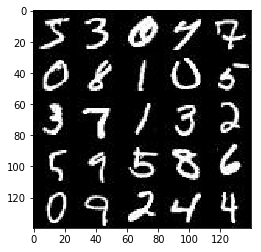

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

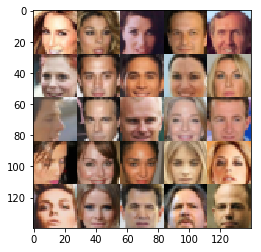

In [4]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.2.1
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # DONE: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real') 
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    lr = tf.placeholder(tf.float32, name='learning_rate')
    
    return inputs_real, inputs_z, lr

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "c:\\users\\peter\\anaconda3\\envs\\tflearn-gpu\\lib\\runpy.py", line 193, in _run_module_as_main\n    "__main__", mod_spec)', 'File "c:\\users\\peter\\anaconda3\\envs\\tflearn-gpu\\lib\\runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "c:\\users\\peter\\anaconda3\\envs\\tflearn-gpu\\lib\\site-packages\\ipykernel_launcher.py", line 16, in <module>\n    app.launch_new_instance()', 'File "c:\\users\\peter\\anaconda3\\envs\\tflearn-gpu\\lib\\site-packages\\traitlets\\config\\application.py", line 658, in launch_instance\n    app.start()', 'File "c:\\users\\peter\\anaconda3\\envs\\tflearn-gpu\\lib\\site-packages\\ipykernel\\kernelapp.py", line 477, in start\n    ioloop.IOLoop.instan

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
# conv2d uses xavier initializer (as the None is transformed in a new glorot_uniform_initializer after line 220 in https://github.com/tensorflow/tensorflow/blob/r1.2/tensorflow/python/ops/variable_scope.py)
dnconv = 64
dropout_rate = 0.5
def discriminator(images, reuse=False, alpha=0.01):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # DONE: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28 x 28 x out_channel_dim
        #print(images.get_shape().as_list())
        
        # conv to 14, 14
        x = tf.layers.conv2d(images, dnconv*4, 5, strides=2, padding='same')
        x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # conv to 7, 7
        x = tf.layers.conv2d(x, dnconv*4, 5, strides=2, padding='same', use_bias=False)
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # conv to 4, 4
        x = tf.layers.conv2d(x, dnconv*8, 5, strides=2, padding='same', use_bias=False)
        x = tf.layers.batch_normalization(x, training=True)
        #x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # flatten
        x = tf.reshape(x, (-1, 4*4*dnconv*8))
        #print(x.get_shape().as_list())
        
        # logits and output
        logits = tf.layers.dense(x, 1)
        out = tf.sigmoid(logits)
        
        
        return out, logits
    
"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
gnconv = 64
dropout_rate = 0.5
def generator(z, out_channel_dim, is_train=True, alpha=0.02): # I put alpha parameter to this function call
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # DONE: Implement Function
    
    # auxiliar variables
    reuse = not is_train
    
    # scope for generator
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*gnconv*8)
        #print(x.get_shape().as_list())
        
        # batch normalization to 4x4
        x = tf.reshape(x, (-1, 4, 4, gnconv*8))
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # conv to 2x2
        #x = tf.layers.conv2d_transpose(x, gnconv*8, 5, strides=2, padding='same')
        #x = tf.layers.batch_normalization(x, training=is_train)
        #x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        #x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # conv to 4x4
        #x = tf.layers.conv2d_transpose(x, gnconv*8, 5, strides=2, padding='same')
        #x = tf.layers.batch_normalization(x, training=is_train)
        #x = tf.layers.dropout(inputs=x, rate=dropout_rate, training=True)
        #x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())

        # upsample to 7x7
        x = tf.image.resize_nearest_neighbor(x, (7,7))
        #print(x.get_shape().as_list())

        # conv to 7x7
        x = tf.layers.conv2d(x, gnconv*8, 5, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # upsample to 14x14
        x = tf.image.resize_nearest_neighbor(x, (14,14))
        #print(x.get_shape().as_list())

        # conv to 14x14
        x = tf.layers.conv2d(x, gnconv*6, 5, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # upsample to 21x21
        x = tf.image.resize_nearest_neighbor(x, (21,21))
        #print(x.get_shape().as_list())

        # conv to 21x21
        x = tf.layers.conv2d(x, gnconv*4, 5, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        #print(x.get_shape().as_list())
        
        # upsample to 28x28
        x = tf.image.resize_nearest_neighbor(x, (28,28))
        #print(x.get_shape().as_list())

        # Output layer, 28 x 28 x out_channel_dim (3 or 1, depending on the task - faces or minst)
        logits = tf.layers.conv2d(x, out_channel_dim, 5, padding='same')
        #print(logits.get_shape().as_list())
        
        out = tf.tanh(logits)
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
smooth = 0.1

def model_loss(input_real, input_z, out_channel_dim, alpha=0.02): # I put alpha parameter to this function call
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # DONE: Implement Function
    
    # Just for reference:
    #   discriminator(images, reuse=False, alpha=0.01)
    #   generator(z, out_channel_dim, is_train=True, alpha=0.02): # I put alpha parameter to this function call
    
    g_out = generator(input_z, out_channel_dim, alpha=alpha)
    d_out_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_out_fake, d_logits_fake = discriminator(g_out, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                                                        logits=d_logits_real,
                                                        labels=tf.ones_like(d_out_real) * (1. - smooth)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                                                        logits=d_logits_fake,
                                                        labels=tf.zeros_like(d_out_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                                                        logits=d_logits_fake,
                                                        labels=tf.ones_like(d_out_fake)))

    return d_loss, g_loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # DONE: Implement Function
    
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [14]:
from datetime import datetime

print_every = 10
show_every = 100
n_images = 16
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # DONE: Build Model
    minput_real, minput_z, mlearning_rate = model_inputs(*data_shape[1:], z_dim)
    d_loss, g_loss = model_loss(minput_real, minput_z, data_shape[-1], alpha=0.02)
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    have_i_already_reset_the_default_graph = True

    # Auxiliar variables
    steps = 0
    out_channel_dim = 3 if data_image_mode == 'RGB' else 1
    sample_z = np.random.uniform(-1, 1, size=(n_images, z_dim))

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):    
            for batch_images in get_batches(batch_size):
                # DONE: Train Model
                steps += 1
                
                # rescale from [-.5, .5] to [-1., 1.]
                batch_images = batch_images * 2

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                #_ = sess.run(net.d_opt, feed_dict={net.input_real: batch_images, net.input_z: batch_z, net.learning_rate : learning_rate})
                #_ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.learning_rate : learning_rate, net.input_real: batch_images})
                _ = sess.run(d_opt, feed_dict={minput_real: batch_images, minput_z: batch_z, mlearning_rate: learning_rate})
                _ = sess.run(g_opt, feed_dict={minput_z: batch_z, mlearning_rate: learning_rate, minput_real: batch_images})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    #train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: batch_images})
                    #train_loss_g = net.g_loss.eval({net.input_z: batch_z})
                    train_loss_d = d_loss.eval({minput_z: batch_z, minput_real: batch_images})
                    train_loss_g = g_loss.eval({minput_z: batch_z})

                    print("Timestamp {} - ".format(datetime.now().strftime('%Y%m%d-%H-%M-%S.%f')[:-3]),
                          "Epoch {}/{} - ".format(epoch_i+1, epochs),
                          "Step {} - ".format(steps),
                          "D Loss: {:.4f} -".format(train_loss_d),
                          "G Loss: {:.4f}".format(train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, n_images, minput_z, out_channel_dim, data_image_mode)

            # At the end of each epoch, get the losses and print them out
            if not (steps % show_every == 0):
                train_loss_d = d_loss.eval({minput_z: batch_z, minput_real: batch_images})
                train_loss_g = g_loss.eval({minput_z: batch_z})
                print("Timestamp {} - ".format(datetime.now().strftime('%Y%m%d-%H-%M-%S.%f')[:-3]),
                      "Epoch {}/{} - ".format(epoch_i+1, epochs),
                      "Step {} - ".format(steps),
                      "D Loss: {:.4f} -".format(train_loss_d),
                      "G Loss: {:.4f}".format(train_loss_g))

                show_generator_output(sess, n_images, minput_z, out_channel_dim, data_image_mode)
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Timestamp 20170806-10-23-27.713 -  Epoch 1/2 -  Step 10 -  D Loss: 0.4946 - G Loss: 2.1428
Timestamp 20170806-10-23-39.550 -  Epoch 1/2 -  Step 20 -  D Loss: 1.9922 - G Loss: 1.7634
Timestamp 20170806-10-23-51.376 -  Epoch 1/2 -  Step 30 -  D Loss: 5.0702 - G Loss: 0.0272
Timestamp 20170806-10-24-03.203 -  Epoch 1/2 -  Step 40 -  D Loss: 1.8834 - G Loss: 2.7380
Timestamp 20170806-10-24-15.025 -  Epoch 1/2 -  Step 50 -  D Loss: 2.3946 - G Loss: 1.0202
Timestamp 20170806-10-24-26.856 -  Epoch 1/2 -  Step 60 -  D Loss: 1.1660 - G Loss: 6.4386
Timestamp 20170806-10-24-38.694 -  Epoch 1/2 -  Step 70 -  D Loss: 1.6963 - G Loss: 0.4441
Timestamp 20170806-10-24-50.530 -  Epoch 1/2 -  Step 80 -  D Loss: 2.1858 - G Loss: 0.8111
Timestamp 20170806-10-25-02.348 -  Epoch 1/2 -  Step 90 -  D Loss: 0.7884 - G Loss: 3.0378
Timestamp 20170806-10-25-14.171 -  Epoch 1/2 -  Step 100 -  D Loss: 0.7693 - G Loss: 3.2450


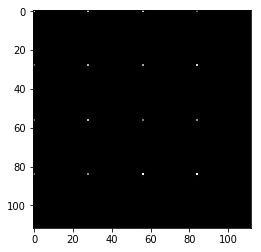

Timestamp 20170806-10-25-26.762 -  Epoch 1/2 -  Step 110 -  D Loss: 3.0906 - G Loss: 0.6487
Timestamp 20170806-10-25-38.583 -  Epoch 1/2 -  Step 120 -  D Loss: 1.1779 - G Loss: 1.4992
Timestamp 20170806-10-25-50.419 -  Epoch 1/2 -  Step 130 -  D Loss: 1.2211 - G Loss: 5.4736
Timestamp 20170806-10-26-02.241 -  Epoch 1/2 -  Step 140 -  D Loss: 1.3144 - G Loss: 2.5306
Timestamp 20170806-10-26-14.080 -  Epoch 1/2 -  Step 150 -  D Loss: 1.5099 - G Loss: 0.8154
Timestamp 20170806-10-26-25.910 -  Epoch 1/2 -  Step 160 -  D Loss: 2.3690 - G Loss: 1.1603
Timestamp 20170806-10-26-37.733 -  Epoch 1/2 -  Step 170 -  D Loss: 1.2669 - G Loss: 2.1021
Timestamp 20170806-10-26-49.565 -  Epoch 1/2 -  Step 180 -  D Loss: 1.6712 - G Loss: 1.3893
Timestamp 20170806-10-27-01.377 -  Epoch 1/2 -  Step 190 -  D Loss: 2.9108 - G Loss: 1.0272
Timestamp 20170806-10-27-13.218 -  Epoch 1/2 -  Step 200 -  D Loss: 2.8826 - G Loss: 0.5386


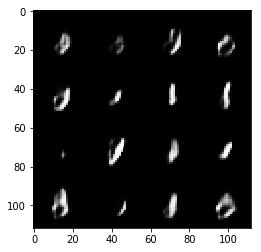

Timestamp 20170806-10-27-25.663 -  Epoch 1/2 -  Step 210 -  D Loss: 1.7954 - G Loss: 1.0714
Timestamp 20170806-10-27-37.501 -  Epoch 1/2 -  Step 220 -  D Loss: 1.2007 - G Loss: 1.1677
Timestamp 20170806-10-27-49.324 -  Epoch 1/2 -  Step 230 -  D Loss: 1.3387 - G Loss: 1.9886
Timestamp 20170806-10-28-01.149 -  Epoch 1/2 -  Step 240 -  D Loss: 1.3441 - G Loss: 1.3638
Timestamp 20170806-10-28-12.974 -  Epoch 1/2 -  Step 250 -  D Loss: 1.5585 - G Loss: 0.6861
Timestamp 20170806-10-28-24.807 -  Epoch 1/2 -  Step 260 -  D Loss: 1.3818 - G Loss: 0.7226
Timestamp 20170806-10-28-36.644 -  Epoch 1/2 -  Step 270 -  D Loss: 1.6154 - G Loss: 1.5620
Timestamp 20170806-10-28-48.458 -  Epoch 1/2 -  Step 280 -  D Loss: 1.4483 - G Loss: 1.2354
Timestamp 20170806-10-29-00.276 -  Epoch 1/2 -  Step 290 -  D Loss: 1.3838 - G Loss: 1.0379
Timestamp 20170806-10-29-12.090 -  Epoch 1/2 -  Step 300 -  D Loss: 0.9632 - G Loss: 1.9213


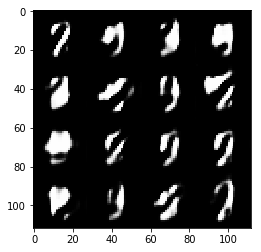

Timestamp 20170806-10-29-24.550 -  Epoch 1/2 -  Step 310 -  D Loss: 1.2788 - G Loss: 1.1211
Timestamp 20170806-10-29-36.384 -  Epoch 1/2 -  Step 320 -  D Loss: 0.9810 - G Loss: 1.6539
Timestamp 20170806-10-29-48.205 -  Epoch 1/2 -  Step 330 -  D Loss: 1.3301 - G Loss: 0.8778
Timestamp 20170806-10-30-00.023 -  Epoch 1/2 -  Step 340 -  D Loss: 1.4658 - G Loss: 1.4267
Timestamp 20170806-10-30-11.830 -  Epoch 1/2 -  Step 350 -  D Loss: 1.8681 - G Loss: 1.6740
Timestamp 20170806-10-30-23.640 -  Epoch 1/2 -  Step 360 -  D Loss: 1.7254 - G Loss: 0.9603
Timestamp 20170806-10-30-35.467 -  Epoch 1/2 -  Step 370 -  D Loss: 1.6644 - G Loss: 1.2092
Timestamp 20170806-10-30-47.300 -  Epoch 1/2 -  Step 380 -  D Loss: 0.9235 - G Loss: 1.5786
Timestamp 20170806-10-30-59.128 -  Epoch 1/2 -  Step 390 -  D Loss: 1.1464 - G Loss: 1.3533
Timestamp 20170806-10-31-10.953 -  Epoch 1/2 -  Step 400 -  D Loss: 1.5339 - G Loss: 0.7561


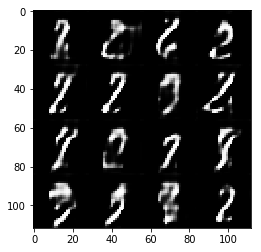

Timestamp 20170806-10-31-23.402 -  Epoch 1/2 -  Step 410 -  D Loss: 1.6426 - G Loss: 1.0696
Timestamp 20170806-10-31-35.216 -  Epoch 1/2 -  Step 420 -  D Loss: 1.2460 - G Loss: 1.2256
Timestamp 20170806-10-31-47.023 -  Epoch 1/2 -  Step 430 -  D Loss: 1.4338 - G Loss: 1.0133
Timestamp 20170806-10-31-58.848 -  Epoch 1/2 -  Step 440 -  D Loss: 1.3872 - G Loss: 0.8139
Timestamp 20170806-10-32-10.667 -  Epoch 1/2 -  Step 450 -  D Loss: 1.2630 - G Loss: 1.8291
Timestamp 20170806-10-32-22.484 -  Epoch 1/2 -  Step 460 -  D Loss: 1.3318 - G Loss: 0.6638
Timestamp 20170806-10-32-34.308 -  Epoch 1/2 -  Step 470 -  D Loss: 1.3119 - G Loss: 0.6439
Timestamp 20170806-10-32-46.133 -  Epoch 1/2 -  Step 480 -  D Loss: 1.6917 - G Loss: 0.7436
Timestamp 20170806-10-32-57.950 -  Epoch 1/2 -  Step 490 -  D Loss: 1.8414 - G Loss: 0.8627
Timestamp 20170806-10-33-09.772 -  Epoch 1/2 -  Step 500 -  D Loss: 1.7589 - G Loss: 1.1794


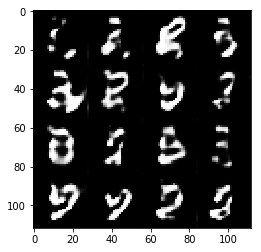

Timestamp 20170806-10-33-22.244 -  Epoch 1/2 -  Step 510 -  D Loss: 1.3109 - G Loss: 0.5671
Timestamp 20170806-10-33-34.060 -  Epoch 1/2 -  Step 520 -  D Loss: 1.1844 - G Loss: 1.0964
Timestamp 20170806-10-33-45.871 -  Epoch 1/2 -  Step 530 -  D Loss: 1.7141 - G Loss: 0.8166
Timestamp 20170806-10-33-57.712 -  Epoch 1/2 -  Step 540 -  D Loss: 1.6052 - G Loss: 0.9179
Timestamp 20170806-10-34-09.540 -  Epoch 1/2 -  Step 550 -  D Loss: 1.4786 - G Loss: 0.6799
Timestamp 20170806-10-34-21.350 -  Epoch 1/2 -  Step 560 -  D Loss: 1.3231 - G Loss: 1.2949
Timestamp 20170806-10-34-33.172 -  Epoch 1/2 -  Step 570 -  D Loss: 1.6371 - G Loss: 0.9100
Timestamp 20170806-10-34-44.975 -  Epoch 1/2 -  Step 580 -  D Loss: 1.2354 - G Loss: 1.1922
Timestamp 20170806-10-34-56.801 -  Epoch 1/2 -  Step 590 -  D Loss: 1.1620 - G Loss: 0.8592
Timestamp 20170806-10-35-08.604 -  Epoch 1/2 -  Step 600 -  D Loss: 1.6745 - G Loss: 0.7188


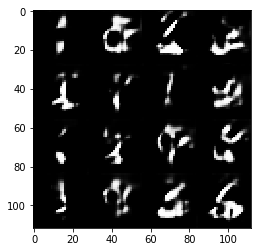

Timestamp 20170806-10-35-21.059 -  Epoch 1/2 -  Step 610 -  D Loss: 1.2532 - G Loss: 1.0650
Timestamp 20170806-10-35-32.880 -  Epoch 1/2 -  Step 620 -  D Loss: 1.3126 - G Loss: 1.0756
Timestamp 20170806-10-35-44.694 -  Epoch 1/2 -  Step 630 -  D Loss: 1.4675 - G Loss: 1.1660
Timestamp 20170806-10-35-56.514 -  Epoch 1/2 -  Step 640 -  D Loss: 1.2891 - G Loss: 0.9819
Timestamp 20170806-10-36-08.336 -  Epoch 1/2 -  Step 650 -  D Loss: 1.4598 - G Loss: 0.8097
Timestamp 20170806-10-36-20.158 -  Epoch 1/2 -  Step 660 -  D Loss: 1.5426 - G Loss: 1.0653
Timestamp 20170806-10-36-31.985 -  Epoch 1/2 -  Step 670 -  D Loss: 1.2679 - G Loss: 1.0072
Timestamp 20170806-10-36-43.808 -  Epoch 1/2 -  Step 680 -  D Loss: 1.3361 - G Loss: 1.0939
Timestamp 20170806-10-36-55.614 -  Epoch 1/2 -  Step 690 -  D Loss: 1.0014 - G Loss: 1.0909
Timestamp 20170806-10-37-07.436 -  Epoch 1/2 -  Step 700 -  D Loss: 1.4344 - G Loss: 1.1159


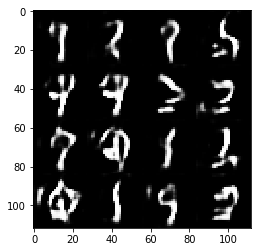

Timestamp 20170806-10-37-19.908 -  Epoch 1/2 -  Step 710 -  D Loss: 1.1071 - G Loss: 1.3559
Timestamp 20170806-10-37-31.727 -  Epoch 1/2 -  Step 720 -  D Loss: 1.2324 - G Loss: 1.0698
Timestamp 20170806-10-37-43.555 -  Epoch 1/2 -  Step 730 -  D Loss: 1.2397 - G Loss: 1.3712
Timestamp 20170806-10-37-55.381 -  Epoch 1/2 -  Step 740 -  D Loss: 1.2716 - G Loss: 1.2853
Timestamp 20170806-10-38-07.197 -  Epoch 1/2 -  Step 750 -  D Loss: 1.4365 - G Loss: 0.6773
Timestamp 20170806-10-38-19.011 -  Epoch 1/2 -  Step 760 -  D Loss: 1.4794 - G Loss: 0.7840
Timestamp 20170806-10-38-30.824 -  Epoch 1/2 -  Step 770 -  D Loss: 1.2564 - G Loss: 1.0047
Timestamp 20170806-10-38-42.640 -  Epoch 1/2 -  Step 780 -  D Loss: 1.3363 - G Loss: 0.9613
Timestamp 20170806-10-38-54.455 -  Epoch 1/2 -  Step 790 -  D Loss: 0.9653 - G Loss: 0.9729
Timestamp 20170806-10-39-06.264 -  Epoch 1/2 -  Step 800 -  D Loss: 1.7702 - G Loss: 0.8116


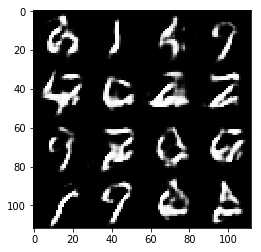

Timestamp 20170806-10-39-18.726 -  Epoch 1/2 -  Step 810 -  D Loss: 1.1893 - G Loss: 1.3364
Timestamp 20170806-10-39-30.554 -  Epoch 1/2 -  Step 820 -  D Loss: 1.0703 - G Loss: 0.7858
Timestamp 20170806-10-39-42.386 -  Epoch 1/2 -  Step 830 -  D Loss: 1.1172 - G Loss: 1.1571
Timestamp 20170806-10-39-54.184 -  Epoch 1/2 -  Step 840 -  D Loss: 0.9958 - G Loss: 1.2377
Timestamp 20170806-10-40-05.993 -  Epoch 1/2 -  Step 850 -  D Loss: 1.4729 - G Loss: 0.6245
Timestamp 20170806-10-40-17.832 -  Epoch 1/2 -  Step 860 -  D Loss: 1.0923 - G Loss: 0.9571
Timestamp 20170806-10-40-29.640 -  Epoch 1/2 -  Step 870 -  D Loss: 1.2538 - G Loss: 1.2865
Timestamp 20170806-10-40-41.469 -  Epoch 1/2 -  Step 880 -  D Loss: 0.9312 - G Loss: 0.9547
Timestamp 20170806-10-40-53.310 -  Epoch 1/2 -  Step 890 -  D Loss: 1.2358 - G Loss: 1.5055
Timestamp 20170806-10-41-05.155 -  Epoch 1/2 -  Step 900 -  D Loss: 1.3938 - G Loss: 1.1742


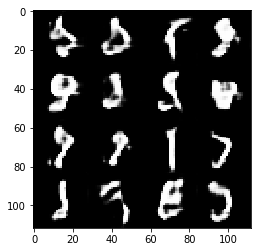

Timestamp 20170806-10-41-17.836 -  Epoch 1/2 -  Step 910 -  D Loss: 0.8351 - G Loss: 1.0277
Timestamp 20170806-10-41-29.690 -  Epoch 1/2 -  Step 920 -  D Loss: 0.9895 - G Loss: 0.9915
Timestamp 20170806-10-41-41.525 -  Epoch 1/2 -  Step 930 -  D Loss: 1.0083 - G Loss: 1.5915
Timestamp 20170806-10-41-53.379 -  Epoch 1/2 -  Step 940 -  D Loss: 1.3331 - G Loss: 0.8304
Timestamp 20170806-10-42-05.215 -  Epoch 1/2 -  Step 950 -  D Loss: 1.0908 - G Loss: 1.1948
Timestamp 20170806-10-42-17.055 -  Epoch 1/2 -  Step 960 -  D Loss: 1.2853 - G Loss: 0.9411
Timestamp 20170806-10-42-28.904 -  Epoch 1/2 -  Step 970 -  D Loss: 1.3128 - G Loss: 1.1966
Timestamp 20170806-10-42-40.749 -  Epoch 1/2 -  Step 980 -  D Loss: 1.3875 - G Loss: 1.2091
Timestamp 20170806-10-42-52.579 -  Epoch 1/2 -  Step 990 -  D Loss: 1.4521 - G Loss: 0.9095
Timestamp 20170806-10-43-04.401 -  Epoch 1/2 -  Step 1000 -  D Loss: 1.4762 - G Loss: 1.1141


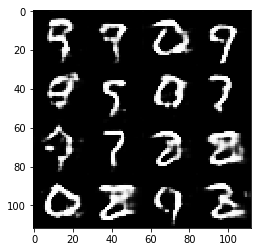

Timestamp 20170806-10-43-16.878 -  Epoch 1/2 -  Step 1010 -  D Loss: 1.1853 - G Loss: 0.8005
Timestamp 20170806-10-43-28.701 -  Epoch 1/2 -  Step 1020 -  D Loss: 1.6483 - G Loss: 1.0105
Timestamp 20170806-10-43-40.539 -  Epoch 1/2 -  Step 1030 -  D Loss: 1.2290 - G Loss: 1.1344
Timestamp 20170806-10-43-52.368 -  Epoch 1/2 -  Step 1040 -  D Loss: 1.0801 - G Loss: 1.0795
Timestamp 20170806-10-44-04.204 -  Epoch 1/2 -  Step 1050 -  D Loss: 1.7427 - G Loss: 0.7056
Timestamp 20170806-10-44-16.056 -  Epoch 1/2 -  Step 1060 -  D Loss: 1.0769 - G Loss: 0.9013
Timestamp 20170806-10-44-27.882 -  Epoch 1/2 -  Step 1070 -  D Loss: 0.9852 - G Loss: 1.5026
Timestamp 20170806-10-44-39.720 -  Epoch 1/2 -  Step 1080 -  D Loss: 1.0739 - G Loss: 0.5827
Timestamp 20170806-10-44-51.568 -  Epoch 1/2 -  Step 1090 -  D Loss: 1.1939 - G Loss: 1.2947
Timestamp 20170806-10-45-03.405 -  Epoch 1/2 -  Step 1100 -  D Loss: 1.1962 - G Loss: 0.6879


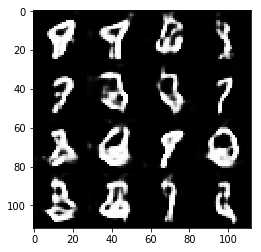

Timestamp 20170806-10-45-15.898 -  Epoch 1/2 -  Step 1110 -  D Loss: 1.3398 - G Loss: 0.5955
Timestamp 20170806-10-45-27.732 -  Epoch 1/2 -  Step 1120 -  D Loss: 1.1095 - G Loss: 1.4212
Timestamp 20170806-10-45-39.563 -  Epoch 1/2 -  Step 1130 -  D Loss: 1.2435 - G Loss: 1.1584
Timestamp 20170806-10-45-51.401 -  Epoch 1/2 -  Step 1140 -  D Loss: 1.3105 - G Loss: 1.5374
Timestamp 20170806-10-46-03.222 -  Epoch 1/2 -  Step 1150 -  D Loss: 1.0492 - G Loss: 1.0671
Timestamp 20170806-10-46-15.039 -  Epoch 1/2 -  Step 1160 -  D Loss: 1.3425 - G Loss: 1.0748
Timestamp 20170806-10-46-26.861 -  Epoch 1/2 -  Step 1170 -  D Loss: 1.5286 - G Loss: 0.9051
Timestamp 20170806-10-46-38.669 -  Epoch 1/2 -  Step 1180 -  D Loss: 1.3533 - G Loss: 1.0128
Timestamp 20170806-10-46-50.477 -  Epoch 1/2 -  Step 1190 -  D Loss: 1.2696 - G Loss: 0.8793
Timestamp 20170806-10-47-02.307 -  Epoch 1/2 -  Step 1200 -  D Loss: 1.0590 - G Loss: 1.1728


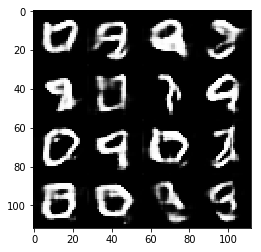

Timestamp 20170806-10-47-14.793 -  Epoch 1/2 -  Step 1210 -  D Loss: 1.5020 - G Loss: 0.9409
Timestamp 20170806-10-47-26.624 -  Epoch 1/2 -  Step 1220 -  D Loss: 1.3270 - G Loss: 1.1511
Timestamp 20170806-10-47-38.448 -  Epoch 1/2 -  Step 1230 -  D Loss: 1.2032 - G Loss: 0.7615
Timestamp 20170806-10-47-50.266 -  Epoch 1/2 -  Step 1240 -  D Loss: 1.0576 - G Loss: 1.0622
Timestamp 20170806-10-48-02.080 -  Epoch 1/2 -  Step 1250 -  D Loss: 1.4364 - G Loss: 0.6819
Timestamp 20170806-10-48-13.899 -  Epoch 1/2 -  Step 1260 -  D Loss: 1.1630 - G Loss: 1.0201
Timestamp 20170806-10-48-25.712 -  Epoch 1/2 -  Step 1270 -  D Loss: 1.1137 - G Loss: 1.1251
Timestamp 20170806-10-48-37.543 -  Epoch 1/2 -  Step 1280 -  D Loss: 1.2795 - G Loss: 0.7040
Timestamp 20170806-10-48-49.353 -  Epoch 1/2 -  Step 1290 -  D Loss: 1.3717 - G Loss: 0.7245
Timestamp 20170806-10-49-01.168 -  Epoch 1/2 -  Step 1300 -  D Loss: 1.3845 - G Loss: 0.6867


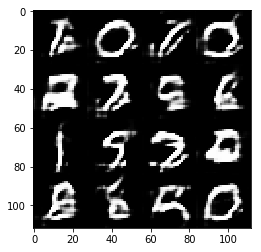

Timestamp 20170806-10-49-13.669 -  Epoch 1/2 -  Step 1310 -  D Loss: 1.3056 - G Loss: 1.0852
Timestamp 20170806-10-49-25.501 -  Epoch 1/2 -  Step 1320 -  D Loss: 1.0657 - G Loss: 0.7492
Timestamp 20170806-10-49-37.340 -  Epoch 1/2 -  Step 1330 -  D Loss: 1.7017 - G Loss: 0.7419
Timestamp 20170806-10-49-49.160 -  Epoch 1/2 -  Step 1340 -  D Loss: 1.5180 - G Loss: 0.5577
Timestamp 20170806-10-50-00.993 -  Epoch 1/2 -  Step 1350 -  D Loss: 1.5416 - G Loss: 0.9212
Timestamp 20170806-10-50-12.816 -  Epoch 1/2 -  Step 1360 -  D Loss: 1.2600 - G Loss: 0.7511
Timestamp 20170806-10-50-24.647 -  Epoch 1/2 -  Step 1370 -  D Loss: 1.5056 - G Loss: 1.2215
Timestamp 20170806-10-50-36.481 -  Epoch 1/2 -  Step 1380 -  D Loss: 1.2370 - G Loss: 0.6904
Timestamp 20170806-10-50-48.299 -  Epoch 1/2 -  Step 1390 -  D Loss: 1.2755 - G Loss: 1.1243
Timestamp 20170806-10-51-00.122 -  Epoch 1/2 -  Step 1400 -  D Loss: 1.2715 - G Loss: 1.0332


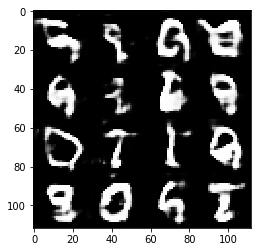

Timestamp 20170806-10-51-12.602 -  Epoch 1/2 -  Step 1410 -  D Loss: 1.2376 - G Loss: 1.0567
Timestamp 20170806-10-51-24.444 -  Epoch 1/2 -  Step 1420 -  D Loss: 1.1842 - G Loss: 1.1723
Timestamp 20170806-10-51-36.277 -  Epoch 1/2 -  Step 1430 -  D Loss: 1.3336 - G Loss: 0.9777
Timestamp 20170806-10-51-48.097 -  Epoch 1/2 -  Step 1440 -  D Loss: 1.5543 - G Loss: 0.5917
Timestamp 20170806-10-51-59.923 -  Epoch 1/2 -  Step 1450 -  D Loss: 1.1367 - G Loss: 1.0842
Timestamp 20170806-10-52-11.759 -  Epoch 1/2 -  Step 1460 -  D Loss: 1.2637 - G Loss: 0.8399
Timestamp 20170806-10-52-23.588 -  Epoch 1/2 -  Step 1470 -  D Loss: 1.3609 - G Loss: 0.8340
Timestamp 20170806-10-52-35.422 -  Epoch 1/2 -  Step 1480 -  D Loss: 1.1483 - G Loss: 0.8037
Timestamp 20170806-10-52-47.257 -  Epoch 1/2 -  Step 1490 -  D Loss: 1.4688 - G Loss: 1.0291
Timestamp 20170806-10-52-59.085 -  Epoch 1/2 -  Step 1500 -  D Loss: 1.2835 - G Loss: 1.0923


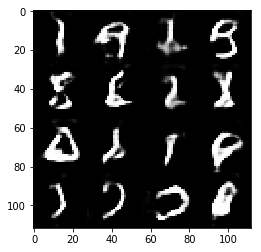

Timestamp 20170806-10-53-11.564 -  Epoch 1/2 -  Step 1510 -  D Loss: 1.2611 - G Loss: 1.5445
Timestamp 20170806-10-53-23.389 -  Epoch 1/2 -  Step 1520 -  D Loss: 1.5569 - G Loss: 0.8293
Timestamp 20170806-10-53-35.210 -  Epoch 1/2 -  Step 1530 -  D Loss: 1.4176 - G Loss: 0.8492
Timestamp 20170806-10-53-47.046 -  Epoch 1/2 -  Step 1540 -  D Loss: 1.3644 - G Loss: 0.9881
Timestamp 20170806-10-53-58.871 -  Epoch 1/2 -  Step 1550 -  D Loss: 1.0135 - G Loss: 1.2274
Timestamp 20170806-10-54-10.685 -  Epoch 1/2 -  Step 1560 -  D Loss: 1.0500 - G Loss: 0.9447
Timestamp 20170806-10-54-22.541 -  Epoch 1/2 -  Step 1570 -  D Loss: 1.0835 - G Loss: 1.0855
Timestamp 20170806-10-54-34.376 -  Epoch 1/2 -  Step 1580 -  D Loss: 1.0525 - G Loss: 1.3267
Timestamp 20170806-10-54-46.214 -  Epoch 1/2 -  Step 1590 -  D Loss: 1.1788 - G Loss: 0.7431
Timestamp 20170806-10-54-58.035 -  Epoch 1/2 -  Step 1600 -  D Loss: 1.1862 - G Loss: 0.9185


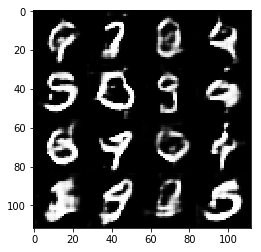

Timestamp 20170806-10-55-10.491 -  Epoch 1/2 -  Step 1610 -  D Loss: 1.2993 - G Loss: 1.1205
Timestamp 20170806-10-55-22.300 -  Epoch 1/2 -  Step 1620 -  D Loss: 1.2035 - G Loss: 1.0312
Timestamp 20170806-10-55-34.130 -  Epoch 1/2 -  Step 1630 -  D Loss: 1.0778 - G Loss: 1.1803
Timestamp 20170806-10-55-45.936 -  Epoch 1/2 -  Step 1640 -  D Loss: 1.1157 - G Loss: 0.9767
Timestamp 20170806-10-55-57.760 -  Epoch 1/2 -  Step 1650 -  D Loss: 0.9792 - G Loss: 1.0257
Timestamp 20170806-10-56-09.577 -  Epoch 1/2 -  Step 1660 -  D Loss: 1.1109 - G Loss: 1.0354
Timestamp 20170806-10-56-21.412 -  Epoch 1/2 -  Step 1670 -  D Loss: 1.2866 - G Loss: 0.9376
Timestamp 20170806-10-56-33.249 -  Epoch 1/2 -  Step 1680 -  D Loss: 1.1278 - G Loss: 0.8848
Timestamp 20170806-10-56-45.070 -  Epoch 1/2 -  Step 1690 -  D Loss: 1.1820 - G Loss: 1.3573
Timestamp 20170806-10-56-56.885 -  Epoch 1/2 -  Step 1700 -  D Loss: 1.3716 - G Loss: 0.7378


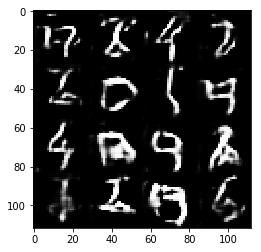

Timestamp 20170806-10-57-09.361 -  Epoch 1/2 -  Step 1710 -  D Loss: 1.3284 - G Loss: 1.0504
Timestamp 20170806-10-57-21.165 -  Epoch 1/2 -  Step 1720 -  D Loss: 1.2989 - G Loss: 0.8730
Timestamp 20170806-10-57-32.998 -  Epoch 1/2 -  Step 1730 -  D Loss: 1.3048 - G Loss: 0.9934
Timestamp 20170806-10-57-44.807 -  Epoch 1/2 -  Step 1740 -  D Loss: 1.0343 - G Loss: 1.1921
Timestamp 20170806-10-57-56.614 -  Epoch 1/2 -  Step 1750 -  D Loss: 1.2764 - G Loss: 0.8823
Timestamp 20170806-10-58-08.447 -  Epoch 1/2 -  Step 1760 -  D Loss: 1.2853 - G Loss: 1.0052
Timestamp 20170806-10-58-20.262 -  Epoch 1/2 -  Step 1770 -  D Loss: 1.0936 - G Loss: 1.0972
Timestamp 20170806-10-58-32.096 -  Epoch 1/2 -  Step 1780 -  D Loss: 1.4154 - G Loss: 0.7514
Timestamp 20170806-10-58-43.882 -  Epoch 1/2 -  Step 1790 -  D Loss: 1.1589 - G Loss: 1.0005
Timestamp 20170806-10-58-55.692 -  Epoch 1/2 -  Step 1800 -  D Loss: 1.2305 - G Loss: 1.0830


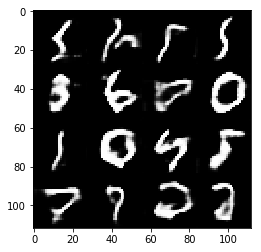

Timestamp 20170806-10-59-08.155 -  Epoch 1/2 -  Step 1810 -  D Loss: 1.0883 - G Loss: 0.9527
Timestamp 20170806-10-59-20.006 -  Epoch 1/2 -  Step 1820 -  D Loss: 1.2854 - G Loss: 0.8440
Timestamp 20170806-10-59-31.821 -  Epoch 1/2 -  Step 1830 -  D Loss: 1.1979 - G Loss: 1.1493
Timestamp 20170806-10-59-43.643 -  Epoch 1/2 -  Step 1840 -  D Loss: 1.4640 - G Loss: 1.3521
Timestamp 20170806-10-59-55.457 -  Epoch 1/2 -  Step 1850 -  D Loss: 1.0761 - G Loss: 1.2829
Timestamp 20170806-11-00-07.287 -  Epoch 1/2 -  Step 1860 -  D Loss: 1.2013 - G Loss: 0.8134
Timestamp 20170806-11-00-19.114 -  Epoch 1/2 -  Step 1870 -  D Loss: 1.3569 - G Loss: 0.7886
Timestamp 20170806-11-00-30.934 -  Epoch 1/2 -  Step 1880 -  D Loss: 1.1838 - G Loss: 0.8434
Timestamp 20170806-11-00-42.762 -  Epoch 1/2 -  Step 1890 -  D Loss: 1.1057 - G Loss: 0.9705
Timestamp 20170806-11-00-54.581 -  Epoch 1/2 -  Step 1900 -  D Loss: 1.1339 - G Loss: 1.0991


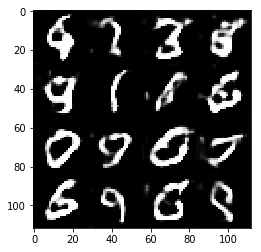

Timestamp 20170806-11-01-07.071 -  Epoch 1/2 -  Step 1910 -  D Loss: 1.2639 - G Loss: 1.1090
Timestamp 20170806-11-01-18.892 -  Epoch 1/2 -  Step 1920 -  D Loss: 1.3387 - G Loss: 0.8064
Timestamp 20170806-11-01-30.721 -  Epoch 1/2 -  Step 1930 -  D Loss: 1.4096 - G Loss: 0.7031
Timestamp 20170806-11-01-42.538 -  Epoch 1/2 -  Step 1940 -  D Loss: 0.8834 - G Loss: 1.3350
Timestamp 20170806-11-01-54.360 -  Epoch 1/2 -  Step 1950 -  D Loss: 1.4266 - G Loss: 0.9274
Timestamp 20170806-11-02-06.164 -  Epoch 1/2 -  Step 1960 -  D Loss: 1.5951 - G Loss: 0.7531
Timestamp 20170806-11-02-17.995 -  Epoch 1/2 -  Step 1970 -  D Loss: 1.2475 - G Loss: 1.2941
Timestamp 20170806-11-02-29.816 -  Epoch 1/2 -  Step 1980 -  D Loss: 1.2430 - G Loss: 0.9700
Timestamp 20170806-11-02-41.643 -  Epoch 1/2 -  Step 1990 -  D Loss: 1.3300 - G Loss: 0.9014
Timestamp 20170806-11-02-53.457 -  Epoch 1/2 -  Step 2000 -  D Loss: 1.3104 - G Loss: 1.1134


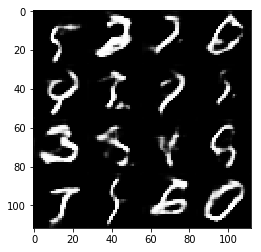

Timestamp 20170806-11-03-05.949 -  Epoch 1/2 -  Step 2010 -  D Loss: 1.4346 - G Loss: 0.7824
Timestamp 20170806-11-03-17.791 -  Epoch 1/2 -  Step 2020 -  D Loss: 1.0476 - G Loss: 1.5397
Timestamp 20170806-11-03-29.622 -  Epoch 1/2 -  Step 2030 -  D Loss: 1.1204 - G Loss: 1.4159
Timestamp 20170806-11-03-41.453 -  Epoch 1/2 -  Step 2040 -  D Loss: 1.3077 - G Loss: 1.0357
Timestamp 20170806-11-03-53.268 -  Epoch 1/2 -  Step 2050 -  D Loss: 1.4159 - G Loss: 0.9524
Timestamp 20170806-11-04-05.091 -  Epoch 1/2 -  Step 2060 -  D Loss: 1.4173 - G Loss: 0.6778
Timestamp 20170806-11-04-16.927 -  Epoch 1/2 -  Step 2070 -  D Loss: 1.2936 - G Loss: 0.9066
Timestamp 20170806-11-04-28.759 -  Epoch 1/2 -  Step 2080 -  D Loss: 1.3242 - G Loss: 0.9093
Timestamp 20170806-11-04-40.592 -  Epoch 1/2 -  Step 2090 -  D Loss: 1.3455 - G Loss: 0.7451
Timestamp 20170806-11-04-52.412 -  Epoch 1/2 -  Step 2100 -  D Loss: 1.3235 - G Loss: 0.8373


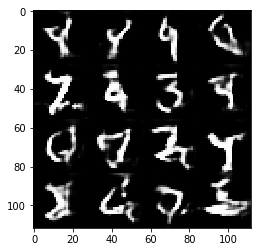

Timestamp 20170806-11-05-04.887 -  Epoch 1/2 -  Step 2110 -  D Loss: 0.9096 - G Loss: 1.4476
Timestamp 20170806-11-05-16.721 -  Epoch 1/2 -  Step 2120 -  D Loss: 1.0836 - G Loss: 1.0074
Timestamp 20170806-11-05-28.529 -  Epoch 1/2 -  Step 2130 -  D Loss: 1.2226 - G Loss: 1.0509
Timestamp 20170806-11-05-40.365 -  Epoch 1/2 -  Step 2140 -  D Loss: 1.0115 - G Loss: 0.9843
Timestamp 20170806-11-05-52.195 -  Epoch 1/2 -  Step 2150 -  D Loss: 1.1446 - G Loss: 0.8510
Timestamp 20170806-11-06-04.015 -  Epoch 1/2 -  Step 2160 -  D Loss: 1.0967 - G Loss: 1.1512
Timestamp 20170806-11-06-15.836 -  Epoch 1/2 -  Step 2170 -  D Loss: 1.3410 - G Loss: 0.9477
Timestamp 20170806-11-06-27.685 -  Epoch 1/2 -  Step 2180 -  D Loss: 0.9080 - G Loss: 0.9279
Timestamp 20170806-11-06-39.531 -  Epoch 1/2 -  Step 2190 -  D Loss: 1.2367 - G Loss: 1.5399
Timestamp 20170806-11-06-51.352 -  Epoch 1/2 -  Step 2200 -  D Loss: 1.3608 - G Loss: 0.8713


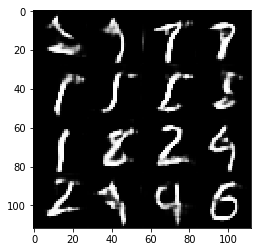

Timestamp 20170806-11-07-03.943 -  Epoch 1/2 -  Step 2210 -  D Loss: 1.1852 - G Loss: 1.2330
Timestamp 20170806-11-07-15.758 -  Epoch 1/2 -  Step 2220 -  D Loss: 1.2339 - G Loss: 0.7760
Timestamp 20170806-11-07-27.566 -  Epoch 1/2 -  Step 2230 -  D Loss: 1.0050 - G Loss: 1.3773
Timestamp 20170806-11-07-39.373 -  Epoch 1/2 -  Step 2240 -  D Loss: 1.1373 - G Loss: 1.0516
Timestamp 20170806-11-07-51.204 -  Epoch 1/2 -  Step 2250 -  D Loss: 1.4034 - G Loss: 1.3112
Timestamp 20170806-11-08-03.040 -  Epoch 1/2 -  Step 2260 -  D Loss: 1.2799 - G Loss: 1.1208
Timestamp 20170806-11-08-14.878 -  Epoch 1/2 -  Step 2270 -  D Loss: 1.2710 - G Loss: 1.1237
Timestamp 20170806-11-08-26.687 -  Epoch 1/2 -  Step 2280 -  D Loss: 1.4258 - G Loss: 1.0740
Timestamp 20170806-11-08-38.523 -  Epoch 1/2 -  Step 2290 -  D Loss: 1.1907 - G Loss: 0.7607
Timestamp 20170806-11-08-50.352 -  Epoch 1/2 -  Step 2300 -  D Loss: 1.0946 - G Loss: 0.7753


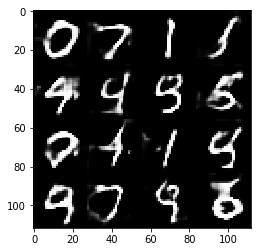

Timestamp 20170806-11-09-02.840 -  Epoch 1/2 -  Step 2310 -  D Loss: 1.2776 - G Loss: 0.6753
Timestamp 20170806-11-09-14.662 -  Epoch 1/2 -  Step 2320 -  D Loss: 1.1447 - G Loss: 0.8160
Timestamp 20170806-11-09-26.475 -  Epoch 1/2 -  Step 2330 -  D Loss: 1.2186 - G Loss: 1.0589
Timestamp 20170806-11-09-38.286 -  Epoch 1/2 -  Step 2340 -  D Loss: 0.8715 - G Loss: 1.2719
Timestamp 20170806-11-09-50.129 -  Epoch 1/2 -  Step 2350 -  D Loss: 1.1711 - G Loss: 0.9744
Timestamp 20170806-11-10-01.965 -  Epoch 1/2 -  Step 2360 -  D Loss: 0.8893 - G Loss: 1.0904
Timestamp 20170806-11-10-13.781 -  Epoch 1/2 -  Step 2370 -  D Loss: 1.4777 - G Loss: 0.8345
Timestamp 20170806-11-10-25.591 -  Epoch 1/2 -  Step 2380 -  D Loss: 1.2262 - G Loss: 1.3061
Timestamp 20170806-11-10-37.412 -  Epoch 1/2 -  Step 2390 -  D Loss: 1.2591 - G Loss: 0.9499
Timestamp 20170806-11-10-49.233 -  Epoch 1/2 -  Step 2400 -  D Loss: 1.1072 - G Loss: 0.6693


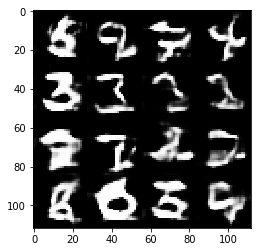

Timestamp 20170806-11-11-01.712 -  Epoch 1/2 -  Step 2410 -  D Loss: 0.8824 - G Loss: 1.5463
Timestamp 20170806-11-11-13.530 -  Epoch 1/2 -  Step 2420 -  D Loss: 1.4009 - G Loss: 1.1910
Timestamp 20170806-11-11-25.363 -  Epoch 1/2 -  Step 2430 -  D Loss: 1.2033 - G Loss: 0.7620
Timestamp 20170806-11-11-37.184 -  Epoch 1/2 -  Step 2440 -  D Loss: 1.3169 - G Loss: 0.7824
Timestamp 20170806-11-11-48.992 -  Epoch 1/2 -  Step 2450 -  D Loss: 0.9155 - G Loss: 1.1946
Timestamp 20170806-11-12-00.800 -  Epoch 1/2 -  Step 2460 -  D Loss: 1.0008 - G Loss: 0.5742
Timestamp 20170806-11-12-12.646 -  Epoch 1/2 -  Step 2470 -  D Loss: 1.0721 - G Loss: 1.0747
Timestamp 20170806-11-12-24.480 -  Epoch 1/2 -  Step 2480 -  D Loss: 1.2288 - G Loss: 1.0763
Timestamp 20170806-11-12-36.355 -  Epoch 1/2 -  Step 2490 -  D Loss: 1.1617 - G Loss: 1.2900
Timestamp 20170806-11-12-48.196 -  Epoch 1/2 -  Step 2500 -  D Loss: 1.0504 - G Loss: 0.9593


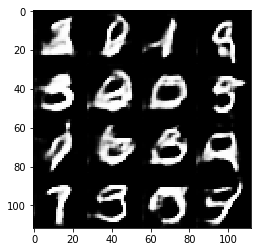

Timestamp 20170806-11-13-00.812 -  Epoch 1/2 -  Step 2510 -  D Loss: 1.0554 - G Loss: 1.0409
Timestamp 20170806-11-13-12.651 -  Epoch 1/2 -  Step 2520 -  D Loss: 1.5799 - G Loss: 0.6999
Timestamp 20170806-11-13-24.481 -  Epoch 1/2 -  Step 2530 -  D Loss: 1.1357 - G Loss: 1.1476
Timestamp 20170806-11-13-36.334 -  Epoch 1/2 -  Step 2540 -  D Loss: 1.7230 - G Loss: 0.9782
Timestamp 20170806-11-13-48.175 -  Epoch 1/2 -  Step 2550 -  D Loss: 1.0608 - G Loss: 1.2219
Timestamp 20170806-11-14-00.008 -  Epoch 1/2 -  Step 2560 -  D Loss: 1.3271 - G Loss: 0.7450
Timestamp 20170806-11-14-11.835 -  Epoch 1/2 -  Step 2570 -  D Loss: 1.4605 - G Loss: 0.6513
Timestamp 20170806-11-14-23.660 -  Epoch 1/2 -  Step 2580 -  D Loss: 1.0726 - G Loss: 1.3327
Timestamp 20170806-11-14-35.485 -  Epoch 1/2 -  Step 2590 -  D Loss: 1.2526 - G Loss: 0.7899
Timestamp 20170806-11-14-47.309 -  Epoch 1/2 -  Step 2600 -  D Loss: 1.2899 - G Loss: 0.8180


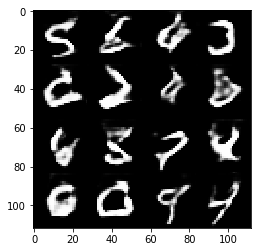

Timestamp 20170806-11-14-59.837 -  Epoch 1/2 -  Step 2610 -  D Loss: 1.3567 - G Loss: 0.6663
Timestamp 20170806-11-15-11.648 -  Epoch 1/2 -  Step 2620 -  D Loss: 1.0057 - G Loss: 1.2799
Timestamp 20170806-11-15-23.477 -  Epoch 1/2 -  Step 2630 -  D Loss: 1.4457 - G Loss: 0.8348
Timestamp 20170806-11-15-35.301 -  Epoch 1/2 -  Step 2640 -  D Loss: 1.2516 - G Loss: 0.9811
Timestamp 20170806-11-15-47.122 -  Epoch 1/2 -  Step 2650 -  D Loss: 1.3211 - G Loss: 0.5841
Timestamp 20170806-11-15-58.958 -  Epoch 1/2 -  Step 2660 -  D Loss: 0.8193 - G Loss: 1.5925
Timestamp 20170806-11-16-10.776 -  Epoch 1/2 -  Step 2670 -  D Loss: 0.9907 - G Loss: 1.4010
Timestamp 20170806-11-16-22.609 -  Epoch 1/2 -  Step 2680 -  D Loss: 1.4709 - G Loss: 0.8709
Timestamp 20170806-11-16-34.444 -  Epoch 1/2 -  Step 2690 -  D Loss: 1.2626 - G Loss: 1.1631
Timestamp 20170806-11-16-46.271 -  Epoch 1/2 -  Step 2700 -  D Loss: 1.2670 - G Loss: 1.3470


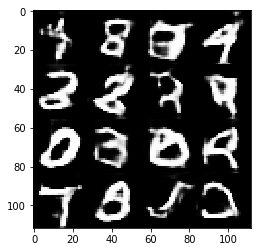

Timestamp 20170806-11-16-58.772 -  Epoch 1/2 -  Step 2710 -  D Loss: 1.2291 - G Loss: 0.7977
Timestamp 20170806-11-17-10.598 -  Epoch 1/2 -  Step 2720 -  D Loss: 1.1274 - G Loss: 1.2715
Timestamp 20170806-11-17-22.421 -  Epoch 1/2 -  Step 2730 -  D Loss: 1.0860 - G Loss: 1.0517
Timestamp 20170806-11-17-34.246 -  Epoch 1/2 -  Step 2740 -  D Loss: 1.4045 - G Loss: 0.7317
Timestamp 20170806-11-17-46.058 -  Epoch 1/2 -  Step 2750 -  D Loss: 1.3218 - G Loss: 0.8385
Timestamp 20170806-11-17-57.883 -  Epoch 1/2 -  Step 2760 -  D Loss: 1.2574 - G Loss: 0.9280
Timestamp 20170806-11-18-09.711 -  Epoch 1/2 -  Step 2770 -  D Loss: 1.2430 - G Loss: 0.9702
Timestamp 20170806-11-18-21.538 -  Epoch 1/2 -  Step 2780 -  D Loss: 0.9936 - G Loss: 1.1797
Timestamp 20170806-11-18-33.346 -  Epoch 1/2 -  Step 2790 -  D Loss: 1.1280 - G Loss: 1.0976
Timestamp 20170806-11-18-45.177 -  Epoch 1/2 -  Step 2800 -  D Loss: 1.2246 - G Loss: 1.1365


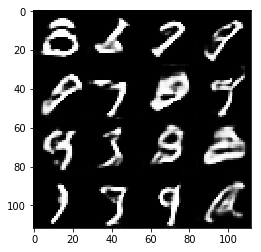

Timestamp 20170806-11-18-57.758 -  Epoch 1/2 -  Step 2810 -  D Loss: 0.9287 - G Loss: 1.5153
Timestamp 20170806-11-19-09.572 -  Epoch 1/2 -  Step 2820 -  D Loss: 1.4523 - G Loss: 1.0258
Timestamp 20170806-11-19-21.393 -  Epoch 1/2 -  Step 2830 -  D Loss: 1.1563 - G Loss: 1.1774
Timestamp 20170806-11-19-33.228 -  Epoch 1/2 -  Step 2840 -  D Loss: 1.2208 - G Loss: 0.9603
Timestamp 20170806-11-19-45.040 -  Epoch 1/2 -  Step 2850 -  D Loss: 1.4237 - G Loss: 0.8341
Timestamp 20170806-11-19-56.868 -  Epoch 1/2 -  Step 2860 -  D Loss: 1.2422 - G Loss: 0.8333
Timestamp 20170806-11-20-08.695 -  Epoch 1/2 -  Step 2870 -  D Loss: 1.1280 - G Loss: 0.7981
Timestamp 20170806-11-20-20.514 -  Epoch 1/2 -  Step 2880 -  D Loss: 0.9735 - G Loss: 0.7821
Timestamp 20170806-11-20-32.330 -  Epoch 1/2 -  Step 2890 -  D Loss: 1.2301 - G Loss: 1.1212
Timestamp 20170806-11-20-44.161 -  Epoch 1/2 -  Step 2900 -  D Loss: 1.4393 - G Loss: 0.7779


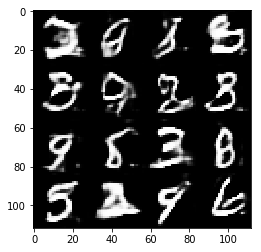

Timestamp 20170806-11-20-56.684 -  Epoch 1/2 -  Step 2910 -  D Loss: 1.0264 - G Loss: 1.3054
Timestamp 20170806-11-21-08.535 -  Epoch 1/2 -  Step 2920 -  D Loss: 1.0781 - G Loss: 0.8159
Timestamp 20170806-11-21-20.344 -  Epoch 1/2 -  Step 2930 -  D Loss: 1.4310 - G Loss: 0.8702
Timestamp 20170806-11-21-32.160 -  Epoch 1/2 -  Step 2940 -  D Loss: 1.2074 - G Loss: 0.9225
Timestamp 20170806-11-21-43.966 -  Epoch 1/2 -  Step 2950 -  D Loss: 1.2323 - G Loss: 1.1193
Timestamp 20170806-11-21-55.780 -  Epoch 1/2 -  Step 2960 -  D Loss: 1.3236 - G Loss: 1.1673
Timestamp 20170806-11-22-07.616 -  Epoch 1/2 -  Step 2970 -  D Loss: 1.3770 - G Loss: 0.7049
Timestamp 20170806-11-22-19.437 -  Epoch 1/2 -  Step 2980 -  D Loss: 1.1144 - G Loss: 0.9314
Timestamp 20170806-11-22-31.267 -  Epoch 1/2 -  Step 2990 -  D Loss: 0.9922 - G Loss: 1.0612
Timestamp 20170806-11-22-43.100 -  Epoch 1/2 -  Step 3000 -  D Loss: 1.1302 - G Loss: 1.0036


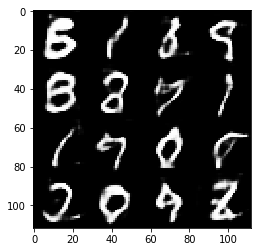

Timestamp 20170806-11-22-55.631 -  Epoch 1/2 -  Step 3010 -  D Loss: 1.1716 - G Loss: 0.7622
Timestamp 20170806-11-23-07.463 -  Epoch 1/2 -  Step 3020 -  D Loss: 1.5339 - G Loss: 0.8324
Timestamp 20170806-11-23-19.279 -  Epoch 1/2 -  Step 3030 -  D Loss: 1.0017 - G Loss: 0.9899
Timestamp 20170806-11-23-31.092 -  Epoch 1/2 -  Step 3040 -  D Loss: 1.0313 - G Loss: 0.9875
Timestamp 20170806-11-23-42.912 -  Epoch 1/2 -  Step 3050 -  D Loss: 1.3909 - G Loss: 0.8882
Timestamp 20170806-11-23-54.725 -  Epoch 1/2 -  Step 3060 -  D Loss: 1.0248 - G Loss: 0.9165
Timestamp 20170806-11-24-06.539 -  Epoch 1/2 -  Step 3070 -  D Loss: 1.2598 - G Loss: 1.0403
Timestamp 20170806-11-24-18.362 -  Epoch 1/2 -  Step 3080 -  D Loss: 1.3361 - G Loss: 1.1297
Timestamp 20170806-11-24-30.187 -  Epoch 1/2 -  Step 3090 -  D Loss: 1.3954 - G Loss: 1.0854
Timestamp 20170806-11-24-42.014 -  Epoch 1/2 -  Step 3100 -  D Loss: 1.2855 - G Loss: 0.8772


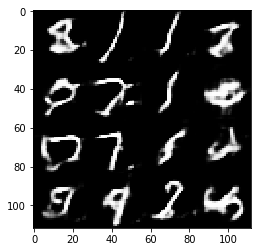

Timestamp 20170806-11-24-54.525 -  Epoch 1/2 -  Step 3110 -  D Loss: 1.2690 - G Loss: 1.0691
Timestamp 20170806-11-25-06.355 -  Epoch 1/2 -  Step 3120 -  D Loss: 1.0256 - G Loss: 0.9074
Timestamp 20170806-11-25-18.175 -  Epoch 1/2 -  Step 3130 -  D Loss: 1.1699 - G Loss: 0.9356
Timestamp 20170806-11-25-29.993 -  Epoch 1/2 -  Step 3140 -  D Loss: 1.1448 - G Loss: 1.0935
Timestamp 20170806-11-25-41.819 -  Epoch 1/2 -  Step 3150 -  D Loss: 0.9961 - G Loss: 1.1345
Timestamp 20170806-11-25-53.629 -  Epoch 1/2 -  Step 3160 -  D Loss: 1.1665 - G Loss: 0.7564
Timestamp 20170806-11-26-05.447 -  Epoch 1/2 -  Step 3170 -  D Loss: 1.0823 - G Loss: 0.7163
Timestamp 20170806-11-26-17.276 -  Epoch 1/2 -  Step 3180 -  D Loss: 1.4523 - G Loss: 0.6032
Timestamp 20170806-11-26-29.094 -  Epoch 1/2 -  Step 3190 -  D Loss: 1.3618 - G Loss: 0.4691
Timestamp 20170806-11-26-40.921 -  Epoch 1/2 -  Step 3200 -  D Loss: 1.4059 - G Loss: 0.7751


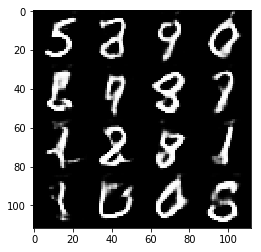

Timestamp 20170806-11-26-53.439 -  Epoch 1/2 -  Step 3210 -  D Loss: 1.2191 - G Loss: 1.0796
Timestamp 20170806-11-27-05.255 -  Epoch 1/2 -  Step 3220 -  D Loss: 0.9364 - G Loss: 1.0819
Timestamp 20170806-11-27-17.099 -  Epoch 1/2 -  Step 3230 -  D Loss: 1.6318 - G Loss: 0.8657
Timestamp 20170806-11-27-28.923 -  Epoch 1/2 -  Step 3240 -  D Loss: 1.0816 - G Loss: 1.0139
Timestamp 20170806-11-27-40.745 -  Epoch 1/2 -  Step 3250 -  D Loss: 1.0790 - G Loss: 1.0808
Timestamp 20170806-11-27-52.566 -  Epoch 1/2 -  Step 3260 -  D Loss: 1.2445 - G Loss: 1.2337
Timestamp 20170806-11-28-04.398 -  Epoch 1/2 -  Step 3270 -  D Loss: 1.0871 - G Loss: 0.8734
Timestamp 20170806-11-28-16.210 -  Epoch 1/2 -  Step 3280 -  D Loss: 1.2208 - G Loss: 0.8565
Timestamp 20170806-11-28-28.033 -  Epoch 1/2 -  Step 3290 -  D Loss: 1.3343 - G Loss: 1.0996
Timestamp 20170806-11-28-39.852 -  Epoch 1/2 -  Step 3300 -  D Loss: 1.1576 - G Loss: 0.7497


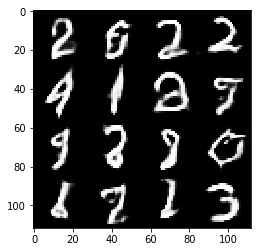

Timestamp 20170806-11-28-52.367 -  Epoch 1/2 -  Step 3310 -  D Loss: 1.3156 - G Loss: 0.9255
Timestamp 20170806-11-29-04.165 -  Epoch 1/2 -  Step 3320 -  D Loss: 1.4250 - G Loss: 0.8023
Timestamp 20170806-11-29-16.017 -  Epoch 1/2 -  Step 3330 -  D Loss: 0.9905 - G Loss: 0.9635
Timestamp 20170806-11-29-27.833 -  Epoch 1/2 -  Step 3340 -  D Loss: 1.2858 - G Loss: 0.7089
Timestamp 20170806-11-29-39.649 -  Epoch 1/2 -  Step 3350 -  D Loss: 0.9355 - G Loss: 1.2103
Timestamp 20170806-11-29-51.477 -  Epoch 1/2 -  Step 3360 -  D Loss: 1.1617 - G Loss: 0.8852
Timestamp 20170806-11-30-03.285 -  Epoch 1/2 -  Step 3370 -  D Loss: 0.8528 - G Loss: 1.3295
Timestamp 20170806-11-30-15.099 -  Epoch 1/2 -  Step 3380 -  D Loss: 1.4362 - G Loss: 0.8611
Timestamp 20170806-11-30-26.917 -  Epoch 1/2 -  Step 3390 -  D Loss: 1.3480 - G Loss: 0.5607
Timestamp 20170806-11-30-38.766 -  Epoch 1/2 -  Step 3400 -  D Loss: 1.3524 - G Loss: 1.2917


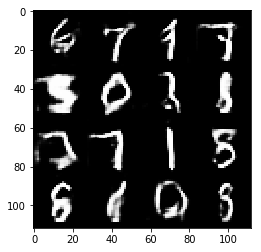

Timestamp 20170806-11-30-51.278 -  Epoch 1/2 -  Step 3410 -  D Loss: 1.1242 - G Loss: 0.8860
Timestamp 20170806-11-31-03.095 -  Epoch 1/2 -  Step 3420 -  D Loss: 1.0531 - G Loss: 0.9787
Timestamp 20170806-11-31-14.913 -  Epoch 1/2 -  Step 3430 -  D Loss: 0.8617 - G Loss: 1.3773
Timestamp 20170806-11-31-26.740 -  Epoch 1/2 -  Step 3440 -  D Loss: 1.2357 - G Loss: 0.8304
Timestamp 20170806-11-31-38.558 -  Epoch 1/2 -  Step 3450 -  D Loss: 1.0413 - G Loss: 1.0740
Timestamp 20170806-11-31-50.380 -  Epoch 1/2 -  Step 3460 -  D Loss: 1.1136 - G Loss: 0.7504
Timestamp 20170806-11-32-02.220 -  Epoch 1/2 -  Step 3470 -  D Loss: 1.4367 - G Loss: 0.7951
Timestamp 20170806-11-32-14.031 -  Epoch 1/2 -  Step 3480 -  D Loss: 0.9782 - G Loss: 1.1967
Timestamp 20170806-11-32-25.850 -  Epoch 1/2 -  Step 3490 -  D Loss: 1.2953 - G Loss: 0.8332
Timestamp 20170806-11-32-37.679 -  Epoch 1/2 -  Step 3500 -  D Loss: 1.1649 - G Loss: 1.0665


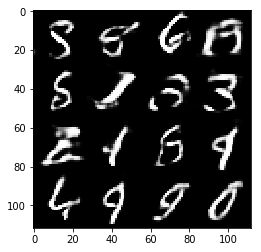

Timestamp 20170806-11-32-52.189 -  Epoch 1/2 -  Step 3510 -  D Loss: 1.3098 - G Loss: 0.9545
Timestamp 20170806-11-33-04.014 -  Epoch 1/2 -  Step 3520 -  D Loss: 1.3831 - G Loss: 0.9713
Timestamp 20170806-11-33-15.843 -  Epoch 1/2 -  Step 3530 -  D Loss: 1.2698 - G Loss: 0.9588
Timestamp 20170806-11-33-27.671 -  Epoch 1/2 -  Step 3540 -  D Loss: 1.0530 - G Loss: 1.4676
Timestamp 20170806-11-33-39.492 -  Epoch 1/2 -  Step 3550 -  D Loss: 0.9411 - G Loss: 0.6642
Timestamp 20170806-11-33-51.317 -  Epoch 1/2 -  Step 3560 -  D Loss: 1.4731 - G Loss: 0.8642
Timestamp 20170806-11-34-03.121 -  Epoch 1/2 -  Step 3570 -  D Loss: 1.0234 - G Loss: 1.0163
Timestamp 20170806-11-34-14.934 -  Epoch 1/2 -  Step 3580 -  D Loss: 0.9639 - G Loss: 1.4459
Timestamp 20170806-11-34-26.755 -  Epoch 1/2 -  Step 3590 -  D Loss: 1.3580 - G Loss: 1.0953
Timestamp 20170806-11-34-38.573 -  Epoch 1/2 -  Step 3600 -  D Loss: 1.0568 - G Loss: 0.5144


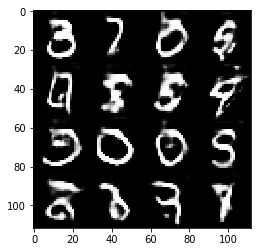

Timestamp 20170806-11-34-51.089 -  Epoch 1/2 -  Step 3610 -  D Loss: 1.1237 - G Loss: 0.9942
Timestamp 20170806-11-35-02.922 -  Epoch 1/2 -  Step 3620 -  D Loss: 1.1058 - G Loss: 1.0077
Timestamp 20170806-11-35-14.725 -  Epoch 1/2 -  Step 3630 -  D Loss: 1.2521 - G Loss: 1.1547
Timestamp 20170806-11-35-26.560 -  Epoch 1/2 -  Step 3640 -  D Loss: 1.1218 - G Loss: 1.3933
Timestamp 20170806-11-35-38.376 -  Epoch 1/2 -  Step 3650 -  D Loss: 1.1661 - G Loss: 1.1331
Timestamp 20170806-11-35-50.213 -  Epoch 1/2 -  Step 3660 -  D Loss: 1.2688 - G Loss: 0.9279
Timestamp 20170806-11-36-02.032 -  Epoch 1/2 -  Step 3670 -  D Loss: 1.3060 - G Loss: 1.0383
Timestamp 20170806-11-36-13.854 -  Epoch 1/2 -  Step 3680 -  D Loss: 1.2321 - G Loss: 0.9917
Timestamp 20170806-11-36-25.673 -  Epoch 1/2 -  Step 3690 -  D Loss: 1.3058 - G Loss: 0.6161
Timestamp 20170806-11-36-37.481 -  Epoch 1/2 -  Step 3700 -  D Loss: 1.2370 - G Loss: 0.8653


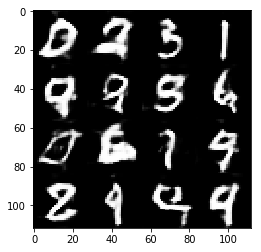

Timestamp 20170806-11-36-50.033 -  Epoch 1/2 -  Step 3710 -  D Loss: 1.2329 - G Loss: 1.2424
Timestamp 20170806-11-37-01.856 -  Epoch 1/2 -  Step 3720 -  D Loss: 1.1769 - G Loss: 1.0029
Timestamp 20170806-11-37-13.688 -  Epoch 1/2 -  Step 3730 -  D Loss: 1.1703 - G Loss: 1.1840
Timestamp 20170806-11-37-25.523 -  Epoch 1/2 -  Step 3740 -  D Loss: 1.1850 - G Loss: 0.8381
Timestamp 20170806-11-37-37.341 -  Epoch 1/2 -  Step 3750 -  D Loss: 0.9478 - G Loss: 1.3361
Timestamp 20170806-11-37-49.179 -  Epoch 1/2 -  Step 3760 -  D Loss: 1.2842 - G Loss: 0.7298
Timestamp 20170806-11-38-01.007 -  Epoch 1/2 -  Step 3770 -  D Loss: 1.2742 - G Loss: 1.0195
Timestamp 20170806-11-38-12.834 -  Epoch 1/2 -  Step 3780 -  D Loss: 1.3554 - G Loss: 0.8735
Timestamp 20170806-11-38-24.651 -  Epoch 1/2 -  Step 3790 -  D Loss: 1.2120 - G Loss: 0.9071
Timestamp 20170806-11-38-36.475 -  Epoch 1/2 -  Step 3800 -  D Loss: 1.1068 - G Loss: 0.8968


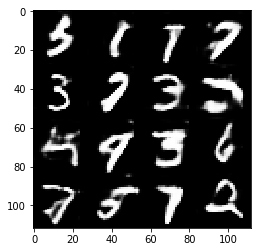

Timestamp 20170806-11-38-48.973 -  Epoch 1/2 -  Step 3810 -  D Loss: 1.1296 - G Loss: 1.0175
Timestamp 20170806-11-39-00.819 -  Epoch 1/2 -  Step 3820 -  D Loss: 1.2121 - G Loss: 0.9509
Timestamp 20170806-11-39-12.643 -  Epoch 1/2 -  Step 3830 -  D Loss: 1.0701 - G Loss: 1.0192
Timestamp 20170806-11-39-24.460 -  Epoch 1/2 -  Step 3840 -  D Loss: 1.2128 - G Loss: 1.1952
Timestamp 20170806-11-39-36.286 -  Epoch 1/2 -  Step 3850 -  D Loss: 1.0323 - G Loss: 1.1022
Timestamp 20170806-11-39-48.097 -  Epoch 1/2 -  Step 3860 -  D Loss: 1.0609 - G Loss: 1.0161
Timestamp 20170806-11-39-59.927 -  Epoch 1/2 -  Step 3870 -  D Loss: 1.5247 - G Loss: 0.7885
Timestamp 20170806-11-40-11.740 -  Epoch 1/2 -  Step 3880 -  D Loss: 1.0969 - G Loss: 1.4935
Timestamp 20170806-11-40-23.562 -  Epoch 1/2 -  Step 3890 -  D Loss: 1.2116 - G Loss: 0.9011
Timestamp 20170806-11-40-35.374 -  Epoch 1/2 -  Step 3900 -  D Loss: 1.0149 - G Loss: 1.3593


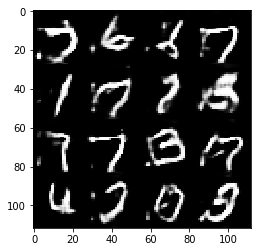

Timestamp 20170806-11-40-47.918 -  Epoch 1/2 -  Step 3910 -  D Loss: 1.1848 - G Loss: 1.1831
Timestamp 20170806-11-40-59.770 -  Epoch 1/2 -  Step 3920 -  D Loss: 0.8821 - G Loss: 1.1688
Timestamp 20170806-11-41-11.607 -  Epoch 1/2 -  Step 3930 -  D Loss: 1.2859 - G Loss: 0.9534
Timestamp 20170806-11-41-23.452 -  Epoch 1/2 -  Step 3940 -  D Loss: 1.2228 - G Loss: 1.0122
Timestamp 20170806-11-41-35.267 -  Epoch 1/2 -  Step 3950 -  D Loss: 1.2790 - G Loss: 0.8426
Timestamp 20170806-11-41-47.085 -  Epoch 1/2 -  Step 3960 -  D Loss: 1.1909 - G Loss: 0.8789
Timestamp 20170806-11-41-58.912 -  Epoch 1/2 -  Step 3970 -  D Loss: 1.2098 - G Loss: 1.0376
Timestamp 20170806-11-42-10.729 -  Epoch 1/2 -  Step 3980 -  D Loss: 1.1647 - G Loss: 1.2442
Timestamp 20170806-11-42-22.543 -  Epoch 1/2 -  Step 3990 -  D Loss: 1.1022 - G Loss: 0.9445
Timestamp 20170806-11-42-34.365 -  Epoch 1/2 -  Step 4000 -  D Loss: 1.1753 - G Loss: 0.9445


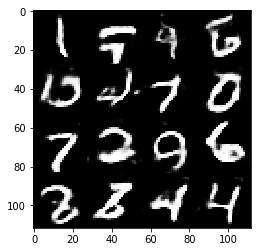

Timestamp 20170806-11-42-46.869 -  Epoch 1/2 -  Step 4010 -  D Loss: 1.0217 - G Loss: 1.6672
Timestamp 20170806-11-42-58.694 -  Epoch 1/2 -  Step 4020 -  D Loss: 1.1796 - G Loss: 0.8257
Timestamp 20170806-11-43-10.515 -  Epoch 1/2 -  Step 4030 -  D Loss: 1.1607 - G Loss: 0.8907
Timestamp 20170806-11-43-22.340 -  Epoch 1/2 -  Step 4040 -  D Loss: 1.0416 - G Loss: 1.1892
Timestamp 20170806-11-43-34.160 -  Epoch 1/2 -  Step 4050 -  D Loss: 1.1886 - G Loss: 0.8673
Timestamp 20170806-11-43-45.972 -  Epoch 1/2 -  Step 4060 -  D Loss: 1.3725 - G Loss: 0.8135
Timestamp 20170806-11-43-57.799 -  Epoch 1/2 -  Step 4070 -  D Loss: 1.3237 - G Loss: 0.7785
Timestamp 20170806-11-44-09.618 -  Epoch 1/2 -  Step 4080 -  D Loss: 1.1211 - G Loss: 1.1271
Timestamp 20170806-11-44-21.425 -  Epoch 1/2 -  Step 4090 -  D Loss: 1.2683 - G Loss: 1.2227
Timestamp 20170806-11-44-33.253 -  Epoch 1/2 -  Step 4100 -  D Loss: 1.1604 - G Loss: 1.1154


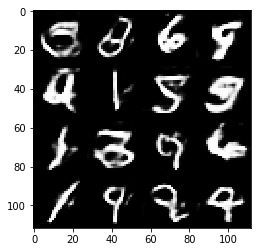

Timestamp 20170806-11-44-45.784 -  Epoch 1/2 -  Step 4110 -  D Loss: 1.0925 - G Loss: 1.0422
Timestamp 20170806-11-44-57.596 -  Epoch 1/2 -  Step 4120 -  D Loss: 1.1225 - G Loss: 0.7843
Timestamp 20170806-11-45-09.418 -  Epoch 1/2 -  Step 4130 -  D Loss: 1.1036 - G Loss: 1.0051
Timestamp 20170806-11-45-21.253 -  Epoch 1/2 -  Step 4140 -  D Loss: 1.0215 - G Loss: 1.1307
Timestamp 20170806-11-45-33.086 -  Epoch 1/2 -  Step 4150 -  D Loss: 1.1020 - G Loss: 0.9273
Timestamp 20170806-11-45-44.891 -  Epoch 1/2 -  Step 4160 -  D Loss: 1.1836 - G Loss: 0.7561
Timestamp 20170806-11-45-56.720 -  Epoch 1/2 -  Step 4170 -  D Loss: 1.0993 - G Loss: 0.9950
Timestamp 20170806-11-46-08.546 -  Epoch 1/2 -  Step 4180 -  D Loss: 1.5379 - G Loss: 0.5826
Timestamp 20170806-11-46-20.363 -  Epoch 1/2 -  Step 4190 -  D Loss: 1.0832 - G Loss: 0.8114
Timestamp 20170806-11-46-32.186 -  Epoch 1/2 -  Step 4200 -  D Loss: 1.0809 - G Loss: 1.3287


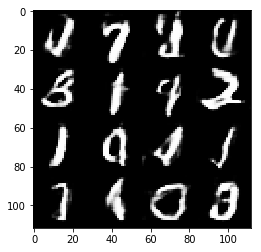

Timestamp 20170806-11-46-44.718 -  Epoch 1/2 -  Step 4210 -  D Loss: 1.3700 - G Loss: 1.1280
Timestamp 20170806-11-46-56.533 -  Epoch 1/2 -  Step 4220 -  D Loss: 1.2662 - G Loss: 0.7664
Timestamp 20170806-11-47-08.369 -  Epoch 1/2 -  Step 4230 -  D Loss: 1.1092 - G Loss: 0.9324
Timestamp 20170806-11-47-20.197 -  Epoch 1/2 -  Step 4240 -  D Loss: 1.1885 - G Loss: 1.1762
Timestamp 20170806-11-47-32.008 -  Epoch 1/2 -  Step 4250 -  D Loss: 1.2757 - G Loss: 0.9599
Timestamp 20170806-11-47-43.819 -  Epoch 1/2 -  Step 4260 -  D Loss: 1.5110 - G Loss: 1.2258
Timestamp 20170806-11-47-55.644 -  Epoch 1/2 -  Step 4270 -  D Loss: 1.1897 - G Loss: 0.9067
Timestamp 20170806-11-48-07.480 -  Epoch 1/2 -  Step 4280 -  D Loss: 1.0434 - G Loss: 1.2838
Timestamp 20170806-11-48-19.297 -  Epoch 1/2 -  Step 4290 -  D Loss: 0.9232 - G Loss: 0.9232
Timestamp 20170806-11-48-31.117 -  Epoch 1/2 -  Step 4300 -  D Loss: 0.7703 - G Loss: 1.6183


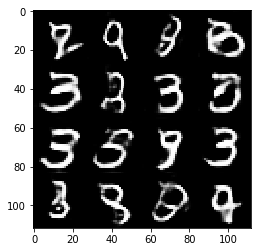

Timestamp 20170806-11-48-43.629 -  Epoch 1/2 -  Step 4310 -  D Loss: 1.2966 - G Loss: 1.2541
Timestamp 20170806-11-48-55.440 -  Epoch 1/2 -  Step 4320 -  D Loss: 1.2993 - G Loss: 1.0130
Timestamp 20170806-11-49-07.253 -  Epoch 1/2 -  Step 4330 -  D Loss: 1.0269 - G Loss: 1.2733
Timestamp 20170806-11-49-19.064 -  Epoch 1/2 -  Step 4340 -  D Loss: 1.2858 - G Loss: 1.0037
Timestamp 20170806-11-49-30.871 -  Epoch 1/2 -  Step 4350 -  D Loss: 1.1528 - G Loss: 0.9828
Timestamp 20170806-11-49-42.667 -  Epoch 1/2 -  Step 4360 -  D Loss: 0.9947 - G Loss: 0.9430
Timestamp 20170806-11-49-54.528 -  Epoch 1/2 -  Step 4370 -  D Loss: 1.2872 - G Loss: 1.0127
Timestamp 20170806-11-50-06.361 -  Epoch 1/2 -  Step 4380 -  D Loss: 1.3377 - G Loss: 1.3861
Timestamp 20170806-11-50-18.172 -  Epoch 1/2 -  Step 4390 -  D Loss: 1.2798 - G Loss: 0.9067
Timestamp 20170806-11-50-29.992 -  Epoch 1/2 -  Step 4400 -  D Loss: 1.1203 - G Loss: 0.8445


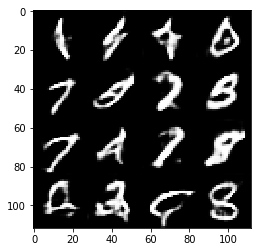

Timestamp 20170806-11-50-42.540 -  Epoch 1/2 -  Step 4410 -  D Loss: 1.4847 - G Loss: 0.8269
Timestamp 20170806-11-50-54.361 -  Epoch 1/2 -  Step 4420 -  D Loss: 1.2988 - G Loss: 0.8902
Timestamp 20170806-11-51-06.170 -  Epoch 1/2 -  Step 4430 -  D Loss: 1.1398 - G Loss: 1.1864
Timestamp 20170806-11-51-17.990 -  Epoch 1/2 -  Step 4440 -  D Loss: 1.1234 - G Loss: 0.9802
Timestamp 20170806-11-51-29.801 -  Epoch 1/2 -  Step 4450 -  D Loss: 1.1760 - G Loss: 0.9207
Timestamp 20170806-11-51-41.617 -  Epoch 1/2 -  Step 4460 -  D Loss: 1.3162 - G Loss: 0.6510
Timestamp 20170806-11-51-53.436 -  Epoch 1/2 -  Step 4470 -  D Loss: 1.2374 - G Loss: 1.1928
Timestamp 20170806-11-52-05.235 -  Epoch 1/2 -  Step 4480 -  D Loss: 1.0087 - G Loss: 0.9946
Timestamp 20170806-11-52-17.060 -  Epoch 1/2 -  Step 4490 -  D Loss: 1.1859 - G Loss: 1.3398
Timestamp 20170806-11-52-28.895 -  Epoch 1/2 -  Step 4500 -  D Loss: 1.0819 - G Loss: 0.6612


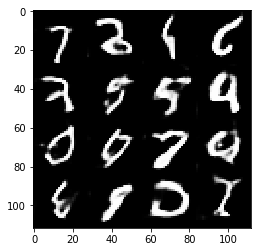

Timestamp 20170806-11-52-41.416 -  Epoch 1/2 -  Step 4510 -  D Loss: 1.4621 - G Loss: 1.1297
Timestamp 20170806-11-52-53.229 -  Epoch 1/2 -  Step 4520 -  D Loss: 0.7748 - G Loss: 1.3105
Timestamp 20170806-11-53-05.040 -  Epoch 1/2 -  Step 4530 -  D Loss: 1.1191 - G Loss: 1.1190
Timestamp 20170806-11-53-16.850 -  Epoch 1/2 -  Step 4540 -  D Loss: 1.2605 - G Loss: 1.0203
Timestamp 20170806-11-53-28.674 -  Epoch 1/2 -  Step 4550 -  D Loss: 1.4913 - G Loss: 0.6446
Timestamp 20170806-11-53-40.479 -  Epoch 1/2 -  Step 4560 -  D Loss: 1.3150 - G Loss: 0.9161
Timestamp 20170806-11-53-52.324 -  Epoch 1/2 -  Step 4570 -  D Loss: 1.0383 - G Loss: 0.8823
Timestamp 20170806-11-54-04.160 -  Epoch 1/2 -  Step 4580 -  D Loss: 1.0409 - G Loss: 1.4006
Timestamp 20170806-11-54-15.971 -  Epoch 1/2 -  Step 4590 -  D Loss: 1.6779 - G Loss: 1.0785
Timestamp 20170806-11-54-27.791 -  Epoch 1/2 -  Step 4600 -  D Loss: 1.1546 - G Loss: 1.0989


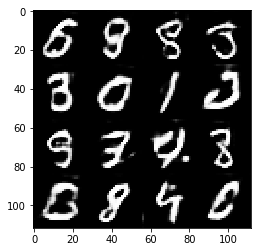

Timestamp 20170806-11-54-40.305 -  Epoch 1/2 -  Step 4610 -  D Loss: 1.3193 - G Loss: 0.7477
Timestamp 20170806-11-54-52.112 -  Epoch 1/2 -  Step 4620 -  D Loss: 1.2278 - G Loss: 0.7412
Timestamp 20170806-11-55-03.916 -  Epoch 1/2 -  Step 4630 -  D Loss: 1.2878 - G Loss: 1.0410
Timestamp 20170806-11-55-15.726 -  Epoch 1/2 -  Step 4640 -  D Loss: 1.1011 - G Loss: 0.7671
Timestamp 20170806-11-55-27.555 -  Epoch 1/2 -  Step 4650 -  D Loss: 1.3067 - G Loss: 0.9045
Timestamp 20170806-11-55-39.358 -  Epoch 1/2 -  Step 4660 -  D Loss: 1.2836 - G Loss: 0.8797
Timestamp 20170806-11-55-51.180 -  Epoch 1/2 -  Step 4670 -  D Loss: 1.2227 - G Loss: 0.7375
Timestamp 20170806-11-56-02.999 -  Epoch 1/2 -  Step 4680 -  D Loss: 1.3219 - G Loss: 1.1736
Timestamp 20170806-11-56-14.817 -  Epoch 1/2 -  Step 4690 -  D Loss: 1.5660 - G Loss: 1.1317
Timestamp 20170806-11-56-26.629 -  Epoch 1/2 -  Step 4700 -  D Loss: 1.3402 - G Loss: 1.1775


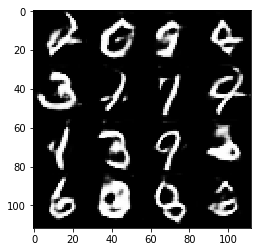

Timestamp 20170806-11-56-39.151 -  Epoch 1/2 -  Step 4710 -  D Loss: 1.4354 - G Loss: 0.4156
Timestamp 20170806-11-56-50.982 -  Epoch 1/2 -  Step 4720 -  D Loss: 0.9603 - G Loss: 1.4242
Timestamp 20170806-11-57-02.797 -  Epoch 1/2 -  Step 4730 -  D Loss: 1.4390 - G Loss: 1.2585
Timestamp 20170806-11-57-14.594 -  Epoch 1/2 -  Step 4740 -  D Loss: 1.1514 - G Loss: 1.3490
Timestamp 20170806-11-57-26.410 -  Epoch 1/2 -  Step 4750 -  D Loss: 1.4428 - G Loss: 0.4891
Timestamp 20170806-11-57-38.224 -  Epoch 1/2 -  Step 4760 -  D Loss: 1.3128 - G Loss: 0.4692
Timestamp 20170806-11-57-50.039 -  Epoch 1/2 -  Step 4770 -  D Loss: 0.9842 - G Loss: 0.6373
Timestamp 20170806-11-58-01.855 -  Epoch 1/2 -  Step 4780 -  D Loss: 1.2109 - G Loss: 1.4331
Timestamp 20170806-11-58-13.689 -  Epoch 1/2 -  Step 4790 -  D Loss: 1.0461 - G Loss: 0.8377
Timestamp 20170806-11-58-25.522 -  Epoch 1/2 -  Step 4800 -  D Loss: 1.1738 - G Loss: 1.4870


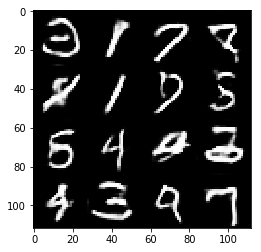

Timestamp 20170806-11-58-38.038 -  Epoch 1/2 -  Step 4810 -  D Loss: 1.1333 - G Loss: 0.8611
Timestamp 20170806-11-58-49.856 -  Epoch 1/2 -  Step 4820 -  D Loss: 0.9181 - G Loss: 1.1271
Timestamp 20170806-11-59-01.683 -  Epoch 1/2 -  Step 4830 -  D Loss: 1.4074 - G Loss: 1.2056
Timestamp 20170806-11-59-13.491 -  Epoch 1/2 -  Step 4840 -  D Loss: 1.0621 - G Loss: 0.9949
Timestamp 20170806-11-59-25.305 -  Epoch 1/2 -  Step 4850 -  D Loss: 1.4465 - G Loss: 0.6044
Timestamp 20170806-11-59-37.120 -  Epoch 1/2 -  Step 4860 -  D Loss: 1.5391 - G Loss: 0.6145
Timestamp 20170806-11-59-48.967 -  Epoch 1/2 -  Step 4870 -  D Loss: 1.2309 - G Loss: 1.2420
Timestamp 20170806-12-00-00.798 -  Epoch 1/2 -  Step 4880 -  D Loss: 1.1205 - G Loss: 0.9779
Timestamp 20170806-12-00-12.609 -  Epoch 1/2 -  Step 4890 -  D Loss: 1.2565 - G Loss: 0.9178
Timestamp 20170806-12-00-24.411 -  Epoch 1/2 -  Step 4900 -  D Loss: 1.1879 - G Loss: 1.4861


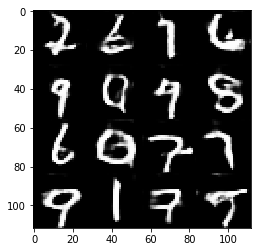

Timestamp 20170806-12-00-36.953 -  Epoch 1/2 -  Step 4910 -  D Loss: 0.9662 - G Loss: 1.0774
Timestamp 20170806-12-00-48.774 -  Epoch 1/2 -  Step 4920 -  D Loss: 1.1267 - G Loss: 1.1311
Timestamp 20170806-12-01-00.607 -  Epoch 1/2 -  Step 4930 -  D Loss: 0.8495 - G Loss: 1.5751
Timestamp 20170806-12-01-12.430 -  Epoch 1/2 -  Step 4940 -  D Loss: 1.0601 - G Loss: 0.7249
Timestamp 20170806-12-01-24.237 -  Epoch 1/2 -  Step 4950 -  D Loss: 1.2454 - G Loss: 0.7040
Timestamp 20170806-12-01-36.052 -  Epoch 1/2 -  Step 4960 -  D Loss: 1.3439 - G Loss: 0.9033
Timestamp 20170806-12-01-47.862 -  Epoch 1/2 -  Step 4970 -  D Loss: 1.2054 - G Loss: 1.0168
Timestamp 20170806-12-01-59.686 -  Epoch 1/2 -  Step 4980 -  D Loss: 0.9572 - G Loss: 1.6671
Timestamp 20170806-12-02-11.493 -  Epoch 1/2 -  Step 4990 -  D Loss: 1.3154 - G Loss: 0.7678
Timestamp 20170806-12-02-23.312 -  Epoch 1/2 -  Step 5000 -  D Loss: 0.8881 - G Loss: 1.4995


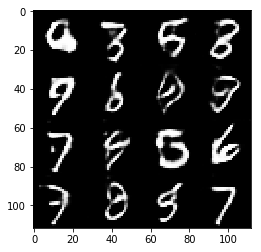

Timestamp 20170806-12-02-35.842 -  Epoch 1/2 -  Step 5010 -  D Loss: 0.8682 - G Loss: 1.1851
Timestamp 20170806-12-02-47.656 -  Epoch 1/2 -  Step 5020 -  D Loss: 1.2520 - G Loss: 1.1970
Timestamp 20170806-12-02-59.470 -  Epoch 1/2 -  Step 5030 -  D Loss: 1.1522 - G Loss: 1.0931
Timestamp 20170806-12-03-11.311 -  Epoch 1/2 -  Step 5040 -  D Loss: 1.4706 - G Loss: 0.7719
Timestamp 20170806-12-03-23.149 -  Epoch 1/2 -  Step 5050 -  D Loss: 1.2412 - G Loss: 0.9394
Timestamp 20170806-12-03-34.982 -  Epoch 1/2 -  Step 5060 -  D Loss: 1.6853 - G Loss: 0.5746
Timestamp 20170806-12-03-46.815 -  Epoch 1/2 -  Step 5070 -  D Loss: 1.0955 - G Loss: 1.2331
Timestamp 20170806-12-03-58.642 -  Epoch 1/2 -  Step 5080 -  D Loss: 1.0311 - G Loss: 1.0344
Timestamp 20170806-12-04-10.454 -  Epoch 1/2 -  Step 5090 -  D Loss: 0.8609 - G Loss: 1.2821
Timestamp 20170806-12-04-22.284 -  Epoch 1/2 -  Step 5100 -  D Loss: 1.4685 - G Loss: 1.1123


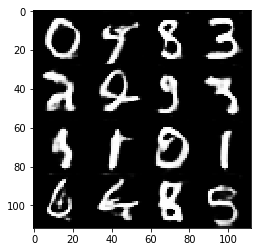

Timestamp 20170806-12-04-34.826 -  Epoch 1/2 -  Step 5110 -  D Loss: 1.2130 - G Loss: 1.1627
Timestamp 20170806-12-04-46.634 -  Epoch 1/2 -  Step 5120 -  D Loss: 1.1149 - G Loss: 0.8398
Timestamp 20170806-12-04-58.459 -  Epoch 1/2 -  Step 5130 -  D Loss: 1.0311 - G Loss: 0.7964
Timestamp 20170806-12-05-10.285 -  Epoch 1/2 -  Step 5140 -  D Loss: 1.2043 - G Loss: 0.8619
Timestamp 20170806-12-05-22.103 -  Epoch 1/2 -  Step 5150 -  D Loss: 0.9086 - G Loss: 1.0466
Timestamp 20170806-12-05-33.926 -  Epoch 1/2 -  Step 5160 -  D Loss: 1.3160 - G Loss: 0.6461
Timestamp 20170806-12-05-45.730 -  Epoch 1/2 -  Step 5170 -  D Loss: 1.3835 - G Loss: 0.4830
Timestamp 20170806-12-05-57.549 -  Epoch 1/2 -  Step 5180 -  D Loss: 1.4337 - G Loss: 1.0759
Timestamp 20170806-12-06-09.359 -  Epoch 1/2 -  Step 5190 -  D Loss: 1.3942 - G Loss: 1.0475
Timestamp 20170806-12-06-21.187 -  Epoch 1/2 -  Step 5200 -  D Loss: 1.3926 - G Loss: 0.6864


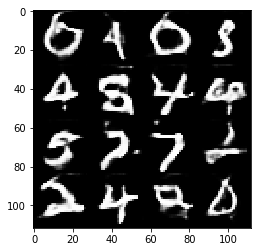

Timestamp 20170806-12-06-33.697 -  Epoch 1/2 -  Step 5210 -  D Loss: 1.3041 - G Loss: 1.4159
Timestamp 20170806-12-06-45.514 -  Epoch 1/2 -  Step 5220 -  D Loss: 1.0733 - G Loss: 1.0669
Timestamp 20170806-12-06-57.334 -  Epoch 1/2 -  Step 5230 -  D Loss: 1.2798 - G Loss: 0.6424
Timestamp 20170806-12-07-09.163 -  Epoch 1/2 -  Step 5240 -  D Loss: 1.1122 - G Loss: 0.9008
Timestamp 20170806-12-07-20.983 -  Epoch 1/2 -  Step 5250 -  D Loss: 1.0451 - G Loss: 1.0553
Timestamp 20170806-12-07-32.798 -  Epoch 1/2 -  Step 5260 -  D Loss: 1.0822 - G Loss: 1.1597
Timestamp 20170806-12-07-44.657 -  Epoch 1/2 -  Step 5270 -  D Loss: 1.0903 - G Loss: 1.4731
Timestamp 20170806-12-07-56.502 -  Epoch 1/2 -  Step 5280 -  D Loss: 1.0508 - G Loss: 0.6428
Timestamp 20170806-12-08-08.313 -  Epoch 1/2 -  Step 5290 -  D Loss: 1.2592 - G Loss: 1.0518
Timestamp 20170806-12-08-20.125 -  Epoch 1/2 -  Step 5300 -  D Loss: 1.1756 - G Loss: 1.1056


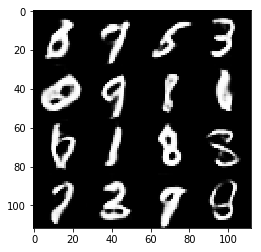

Timestamp 20170806-12-08-32.686 -  Epoch 1/2 -  Step 5310 -  D Loss: 1.4059 - G Loss: 1.2459
Timestamp 20170806-12-08-44.502 -  Epoch 1/2 -  Step 5320 -  D Loss: 1.3639 - G Loss: 0.7456
Timestamp 20170806-12-08-56.327 -  Epoch 1/2 -  Step 5330 -  D Loss: 1.2665 - G Loss: 1.2971
Timestamp 20170806-12-09-08.145 -  Epoch 1/2 -  Step 5340 -  D Loss: 1.1264 - G Loss: 0.7187
Timestamp 20170806-12-09-19.984 -  Epoch 1/2 -  Step 5350 -  D Loss: 1.5948 - G Loss: 1.0126
Timestamp 20170806-12-09-31.801 -  Epoch 1/2 -  Step 5360 -  D Loss: 1.2787 - G Loss: 0.6229
Timestamp 20170806-12-09-43.641 -  Epoch 1/2 -  Step 5370 -  D Loss: 1.0392 - G Loss: 1.6139
Timestamp 20170806-12-09-55.464 -  Epoch 1/2 -  Step 5380 -  D Loss: 0.9941 - G Loss: 1.1701
Timestamp 20170806-12-10-07.297 -  Epoch 1/2 -  Step 5390 -  D Loss: 1.9749 - G Loss: 0.3046
Timestamp 20170806-12-10-19.126 -  Epoch 1/2 -  Step 5400 -  D Loss: 0.9661 - G Loss: 1.2365


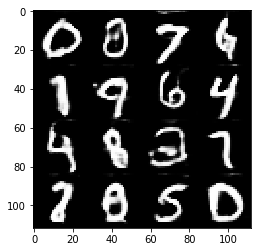

Timestamp 20170806-12-10-31.678 -  Epoch 1/2 -  Step 5410 -  D Loss: 0.9926 - G Loss: 1.7447
Timestamp 20170806-12-10-43.499 -  Epoch 1/2 -  Step 5420 -  D Loss: 1.0932 - G Loss: 1.1158
Timestamp 20170806-12-10-55.322 -  Epoch 1/2 -  Step 5430 -  D Loss: 0.9909 - G Loss: 0.7823
Timestamp 20170806-12-11-07.153 -  Epoch 1/2 -  Step 5440 -  D Loss: 1.2663 - G Loss: 0.7856
Timestamp 20170806-12-11-18.972 -  Epoch 1/2 -  Step 5450 -  D Loss: 1.1707 - G Loss: 1.5036
Timestamp 20170806-12-11-30.781 -  Epoch 1/2 -  Step 5460 -  D Loss: 1.2455 - G Loss: 1.0433
Timestamp 20170806-12-11-42.581 -  Epoch 1/2 -  Step 5470 -  D Loss: 1.2728 - G Loss: 1.2963
Timestamp 20170806-12-11-54.388 -  Epoch 1/2 -  Step 5480 -  D Loss: 1.3196 - G Loss: 0.7396
Timestamp 20170806-12-12-06.215 -  Epoch 1/2 -  Step 5490 -  D Loss: 1.3324 - G Loss: 0.7569
Timestamp 20170806-12-12-18.050 -  Epoch 1/2 -  Step 5500 -  D Loss: 1.1752 - G Loss: 0.8747


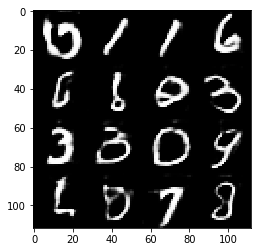

Timestamp 20170806-12-12-30.612 -  Epoch 1/2 -  Step 5510 -  D Loss: 1.0766 - G Loss: 1.0947
Timestamp 20170806-12-12-42.434 -  Epoch 1/2 -  Step 5520 -  D Loss: 1.2878 - G Loss: 0.8020
Timestamp 20170806-12-12-54.258 -  Epoch 1/2 -  Step 5530 -  D Loss: 1.3905 - G Loss: 0.8201
Timestamp 20170806-12-13-06.072 -  Epoch 1/2 -  Step 5540 -  D Loss: 1.5586 - G Loss: 1.4244
Timestamp 20170806-12-13-17.887 -  Epoch 1/2 -  Step 5550 -  D Loss: 1.1750 - G Loss: 1.0982
Timestamp 20170806-12-13-29.727 -  Epoch 1/2 -  Step 5560 -  D Loss: 1.3548 - G Loss: 0.4929
Timestamp 20170806-12-13-41.528 -  Epoch 1/2 -  Step 5570 -  D Loss: 1.4253 - G Loss: 1.1841
Timestamp 20170806-12-13-53.349 -  Epoch 1/2 -  Step 5580 -  D Loss: 1.2211 - G Loss: 1.2696
Timestamp 20170806-12-14-05.173 -  Epoch 1/2 -  Step 5590 -  D Loss: 1.0170 - G Loss: 1.7680
Timestamp 20170806-12-14-16.982 -  Epoch 1/2 -  Step 5600 -  D Loss: 1.0148 - G Loss: 1.0382


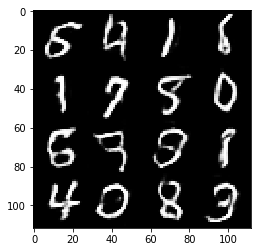

Timestamp 20170806-12-14-29.605 -  Epoch 1/2 -  Step 5610 -  D Loss: 1.0564 - G Loss: 1.1395
Timestamp 20170806-12-14-41.421 -  Epoch 1/2 -  Step 5620 -  D Loss: 1.1783 - G Loss: 0.7479
Timestamp 20170806-12-14-53.248 -  Epoch 1/2 -  Step 5630 -  D Loss: 1.2616 - G Loss: 1.4475
Timestamp 20170806-12-15-05.065 -  Epoch 1/2 -  Step 5640 -  D Loss: 0.8524 - G Loss: 1.2154
Timestamp 20170806-12-15-16.881 -  Epoch 1/2 -  Step 5650 -  D Loss: 1.2676 - G Loss: 1.1793
Timestamp 20170806-12-15-28.700 -  Epoch 1/2 -  Step 5660 -  D Loss: 1.4948 - G Loss: 1.2217
Timestamp 20170806-12-15-40.534 -  Epoch 1/2 -  Step 5670 -  D Loss: 1.2633 - G Loss: 0.9985
Timestamp 20170806-12-15-52.359 -  Epoch 1/2 -  Step 5680 -  D Loss: 1.0308 - G Loss: 0.7330
Timestamp 20170806-12-16-04.160 -  Epoch 1/2 -  Step 5690 -  D Loss: 1.0791 - G Loss: 1.0320
Timestamp 20170806-12-16-15.968 -  Epoch 1/2 -  Step 5700 -  D Loss: 0.8389 - G Loss: 1.5609


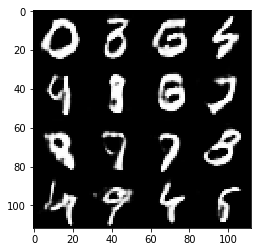

Timestamp 20170806-12-16-28.530 -  Epoch 1/2 -  Step 5710 -  D Loss: 1.0722 - G Loss: 1.2837
Timestamp 20170806-12-16-40.350 -  Epoch 1/2 -  Step 5720 -  D Loss: 0.8338 - G Loss: 1.3624
Timestamp 20170806-12-16-52.161 -  Epoch 1/2 -  Step 5730 -  D Loss: 0.9998 - G Loss: 1.5505
Timestamp 20170806-12-17-03.994 -  Epoch 1/2 -  Step 5740 -  D Loss: 1.3402 - G Loss: 1.2243
Timestamp 20170806-12-17-15.808 -  Epoch 1/2 -  Step 5750 -  D Loss: 1.0209 - G Loss: 1.0821
Timestamp 20170806-12-17-27.632 -  Epoch 1/2 -  Step 5760 -  D Loss: 1.0456 - G Loss: 1.1467
Timestamp 20170806-12-17-39.463 -  Epoch 1/2 -  Step 5770 -  D Loss: 0.9238 - G Loss: 1.7569
Timestamp 20170806-12-17-51.280 -  Epoch 1/2 -  Step 5780 -  D Loss: 1.1105 - G Loss: 1.1325
Timestamp 20170806-12-18-03.106 -  Epoch 1/2 -  Step 5790 -  D Loss: 1.1417 - G Loss: 0.9752
Timestamp 20170806-12-18-14.918 -  Epoch 1/2 -  Step 5800 -  D Loss: 1.4690 - G Loss: 0.7213


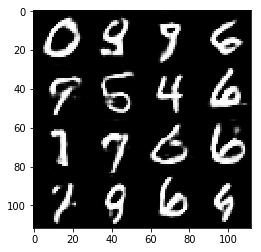

Timestamp 20170806-12-18-27.476 -  Epoch 1/2 -  Step 5810 -  D Loss: 0.7792 - G Loss: 1.0898
Timestamp 20170806-12-18-39.298 -  Epoch 1/2 -  Step 5820 -  D Loss: 0.9042 - G Loss: 1.0324
Timestamp 20170806-12-18-51.116 -  Epoch 1/2 -  Step 5830 -  D Loss: 0.9530 - G Loss: 1.2697
Timestamp 20170806-12-19-02.920 -  Epoch 1/2 -  Step 5840 -  D Loss: 1.2051 - G Loss: 1.1332
Timestamp 20170806-12-19-14.726 -  Epoch 1/2 -  Step 5850 -  D Loss: 0.9240 - G Loss: 1.2968
Timestamp 20170806-12-19-26.533 -  Epoch 1/2 -  Step 5860 -  D Loss: 1.2596 - G Loss: 1.1059
Timestamp 20170806-12-19-38.359 -  Epoch 1/2 -  Step 5870 -  D Loss: 1.0003 - G Loss: 1.1520
Timestamp 20170806-12-19-50.176 -  Epoch 1/2 -  Step 5880 -  D Loss: 1.0412 - G Loss: 1.2443
Timestamp 20170806-12-20-01.986 -  Epoch 1/2 -  Step 5890 -  D Loss: 1.1210 - G Loss: 1.3004
Timestamp 20170806-12-20-13.797 -  Epoch 1/2 -  Step 5900 -  D Loss: 0.9445 - G Loss: 0.9180


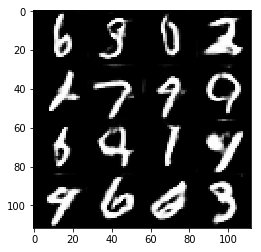

Timestamp 20170806-12-20-26.384 -  Epoch 1/2 -  Step 5910 -  D Loss: 0.7448 - G Loss: 1.3153
Timestamp 20170806-12-20-38.189 -  Epoch 1/2 -  Step 5920 -  D Loss: 1.2671 - G Loss: 1.0581
Timestamp 20170806-12-20-50.000 -  Epoch 1/2 -  Step 5930 -  D Loss: 1.4395 - G Loss: 0.7545
Timestamp 20170806-12-21-01.808 -  Epoch 1/2 -  Step 5940 -  D Loss: 1.1810 - G Loss: 1.0153
Timestamp 20170806-12-21-13.616 -  Epoch 1/2 -  Step 5950 -  D Loss: 1.1637 - G Loss: 0.7993
Timestamp 20170806-12-21-25.432 -  Epoch 1/2 -  Step 5960 -  D Loss: 1.7206 - G Loss: 0.9373
Timestamp 20170806-12-21-37.247 -  Epoch 1/2 -  Step 5970 -  D Loss: 1.4594 - G Loss: 0.9273
Timestamp 20170806-12-21-49.056 -  Epoch 1/2 -  Step 5980 -  D Loss: 1.0190 - G Loss: 1.0073
Timestamp 20170806-12-22-00.873 -  Epoch 1/2 -  Step 5990 -  D Loss: 1.1698 - G Loss: 1.0708
Timestamp 20170806-12-22-12.683 -  Epoch 1/2 -  Step 6000 -  D Loss: 1.0176 - G Loss: 1.6043


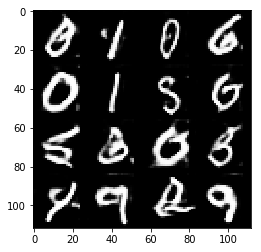

Timestamp 20170806-12-22-25.243 -  Epoch 1/2 -  Step 6010 -  D Loss: 1.1490 - G Loss: 1.6024
Timestamp 20170806-12-22-37.059 -  Epoch 1/2 -  Step 6020 -  D Loss: 0.9190 - G Loss: 1.3617
Timestamp 20170806-12-22-48.883 -  Epoch 1/2 -  Step 6030 -  D Loss: 1.1142 - G Loss: 0.6803
Timestamp 20170806-12-23-00.695 -  Epoch 1/2 -  Step 6040 -  D Loss: 0.8473 - G Loss: 1.2975
Timestamp 20170806-12-23-12.505 -  Epoch 1/2 -  Step 6050 -  D Loss: 1.5360 - G Loss: 0.6002
Timestamp 20170806-12-23-24.316 -  Epoch 1/2 -  Step 6060 -  D Loss: 1.0174 - G Loss: 0.9478
Timestamp 20170806-12-23-36.142 -  Epoch 1/2 -  Step 6070 -  D Loss: 1.0055 - G Loss: 1.5917
Timestamp 20170806-12-23-47.958 -  Epoch 1/2 -  Step 6080 -  D Loss: 0.9712 - G Loss: 0.6930
Timestamp 20170806-12-23-59.780 -  Epoch 1/2 -  Step 6090 -  D Loss: 0.8921 - G Loss: 1.2635
Timestamp 20170806-12-24-11.601 -  Epoch 1/2 -  Step 6100 -  D Loss: 0.9222 - G Loss: 1.1111


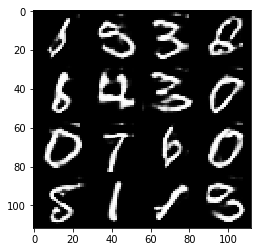

Timestamp 20170806-12-24-24.162 -  Epoch 1/2 -  Step 6110 -  D Loss: 1.1850 - G Loss: 1.4760
Timestamp 20170806-12-24-35.978 -  Epoch 1/2 -  Step 6120 -  D Loss: 0.8516 - G Loss: 1.5285
Timestamp 20170806-12-24-47.774 -  Epoch 1/2 -  Step 6130 -  D Loss: 1.0214 - G Loss: 1.1270
Timestamp 20170806-12-24-59.600 -  Epoch 1/2 -  Step 6140 -  D Loss: 1.0800 - G Loss: 1.4323
Timestamp 20170806-12-25-11.435 -  Epoch 1/2 -  Step 6150 -  D Loss: 0.9106 - G Loss: 1.4398
Timestamp 20170806-12-25-23.238 -  Epoch 1/2 -  Step 6160 -  D Loss: 0.9975 - G Loss: 0.8151
Timestamp 20170806-12-25-35.047 -  Epoch 1/2 -  Step 6170 -  D Loss: 1.3210 - G Loss: 0.8963
Timestamp 20170806-12-25-46.871 -  Epoch 1/2 -  Step 6180 -  D Loss: 1.3326 - G Loss: 0.9614
Timestamp 20170806-12-25-58.690 -  Epoch 1/2 -  Step 6190 -  D Loss: 0.8666 - G Loss: 1.4026
Timestamp 20170806-12-26-10.510 -  Epoch 1/2 -  Step 6200 -  D Loss: 1.2208 - G Loss: 0.8838


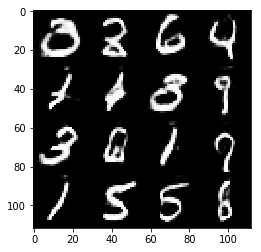

Timestamp 20170806-12-26-23.072 -  Epoch 1/2 -  Step 6210 -  D Loss: 1.0724 - G Loss: 1.3267
Timestamp 20170806-12-26-34.875 -  Epoch 1/2 -  Step 6220 -  D Loss: 0.8728 - G Loss: 0.9459
Timestamp 20170806-12-26-46.693 -  Epoch 1/2 -  Step 6230 -  D Loss: 1.2339 - G Loss: 0.6828
Timestamp 20170806-12-26-58.517 -  Epoch 1/2 -  Step 6240 -  D Loss: 1.5995 - G Loss: 0.6779
Timestamp 20170806-12-27-10.317 -  Epoch 1/2 -  Step 6250 -  D Loss: 1.2142 - G Loss: 1.1139
Timestamp 20170806-12-27-22.140 -  Epoch 1/2 -  Step 6260 -  D Loss: 0.9567 - G Loss: 1.3547
Timestamp 20170806-12-27-33.958 -  Epoch 1/2 -  Step 6270 -  D Loss: 0.9343 - G Loss: 1.3108
Timestamp 20170806-12-27-45.762 -  Epoch 1/2 -  Step 6280 -  D Loss: 1.0679 - G Loss: 0.7907
Timestamp 20170806-12-27-57.581 -  Epoch 1/2 -  Step 6290 -  D Loss: 1.0532 - G Loss: 1.1797
Timestamp 20170806-12-28-09.402 -  Epoch 1/2 -  Step 6300 -  D Loss: 1.1578 - G Loss: 0.7737


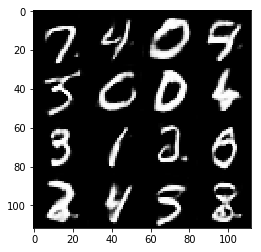

Timestamp 20170806-12-28-21.934 -  Epoch 1/2 -  Step 6310 -  D Loss: 1.2420 - G Loss: 1.0857
Timestamp 20170806-12-28-33.753 -  Epoch 1/2 -  Step 6320 -  D Loss: 1.1096 - G Loss: 1.6286
Timestamp 20170806-12-28-45.559 -  Epoch 1/2 -  Step 6330 -  D Loss: 1.2771 - G Loss: 0.9668
Timestamp 20170806-12-28-57.386 -  Epoch 1/2 -  Step 6340 -  D Loss: 1.2126 - G Loss: 1.4593
Timestamp 20170806-12-29-09.192 -  Epoch 1/2 -  Step 6350 -  D Loss: 1.1804 - G Loss: 1.4687
Timestamp 20170806-12-29-21.032 -  Epoch 1/2 -  Step 6360 -  D Loss: 1.0426 - G Loss: 1.4175
Timestamp 20170806-12-29-32.836 -  Epoch 1/2 -  Step 6370 -  D Loss: 1.2009 - G Loss: 0.7919
Timestamp 20170806-12-29-44.647 -  Epoch 1/2 -  Step 6380 -  D Loss: 0.9078 - G Loss: 1.4726
Timestamp 20170806-12-29-56.463 -  Epoch 1/2 -  Step 6390 -  D Loss: 1.1765 - G Loss: 1.1220
Timestamp 20170806-12-30-08.273 -  Epoch 1/2 -  Step 6400 -  D Loss: 1.2548 - G Loss: 0.7864


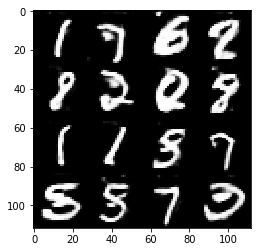

Timestamp 20170806-12-30-20.851 -  Epoch 1/2 -  Step 6410 -  D Loss: 1.1346 - G Loss: 0.9465
Timestamp 20170806-12-30-32.683 -  Epoch 1/2 -  Step 6420 -  D Loss: 0.7917 - G Loss: 1.1935
Timestamp 20170806-12-30-44.496 -  Epoch 1/2 -  Step 6430 -  D Loss: 1.2139 - G Loss: 0.8622
Timestamp 20170806-12-30-56.304 -  Epoch 1/2 -  Step 6440 -  D Loss: 1.5517 - G Loss: 0.9174
Timestamp 20170806-12-31-08.126 -  Epoch 1/2 -  Step 6450 -  D Loss: 1.2443 - G Loss: 1.1958
Timestamp 20170806-12-31-19.934 -  Epoch 1/2 -  Step 6460 -  D Loss: 0.8157 - G Loss: 1.3077
Timestamp 20170806-12-31-31.735 -  Epoch 1/2 -  Step 6470 -  D Loss: 1.5672 - G Loss: 0.5429
Timestamp 20170806-12-31-43.545 -  Epoch 1/2 -  Step 6480 -  D Loss: 0.7906 - G Loss: 1.0363
Timestamp 20170806-12-31-55.350 -  Epoch 1/2 -  Step 6490 -  D Loss: 1.2266 - G Loss: 1.2585
Timestamp 20170806-12-32-07.149 -  Epoch 1/2 -  Step 6500 -  D Loss: 1.3681 - G Loss: 0.5590


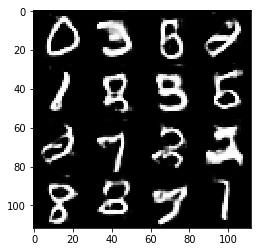

Timestamp 20170806-12-32-19.720 -  Epoch 1/2 -  Step 6510 -  D Loss: 1.0742 - G Loss: 1.2190
Timestamp 20170806-12-32-31.507 -  Epoch 1/2 -  Step 6520 -  D Loss: 1.1302 - G Loss: 1.1096
Timestamp 20170806-12-32-43.320 -  Epoch 1/2 -  Step 6530 -  D Loss: 1.6959 - G Loss: 1.0004
Timestamp 20170806-12-32-55.156 -  Epoch 1/2 -  Step 6540 -  D Loss: 0.8260 - G Loss: 1.8188
Timestamp 20170806-12-33-06.977 -  Epoch 1/2 -  Step 6550 -  D Loss: 1.3609 - G Loss: 1.0857
Timestamp 20170806-12-33-18.829 -  Epoch 1/2 -  Step 6560 -  D Loss: 1.0077 - G Loss: 1.6790
Timestamp 20170806-12-33-30.636 -  Epoch 1/2 -  Step 6570 -  D Loss: 1.2552 - G Loss: 0.8146
Timestamp 20170806-12-33-42.458 -  Epoch 1/2 -  Step 6580 -  D Loss: 0.9228 - G Loss: 1.3968
Timestamp 20170806-12-33-54.281 -  Epoch 1/2 -  Step 6590 -  D Loss: 1.0281 - G Loss: 0.8735
Timestamp 20170806-12-34-06.104 -  Epoch 1/2 -  Step 6600 -  D Loss: 1.0370 - G Loss: 1.3526


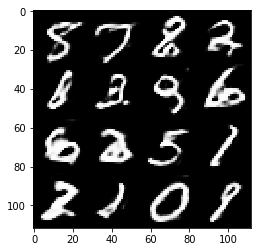

Timestamp 20170806-12-34-18.705 -  Epoch 1/2 -  Step 6610 -  D Loss: 1.1029 - G Loss: 1.2272
Timestamp 20170806-12-34-30.533 -  Epoch 1/2 -  Step 6620 -  D Loss: 0.9657 - G Loss: 2.1530
Timestamp 20170806-12-34-42.382 -  Epoch 1/2 -  Step 6630 -  D Loss: 1.3333 - G Loss: 1.1240
Timestamp 20170806-12-34-54.244 -  Epoch 1/2 -  Step 6640 -  D Loss: 1.0972 - G Loss: 1.1878
Timestamp 20170806-12-35-06.082 -  Epoch 1/2 -  Step 6650 -  D Loss: 1.1454 - G Loss: 0.9172
Timestamp 20170806-12-35-17.933 -  Epoch 1/2 -  Step 6660 -  D Loss: 0.8323 - G Loss: 1.0776
Timestamp 20170806-12-35-29.799 -  Epoch 1/2 -  Step 6670 -  D Loss: 1.1565 - G Loss: 1.3390
Timestamp 20170806-12-35-41.631 -  Epoch 1/2 -  Step 6680 -  D Loss: 1.0540 - G Loss: 1.1868
Timestamp 20170806-12-35-53.477 -  Epoch 1/2 -  Step 6690 -  D Loss: 0.8461 - G Loss: 1.0053
Timestamp 20170806-12-36-05.279 -  Epoch 1/2 -  Step 6700 -  D Loss: 0.7066 - G Loss: 1.6575


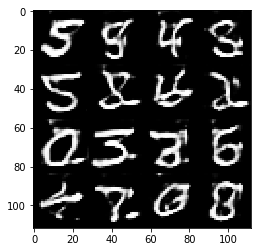

Timestamp 20170806-12-36-17.855 -  Epoch 1/2 -  Step 6710 -  D Loss: 0.7761 - G Loss: 1.7210
Timestamp 20170806-12-36-29.677 -  Epoch 1/2 -  Step 6720 -  D Loss: 1.6083 - G Loss: 1.2293
Timestamp 20170806-12-36-41.506 -  Epoch 1/2 -  Step 6730 -  D Loss: 0.7540 - G Loss: 1.0428
Timestamp 20170806-12-36-53.340 -  Epoch 1/2 -  Step 6740 -  D Loss: 0.8807 - G Loss: 1.4367
Timestamp 20170806-12-37-05.166 -  Epoch 1/2 -  Step 6750 -  D Loss: 0.9468 - G Loss: 2.1997
Timestamp 20170806-12-37-16.964 -  Epoch 1/2 -  Step 6760 -  D Loss: 0.9444 - G Loss: 1.3355
Timestamp 20170806-12-37-28.782 -  Epoch 1/2 -  Step 6770 -  D Loss: 0.7880 - G Loss: 1.2988
Timestamp 20170806-12-37-40.590 -  Epoch 1/2 -  Step 6780 -  D Loss: 1.0770 - G Loss: 1.0959
Timestamp 20170806-12-37-52.401 -  Epoch 1/2 -  Step 6790 -  D Loss: 0.8945 - G Loss: 1.2900
Timestamp 20170806-12-38-04.213 -  Epoch 1/2 -  Step 6800 -  D Loss: 1.2512 - G Loss: 1.4797


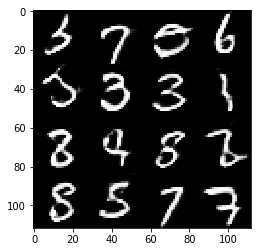

Timestamp 20170806-12-38-16.771 -  Epoch 1/2 -  Step 6810 -  D Loss: 1.1059 - G Loss: 1.0230
Timestamp 20170806-12-38-28.604 -  Epoch 1/2 -  Step 6820 -  D Loss: 1.2293 - G Loss: 1.6927
Timestamp 20170806-12-38-40.410 -  Epoch 1/2 -  Step 6830 -  D Loss: 0.8353 - G Loss: 1.5709
Timestamp 20170806-12-38-52.226 -  Epoch 1/2 -  Step 6840 -  D Loss: 1.1054 - G Loss: 1.2350
Timestamp 20170806-12-39-04.026 -  Epoch 1/2 -  Step 6850 -  D Loss: 0.8039 - G Loss: 1.5930
Timestamp 20170806-12-39-15.834 -  Epoch 1/2 -  Step 6860 -  D Loss: 0.8582 - G Loss: 0.9497
Timestamp 20170806-12-39-27.645 -  Epoch 1/2 -  Step 6870 -  D Loss: 0.7962 - G Loss: 1.2978
Timestamp 20170806-12-39-39.474 -  Epoch 1/2 -  Step 6880 -  D Loss: 0.8965 - G Loss: 1.3974
Timestamp 20170806-12-39-51.295 -  Epoch 1/2 -  Step 6890 -  D Loss: 1.0087 - G Loss: 1.1435
Timestamp 20170806-12-40-03.120 -  Epoch 1/2 -  Step 6900 -  D Loss: 1.2159 - G Loss: 1.0890


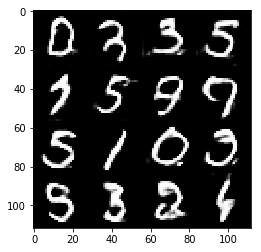

Timestamp 20170806-12-40-15.678 -  Epoch 1/2 -  Step 6910 -  D Loss: 1.2285 - G Loss: 1.1677
Timestamp 20170806-12-40-27.494 -  Epoch 1/2 -  Step 6920 -  D Loss: 1.2284 - G Loss: 1.0975
Timestamp 20170806-12-40-39.320 -  Epoch 1/2 -  Step 6930 -  D Loss: 0.9710 - G Loss: 1.8095
Timestamp 20170806-12-40-51.127 -  Epoch 1/2 -  Step 6940 -  D Loss: 0.7796 - G Loss: 1.3266
Timestamp 20170806-12-41-02.940 -  Epoch 1/2 -  Step 6950 -  D Loss: 0.8184 - G Loss: 1.4625
Timestamp 20170806-12-41-14.765 -  Epoch 1/2 -  Step 6960 -  D Loss: 1.5400 - G Loss: 1.0924
Timestamp 20170806-12-41-26.603 -  Epoch 1/2 -  Step 6970 -  D Loss: 0.7207 - G Loss: 1.4593
Timestamp 20170806-12-41-38.422 -  Epoch 1/2 -  Step 6980 -  D Loss: 1.2226 - G Loss: 1.6032
Timestamp 20170806-12-41-50.241 -  Epoch 1/2 -  Step 6990 -  D Loss: 0.8981 - G Loss: 1.5983
Timestamp 20170806-12-42-02.057 -  Epoch 1/2 -  Step 7000 -  D Loss: 1.1692 - G Loss: 0.9162


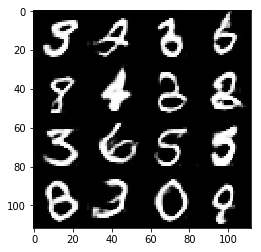

Timestamp 20170806-12-42-14.651 -  Epoch 1/2 -  Step 7010 -  D Loss: 1.3010 - G Loss: 1.0397
Timestamp 20170806-12-42-26.471 -  Epoch 1/2 -  Step 7020 -  D Loss: 0.8666 - G Loss: 1.2202
Timestamp 20170806-12-42-38.282 -  Epoch 1/2 -  Step 7030 -  D Loss: 1.1140 - G Loss: 1.1751
Timestamp 20170806-12-42-50.085 -  Epoch 1/2 -  Step 7040 -  D Loss: 1.0412 - G Loss: 1.0570
Timestamp 20170806-12-43-01.898 -  Epoch 1/2 -  Step 7050 -  D Loss: 1.5226 - G Loss: 0.8127
Timestamp 20170806-12-43-13.707 -  Epoch 1/2 -  Step 7060 -  D Loss: 1.4229 - G Loss: 1.5828
Timestamp 20170806-12-43-25.519 -  Epoch 1/2 -  Step 7070 -  D Loss: 1.2030 - G Loss: 0.9720
Timestamp 20170806-12-43-37.332 -  Epoch 1/2 -  Step 7080 -  D Loss: 1.3588 - G Loss: 0.8313
Timestamp 20170806-12-43-49.170 -  Epoch 1/2 -  Step 7090 -  D Loss: 0.7649 - G Loss: 1.5289
Timestamp 20170806-12-44-00.983 -  Epoch 1/2 -  Step 7100 -  D Loss: 1.0788 - G Loss: 1.3292


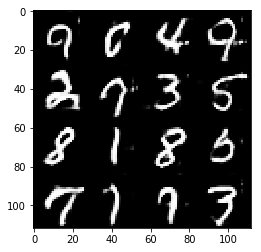

Timestamp 20170806-12-44-13.562 -  Epoch 1/2 -  Step 7110 -  D Loss: 0.9429 - G Loss: 1.2441
Timestamp 20170806-12-44-25.377 -  Epoch 1/2 -  Step 7120 -  D Loss: 0.8196 - G Loss: 1.1962
Timestamp 20170806-12-44-37.192 -  Epoch 1/2 -  Step 7130 -  D Loss: 0.8101 - G Loss: 0.6710
Timestamp 20170806-12-44-48.997 -  Epoch 1/2 -  Step 7140 -  D Loss: 1.4291 - G Loss: 0.8372
Timestamp 20170806-12-45-00.844 -  Epoch 1/2 -  Step 7150 -  D Loss: 0.8274 - G Loss: 1.4262
Timestamp 20170806-12-45-12.661 -  Epoch 1/2 -  Step 7160 -  D Loss: 1.7429 - G Loss: 1.1266
Timestamp 20170806-12-45-24.469 -  Epoch 1/2 -  Step 7170 -  D Loss: 0.9891 - G Loss: 1.8640
Timestamp 20170806-12-45-36.282 -  Epoch 1/2 -  Step 7180 -  D Loss: 0.8233 - G Loss: 1.0653
Timestamp 20170806-12-45-48.101 -  Epoch 1/2 -  Step 7190 -  D Loss: 1.2003 - G Loss: 1.1491
Timestamp 20170806-12-45-59.900 -  Epoch 1/2 -  Step 7200 -  D Loss: 1.2335 - G Loss: 1.0635


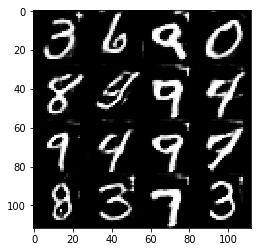

Timestamp 20170806-12-46-12.483 -  Epoch 1/2 -  Step 7210 -  D Loss: 0.9183 - G Loss: 1.1732
Timestamp 20170806-12-46-24.304 -  Epoch 1/2 -  Step 7220 -  D Loss: 0.9759 - G Loss: 1.3237
Timestamp 20170806-12-46-36.120 -  Epoch 1/2 -  Step 7230 -  D Loss: 1.0612 - G Loss: 1.0978
Timestamp 20170806-12-46-47.934 -  Epoch 1/2 -  Step 7240 -  D Loss: 1.2552 - G Loss: 0.6215
Timestamp 20170806-12-46-59.754 -  Epoch 1/2 -  Step 7250 -  D Loss: 1.0535 - G Loss: 1.3979
Timestamp 20170806-12-47-11.576 -  Epoch 1/2 -  Step 7260 -  D Loss: 1.2796 - G Loss: 0.7921
Timestamp 20170806-12-47-23.397 -  Epoch 1/2 -  Step 7270 -  D Loss: 1.1883 - G Loss: 1.1349
Timestamp 20170806-12-47-35.215 -  Epoch 1/2 -  Step 7280 -  D Loss: 1.4014 - G Loss: 1.6918
Timestamp 20170806-12-47-47.023 -  Epoch 1/2 -  Step 7290 -  D Loss: 1.0557 - G Loss: 1.2381
Timestamp 20170806-12-47-58.835 -  Epoch 1/2 -  Step 7300 -  D Loss: 0.9968 - G Loss: 1.2885


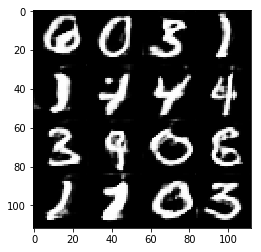

Timestamp 20170806-12-48-11.403 -  Epoch 1/2 -  Step 7310 -  D Loss: 1.2037 - G Loss: 1.2418
Timestamp 20170806-12-48-23.225 -  Epoch 1/2 -  Step 7320 -  D Loss: 1.2655 - G Loss: 0.8295
Timestamp 20170806-12-48-35.047 -  Epoch 1/2 -  Step 7330 -  D Loss: 0.9665 - G Loss: 1.3884
Timestamp 20170806-12-48-46.862 -  Epoch 1/2 -  Step 7340 -  D Loss: 0.8169 - G Loss: 1.0535
Timestamp 20170806-12-48-58.683 -  Epoch 1/2 -  Step 7350 -  D Loss: 1.0872 - G Loss: 1.0013
Timestamp 20170806-12-49-10.493 -  Epoch 1/2 -  Step 7360 -  D Loss: 1.2053 - G Loss: 0.5130
Timestamp 20170806-12-49-22.325 -  Epoch 1/2 -  Step 7370 -  D Loss: 0.9527 - G Loss: 1.3049
Timestamp 20170806-12-49-34.144 -  Epoch 1/2 -  Step 7380 -  D Loss: 1.0110 - G Loss: 0.9952
Timestamp 20170806-12-49-45.949 -  Epoch 1/2 -  Step 7390 -  D Loss: 0.8473 - G Loss: 1.1495
Timestamp 20170806-12-49-57.755 -  Epoch 1/2 -  Step 7400 -  D Loss: 1.2106 - G Loss: 1.1645


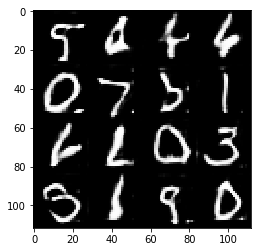

Timestamp 20170806-12-50-10.314 -  Epoch 1/2 -  Step 7410 -  D Loss: 1.1616 - G Loss: 1.2250
Timestamp 20170806-12-50-22.123 -  Epoch 1/2 -  Step 7420 -  D Loss: 1.1178 - G Loss: 1.3707
Timestamp 20170806-12-50-33.944 -  Epoch 1/2 -  Step 7430 -  D Loss: 1.0155 - G Loss: 1.1269
Timestamp 20170806-12-50-45.748 -  Epoch 1/2 -  Step 7440 -  D Loss: 1.1427 - G Loss: 1.0232
Timestamp 20170806-12-50-57.561 -  Epoch 1/2 -  Step 7450 -  D Loss: 0.7210 - G Loss: 1.4416
Timestamp 20170806-12-51-09.375 -  Epoch 1/2 -  Step 7460 -  D Loss: 0.9920 - G Loss: 1.3198
Timestamp 20170806-12-51-21.191 -  Epoch 1/2 -  Step 7470 -  D Loss: 0.8445 - G Loss: 1.1850
Timestamp 20170806-12-51-32.987 -  Epoch 1/2 -  Step 7480 -  D Loss: 0.7611 - G Loss: 1.6097
Timestamp 20170806-12-51-44.780 -  Epoch 1/2 -  Step 7490 -  D Loss: 1.0382 - G Loss: 1.8607
Timestamp 20170806-12-51-56.608 -  Epoch 1/2 -  Step 7500 -  D Loss: 0.9122 - G Loss: 1.5846


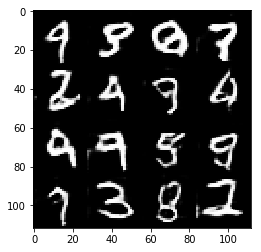

Timestamp 20170806-12-52-09.178 -  Epoch 2/2 -  Step 7510 -  D Loss: 0.9474 - G Loss: 1.1706
Timestamp 20170806-12-52-21.007 -  Epoch 2/2 -  Step 7520 -  D Loss: 0.9368 - G Loss: 1.7358
Timestamp 20170806-12-52-32.826 -  Epoch 2/2 -  Step 7530 -  D Loss: 1.6988 - G Loss: 1.1838
Timestamp 20170806-12-52-44.654 -  Epoch 2/2 -  Step 7540 -  D Loss: 1.2642 - G Loss: 0.7823
Timestamp 20170806-12-52-56.462 -  Epoch 2/2 -  Step 7550 -  D Loss: 1.6304 - G Loss: 0.7568
Timestamp 20170806-12-53-08.287 -  Epoch 2/2 -  Step 7560 -  D Loss: 0.8124 - G Loss: 0.8885
Timestamp 20170806-12-53-20.108 -  Epoch 2/2 -  Step 7570 -  D Loss: 1.2418 - G Loss: 0.9725
Timestamp 20170806-12-53-31.920 -  Epoch 2/2 -  Step 7580 -  D Loss: 0.9068 - G Loss: 1.2741
Timestamp 20170806-12-53-43.716 -  Epoch 2/2 -  Step 7590 -  D Loss: 0.8657 - G Loss: 1.2309
Timestamp 20170806-12-53-55.523 -  Epoch 2/2 -  Step 7600 -  D Loss: 0.9197 - G Loss: 1.5137


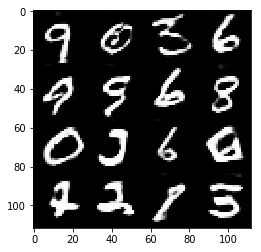

Timestamp 20170806-12-54-08.101 -  Epoch 2/2 -  Step 7610 -  D Loss: 0.8196 - G Loss: 1.4834
Timestamp 20170806-12-54-19.913 -  Epoch 2/2 -  Step 7620 -  D Loss: 1.1833 - G Loss: 1.4140
Timestamp 20170806-12-54-31.717 -  Epoch 2/2 -  Step 7630 -  D Loss: 0.9025 - G Loss: 1.4077
Timestamp 20170806-12-54-43.531 -  Epoch 2/2 -  Step 7640 -  D Loss: 1.1857 - G Loss: 1.0496
Timestamp 20170806-12-54-55.337 -  Epoch 2/2 -  Step 7650 -  D Loss: 0.8600 - G Loss: 1.0328
Timestamp 20170806-12-55-07.167 -  Epoch 2/2 -  Step 7660 -  D Loss: 0.9834 - G Loss: 1.3142
Timestamp 20170806-12-55-18.987 -  Epoch 2/2 -  Step 7670 -  D Loss: 0.8280 - G Loss: 1.5050
Timestamp 20170806-12-55-30.794 -  Epoch 2/2 -  Step 7680 -  D Loss: 1.2099 - G Loss: 1.0002
Timestamp 20170806-12-55-42.618 -  Epoch 2/2 -  Step 7690 -  D Loss: 0.8649 - G Loss: 1.4177
Timestamp 20170806-12-55-54.435 -  Epoch 2/2 -  Step 7700 -  D Loss: 0.6764 - G Loss: 1.4065


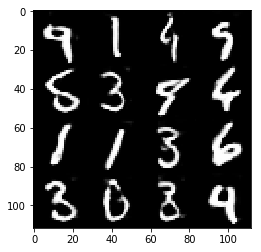

Timestamp 20170806-12-56-07.011 -  Epoch 2/2 -  Step 7710 -  D Loss: 1.3775 - G Loss: 0.8936
Timestamp 20170806-12-56-18.818 -  Epoch 2/2 -  Step 7720 -  D Loss: 1.0200 - G Loss: 1.4983
Timestamp 20170806-12-56-30.643 -  Epoch 2/2 -  Step 7730 -  D Loss: 0.9194 - G Loss: 1.1043
Timestamp 20170806-12-56-42.452 -  Epoch 2/2 -  Step 7740 -  D Loss: 1.7082 - G Loss: 0.7041
Timestamp 20170806-12-56-54.257 -  Epoch 2/2 -  Step 7750 -  D Loss: 1.4736 - G Loss: 0.8928
Timestamp 20170806-12-57-06.091 -  Epoch 2/2 -  Step 7760 -  D Loss: 1.0107 - G Loss: 1.1545
Timestamp 20170806-12-57-17.904 -  Epoch 2/2 -  Step 7770 -  D Loss: 1.3670 - G Loss: 0.6023
Timestamp 20170806-12-57-29.741 -  Epoch 2/2 -  Step 7780 -  D Loss: 1.1814 - G Loss: 1.4129
Timestamp 20170806-12-57-41.547 -  Epoch 2/2 -  Step 7790 -  D Loss: 1.0916 - G Loss: 1.5138
Timestamp 20170806-12-57-53.359 -  Epoch 2/2 -  Step 7800 -  D Loss: 1.1588 - G Loss: 1.1075


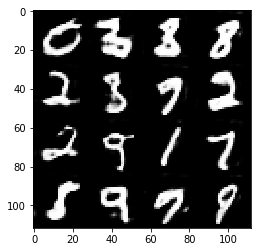

Timestamp 20170806-12-58-05.945 -  Epoch 2/2 -  Step 7810 -  D Loss: 0.7321 - G Loss: 1.3401
Timestamp 20170806-12-58-17.767 -  Epoch 2/2 -  Step 7820 -  D Loss: 0.8534 - G Loss: 1.3789
Timestamp 20170806-12-58-29.598 -  Epoch 2/2 -  Step 7830 -  D Loss: 1.5480 - G Loss: 0.7813
Timestamp 20170806-12-58-41.407 -  Epoch 2/2 -  Step 7840 -  D Loss: 1.1919 - G Loss: 0.5427
Timestamp 20170806-12-58-53.225 -  Epoch 2/2 -  Step 7850 -  D Loss: 1.0161 - G Loss: 0.7936
Timestamp 20170806-12-59-05.008 -  Epoch 2/2 -  Step 7860 -  D Loss: 1.2091 - G Loss: 0.8638
Timestamp 20170806-12-59-16.839 -  Epoch 2/2 -  Step 7870 -  D Loss: 1.3715 - G Loss: 1.0709
Timestamp 20170806-12-59-28.665 -  Epoch 2/2 -  Step 7880 -  D Loss: 1.2853 - G Loss: 1.1116
Timestamp 20170806-12-59-40.462 -  Epoch 2/2 -  Step 7890 -  D Loss: 1.1934 - G Loss: 1.2158
Timestamp 20170806-12-59-52.278 -  Epoch 2/2 -  Step 7900 -  D Loss: 0.8414 - G Loss: 1.6240


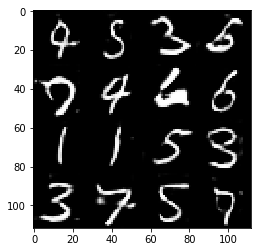

Timestamp 20170806-13-00-04.863 -  Epoch 2/2 -  Step 7910 -  D Loss: 1.0235 - G Loss: 1.1217
Timestamp 20170806-13-00-16.668 -  Epoch 2/2 -  Step 7920 -  D Loss: 0.9564 - G Loss: 1.8211
Timestamp 20170806-13-00-28.475 -  Epoch 2/2 -  Step 7930 -  D Loss: 0.9740 - G Loss: 1.0450
Timestamp 20170806-13-00-40.290 -  Epoch 2/2 -  Step 7940 -  D Loss: 0.9118 - G Loss: 1.4902
Timestamp 20170806-13-00-52.093 -  Epoch 2/2 -  Step 7950 -  D Loss: 1.0118 - G Loss: 1.0487
Timestamp 20170806-13-01-03.913 -  Epoch 2/2 -  Step 7960 -  D Loss: 0.5863 - G Loss: 1.7991
Timestamp 20170806-13-01-15.714 -  Epoch 2/2 -  Step 7970 -  D Loss: 1.1966 - G Loss: 0.7399
Timestamp 20170806-13-01-27.531 -  Epoch 2/2 -  Step 7980 -  D Loss: 1.1318 - G Loss: 1.2492
Timestamp 20170806-13-01-39.350 -  Epoch 2/2 -  Step 7990 -  D Loss: 0.9481 - G Loss: 1.7295
Timestamp 20170806-13-01-51.169 -  Epoch 2/2 -  Step 8000 -  D Loss: 1.1176 - G Loss: 0.5766


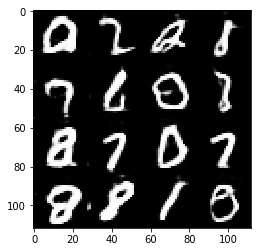

Timestamp 20170806-13-02-03.732 -  Epoch 2/2 -  Step 8010 -  D Loss: 1.1312 - G Loss: 1.6394
Timestamp 20170806-13-02-15.543 -  Epoch 2/2 -  Step 8020 -  D Loss: 0.8047 - G Loss: 1.3956
Timestamp 20170806-13-02-27.356 -  Epoch 2/2 -  Step 8030 -  D Loss: 1.0040 - G Loss: 1.0803
Timestamp 20170806-13-02-39.161 -  Epoch 2/2 -  Step 8040 -  D Loss: 1.0663 - G Loss: 1.1801
Timestamp 20170806-13-02-50.971 -  Epoch 2/2 -  Step 8050 -  D Loss: 0.7511 - G Loss: 1.4900
Timestamp 20170806-13-03-02.795 -  Epoch 2/2 -  Step 8060 -  D Loss: 0.9273 - G Loss: 0.7465
Timestamp 20170806-13-03-14.608 -  Epoch 2/2 -  Step 8070 -  D Loss: 1.3755 - G Loss: 1.4633
Timestamp 20170806-13-03-26.412 -  Epoch 2/2 -  Step 8080 -  D Loss: 0.9920 - G Loss: 1.4722
Timestamp 20170806-13-03-38.226 -  Epoch 2/2 -  Step 8090 -  D Loss: 1.0333 - G Loss: 1.4806
Timestamp 20170806-13-03-50.028 -  Epoch 2/2 -  Step 8100 -  D Loss: 1.3369 - G Loss: 0.7230


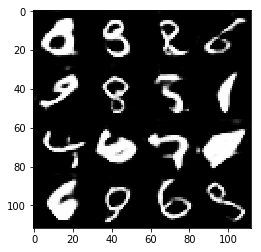

Timestamp 20170806-13-04-02.613 -  Epoch 2/2 -  Step 8110 -  D Loss: 1.4782 - G Loss: 1.3265
Timestamp 20170806-13-04-14.449 -  Epoch 2/2 -  Step 8120 -  D Loss: 1.1675 - G Loss: 1.3587
Timestamp 20170806-13-04-26.263 -  Epoch 2/2 -  Step 8130 -  D Loss: 1.2925 - G Loss: 0.9787
Timestamp 20170806-13-04-38.051 -  Epoch 2/2 -  Step 8140 -  D Loss: 1.1357 - G Loss: 1.1191
Timestamp 20170806-13-04-49.853 -  Epoch 2/2 -  Step 8150 -  D Loss: 0.7687 - G Loss: 1.8164
Timestamp 20170806-13-05-01.662 -  Epoch 2/2 -  Step 8160 -  D Loss: 0.5551 - G Loss: 1.7040
Timestamp 20170806-13-05-13.472 -  Epoch 2/2 -  Step 8170 -  D Loss: 1.0903 - G Loss: 1.2039
Timestamp 20170806-13-05-25.290 -  Epoch 2/2 -  Step 8180 -  D Loss: 1.4903 - G Loss: 1.0072
Timestamp 20170806-13-05-37.086 -  Epoch 2/2 -  Step 8190 -  D Loss: 0.9745 - G Loss: 1.5529
Timestamp 20170806-13-05-48.911 -  Epoch 2/2 -  Step 8200 -  D Loss: 1.2404 - G Loss: 1.4167


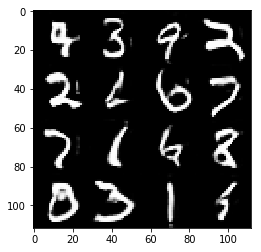

Timestamp 20170806-13-06-01.505 -  Epoch 2/2 -  Step 8210 -  D Loss: 1.0410 - G Loss: 1.1937
Timestamp 20170806-13-06-13.316 -  Epoch 2/2 -  Step 8220 -  D Loss: 0.8890 - G Loss: 1.1730
Timestamp 20170806-13-06-25.128 -  Epoch 2/2 -  Step 8230 -  D Loss: 0.9937 - G Loss: 1.2272
Timestamp 20170806-13-06-36.946 -  Epoch 2/2 -  Step 8240 -  D Loss: 1.1457 - G Loss: 0.7699
Timestamp 20170806-13-06-48.758 -  Epoch 2/2 -  Step 8250 -  D Loss: 0.8143 - G Loss: 0.9521
Timestamp 20170806-13-07-00.558 -  Epoch 2/2 -  Step 8260 -  D Loss: 1.0955 - G Loss: 1.0134
Timestamp 20170806-13-07-12.356 -  Epoch 2/2 -  Step 8270 -  D Loss: 0.8931 - G Loss: 1.2076
Timestamp 20170806-13-07-24.163 -  Epoch 2/2 -  Step 8280 -  D Loss: 0.9143 - G Loss: 1.4246
Timestamp 20170806-13-07-35.960 -  Epoch 2/2 -  Step 8290 -  D Loss: 0.8668 - G Loss: 1.3956
Timestamp 20170806-13-07-47.755 -  Epoch 2/2 -  Step 8300 -  D Loss: 0.9257 - G Loss: 0.8546


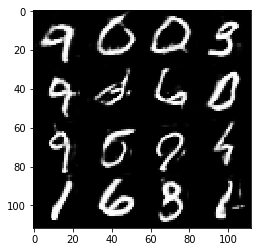

Timestamp 20170806-13-08-00.342 -  Epoch 2/2 -  Step 8310 -  D Loss: 0.8760 - G Loss: 1.3118
Timestamp 20170806-13-08-12.171 -  Epoch 2/2 -  Step 8320 -  D Loss: 1.3119 - G Loss: 0.9417
Timestamp 20170806-13-08-23.984 -  Epoch 2/2 -  Step 8330 -  D Loss: 1.1966 - G Loss: 1.2058
Timestamp 20170806-13-08-35.796 -  Epoch 2/2 -  Step 8340 -  D Loss: 1.2412 - G Loss: 1.4221
Timestamp 20170806-13-08-47.610 -  Epoch 2/2 -  Step 8350 -  D Loss: 1.1161 - G Loss: 1.4586
Timestamp 20170806-13-08-59.421 -  Epoch 2/2 -  Step 8360 -  D Loss: 1.1446 - G Loss: 0.7952
Timestamp 20170806-13-09-11.243 -  Epoch 2/2 -  Step 8370 -  D Loss: 1.0367 - G Loss: 1.1206
Timestamp 20170806-13-09-23.057 -  Epoch 2/2 -  Step 8380 -  D Loss: 0.8026 - G Loss: 1.7634
Timestamp 20170806-13-09-34.864 -  Epoch 2/2 -  Step 8390 -  D Loss: 0.8933 - G Loss: 1.7375
Timestamp 20170806-13-09-46.662 -  Epoch 2/2 -  Step 8400 -  D Loss: 1.2641 - G Loss: 0.9498


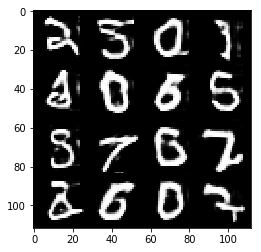

Timestamp 20170806-13-09-59.258 -  Epoch 2/2 -  Step 8410 -  D Loss: 1.1990 - G Loss: 2.1730
Timestamp 20170806-13-10-11.081 -  Epoch 2/2 -  Step 8420 -  D Loss: 0.7173 - G Loss: 0.8798
Timestamp 20170806-13-10-22.907 -  Epoch 2/2 -  Step 8430 -  D Loss: 0.6600 - G Loss: 1.1632
Timestamp 20170806-13-10-34.707 -  Epoch 2/2 -  Step 8440 -  D Loss: 1.3236 - G Loss: 0.8061
Timestamp 20170806-13-10-46.524 -  Epoch 2/2 -  Step 8450 -  D Loss: 1.0001 - G Loss: 1.3449
Timestamp 20170806-13-10-58.350 -  Epoch 2/2 -  Step 8460 -  D Loss: 0.9912 - G Loss: 1.2602
Timestamp 20170806-13-11-10.157 -  Epoch 2/2 -  Step 8470 -  D Loss: 0.8288 - G Loss: 1.8868
Timestamp 20170806-13-11-21.968 -  Epoch 2/2 -  Step 8480 -  D Loss: 0.8821 - G Loss: 1.4738
Timestamp 20170806-13-11-33.781 -  Epoch 2/2 -  Step 8490 -  D Loss: 0.9822 - G Loss: 0.8709
Timestamp 20170806-13-11-45.590 -  Epoch 2/2 -  Step 8500 -  D Loss: 1.2402 - G Loss: 1.1989


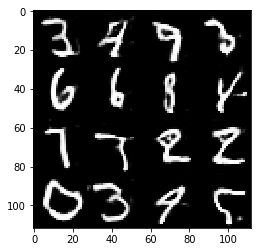

Timestamp 20170806-13-11-58.194 -  Epoch 2/2 -  Step 8510 -  D Loss: 0.7930 - G Loss: 2.2646
Timestamp 20170806-13-12-10.004 -  Epoch 2/2 -  Step 8520 -  D Loss: 0.6779 - G Loss: 1.1463
Timestamp 20170806-13-12-21.831 -  Epoch 2/2 -  Step 8530 -  D Loss: 1.4454 - G Loss: 0.6051
Timestamp 20170806-13-12-33.642 -  Epoch 2/2 -  Step 8540 -  D Loss: 0.9010 - G Loss: 1.5928
Timestamp 20170806-13-12-45.455 -  Epoch 2/2 -  Step 8550 -  D Loss: 1.1448 - G Loss: 1.4198
Timestamp 20170806-13-12-57.283 -  Epoch 2/2 -  Step 8560 -  D Loss: 0.9776 - G Loss: 1.1542
Timestamp 20170806-13-13-09.103 -  Epoch 2/2 -  Step 8570 -  D Loss: 1.2728 - G Loss: 0.9090
Timestamp 20170806-13-13-20.914 -  Epoch 2/2 -  Step 8580 -  D Loss: 0.8886 - G Loss: 1.6859
Timestamp 20170806-13-13-32.745 -  Epoch 2/2 -  Step 8590 -  D Loss: 0.8235 - G Loss: 1.2629
Timestamp 20170806-13-13-44.546 -  Epoch 2/2 -  Step 8600 -  D Loss: 0.9050 - G Loss: 1.1629


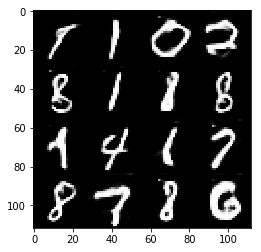

Timestamp 20170806-13-13-57.173 -  Epoch 2/2 -  Step 8610 -  D Loss: 1.3170 - G Loss: 1.8046
Timestamp 20170806-13-14-08.995 -  Epoch 2/2 -  Step 8620 -  D Loss: 0.8114 - G Loss: 1.7512
Timestamp 20170806-13-14-20.819 -  Epoch 2/2 -  Step 8630 -  D Loss: 0.8355 - G Loss: 1.3999
Timestamp 20170806-13-14-32.633 -  Epoch 2/2 -  Step 8640 -  D Loss: 1.0694 - G Loss: 0.7600
Timestamp 20170806-13-14-44.442 -  Epoch 2/2 -  Step 8650 -  D Loss: 1.0337 - G Loss: 1.4351
Timestamp 20170806-13-14-56.271 -  Epoch 2/2 -  Step 8660 -  D Loss: 0.9632 - G Loss: 1.2406
Timestamp 20170806-13-15-08.085 -  Epoch 2/2 -  Step 8670 -  D Loss: 0.9152 - G Loss: 1.2491
Timestamp 20170806-13-15-19.905 -  Epoch 2/2 -  Step 8680 -  D Loss: 0.9878 - G Loss: 1.3821
Timestamp 20170806-13-15-31.729 -  Epoch 2/2 -  Step 8690 -  D Loss: 0.9274 - G Loss: 1.3605
Timestamp 20170806-13-15-43.542 -  Epoch 2/2 -  Step 8700 -  D Loss: 1.1426 - G Loss: 1.5354


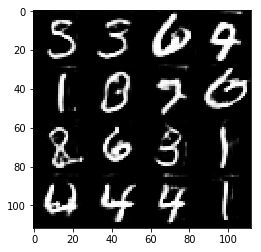

Timestamp 20170806-13-15-56.141 -  Epoch 2/2 -  Step 8710 -  D Loss: 1.0382 - G Loss: 1.0716
Timestamp 20170806-13-16-07.955 -  Epoch 2/2 -  Step 8720 -  D Loss: 1.2863 - G Loss: 0.8908
Timestamp 20170806-13-16-19.774 -  Epoch 2/2 -  Step 8730 -  D Loss: 0.8298 - G Loss: 1.3269
Timestamp 20170806-13-16-31.589 -  Epoch 2/2 -  Step 8740 -  D Loss: 1.0376 - G Loss: 1.1274
Timestamp 20170806-13-16-43.403 -  Epoch 2/2 -  Step 8750 -  D Loss: 0.9463 - G Loss: 1.1654
Timestamp 20170806-13-16-55.226 -  Epoch 2/2 -  Step 8760 -  D Loss: 0.8956 - G Loss: 1.6359
Timestamp 20170806-13-17-07.043 -  Epoch 2/2 -  Step 8770 -  D Loss: 0.6632 - G Loss: 1.2260
Timestamp 20170806-13-17-18.857 -  Epoch 2/2 -  Step 8780 -  D Loss: 0.9528 - G Loss: 1.4314
Timestamp 20170806-13-17-30.681 -  Epoch 2/2 -  Step 8790 -  D Loss: 0.9081 - G Loss: 1.0975
Timestamp 20170806-13-17-42.497 -  Epoch 2/2 -  Step 8800 -  D Loss: 1.1260 - G Loss: 1.0787


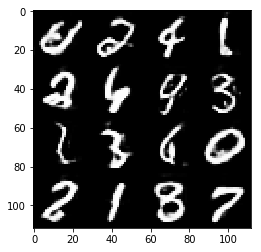

Timestamp 20170806-13-17-55.109 -  Epoch 2/2 -  Step 8810 -  D Loss: 1.5384 - G Loss: 0.8920
Timestamp 20170806-13-18-06.909 -  Epoch 2/2 -  Step 8820 -  D Loss: 0.7746 - G Loss: 1.0116
Timestamp 20170806-13-18-18.727 -  Epoch 2/2 -  Step 8830 -  D Loss: 1.5803 - G Loss: 0.8053
Timestamp 20170806-13-18-30.564 -  Epoch 2/2 -  Step 8840 -  D Loss: 0.6683 - G Loss: 1.1038
Timestamp 20170806-13-18-42.375 -  Epoch 2/2 -  Step 8850 -  D Loss: 1.0891 - G Loss: 0.7757
Timestamp 20170806-13-18-54.190 -  Epoch 2/2 -  Step 8860 -  D Loss: 1.3546 - G Loss: 1.0586
Timestamp 20170806-13-19-06.003 -  Epoch 2/2 -  Step 8870 -  D Loss: 1.2483 - G Loss: 0.9704
Timestamp 20170806-13-19-17.809 -  Epoch 2/2 -  Step 8880 -  D Loss: 0.8251 - G Loss: 1.6971
Timestamp 20170806-13-19-29.625 -  Epoch 2/2 -  Step 8890 -  D Loss: 1.1906 - G Loss: 1.6906
Timestamp 20170806-13-19-41.433 -  Epoch 2/2 -  Step 8900 -  D Loss: 1.3042 - G Loss: 0.9208


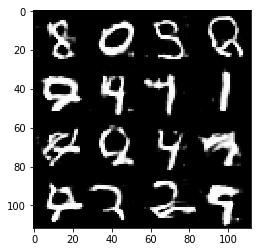

Timestamp 20170806-13-19-54.026 -  Epoch 2/2 -  Step 8910 -  D Loss: 1.4757 - G Loss: 0.9115
Timestamp 20170806-13-20-05.843 -  Epoch 2/2 -  Step 8920 -  D Loss: 1.0715 - G Loss: 1.4916
Timestamp 20170806-13-20-17.676 -  Epoch 2/2 -  Step 8930 -  D Loss: 0.7881 - G Loss: 1.6618
Timestamp 20170806-13-20-29.493 -  Epoch 2/2 -  Step 8940 -  D Loss: 0.8244 - G Loss: 1.5575
Timestamp 20170806-13-20-41.324 -  Epoch 2/2 -  Step 8950 -  D Loss: 0.6866 - G Loss: 2.0282
Timestamp 20170806-13-20-53.148 -  Epoch 2/2 -  Step 8960 -  D Loss: 0.6960 - G Loss: 1.2324
Timestamp 20170806-13-21-04.967 -  Epoch 2/2 -  Step 8970 -  D Loss: 0.8719 - G Loss: 0.9436
Timestamp 20170806-13-21-16.799 -  Epoch 2/2 -  Step 8980 -  D Loss: 1.0693 - G Loss: 0.9657
Timestamp 20170806-13-21-28.622 -  Epoch 2/2 -  Step 8990 -  D Loss: 1.4575 - G Loss: 0.7256
Timestamp 20170806-13-21-40.442 -  Epoch 2/2 -  Step 9000 -  D Loss: 0.9428 - G Loss: 1.0445


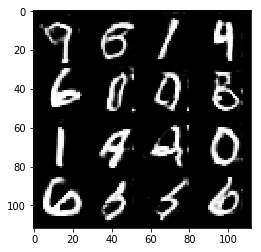

Timestamp 20170806-13-21-53.056 -  Epoch 2/2 -  Step 9010 -  D Loss: 1.5666 - G Loss: 1.2515
Timestamp 20170806-13-22-04.870 -  Epoch 2/2 -  Step 9020 -  D Loss: 0.8467 - G Loss: 1.1507
Timestamp 20170806-13-22-16.683 -  Epoch 2/2 -  Step 9030 -  D Loss: 0.6320 - G Loss: 2.2004
Timestamp 20170806-13-22-28.486 -  Epoch 2/2 -  Step 9040 -  D Loss: 1.0297 - G Loss: 1.6843
Timestamp 20170806-13-22-40.292 -  Epoch 2/2 -  Step 9050 -  D Loss: 0.8762 - G Loss: 0.8328
Timestamp 20170806-13-22-52.111 -  Epoch 2/2 -  Step 9060 -  D Loss: 0.9121 - G Loss: 1.8338
Timestamp 20170806-13-23-03.917 -  Epoch 2/2 -  Step 9070 -  D Loss: 1.2057 - G Loss: 1.4201
Timestamp 20170806-13-23-15.729 -  Epoch 2/2 -  Step 9080 -  D Loss: 1.1051 - G Loss: 1.9150
Timestamp 20170806-13-23-27.562 -  Epoch 2/2 -  Step 9090 -  D Loss: 0.9761 - G Loss: 1.0552
Timestamp 20170806-13-23-39.388 -  Epoch 2/2 -  Step 9100 -  D Loss: 0.5359 - G Loss: 1.6219


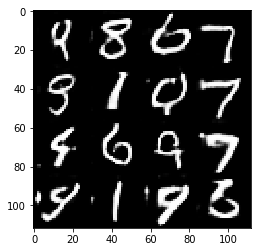

Timestamp 20170806-13-23-52.064 -  Epoch 2/2 -  Step 9110 -  D Loss: 1.1479 - G Loss: 0.9666
Timestamp 20170806-13-24-03.873 -  Epoch 2/2 -  Step 9120 -  D Loss: 0.8531 - G Loss: 1.4091
Timestamp 20170806-13-24-15.692 -  Epoch 2/2 -  Step 9130 -  D Loss: 1.0141 - G Loss: 1.4886
Timestamp 20170806-13-24-27.507 -  Epoch 2/2 -  Step 9140 -  D Loss: 1.3949 - G Loss: 1.5178
Timestamp 20170806-13-24-39.311 -  Epoch 2/2 -  Step 9150 -  D Loss: 1.0454 - G Loss: 1.3226
Timestamp 20170806-13-24-51.120 -  Epoch 2/2 -  Step 9160 -  D Loss: 1.1251 - G Loss: 1.1677
Timestamp 20170806-13-25-02.938 -  Epoch 2/2 -  Step 9170 -  D Loss: 1.0614 - G Loss: 1.3773
Timestamp 20170806-13-25-14.751 -  Epoch 2/2 -  Step 9180 -  D Loss: 1.0858 - G Loss: 1.0396
Timestamp 20170806-13-25-26.558 -  Epoch 2/2 -  Step 9190 -  D Loss: 0.9575 - G Loss: 1.5458
Timestamp 20170806-13-25-38.375 -  Epoch 2/2 -  Step 9200 -  D Loss: 1.3925 - G Loss: 0.8893


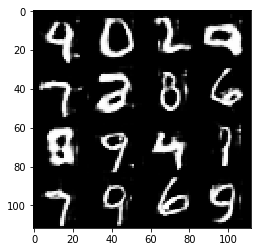

Timestamp 20170806-13-25-50.983 -  Epoch 2/2 -  Step 9210 -  D Loss: 0.7319 - G Loss: 1.4505
Timestamp 20170806-13-26-02.773 -  Epoch 2/2 -  Step 9220 -  D Loss: 0.7969 - G Loss: 1.5319
Timestamp 20170806-13-26-14.587 -  Epoch 2/2 -  Step 9230 -  D Loss: 0.8120 - G Loss: 0.8047
Timestamp 20170806-13-26-26.411 -  Epoch 2/2 -  Step 9240 -  D Loss: 0.9721 - G Loss: 1.6329
Timestamp 20170806-13-26-38.233 -  Epoch 2/2 -  Step 9250 -  D Loss: 0.7268 - G Loss: 1.5741
Timestamp 20170806-13-26-50.041 -  Epoch 2/2 -  Step 9260 -  D Loss: 1.2400 - G Loss: 0.9672
Timestamp 20170806-13-27-01.862 -  Epoch 2/2 -  Step 9270 -  D Loss: 1.3985 - G Loss: 1.1834
Timestamp 20170806-13-27-13.678 -  Epoch 2/2 -  Step 9280 -  D Loss: 0.9829 - G Loss: 1.1986
Timestamp 20170806-13-27-25.486 -  Epoch 2/2 -  Step 9290 -  D Loss: 1.1094 - G Loss: 1.3619
Timestamp 20170806-13-27-37.298 -  Epoch 2/2 -  Step 9300 -  D Loss: 0.9854 - G Loss: 1.0546


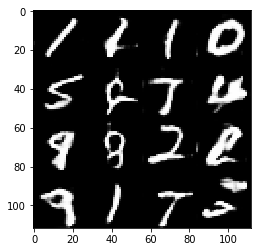

Timestamp 20170806-13-27-49.906 -  Epoch 2/2 -  Step 9310 -  D Loss: 0.9447 - G Loss: 0.9683
Timestamp 20170806-13-28-01.720 -  Epoch 2/2 -  Step 9320 -  D Loss: 0.8944 - G Loss: 1.4474
Timestamp 20170806-13-28-13.517 -  Epoch 2/2 -  Step 9330 -  D Loss: 1.2069 - G Loss: 1.6856
Timestamp 20170806-13-28-25.330 -  Epoch 2/2 -  Step 9340 -  D Loss: 0.7931 - G Loss: 1.4202
Timestamp 20170806-13-28-37.147 -  Epoch 2/2 -  Step 9350 -  D Loss: 1.2228 - G Loss: 1.3788
Timestamp 20170806-13-28-48.952 -  Epoch 2/2 -  Step 9360 -  D Loss: 1.1214 - G Loss: 1.7798
Timestamp 20170806-13-29-00.766 -  Epoch 2/2 -  Step 9370 -  D Loss: 0.9578 - G Loss: 1.4762
Timestamp 20170806-13-29-12.590 -  Epoch 2/2 -  Step 9380 -  D Loss: 1.3865 - G Loss: 1.0006
Timestamp 20170806-13-29-24.400 -  Epoch 2/2 -  Step 9390 -  D Loss: 1.0664 - G Loss: 1.5032
Timestamp 20170806-13-29-36.221 -  Epoch 2/2 -  Step 9400 -  D Loss: 0.7957 - G Loss: 1.8990


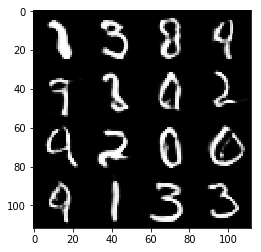

Timestamp 20170806-13-29-48.809 -  Epoch 2/2 -  Step 9410 -  D Loss: 0.8375 - G Loss: 2.3599
Timestamp 20170806-13-30-00.624 -  Epoch 2/2 -  Step 9420 -  D Loss: 0.8718 - G Loss: 1.4133
Timestamp 20170806-13-30-12.437 -  Epoch 2/2 -  Step 9430 -  D Loss: 0.6458 - G Loss: 1.7476
Timestamp 20170806-13-30-24.263 -  Epoch 2/2 -  Step 9440 -  D Loss: 0.9723 - G Loss: 1.7511
Timestamp 20170806-13-30-36.074 -  Epoch 2/2 -  Step 9450 -  D Loss: 1.3481 - G Loss: 1.3680
Timestamp 20170806-13-30-47.873 -  Epoch 2/2 -  Step 9460 -  D Loss: 1.1446 - G Loss: 1.1214
Timestamp 20170806-13-30-59.693 -  Epoch 2/2 -  Step 9470 -  D Loss: 1.0575 - G Loss: 1.0727
Timestamp 20170806-13-31-11.513 -  Epoch 2/2 -  Step 9480 -  D Loss: 1.0409 - G Loss: 1.4131
Timestamp 20170806-13-31-23.327 -  Epoch 2/2 -  Step 9490 -  D Loss: 0.6259 - G Loss: 1.5348
Timestamp 20170806-13-31-35.153 -  Epoch 2/2 -  Step 9500 -  D Loss: 0.8121 - G Loss: 1.6732


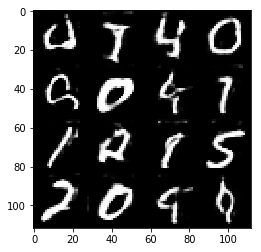

Timestamp 20170806-13-31-47.854 -  Epoch 2/2 -  Step 9510 -  D Loss: 1.4700 - G Loss: 2.3152
Timestamp 20170806-13-31-59.670 -  Epoch 2/2 -  Step 9520 -  D Loss: 0.7335 - G Loss: 1.6072
Timestamp 20170806-13-32-11.503 -  Epoch 2/2 -  Step 9530 -  D Loss: 0.8812 - G Loss: 2.4141
Timestamp 20170806-13-32-23.336 -  Epoch 2/2 -  Step 9540 -  D Loss: 1.5243 - G Loss: 1.2145
Timestamp 20170806-13-32-35.167 -  Epoch 2/2 -  Step 9550 -  D Loss: 0.7593 - G Loss: 1.3284
Timestamp 20170806-13-32-46.993 -  Epoch 2/2 -  Step 9560 -  D Loss: 1.0868 - G Loss: 0.7169
Timestamp 20170806-13-32-58.799 -  Epoch 2/2 -  Step 9570 -  D Loss: 0.9499 - G Loss: 0.8729
Timestamp 20170806-13-33-10.632 -  Epoch 2/2 -  Step 9580 -  D Loss: 0.8145 - G Loss: 0.8674
Timestamp 20170806-13-33-22.448 -  Epoch 2/2 -  Step 9590 -  D Loss: 1.1626 - G Loss: 1.9972
Timestamp 20170806-13-33-34.260 -  Epoch 2/2 -  Step 9600 -  D Loss: 0.7475 - G Loss: 1.7445


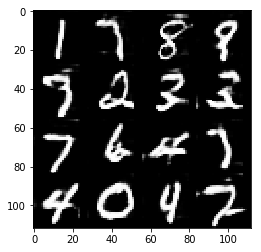

Timestamp 20170806-13-33-46.964 -  Epoch 2/2 -  Step 9610 -  D Loss: 0.9074 - G Loss: 2.0803
Timestamp 20170806-13-33-58.781 -  Epoch 2/2 -  Step 9620 -  D Loss: 0.8414 - G Loss: 1.6614
Timestamp 20170806-13-34-10.595 -  Epoch 2/2 -  Step 9630 -  D Loss: 1.0414 - G Loss: 1.2980
Timestamp 20170806-13-34-22.418 -  Epoch 2/2 -  Step 9640 -  D Loss: 0.8254 - G Loss: 1.2709
Timestamp 20170806-13-34-34.238 -  Epoch 2/2 -  Step 9650 -  D Loss: 1.2284 - G Loss: 0.9331
Timestamp 20170806-13-34-46.063 -  Epoch 2/2 -  Step 9660 -  D Loss: 1.1777 - G Loss: 1.3913
Timestamp 20170806-13-34-57.877 -  Epoch 2/2 -  Step 9670 -  D Loss: 0.8130 - G Loss: 1.1650
Timestamp 20170806-13-35-09.695 -  Epoch 2/2 -  Step 9680 -  D Loss: 0.8675 - G Loss: 2.0151
Timestamp 20170806-13-35-21.510 -  Epoch 2/2 -  Step 9690 -  D Loss: 0.9091 - G Loss: 0.9924
Timestamp 20170806-13-35-33.312 -  Epoch 2/2 -  Step 9700 -  D Loss: 1.3967 - G Loss: 1.0310


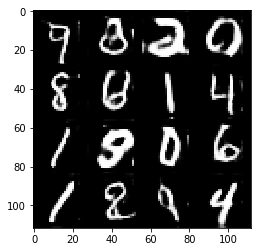

Timestamp 20170806-13-35-45.974 -  Epoch 2/2 -  Step 9710 -  D Loss: 1.1846 - G Loss: 0.8559
Timestamp 20170806-13-35-57.771 -  Epoch 2/2 -  Step 9720 -  D Loss: 0.7634 - G Loss: 1.5459
Timestamp 20170806-13-36-09.580 -  Epoch 2/2 -  Step 9730 -  D Loss: 0.9086 - G Loss: 1.4221
Timestamp 20170806-13-36-21.391 -  Epoch 2/2 -  Step 9740 -  D Loss: 1.0508 - G Loss: 1.5630
Timestamp 20170806-13-36-33.166 -  Epoch 2/2 -  Step 9750 -  D Loss: 0.8972 - G Loss: 1.2330
Timestamp 20170806-13-36-44.964 -  Epoch 2/2 -  Step 9760 -  D Loss: 0.8237 - G Loss: 1.3584
Timestamp 20170806-13-36-56.755 -  Epoch 2/2 -  Step 9770 -  D Loss: 1.2238 - G Loss: 1.1473
Timestamp 20170806-13-37-08.533 -  Epoch 2/2 -  Step 9780 -  D Loss: 0.8574 - G Loss: 1.1638
Timestamp 20170806-13-37-20.329 -  Epoch 2/2 -  Step 9790 -  D Loss: 1.4109 - G Loss: 1.1181
Timestamp 20170806-13-37-32.115 -  Epoch 2/2 -  Step 9800 -  D Loss: 1.1828 - G Loss: 0.7429


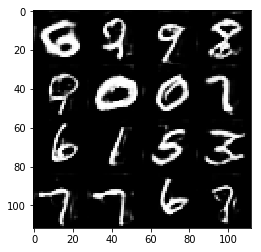

Timestamp 20170806-13-37-44.811 -  Epoch 2/2 -  Step 9810 -  D Loss: 1.1760 - G Loss: 0.9316
Timestamp 20170806-13-37-56.603 -  Epoch 2/2 -  Step 9820 -  D Loss: 1.1811 - G Loss: 0.9900
Timestamp 20170806-13-38-08.400 -  Epoch 2/2 -  Step 9830 -  D Loss: 1.0257 - G Loss: 2.1498
Timestamp 20170806-13-38-20.199 -  Epoch 2/2 -  Step 9840 -  D Loss: 0.9857 - G Loss: 1.2792
Timestamp 20170806-13-38-31.996 -  Epoch 2/2 -  Step 9850 -  D Loss: 1.0627 - G Loss: 1.1053
Timestamp 20170806-13-38-43.786 -  Epoch 2/2 -  Step 9860 -  D Loss: 0.6987 - G Loss: 1.1207
Timestamp 20170806-13-38-55.573 -  Epoch 2/2 -  Step 9870 -  D Loss: 1.0616 - G Loss: 1.1278
Timestamp 20170806-13-39-07.377 -  Epoch 2/2 -  Step 9880 -  D Loss: 0.6414 - G Loss: 1.3569
Timestamp 20170806-13-39-19.177 -  Epoch 2/2 -  Step 9890 -  D Loss: 1.0453 - G Loss: 1.0642
Timestamp 20170806-13-39-30.992 -  Epoch 2/2 -  Step 9900 -  D Loss: 0.9668 - G Loss: 1.2731


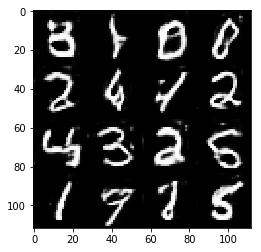

Timestamp 20170806-13-39-43.715 -  Epoch 2/2 -  Step 9910 -  D Loss: 1.1418 - G Loss: 1.0888
Timestamp 20170806-13-39-55.513 -  Epoch 2/2 -  Step 9920 -  D Loss: 1.2724 - G Loss: 1.0777
Timestamp 20170806-13-40-07.315 -  Epoch 2/2 -  Step 9930 -  D Loss: 0.8288 - G Loss: 1.6631
Timestamp 20170806-13-40-19.118 -  Epoch 2/2 -  Step 9940 -  D Loss: 1.2199 - G Loss: 0.6396
Timestamp 20170806-13-40-30.914 -  Epoch 2/2 -  Step 9950 -  D Loss: 0.7721 - G Loss: 1.3478
Timestamp 20170806-13-40-42.693 -  Epoch 2/2 -  Step 9960 -  D Loss: 1.1017 - G Loss: 1.4559
Timestamp 20170806-13-40-54.511 -  Epoch 2/2 -  Step 9970 -  D Loss: 0.9358 - G Loss: 0.7685
Timestamp 20170806-13-41-06.320 -  Epoch 2/2 -  Step 9980 -  D Loss: 0.8124 - G Loss: 2.3308
Timestamp 20170806-13-41-18.130 -  Epoch 2/2 -  Step 9990 -  D Loss: 0.7629 - G Loss: 1.1981
Timestamp 20170806-13-41-29.940 -  Epoch 2/2 -  Step 10000 -  D Loss: 1.1993 - G Loss: 0.6511


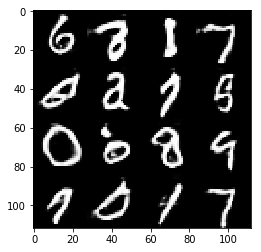

Timestamp 20170806-13-41-42.540 -  Epoch 2/2 -  Step 10010 -  D Loss: 0.7679 - G Loss: 2.3414
Timestamp 20170806-13-41-54.340 -  Epoch 2/2 -  Step 10020 -  D Loss: 1.1783 - G Loss: 0.8691
Timestamp 20170806-13-42-06.163 -  Epoch 2/2 -  Step 10030 -  D Loss: 0.9177 - G Loss: 1.1136
Timestamp 20170806-13-42-17.968 -  Epoch 2/2 -  Step 10040 -  D Loss: 1.3146 - G Loss: 1.1925
Timestamp 20170806-13-42-29.751 -  Epoch 2/2 -  Step 10050 -  D Loss: 1.0940 - G Loss: 1.2282
Timestamp 20170806-13-42-41.542 -  Epoch 2/2 -  Step 10060 -  D Loss: 1.4835 - G Loss: 1.1023
Timestamp 20170806-13-42-53.337 -  Epoch 2/2 -  Step 10070 -  D Loss: 0.8191 - G Loss: 1.4717
Timestamp 20170806-13-43-05.164 -  Epoch 2/2 -  Step 10080 -  D Loss: 0.8642 - G Loss: 1.2705
Timestamp 20170806-13-43-16.969 -  Epoch 2/2 -  Step 10090 -  D Loss: 0.9868 - G Loss: 1.6733
Timestamp 20170806-13-43-28.768 -  Epoch 2/2 -  Step 10100 -  D Loss: 0.8131 - G Loss: 1.1561


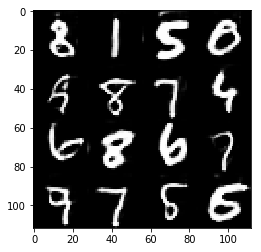

Timestamp 20170806-13-43-41.360 -  Epoch 2/2 -  Step 10110 -  D Loss: 0.9301 - G Loss: 1.5403
Timestamp 20170806-13-43-53.157 -  Epoch 2/2 -  Step 10120 -  D Loss: 1.2458 - G Loss: 1.5342
Timestamp 20170806-13-44-04.955 -  Epoch 2/2 -  Step 10130 -  D Loss: 0.9055 - G Loss: 0.4751
Timestamp 20170806-13-44-16.751 -  Epoch 2/2 -  Step 10140 -  D Loss: 1.3393 - G Loss: 1.6516
Timestamp 20170806-13-44-28.568 -  Epoch 2/2 -  Step 10150 -  D Loss: 1.0185 - G Loss: 1.3127
Timestamp 20170806-13-44-40.358 -  Epoch 2/2 -  Step 10160 -  D Loss: 1.0354 - G Loss: 1.2541
Timestamp 20170806-13-44-52.161 -  Epoch 2/2 -  Step 10170 -  D Loss: 0.6809 - G Loss: 1.5783
Timestamp 20170806-13-45-03.956 -  Epoch 2/2 -  Step 10180 -  D Loss: 0.9699 - G Loss: 0.9815
Timestamp 20170806-13-45-15.753 -  Epoch 2/2 -  Step 10190 -  D Loss: 1.4104 - G Loss: 1.7543
Timestamp 20170806-13-45-27.555 -  Epoch 2/2 -  Step 10200 -  D Loss: 0.7990 - G Loss: 1.5802


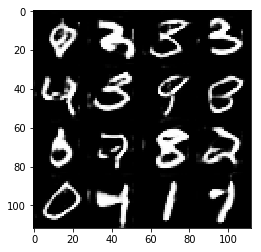

Timestamp 20170806-13-45-40.171 -  Epoch 2/2 -  Step 10210 -  D Loss: 0.6765 - G Loss: 1.2241
Timestamp 20170806-13-45-51.976 -  Epoch 2/2 -  Step 10220 -  D Loss: 0.9044 - G Loss: 1.5230
Timestamp 20170806-13-46-03.777 -  Epoch 2/2 -  Step 10230 -  D Loss: 0.9195 - G Loss: 1.6767
Timestamp 20170806-13-46-15.587 -  Epoch 2/2 -  Step 10240 -  D Loss: 0.7654 - G Loss: 1.2117
Timestamp 20170806-13-46-27.386 -  Epoch 2/2 -  Step 10250 -  D Loss: 0.9058 - G Loss: 1.9537
Timestamp 20170806-13-46-39.180 -  Epoch 2/2 -  Step 10260 -  D Loss: 1.8962 - G Loss: 0.6404
Timestamp 20170806-13-46-50.967 -  Epoch 2/2 -  Step 10270 -  D Loss: 0.7097 - G Loss: 1.9906
Timestamp 20170806-13-47-02.787 -  Epoch 2/2 -  Step 10280 -  D Loss: 1.0324 - G Loss: 1.3487
Timestamp 20170806-13-47-14.595 -  Epoch 2/2 -  Step 10290 -  D Loss: 0.8446 - G Loss: 0.8919
Timestamp 20170806-13-47-26.388 -  Epoch 2/2 -  Step 10300 -  D Loss: 0.8528 - G Loss: 2.7998


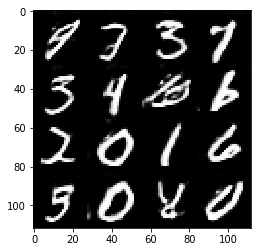

Timestamp 20170806-13-47-38.997 -  Epoch 2/2 -  Step 10310 -  D Loss: 0.8144 - G Loss: 1.4332
Timestamp 20170806-13-47-50.794 -  Epoch 2/2 -  Step 10320 -  D Loss: 0.9079 - G Loss: 1.3955
Timestamp 20170806-13-48-02.597 -  Epoch 2/2 -  Step 10330 -  D Loss: 0.9978 - G Loss: 2.0577
Timestamp 20170806-13-48-14.379 -  Epoch 2/2 -  Step 10340 -  D Loss: 1.1050 - G Loss: 1.0307
Timestamp 20170806-13-48-26.186 -  Epoch 2/2 -  Step 10350 -  D Loss: 0.8475 - G Loss: 1.3399
Timestamp 20170806-13-48-37.990 -  Epoch 2/2 -  Step 10360 -  D Loss: 0.8076 - G Loss: 1.6479
Timestamp 20170806-13-48-49.792 -  Epoch 2/2 -  Step 10370 -  D Loss: 1.3438 - G Loss: 0.8370
Timestamp 20170806-13-49-01.593 -  Epoch 2/2 -  Step 10380 -  D Loss: 0.9365 - G Loss: 0.9828
Timestamp 20170806-13-49-13.397 -  Epoch 2/2 -  Step 10390 -  D Loss: 0.9825 - G Loss: 1.0545
Timestamp 20170806-13-49-25.198 -  Epoch 2/2 -  Step 10400 -  D Loss: 1.2898 - G Loss: 0.9907


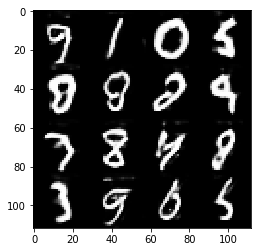

Timestamp 20170806-13-49-37.778 -  Epoch 2/2 -  Step 10410 -  D Loss: 1.3064 - G Loss: 0.9344
Timestamp 20170806-13-49-49.576 -  Epoch 2/2 -  Step 10420 -  D Loss: 1.1864 - G Loss: 2.1266
Timestamp 20170806-13-50-01.370 -  Epoch 2/2 -  Step 10430 -  D Loss: 1.5618 - G Loss: 1.0876
Timestamp 20170806-13-50-13.174 -  Epoch 2/2 -  Step 10440 -  D Loss: 0.8214 - G Loss: 1.7917
Timestamp 20170806-13-50-24.981 -  Epoch 2/2 -  Step 10450 -  D Loss: 1.2145 - G Loss: 1.4244
Timestamp 20170806-13-50-36.790 -  Epoch 2/2 -  Step 10460 -  D Loss: 1.5019 - G Loss: 0.7122
Timestamp 20170806-13-50-48.591 -  Epoch 2/2 -  Step 10470 -  D Loss: 1.2369 - G Loss: 1.3169
Timestamp 20170806-13-51-00.392 -  Epoch 2/2 -  Step 10480 -  D Loss: 1.4867 - G Loss: 1.0976
Timestamp 20170806-13-51-12.207 -  Epoch 2/2 -  Step 10490 -  D Loss: 1.2529 - G Loss: 0.7954
Timestamp 20170806-13-51-24.002 -  Epoch 2/2 -  Step 10500 -  D Loss: 0.9273 - G Loss: 0.8008


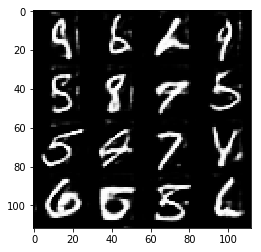

Timestamp 20170806-13-51-36.598 -  Epoch 2/2 -  Step 10510 -  D Loss: 0.9511 - G Loss: 1.4345
Timestamp 20170806-13-51-48.394 -  Epoch 2/2 -  Step 10520 -  D Loss: 0.8837 - G Loss: 1.3895
Timestamp 20170806-13-52-00.192 -  Epoch 2/2 -  Step 10530 -  D Loss: 1.2048 - G Loss: 0.9562
Timestamp 20170806-13-52-11.987 -  Epoch 2/2 -  Step 10540 -  D Loss: 1.2311 - G Loss: 1.1117
Timestamp 20170806-13-52-23.778 -  Epoch 2/2 -  Step 10550 -  D Loss: 1.5466 - G Loss: 0.4886
Timestamp 20170806-13-52-35.580 -  Epoch 2/2 -  Step 10560 -  D Loss: 0.8773 - G Loss: 1.4463
Timestamp 20170806-13-52-47.383 -  Epoch 2/2 -  Step 10570 -  D Loss: 1.1757 - G Loss: 1.1118
Timestamp 20170806-13-52-59.172 -  Epoch 2/2 -  Step 10580 -  D Loss: 0.8632 - G Loss: 1.7250
Timestamp 20170806-13-53-10.986 -  Epoch 2/2 -  Step 10590 -  D Loss: 0.8330 - G Loss: 1.2630
Timestamp 20170806-13-53-22.794 -  Epoch 2/2 -  Step 10600 -  D Loss: 1.1649 - G Loss: 1.1881


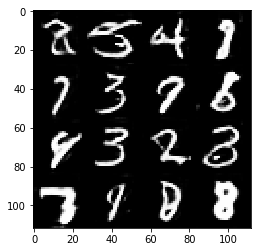

Timestamp 20170806-13-53-35.405 -  Epoch 2/2 -  Step 10610 -  D Loss: 0.9020 - G Loss: 1.2803
Timestamp 20170806-13-53-47.208 -  Epoch 2/2 -  Step 10620 -  D Loss: 1.0198 - G Loss: 0.9500
Timestamp 20170806-13-53-59.005 -  Epoch 2/2 -  Step 10630 -  D Loss: 1.1474 - G Loss: 0.9318
Timestamp 20170806-13-54-10.816 -  Epoch 2/2 -  Step 10640 -  D Loss: 1.1139 - G Loss: 1.5380
Timestamp 20170806-13-54-22.640 -  Epoch 2/2 -  Step 10650 -  D Loss: 0.8260 - G Loss: 1.6081
Timestamp 20170806-13-54-34.439 -  Epoch 2/2 -  Step 10660 -  D Loss: 0.7520 - G Loss: 1.5156
Timestamp 20170806-13-54-46.235 -  Epoch 2/2 -  Step 10670 -  D Loss: 1.0625 - G Loss: 1.0975
Timestamp 20170806-13-54-58.035 -  Epoch 2/2 -  Step 10680 -  D Loss: 1.1493 - G Loss: 1.6283
Timestamp 20170806-13-55-09.841 -  Epoch 2/2 -  Step 10690 -  D Loss: 1.3691 - G Loss: 0.8923
Timestamp 20170806-13-55-21.632 -  Epoch 2/2 -  Step 10700 -  D Loss: 1.2027 - G Loss: 1.2653


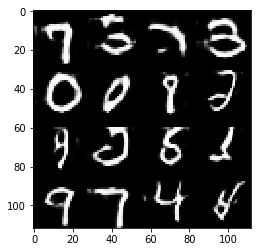

Timestamp 20170806-13-55-34.225 -  Epoch 2/2 -  Step 10710 -  D Loss: 0.7956 - G Loss: 1.9404
Timestamp 20170806-13-55-46.030 -  Epoch 2/2 -  Step 10720 -  D Loss: 1.0873 - G Loss: 1.7699
Timestamp 20170806-13-55-57.833 -  Epoch 2/2 -  Step 10730 -  D Loss: 1.0794 - G Loss: 0.9457
Timestamp 20170806-13-56-09.656 -  Epoch 2/2 -  Step 10740 -  D Loss: 0.8140 - G Loss: 1.2972
Timestamp 20170806-13-56-21.455 -  Epoch 2/2 -  Step 10750 -  D Loss: 0.8833 - G Loss: 1.1208
Timestamp 20170806-13-56-33.245 -  Epoch 2/2 -  Step 10760 -  D Loss: 1.1023 - G Loss: 0.9649
Timestamp 20170806-13-56-45.031 -  Epoch 2/2 -  Step 10770 -  D Loss: 1.0278 - G Loss: 1.0511
Timestamp 20170806-13-56-56.831 -  Epoch 2/2 -  Step 10780 -  D Loss: 0.7290 - G Loss: 2.1848
Timestamp 20170806-13-57-08.636 -  Epoch 2/2 -  Step 10790 -  D Loss: 0.8783 - G Loss: 2.1837
Timestamp 20170806-13-57-20.426 -  Epoch 2/2 -  Step 10800 -  D Loss: 1.3029 - G Loss: 1.1998


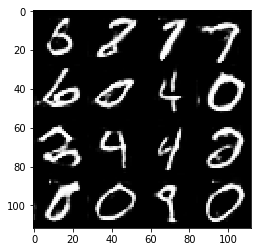

Timestamp 20170806-13-57-33.231 -  Epoch 2/2 -  Step 10810 -  D Loss: 1.2033 - G Loss: 1.3120
Timestamp 20170806-13-57-45.022 -  Epoch 2/2 -  Step 10820 -  D Loss: 1.4083 - G Loss: 0.9887
Timestamp 20170806-13-57-56.832 -  Epoch 2/2 -  Step 10830 -  D Loss: 0.8547 - G Loss: 1.5313
Timestamp 20170806-13-58-08.632 -  Epoch 2/2 -  Step 10840 -  D Loss: 0.8710 - G Loss: 1.9167
Timestamp 20170806-13-58-20.432 -  Epoch 2/2 -  Step 10850 -  D Loss: 0.7216 - G Loss: 1.5326
Timestamp 20170806-13-58-32.223 -  Epoch 2/2 -  Step 10860 -  D Loss: 1.0259 - G Loss: 0.7617
Timestamp 20170806-13-58-44.026 -  Epoch 2/2 -  Step 10870 -  D Loss: 0.9546 - G Loss: 0.6862
Timestamp 20170806-13-58-55.820 -  Epoch 2/2 -  Step 10880 -  D Loss: 0.7803 - G Loss: 2.0901
Timestamp 20170806-13-59-07.623 -  Epoch 2/2 -  Step 10890 -  D Loss: 1.4697 - G Loss: 0.7637
Timestamp 20170806-13-59-19.426 -  Epoch 2/2 -  Step 10900 -  D Loss: 0.9222 - G Loss: 1.3017


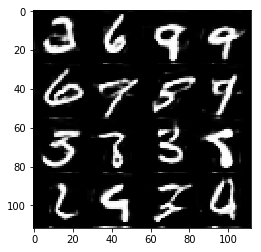

Timestamp 20170806-13-59-32.060 -  Epoch 2/2 -  Step 10910 -  D Loss: 1.1939 - G Loss: 1.7969
Timestamp 20170806-13-59-43.857 -  Epoch 2/2 -  Step 10920 -  D Loss: 1.1236 - G Loss: 1.3005
Timestamp 20170806-13-59-55.659 -  Epoch 2/2 -  Step 10930 -  D Loss: 0.8601 - G Loss: 1.8314
Timestamp 20170806-14-00-07.447 -  Epoch 2/2 -  Step 10940 -  D Loss: 1.0838 - G Loss: 0.8425
Timestamp 20170806-14-00-19.258 -  Epoch 2/2 -  Step 10950 -  D Loss: 1.1567 - G Loss: 1.0669
Timestamp 20170806-14-00-31.068 -  Epoch 2/2 -  Step 10960 -  D Loss: 1.4454 - G Loss: 0.5121
Timestamp 20170806-14-00-42.863 -  Epoch 2/2 -  Step 10970 -  D Loss: 0.9420 - G Loss: 0.9785
Timestamp 20170806-14-00-54.663 -  Epoch 2/2 -  Step 10980 -  D Loss: 1.5089 - G Loss: 0.4394
Timestamp 20170806-14-01-06.493 -  Epoch 2/2 -  Step 10990 -  D Loss: 0.7258 - G Loss: 1.8216
Timestamp 20170806-14-01-18.318 -  Epoch 2/2 -  Step 11000 -  D Loss: 0.8492 - G Loss: 1.0263


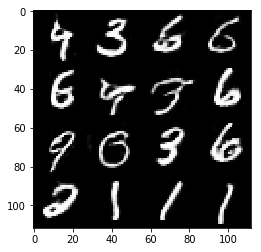

Timestamp 20170806-14-01-31.064 -  Epoch 2/2 -  Step 11010 -  D Loss: 1.1115 - G Loss: 1.8014
Timestamp 20170806-14-01-42.891 -  Epoch 2/2 -  Step 11020 -  D Loss: 1.2533 - G Loss: 1.1973
Timestamp 20170806-14-01-54.702 -  Epoch 2/2 -  Step 11030 -  D Loss: 1.2550 - G Loss: 0.7545
Timestamp 20170806-14-02-06.520 -  Epoch 2/2 -  Step 11040 -  D Loss: 1.0245 - G Loss: 1.2479
Timestamp 20170806-14-02-18.336 -  Epoch 2/2 -  Step 11050 -  D Loss: 0.8027 - G Loss: 1.6392
Timestamp 20170806-14-02-30.150 -  Epoch 2/2 -  Step 11060 -  D Loss: 0.8184 - G Loss: 1.1175
Timestamp 20170806-14-02-41.958 -  Epoch 2/2 -  Step 11070 -  D Loss: 0.7965 - G Loss: 1.5278
Timestamp 20170806-14-02-53.744 -  Epoch 2/2 -  Step 11080 -  D Loss: 1.1327 - G Loss: 1.5100
Timestamp 20170806-14-03-05.542 -  Epoch 2/2 -  Step 11090 -  D Loss: 1.3790 - G Loss: 0.9917
Timestamp 20170806-14-03-17.337 -  Epoch 2/2 -  Step 11100 -  D Loss: 1.0581 - G Loss: 1.0159


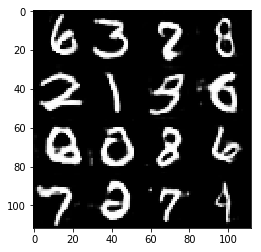

Timestamp 20170806-14-03-29.963 -  Epoch 2/2 -  Step 11110 -  D Loss: 1.0089 - G Loss: 2.0181
Timestamp 20170806-14-03-41.776 -  Epoch 2/2 -  Step 11120 -  D Loss: 0.6474 - G Loss: 1.9746
Timestamp 20170806-14-03-53.573 -  Epoch 2/2 -  Step 11130 -  D Loss: 0.7439 - G Loss: 1.4305
Timestamp 20170806-14-04-05.365 -  Epoch 2/2 -  Step 11140 -  D Loss: 0.8999 - G Loss: 1.0701
Timestamp 20170806-14-04-17.178 -  Epoch 2/2 -  Step 11150 -  D Loss: 0.9783 - G Loss: 1.4859
Timestamp 20170806-14-04-28.983 -  Epoch 2/2 -  Step 11160 -  D Loss: 0.8831 - G Loss: 1.4203
Timestamp 20170806-14-04-40.790 -  Epoch 2/2 -  Step 11170 -  D Loss: 1.1570 - G Loss: 0.9840
Timestamp 20170806-14-04-52.590 -  Epoch 2/2 -  Step 11180 -  D Loss: 1.1455 - G Loss: 0.6433
Timestamp 20170806-14-05-04.389 -  Epoch 2/2 -  Step 11190 -  D Loss: 1.4997 - G Loss: 0.8014
Timestamp 20170806-14-05-16.199 -  Epoch 2/2 -  Step 11200 -  D Loss: 0.9719 - G Loss: 1.5454


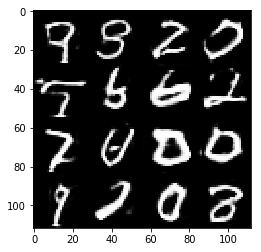

Timestamp 20170806-14-05-28.826 -  Epoch 2/2 -  Step 11210 -  D Loss: 1.1944 - G Loss: 0.9825
Timestamp 20170806-14-05-40.627 -  Epoch 2/2 -  Step 11220 -  D Loss: 0.6901 - G Loss: 1.3351
Timestamp 20170806-14-05-52.423 -  Epoch 2/2 -  Step 11230 -  D Loss: 0.8942 - G Loss: 2.6362
Timestamp 20170806-14-06-04.214 -  Epoch 2/2 -  Step 11240 -  D Loss: 1.0804 - G Loss: 0.9753
Timestamp 20170806-14-06-16.022 -  Epoch 2/2 -  Step 11250 -  D Loss: 1.6089 - G Loss: 0.8820
Timestamp 20170806-14-06-27.809 -  Epoch 2/2 -  Step 11260 -  D Loss: 0.9699 - G Loss: 1.1447
Timestamp 20170806-14-06-39.618 -  Epoch 2/2 -  Step 11270 -  D Loss: 0.7253 - G Loss: 1.2359
Timestamp 20170806-14-06-51.433 -  Epoch 2/2 -  Step 11280 -  D Loss: 1.2813 - G Loss: 1.2675
Timestamp 20170806-14-07-03.233 -  Epoch 2/2 -  Step 11290 -  D Loss: 0.9489 - G Loss: 1.0581
Timestamp 20170806-14-07-15.042 -  Epoch 2/2 -  Step 11300 -  D Loss: 1.0852 - G Loss: 1.1542


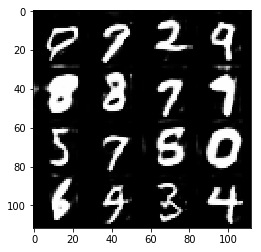

Timestamp 20170806-14-07-27.666 -  Epoch 2/2 -  Step 11310 -  D Loss: 1.3911 - G Loss: 1.0912
Timestamp 20170806-14-07-39.454 -  Epoch 2/2 -  Step 11320 -  D Loss: 1.4211 - G Loss: 1.1115
Timestamp 20170806-14-07-51.266 -  Epoch 2/2 -  Step 11330 -  D Loss: 0.6808 - G Loss: 2.1536
Timestamp 20170806-14-08-03.076 -  Epoch 2/2 -  Step 11340 -  D Loss: 1.2862 - G Loss: 1.0947
Timestamp 20170806-14-08-14.888 -  Epoch 2/2 -  Step 11350 -  D Loss: 1.4095 - G Loss: 1.2332
Timestamp 20170806-14-08-26.679 -  Epoch 2/2 -  Step 11360 -  D Loss: 0.7767 - G Loss: 1.3113
Timestamp 20170806-14-08-38.474 -  Epoch 2/2 -  Step 11370 -  D Loss: 0.6703 - G Loss: 1.3155
Timestamp 20170806-14-08-50.276 -  Epoch 2/2 -  Step 11380 -  D Loss: 0.9719 - G Loss: 0.8416
Timestamp 20170806-14-09-02.075 -  Epoch 2/2 -  Step 11390 -  D Loss: 0.8813 - G Loss: 0.9102
Timestamp 20170806-14-09-13.884 -  Epoch 2/2 -  Step 11400 -  D Loss: 0.7549 - G Loss: 1.7912


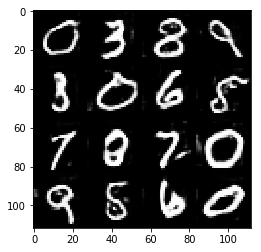

Timestamp 20170806-14-09-26.485 -  Epoch 2/2 -  Step 11410 -  D Loss: 1.1401 - G Loss: 0.6858
Timestamp 20170806-14-09-38.291 -  Epoch 2/2 -  Step 11420 -  D Loss: 0.8539 - G Loss: 1.6745
Timestamp 20170806-14-09-50.100 -  Epoch 2/2 -  Step 11430 -  D Loss: 1.1264 - G Loss: 1.2326
Timestamp 20170806-14-10-01.899 -  Epoch 2/2 -  Step 11440 -  D Loss: 1.6333 - G Loss: 0.6459
Timestamp 20170806-14-10-13.703 -  Epoch 2/2 -  Step 11450 -  D Loss: 1.3468 - G Loss: 1.4222
Timestamp 20170806-14-10-25.504 -  Epoch 2/2 -  Step 11460 -  D Loss: 0.9668 - G Loss: 1.2064
Timestamp 20170806-14-10-37.310 -  Epoch 2/2 -  Step 11470 -  D Loss: 0.8340 - G Loss: 2.3730
Timestamp 20170806-14-10-49.099 -  Epoch 2/2 -  Step 11480 -  D Loss: 1.2757 - G Loss: 1.8150
Timestamp 20170806-14-11-00.910 -  Epoch 2/2 -  Step 11490 -  D Loss: 0.9774 - G Loss: 0.8681
Timestamp 20170806-14-11-12.713 -  Epoch 2/2 -  Step 11500 -  D Loss: 1.0437 - G Loss: 1.4882


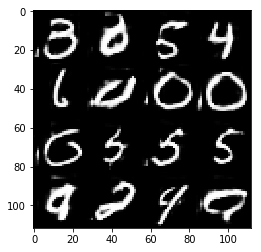

Timestamp 20170806-14-11-25.326 -  Epoch 2/2 -  Step 11510 -  D Loss: 1.1030 - G Loss: 1.1641
Timestamp 20170806-14-11-37.125 -  Epoch 2/2 -  Step 11520 -  D Loss: 0.9899 - G Loss: 2.0588
Timestamp 20170806-14-11-48.922 -  Epoch 2/2 -  Step 11530 -  D Loss: 0.8720 - G Loss: 1.7213
Timestamp 20170806-14-12-00.721 -  Epoch 2/2 -  Step 11540 -  D Loss: 0.9409 - G Loss: 1.5614
Timestamp 20170806-14-12-12.521 -  Epoch 2/2 -  Step 11550 -  D Loss: 0.8692 - G Loss: 2.3031
Timestamp 20170806-14-12-24.321 -  Epoch 2/2 -  Step 11560 -  D Loss: 0.9920 - G Loss: 0.6646
Timestamp 20170806-14-12-36.107 -  Epoch 2/2 -  Step 11570 -  D Loss: 0.8050 - G Loss: 0.9276
Timestamp 20170806-14-12-47.893 -  Epoch 2/2 -  Step 11580 -  D Loss: 1.3721 - G Loss: 1.3870
Timestamp 20170806-14-12-59.693 -  Epoch 2/2 -  Step 11590 -  D Loss: 0.9061 - G Loss: 1.0903
Timestamp 20170806-14-13-11.480 -  Epoch 2/2 -  Step 11600 -  D Loss: 1.0314 - G Loss: 0.6634


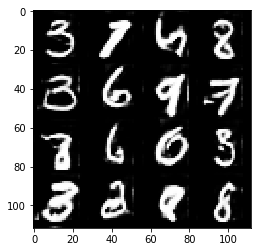

Timestamp 20170806-14-13-24.085 -  Epoch 2/2 -  Step 11610 -  D Loss: 0.7639 - G Loss: 1.7032
Timestamp 20170806-14-13-35.884 -  Epoch 2/2 -  Step 11620 -  D Loss: 0.9625 - G Loss: 1.1566
Timestamp 20170806-14-13-47.691 -  Epoch 2/2 -  Step 11630 -  D Loss: 1.0207 - G Loss: 1.8080
Timestamp 20170806-14-13-59.495 -  Epoch 2/2 -  Step 11640 -  D Loss: 0.7031 - G Loss: 2.0552
Timestamp 20170806-14-14-11.294 -  Epoch 2/2 -  Step 11650 -  D Loss: 1.1840 - G Loss: 0.9320
Timestamp 20170806-14-14-23.089 -  Epoch 2/2 -  Step 11660 -  D Loss: 1.4835 - G Loss: 0.5621
Timestamp 20170806-14-14-34.898 -  Epoch 2/2 -  Step 11670 -  D Loss: 1.0705 - G Loss: 1.4016
Timestamp 20170806-14-14-46.701 -  Epoch 2/2 -  Step 11680 -  D Loss: 0.9675 - G Loss: 2.0722
Timestamp 20170806-14-14-58.511 -  Epoch 2/2 -  Step 11690 -  D Loss: 1.2468 - G Loss: 0.5512
Timestamp 20170806-14-15-10.312 -  Epoch 2/2 -  Step 11700 -  D Loss: 1.1312 - G Loss: 1.8931


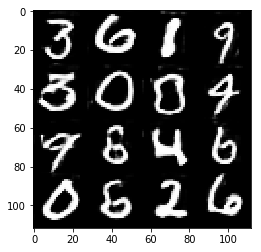

Timestamp 20170806-14-15-22.930 -  Epoch 2/2 -  Step 11710 -  D Loss: 1.0645 - G Loss: 1.0470
Timestamp 20170806-14-15-34.733 -  Epoch 2/2 -  Step 11720 -  D Loss: 1.0917 - G Loss: 1.0758
Timestamp 20170806-14-15-46.520 -  Epoch 2/2 -  Step 11730 -  D Loss: 0.9231 - G Loss: 1.1313
Timestamp 20170806-14-15-58.319 -  Epoch 2/2 -  Step 11740 -  D Loss: 0.8140 - G Loss: 0.7970
Timestamp 20170806-14-16-10.113 -  Epoch 2/2 -  Step 11750 -  D Loss: 0.7173 - G Loss: 1.4004
Timestamp 20170806-14-16-21.917 -  Epoch 2/2 -  Step 11760 -  D Loss: 0.6731 - G Loss: 1.2309
Timestamp 20170806-14-16-33.718 -  Epoch 2/2 -  Step 11770 -  D Loss: 0.9630 - G Loss: 1.1143
Timestamp 20170806-14-16-45.499 -  Epoch 2/2 -  Step 11780 -  D Loss: 0.9146 - G Loss: 0.6978
Timestamp 20170806-14-16-57.298 -  Epoch 2/2 -  Step 11790 -  D Loss: 0.8056 - G Loss: 1.0110
Timestamp 20170806-14-17-09.095 -  Epoch 2/2 -  Step 11800 -  D Loss: 0.6536 - G Loss: 2.2770


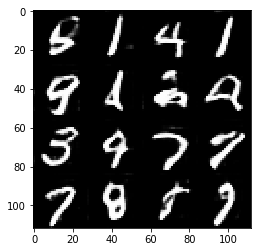

Timestamp 20170806-14-17-21.705 -  Epoch 2/2 -  Step 11810 -  D Loss: 1.4091 - G Loss: 2.2146
Timestamp 20170806-14-17-33.494 -  Epoch 2/2 -  Step 11820 -  D Loss: 1.1842 - G Loss: 0.9038
Timestamp 20170806-14-17-45.281 -  Epoch 2/2 -  Step 11830 -  D Loss: 0.8148 - G Loss: 2.2997
Timestamp 20170806-14-17-57.088 -  Epoch 2/2 -  Step 11840 -  D Loss: 1.2445 - G Loss: 1.1269
Timestamp 20170806-14-18-08.896 -  Epoch 2/2 -  Step 11850 -  D Loss: 1.5087 - G Loss: 0.5892
Timestamp 20170806-14-18-20.697 -  Epoch 2/2 -  Step 11860 -  D Loss: 1.0396 - G Loss: 1.2215
Timestamp 20170806-14-18-32.497 -  Epoch 2/2 -  Step 11870 -  D Loss: 0.7880 - G Loss: 0.8908
Timestamp 20170806-14-18-44.295 -  Epoch 2/2 -  Step 11880 -  D Loss: 1.1308 - G Loss: 1.3617
Timestamp 20170806-14-18-56.087 -  Epoch 2/2 -  Step 11890 -  D Loss: 1.3596 - G Loss: 0.9530
Timestamp 20170806-14-19-07.883 -  Epoch 2/2 -  Step 11900 -  D Loss: 1.0125 - G Loss: 1.1413


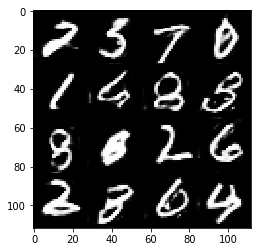

Timestamp 20170806-14-19-20.512 -  Epoch 2/2 -  Step 11910 -  D Loss: 1.3428 - G Loss: 0.8593
Timestamp 20170806-14-19-32.306 -  Epoch 2/2 -  Step 11920 -  D Loss: 1.2450 - G Loss: 1.8347
Timestamp 20170806-14-19-44.091 -  Epoch 2/2 -  Step 11930 -  D Loss: 1.2697 - G Loss: 1.9154
Timestamp 20170806-14-19-55.881 -  Epoch 2/2 -  Step 11940 -  D Loss: 0.9527 - G Loss: 1.3079
Timestamp 20170806-14-20-07.668 -  Epoch 2/2 -  Step 11950 -  D Loss: 1.1131 - G Loss: 0.5882
Timestamp 20170806-14-20-19.493 -  Epoch 2/2 -  Step 11960 -  D Loss: 1.2291 - G Loss: 0.7184
Timestamp 20170806-14-20-31.311 -  Epoch 2/2 -  Step 11970 -  D Loss: 0.8894 - G Loss: 1.0488
Timestamp 20170806-14-20-43.118 -  Epoch 2/2 -  Step 11980 -  D Loss: 0.8748 - G Loss: 1.4604
Timestamp 20170806-14-20-54.931 -  Epoch 2/2 -  Step 11990 -  D Loss: 0.6331 - G Loss: 2.9918
Timestamp 20170806-14-21-06.758 -  Epoch 2/2 -  Step 12000 -  D Loss: 0.5561 - G Loss: 1.7841


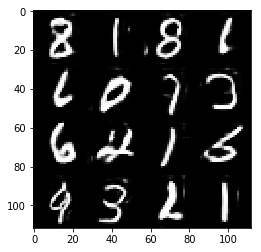

Timestamp 20170806-14-21-19.513 -  Epoch 2/2 -  Step 12010 -  D Loss: 0.5995 - G Loss: 1.5088
Timestamp 20170806-14-21-31.314 -  Epoch 2/2 -  Step 12020 -  D Loss: 0.6933 - G Loss: 2.1192
Timestamp 20170806-14-21-43.108 -  Epoch 2/2 -  Step 12030 -  D Loss: 1.1040 - G Loss: 1.1200
Timestamp 20170806-14-21-54.914 -  Epoch 2/2 -  Step 12040 -  D Loss: 1.2981 - G Loss: 0.7711
Timestamp 20170806-14-22-06.713 -  Epoch 2/2 -  Step 12050 -  D Loss: 0.8446 - G Loss: 1.4098
Timestamp 20170806-14-22-18.514 -  Epoch 2/2 -  Step 12060 -  D Loss: 1.3140 - G Loss: 0.4993
Timestamp 20170806-14-22-30.330 -  Epoch 2/2 -  Step 12070 -  D Loss: 1.1538 - G Loss: 0.9933
Timestamp 20170806-14-22-42.134 -  Epoch 2/2 -  Step 12080 -  D Loss: 0.7513 - G Loss: 2.4577
Timestamp 20170806-14-22-53.932 -  Epoch 2/2 -  Step 12090 -  D Loss: 1.3731 - G Loss: 1.3906
Timestamp 20170806-14-23-05.749 -  Epoch 2/2 -  Step 12100 -  D Loss: 1.2169 - G Loss: 0.7705


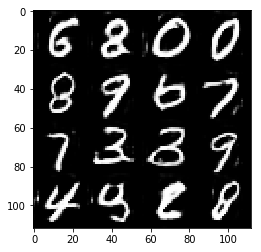

Timestamp 20170806-14-23-18.515 -  Epoch 2/2 -  Step 12110 -  D Loss: 1.0669 - G Loss: 0.6699
Timestamp 20170806-14-23-30.329 -  Epoch 2/2 -  Step 12120 -  D Loss: 0.9078 - G Loss: 0.8515
Timestamp 20170806-14-23-42.137 -  Epoch 2/2 -  Step 12130 -  D Loss: 0.8865 - G Loss: 0.9101
Timestamp 20170806-14-23-53.933 -  Epoch 2/2 -  Step 12140 -  D Loss: 1.0620 - G Loss: 0.9407
Timestamp 20170806-14-24-05.738 -  Epoch 2/2 -  Step 12150 -  D Loss: 0.8118 - G Loss: 1.7363
Timestamp 20170806-14-24-17.546 -  Epoch 2/2 -  Step 12160 -  D Loss: 1.1032 - G Loss: 1.7473
Timestamp 20170806-14-24-29.353 -  Epoch 2/2 -  Step 12170 -  D Loss: 1.4425 - G Loss: 0.9401
Timestamp 20170806-14-24-41.145 -  Epoch 2/2 -  Step 12180 -  D Loss: 1.1760 - G Loss: 1.5905
Timestamp 20170806-14-24-52.952 -  Epoch 2/2 -  Step 12190 -  D Loss: 1.1234 - G Loss: 2.0002
Timestamp 20170806-14-25-04.741 -  Epoch 2/2 -  Step 12200 -  D Loss: 0.7055 - G Loss: 1.7673


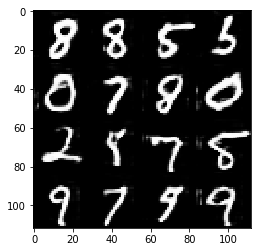

Timestamp 20170806-14-25-17.402 -  Epoch 2/2 -  Step 12210 -  D Loss: 0.9016 - G Loss: 0.7876
Timestamp 20170806-14-25-29.199 -  Epoch 2/2 -  Step 12220 -  D Loss: 0.9733 - G Loss: 2.1437
Timestamp 20170806-14-25-40.992 -  Epoch 2/2 -  Step 12230 -  D Loss: 0.9806 - G Loss: 1.8214
Timestamp 20170806-14-25-52.799 -  Epoch 2/2 -  Step 12240 -  D Loss: 0.9548 - G Loss: 1.5438
Timestamp 20170806-14-26-04.610 -  Epoch 2/2 -  Step 12250 -  D Loss: 1.1583 - G Loss: 1.1892
Timestamp 20170806-14-26-16.426 -  Epoch 2/2 -  Step 12260 -  D Loss: 1.3578 - G Loss: 1.2700
Timestamp 20170806-14-26-28.237 -  Epoch 2/2 -  Step 12270 -  D Loss: 1.0108 - G Loss: 1.4407
Timestamp 20170806-14-26-40.040 -  Epoch 2/2 -  Step 12280 -  D Loss: 0.8658 - G Loss: 1.5219
Timestamp 20170806-14-26-51.859 -  Epoch 2/2 -  Step 12290 -  D Loss: 0.9151 - G Loss: 1.5135
Timestamp 20170806-14-27-03.662 -  Epoch 2/2 -  Step 12300 -  D Loss: 0.7984 - G Loss: 2.0220


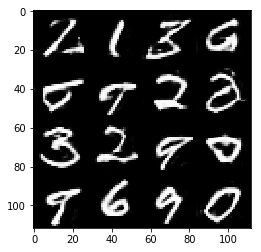

Timestamp 20170806-14-27-16.375 -  Epoch 2/2 -  Step 12310 -  D Loss: 0.9486 - G Loss: 1.0516
Timestamp 20170806-14-27-28.193 -  Epoch 2/2 -  Step 12320 -  D Loss: 1.0151 - G Loss: 2.5529
Timestamp 20170806-14-27-39.997 -  Epoch 2/2 -  Step 12330 -  D Loss: 0.7023 - G Loss: 0.9444
Timestamp 20170806-14-27-51.792 -  Epoch 2/2 -  Step 12340 -  D Loss: 0.8484 - G Loss: 1.1347
Timestamp 20170806-14-28-03.596 -  Epoch 2/2 -  Step 12350 -  D Loss: 0.9744 - G Loss: 1.1467
Timestamp 20170806-14-28-15.404 -  Epoch 2/2 -  Step 12360 -  D Loss: 0.7435 - G Loss: 1.6614
Timestamp 20170806-14-28-27.214 -  Epoch 2/2 -  Step 12370 -  D Loss: 1.3077 - G Loss: 2.0540
Timestamp 20170806-14-28-39.017 -  Epoch 2/2 -  Step 12380 -  D Loss: 1.1476 - G Loss: 1.0366
Timestamp 20170806-14-28-50.817 -  Epoch 2/2 -  Step 12390 -  D Loss: 1.0581 - G Loss: 1.2901
Timestamp 20170806-14-29-02.632 -  Epoch 2/2 -  Step 12400 -  D Loss: 0.9277 - G Loss: 1.0759


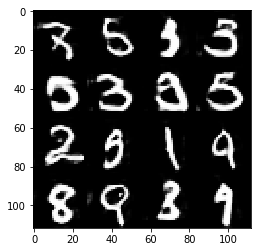

Timestamp 20170806-14-29-15.370 -  Epoch 2/2 -  Step 12410 -  D Loss: 0.4893 - G Loss: 2.5830
Timestamp 20170806-14-29-27.177 -  Epoch 2/2 -  Step 12420 -  D Loss: 1.1075 - G Loss: 0.9862
Timestamp 20170806-14-29-38.995 -  Epoch 2/2 -  Step 12430 -  D Loss: 0.7305 - G Loss: 1.6234
Timestamp 20170806-14-29-50.824 -  Epoch 2/2 -  Step 12440 -  D Loss: 1.0255 - G Loss: 1.3516
Timestamp 20170806-14-30-02.618 -  Epoch 2/2 -  Step 12450 -  D Loss: 1.3658 - G Loss: 0.6252
Timestamp 20170806-14-30-14.418 -  Epoch 2/2 -  Step 12460 -  D Loss: 1.1838 - G Loss: 1.3471
Timestamp 20170806-14-30-26.221 -  Epoch 2/2 -  Step 12470 -  D Loss: 0.9721 - G Loss: 0.4334
Timestamp 20170806-14-30-38.090 -  Epoch 2/2 -  Step 12480 -  D Loss: 1.0856 - G Loss: 1.4352
Timestamp 20170806-14-30-49.925 -  Epoch 2/2 -  Step 12490 -  D Loss: 0.9272 - G Loss: 1.4338
Timestamp 20170806-14-31-01.753 -  Epoch 2/2 -  Step 12500 -  D Loss: 1.1191 - G Loss: 1.4847


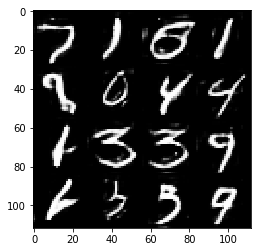

Timestamp 20170806-14-31-14.418 -  Epoch 2/2 -  Step 12510 -  D Loss: 1.0538 - G Loss: 1.5482
Timestamp 20170806-14-31-26.217 -  Epoch 2/2 -  Step 12520 -  D Loss: 0.8762 - G Loss: 1.1280
Timestamp 20170806-14-31-38.036 -  Epoch 2/2 -  Step 12530 -  D Loss: 0.8772 - G Loss: 1.2997
Timestamp 20170806-14-31-49.830 -  Epoch 2/2 -  Step 12540 -  D Loss: 1.0606 - G Loss: 0.9400
Timestamp 20170806-14-32-01.623 -  Epoch 2/2 -  Step 12550 -  D Loss: 0.7580 - G Loss: 1.4816
Timestamp 20170806-14-32-13.397 -  Epoch 2/2 -  Step 12560 -  D Loss: 1.2344 - G Loss: 0.8511
Timestamp 20170806-14-32-25.183 -  Epoch 2/2 -  Step 12570 -  D Loss: 1.3902 - G Loss: 0.8450
Timestamp 20170806-14-32-36.991 -  Epoch 2/2 -  Step 12580 -  D Loss: 1.0498 - G Loss: 1.4008
Timestamp 20170806-14-32-48.774 -  Epoch 2/2 -  Step 12590 -  D Loss: 0.8110 - G Loss: 1.9124
Timestamp 20170806-14-33-00.581 -  Epoch 2/2 -  Step 12600 -  D Loss: 0.9369 - G Loss: 1.0182


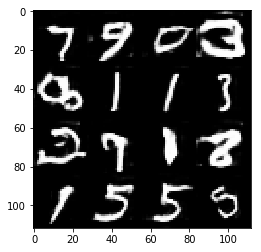

Timestamp 20170806-14-33-15.172 -  Epoch 2/2 -  Step 12610 -  D Loss: 1.2070 - G Loss: 1.0706
Timestamp 20170806-14-33-26.968 -  Epoch 2/2 -  Step 12620 -  D Loss: 1.0861 - G Loss: 1.2177
Timestamp 20170806-14-33-38.782 -  Epoch 2/2 -  Step 12630 -  D Loss: 1.1849 - G Loss: 0.6425
Timestamp 20170806-14-33-50.592 -  Epoch 2/2 -  Step 12640 -  D Loss: 0.6619 - G Loss: 1.2541
Timestamp 20170806-14-34-02.405 -  Epoch 2/2 -  Step 12650 -  D Loss: 1.3131 - G Loss: 1.6405
Timestamp 20170806-14-34-14.215 -  Epoch 2/2 -  Step 12660 -  D Loss: 1.0126 - G Loss: 2.0621
Timestamp 20170806-14-34-26.026 -  Epoch 2/2 -  Step 12670 -  D Loss: 0.9414 - G Loss: 1.3935
Timestamp 20170806-14-34-37.832 -  Epoch 2/2 -  Step 12680 -  D Loss: 1.4433 - G Loss: 0.6844
Timestamp 20170806-14-34-49.653 -  Epoch 2/2 -  Step 12690 -  D Loss: 0.7947 - G Loss: 1.5001
Timestamp 20170806-14-35-01.463 -  Epoch 2/2 -  Step 12700 -  D Loss: 1.3316 - G Loss: 1.5620


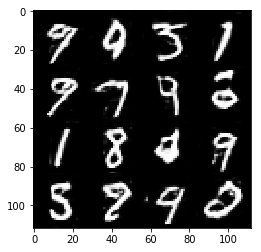

Timestamp 20170806-14-35-14.136 -  Epoch 2/2 -  Step 12710 -  D Loss: 1.3245 - G Loss: 1.5644
Timestamp 20170806-14-35-25.951 -  Epoch 2/2 -  Step 12720 -  D Loss: 0.9235 - G Loss: 1.6420
Timestamp 20170806-14-35-37.752 -  Epoch 2/2 -  Step 12730 -  D Loss: 0.7389 - G Loss: 1.4179
Timestamp 20170806-14-35-49.551 -  Epoch 2/2 -  Step 12740 -  D Loss: 0.6729 - G Loss: 1.3653
Timestamp 20170806-14-36-01.356 -  Epoch 2/2 -  Step 12750 -  D Loss: 1.0636 - G Loss: 1.5797
Timestamp 20170806-14-36-13.171 -  Epoch 2/2 -  Step 12760 -  D Loss: 0.6462 - G Loss: 1.4831
Timestamp 20170806-14-36-24.978 -  Epoch 2/2 -  Step 12770 -  D Loss: 1.0813 - G Loss: 1.8856
Timestamp 20170806-14-36-36.777 -  Epoch 2/2 -  Step 12780 -  D Loss: 1.8575 - G Loss: 1.1856
Timestamp 20170806-14-36-48.602 -  Epoch 2/2 -  Step 12790 -  D Loss: 0.8799 - G Loss: 1.0391
Timestamp 20170806-14-37-00.399 -  Epoch 2/2 -  Step 12800 -  D Loss: 1.2220 - G Loss: 1.5764


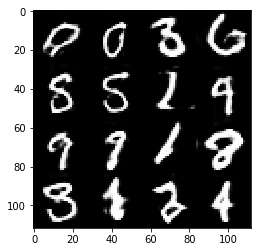

Timestamp 20170806-14-37-13.079 -  Epoch 2/2 -  Step 12810 -  D Loss: 1.0588 - G Loss: 1.1331
Timestamp 20170806-14-37-24.885 -  Epoch 2/2 -  Step 12820 -  D Loss: 0.8971 - G Loss: 1.8949
Timestamp 20170806-14-37-36.680 -  Epoch 2/2 -  Step 12830 -  D Loss: 0.7184 - G Loss: 2.4049
Timestamp 20170806-14-37-48.478 -  Epoch 2/2 -  Step 12840 -  D Loss: 0.8094 - G Loss: 1.6924
Timestamp 20170806-14-38-00.278 -  Epoch 2/2 -  Step 12850 -  D Loss: 1.9516 - G Loss: 1.3412
Timestamp 20170806-14-38-12.089 -  Epoch 2/2 -  Step 12860 -  D Loss: 0.8299 - G Loss: 1.0947
Timestamp 20170806-14-38-23.883 -  Epoch 2/2 -  Step 12870 -  D Loss: 0.8091 - G Loss: 2.0350
Timestamp 20170806-14-38-35.693 -  Epoch 2/2 -  Step 12880 -  D Loss: 1.7129 - G Loss: 0.9316
Timestamp 20170806-14-38-47.502 -  Epoch 2/2 -  Step 12890 -  D Loss: 1.3060 - G Loss: 1.3672
Timestamp 20170806-14-38-59.289 -  Epoch 2/2 -  Step 12900 -  D Loss: 0.9271 - G Loss: 1.7340


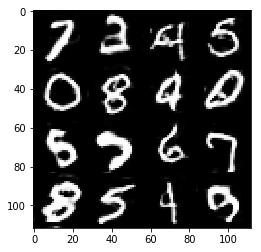

Timestamp 20170806-14-39-11.973 -  Epoch 2/2 -  Step 12910 -  D Loss: 0.7182 - G Loss: 1.6034
Timestamp 20170806-14-39-23.782 -  Epoch 2/2 -  Step 12920 -  D Loss: 1.1208 - G Loss: 1.5169
Timestamp 20170806-14-39-35.606 -  Epoch 2/2 -  Step 12930 -  D Loss: 1.0955 - G Loss: 1.0173
Timestamp 20170806-14-39-47.415 -  Epoch 2/2 -  Step 12940 -  D Loss: 1.0632 - G Loss: 0.9856
Timestamp 20170806-14-39-59.205 -  Epoch 2/2 -  Step 12950 -  D Loss: 1.0742 - G Loss: 1.7293
Timestamp 20170806-14-40-11.014 -  Epoch 2/2 -  Step 12960 -  D Loss: 1.1848 - G Loss: 1.6269
Timestamp 20170806-14-40-22.834 -  Epoch 2/2 -  Step 12970 -  D Loss: 1.0979 - G Loss: 1.2363
Timestamp 20170806-14-40-34.644 -  Epoch 2/2 -  Step 12980 -  D Loss: 1.0616 - G Loss: 1.1843
Timestamp 20170806-14-40-46.455 -  Epoch 2/2 -  Step 12990 -  D Loss: 1.0207 - G Loss: 0.9802
Timestamp 20170806-14-40-58.274 -  Epoch 2/2 -  Step 13000 -  D Loss: 1.2015 - G Loss: 0.7656


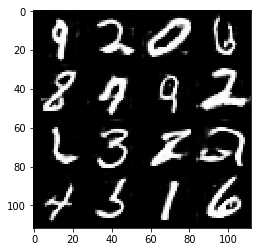

Timestamp 20170806-14-41-10.944 -  Epoch 2/2 -  Step 13010 -  D Loss: 0.8698 - G Loss: 1.4486
Timestamp 20170806-14-41-22.746 -  Epoch 2/2 -  Step 13020 -  D Loss: 1.3593 - G Loss: 1.4668
Timestamp 20170806-14-41-34.561 -  Epoch 2/2 -  Step 13030 -  D Loss: 1.0413 - G Loss: 1.5212
Timestamp 20170806-14-41-46.362 -  Epoch 2/2 -  Step 13040 -  D Loss: 0.6179 - G Loss: 1.9530
Timestamp 20170806-14-41-58.167 -  Epoch 2/2 -  Step 13050 -  D Loss: 0.4846 - G Loss: 2.5326
Timestamp 20170806-14-42-09.975 -  Epoch 2/2 -  Step 13060 -  D Loss: 0.8150 - G Loss: 1.6440
Timestamp 20170806-14-42-21.778 -  Epoch 2/2 -  Step 13070 -  D Loss: 1.1728 - G Loss: 1.2489
Timestamp 20170806-14-42-33.576 -  Epoch 2/2 -  Step 13080 -  D Loss: 1.1228 - G Loss: 2.0261
Timestamp 20170806-14-42-45.381 -  Epoch 2/2 -  Step 13090 -  D Loss: 1.2925 - G Loss: 0.6493
Timestamp 20170806-14-42-57.174 -  Epoch 2/2 -  Step 13100 -  D Loss: 1.2897 - G Loss: 0.6653


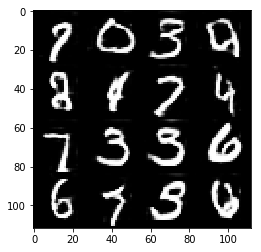

Timestamp 20170806-14-43-09.857 -  Epoch 2/2 -  Step 13110 -  D Loss: 1.2251 - G Loss: 0.5945
Timestamp 20170806-14-43-21.680 -  Epoch 2/2 -  Step 13120 -  D Loss: 1.0928 - G Loss: 1.8293
Timestamp 20170806-14-43-33.487 -  Epoch 2/2 -  Step 13130 -  D Loss: 1.1969 - G Loss: 0.7845
Timestamp 20170806-14-43-45.282 -  Epoch 2/2 -  Step 13140 -  D Loss: 0.5752 - G Loss: 0.9906
Timestamp 20170806-14-43-57.088 -  Epoch 2/2 -  Step 13150 -  D Loss: 1.0574 - G Loss: 2.3319
Timestamp 20170806-14-44-08.886 -  Epoch 2/2 -  Step 13160 -  D Loss: 0.9933 - G Loss: 1.7178
Timestamp 20170806-14-44-20.681 -  Epoch 2/2 -  Step 13170 -  D Loss: 1.0529 - G Loss: 1.6748
Timestamp 20170806-14-44-32.474 -  Epoch 2/2 -  Step 13180 -  D Loss: 1.1794 - G Loss: 1.6660
Timestamp 20170806-14-44-44.294 -  Epoch 2/2 -  Step 13190 -  D Loss: 1.4789 - G Loss: 0.9947
Timestamp 20170806-14-44-56.106 -  Epoch 2/2 -  Step 13200 -  D Loss: 0.8975 - G Loss: 0.8908


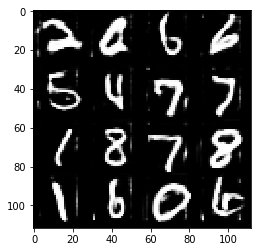

Timestamp 20170806-14-45-08.777 -  Epoch 2/2 -  Step 13210 -  D Loss: 0.7972 - G Loss: 1.4157
Timestamp 20170806-14-45-20.573 -  Epoch 2/2 -  Step 13220 -  D Loss: 0.9452 - G Loss: 0.8708
Timestamp 20170806-14-45-32.379 -  Epoch 2/2 -  Step 13230 -  D Loss: 0.6690 - G Loss: 2.4158
Timestamp 20170806-14-45-44.191 -  Epoch 2/2 -  Step 13240 -  D Loss: 1.0416 - G Loss: 1.3432
Timestamp 20170806-14-45-55.980 -  Epoch 2/2 -  Step 13250 -  D Loss: 1.6353 - G Loss: 1.6017
Timestamp 20170806-14-46-07.794 -  Epoch 2/2 -  Step 13260 -  D Loss: 1.1568 - G Loss: 0.7065
Timestamp 20170806-14-46-19.592 -  Epoch 2/2 -  Step 13270 -  D Loss: 0.7142 - G Loss: 1.6551
Timestamp 20170806-14-46-31.388 -  Epoch 2/2 -  Step 13280 -  D Loss: 1.1360 - G Loss: 1.7604
Timestamp 20170806-14-46-43.188 -  Epoch 2/2 -  Step 13290 -  D Loss: 1.2297 - G Loss: 1.0720
Timestamp 20170806-14-46-54.999 -  Epoch 2/2 -  Step 13300 -  D Loss: 1.0744 - G Loss: 1.8874


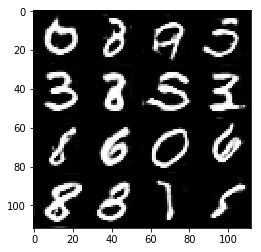

Timestamp 20170806-14-47-07.662 -  Epoch 2/2 -  Step 13310 -  D Loss: 1.1170 - G Loss: 1.2374
Timestamp 20170806-14-47-19.465 -  Epoch 2/2 -  Step 13320 -  D Loss: 0.8130 - G Loss: 1.4473
Timestamp 20170806-14-47-31.261 -  Epoch 2/2 -  Step 13330 -  D Loss: 1.0749 - G Loss: 1.2755
Timestamp 20170806-14-47-43.078 -  Epoch 2/2 -  Step 13340 -  D Loss: 1.1215 - G Loss: 2.5952
Timestamp 20170806-14-47-54.874 -  Epoch 2/2 -  Step 13350 -  D Loss: 0.8596 - G Loss: 1.8357
Timestamp 20170806-14-48-06.670 -  Epoch 2/2 -  Step 13360 -  D Loss: 0.9192 - G Loss: 1.6046
Timestamp 20170806-14-48-18.464 -  Epoch 2/2 -  Step 13370 -  D Loss: 1.0244 - G Loss: 1.9076
Timestamp 20170806-14-48-30.254 -  Epoch 2/2 -  Step 13380 -  D Loss: 1.1424 - G Loss: 0.8223
Timestamp 20170806-14-48-42.070 -  Epoch 2/2 -  Step 13390 -  D Loss: 0.7619 - G Loss: 0.9459
Timestamp 20170806-14-48-53.879 -  Epoch 2/2 -  Step 13400 -  D Loss: 1.0159 - G Loss: 1.1986


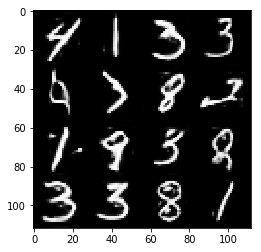

Timestamp 20170806-14-49-06.530 -  Epoch 2/2 -  Step 13410 -  D Loss: 0.9980 - G Loss: 0.9764
Timestamp 20170806-14-49-18.357 -  Epoch 2/2 -  Step 13420 -  D Loss: 1.0413 - G Loss: 1.6510
Timestamp 20170806-14-49-30.154 -  Epoch 2/2 -  Step 13430 -  D Loss: 0.8089 - G Loss: 1.4696
Timestamp 20170806-14-49-41.969 -  Epoch 2/2 -  Step 13440 -  D Loss: 0.8345 - G Loss: 1.0225
Timestamp 20170806-14-49-53.753 -  Epoch 2/2 -  Step 13450 -  D Loss: 0.7782 - G Loss: 1.0367
Timestamp 20170806-14-50-05.565 -  Epoch 2/2 -  Step 13460 -  D Loss: 1.1657 - G Loss: 0.8904
Timestamp 20170806-14-50-17.366 -  Epoch 2/2 -  Step 13470 -  D Loss: 1.3119 - G Loss: 0.9579
Timestamp 20170806-14-50-29.173 -  Epoch 2/2 -  Step 13480 -  D Loss: 0.8838 - G Loss: 0.8802
Timestamp 20170806-14-50-40.965 -  Epoch 2/2 -  Step 13490 -  D Loss: 0.7313 - G Loss: 1.2222
Timestamp 20170806-14-50-52.763 -  Epoch 2/2 -  Step 13500 -  D Loss: 0.9625 - G Loss: 1.5967


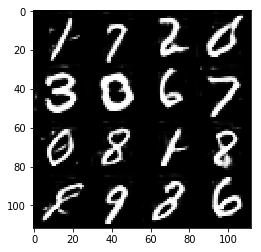

Timestamp 20170806-14-51-05.453 -  Epoch 2/2 -  Step 13510 -  D Loss: 0.5102 - G Loss: 2.4131
Timestamp 20170806-14-51-17.252 -  Epoch 2/2 -  Step 13520 -  D Loss: 1.4038 - G Loss: 1.4481
Timestamp 20170806-14-51-29.047 -  Epoch 2/2 -  Step 13530 -  D Loss: 1.1737 - G Loss: 1.1451
Timestamp 20170806-14-51-40.828 -  Epoch 2/2 -  Step 13540 -  D Loss: 1.0104 - G Loss: 1.5085
Timestamp 20170806-14-51-52.606 -  Epoch 2/2 -  Step 13550 -  D Loss: 1.0806 - G Loss: 0.7108
Timestamp 20170806-14-52-04.418 -  Epoch 2/2 -  Step 13560 -  D Loss: 0.8664 - G Loss: 1.1020
Timestamp 20170806-14-52-16.234 -  Epoch 2/2 -  Step 13570 -  D Loss: 1.0435 - G Loss: 1.0597
Timestamp 20170806-14-52-28.024 -  Epoch 2/2 -  Step 13580 -  D Loss: 1.2629 - G Loss: 2.2813
Timestamp 20170806-14-52-39.813 -  Epoch 2/2 -  Step 13590 -  D Loss: 1.0599 - G Loss: 2.8717
Timestamp 20170806-14-52-51.618 -  Epoch 2/2 -  Step 13600 -  D Loss: 0.9601 - G Loss: 1.5352


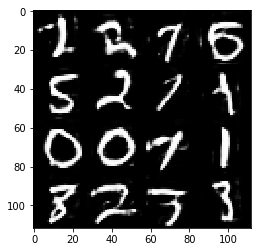

Timestamp 20170806-14-53-04.281 -  Epoch 2/2 -  Step 13610 -  D Loss: 0.7840 - G Loss: 1.4142
Timestamp 20170806-14-53-16.073 -  Epoch 2/2 -  Step 13620 -  D Loss: 0.7331 - G Loss: 1.2863
Timestamp 20170806-14-53-27.870 -  Epoch 2/2 -  Step 13630 -  D Loss: 0.8207 - G Loss: 1.7275
Timestamp 20170806-14-53-39.689 -  Epoch 2/2 -  Step 13640 -  D Loss: 0.9851 - G Loss: 1.3557
Timestamp 20170806-14-53-51.486 -  Epoch 2/2 -  Step 13650 -  D Loss: 1.0679 - G Loss: 1.0781
Timestamp 20170806-14-54-03.298 -  Epoch 2/2 -  Step 13660 -  D Loss: 0.8570 - G Loss: 1.3384
Timestamp 20170806-14-54-15.103 -  Epoch 2/2 -  Step 13670 -  D Loss: 0.7025 - G Loss: 2.0484
Timestamp 20170806-14-54-26.928 -  Epoch 2/2 -  Step 13680 -  D Loss: 0.8713 - G Loss: 1.2989
Timestamp 20170806-14-54-38.740 -  Epoch 2/2 -  Step 13690 -  D Loss: 0.9476 - G Loss: 1.1500
Timestamp 20170806-14-54-50.557 -  Epoch 2/2 -  Step 13700 -  D Loss: 1.0782 - G Loss: 1.2880


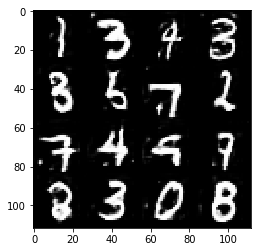

Timestamp 20170806-14-55-03.267 -  Epoch 2/2 -  Step 13710 -  D Loss: 0.7871 - G Loss: 2.0111
Timestamp 20170806-14-55-15.058 -  Epoch 2/2 -  Step 13720 -  D Loss: 1.2928 - G Loss: 1.0308
Timestamp 20170806-14-55-26.860 -  Epoch 2/2 -  Step 13730 -  D Loss: 0.9490 - G Loss: 0.7934
Timestamp 20170806-14-55-38.686 -  Epoch 2/2 -  Step 13740 -  D Loss: 1.1263 - G Loss: 1.6573
Timestamp 20170806-14-55-50.499 -  Epoch 2/2 -  Step 13750 -  D Loss: 0.9658 - G Loss: 1.8664
Timestamp 20170806-14-56-02.299 -  Epoch 2/2 -  Step 13760 -  D Loss: 0.9340 - G Loss: 0.9806
Timestamp 20170806-14-56-14.111 -  Epoch 2/2 -  Step 13770 -  D Loss: 1.0456 - G Loss: 1.3045
Timestamp 20170806-14-56-25.923 -  Epoch 2/2 -  Step 13780 -  D Loss: 1.0308 - G Loss: 1.0730
Timestamp 20170806-14-56-37.731 -  Epoch 2/2 -  Step 13790 -  D Loss: 1.0873 - G Loss: 1.0896
Timestamp 20170806-14-56-49.524 -  Epoch 2/2 -  Step 13800 -  D Loss: 1.1625 - G Loss: 1.4370


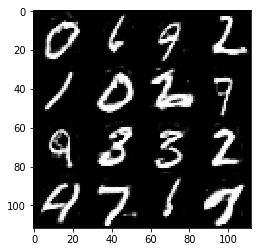

Timestamp 20170806-14-57-02.194 -  Epoch 2/2 -  Step 13810 -  D Loss: 1.1345 - G Loss: 1.5049
Timestamp 20170806-14-57-14.007 -  Epoch 2/2 -  Step 13820 -  D Loss: 0.9126 - G Loss: 1.4807
Timestamp 20170806-14-57-25.822 -  Epoch 2/2 -  Step 13830 -  D Loss: 0.8896 - G Loss: 0.6764
Timestamp 20170806-14-57-37.628 -  Epoch 2/2 -  Step 13840 -  D Loss: 1.0316 - G Loss: 2.0127
Timestamp 20170806-14-57-49.443 -  Epoch 2/2 -  Step 13850 -  D Loss: 0.9204 - G Loss: 2.4231
Timestamp 20170806-14-58-01.247 -  Epoch 2/2 -  Step 13860 -  D Loss: 0.9439 - G Loss: 1.2202
Timestamp 20170806-14-58-13.046 -  Epoch 2/2 -  Step 13870 -  D Loss: 1.0516 - G Loss: 1.2928
Timestamp 20170806-14-58-24.844 -  Epoch 2/2 -  Step 13880 -  D Loss: 1.0953 - G Loss: 1.4297
Timestamp 20170806-14-58-36.636 -  Epoch 2/2 -  Step 13890 -  D Loss: 1.2516 - G Loss: 1.8071
Timestamp 20170806-14-58-48.442 -  Epoch 2/2 -  Step 13900 -  D Loss: 1.0227 - G Loss: 1.7866


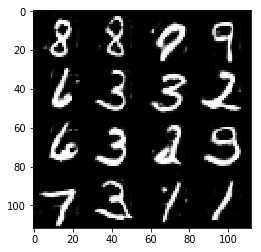

Timestamp 20170806-14-59-01.121 -  Epoch 2/2 -  Step 13910 -  D Loss: 0.7937 - G Loss: 2.2487
Timestamp 20170806-14-59-12.898 -  Epoch 2/2 -  Step 13920 -  D Loss: 1.0789 - G Loss: 1.4981
Timestamp 20170806-14-59-24.719 -  Epoch 2/2 -  Step 13930 -  D Loss: 1.0308 - G Loss: 1.3489
Timestamp 20170806-14-59-36.532 -  Epoch 2/2 -  Step 13940 -  D Loss: 1.0007 - G Loss: 0.9568
Timestamp 20170806-14-59-48.339 -  Epoch 2/2 -  Step 13950 -  D Loss: 0.6514 - G Loss: 1.0688
Timestamp 20170806-15-00-00.117 -  Epoch 2/2 -  Step 13960 -  D Loss: 0.7268 - G Loss: 1.7544
Timestamp 20170806-15-00-11.914 -  Epoch 2/2 -  Step 13970 -  D Loss: 1.1423 - G Loss: 0.6967
Timestamp 20170806-15-00-23.718 -  Epoch 2/2 -  Step 13980 -  D Loss: 1.0744 - G Loss: 0.9714
Timestamp 20170806-15-00-35.519 -  Epoch 2/2 -  Step 13990 -  D Loss: 1.1178 - G Loss: 1.5859
Timestamp 20170806-15-00-47.334 -  Epoch 2/2 -  Step 14000 -  D Loss: 1.3666 - G Loss: 1.2837


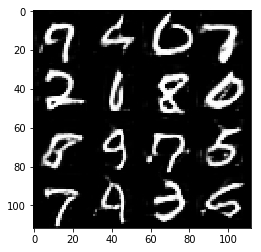

Timestamp 20170806-15-01-00.020 -  Epoch 2/2 -  Step 14010 -  D Loss: 1.0177 - G Loss: 1.2482
Timestamp 20170806-15-01-11.815 -  Epoch 2/2 -  Step 14020 -  D Loss: 1.0882 - G Loss: 1.4292
Timestamp 20170806-15-01-23.629 -  Epoch 2/2 -  Step 14030 -  D Loss: 1.3022 - G Loss: 1.5682
Timestamp 20170806-15-01-35.417 -  Epoch 2/2 -  Step 14040 -  D Loss: 0.6147 - G Loss: 2.1590
Timestamp 20170806-15-01-47.204 -  Epoch 2/2 -  Step 14050 -  D Loss: 1.1626 - G Loss: 1.7956
Timestamp 20170806-15-01-59.019 -  Epoch 2/2 -  Step 14060 -  D Loss: 0.8454 - G Loss: 1.8772
Timestamp 20170806-15-02-10.837 -  Epoch 2/2 -  Step 14070 -  D Loss: 0.5602 - G Loss: 1.2678
Timestamp 20170806-15-02-22.638 -  Epoch 2/2 -  Step 14080 -  D Loss: 0.7701 - G Loss: 2.1156
Timestamp 20170806-15-02-34.436 -  Epoch 2/2 -  Step 14090 -  D Loss: 1.4350 - G Loss: 1.6816
Timestamp 20170806-15-02-46.230 -  Epoch 2/2 -  Step 14100 -  D Loss: 0.6749 - G Loss: 3.0159


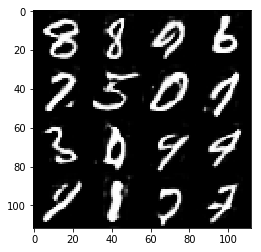

Timestamp 20170806-15-02-58.903 -  Epoch 2/2 -  Step 14110 -  D Loss: 1.1211 - G Loss: 2.9201
Timestamp 20170806-15-03-10.716 -  Epoch 2/2 -  Step 14120 -  D Loss: 0.7912 - G Loss: 1.0453
Timestamp 20170806-15-03-22.512 -  Epoch 2/2 -  Step 14130 -  D Loss: 1.2750 - G Loss: 1.1140
Timestamp 20170806-15-03-34.319 -  Epoch 2/2 -  Step 14140 -  D Loss: 1.4580 - G Loss: 0.9783
Timestamp 20170806-15-03-46.106 -  Epoch 2/2 -  Step 14150 -  D Loss: 1.2225 - G Loss: 1.3624
Timestamp 20170806-15-03-57.915 -  Epoch 2/2 -  Step 14160 -  D Loss: 0.6507 - G Loss: 2.1346
Timestamp 20170806-15-04-09.707 -  Epoch 2/2 -  Step 14170 -  D Loss: 0.9658 - G Loss: 1.4403
Timestamp 20170806-15-04-21.511 -  Epoch 2/2 -  Step 14180 -  D Loss: 1.2150 - G Loss: 1.0956
Timestamp 20170806-15-04-33.332 -  Epoch 2/2 -  Step 14190 -  D Loss: 0.6015 - G Loss: 2.5777
Timestamp 20170806-15-04-45.128 -  Epoch 2/2 -  Step 14200 -  D Loss: 1.1930 - G Loss: 0.9169


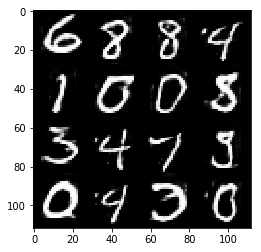

Timestamp 20170806-15-04-57.813 -  Epoch 2/2 -  Step 14210 -  D Loss: 1.2760 - G Loss: 0.5879
Timestamp 20170806-15-05-09.614 -  Epoch 2/2 -  Step 14220 -  D Loss: 0.7354 - G Loss: 1.5098
Timestamp 20170806-15-05-21.423 -  Epoch 2/2 -  Step 14230 -  D Loss: 0.8579 - G Loss: 0.9818
Timestamp 20170806-15-05-33.215 -  Epoch 2/2 -  Step 14240 -  D Loss: 0.8900 - G Loss: 0.8304
Timestamp 20170806-15-05-45.029 -  Epoch 2/2 -  Step 14250 -  D Loss: 1.1609 - G Loss: 1.0754
Timestamp 20170806-15-05-56.837 -  Epoch 2/2 -  Step 14260 -  D Loss: 1.1855 - G Loss: 1.6478
Timestamp 20170806-15-06-08.625 -  Epoch 2/2 -  Step 14270 -  D Loss: 0.8952 - G Loss: 1.4126
Timestamp 20170806-15-06-20.433 -  Epoch 2/2 -  Step 14280 -  D Loss: 1.0541 - G Loss: 1.4068
Timestamp 20170806-15-06-32.224 -  Epoch 2/2 -  Step 14290 -  D Loss: 1.0807 - G Loss: 1.7095
Timestamp 20170806-15-06-44.015 -  Epoch 2/2 -  Step 14300 -  D Loss: 1.2325 - G Loss: 0.8889


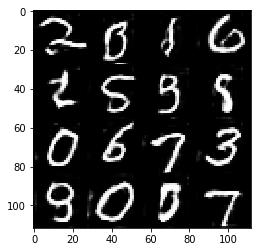

Timestamp 20170806-15-06-56.714 -  Epoch 2/2 -  Step 14310 -  D Loss: 0.8676 - G Loss: 1.1202
Timestamp 20170806-15-07-08.520 -  Epoch 2/2 -  Step 14320 -  D Loss: 1.2340 - G Loss: 1.9995
Timestamp 20170806-15-07-20.335 -  Epoch 2/2 -  Step 14330 -  D Loss: 1.0166 - G Loss: 1.6968
Timestamp 20170806-15-07-32.154 -  Epoch 2/2 -  Step 14340 -  D Loss: 1.3485 - G Loss: 1.2331
Timestamp 20170806-15-07-43.951 -  Epoch 2/2 -  Step 14350 -  D Loss: 0.7427 - G Loss: 1.3326
Timestamp 20170806-15-07-55.746 -  Epoch 2/2 -  Step 14360 -  D Loss: 1.1605 - G Loss: 0.6097
Timestamp 20170806-15-08-07.560 -  Epoch 2/2 -  Step 14370 -  D Loss: 0.8128 - G Loss: 1.5172
Timestamp 20170806-15-08-19.350 -  Epoch 2/2 -  Step 14380 -  D Loss: 0.7267 - G Loss: 2.0685
Timestamp 20170806-15-08-31.151 -  Epoch 2/2 -  Step 14390 -  D Loss: 0.9938 - G Loss: 1.4657
Timestamp 20170806-15-08-42.950 -  Epoch 2/2 -  Step 14400 -  D Loss: 0.6362 - G Loss: 3.1825


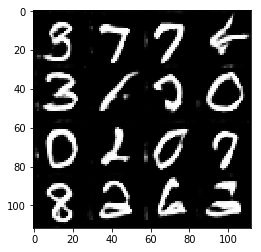

Timestamp 20170806-15-08-55.647 -  Epoch 2/2 -  Step 14410 -  D Loss: 1.0216 - G Loss: 0.7067
Timestamp 20170806-15-09-07.447 -  Epoch 2/2 -  Step 14420 -  D Loss: 1.0501 - G Loss: 1.9092
Timestamp 20170806-15-09-19.256 -  Epoch 2/2 -  Step 14430 -  D Loss: 0.8115 - G Loss: 1.9665
Timestamp 20170806-15-09-31.057 -  Epoch 2/2 -  Step 14440 -  D Loss: 0.7468 - G Loss: 1.6409
Timestamp 20170806-15-09-42.859 -  Epoch 2/2 -  Step 14450 -  D Loss: 1.8557 - G Loss: 0.9018
Timestamp 20170806-15-09-54.674 -  Epoch 2/2 -  Step 14460 -  D Loss: 1.0958 - G Loss: 1.2138
Timestamp 20170806-15-10-06.468 -  Epoch 2/2 -  Step 14470 -  D Loss: 0.5385 - G Loss: 1.5296
Timestamp 20170806-15-10-18.257 -  Epoch 2/2 -  Step 14480 -  D Loss: 0.9320 - G Loss: 1.7632
Timestamp 20170806-15-10-30.075 -  Epoch 2/2 -  Step 14490 -  D Loss: 0.9621 - G Loss: 1.3048
Timestamp 20170806-15-10-41.880 -  Epoch 2/2 -  Step 14500 -  D Loss: 0.8169 - G Loss: 1.5042


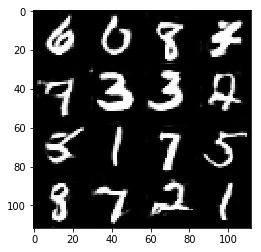

Timestamp 20170806-15-10-54.538 -  Epoch 2/2 -  Step 14510 -  D Loss: 0.7699 - G Loss: 1.2851
Timestamp 20170806-15-11-06.350 -  Epoch 2/2 -  Step 14520 -  D Loss: 1.1008 - G Loss: 1.5319
Timestamp 20170806-15-11-18.144 -  Epoch 2/2 -  Step 14530 -  D Loss: 1.0334 - G Loss: 1.0497
Timestamp 20170806-15-11-29.957 -  Epoch 2/2 -  Step 14540 -  D Loss: 0.9534 - G Loss: 1.1351
Timestamp 20170806-15-11-41.769 -  Epoch 2/2 -  Step 14550 -  D Loss: 1.5438 - G Loss: 1.1401
Timestamp 20170806-15-11-53.560 -  Epoch 2/2 -  Step 14560 -  D Loss: 1.0573 - G Loss: 1.4242
Timestamp 20170806-15-12-05.358 -  Epoch 2/2 -  Step 14570 -  D Loss: 1.3340 - G Loss: 0.8875
Timestamp 20170806-15-12-17.132 -  Epoch 2/2 -  Step 14580 -  D Loss: 1.0491 - G Loss: 1.1352
Timestamp 20170806-15-12-28.922 -  Epoch 2/2 -  Step 14590 -  D Loss: 1.0635 - G Loss: 1.8022
Timestamp 20170806-15-12-40.717 -  Epoch 2/2 -  Step 14600 -  D Loss: 1.0964 - G Loss: 1.6755


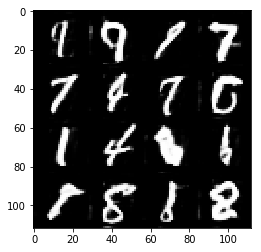

Timestamp 20170806-15-12-53.434 -  Epoch 2/2 -  Step 14610 -  D Loss: 0.9982 - G Loss: 1.1141
Timestamp 20170806-15-13-05.234 -  Epoch 2/2 -  Step 14620 -  D Loss: 0.6580 - G Loss: 1.5928
Timestamp 20170806-15-13-17.040 -  Epoch 2/2 -  Step 14630 -  D Loss: 0.7602 - G Loss: 1.2553
Timestamp 20170806-15-13-28.829 -  Epoch 2/2 -  Step 14640 -  D Loss: 2.4581 - G Loss: 0.5528
Timestamp 20170806-15-13-40.645 -  Epoch 2/2 -  Step 14650 -  D Loss: 1.4037 - G Loss: 1.1403
Timestamp 20170806-15-13-52.437 -  Epoch 2/2 -  Step 14660 -  D Loss: 1.3357 - G Loss: 0.8466
Timestamp 20170806-15-14-04.241 -  Epoch 2/2 -  Step 14670 -  D Loss: 1.0220 - G Loss: 1.3666
Timestamp 20170806-15-14-16.036 -  Epoch 2/2 -  Step 14680 -  D Loss: 1.3128 - G Loss: 1.0127
Timestamp 20170806-15-14-27.818 -  Epoch 2/2 -  Step 14690 -  D Loss: 1.2290 - G Loss: 0.8663
Timestamp 20170806-15-14-39.641 -  Epoch 2/2 -  Step 14700 -  D Loss: 1.0087 - G Loss: 1.2652


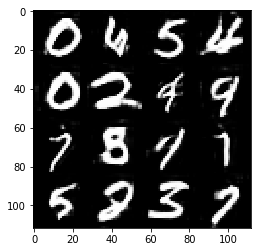

Timestamp 20170806-15-14-52.346 -  Epoch 2/2 -  Step 14710 -  D Loss: 1.1277 - G Loss: 0.8308
Timestamp 20170806-15-15-04.149 -  Epoch 2/2 -  Step 14720 -  D Loss: 0.9545 - G Loss: 1.8614
Timestamp 20170806-15-15-15.944 -  Epoch 2/2 -  Step 14730 -  D Loss: 1.1810 - G Loss: 1.1329
Timestamp 20170806-15-15-27.746 -  Epoch 2/2 -  Step 14740 -  D Loss: 1.3186 - G Loss: 1.1823
Timestamp 20170806-15-15-39.546 -  Epoch 2/2 -  Step 14750 -  D Loss: 0.9423 - G Loss: 1.2981
Timestamp 20170806-15-15-51.343 -  Epoch 2/2 -  Step 14760 -  D Loss: 0.8544 - G Loss: 2.1129
Timestamp 20170806-15-16-03.143 -  Epoch 2/2 -  Step 14770 -  D Loss: 1.1587 - G Loss: 1.4688
Timestamp 20170806-15-16-14.937 -  Epoch 2/2 -  Step 14780 -  D Loss: 1.0097 - G Loss: 2.2859
Timestamp 20170806-15-16-26.748 -  Epoch 2/2 -  Step 14790 -  D Loss: 1.1735 - G Loss: 1.5163
Timestamp 20170806-15-16-38.540 -  Epoch 2/2 -  Step 14800 -  D Loss: 1.4634 - G Loss: 0.7817


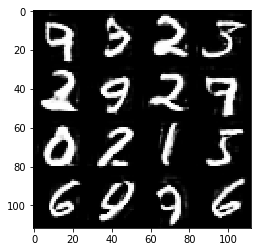

Timestamp 20170806-15-16-51.296 -  Epoch 2/2 -  Step 14810 -  D Loss: 0.8696 - G Loss: 0.9385
Timestamp 20170806-15-17-03.092 -  Epoch 2/2 -  Step 14820 -  D Loss: 1.0535 - G Loss: 0.8200
Timestamp 20170806-15-17-14.900 -  Epoch 2/2 -  Step 14830 -  D Loss: 0.9006 - G Loss: 1.3659
Timestamp 20170806-15-17-26.703 -  Epoch 2/2 -  Step 14840 -  D Loss: 0.9750 - G Loss: 1.2406
Timestamp 20170806-15-17-38.516 -  Epoch 2/2 -  Step 14850 -  D Loss: 1.1487 - G Loss: 1.3540
Timestamp 20170806-15-17-50.320 -  Epoch 2/2 -  Step 14860 -  D Loss: 0.9012 - G Loss: 1.8252
Timestamp 20170806-15-18-02.115 -  Epoch 2/2 -  Step 14870 -  D Loss: 0.9967 - G Loss: 1.6151
Timestamp 20170806-15-18-13.920 -  Epoch 2/2 -  Step 14880 -  D Loss: 1.6189 - G Loss: 1.0996
Timestamp 20170806-15-18-25.720 -  Epoch 2/2 -  Step 14890 -  D Loss: 0.8382 - G Loss: 1.5502
Timestamp 20170806-15-18-37.514 -  Epoch 2/2 -  Step 14900 -  D Loss: 0.9939 - G Loss: 0.9805


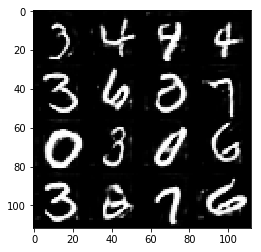

Timestamp 20170806-15-18-50.231 -  Epoch 2/2 -  Step 14910 -  D Loss: 1.2939 - G Loss: 1.9703
Timestamp 20170806-15-19-02.029 -  Epoch 2/2 -  Step 14920 -  D Loss: 1.3316 - G Loss: 1.2100
Timestamp 20170806-15-19-13.826 -  Epoch 2/2 -  Step 14930 -  D Loss: 0.7987 - G Loss: 1.0814
Timestamp 20170806-15-19-25.630 -  Epoch 2/2 -  Step 14940 -  D Loss: 1.3273 - G Loss: 1.4005
Timestamp 20170806-15-19-37.440 -  Epoch 2/2 -  Step 14950 -  D Loss: 1.2756 - G Loss: 0.9350
Timestamp 20170806-15-19-49.233 -  Epoch 2/2 -  Step 14960 -  D Loss: 1.0759 - G Loss: 0.7345
Timestamp 20170806-15-20-01.029 -  Epoch 2/2 -  Step 14970 -  D Loss: 1.0645 - G Loss: 1.4925
Timestamp 20170806-15-20-12.829 -  Epoch 2/2 -  Step 14980 -  D Loss: 1.1858 - G Loss: 1.5691
Timestamp 20170806-15-20-24.623 -  Epoch 2/2 -  Step 14990 -  D Loss: 1.3912 - G Loss: 0.5746
Timestamp 20170806-15-20-36.442 -  Epoch 2/2 -  Step 15000 -  D Loss: 1.0678 - G Loss: 1.6342


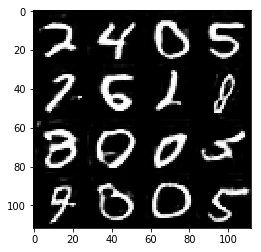

In [17]:
batch_size = 8
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

Timestamp 20170806-15-21-01.873 -  Epoch 1/2 -  Step 10 -  D Loss: 1.3090 - G Loss: 1.2414
Timestamp 20170806-15-21-18.283 -  Epoch 1/2 -  Step 20 -  D Loss: 1.8177 - G Loss: 0.6976
Timestamp 20170806-15-21-34.688 -  Epoch 1/2 -  Step 30 -  D Loss: 1.0075 - G Loss: 2.4195
Timestamp 20170806-15-21-51.089 -  Epoch 1/2 -  Step 40 -  D Loss: 1.1479 - G Loss: 1.4919
Timestamp 20170806-15-22-07.495 -  Epoch 1/2 -  Step 50 -  D Loss: 1.5415 - G Loss: 1.7543
Timestamp 20170806-15-22-23.928 -  Epoch 1/2 -  Step 60 -  D Loss: 0.6932 - G Loss: 3.5427
Timestamp 20170806-15-22-40.344 -  Epoch 1/2 -  Step 70 -  D Loss: 4.7297 - G Loss: 0.0600
Timestamp 20170806-15-22-56.738 -  Epoch 1/2 -  Step 80 -  D Loss: 1.7995 - G Loss: 1.6519
Timestamp 20170806-15-23-13.154 -  Epoch 1/2 -  Step 90 -  D Loss: 1.1145 - G Loss: 1.1342
Timestamp 20170806-15-23-29.551 -  Epoch 1/2 -  Step 100 -  D Loss: 0.8019 - G Loss: 2.1190


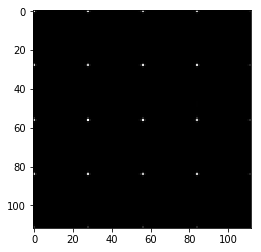

Timestamp 20170806-15-23-46.605 -  Epoch 1/2 -  Step 110 -  D Loss: 0.6483 - G Loss: 2.4192
Timestamp 20170806-15-24-03.000 -  Epoch 1/2 -  Step 120 -  D Loss: 1.4651 - G Loss: 1.0364
Timestamp 20170806-15-24-19.402 -  Epoch 1/2 -  Step 130 -  D Loss: 2.6827 - G Loss: 0.6201
Timestamp 20170806-15-24-35.827 -  Epoch 1/2 -  Step 140 -  D Loss: 2.3734 - G Loss: 1.1966
Timestamp 20170806-15-24-52.252 -  Epoch 1/2 -  Step 150 -  D Loss: 1.5409 - G Loss: 0.8949
Timestamp 20170806-15-25-08.671 -  Epoch 1/2 -  Step 160 -  D Loss: 2.5368 - G Loss: 0.7717
Timestamp 20170806-15-25-25.064 -  Epoch 1/2 -  Step 170 -  D Loss: 1.3127 - G Loss: 1.6137
Timestamp 20170806-15-25-41.471 -  Epoch 1/2 -  Step 180 -  D Loss: 1.5718 - G Loss: 1.0754
Timestamp 20170806-15-25-57.876 -  Epoch 1/2 -  Step 190 -  D Loss: 1.0825 - G Loss: 1.5391
Timestamp 20170806-15-26-14.296 -  Epoch 1/2 -  Step 200 -  D Loss: 1.3343 - G Loss: 1.3543


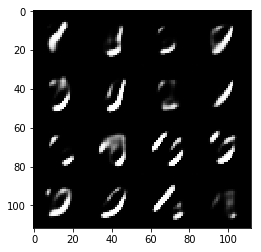

Timestamp 20170806-15-26-31.325 -  Epoch 1/2 -  Step 210 -  D Loss: 1.3657 - G Loss: 0.7775
Timestamp 20170806-15-26-47.750 -  Epoch 1/2 -  Step 220 -  D Loss: 1.7249 - G Loss: 0.8611
Timestamp 20170806-15-27-04.166 -  Epoch 1/2 -  Step 230 -  D Loss: 1.1352 - G Loss: 0.9989
Timestamp 20170806-15-27-20.573 -  Epoch 1/2 -  Step 240 -  D Loss: 1.6716 - G Loss: 1.3388
Timestamp 20170806-15-27-36.987 -  Epoch 1/2 -  Step 250 -  D Loss: 1.3549 - G Loss: 1.4990
Timestamp 20170806-15-27-53.398 -  Epoch 1/2 -  Step 260 -  D Loss: 1.5496 - G Loss: 0.7973
Timestamp 20170806-15-28-09.811 -  Epoch 1/2 -  Step 270 -  D Loss: 1.1064 - G Loss: 1.3357
Timestamp 20170806-15-28-26.217 -  Epoch 1/2 -  Step 280 -  D Loss: 1.1953 - G Loss: 0.8360
Timestamp 20170806-15-28-42.626 -  Epoch 1/2 -  Step 290 -  D Loss: 1.3890 - G Loss: 1.4177
Timestamp 20170806-15-28-59.030 -  Epoch 1/2 -  Step 300 -  D Loss: 1.2836 - G Loss: 1.3552


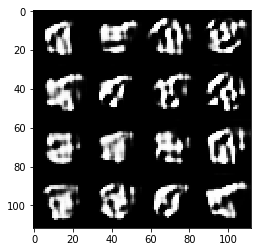

Timestamp 20170806-15-29-16.042 -  Epoch 1/2 -  Step 310 -  D Loss: 1.4008 - G Loss: 0.9672
Timestamp 20170806-15-29-32.449 -  Epoch 1/2 -  Step 320 -  D Loss: 0.8635 - G Loss: 1.6770
Timestamp 20170806-15-29-48.850 -  Epoch 1/2 -  Step 330 -  D Loss: 1.1921 - G Loss: 0.6360
Timestamp 20170806-15-30-05.231 -  Epoch 1/2 -  Step 340 -  D Loss: 0.9981 - G Loss: 1.5382
Timestamp 20170806-15-30-21.638 -  Epoch 1/2 -  Step 350 -  D Loss: 0.9204 - G Loss: 1.9675
Timestamp 20170806-15-30-38.031 -  Epoch 1/2 -  Step 360 -  D Loss: 1.4871 - G Loss: 1.3710
Timestamp 20170806-15-30-54.427 -  Epoch 1/2 -  Step 370 -  D Loss: 1.3198 - G Loss: 1.1309
Timestamp 20170806-15-31-10.828 -  Epoch 1/2 -  Step 380 -  D Loss: 0.8663 - G Loss: 1.5058
Timestamp 20170806-15-31-27.236 -  Epoch 1/2 -  Step 390 -  D Loss: 1.0862 - G Loss: 1.0735
Timestamp 20170806-15-31-43.657 -  Epoch 1/2 -  Step 400 -  D Loss: 1.5263 - G Loss: 2.6214


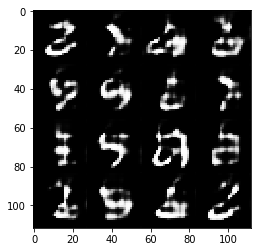

Timestamp 20170806-15-32-00.708 -  Epoch 1/2 -  Step 410 -  D Loss: 1.1131 - G Loss: 1.4967
Timestamp 20170806-15-32-17.110 -  Epoch 1/2 -  Step 420 -  D Loss: 1.9779 - G Loss: 0.7845
Timestamp 20170806-15-32-33.502 -  Epoch 1/2 -  Step 430 -  D Loss: 1.2244 - G Loss: 1.1163
Timestamp 20170806-15-32-49.900 -  Epoch 1/2 -  Step 440 -  D Loss: 1.2794 - G Loss: 1.4648
Timestamp 20170806-15-33-06.297 -  Epoch 1/2 -  Step 450 -  D Loss: 1.2701 - G Loss: 1.5669
Timestamp 20170806-15-33-22.713 -  Epoch 1/2 -  Step 460 -  D Loss: 1.3930 - G Loss: 0.6677
Timestamp 20170806-15-33-39.139 -  Epoch 1/2 -  Step 470 -  D Loss: 1.5468 - G Loss: 0.9789
Timestamp 20170806-15-33-55.561 -  Epoch 1/2 -  Step 480 -  D Loss: 1.5572 - G Loss: 0.9284
Timestamp 20170806-15-34-11.970 -  Epoch 1/2 -  Step 490 -  D Loss: 1.8506 - G Loss: 0.8442
Timestamp 20170806-15-34-28.382 -  Epoch 1/2 -  Step 500 -  D Loss: 1.4722 - G Loss: 1.0432


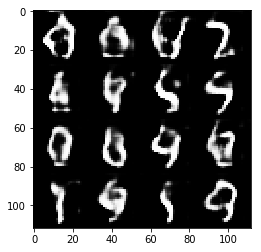

Timestamp 20170806-15-34-45.396 -  Epoch 1/2 -  Step 510 -  D Loss: 1.4360 - G Loss: 1.0467
Timestamp 20170806-15-35-01.798 -  Epoch 1/2 -  Step 520 -  D Loss: 1.0270 - G Loss: 1.3307
Timestamp 20170806-15-35-18.198 -  Epoch 1/2 -  Step 530 -  D Loss: 1.2593 - G Loss: 0.8764
Timestamp 20170806-15-35-34.590 -  Epoch 1/2 -  Step 540 -  D Loss: 1.3193 - G Loss: 1.2131
Timestamp 20170806-15-35-51.001 -  Epoch 1/2 -  Step 550 -  D Loss: 1.2009 - G Loss: 1.4451
Timestamp 20170806-15-36-07.397 -  Epoch 1/2 -  Step 560 -  D Loss: 1.3367 - G Loss: 0.9253
Timestamp 20170806-15-36-23.793 -  Epoch 1/2 -  Step 570 -  D Loss: 1.2794 - G Loss: 0.8036
Timestamp 20170806-15-36-40.182 -  Epoch 1/2 -  Step 580 -  D Loss: 0.9230 - G Loss: 1.5935
Timestamp 20170806-15-36-56.584 -  Epoch 1/2 -  Step 590 -  D Loss: 1.1712 - G Loss: 0.9888
Timestamp 20170806-15-37-12.977 -  Epoch 1/2 -  Step 600 -  D Loss: 1.0694 - G Loss: 0.8044


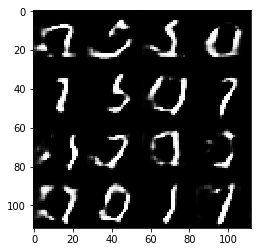

Timestamp 20170806-15-37-30.019 -  Epoch 1/2 -  Step 610 -  D Loss: 1.2986 - G Loss: 0.9396
Timestamp 20170806-15-37-46.431 -  Epoch 1/2 -  Step 620 -  D Loss: 0.9911 - G Loss: 1.2826
Timestamp 20170806-15-38-02.841 -  Epoch 1/2 -  Step 630 -  D Loss: 1.4266 - G Loss: 1.1482
Timestamp 20170806-15-38-19.234 -  Epoch 1/2 -  Step 640 -  D Loss: 1.1925 - G Loss: 0.6706
Timestamp 20170806-15-38-35.638 -  Epoch 1/2 -  Step 650 -  D Loss: 1.4823 - G Loss: 0.7950
Timestamp 20170806-15-38-52.042 -  Epoch 1/2 -  Step 660 -  D Loss: 1.1958 - G Loss: 1.0781
Timestamp 20170806-15-39-08.446 -  Epoch 1/2 -  Step 670 -  D Loss: 1.3415 - G Loss: 1.3041
Timestamp 20170806-15-39-24.850 -  Epoch 1/2 -  Step 680 -  D Loss: 1.3191 - G Loss: 1.0950
Timestamp 20170806-15-39-41.252 -  Epoch 1/2 -  Step 690 -  D Loss: 1.2116 - G Loss: 0.7195
Timestamp 20170806-15-39-57.658 -  Epoch 1/2 -  Step 700 -  D Loss: 1.2733 - G Loss: 1.1298


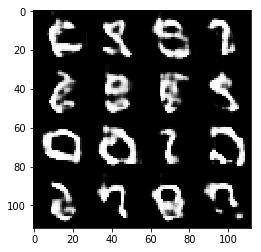

Timestamp 20170806-15-40-14.697 -  Epoch 1/2 -  Step 710 -  D Loss: 1.2906 - G Loss: 1.0336
Timestamp 20170806-15-40-31.104 -  Epoch 1/2 -  Step 720 -  D Loss: 1.0976 - G Loss: 0.8089
Timestamp 20170806-15-40-47.492 -  Epoch 1/2 -  Step 730 -  D Loss: 1.0531 - G Loss: 1.5428
Timestamp 20170806-15-41-03.899 -  Epoch 1/2 -  Step 740 -  D Loss: 1.3514 - G Loss: 0.7370
Timestamp 20170806-15-41-20.305 -  Epoch 1/2 -  Step 750 -  D Loss: 1.2040 - G Loss: 1.0151
Timestamp 20170806-15-41-36.691 -  Epoch 1/2 -  Step 760 -  D Loss: 1.2122 - G Loss: 1.1574
Timestamp 20170806-15-41-53.088 -  Epoch 1/2 -  Step 770 -  D Loss: 1.1407 - G Loss: 0.9774
Timestamp 20170806-15-42-09.484 -  Epoch 1/2 -  Step 780 -  D Loss: 1.1493 - G Loss: 1.1302
Timestamp 20170806-15-42-25.885 -  Epoch 1/2 -  Step 790 -  D Loss: 1.3655 - G Loss: 1.1568
Timestamp 20170806-15-42-42.294 -  Epoch 1/2 -  Step 800 -  D Loss: 1.4253 - G Loss: 1.2278


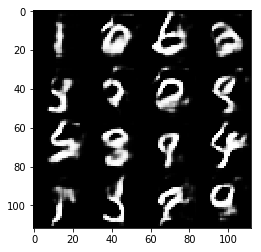

Timestamp 20170806-15-42-59.323 -  Epoch 1/2 -  Step 810 -  D Loss: 1.2934 - G Loss: 0.8237
Timestamp 20170806-15-43-15.729 -  Epoch 1/2 -  Step 820 -  D Loss: 1.2058 - G Loss: 0.9148
Timestamp 20170806-15-43-32.134 -  Epoch 1/2 -  Step 830 -  D Loss: 1.1873 - G Loss: 0.9021
Timestamp 20170806-15-43-48.542 -  Epoch 1/2 -  Step 840 -  D Loss: 1.1328 - G Loss: 1.1841
Timestamp 20170806-15-44-04.958 -  Epoch 1/2 -  Step 850 -  D Loss: 1.3153 - G Loss: 0.8495
Timestamp 20170806-15-44-21.367 -  Epoch 1/2 -  Step 860 -  D Loss: 1.1005 - G Loss: 1.1188
Timestamp 20170806-15-44-37.787 -  Epoch 1/2 -  Step 870 -  D Loss: 1.3392 - G Loss: 0.8239
Timestamp 20170806-15-44-54.174 -  Epoch 1/2 -  Step 880 -  D Loss: 1.3106 - G Loss: 1.1375
Timestamp 20170806-15-45-10.566 -  Epoch 1/2 -  Step 890 -  D Loss: 1.2776 - G Loss: 0.9591
Timestamp 20170806-15-45-26.952 -  Epoch 1/2 -  Step 900 -  D Loss: 1.2946 - G Loss: 1.0403


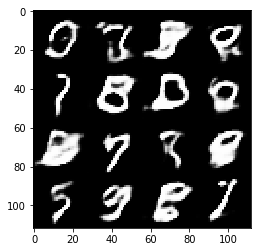

Timestamp 20170806-15-45-44.001 -  Epoch 1/2 -  Step 910 -  D Loss: 1.1015 - G Loss: 1.0806
Timestamp 20170806-15-46-00.401 -  Epoch 1/2 -  Step 920 -  D Loss: 1.1700 - G Loss: 0.9113
Timestamp 20170806-15-46-16.789 -  Epoch 1/2 -  Step 930 -  D Loss: 1.1949 - G Loss: 1.3002
Timestamp 20170806-15-46-33.195 -  Epoch 1/2 -  Step 940 -  D Loss: 1.0775 - G Loss: 0.9031
Timestamp 20170806-15-46-49.595 -  Epoch 1/2 -  Step 950 -  D Loss: 1.0384 - G Loss: 1.2036
Timestamp 20170806-15-47-05.987 -  Epoch 1/2 -  Step 960 -  D Loss: 1.2180 - G Loss: 1.0454
Timestamp 20170806-15-47-22.388 -  Epoch 1/2 -  Step 970 -  D Loss: 1.3301 - G Loss: 1.4003
Timestamp 20170806-15-47-38.782 -  Epoch 1/2 -  Step 980 -  D Loss: 1.2804 - G Loss: 1.0666
Timestamp 20170806-15-47-55.208 -  Epoch 1/2 -  Step 990 -  D Loss: 1.2386 - G Loss: 1.0048
Timestamp 20170806-15-48-11.623 -  Epoch 1/2 -  Step 1000 -  D Loss: 1.2002 - G Loss: 0.9387


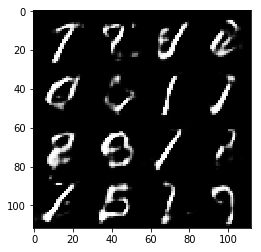

Timestamp 20170806-15-48-28.684 -  Epoch 1/2 -  Step 1010 -  D Loss: 1.0950 - G Loss: 1.5953
Timestamp 20170806-15-48-45.082 -  Epoch 1/2 -  Step 1020 -  D Loss: 1.1739 - G Loss: 1.1965
Timestamp 20170806-15-49-01.485 -  Epoch 1/2 -  Step 1030 -  D Loss: 1.1985 - G Loss: 0.9801
Timestamp 20170806-15-49-17.898 -  Epoch 1/2 -  Step 1040 -  D Loss: 1.1651 - G Loss: 0.9181
Timestamp 20170806-15-49-34.309 -  Epoch 1/2 -  Step 1050 -  D Loss: 1.2757 - G Loss: 1.2755
Timestamp 20170806-15-49-50.712 -  Epoch 1/2 -  Step 1060 -  D Loss: 1.0906 - G Loss: 1.0320
Timestamp 20170806-15-50-07.118 -  Epoch 1/2 -  Step 1070 -  D Loss: 1.0963 - G Loss: 1.0857
Timestamp 20170806-15-50-23.523 -  Epoch 1/2 -  Step 1080 -  D Loss: 1.5114 - G Loss: 0.8236
Timestamp 20170806-15-50-39.918 -  Epoch 1/2 -  Step 1090 -  D Loss: 1.0357 - G Loss: 1.0809
Timestamp 20170806-15-50-56.315 -  Epoch 1/2 -  Step 1100 -  D Loss: 1.2670 - G Loss: 0.8980


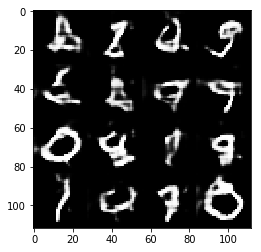

Timestamp 20170806-15-51-13.364 -  Epoch 1/2 -  Step 1110 -  D Loss: 1.1575 - G Loss: 0.8344
Timestamp 20170806-15-51-29.775 -  Epoch 1/2 -  Step 1120 -  D Loss: 1.4226 - G Loss: 1.0877
Timestamp 20170806-15-51-46.176 -  Epoch 1/2 -  Step 1130 -  D Loss: 1.2640 - G Loss: 0.9862
Timestamp 20170806-15-52-02.553 -  Epoch 1/2 -  Step 1140 -  D Loss: 1.2783 - G Loss: 0.9017
Timestamp 20170806-15-52-18.967 -  Epoch 1/2 -  Step 1150 -  D Loss: 1.3156 - G Loss: 0.8603
Timestamp 20170806-15-52-35.364 -  Epoch 1/2 -  Step 1160 -  D Loss: 1.4645 - G Loss: 0.8553
Timestamp 20170806-15-52-51.774 -  Epoch 1/2 -  Step 1170 -  D Loss: 1.0536 - G Loss: 1.3667
Timestamp 20170806-15-53-08.175 -  Epoch 1/2 -  Step 1180 -  D Loss: 0.9843 - G Loss: 1.5357
Timestamp 20170806-15-53-24.580 -  Epoch 1/2 -  Step 1190 -  D Loss: 1.2514 - G Loss: 0.8487
Timestamp 20170806-15-53-40.978 -  Epoch 1/2 -  Step 1200 -  D Loss: 1.3933 - G Loss: 0.8616


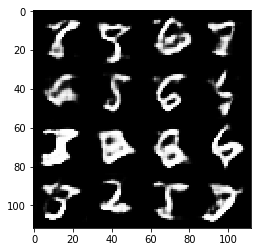

Timestamp 20170806-15-53-58.034 -  Epoch 1/2 -  Step 1210 -  D Loss: 1.0769 - G Loss: 0.7936
Timestamp 20170806-15-54-14.427 -  Epoch 1/2 -  Step 1220 -  D Loss: 1.5703 - G Loss: 0.7759
Timestamp 20170806-15-54-30.816 -  Epoch 1/2 -  Step 1230 -  D Loss: 1.1492 - G Loss: 0.9022
Timestamp 20170806-15-54-47.214 -  Epoch 1/2 -  Step 1240 -  D Loss: 1.1812 - G Loss: 0.6650
Timestamp 20170806-15-55-03.611 -  Epoch 1/2 -  Step 1250 -  D Loss: 1.2994 - G Loss: 1.0794
Timestamp 20170806-15-55-19.997 -  Epoch 1/2 -  Step 1260 -  D Loss: 1.3649 - G Loss: 0.9841
Timestamp 20170806-15-55-36.407 -  Epoch 1/2 -  Step 1270 -  D Loss: 1.2532 - G Loss: 0.9724
Timestamp 20170806-15-55-52.796 -  Epoch 1/2 -  Step 1280 -  D Loss: 1.2413 - G Loss: 0.9641
Timestamp 20170806-15-56-09.176 -  Epoch 1/2 -  Step 1290 -  D Loss: 1.1848 - G Loss: 1.0660
Timestamp 20170806-15-56-25.557 -  Epoch 1/2 -  Step 1300 -  D Loss: 1.2022 - G Loss: 0.9105


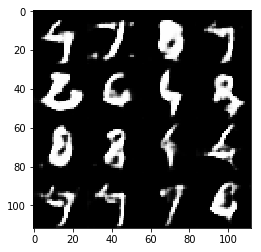

Timestamp 20170806-15-56-42.606 -  Epoch 1/2 -  Step 1310 -  D Loss: 1.3644 - G Loss: 0.7378
Timestamp 20170806-15-56-58.996 -  Epoch 1/2 -  Step 1320 -  D Loss: 1.3884 - G Loss: 1.1022
Timestamp 20170806-15-57-15.392 -  Epoch 1/2 -  Step 1330 -  D Loss: 1.0611 - G Loss: 0.9605
Timestamp 20170806-15-57-31.791 -  Epoch 1/2 -  Step 1340 -  D Loss: 1.4717 - G Loss: 1.0082
Timestamp 20170806-15-57-48.183 -  Epoch 1/2 -  Step 1350 -  D Loss: 1.3350 - G Loss: 0.7799
Timestamp 20170806-15-58-04.589 -  Epoch 1/2 -  Step 1360 -  D Loss: 1.3792 - G Loss: 1.2625
Timestamp 20170806-15-58-20.972 -  Epoch 1/2 -  Step 1370 -  D Loss: 1.5359 - G Loss: 0.8735
Timestamp 20170806-15-58-37.361 -  Epoch 1/2 -  Step 1380 -  D Loss: 1.2144 - G Loss: 0.8052
Timestamp 20170806-15-58-53.760 -  Epoch 1/2 -  Step 1390 -  D Loss: 1.4079 - G Loss: 0.8920
Timestamp 20170806-15-59-10.167 -  Epoch 1/2 -  Step 1400 -  D Loss: 1.4540 - G Loss: 0.9547


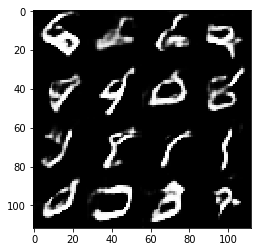

Timestamp 20170806-15-59-27.238 -  Epoch 1/2 -  Step 1410 -  D Loss: 1.0529 - G Loss: 1.3958
Timestamp 20170806-15-59-43.636 -  Epoch 1/2 -  Step 1420 -  D Loss: 1.5480 - G Loss: 0.7763
Timestamp 20170806-16-00-00.040 -  Epoch 1/2 -  Step 1430 -  D Loss: 1.2752 - G Loss: 0.9396
Timestamp 20170806-16-00-16.422 -  Epoch 1/2 -  Step 1440 -  D Loss: 1.3565 - G Loss: 1.0371
Timestamp 20170806-16-00-32.804 -  Epoch 1/2 -  Step 1450 -  D Loss: 1.2907 - G Loss: 0.8015
Timestamp 20170806-16-00-49.215 -  Epoch 1/2 -  Step 1460 -  D Loss: 1.2432 - G Loss: 0.7881
Timestamp 20170806-16-01-05.616 -  Epoch 1/2 -  Step 1470 -  D Loss: 1.0856 - G Loss: 1.4266
Timestamp 20170806-16-01-22.037 -  Epoch 1/2 -  Step 1480 -  D Loss: 1.4100 - G Loss: 0.7060
Timestamp 20170806-16-01-38.428 -  Epoch 1/2 -  Step 1490 -  D Loss: 1.4641 - G Loss: 0.8952
Timestamp 20170806-16-01-54.809 -  Epoch 1/2 -  Step 1500 -  D Loss: 1.2175 - G Loss: 0.7607


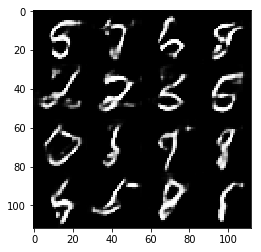

Timestamp 20170806-16-02-11.875 -  Epoch 1/2 -  Step 1510 -  D Loss: 1.3001 - G Loss: 0.8465
Timestamp 20170806-16-02-28.281 -  Epoch 1/2 -  Step 1520 -  D Loss: 1.3740 - G Loss: 1.1508
Timestamp 20170806-16-02-44.682 -  Epoch 1/2 -  Step 1530 -  D Loss: 1.0267 - G Loss: 1.3120
Timestamp 20170806-16-03-01.076 -  Epoch 1/2 -  Step 1540 -  D Loss: 1.3355 - G Loss: 0.9397
Timestamp 20170806-16-03-17.480 -  Epoch 1/2 -  Step 1550 -  D Loss: 1.1998 - G Loss: 1.0632
Timestamp 20170806-16-03-33.877 -  Epoch 1/2 -  Step 1560 -  D Loss: 1.3058 - G Loss: 0.6957
Timestamp 20170806-16-03-50.271 -  Epoch 1/2 -  Step 1570 -  D Loss: 1.1073 - G Loss: 1.2168
Timestamp 20170806-16-04-06.674 -  Epoch 1/2 -  Step 1580 -  D Loss: 1.0922 - G Loss: 1.2806
Timestamp 20170806-16-04-23.073 -  Epoch 1/2 -  Step 1590 -  D Loss: 1.2415 - G Loss: 0.7373
Timestamp 20170806-16-04-39.480 -  Epoch 1/2 -  Step 1600 -  D Loss: 1.3243 - G Loss: 0.8893


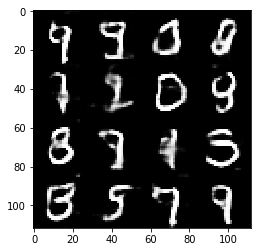

Timestamp 20170806-16-04-56.540 -  Epoch 1/2 -  Step 1610 -  D Loss: 0.9854 - G Loss: 0.8457
Timestamp 20170806-16-05-12.948 -  Epoch 1/2 -  Step 1620 -  D Loss: 1.2292 - G Loss: 0.7487
Timestamp 20170806-16-05-29.347 -  Epoch 1/2 -  Step 1630 -  D Loss: 1.0519 - G Loss: 1.0946
Timestamp 20170806-16-05-45.761 -  Epoch 1/2 -  Step 1640 -  D Loss: 1.1760 - G Loss: 0.9993
Timestamp 20170806-16-06-02.161 -  Epoch 1/2 -  Step 1650 -  D Loss: 1.2037 - G Loss: 0.8627
Timestamp 20170806-16-06-18.551 -  Epoch 1/2 -  Step 1660 -  D Loss: 1.2293 - G Loss: 0.8885
Timestamp 20170806-16-06-34.949 -  Epoch 1/2 -  Step 1670 -  D Loss: 1.0989 - G Loss: 1.1207
Timestamp 20170806-16-06-51.337 -  Epoch 1/2 -  Step 1680 -  D Loss: 1.2531 - G Loss: 1.0269
Timestamp 20170806-16-07-07.735 -  Epoch 1/2 -  Step 1690 -  D Loss: 1.3579 - G Loss: 0.9727
Timestamp 20170806-16-07-24.139 -  Epoch 1/2 -  Step 1700 -  D Loss: 1.0996 - G Loss: 1.0870


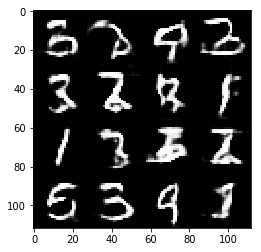

Timestamp 20170806-16-07-41.213 -  Epoch 1/2 -  Step 1710 -  D Loss: 1.3097 - G Loss: 0.5789
Timestamp 20170806-16-07-57.624 -  Epoch 1/2 -  Step 1720 -  D Loss: 1.3351 - G Loss: 0.7802
Timestamp 20170806-16-08-14.021 -  Epoch 1/2 -  Step 1730 -  D Loss: 1.2281 - G Loss: 0.9177
Timestamp 20170806-16-08-30.421 -  Epoch 1/2 -  Step 1740 -  D Loss: 1.1334 - G Loss: 1.0092
Timestamp 20170806-16-08-46.801 -  Epoch 1/2 -  Step 1750 -  D Loss: 1.2030 - G Loss: 1.2103
Timestamp 20170806-16-09-03.194 -  Epoch 1/2 -  Step 1760 -  D Loss: 1.4189 - G Loss: 0.6865
Timestamp 20170806-16-09-19.594 -  Epoch 1/2 -  Step 1770 -  D Loss: 1.0426 - G Loss: 1.1824
Timestamp 20170806-16-09-35.983 -  Epoch 1/2 -  Step 1780 -  D Loss: 1.1964 - G Loss: 0.7557
Timestamp 20170806-16-09-52.378 -  Epoch 1/2 -  Step 1790 -  D Loss: 1.0354 - G Loss: 1.4429
Timestamp 20170806-16-10-08.769 -  Epoch 1/2 -  Step 1800 -  D Loss: 1.2507 - G Loss: 1.2399


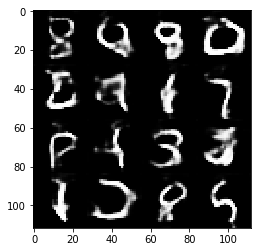

Timestamp 20170806-16-10-25.828 -  Epoch 1/2 -  Step 1810 -  D Loss: 1.0452 - G Loss: 0.7794
Timestamp 20170806-16-10-42.213 -  Epoch 1/2 -  Step 1820 -  D Loss: 1.1698 - G Loss: 1.2102
Timestamp 20170806-16-10-58.629 -  Epoch 1/2 -  Step 1830 -  D Loss: 1.1996 - G Loss: 0.8788
Timestamp 20170806-16-11-15.035 -  Epoch 1/2 -  Step 1840 -  D Loss: 1.4083 - G Loss: 0.9684
Timestamp 20170806-16-11-31.430 -  Epoch 1/2 -  Step 1850 -  D Loss: 1.2359 - G Loss: 0.7906
Timestamp 20170806-16-11-47.825 -  Epoch 1/2 -  Step 1860 -  D Loss: 1.1886 - G Loss: 1.0992
Timestamp 20170806-16-12-04.226 -  Epoch 1/2 -  Step 1870 -  D Loss: 1.1459 - G Loss: 1.2170
Timestamp 20170806-16-12-20.626 -  Epoch 1/2 -  Step 1880 -  D Loss: 1.2360 - G Loss: 0.9821
Timestamp 20170806-16-12-37.011 -  Epoch 1/2 -  Step 1890 -  D Loss: 1.2721 - G Loss: 1.0243
Timestamp 20170806-16-12-53.427 -  Epoch 1/2 -  Step 1900 -  D Loss: 1.0648 - G Loss: 0.9424


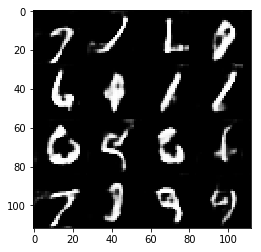

Timestamp 20170806-16-13-10.493 -  Epoch 1/2 -  Step 1910 -  D Loss: 1.3129 - G Loss: 1.0478
Timestamp 20170806-16-13-26.902 -  Epoch 1/2 -  Step 1920 -  D Loss: 1.2246 - G Loss: 0.8915
Timestamp 20170806-16-13-43.300 -  Epoch 1/2 -  Step 1930 -  D Loss: 1.2302 - G Loss: 1.1812
Timestamp 20170806-16-13-59.700 -  Epoch 1/2 -  Step 1940 -  D Loss: 1.3450 - G Loss: 0.8938
Timestamp 20170806-16-14-16.095 -  Epoch 1/2 -  Step 1950 -  D Loss: 1.4066 - G Loss: 0.9241
Timestamp 20170806-16-14-32.512 -  Epoch 1/2 -  Step 1960 -  D Loss: 1.0956 - G Loss: 1.4388
Timestamp 20170806-16-14-48.921 -  Epoch 1/2 -  Step 1970 -  D Loss: 1.2675 - G Loss: 1.1604
Timestamp 20170806-16-15-05.312 -  Epoch 1/2 -  Step 1980 -  D Loss: 1.3791 - G Loss: 0.8200
Timestamp 20170806-16-15-21.717 -  Epoch 1/2 -  Step 1990 -  D Loss: 1.1975 - G Loss: 0.9792
Timestamp 20170806-16-15-38.111 -  Epoch 1/2 -  Step 2000 -  D Loss: 1.1181 - G Loss: 1.3828


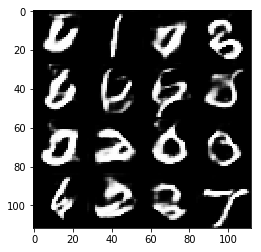

Timestamp 20170806-16-15-55.160 -  Epoch 1/2 -  Step 2010 -  D Loss: 1.0653 - G Loss: 1.1735
Timestamp 20170806-16-16-11.561 -  Epoch 1/2 -  Step 2020 -  D Loss: 1.2921 - G Loss: 0.6609
Timestamp 20170806-16-16-27.964 -  Epoch 1/2 -  Step 2030 -  D Loss: 0.9490 - G Loss: 1.6095
Timestamp 20170806-16-16-44.359 -  Epoch 1/2 -  Step 2040 -  D Loss: 1.0521 - G Loss: 1.1022
Timestamp 20170806-16-17-00.764 -  Epoch 1/2 -  Step 2050 -  D Loss: 1.4267 - G Loss: 0.8295
Timestamp 20170806-16-17-17.176 -  Epoch 1/2 -  Step 2060 -  D Loss: 1.3098 - G Loss: 0.9676
Timestamp 20170806-16-17-33.581 -  Epoch 1/2 -  Step 2070 -  D Loss: 1.2012 - G Loss: 0.9510
Timestamp 20170806-16-17-49.964 -  Epoch 1/2 -  Step 2080 -  D Loss: 1.7941 - G Loss: 0.9304
Timestamp 20170806-16-18-06.346 -  Epoch 1/2 -  Step 2090 -  D Loss: 1.2617 - G Loss: 0.7275
Timestamp 20170806-16-18-22.742 -  Epoch 1/2 -  Step 2100 -  D Loss: 1.0018 - G Loss: 0.9566


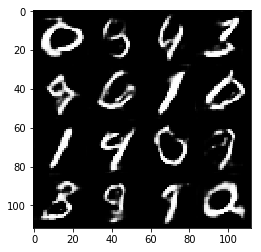

Timestamp 20170806-16-18-39.802 -  Epoch 1/2 -  Step 2110 -  D Loss: 1.2617 - G Loss: 1.1553
Timestamp 20170806-16-18-56.206 -  Epoch 1/2 -  Step 2120 -  D Loss: 1.2887 - G Loss: 1.2164
Timestamp 20170806-16-19-12.602 -  Epoch 1/2 -  Step 2130 -  D Loss: 1.2846 - G Loss: 1.1988
Timestamp 20170806-16-19-28.997 -  Epoch 1/2 -  Step 2140 -  D Loss: 1.0226 - G Loss: 1.1700
Timestamp 20170806-16-19-45.398 -  Epoch 1/2 -  Step 2150 -  D Loss: 1.1208 - G Loss: 1.1215
Timestamp 20170806-16-20-01.809 -  Epoch 1/2 -  Step 2160 -  D Loss: 1.6162 - G Loss: 0.7486
Timestamp 20170806-16-20-18.231 -  Epoch 1/2 -  Step 2170 -  D Loss: 1.4000 - G Loss: 0.9309
Timestamp 20170806-16-20-34.615 -  Epoch 1/2 -  Step 2180 -  D Loss: 1.1404 - G Loss: 1.0082
Timestamp 20170806-16-20-51.010 -  Epoch 1/2 -  Step 2190 -  D Loss: 1.0301 - G Loss: 1.3303
Timestamp 20170806-16-21-07.400 -  Epoch 1/2 -  Step 2200 -  D Loss: 1.3495 - G Loss: 1.1616


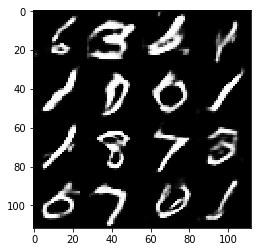

Timestamp 20170806-16-21-24.466 -  Epoch 1/2 -  Step 2210 -  D Loss: 1.1445 - G Loss: 0.9083
Timestamp 20170806-16-21-40.870 -  Epoch 1/2 -  Step 2220 -  D Loss: 1.2021 - G Loss: 0.9721
Timestamp 20170806-16-21-57.261 -  Epoch 1/2 -  Step 2230 -  D Loss: 1.2178 - G Loss: 0.8509
Timestamp 20170806-16-22-13.664 -  Epoch 1/2 -  Step 2240 -  D Loss: 1.0997 - G Loss: 1.0354
Timestamp 20170806-16-22-30.068 -  Epoch 1/2 -  Step 2250 -  D Loss: 1.0604 - G Loss: 0.7986
Timestamp 20170806-16-22-46.455 -  Epoch 1/2 -  Step 2260 -  D Loss: 1.4407 - G Loss: 0.8042
Timestamp 20170806-16-23-02.872 -  Epoch 1/2 -  Step 2270 -  D Loss: 1.5498 - G Loss: 0.6374
Timestamp 20170806-16-23-19.280 -  Epoch 1/2 -  Step 2280 -  D Loss: 1.2337 - G Loss: 1.2325
Timestamp 20170806-16-23-35.689 -  Epoch 1/2 -  Step 2290 -  D Loss: 1.3651 - G Loss: 1.3020
Timestamp 20170806-16-23-52.072 -  Epoch 1/2 -  Step 2300 -  D Loss: 1.0641 - G Loss: 1.0310


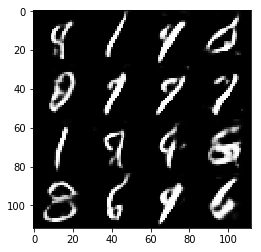

Timestamp 20170806-16-24-09.105 -  Epoch 1/2 -  Step 2310 -  D Loss: 1.1202 - G Loss: 0.9613
Timestamp 20170806-16-24-25.510 -  Epoch 1/2 -  Step 2320 -  D Loss: 1.2997 - G Loss: 1.1911
Timestamp 20170806-16-24-41.905 -  Epoch 1/2 -  Step 2330 -  D Loss: 1.3365 - G Loss: 0.6844
Timestamp 20170806-16-24-58.331 -  Epoch 1/2 -  Step 2340 -  D Loss: 1.0551 - G Loss: 0.9301
Timestamp 20170806-16-25-14.722 -  Epoch 1/2 -  Step 2350 -  D Loss: 1.1219 - G Loss: 0.9941
Timestamp 20170806-16-25-31.116 -  Epoch 1/2 -  Step 2360 -  D Loss: 1.2037 - G Loss: 1.3151
Timestamp 20170806-16-25-47.518 -  Epoch 1/2 -  Step 2370 -  D Loss: 1.0072 - G Loss: 0.9757
Timestamp 20170806-16-26-03.888 -  Epoch 1/2 -  Step 2380 -  D Loss: 1.2202 - G Loss: 1.3798
Timestamp 20170806-16-26-20.292 -  Epoch 1/2 -  Step 2390 -  D Loss: 0.9054 - G Loss: 1.0296
Timestamp 20170806-16-26-36.695 -  Epoch 1/2 -  Step 2400 -  D Loss: 0.8836 - G Loss: 1.2042


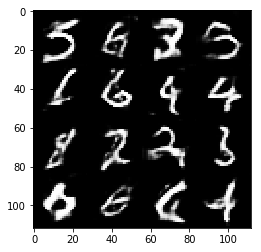

Timestamp 20170806-16-26-53.753 -  Epoch 1/2 -  Step 2410 -  D Loss: 1.1732 - G Loss: 1.0497
Timestamp 20170806-16-27-10.142 -  Epoch 1/2 -  Step 2420 -  D Loss: 1.4181 - G Loss: 1.1804
Timestamp 20170806-16-27-26.547 -  Epoch 1/2 -  Step 2430 -  D Loss: 1.5292 - G Loss: 0.6582
Timestamp 20170806-16-27-42.952 -  Epoch 1/2 -  Step 2440 -  D Loss: 1.4178 - G Loss: 1.1037
Timestamp 20170806-16-27-59.341 -  Epoch 1/2 -  Step 2450 -  D Loss: 1.2050 - G Loss: 0.8824
Timestamp 20170806-16-28-15.744 -  Epoch 1/2 -  Step 2460 -  D Loss: 1.3827 - G Loss: 1.0382
Timestamp 20170806-16-28-32.152 -  Epoch 1/2 -  Step 2470 -  D Loss: 1.2608 - G Loss: 1.0032
Timestamp 20170806-16-28-48.537 -  Epoch 1/2 -  Step 2480 -  D Loss: 1.0949 - G Loss: 1.2356
Timestamp 20170806-16-29-04.951 -  Epoch 1/2 -  Step 2490 -  D Loss: 1.0734 - G Loss: 0.8008
Timestamp 20170806-16-29-21.341 -  Epoch 1/2 -  Step 2500 -  D Loss: 1.2274 - G Loss: 1.1217


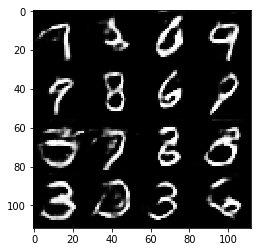

Timestamp 20170806-16-29-38.395 -  Epoch 1/2 -  Step 2510 -  D Loss: 1.5036 - G Loss: 0.8963
Timestamp 20170806-16-29-54.775 -  Epoch 1/2 -  Step 2520 -  D Loss: 1.2428 - G Loss: 0.7237
Timestamp 20170806-16-30-11.167 -  Epoch 1/2 -  Step 2530 -  D Loss: 1.3074 - G Loss: 1.1250
Timestamp 20170806-16-30-27.560 -  Epoch 1/2 -  Step 2540 -  D Loss: 1.3660 - G Loss: 0.8882
Timestamp 20170806-16-30-43.967 -  Epoch 1/2 -  Step 2550 -  D Loss: 1.2154 - G Loss: 0.9747
Timestamp 20170806-16-31-00.376 -  Epoch 1/2 -  Step 2560 -  D Loss: 1.2835 - G Loss: 1.0430
Timestamp 20170806-16-31-16.780 -  Epoch 1/2 -  Step 2570 -  D Loss: 1.2697 - G Loss: 0.8812
Timestamp 20170806-16-31-33.185 -  Epoch 1/2 -  Step 2580 -  D Loss: 1.1771 - G Loss: 0.7775
Timestamp 20170806-16-31-49.560 -  Epoch 1/2 -  Step 2590 -  D Loss: 1.2826 - G Loss: 0.7331
Timestamp 20170806-16-32-05.944 -  Epoch 1/2 -  Step 2600 -  D Loss: 1.3576 - G Loss: 0.9589


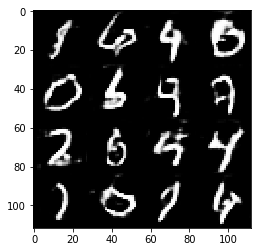

Timestamp 20170806-16-32-23.021 -  Epoch 1/2 -  Step 2610 -  D Loss: 1.2664 - G Loss: 1.0592
Timestamp 20170806-16-32-39.424 -  Epoch 1/2 -  Step 2620 -  D Loss: 1.0026 - G Loss: 1.5156
Timestamp 20170806-16-32-55.822 -  Epoch 1/2 -  Step 2630 -  D Loss: 1.0860 - G Loss: 0.9987
Timestamp 20170806-16-33-12.205 -  Epoch 1/2 -  Step 2640 -  D Loss: 1.5283 - G Loss: 0.6404
Timestamp 20170806-16-33-28.611 -  Epoch 1/2 -  Step 2650 -  D Loss: 1.1093 - G Loss: 1.2049
Timestamp 20170806-16-33-45.025 -  Epoch 1/2 -  Step 2660 -  D Loss: 1.2087 - G Loss: 0.8559
Timestamp 20170806-16-34-01.443 -  Epoch 1/2 -  Step 2670 -  D Loss: 1.4045 - G Loss: 0.8427
Timestamp 20170806-16-34-17.834 -  Epoch 1/2 -  Step 2680 -  D Loss: 0.9611 - G Loss: 1.2173
Timestamp 20170806-16-34-34.227 -  Epoch 1/2 -  Step 2690 -  D Loss: 1.1753 - G Loss: 0.7193
Timestamp 20170806-16-34-50.617 -  Epoch 1/2 -  Step 2700 -  D Loss: 1.2891 - G Loss: 0.8479


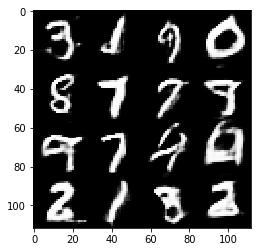

Timestamp 20170806-16-35-07.693 -  Epoch 1/2 -  Step 2710 -  D Loss: 1.3150 - G Loss: 1.0554
Timestamp 20170806-16-35-24.086 -  Epoch 1/2 -  Step 2720 -  D Loss: 1.3353 - G Loss: 0.7630
Timestamp 20170806-16-35-40.478 -  Epoch 1/2 -  Step 2730 -  D Loss: 1.2937 - G Loss: 1.2214
Timestamp 20170806-16-35-56.870 -  Epoch 1/2 -  Step 2740 -  D Loss: 1.2825 - G Loss: 0.8116
Timestamp 20170806-16-36-13.257 -  Epoch 1/2 -  Step 2750 -  D Loss: 1.1473 - G Loss: 1.2355
Timestamp 20170806-16-36-29.651 -  Epoch 1/2 -  Step 2760 -  D Loss: 1.2528 - G Loss: 0.9909
Timestamp 20170806-16-36-46.045 -  Epoch 1/2 -  Step 2770 -  D Loss: 1.1917 - G Loss: 0.8741
Timestamp 20170806-16-37-02.438 -  Epoch 1/2 -  Step 2780 -  D Loss: 0.9742 - G Loss: 1.1297
Timestamp 20170806-16-37-18.828 -  Epoch 1/2 -  Step 2790 -  D Loss: 1.0675 - G Loss: 0.9983
Timestamp 20170806-16-37-35.225 -  Epoch 1/2 -  Step 2800 -  D Loss: 1.4500 - G Loss: 1.0120


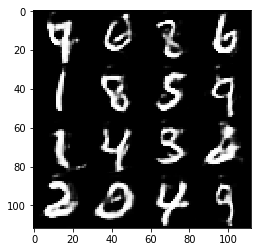

Timestamp 20170806-16-37-52.394 -  Epoch 1/2 -  Step 2810 -  D Loss: 1.1898 - G Loss: 0.8143
Timestamp 20170806-16-38-08.793 -  Epoch 1/2 -  Step 2820 -  D Loss: 1.1553 - G Loss: 0.7829
Timestamp 20170806-16-38-25.200 -  Epoch 1/2 -  Step 2830 -  D Loss: 1.3658 - G Loss: 1.0164
Timestamp 20170806-16-38-41.583 -  Epoch 1/2 -  Step 2840 -  D Loss: 0.9475 - G Loss: 1.2063
Timestamp 20170806-16-38-57.975 -  Epoch 1/2 -  Step 2850 -  D Loss: 1.0526 - G Loss: 1.3922
Timestamp 20170806-16-39-14.374 -  Epoch 1/2 -  Step 2860 -  D Loss: 1.0906 - G Loss: 1.1861
Timestamp 20170806-16-39-30.765 -  Epoch 1/2 -  Step 2870 -  D Loss: 1.3657 - G Loss: 0.8625
Timestamp 20170806-16-39-47.160 -  Epoch 1/2 -  Step 2880 -  D Loss: 1.2978 - G Loss: 0.7707
Timestamp 20170806-16-40-03.550 -  Epoch 1/2 -  Step 2890 -  D Loss: 1.0800 - G Loss: 1.1872
Timestamp 20170806-16-40-19.942 -  Epoch 1/2 -  Step 2900 -  D Loss: 0.9895 - G Loss: 1.1868


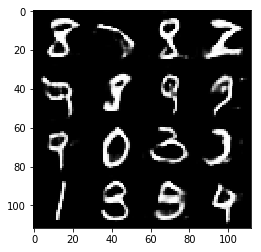

Timestamp 20170806-16-40-37.015 -  Epoch 1/2 -  Step 2910 -  D Loss: 1.1902 - G Loss: 0.6182
Timestamp 20170806-16-40-53.416 -  Epoch 1/2 -  Step 2920 -  D Loss: 0.9865 - G Loss: 0.9736
Timestamp 20170806-16-41-09.809 -  Epoch 1/2 -  Step 2930 -  D Loss: 1.2351 - G Loss: 1.2100
Timestamp 20170806-16-41-26.206 -  Epoch 1/2 -  Step 2940 -  D Loss: 1.2459 - G Loss: 1.0545
Timestamp 20170806-16-41-42.594 -  Epoch 1/2 -  Step 2950 -  D Loss: 1.2146 - G Loss: 1.0446
Timestamp 20170806-16-41-58.994 -  Epoch 1/2 -  Step 2960 -  D Loss: 1.3793 - G Loss: 0.6953
Timestamp 20170806-16-42-15.388 -  Epoch 1/2 -  Step 2970 -  D Loss: 0.9713 - G Loss: 1.1769
Timestamp 20170806-16-42-31.798 -  Epoch 1/2 -  Step 2980 -  D Loss: 1.4412 - G Loss: 0.9658
Timestamp 20170806-16-42-48.202 -  Epoch 1/2 -  Step 2990 -  D Loss: 1.1728 - G Loss: 0.9134
Timestamp 20170806-16-43-04.581 -  Epoch 1/2 -  Step 3000 -  D Loss: 1.3430 - G Loss: 0.7911


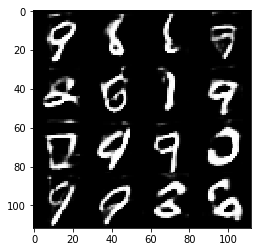

Timestamp 20170806-16-43-21.642 -  Epoch 1/2 -  Step 3010 -  D Loss: 1.0518 - G Loss: 1.0772
Timestamp 20170806-16-43-38.058 -  Epoch 1/2 -  Step 3020 -  D Loss: 1.2075 - G Loss: 1.0263
Timestamp 20170806-16-43-54.455 -  Epoch 1/2 -  Step 3030 -  D Loss: 1.1319 - G Loss: 0.7870
Timestamp 20170806-16-44-10.866 -  Epoch 1/2 -  Step 3040 -  D Loss: 1.1559 - G Loss: 0.9880
Timestamp 20170806-16-44-27.277 -  Epoch 1/2 -  Step 3050 -  D Loss: 1.3624 - G Loss: 1.0542
Timestamp 20170806-16-44-43.698 -  Epoch 1/2 -  Step 3060 -  D Loss: 1.1445 - G Loss: 0.6941
Timestamp 20170806-16-45-00.138 -  Epoch 1/2 -  Step 3070 -  D Loss: 1.1287 - G Loss: 1.1030
Timestamp 20170806-16-45-16.540 -  Epoch 1/2 -  Step 3080 -  D Loss: 0.9187 - G Loss: 1.2409
Timestamp 20170806-16-45-32.953 -  Epoch 1/2 -  Step 3090 -  D Loss: 1.3470 - G Loss: 0.9622
Timestamp 20170806-16-45-49.335 -  Epoch 1/2 -  Step 3100 -  D Loss: 1.2695 - G Loss: 0.8852


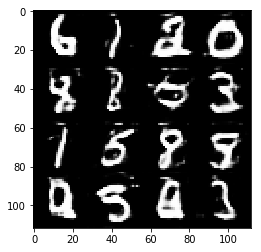

Timestamp 20170806-16-46-06.468 -  Epoch 1/2 -  Step 3110 -  D Loss: 1.2848 - G Loss: 0.9765
Timestamp 20170806-16-46-22.898 -  Epoch 1/2 -  Step 3120 -  D Loss: 1.2388 - G Loss: 1.2042
Timestamp 20170806-16-46-39.322 -  Epoch 1/2 -  Step 3130 -  D Loss: 1.1668 - G Loss: 0.9942
Timestamp 20170806-16-46-55.723 -  Epoch 1/2 -  Step 3140 -  D Loss: 1.1991 - G Loss: 0.8363
Timestamp 20170806-16-47-12.130 -  Epoch 1/2 -  Step 3150 -  D Loss: 1.2245 - G Loss: 1.1898
Timestamp 20170806-16-47-28.556 -  Epoch 1/2 -  Step 3160 -  D Loss: 0.9749 - G Loss: 1.2453
Timestamp 20170806-16-47-44.972 -  Epoch 1/2 -  Step 3170 -  D Loss: 1.1770 - G Loss: 0.8479
Timestamp 20170806-16-48-01.371 -  Epoch 1/2 -  Step 3180 -  D Loss: 1.0929 - G Loss: 1.3057
Timestamp 20170806-16-48-17.784 -  Epoch 1/2 -  Step 3190 -  D Loss: 1.1917 - G Loss: 1.1649
Timestamp 20170806-16-48-34.180 -  Epoch 1/2 -  Step 3200 -  D Loss: 1.4365 - G Loss: 0.9701


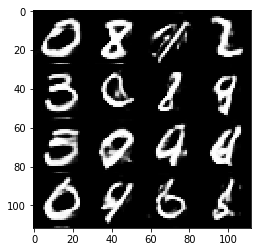

Timestamp 20170806-16-48-51.319 -  Epoch 1/2 -  Step 3210 -  D Loss: 1.2483 - G Loss: 1.1564
Timestamp 20170806-16-49-07.720 -  Epoch 1/2 -  Step 3220 -  D Loss: 1.3307 - G Loss: 0.5400
Timestamp 20170806-16-49-24.115 -  Epoch 1/2 -  Step 3230 -  D Loss: 1.2825 - G Loss: 1.2584
Timestamp 20170806-16-49-40.551 -  Epoch 1/2 -  Step 3240 -  D Loss: 1.1387 - G Loss: 1.0315
Timestamp 20170806-16-49-56.964 -  Epoch 1/2 -  Step 3250 -  D Loss: 1.1278 - G Loss: 1.3815
Timestamp 20170806-16-50-13.375 -  Epoch 1/2 -  Step 3260 -  D Loss: 1.0851 - G Loss: 0.7459
Timestamp 20170806-16-50-29.809 -  Epoch 1/2 -  Step 3270 -  D Loss: 1.0138 - G Loss: 1.1871
Timestamp 20170806-16-50-46.270 -  Epoch 1/2 -  Step 3280 -  D Loss: 1.0966 - G Loss: 1.2828
Timestamp 20170806-16-51-02.664 -  Epoch 1/2 -  Step 3290 -  D Loss: 1.1156 - G Loss: 1.2487
Timestamp 20170806-16-51-19.082 -  Epoch 1/2 -  Step 3300 -  D Loss: 1.2370 - G Loss: 1.0009


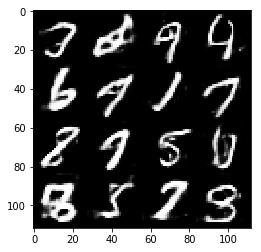

Timestamp 20170806-16-51-36.190 -  Epoch 1/2 -  Step 3310 -  D Loss: 1.0460 - G Loss: 1.1192
Timestamp 20170806-16-51-52.598 -  Epoch 1/2 -  Step 3320 -  D Loss: 1.2309 - G Loss: 1.0348
Timestamp 20170806-16-52-09.012 -  Epoch 1/2 -  Step 3330 -  D Loss: 0.9850 - G Loss: 1.0289
Timestamp 20170806-16-52-25.415 -  Epoch 1/2 -  Step 3340 -  D Loss: 1.0146 - G Loss: 1.3691
Timestamp 20170806-16-52-41.841 -  Epoch 1/2 -  Step 3350 -  D Loss: 1.0554 - G Loss: 1.2550
Timestamp 20170806-16-52-58.241 -  Epoch 1/2 -  Step 3360 -  D Loss: 1.1653 - G Loss: 1.0422
Timestamp 20170806-16-53-14.660 -  Epoch 1/2 -  Step 3370 -  D Loss: 0.9775 - G Loss: 0.8798
Timestamp 20170806-16-53-31.050 -  Epoch 1/2 -  Step 3380 -  D Loss: 0.9071 - G Loss: 1.1033
Timestamp 20170806-16-53-47.455 -  Epoch 1/2 -  Step 3390 -  D Loss: 1.5967 - G Loss: 0.9749
Timestamp 20170806-16-54-03.871 -  Epoch 1/2 -  Step 3400 -  D Loss: 1.1016 - G Loss: 0.8433


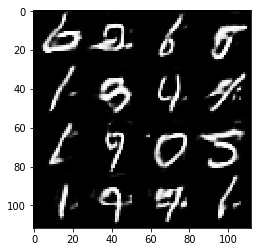

Timestamp 20170806-16-54-20.990 -  Epoch 1/2 -  Step 3410 -  D Loss: 0.8337 - G Loss: 1.3553
Timestamp 20170806-16-54-37.401 -  Epoch 1/2 -  Step 3420 -  D Loss: 0.9453 - G Loss: 1.2580
Timestamp 20170806-16-54-53.805 -  Epoch 1/2 -  Step 3430 -  D Loss: 1.0233 - G Loss: 1.3161
Timestamp 20170806-16-55-10.220 -  Epoch 1/2 -  Step 3440 -  D Loss: 1.5194 - G Loss: 1.1471
Timestamp 20170806-16-55-26.617 -  Epoch 1/2 -  Step 3450 -  D Loss: 1.0759 - G Loss: 1.2606
Timestamp 20170806-16-55-43.072 -  Epoch 1/2 -  Step 3460 -  D Loss: 0.9234 - G Loss: 1.2062
Timestamp 20170806-16-55-59.480 -  Epoch 1/2 -  Step 3470 -  D Loss: 0.8813 - G Loss: 1.2333
Timestamp 20170806-16-56-15.889 -  Epoch 1/2 -  Step 3480 -  D Loss: 1.0856 - G Loss: 1.2854
Timestamp 20170806-16-56-32.322 -  Epoch 1/2 -  Step 3490 -  D Loss: 1.0979 - G Loss: 0.9751
Timestamp 20170806-16-56-48.751 -  Epoch 1/2 -  Step 3500 -  D Loss: 1.1188 - G Loss: 0.7947


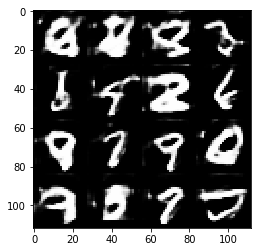

Timestamp 20170806-16-57-05.887 -  Epoch 1/2 -  Step 3510 -  D Loss: 1.0055 - G Loss: 1.5011
Timestamp 20170806-16-57-22.264 -  Epoch 1/2 -  Step 3520 -  D Loss: 1.0927 - G Loss: 0.8401
Timestamp 20170806-16-57-38.675 -  Epoch 1/2 -  Step 3530 -  D Loss: 1.1064 - G Loss: 0.9891
Timestamp 20170806-16-57-55.103 -  Epoch 1/2 -  Step 3540 -  D Loss: 1.1973 - G Loss: 0.6559
Timestamp 20170806-16-58-11.530 -  Epoch 1/2 -  Step 3550 -  D Loss: 1.1195 - G Loss: 0.9946
Timestamp 20170806-16-58-27.935 -  Epoch 1/2 -  Step 3560 -  D Loss: 0.9603 - G Loss: 1.2970
Timestamp 20170806-16-58-44.345 -  Epoch 1/2 -  Step 3570 -  D Loss: 1.4557 - G Loss: 0.7559
Timestamp 20170806-16-59-00.748 -  Epoch 1/2 -  Step 3580 -  D Loss: 0.9535 - G Loss: 1.1444
Timestamp 20170806-16-59-17.139 -  Epoch 1/2 -  Step 3590 -  D Loss: 1.2582 - G Loss: 0.6147
Timestamp 20170806-16-59-33.551 -  Epoch 1/2 -  Step 3600 -  D Loss: 1.1907 - G Loss: 1.0049


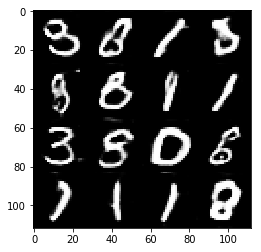

Timestamp 20170806-16-59-50.693 -  Epoch 1/2 -  Step 3610 -  D Loss: 1.1184 - G Loss: 0.6959
Timestamp 20170806-17-00-07.103 -  Epoch 1/2 -  Step 3620 -  D Loss: 1.1918 - G Loss: 1.3161
Timestamp 20170806-17-00-23.500 -  Epoch 1/2 -  Step 3630 -  D Loss: 1.4442 - G Loss: 0.6521
Timestamp 20170806-17-00-39.895 -  Epoch 1/2 -  Step 3640 -  D Loss: 0.9854 - G Loss: 1.1779
Timestamp 20170806-17-00-56.301 -  Epoch 1/2 -  Step 3650 -  D Loss: 1.1130 - G Loss: 1.0308
Timestamp 20170806-17-01-12.701 -  Epoch 1/2 -  Step 3660 -  D Loss: 1.1400 - G Loss: 0.8159
Timestamp 20170806-17-01-29.100 -  Epoch 1/2 -  Step 3670 -  D Loss: 1.1706 - G Loss: 1.0562
Timestamp 20170806-17-01-45.507 -  Epoch 1/2 -  Step 3680 -  D Loss: 1.4831 - G Loss: 0.8736
Timestamp 20170806-17-02-01.893 -  Epoch 1/2 -  Step 3690 -  D Loss: 1.1012 - G Loss: 1.2087
Timestamp 20170806-17-02-18.297 -  Epoch 1/2 -  Step 3700 -  D Loss: 1.0738 - G Loss: 0.8940


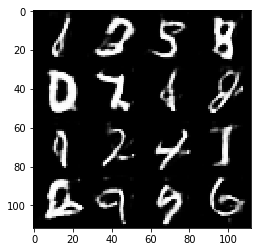

Timestamp 20170806-17-02-35.424 -  Epoch 1/2 -  Step 3710 -  D Loss: 0.9509 - G Loss: 1.4088
Timestamp 20170806-17-02-51.818 -  Epoch 1/2 -  Step 3720 -  D Loss: 1.3132 - G Loss: 0.7950
Timestamp 20170806-17-03-08.226 -  Epoch 1/2 -  Step 3730 -  D Loss: 1.2488 - G Loss: 1.0890
Timestamp 20170806-17-03-24.627 -  Epoch 1/2 -  Step 3740 -  D Loss: 1.0096 - G Loss: 1.6513
Timestamp 20170806-17-03-41.036 -  Epoch 1/2 -  Step 3750 -  D Loss: 1.0785 - G Loss: 1.6550
Timestamp 20170806-17-03-41.605 -  Epoch 1/2 -  Step 3750 -  D Loss: 0.9368 - G Loss: 1.1054


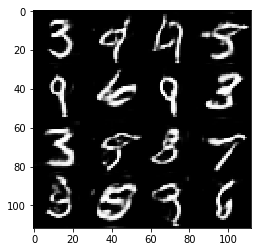

Timestamp 20170806-17-03-58.713 -  Epoch 2/2 -  Step 3760 -  D Loss: 0.8117 - G Loss: 1.4371
Timestamp 20170806-17-04-15.120 -  Epoch 2/2 -  Step 3770 -  D Loss: 1.3063 - G Loss: 1.0531
Timestamp 20170806-17-04-31.504 -  Epoch 2/2 -  Step 3780 -  D Loss: 1.0359 - G Loss: 2.0764
Timestamp 20170806-17-04-47.910 -  Epoch 2/2 -  Step 3790 -  D Loss: 1.1195 - G Loss: 0.6902
Timestamp 20170806-17-05-04.322 -  Epoch 2/2 -  Step 3800 -  D Loss: 0.9845 - G Loss: 1.0814


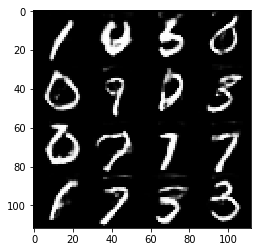

Timestamp 20170806-17-05-21.443 -  Epoch 2/2 -  Step 3810 -  D Loss: 1.0623 - G Loss: 1.3410
Timestamp 20170806-17-05-37.835 -  Epoch 2/2 -  Step 3820 -  D Loss: 1.0412 - G Loss: 1.5450
Timestamp 20170806-17-05-54.223 -  Epoch 2/2 -  Step 3830 -  D Loss: 1.1962 - G Loss: 1.0834
Timestamp 20170806-17-06-10.609 -  Epoch 2/2 -  Step 3840 -  D Loss: 1.2173 - G Loss: 0.7069
Timestamp 20170806-17-06-27.003 -  Epoch 2/2 -  Step 3850 -  D Loss: 1.0258 - G Loss: 1.2529
Timestamp 20170806-17-06-43.392 -  Epoch 2/2 -  Step 3860 -  D Loss: 1.2548 - G Loss: 1.5710
Timestamp 20170806-17-06-59.786 -  Epoch 2/2 -  Step 3870 -  D Loss: 1.1367 - G Loss: 1.0579
Timestamp 20170806-17-07-16.183 -  Epoch 2/2 -  Step 3880 -  D Loss: 1.0962 - G Loss: 0.9834
Timestamp 20170806-17-07-32.595 -  Epoch 2/2 -  Step 3890 -  D Loss: 1.2459 - G Loss: 1.4147
Timestamp 20170806-17-07-48.988 -  Epoch 2/2 -  Step 3900 -  D Loss: 1.0585 - G Loss: 1.2224


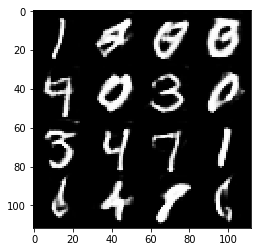

Timestamp 20170806-17-08-06.104 -  Epoch 2/2 -  Step 3910 -  D Loss: 0.9832 - G Loss: 1.1718
Timestamp 20170806-17-08-22.480 -  Epoch 2/2 -  Step 3920 -  D Loss: 1.3807 - G Loss: 0.7542
Timestamp 20170806-17-08-38.881 -  Epoch 2/2 -  Step 3930 -  D Loss: 1.0668 - G Loss: 1.1333
Timestamp 20170806-17-08-55.282 -  Epoch 2/2 -  Step 3940 -  D Loss: 1.1726 - G Loss: 0.9644
Timestamp 20170806-17-09-11.691 -  Epoch 2/2 -  Step 3950 -  D Loss: 1.0688 - G Loss: 1.3817
Timestamp 20170806-17-09-28.097 -  Epoch 2/2 -  Step 3960 -  D Loss: 1.1852 - G Loss: 1.3214
Timestamp 20170806-17-09-44.502 -  Epoch 2/2 -  Step 3970 -  D Loss: 1.0770 - G Loss: 1.1378
Timestamp 20170806-17-10-00.891 -  Epoch 2/2 -  Step 3980 -  D Loss: 1.1272 - G Loss: 1.3938
Timestamp 20170806-17-10-17.289 -  Epoch 2/2 -  Step 3990 -  D Loss: 1.1321 - G Loss: 0.7156
Timestamp 20170806-17-10-33.678 -  Epoch 2/2 -  Step 4000 -  D Loss: 1.2761 - G Loss: 1.4019


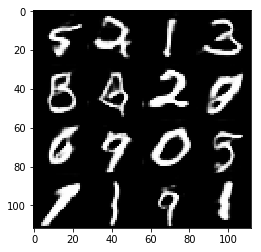

Timestamp 20170806-17-10-50.727 -  Epoch 2/2 -  Step 4010 -  D Loss: 1.0502 - G Loss: 1.2394
Timestamp 20170806-17-11-07.121 -  Epoch 2/2 -  Step 4020 -  D Loss: 0.9853 - G Loss: 1.2730
Timestamp 20170806-17-11-23.512 -  Epoch 2/2 -  Step 4030 -  D Loss: 1.3204 - G Loss: 0.7006
Timestamp 20170806-17-11-39.904 -  Epoch 2/2 -  Step 4040 -  D Loss: 1.0652 - G Loss: 1.0389
Timestamp 20170806-17-11-56.306 -  Epoch 2/2 -  Step 4050 -  D Loss: 1.2470 - G Loss: 0.9701
Timestamp 20170806-17-12-12.705 -  Epoch 2/2 -  Step 4060 -  D Loss: 1.0133 - G Loss: 1.3943
Timestamp 20170806-17-12-29.108 -  Epoch 2/2 -  Step 4070 -  D Loss: 0.8209 - G Loss: 1.3932
Timestamp 20170806-17-12-45.508 -  Epoch 2/2 -  Step 4080 -  D Loss: 0.9132 - G Loss: 1.1613
Timestamp 20170806-17-13-01.909 -  Epoch 2/2 -  Step 4090 -  D Loss: 1.4124 - G Loss: 0.9484
Timestamp 20170806-17-13-18.295 -  Epoch 2/2 -  Step 4100 -  D Loss: 0.9203 - G Loss: 1.4620


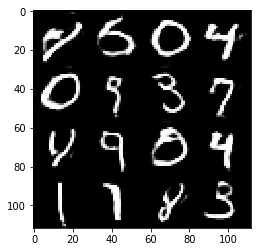

Timestamp 20170806-17-13-35.389 -  Epoch 2/2 -  Step 4110 -  D Loss: 1.1955 - G Loss: 0.8551
Timestamp 20170806-17-13-51.778 -  Epoch 2/2 -  Step 4120 -  D Loss: 1.1105 - G Loss: 0.9760
Timestamp 20170806-17-14-08.172 -  Epoch 2/2 -  Step 4130 -  D Loss: 0.9132 - G Loss: 1.6921
Timestamp 20170806-17-14-24.571 -  Epoch 2/2 -  Step 4140 -  D Loss: 1.1112 - G Loss: 1.5813
Timestamp 20170806-17-14-40.975 -  Epoch 2/2 -  Step 4150 -  D Loss: 1.0079 - G Loss: 0.9122
Timestamp 20170806-17-14-57.388 -  Epoch 2/2 -  Step 4160 -  D Loss: 1.4896 - G Loss: 1.1351
Timestamp 20170806-17-15-13.779 -  Epoch 2/2 -  Step 4170 -  D Loss: 0.9910 - G Loss: 1.3412
Timestamp 20170806-17-15-30.175 -  Epoch 2/2 -  Step 4180 -  D Loss: 1.1054 - G Loss: 0.7959
Timestamp 20170806-17-15-46.596 -  Epoch 2/2 -  Step 4190 -  D Loss: 1.1438 - G Loss: 1.1559
Timestamp 20170806-17-16-02.999 -  Epoch 2/2 -  Step 4200 -  D Loss: 0.9609 - G Loss: 1.3290


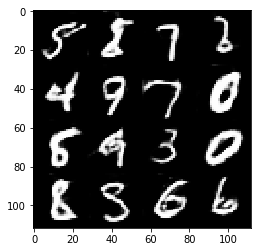

Timestamp 20170806-17-16-20.095 -  Epoch 2/2 -  Step 4210 -  D Loss: 1.0167 - G Loss: 1.0780
Timestamp 20170806-17-16-36.506 -  Epoch 2/2 -  Step 4220 -  D Loss: 0.9238 - G Loss: 0.9510
Timestamp 20170806-17-16-52.894 -  Epoch 2/2 -  Step 4230 -  D Loss: 1.1649 - G Loss: 0.8551
Timestamp 20170806-17-17-09.306 -  Epoch 2/2 -  Step 4240 -  D Loss: 1.2000 - G Loss: 0.7465
Timestamp 20170806-17-17-25.708 -  Epoch 2/2 -  Step 4250 -  D Loss: 0.8510 - G Loss: 1.5544
Timestamp 20170806-17-17-42.113 -  Epoch 2/2 -  Step 4260 -  D Loss: 0.8700 - G Loss: 1.4360
Timestamp 20170806-17-17-58.512 -  Epoch 2/2 -  Step 4270 -  D Loss: 0.9493 - G Loss: 1.4044
Timestamp 20170806-17-18-14.897 -  Epoch 2/2 -  Step 4280 -  D Loss: 1.1991 - G Loss: 0.6640
Timestamp 20170806-17-18-31.296 -  Epoch 2/2 -  Step 4290 -  D Loss: 1.1016 - G Loss: 1.1062
Timestamp 20170806-17-18-47.685 -  Epoch 2/2 -  Step 4300 -  D Loss: 1.3214 - G Loss: 0.8384


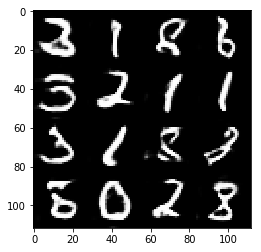

Timestamp 20170806-17-19-04.786 -  Epoch 2/2 -  Step 4310 -  D Loss: 0.9808 - G Loss: 1.5384
Timestamp 20170806-17-19-21.177 -  Epoch 2/2 -  Step 4320 -  D Loss: 0.9087 - G Loss: 1.1064
Timestamp 20170806-17-19-37.592 -  Epoch 2/2 -  Step 4330 -  D Loss: 1.3206 - G Loss: 0.9516
Timestamp 20170806-17-19-53.991 -  Epoch 2/2 -  Step 4340 -  D Loss: 0.8942 - G Loss: 1.1732
Timestamp 20170806-17-20-10.395 -  Epoch 2/2 -  Step 4350 -  D Loss: 1.1827 - G Loss: 1.2136
Timestamp 20170806-17-20-26.790 -  Epoch 2/2 -  Step 4360 -  D Loss: 1.1138 - G Loss: 1.3470
Timestamp 20170806-17-20-43.197 -  Epoch 2/2 -  Step 4370 -  D Loss: 1.0645 - G Loss: 1.0069
Timestamp 20170806-17-20-59.585 -  Epoch 2/2 -  Step 4380 -  D Loss: 0.9509 - G Loss: 1.1328
Timestamp 20170806-17-21-15.995 -  Epoch 2/2 -  Step 4390 -  D Loss: 1.2479 - G Loss: 1.2378
Timestamp 20170806-17-21-32.398 -  Epoch 2/2 -  Step 4400 -  D Loss: 1.2284 - G Loss: 0.5949


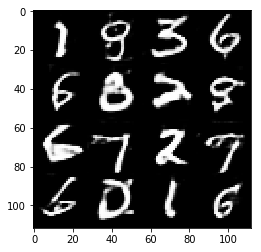

Timestamp 20170806-17-21-49.604 -  Epoch 2/2 -  Step 4410 -  D Loss: 0.9252 - G Loss: 1.5482
Timestamp 20170806-17-22-06.003 -  Epoch 2/2 -  Step 4420 -  D Loss: 1.1354 - G Loss: 1.1343
Timestamp 20170806-17-22-22.403 -  Epoch 2/2 -  Step 4430 -  D Loss: 1.2021 - G Loss: 1.3184
Timestamp 20170806-17-22-38.814 -  Epoch 2/2 -  Step 4440 -  D Loss: 0.8584 - G Loss: 1.5967
Timestamp 20170806-17-22-55.205 -  Epoch 2/2 -  Step 4450 -  D Loss: 1.1111 - G Loss: 1.0086
Timestamp 20170806-17-23-11.606 -  Epoch 2/2 -  Step 4460 -  D Loss: 0.8415 - G Loss: 1.1199
Timestamp 20170806-17-23-27.996 -  Epoch 2/2 -  Step 4470 -  D Loss: 1.1854 - G Loss: 1.0667
Timestamp 20170806-17-23-44.398 -  Epoch 2/2 -  Step 4480 -  D Loss: 0.7567 - G Loss: 1.7683
Timestamp 20170806-17-24-00.783 -  Epoch 2/2 -  Step 4490 -  D Loss: 1.2274 - G Loss: 0.8605
Timestamp 20170806-17-24-17.202 -  Epoch 2/2 -  Step 4500 -  D Loss: 0.8364 - G Loss: 1.5187


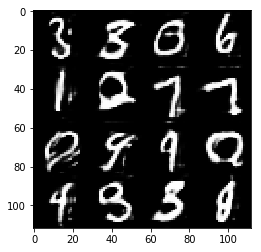

Timestamp 20170806-17-24-36.996 -  Epoch 2/2 -  Step 4510 -  D Loss: 1.0451 - G Loss: 1.2340
Timestamp 20170806-17-24-53.398 -  Epoch 2/2 -  Step 4520 -  D Loss: 0.9297 - G Loss: 1.0535
Timestamp 20170806-17-25-09.811 -  Epoch 2/2 -  Step 4530 -  D Loss: 0.9949 - G Loss: 1.7908
Timestamp 20170806-17-25-26.236 -  Epoch 2/2 -  Step 4540 -  D Loss: 0.9645 - G Loss: 1.2321
Timestamp 20170806-17-25-42.653 -  Epoch 2/2 -  Step 4550 -  D Loss: 1.0657 - G Loss: 1.4096
Timestamp 20170806-17-25-59.075 -  Epoch 2/2 -  Step 4560 -  D Loss: 1.1047 - G Loss: 1.3722
Timestamp 20170806-17-26-15.498 -  Epoch 2/2 -  Step 4570 -  D Loss: 1.4620 - G Loss: 1.0824
Timestamp 20170806-17-26-31.969 -  Epoch 2/2 -  Step 4580 -  D Loss: 0.9885 - G Loss: 1.2714
Timestamp 20170806-17-26-48.458 -  Epoch 2/2 -  Step 4590 -  D Loss: 0.8527 - G Loss: 1.3638
Timestamp 20170806-17-27-04.974 -  Epoch 2/2 -  Step 4600 -  D Loss: 1.1486 - G Loss: 1.0047


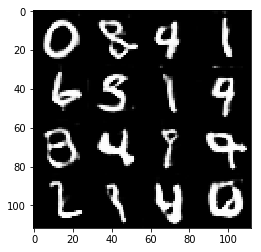

Timestamp 20170806-17-27-22.235 -  Epoch 2/2 -  Step 4610 -  D Loss: 1.1768 - G Loss: 1.4648
Timestamp 20170806-17-27-38.635 -  Epoch 2/2 -  Step 4620 -  D Loss: 1.1428 - G Loss: 0.7516
Timestamp 20170806-17-27-55.058 -  Epoch 2/2 -  Step 4630 -  D Loss: 0.8836 - G Loss: 1.3633
Timestamp 20170806-17-28-11.452 -  Epoch 2/2 -  Step 4640 -  D Loss: 1.0468 - G Loss: 1.4189
Timestamp 20170806-17-28-27.854 -  Epoch 2/2 -  Step 4650 -  D Loss: 1.1357 - G Loss: 1.0306
Timestamp 20170806-17-28-44.266 -  Epoch 2/2 -  Step 4660 -  D Loss: 1.0442 - G Loss: 1.1818
Timestamp 20170806-17-29-00.665 -  Epoch 2/2 -  Step 4670 -  D Loss: 1.1031 - G Loss: 0.7805
Timestamp 20170806-17-29-17.073 -  Epoch 2/2 -  Step 4680 -  D Loss: 1.1248 - G Loss: 1.0203
Timestamp 20170806-17-29-33.473 -  Epoch 2/2 -  Step 4690 -  D Loss: 1.3002 - G Loss: 1.2392
Timestamp 20170806-17-29-49.873 -  Epoch 2/2 -  Step 4700 -  D Loss: 0.8250 - G Loss: 1.6151


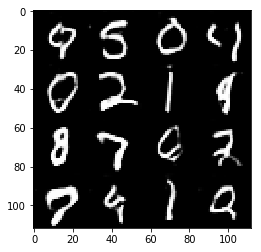

Timestamp 20170806-17-30-06.980 -  Epoch 2/2 -  Step 4710 -  D Loss: 1.1772 - G Loss: 0.9886
Timestamp 20170806-17-30-23.384 -  Epoch 2/2 -  Step 4720 -  D Loss: 1.1266 - G Loss: 1.7054
Timestamp 20170806-17-30-39.773 -  Epoch 2/2 -  Step 4730 -  D Loss: 1.3197 - G Loss: 1.0349
Timestamp 20170806-17-30-56.175 -  Epoch 2/2 -  Step 4740 -  D Loss: 1.1065 - G Loss: 0.8990
Timestamp 20170806-17-31-12.571 -  Epoch 2/2 -  Step 4750 -  D Loss: 0.9627 - G Loss: 1.9694
Timestamp 20170806-17-31-28.995 -  Epoch 2/2 -  Step 4760 -  D Loss: 1.1879 - G Loss: 1.5187
Timestamp 20170806-17-31-45.404 -  Epoch 2/2 -  Step 4770 -  D Loss: 1.2055 - G Loss: 0.6928
Timestamp 20170806-17-32-01.797 -  Epoch 2/2 -  Step 4780 -  D Loss: 0.8736 - G Loss: 1.7252
Timestamp 20170806-17-32-18.194 -  Epoch 2/2 -  Step 4790 -  D Loss: 1.0121 - G Loss: 0.9373
Timestamp 20170806-17-32-34.588 -  Epoch 2/2 -  Step 4800 -  D Loss: 1.1444 - G Loss: 1.8067


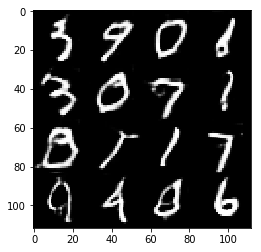

Timestamp 20170806-17-32-51.728 -  Epoch 2/2 -  Step 4810 -  D Loss: 0.8682 - G Loss: 1.9413
Timestamp 20170806-17-33-08.141 -  Epoch 2/2 -  Step 4820 -  D Loss: 0.9688 - G Loss: 0.9450
Timestamp 20170806-17-33-24.551 -  Epoch 2/2 -  Step 4830 -  D Loss: 1.1053 - G Loss: 1.1352
Timestamp 20170806-17-33-40.955 -  Epoch 2/2 -  Step 4840 -  D Loss: 1.0966 - G Loss: 1.4511
Timestamp 20170806-17-33-57.365 -  Epoch 2/2 -  Step 4850 -  D Loss: 0.9520 - G Loss: 1.4613
Timestamp 20170806-17-34-13.754 -  Epoch 2/2 -  Step 4860 -  D Loss: 1.1742 - G Loss: 1.3846
Timestamp 20170806-17-34-30.163 -  Epoch 2/2 -  Step 4870 -  D Loss: 1.1034 - G Loss: 1.4002
Timestamp 20170806-17-34-46.566 -  Epoch 2/2 -  Step 4880 -  D Loss: 0.9608 - G Loss: 1.2468
Timestamp 20170806-17-35-02.976 -  Epoch 2/2 -  Step 4890 -  D Loss: 0.9037 - G Loss: 1.5658
Timestamp 20170806-17-35-19.381 -  Epoch 2/2 -  Step 4900 -  D Loss: 1.5014 - G Loss: 0.7953


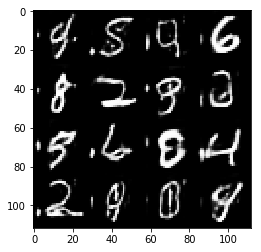

Timestamp 20170806-17-35-36.533 -  Epoch 2/2 -  Step 4910 -  D Loss: 1.2647 - G Loss: 2.1946
Timestamp 20170806-17-35-52.931 -  Epoch 2/2 -  Step 4920 -  D Loss: 1.0642 - G Loss: 1.0769
Timestamp 20170806-17-36-09.331 -  Epoch 2/2 -  Step 4930 -  D Loss: 1.2929 - G Loss: 0.9870
Timestamp 20170806-17-36-25.757 -  Epoch 2/2 -  Step 4940 -  D Loss: 1.0794 - G Loss: 0.9826
Timestamp 20170806-17-36-42.158 -  Epoch 2/2 -  Step 4950 -  D Loss: 0.8147 - G Loss: 1.3387
Timestamp 20170806-17-36-58.563 -  Epoch 2/2 -  Step 4960 -  D Loss: 1.1752 - G Loss: 1.2838
Timestamp 20170806-17-37-14.959 -  Epoch 2/2 -  Step 4970 -  D Loss: 1.4671 - G Loss: 0.8822
Timestamp 20170806-17-37-31.365 -  Epoch 2/2 -  Step 4980 -  D Loss: 0.7653 - G Loss: 2.0357
Timestamp 20170806-17-37-47.771 -  Epoch 2/2 -  Step 4990 -  D Loss: 1.0563 - G Loss: 1.2942
Timestamp 20170806-17-38-04.181 -  Epoch 2/2 -  Step 5000 -  D Loss: 1.3488 - G Loss: 0.6856


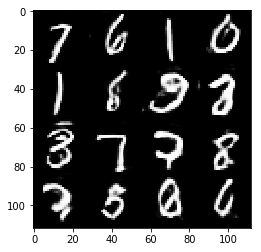

Timestamp 20170806-17-38-21.312 -  Epoch 2/2 -  Step 5010 -  D Loss: 0.8790 - G Loss: 1.8604
Timestamp 20170806-17-38-37.712 -  Epoch 2/2 -  Step 5020 -  D Loss: 0.9305 - G Loss: 1.5833
Timestamp 20170806-17-38-54.113 -  Epoch 2/2 -  Step 5030 -  D Loss: 1.2863 - G Loss: 0.9901
Timestamp 20170806-17-39-10.531 -  Epoch 2/2 -  Step 5040 -  D Loss: 0.9211 - G Loss: 1.2148
Timestamp 20170806-17-39-26.941 -  Epoch 2/2 -  Step 5050 -  D Loss: 0.9510 - G Loss: 1.2341
Timestamp 20170806-17-39-43.357 -  Epoch 2/2 -  Step 5060 -  D Loss: 1.2039 - G Loss: 1.0901
Timestamp 20170806-17-39-59.762 -  Epoch 2/2 -  Step 5070 -  D Loss: 0.8844 - G Loss: 1.3501
Timestamp 20170806-17-40-16.159 -  Epoch 2/2 -  Step 5080 -  D Loss: 1.2219 - G Loss: 1.4453
Timestamp 20170806-17-40-32.578 -  Epoch 2/2 -  Step 5090 -  D Loss: 1.1915 - G Loss: 1.6587
Timestamp 20170806-17-40-48.983 -  Epoch 2/2 -  Step 5100 -  D Loss: 1.4150 - G Loss: 0.7441


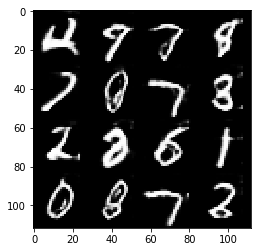

Timestamp 20170806-17-41-06.098 -  Epoch 2/2 -  Step 5110 -  D Loss: 1.1802 - G Loss: 1.8661
Timestamp 20170806-17-41-22.502 -  Epoch 2/2 -  Step 5120 -  D Loss: 1.1319 - G Loss: 0.8979
Timestamp 20170806-17-41-38.922 -  Epoch 2/2 -  Step 5130 -  D Loss: 0.9006 - G Loss: 1.0750
Timestamp 20170806-17-41-55.349 -  Epoch 2/2 -  Step 5140 -  D Loss: 1.0136 - G Loss: 0.9449
Timestamp 20170806-17-42-11.753 -  Epoch 2/2 -  Step 5150 -  D Loss: 0.9342 - G Loss: 1.0646
Timestamp 20170806-17-42-28.163 -  Epoch 2/2 -  Step 5160 -  D Loss: 0.8106 - G Loss: 1.3316
Timestamp 20170806-17-42-44.581 -  Epoch 2/2 -  Step 5170 -  D Loss: 1.2346 - G Loss: 0.8077
Timestamp 20170806-17-43-01.001 -  Epoch 2/2 -  Step 5180 -  D Loss: 1.2594 - G Loss: 1.4888
Timestamp 20170806-17-43-17.401 -  Epoch 2/2 -  Step 5190 -  D Loss: 0.9016 - G Loss: 1.6467
Timestamp 20170806-17-43-33.800 -  Epoch 2/2 -  Step 5200 -  D Loss: 1.4338 - G Loss: 1.1872


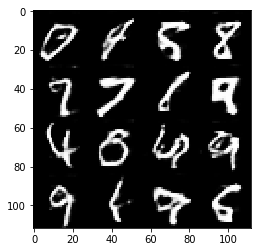

Timestamp 20170806-17-43-51.080 -  Epoch 2/2 -  Step 5210 -  D Loss: 1.2814 - G Loss: 0.9675
Timestamp 20170806-17-44-07.488 -  Epoch 2/2 -  Step 5220 -  D Loss: 0.8585 - G Loss: 1.1135
Timestamp 20170806-17-44-23.904 -  Epoch 2/2 -  Step 5230 -  D Loss: 1.1786 - G Loss: 1.3354
Timestamp 20170806-17-44-40.308 -  Epoch 2/2 -  Step 5240 -  D Loss: 0.8306 - G Loss: 1.8350
Timestamp 20170806-17-44-56.721 -  Epoch 2/2 -  Step 5250 -  D Loss: 1.0089 - G Loss: 1.3285
Timestamp 20170806-17-45-13.136 -  Epoch 2/2 -  Step 5260 -  D Loss: 0.8964 - G Loss: 1.3746
Timestamp 20170806-17-45-29.535 -  Epoch 2/2 -  Step 5270 -  D Loss: 0.9458 - G Loss: 1.5599
Timestamp 20170806-17-45-45.958 -  Epoch 2/2 -  Step 5280 -  D Loss: 1.2201 - G Loss: 0.8971
Timestamp 20170806-17-46-02.379 -  Epoch 2/2 -  Step 5290 -  D Loss: 0.8839 - G Loss: 1.0620
Timestamp 20170806-17-46-18.787 -  Epoch 2/2 -  Step 5300 -  D Loss: 0.9413 - G Loss: 1.3086


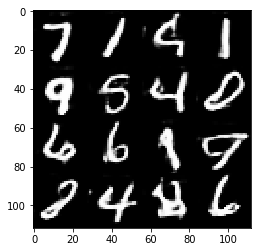

Timestamp 20170806-17-46-35.931 -  Epoch 2/2 -  Step 5310 -  D Loss: 0.9746 - G Loss: 1.9837
Timestamp 20170806-17-46-52.344 -  Epoch 2/2 -  Step 5320 -  D Loss: 1.1086 - G Loss: 1.3532
Timestamp 20170806-17-47-08.749 -  Epoch 2/2 -  Step 5330 -  D Loss: 0.9155 - G Loss: 1.9986
Timestamp 20170806-17-47-25.165 -  Epoch 2/2 -  Step 5340 -  D Loss: 1.1560 - G Loss: 0.7660
Timestamp 20170806-17-47-41.588 -  Epoch 2/2 -  Step 5350 -  D Loss: 1.2335 - G Loss: 1.1621
Timestamp 20170806-17-47-58.000 -  Epoch 2/2 -  Step 5360 -  D Loss: 1.0989 - G Loss: 1.9794
Timestamp 20170806-17-48-14.408 -  Epoch 2/2 -  Step 5370 -  D Loss: 0.8913 - G Loss: 0.7988
Timestamp 20170806-17-48-30.816 -  Epoch 2/2 -  Step 5380 -  D Loss: 0.8228 - G Loss: 2.1895
Timestamp 20170806-17-48-47.216 -  Epoch 2/2 -  Step 5390 -  D Loss: 1.1205 - G Loss: 1.6350
Timestamp 20170806-17-49-03.632 -  Epoch 2/2 -  Step 5400 -  D Loss: 1.1094 - G Loss: 0.9460


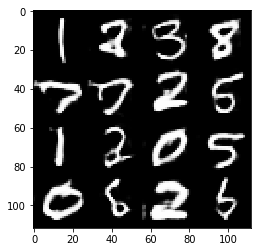

Timestamp 20170806-17-49-20.762 -  Epoch 2/2 -  Step 5410 -  D Loss: 1.0657 - G Loss: 1.5828
Timestamp 20170806-17-49-37.181 -  Epoch 2/2 -  Step 5420 -  D Loss: 0.7679 - G Loss: 1.2694
Timestamp 20170806-17-49-53.569 -  Epoch 2/2 -  Step 5430 -  D Loss: 1.0497 - G Loss: 0.8613
Timestamp 20170806-17-50-09.968 -  Epoch 2/2 -  Step 5440 -  D Loss: 1.0233 - G Loss: 0.9017
Timestamp 20170806-17-50-26.380 -  Epoch 2/2 -  Step 5450 -  D Loss: 0.9788 - G Loss: 1.1407
Timestamp 20170806-17-50-42.784 -  Epoch 2/2 -  Step 5460 -  D Loss: 1.2024 - G Loss: 1.2239
Timestamp 20170806-17-50-59.179 -  Epoch 2/2 -  Step 5470 -  D Loss: 1.0909 - G Loss: 1.1607
Timestamp 20170806-17-51-15.590 -  Epoch 2/2 -  Step 5480 -  D Loss: 0.9627 - G Loss: 1.3522
Timestamp 20170806-17-51-32.005 -  Epoch 2/2 -  Step 5490 -  D Loss: 1.1980 - G Loss: 1.0402
Timestamp 20170806-17-51-48.395 -  Epoch 2/2 -  Step 5500 -  D Loss: 1.0485 - G Loss: 1.4989


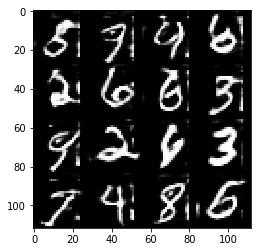

Timestamp 20170806-17-52-05.496 -  Epoch 2/2 -  Step 5510 -  D Loss: 1.1682 - G Loss: 1.2726
Timestamp 20170806-17-52-21.918 -  Epoch 2/2 -  Step 5520 -  D Loss: 1.2272 - G Loss: 0.8296
Timestamp 20170806-17-52-38.320 -  Epoch 2/2 -  Step 5530 -  D Loss: 0.7476 - G Loss: 1.1188
Timestamp 20170806-17-52-54.721 -  Epoch 2/2 -  Step 5540 -  D Loss: 0.8033 - G Loss: 1.4211
Timestamp 20170806-17-53-11.119 -  Epoch 2/2 -  Step 5550 -  D Loss: 1.4325 - G Loss: 0.7829
Timestamp 20170806-17-53-27.519 -  Epoch 2/2 -  Step 5560 -  D Loss: 0.8190 - G Loss: 1.5416
Timestamp 20170806-17-53-43.933 -  Epoch 2/2 -  Step 5570 -  D Loss: 0.9034 - G Loss: 1.2338
Timestamp 20170806-17-54-00.354 -  Epoch 2/2 -  Step 5580 -  D Loss: 1.0835 - G Loss: 0.7662
Timestamp 20170806-17-54-16.760 -  Epoch 2/2 -  Step 5590 -  D Loss: 1.1239 - G Loss: 0.9840
Timestamp 20170806-17-54-33.176 -  Epoch 2/2 -  Step 5600 -  D Loss: 1.2857 - G Loss: 0.9832


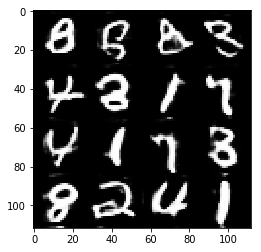

Timestamp 20170806-17-54-50.353 -  Epoch 2/2 -  Step 5610 -  D Loss: 1.5711 - G Loss: 1.2481
Timestamp 20170806-17-55-06.787 -  Epoch 2/2 -  Step 5620 -  D Loss: 0.7738 - G Loss: 1.5770
Timestamp 20170806-17-55-23.196 -  Epoch 2/2 -  Step 5630 -  D Loss: 1.0864 - G Loss: 1.2323
Timestamp 20170806-17-55-39.611 -  Epoch 2/2 -  Step 5640 -  D Loss: 0.8971 - G Loss: 0.7742
Timestamp 20170806-17-55-56.014 -  Epoch 2/2 -  Step 5650 -  D Loss: 0.8487 - G Loss: 1.1804
Timestamp 20170806-17-56-12.441 -  Epoch 2/2 -  Step 5660 -  D Loss: 0.8663 - G Loss: 1.2936
Timestamp 20170806-17-56-28.853 -  Epoch 2/2 -  Step 5670 -  D Loss: 0.9248 - G Loss: 0.8755
Timestamp 20170806-17-56-45.279 -  Epoch 2/2 -  Step 5680 -  D Loss: 1.1491 - G Loss: 1.8676
Timestamp 20170806-17-57-01.704 -  Epoch 2/2 -  Step 5690 -  D Loss: 1.1508 - G Loss: 1.1139
Timestamp 20170806-17-57-18.128 -  Epoch 2/2 -  Step 5700 -  D Loss: 1.1617 - G Loss: 0.7993


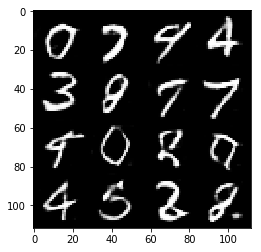

Timestamp 20170806-17-57-35.264 -  Epoch 2/2 -  Step 5710 -  D Loss: 0.9279 - G Loss: 0.9917
Timestamp 20170806-17-57-51.674 -  Epoch 2/2 -  Step 5720 -  D Loss: 1.3973 - G Loss: 1.2529
Timestamp 20170806-17-58-08.102 -  Epoch 2/2 -  Step 5730 -  D Loss: 2.1232 - G Loss: 0.3480
Timestamp 20170806-17-58-24.511 -  Epoch 2/2 -  Step 5740 -  D Loss: 1.0753 - G Loss: 1.4646
Timestamp 20170806-17-58-40.922 -  Epoch 2/2 -  Step 5750 -  D Loss: 1.0165 - G Loss: 0.8141
Timestamp 20170806-17-58-57.330 -  Epoch 2/2 -  Step 5760 -  D Loss: 0.7765 - G Loss: 1.1813
Timestamp 20170806-17-59-13.735 -  Epoch 2/2 -  Step 5770 -  D Loss: 1.0570 - G Loss: 1.2896
Timestamp 20170806-17-59-30.151 -  Epoch 2/2 -  Step 5780 -  D Loss: 0.8851 - G Loss: 0.9929
Timestamp 20170806-17-59-46.570 -  Epoch 2/2 -  Step 5790 -  D Loss: 1.0992 - G Loss: 1.1389
Timestamp 20170806-18-00-02.975 -  Epoch 2/2 -  Step 5800 -  D Loss: 1.2608 - G Loss: 0.7652


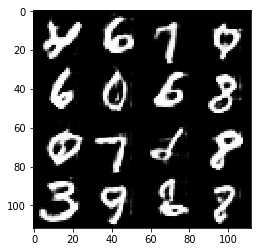

Timestamp 20170806-18-00-20.154 -  Epoch 2/2 -  Step 5810 -  D Loss: 0.7054 - G Loss: 1.6665
Timestamp 20170806-18-00-36.554 -  Epoch 2/2 -  Step 5820 -  D Loss: 0.9581 - G Loss: 0.9623
Timestamp 20170806-18-00-52.963 -  Epoch 2/2 -  Step 5830 -  D Loss: 1.0142 - G Loss: 0.5142
Timestamp 20170806-18-01-09.362 -  Epoch 2/2 -  Step 5840 -  D Loss: 0.8761 - G Loss: 1.5201
Timestamp 20170806-18-01-25.769 -  Epoch 2/2 -  Step 5850 -  D Loss: 0.9173 - G Loss: 1.3548
Timestamp 20170806-18-01-42.181 -  Epoch 2/2 -  Step 5860 -  D Loss: 0.8282 - G Loss: 1.7971
Timestamp 20170806-18-01-58.589 -  Epoch 2/2 -  Step 5870 -  D Loss: 1.1185 - G Loss: 1.0850
Timestamp 20170806-18-02-14.997 -  Epoch 2/2 -  Step 5880 -  D Loss: 1.1905 - G Loss: 1.0258
Timestamp 20170806-18-02-31.433 -  Epoch 2/2 -  Step 5890 -  D Loss: 0.7620 - G Loss: 1.3692
Timestamp 20170806-18-02-47.840 -  Epoch 2/2 -  Step 5900 -  D Loss: 1.0980 - G Loss: 1.7321


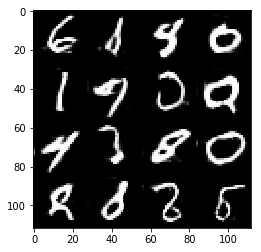

Timestamp 20170806-18-03-05.008 -  Epoch 2/2 -  Step 5910 -  D Loss: 1.3378 - G Loss: 1.0182
Timestamp 20170806-18-03-21.435 -  Epoch 2/2 -  Step 5920 -  D Loss: 0.9912 - G Loss: 1.4937
Timestamp 20170806-18-03-37.844 -  Epoch 2/2 -  Step 5930 -  D Loss: 1.1226 - G Loss: 1.5587
Timestamp 20170806-18-03-54.249 -  Epoch 2/2 -  Step 5940 -  D Loss: 1.2040 - G Loss: 1.5186
Timestamp 20170806-18-04-10.664 -  Epoch 2/2 -  Step 5950 -  D Loss: 1.0700 - G Loss: 1.1326
Timestamp 20170806-18-04-27.089 -  Epoch 2/2 -  Step 5960 -  D Loss: 1.2948 - G Loss: 1.1493
Timestamp 20170806-18-04-43.493 -  Epoch 2/2 -  Step 5970 -  D Loss: 1.1974 - G Loss: 0.9959
Timestamp 20170806-18-04-59.882 -  Epoch 2/2 -  Step 5980 -  D Loss: 1.0769 - G Loss: 1.1690
Timestamp 20170806-18-05-16.296 -  Epoch 2/2 -  Step 5990 -  D Loss: 1.1113 - G Loss: 1.9093
Timestamp 20170806-18-05-32.699 -  Epoch 2/2 -  Step 6000 -  D Loss: 0.8428 - G Loss: 1.1621


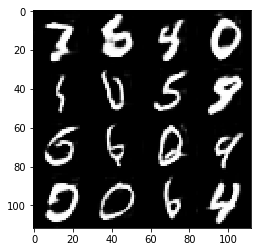

Timestamp 20170806-18-05-49.931 -  Epoch 2/2 -  Step 6010 -  D Loss: 0.8045 - G Loss: 1.7664
Timestamp 20170806-18-06-06.343 -  Epoch 2/2 -  Step 6020 -  D Loss: 1.1237 - G Loss: 0.8963
Timestamp 20170806-18-06-22.747 -  Epoch 2/2 -  Step 6030 -  D Loss: 0.8146 - G Loss: 1.4157
Timestamp 20170806-18-06-39.136 -  Epoch 2/2 -  Step 6040 -  D Loss: 1.1115 - G Loss: 1.1728
Timestamp 20170806-18-06-55.538 -  Epoch 2/2 -  Step 6050 -  D Loss: 0.9357 - G Loss: 1.6940
Timestamp 20170806-18-07-11.963 -  Epoch 2/2 -  Step 6060 -  D Loss: 1.0798 - G Loss: 1.2279
Timestamp 20170806-18-07-28.395 -  Epoch 2/2 -  Step 6070 -  D Loss: 1.2498 - G Loss: 1.0117
Timestamp 20170806-18-07-44.791 -  Epoch 2/2 -  Step 6080 -  D Loss: 0.9484 - G Loss: 1.4060
Timestamp 20170806-18-08-01.197 -  Epoch 2/2 -  Step 6090 -  D Loss: 0.9284 - G Loss: 1.3922
Timestamp 20170806-18-08-17.596 -  Epoch 2/2 -  Step 6100 -  D Loss: 0.8116 - G Loss: 1.2194


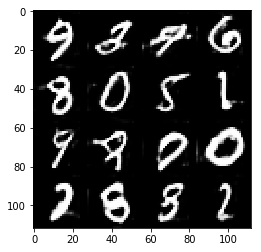

Timestamp 20170806-18-08-34.730 -  Epoch 2/2 -  Step 6110 -  D Loss: 0.9835 - G Loss: 1.9276
Timestamp 20170806-18-08-51.124 -  Epoch 2/2 -  Step 6120 -  D Loss: 1.2063 - G Loss: 1.0408
Timestamp 20170806-18-09-07.528 -  Epoch 2/2 -  Step 6130 -  D Loss: 1.1260 - G Loss: 1.8578
Timestamp 20170806-18-09-23.945 -  Epoch 2/2 -  Step 6140 -  D Loss: 0.8518 - G Loss: 0.8767
Timestamp 20170806-18-09-40.376 -  Epoch 2/2 -  Step 6150 -  D Loss: 1.1784 - G Loss: 1.0695
Timestamp 20170806-18-09-56.796 -  Epoch 2/2 -  Step 6160 -  D Loss: 0.8913 - G Loss: 1.5744
Timestamp 20170806-18-10-13.206 -  Epoch 2/2 -  Step 6170 -  D Loss: 1.0262 - G Loss: 1.7361
Timestamp 20170806-18-10-29.598 -  Epoch 2/2 -  Step 6180 -  D Loss: 1.4742 - G Loss: 0.8327
Timestamp 20170806-18-10-46.014 -  Epoch 2/2 -  Step 6190 -  D Loss: 1.1127 - G Loss: 2.0024
Timestamp 20170806-18-11-02.432 -  Epoch 2/2 -  Step 6200 -  D Loss: 0.8572 - G Loss: 1.7226


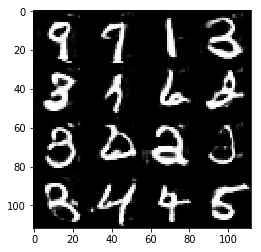

Timestamp 20170806-18-11-19.573 -  Epoch 2/2 -  Step 6210 -  D Loss: 1.0703 - G Loss: 1.0854
Timestamp 20170806-18-11-35.984 -  Epoch 2/2 -  Step 6220 -  D Loss: 1.0979 - G Loss: 1.0809
Timestamp 20170806-18-11-52.391 -  Epoch 2/2 -  Step 6230 -  D Loss: 1.0223 - G Loss: 1.4707
Timestamp 20170806-18-12-08.807 -  Epoch 2/2 -  Step 6240 -  D Loss: 1.1214 - G Loss: 1.0072
Timestamp 20170806-18-12-25.224 -  Epoch 2/2 -  Step 6250 -  D Loss: 0.8048 - G Loss: 1.2777
Timestamp 20170806-18-12-41.621 -  Epoch 2/2 -  Step 6260 -  D Loss: 0.9578 - G Loss: 1.6122
Timestamp 20170806-18-12-58.021 -  Epoch 2/2 -  Step 6270 -  D Loss: 1.1717 - G Loss: 1.0174
Timestamp 20170806-18-13-14.425 -  Epoch 2/2 -  Step 6280 -  D Loss: 0.8016 - G Loss: 1.3370
Timestamp 20170806-18-13-30.837 -  Epoch 2/2 -  Step 6290 -  D Loss: 1.1689 - G Loss: 0.6720
Timestamp 20170806-18-13-47.267 -  Epoch 2/2 -  Step 6300 -  D Loss: 1.0681 - G Loss: 1.4341


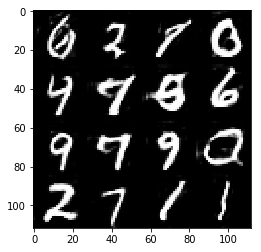

Timestamp 20170806-18-14-04.415 -  Epoch 2/2 -  Step 6310 -  D Loss: 0.9581 - G Loss: 1.1868
Timestamp 20170806-18-14-20.827 -  Epoch 2/2 -  Step 6320 -  D Loss: 0.7887 - G Loss: 1.3714
Timestamp 20170806-18-14-37.233 -  Epoch 2/2 -  Step 6330 -  D Loss: 1.2257 - G Loss: 1.0942
Timestamp 20170806-18-14-53.643 -  Epoch 2/2 -  Step 6340 -  D Loss: 1.3252 - G Loss: 0.6071
Timestamp 20170806-18-15-10.041 -  Epoch 2/2 -  Step 6350 -  D Loss: 0.9514 - G Loss: 1.1593
Timestamp 20170806-18-15-26.447 -  Epoch 2/2 -  Step 6360 -  D Loss: 0.9245 - G Loss: 1.6879
Timestamp 20170806-18-15-42.844 -  Epoch 2/2 -  Step 6370 -  D Loss: 0.8857 - G Loss: 2.0777
Timestamp 20170806-18-15-59.258 -  Epoch 2/2 -  Step 6380 -  D Loss: 0.7334 - G Loss: 1.2331
Timestamp 20170806-18-16-15.670 -  Epoch 2/2 -  Step 6390 -  D Loss: 0.8814 - G Loss: 1.1258
Timestamp 20170806-18-16-32.101 -  Epoch 2/2 -  Step 6400 -  D Loss: 0.8764 - G Loss: 0.7579


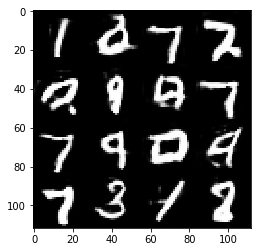

Timestamp 20170806-18-16-49.270 -  Epoch 2/2 -  Step 6410 -  D Loss: 0.7280 - G Loss: 1.1690
Timestamp 20170806-18-17-05.669 -  Epoch 2/2 -  Step 6420 -  D Loss: 0.8394 - G Loss: 1.9342
Timestamp 20170806-18-17-22.073 -  Epoch 2/2 -  Step 6430 -  D Loss: 0.9652 - G Loss: 0.7569
Timestamp 20170806-18-17-38.474 -  Epoch 2/2 -  Step 6440 -  D Loss: 1.0496 - G Loss: 1.1102
Timestamp 20170806-18-17-54.875 -  Epoch 2/2 -  Step 6450 -  D Loss: 1.0424 - G Loss: 2.4203
Timestamp 20170806-18-18-11.269 -  Epoch 2/2 -  Step 6460 -  D Loss: 1.0053 - G Loss: 1.2512
Timestamp 20170806-18-18-27.657 -  Epoch 2/2 -  Step 6470 -  D Loss: 1.2191 - G Loss: 0.4869
Timestamp 20170806-18-18-44.066 -  Epoch 2/2 -  Step 6480 -  D Loss: 1.2357 - G Loss: 2.1882
Timestamp 20170806-18-19-00.492 -  Epoch 2/2 -  Step 6490 -  D Loss: 1.0899 - G Loss: 1.0964
Timestamp 20170806-18-19-16.889 -  Epoch 2/2 -  Step 6500 -  D Loss: 0.7763 - G Loss: 1.3162


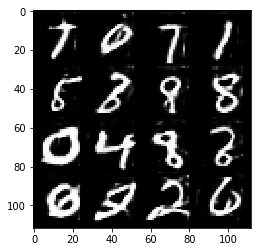

Timestamp 20170806-18-19-34.056 -  Epoch 2/2 -  Step 6510 -  D Loss: 0.6404 - G Loss: 1.3489
Timestamp 20170806-18-19-50.462 -  Epoch 2/2 -  Step 6520 -  D Loss: 0.7738 - G Loss: 1.5012
Timestamp 20170806-18-20-06.876 -  Epoch 2/2 -  Step 6530 -  D Loss: 1.0711 - G Loss: 1.6736
Timestamp 20170806-18-20-23.271 -  Epoch 2/2 -  Step 6540 -  D Loss: 0.9957 - G Loss: 0.8575
Timestamp 20170806-18-20-39.678 -  Epoch 2/2 -  Step 6550 -  D Loss: 0.9410 - G Loss: 1.4292
Timestamp 20170806-18-20-56.117 -  Epoch 2/2 -  Step 6560 -  D Loss: 1.0756 - G Loss: 1.6615
Timestamp 20170806-18-21-12.516 -  Epoch 2/2 -  Step 6570 -  D Loss: 1.5538 - G Loss: 0.7833
Timestamp 20170806-18-21-28.915 -  Epoch 2/2 -  Step 6580 -  D Loss: 1.0548 - G Loss: 0.8584
Timestamp 20170806-18-21-45.330 -  Epoch 2/2 -  Step 6590 -  D Loss: 0.7614 - G Loss: 1.7574
Timestamp 20170806-18-22-01.737 -  Epoch 2/2 -  Step 6600 -  D Loss: 0.9555 - G Loss: 0.9437


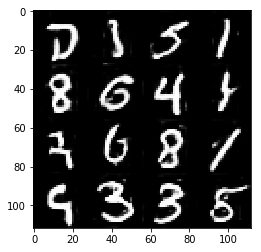

Timestamp 20170806-18-22-18.905 -  Epoch 2/2 -  Step 6610 -  D Loss: 1.1072 - G Loss: 1.1481
Timestamp 20170806-18-22-35.318 -  Epoch 2/2 -  Step 6620 -  D Loss: 1.1073 - G Loss: 1.4217
Timestamp 20170806-18-22-51.725 -  Epoch 2/2 -  Step 6630 -  D Loss: 1.0950 - G Loss: 1.4809
Timestamp 20170806-18-23-08.120 -  Epoch 2/2 -  Step 6640 -  D Loss: 0.7904 - G Loss: 1.4828
Timestamp 20170806-18-23-24.526 -  Epoch 2/2 -  Step 6650 -  D Loss: 0.8809 - G Loss: 1.7587
Timestamp 20170806-18-23-40.930 -  Epoch 2/2 -  Step 6660 -  D Loss: 0.9044 - G Loss: 0.8668
Timestamp 20170806-18-23-57.338 -  Epoch 2/2 -  Step 6670 -  D Loss: 0.8946 - G Loss: 0.9302
Timestamp 20170806-18-24-13.742 -  Epoch 2/2 -  Step 6680 -  D Loss: 0.7761 - G Loss: 2.0355
Timestamp 20170806-18-24-30.156 -  Epoch 2/2 -  Step 6690 -  D Loss: 1.2432 - G Loss: 1.2438
Timestamp 20170806-18-24-46.547 -  Epoch 2/2 -  Step 6700 -  D Loss: 1.4123 - G Loss: 0.5613


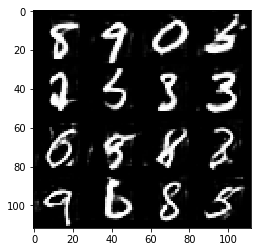

Timestamp 20170806-18-25-03.711 -  Epoch 2/2 -  Step 6710 -  D Loss: 0.8556 - G Loss: 1.8393
Timestamp 20170806-18-25-20.129 -  Epoch 2/2 -  Step 6720 -  D Loss: 0.9889 - G Loss: 1.3660
Timestamp 20170806-18-25-36.543 -  Epoch 2/2 -  Step 6730 -  D Loss: 0.9986 - G Loss: 1.2269
Timestamp 20170806-18-25-52.948 -  Epoch 2/2 -  Step 6740 -  D Loss: 1.1067 - G Loss: 1.3117
Timestamp 20170806-18-26-09.356 -  Epoch 2/2 -  Step 6750 -  D Loss: 0.8528 - G Loss: 1.0178
Timestamp 20170806-18-26-25.774 -  Epoch 2/2 -  Step 6760 -  D Loss: 0.9550 - G Loss: 1.4429
Timestamp 20170806-18-26-42.188 -  Epoch 2/2 -  Step 6770 -  D Loss: 0.9525 - G Loss: 1.3137
Timestamp 20170806-18-26-58.602 -  Epoch 2/2 -  Step 6780 -  D Loss: 0.7822 - G Loss: 1.2813
Timestamp 20170806-18-27-15.017 -  Epoch 2/2 -  Step 6790 -  D Loss: 0.6230 - G Loss: 1.4515
Timestamp 20170806-18-27-31.435 -  Epoch 2/2 -  Step 6800 -  D Loss: 1.0873 - G Loss: 0.8147


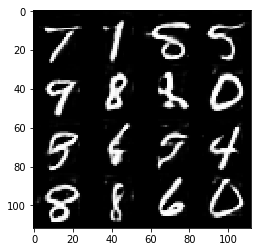

Timestamp 20170806-18-27-48.784 -  Epoch 2/2 -  Step 6810 -  D Loss: 0.7621 - G Loss: 1.3895
Timestamp 20170806-18-28-05.186 -  Epoch 2/2 -  Step 6820 -  D Loss: 1.2964 - G Loss: 1.3123
Timestamp 20170806-18-28-21.593 -  Epoch 2/2 -  Step 6830 -  D Loss: 0.9294 - G Loss: 1.3524
Timestamp 20170806-18-28-38.004 -  Epoch 2/2 -  Step 6840 -  D Loss: 1.2706 - G Loss: 0.7784
Timestamp 20170806-18-28-54.406 -  Epoch 2/2 -  Step 6850 -  D Loss: 1.2450 - G Loss: 0.8661
Timestamp 20170806-18-29-10.831 -  Epoch 2/2 -  Step 6860 -  D Loss: 1.0892 - G Loss: 0.9313
Timestamp 20170806-18-29-27.255 -  Epoch 2/2 -  Step 6870 -  D Loss: 1.3686 - G Loss: 1.2189
Timestamp 20170806-18-29-43.664 -  Epoch 2/2 -  Step 6880 -  D Loss: 0.9006 - G Loss: 1.4671
Timestamp 20170806-18-30-00.075 -  Epoch 2/2 -  Step 6890 -  D Loss: 0.9759 - G Loss: 1.0474
Timestamp 20170806-18-30-16.498 -  Epoch 2/2 -  Step 6900 -  D Loss: 1.0132 - G Loss: 1.4505


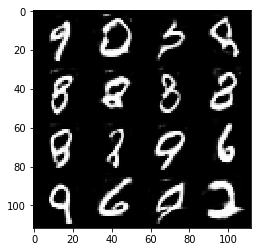

Timestamp 20170806-18-30-33.722 -  Epoch 2/2 -  Step 6910 -  D Loss: 1.1502 - G Loss: 1.6091
Timestamp 20170806-18-30-50.126 -  Epoch 2/2 -  Step 6920 -  D Loss: 0.9906 - G Loss: 1.9410
Timestamp 20170806-18-31-06.547 -  Epoch 2/2 -  Step 6930 -  D Loss: 1.3326 - G Loss: 1.1142
Timestamp 20170806-18-31-22.941 -  Epoch 2/2 -  Step 6940 -  D Loss: 0.9885 - G Loss: 1.9400
Timestamp 20170806-18-31-39.356 -  Epoch 2/2 -  Step 6950 -  D Loss: 1.2081 - G Loss: 1.0737
Timestamp 20170806-18-31-55.763 -  Epoch 2/2 -  Step 6960 -  D Loss: 0.8868 - G Loss: 1.3428
Timestamp 20170806-18-32-12.193 -  Epoch 2/2 -  Step 6970 -  D Loss: 1.0634 - G Loss: 1.0306
Timestamp 20170806-18-32-28.600 -  Epoch 2/2 -  Step 6980 -  D Loss: 1.0429 - G Loss: 1.1276
Timestamp 20170806-18-32-44.992 -  Epoch 2/2 -  Step 6990 -  D Loss: 1.2578 - G Loss: 0.7152
Timestamp 20170806-18-33-01.392 -  Epoch 2/2 -  Step 7000 -  D Loss: 1.1572 - G Loss: 1.0630


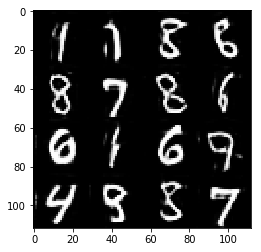

Timestamp 20170806-18-33-18.532 -  Epoch 2/2 -  Step 7010 -  D Loss: 0.9611 - G Loss: 2.1204
Timestamp 20170806-18-33-34.931 -  Epoch 2/2 -  Step 7020 -  D Loss: 0.9792 - G Loss: 1.6035
Timestamp 20170806-18-33-51.375 -  Epoch 2/2 -  Step 7030 -  D Loss: 0.9787 - G Loss: 1.8105
Timestamp 20170806-18-34-07.780 -  Epoch 2/2 -  Step 7040 -  D Loss: 0.9531 - G Loss: 1.8740
Timestamp 20170806-18-34-24.200 -  Epoch 2/2 -  Step 7050 -  D Loss: 0.6123 - G Loss: 1.6432
Timestamp 20170806-18-34-40.605 -  Epoch 2/2 -  Step 7060 -  D Loss: 1.1326 - G Loss: 0.7067
Timestamp 20170806-18-34-57.012 -  Epoch 2/2 -  Step 7070 -  D Loss: 1.3425 - G Loss: 0.8657
Timestamp 20170806-18-35-13.436 -  Epoch 2/2 -  Step 7080 -  D Loss: 0.7775 - G Loss: 1.5189
Timestamp 20170806-18-35-29.853 -  Epoch 2/2 -  Step 7090 -  D Loss: 1.5329 - G Loss: 1.3646
Timestamp 20170806-18-35-46.262 -  Epoch 2/2 -  Step 7100 -  D Loss: 1.1933 - G Loss: 0.7539


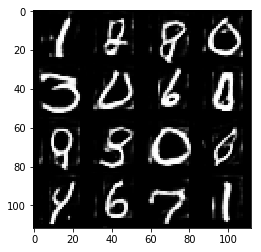

Timestamp 20170806-18-36-03.440 -  Epoch 2/2 -  Step 7110 -  D Loss: 0.9857 - G Loss: 2.4330
Timestamp 20170806-18-36-19.837 -  Epoch 2/2 -  Step 7120 -  D Loss: 0.9999 - G Loss: 1.2588
Timestamp 20170806-18-36-36.235 -  Epoch 2/2 -  Step 7130 -  D Loss: 1.1718 - G Loss: 0.9358
Timestamp 20170806-18-36-52.640 -  Epoch 2/2 -  Step 7140 -  D Loss: 0.8316 - G Loss: 1.3476
Timestamp 20170806-18-37-09.044 -  Epoch 2/2 -  Step 7150 -  D Loss: 0.8657 - G Loss: 1.3696
Timestamp 20170806-18-37-25.452 -  Epoch 2/2 -  Step 7160 -  D Loss: 0.8069 - G Loss: 1.8634
Timestamp 20170806-18-37-41.871 -  Epoch 2/2 -  Step 7170 -  D Loss: 0.6778 - G Loss: 2.1558
Timestamp 20170806-18-37-58.282 -  Epoch 2/2 -  Step 7180 -  D Loss: 1.0770 - G Loss: 1.2526
Timestamp 20170806-18-38-14.686 -  Epoch 2/2 -  Step 7190 -  D Loss: 0.5565 - G Loss: 2.3979
Timestamp 20170806-18-38-31.090 -  Epoch 2/2 -  Step 7200 -  D Loss: 0.7069 - G Loss: 1.6072


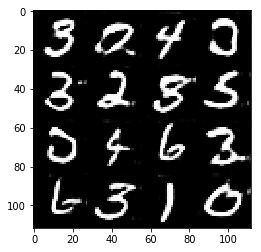

Timestamp 20170806-18-38-48.283 -  Epoch 2/2 -  Step 7210 -  D Loss: 0.7309 - G Loss: 1.7470
Timestamp 20170806-18-39-04.667 -  Epoch 2/2 -  Step 7220 -  D Loss: 0.8264 - G Loss: 1.7161
Timestamp 20170806-18-39-21.072 -  Epoch 2/2 -  Step 7230 -  D Loss: 1.0252 - G Loss: 1.3274
Timestamp 20170806-18-39-37.496 -  Epoch 2/2 -  Step 7240 -  D Loss: 0.8689 - G Loss: 2.0994
Timestamp 20170806-18-39-53.916 -  Epoch 2/2 -  Step 7250 -  D Loss: 0.8934 - G Loss: 1.6005
Timestamp 20170806-18-40-10.331 -  Epoch 2/2 -  Step 7260 -  D Loss: 0.8452 - G Loss: 1.5960
Timestamp 20170806-18-40-26.760 -  Epoch 2/2 -  Step 7270 -  D Loss: 1.1361 - G Loss: 1.1169
Timestamp 20170806-18-40-43.168 -  Epoch 2/2 -  Step 7280 -  D Loss: 1.2911 - G Loss: 1.2712
Timestamp 20170806-18-40-59.577 -  Epoch 2/2 -  Step 7290 -  D Loss: 1.1186 - G Loss: 1.3657
Timestamp 20170806-18-41-16.011 -  Epoch 2/2 -  Step 7300 -  D Loss: 0.8910 - G Loss: 1.5549


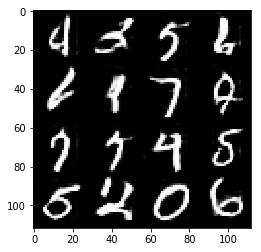

Timestamp 20170806-18-41-33.188 -  Epoch 2/2 -  Step 7310 -  D Loss: 0.9787 - G Loss: 1.4775
Timestamp 20170806-18-41-49.590 -  Epoch 2/2 -  Step 7320 -  D Loss: 1.1354 - G Loss: 1.0494
Timestamp 20170806-18-42-05.997 -  Epoch 2/2 -  Step 7330 -  D Loss: 1.2072 - G Loss: 0.9046
Timestamp 20170806-18-42-22.412 -  Epoch 2/2 -  Step 7340 -  D Loss: 0.7335 - G Loss: 1.3801
Timestamp 20170806-18-42-38.820 -  Epoch 2/2 -  Step 7350 -  D Loss: 0.9266 - G Loss: 1.7978
Timestamp 20170806-18-42-55.227 -  Epoch 2/2 -  Step 7360 -  D Loss: 0.7214 - G Loss: 1.6678
Timestamp 20170806-18-43-11.653 -  Epoch 2/2 -  Step 7370 -  D Loss: 1.0501 - G Loss: 1.3517
Timestamp 20170806-18-43-28.063 -  Epoch 2/2 -  Step 7380 -  D Loss: 1.2151 - G Loss: 1.0430
Timestamp 20170806-18-43-44.485 -  Epoch 2/2 -  Step 7390 -  D Loss: 0.8278 - G Loss: 1.1152
Timestamp 20170806-18-44-00.885 -  Epoch 2/2 -  Step 7400 -  D Loss: 1.1213 - G Loss: 0.8515


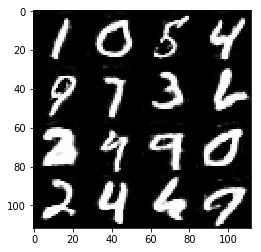

Timestamp 20170806-18-44-18.052 -  Epoch 2/2 -  Step 7410 -  D Loss: 1.3160 - G Loss: 1.5935
Timestamp 20170806-18-44-34.456 -  Epoch 2/2 -  Step 7420 -  D Loss: 0.7322 - G Loss: 1.8310
Timestamp 20170806-18-44-50.878 -  Epoch 2/2 -  Step 7430 -  D Loss: 0.8399 - G Loss: 1.1186
Timestamp 20170806-18-45-07.281 -  Epoch 2/2 -  Step 7440 -  D Loss: 1.2528 - G Loss: 1.4187
Timestamp 20170806-18-45-23.700 -  Epoch 2/2 -  Step 7450 -  D Loss: 1.3174 - G Loss: 1.0373
Timestamp 20170806-18-45-40.118 -  Epoch 2/2 -  Step 7460 -  D Loss: 0.8623 - G Loss: 0.9619
Timestamp 20170806-18-45-56.544 -  Epoch 2/2 -  Step 7470 -  D Loss: 1.1885 - G Loss: 0.4459
Timestamp 20170806-18-46-12.972 -  Epoch 2/2 -  Step 7480 -  D Loss: 1.0451 - G Loss: 1.4817
Timestamp 20170806-18-46-29.385 -  Epoch 2/2 -  Step 7490 -  D Loss: 0.7345 - G Loss: 1.2921
Timestamp 20170806-18-46-45.773 -  Epoch 2/2 -  Step 7500 -  D Loss: 0.6337 - G Loss: 1.5230


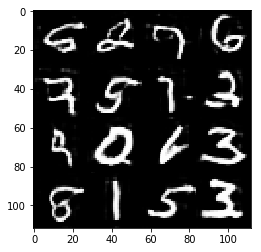

In [18]:
batch_size = 16
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Timestamp 20170805-20-01-37.113 -  Epoch 1/1 -  Step 10 -  D Loss: 1.2554 - G Loss: 1.1563
Timestamp 20170805-20-02-00.672 -  Epoch 1/1 -  Step 20 -  D Loss: 0.9025 - G Loss: 2.2572
Timestamp 20170805-20-02-24.211 -  Epoch 1/1 -  Step 30 -  D Loss: 0.6287 - G Loss: 3.9705
Timestamp 20170805-20-02-47.781 -  Epoch 1/1 -  Step 40 -  D Loss: 0.8469 - G Loss: 5.2232
Timestamp 20170805-20-03-11.295 -  Epoch 1/1 -  Step 50 -  D Loss: 0.8443 - G Loss: 5.5423
Timestamp 20170805-20-03-34.855 -  Epoch 1/1 -  Step 60 -  D Loss: 0.7757 - G Loss: 1.1933
Timestamp 20170805-20-03-58.364 -  Epoch 1/1 -  Step 70 -  D Loss: 0.8121 - G Loss: 1.5073
Timestamp 20170805-20-04-21.908 -  Epoch 1/1 -  Step 80 -  D Loss: 0.5370 - G Loss: 3.8180
Timestamp 20170805-20-04-45.406 -  Epoch 1/1 -  Step 90 -  D Loss: 1.7351 - G Loss: 0.7592
Timestamp 20170805-20-05-08.931 -  Epoch 1/1 -  Step 100 -  D Loss: 0.6156 - G Loss: 4.2430


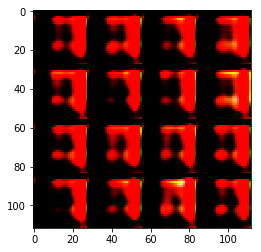

Timestamp 20170805-20-05-38.359 -  Epoch 1/1 -  Step 110 -  D Loss: 0.7066 - G Loss: 1.9523
Timestamp 20170805-20-06-01.867 -  Epoch 1/1 -  Step 120 -  D Loss: 1.9221 - G Loss: 0.4920
Timestamp 20170805-20-06-25.378 -  Epoch 1/1 -  Step 130 -  D Loss: 0.7178 - G Loss: 1.7770
Timestamp 20170805-20-06-48.891 -  Epoch 1/1 -  Step 140 -  D Loss: 1.7880 - G Loss: 1.2182
Timestamp 20170805-20-07-12.405 -  Epoch 1/1 -  Step 150 -  D Loss: 1.1891 - G Loss: 2.0380
Timestamp 20170805-20-07-35.918 -  Epoch 1/1 -  Step 160 -  D Loss: 0.5902 - G Loss: 3.0968
Timestamp 20170805-20-07-59.429 -  Epoch 1/1 -  Step 170 -  D Loss: 0.4528 - G Loss: 3.5085
Timestamp 20170805-20-08-22.938 -  Epoch 1/1 -  Step 180 -  D Loss: 1.1992 - G Loss: 1.5422
Timestamp 20170805-20-08-46.454 -  Epoch 1/1 -  Step 190 -  D Loss: 0.9280 - G Loss: 2.0220
Timestamp 20170805-20-09-09.968 -  Epoch 1/1 -  Step 200 -  D Loss: 2.9793 - G Loss: 0.5708


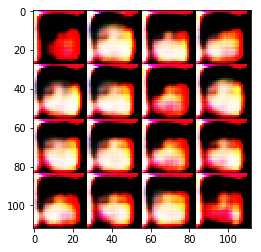

Timestamp 20170805-20-09-34.526 -  Epoch 1/1 -  Step 210 -  D Loss: 0.7018 - G Loss: 2.2072
Timestamp 20170805-20-09-58.034 -  Epoch 1/1 -  Step 220 -  D Loss: 0.4688 - G Loss: 3.6473
Timestamp 20170805-20-10-11.639 -  Epoch 1/1 -  Step 230 -  D Loss: 1.2144 - G Loss: 1.0949
Timestamp 20170805-20-10-23.572 -  Epoch 1/1 -  Step 240 -  D Loss: 0.7973 - G Loss: 2.4812
Timestamp 20170805-20-10-35.517 -  Epoch 1/1 -  Step 250 -  D Loss: 2.4051 - G Loss: 0.5535
Timestamp 20170805-20-10-47.435 -  Epoch 1/1 -  Step 260 -  D Loss: 1.0878 - G Loss: 1.4204
Timestamp 20170805-20-10-59.361 -  Epoch 1/1 -  Step 270 -  D Loss: 1.0537 - G Loss: 1.2385
Timestamp 20170805-20-11-11.310 -  Epoch 1/1 -  Step 280 -  D Loss: 1.3553 - G Loss: 3.0880
Timestamp 20170805-20-11-23.191 -  Epoch 1/1 -  Step 290 -  D Loss: 1.4201 - G Loss: 1.5190
Timestamp 20170805-20-11-35.096 -  Epoch 1/1 -  Step 300 -  D Loss: 1.0643 - G Loss: 0.9634


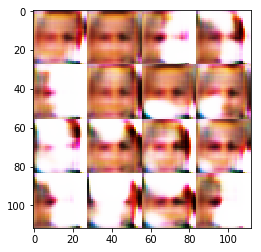

Timestamp 20170805-20-11-47.839 -  Epoch 1/1 -  Step 310 -  D Loss: 1.8670 - G Loss: 0.6469
Timestamp 20170805-20-11-59.748 -  Epoch 1/1 -  Step 320 -  D Loss: 1.4389 - G Loss: 1.0165
Timestamp 20170805-20-12-11.659 -  Epoch 1/1 -  Step 330 -  D Loss: 1.4505 - G Loss: 0.4686
Timestamp 20170805-20-12-23.596 -  Epoch 1/1 -  Step 340 -  D Loss: 0.9922 - G Loss: 2.1894
Timestamp 20170805-20-12-35.499 -  Epoch 1/1 -  Step 350 -  D Loss: 0.9329 - G Loss: 1.2147
Timestamp 20170805-20-12-47.411 -  Epoch 1/1 -  Step 360 -  D Loss: 1.3347 - G Loss: 1.1286
Timestamp 20170805-20-12-59.320 -  Epoch 1/1 -  Step 370 -  D Loss: 1.4106 - G Loss: 1.0294
Timestamp 20170805-20-13-11.225 -  Epoch 1/1 -  Step 380 -  D Loss: 0.6577 - G Loss: 1.5219
Timestamp 20170805-20-13-23.117 -  Epoch 1/1 -  Step 390 -  D Loss: 0.9870 - G Loss: 2.2122
Timestamp 20170805-20-13-35.030 -  Epoch 1/1 -  Step 400 -  D Loss: 1.0732 - G Loss: 2.3355


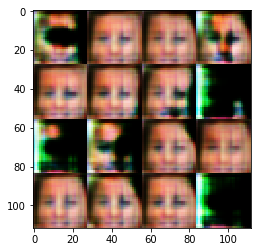

Timestamp 20170805-20-13-47.678 -  Epoch 1/1 -  Step 410 -  D Loss: 1.1106 - G Loss: 1.5170
Timestamp 20170805-20-13-59.589 -  Epoch 1/1 -  Step 420 -  D Loss: 0.9048 - G Loss: 2.1173
Timestamp 20170805-20-14-11.506 -  Epoch 1/1 -  Step 430 -  D Loss: 1.1099 - G Loss: 0.6701
Timestamp 20170805-20-14-23.399 -  Epoch 1/1 -  Step 440 -  D Loss: 1.3614 - G Loss: 3.0794
Timestamp 20170805-20-14-35.278 -  Epoch 1/1 -  Step 450 -  D Loss: 1.3076 - G Loss: 0.7063
Timestamp 20170805-20-14-47.181 -  Epoch 1/1 -  Step 460 -  D Loss: 1.0673 - G Loss: 1.5359
Timestamp 20170805-20-14-59.076 -  Epoch 1/1 -  Step 470 -  D Loss: 0.6384 - G Loss: 1.8397
Timestamp 20170805-20-15-10.964 -  Epoch 1/1 -  Step 480 -  D Loss: 0.5859 - G Loss: 2.5391
Timestamp 20170805-20-15-22.873 -  Epoch 1/1 -  Step 490 -  D Loss: 1.1367 - G Loss: 1.0803
Timestamp 20170805-20-15-34.783 -  Epoch 1/1 -  Step 500 -  D Loss: 0.9679 - G Loss: 1.0890


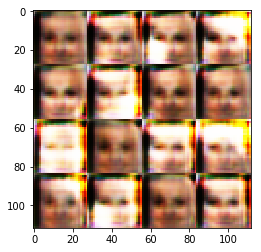

Timestamp 20170805-20-15-47.356 -  Epoch 1/1 -  Step 510 -  D Loss: 0.7404 - G Loss: 2.7417
Timestamp 20170805-20-15-59.256 -  Epoch 1/1 -  Step 520 -  D Loss: 0.9746 - G Loss: 1.9942
Timestamp 20170805-20-16-11.143 -  Epoch 1/1 -  Step 530 -  D Loss: 0.8230 - G Loss: 2.4660
Timestamp 20170805-20-16-23.030 -  Epoch 1/1 -  Step 540 -  D Loss: 0.8569 - G Loss: 1.5539
Timestamp 20170805-20-16-34.943 -  Epoch 1/1 -  Step 550 -  D Loss: 1.1575 - G Loss: 1.7777
Timestamp 20170805-20-16-46.828 -  Epoch 1/1 -  Step 560 -  D Loss: 0.9077 - G Loss: 1.3542
Timestamp 20170805-20-16-58.712 -  Epoch 1/1 -  Step 570 -  D Loss: 0.8227 - G Loss: 1.8265
Timestamp 20170805-20-17-10.621 -  Epoch 1/1 -  Step 580 -  D Loss: 1.6402 - G Loss: 0.6652
Timestamp 20170805-20-17-22.546 -  Epoch 1/1 -  Step 590 -  D Loss: 1.3822 - G Loss: 1.5119
Timestamp 20170805-20-17-34.440 -  Epoch 1/1 -  Step 600 -  D Loss: 1.2602 - G Loss: 1.0395


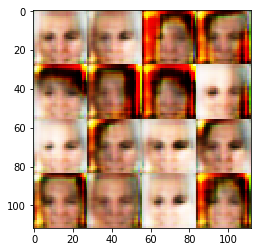

Timestamp 20170805-20-17-47.002 -  Epoch 1/1 -  Step 610 -  D Loss: 0.9136 - G Loss: 1.7258
Timestamp 20170805-20-17-58.879 -  Epoch 1/1 -  Step 620 -  D Loss: 1.0908 - G Loss: 1.2309
Timestamp 20170805-20-18-10.775 -  Epoch 1/1 -  Step 630 -  D Loss: 0.9182 - G Loss: 1.1273
Timestamp 20170805-20-18-22.676 -  Epoch 1/1 -  Step 640 -  D Loss: 0.8470 - G Loss: 1.6454
Timestamp 20170805-20-18-34.576 -  Epoch 1/1 -  Step 650 -  D Loss: 1.1015 - G Loss: 0.8767
Timestamp 20170805-20-18-46.470 -  Epoch 1/1 -  Step 660 -  D Loss: 1.4782 - G Loss: 1.0115
Timestamp 20170805-20-18-58.355 -  Epoch 1/1 -  Step 670 -  D Loss: 0.9653 - G Loss: 1.2330
Timestamp 20170805-20-19-10.256 -  Epoch 1/1 -  Step 680 -  D Loss: 1.0232 - G Loss: 1.1671
Timestamp 20170805-20-19-22.144 -  Epoch 1/1 -  Step 690 -  D Loss: 0.8116 - G Loss: 1.6586
Timestamp 20170805-20-19-34.047 -  Epoch 1/1 -  Step 700 -  D Loss: 1.3664 - G Loss: 0.8403


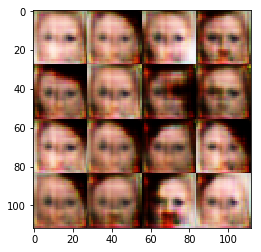

Timestamp 20170805-20-19-46.599 -  Epoch 1/1 -  Step 710 -  D Loss: 1.3560 - G Loss: 0.7816
Timestamp 20170805-20-19-58.488 -  Epoch 1/1 -  Step 720 -  D Loss: 0.9073 - G Loss: 1.6667
Timestamp 20170805-20-20-10.400 -  Epoch 1/1 -  Step 730 -  D Loss: 0.8680 - G Loss: 2.5225
Timestamp 20170805-20-20-22.281 -  Epoch 1/1 -  Step 740 -  D Loss: 1.5982 - G Loss: 0.8684
Timestamp 20170805-20-20-34.174 -  Epoch 1/1 -  Step 750 -  D Loss: 0.8479 - G Loss: 1.7806
Timestamp 20170805-20-20-46.090 -  Epoch 1/1 -  Step 760 -  D Loss: 0.7943 - G Loss: 1.7354
Timestamp 20170805-20-20-57.988 -  Epoch 1/1 -  Step 770 -  D Loss: 1.4838 - G Loss: 0.6000
Timestamp 20170805-20-21-09.873 -  Epoch 1/1 -  Step 780 -  D Loss: 1.7799 - G Loss: 0.5502
Timestamp 20170805-20-21-21.760 -  Epoch 1/1 -  Step 790 -  D Loss: 1.9848 - G Loss: 0.2312
Timestamp 20170805-20-21-33.664 -  Epoch 1/1 -  Step 800 -  D Loss: 1.5083 - G Loss: 0.6142


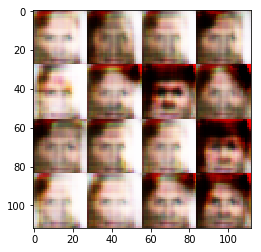

Timestamp 20170805-20-21-46.221 -  Epoch 1/1 -  Step 810 -  D Loss: 1.0728 - G Loss: 1.2273
Timestamp 20170805-20-21-58.117 -  Epoch 1/1 -  Step 820 -  D Loss: 1.1856 - G Loss: 1.1462
Timestamp 20170805-20-22-09.994 -  Epoch 1/1 -  Step 830 -  D Loss: 0.8615 - G Loss: 1.5874
Timestamp 20170805-20-22-21.877 -  Epoch 1/1 -  Step 840 -  D Loss: 0.5632 - G Loss: 2.2496
Timestamp 20170805-20-22-33.769 -  Epoch 1/1 -  Step 850 -  D Loss: 0.9135 - G Loss: 1.4230
Timestamp 20170805-20-22-45.660 -  Epoch 1/1 -  Step 860 -  D Loss: 1.1455 - G Loss: 0.8849
Timestamp 20170805-20-22-57.563 -  Epoch 1/1 -  Step 870 -  D Loss: 0.8219 - G Loss: 0.8537
Timestamp 20170805-20-23-09.461 -  Epoch 1/1 -  Step 880 -  D Loss: 0.8613 - G Loss: 1.4010
Timestamp 20170805-20-23-21.357 -  Epoch 1/1 -  Step 890 -  D Loss: 0.8916 - G Loss: 1.2641
Timestamp 20170805-20-23-33.261 -  Epoch 1/1 -  Step 900 -  D Loss: 0.9766 - G Loss: 0.8713


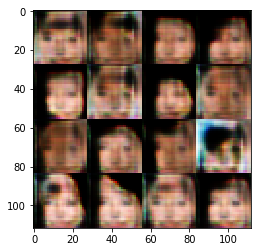

Timestamp 20170805-20-23-45.821 -  Epoch 1/1 -  Step 910 -  D Loss: 1.1104 - G Loss: 0.9317
Timestamp 20170805-20-23-57.722 -  Epoch 1/1 -  Step 920 -  D Loss: 2.0165 - G Loss: 1.7538
Timestamp 20170805-20-24-09.635 -  Epoch 1/1 -  Step 930 -  D Loss: 1.5257 - G Loss: 0.7163
Timestamp 20170805-20-24-21.533 -  Epoch 1/1 -  Step 940 -  D Loss: 0.9352 - G Loss: 0.9658
Timestamp 20170805-20-24-33.424 -  Epoch 1/1 -  Step 950 -  D Loss: 1.1749 - G Loss: 1.0307
Timestamp 20170805-20-24-45.311 -  Epoch 1/1 -  Step 960 -  D Loss: 1.1000 - G Loss: 1.4664
Timestamp 20170805-20-24-57.189 -  Epoch 1/1 -  Step 970 -  D Loss: 1.0843 - G Loss: 1.0299
Timestamp 20170805-20-25-09.063 -  Epoch 1/1 -  Step 980 -  D Loss: 1.2483 - G Loss: 1.5807
Timestamp 20170805-20-25-20.966 -  Epoch 1/1 -  Step 990 -  D Loss: 1.0352 - G Loss: 2.5007
Timestamp 20170805-20-25-32.857 -  Epoch 1/1 -  Step 1000 -  D Loss: 0.9717 - G Loss: 1.5381


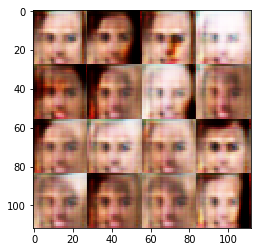

Timestamp 20170805-20-25-45.410 -  Epoch 1/1 -  Step 1010 -  D Loss: 1.0899 - G Loss: 0.9904
Timestamp 20170805-20-25-57.302 -  Epoch 1/1 -  Step 1020 -  D Loss: 1.0882 - G Loss: 1.1497
Timestamp 20170805-20-26-09.188 -  Epoch 1/1 -  Step 1030 -  D Loss: 1.2790 - G Loss: 1.4471
Timestamp 20170805-20-26-21.088 -  Epoch 1/1 -  Step 1040 -  D Loss: 1.0962 - G Loss: 0.8832
Timestamp 20170805-20-26-32.985 -  Epoch 1/1 -  Step 1050 -  D Loss: 1.5647 - G Loss: 0.6434
Timestamp 20170805-20-26-44.875 -  Epoch 1/1 -  Step 1060 -  D Loss: 0.9458 - G Loss: 2.1334
Timestamp 20170805-20-26-56.789 -  Epoch 1/1 -  Step 1070 -  D Loss: 1.0570 - G Loss: 2.8333
Timestamp 20170805-20-27-08.671 -  Epoch 1/1 -  Step 1080 -  D Loss: 0.7327 - G Loss: 1.5364
Timestamp 20170805-20-27-20.536 -  Epoch 1/1 -  Step 1090 -  D Loss: 1.0442 - G Loss: 0.7674
Timestamp 20170805-20-27-32.414 -  Epoch 1/1 -  Step 1100 -  D Loss: 0.8163 - G Loss: 1.4574


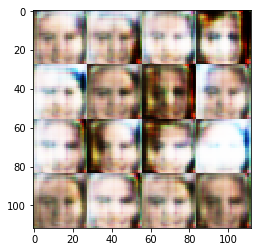

Timestamp 20170805-20-27-44.972 -  Epoch 1/1 -  Step 1110 -  D Loss: 0.4860 - G Loss: 3.1316
Timestamp 20170805-20-27-56.876 -  Epoch 1/1 -  Step 1120 -  D Loss: 0.9536 - G Loss: 1.2855
Timestamp 20170805-20-28-08.758 -  Epoch 1/1 -  Step 1130 -  D Loss: 0.5632 - G Loss: 1.9146
Timestamp 20170805-20-28-20.630 -  Epoch 1/1 -  Step 1140 -  D Loss: 0.9359 - G Loss: 1.0198
Timestamp 20170805-20-28-32.521 -  Epoch 1/1 -  Step 1150 -  D Loss: 0.7494 - G Loss: 2.7720
Timestamp 20170805-20-28-44.410 -  Epoch 1/1 -  Step 1160 -  D Loss: 0.6442 - G Loss: 2.0179
Timestamp 20170805-20-28-56.306 -  Epoch 1/1 -  Step 1170 -  D Loss: 1.7304 - G Loss: 1.3865
Timestamp 20170805-20-29-08.187 -  Epoch 1/1 -  Step 1180 -  D Loss: 0.6753 - G Loss: 1.4860
Timestamp 20170805-20-29-20.080 -  Epoch 1/1 -  Step 1190 -  D Loss: 1.0909 - G Loss: 1.2464
Timestamp 20170805-20-29-31.966 -  Epoch 1/1 -  Step 1200 -  D Loss: 1.0302 - G Loss: 1.3548


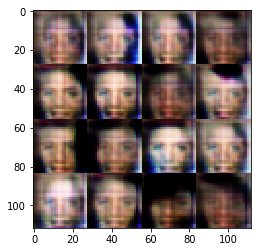

Timestamp 20170805-20-29-44.494 -  Epoch 1/1 -  Step 1210 -  D Loss: 0.7169 - G Loss: 1.3716
Timestamp 20170805-20-29-56.379 -  Epoch 1/1 -  Step 1220 -  D Loss: 0.8979 - G Loss: 1.1402
Timestamp 20170805-20-30-08.281 -  Epoch 1/1 -  Step 1230 -  D Loss: 0.8214 - G Loss: 1.6827
Timestamp 20170805-20-30-20.182 -  Epoch 1/1 -  Step 1240 -  D Loss: 1.5279 - G Loss: 1.2971
Timestamp 20170805-20-30-32.087 -  Epoch 1/1 -  Step 1250 -  D Loss: 0.8364 - G Loss: 1.3950
Timestamp 20170805-20-30-43.977 -  Epoch 1/1 -  Step 1260 -  D Loss: 0.6274 - G Loss: 2.0982
Timestamp 20170805-20-30-55.864 -  Epoch 1/1 -  Step 1270 -  D Loss: 0.6774 - G Loss: 1.8516
Timestamp 20170805-20-31-07.764 -  Epoch 1/1 -  Step 1280 -  D Loss: 0.5808 - G Loss: 2.2909
Timestamp 20170805-20-31-19.652 -  Epoch 1/1 -  Step 1290 -  D Loss: 0.5640 - G Loss: 1.5470
Timestamp 20170805-20-31-31.557 -  Epoch 1/1 -  Step 1300 -  D Loss: 1.1655 - G Loss: 2.0516


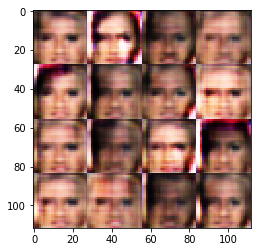

Timestamp 20170805-20-31-44.087 -  Epoch 1/1 -  Step 1310 -  D Loss: 0.9682 - G Loss: 0.8564
Timestamp 20170805-20-31-55.972 -  Epoch 1/1 -  Step 1320 -  D Loss: 0.7542 - G Loss: 1.2723
Timestamp 20170805-20-32-07.853 -  Epoch 1/1 -  Step 1330 -  D Loss: 1.0450 - G Loss: 1.7429
Timestamp 20170805-20-32-19.741 -  Epoch 1/1 -  Step 1340 -  D Loss: 1.3066 - G Loss: 0.6282
Timestamp 20170805-20-32-31.631 -  Epoch 1/1 -  Step 1350 -  D Loss: 0.7472 - G Loss: 1.3261
Timestamp 20170805-20-32-43.523 -  Epoch 1/1 -  Step 1360 -  D Loss: 0.8211 - G Loss: 1.8013
Timestamp 20170805-20-32-55.412 -  Epoch 1/1 -  Step 1370 -  D Loss: 1.0407 - G Loss: 1.2032
Timestamp 20170805-20-33-07.307 -  Epoch 1/1 -  Step 1380 -  D Loss: 0.7589 - G Loss: 1.9048
Timestamp 20170805-20-33-19.179 -  Epoch 1/1 -  Step 1390 -  D Loss: 1.3659 - G Loss: 2.0013
Timestamp 20170805-20-33-31.061 -  Epoch 1/1 -  Step 1400 -  D Loss: 0.9262 - G Loss: 1.6107


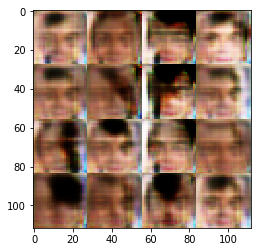

Timestamp 20170805-20-33-43.610 -  Epoch 1/1 -  Step 1410 -  D Loss: 1.7194 - G Loss: 0.8797
Timestamp 20170805-20-33-55.540 -  Epoch 1/1 -  Step 1420 -  D Loss: 1.1372 - G Loss: 0.9210
Timestamp 20170805-20-34-07.464 -  Epoch 1/1 -  Step 1430 -  D Loss: 0.7302 - G Loss: 1.4091
Timestamp 20170805-20-34-19.387 -  Epoch 1/1 -  Step 1440 -  D Loss: 1.4270 - G Loss: 0.7645
Timestamp 20170805-20-34-31.318 -  Epoch 1/1 -  Step 1450 -  D Loss: 1.4391 - G Loss: 1.3450
Timestamp 20170805-20-34-43.256 -  Epoch 1/1 -  Step 1460 -  D Loss: 1.0400 - G Loss: 1.2690
Timestamp 20170805-20-34-55.146 -  Epoch 1/1 -  Step 1470 -  D Loss: 0.8597 - G Loss: 1.2685
Timestamp 20170805-20-35-07.042 -  Epoch 1/1 -  Step 1480 -  D Loss: 0.5356 - G Loss: 2.5747
Timestamp 20170805-20-35-18.971 -  Epoch 1/1 -  Step 1490 -  D Loss: 1.2842 - G Loss: 0.7097
Timestamp 20170805-20-35-30.869 -  Epoch 1/1 -  Step 1500 -  D Loss: 1.4545 - G Loss: 2.2344


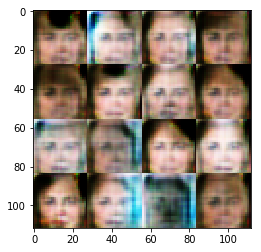

Timestamp 20170805-20-35-43.492 -  Epoch 1/1 -  Step 1510 -  D Loss: 0.5879 - G Loss: 1.3891
Timestamp 20170805-20-35-55.405 -  Epoch 1/1 -  Step 1520 -  D Loss: 1.2101 - G Loss: 0.9137
Timestamp 20170805-20-36-07.296 -  Epoch 1/1 -  Step 1530 -  D Loss: 1.1443 - G Loss: 0.9104
Timestamp 20170805-20-36-19.189 -  Epoch 1/1 -  Step 1540 -  D Loss: 1.3884 - G Loss: 0.5058
Timestamp 20170805-20-36-31.062 -  Epoch 1/1 -  Step 1550 -  D Loss: 0.8298 - G Loss: 1.9790
Timestamp 20170805-20-36-42.937 -  Epoch 1/1 -  Step 1560 -  D Loss: 0.9458 - G Loss: 1.6963
Timestamp 20170805-20-36-54.824 -  Epoch 1/1 -  Step 1570 -  D Loss: 1.5040 - G Loss: 1.2581
Timestamp 20170805-20-37-06.727 -  Epoch 1/1 -  Step 1580 -  D Loss: 1.1809 - G Loss: 1.0802
Timestamp 20170805-20-37-18.615 -  Epoch 1/1 -  Step 1590 -  D Loss: 1.8130 - G Loss: 0.3688
Timestamp 20170805-20-37-30.501 -  Epoch 1/1 -  Step 1600 -  D Loss: 0.6288 - G Loss: 2.1940


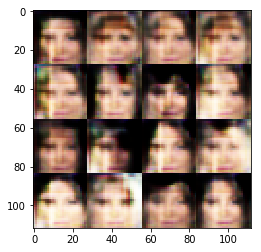

Timestamp 20170805-20-37-43.040 -  Epoch 1/1 -  Step 1610 -  D Loss: 1.7425 - G Loss: 0.3382
Timestamp 20170805-20-37-54.940 -  Epoch 1/1 -  Step 1620 -  D Loss: 0.8816 - G Loss: 1.6947
Timestamp 20170805-20-38-06.827 -  Epoch 1/1 -  Step 1630 -  D Loss: 1.1723 - G Loss: 1.1518
Timestamp 20170805-20-38-18.709 -  Epoch 1/1 -  Step 1640 -  D Loss: 0.7282 - G Loss: 1.8585
Timestamp 20170805-20-38-30.570 -  Epoch 1/1 -  Step 1650 -  D Loss: 0.9368 - G Loss: 1.5748
Timestamp 20170805-20-38-42.469 -  Epoch 1/1 -  Step 1660 -  D Loss: 1.2419 - G Loss: 0.9954
Timestamp 20170805-20-38-54.348 -  Epoch 1/1 -  Step 1670 -  D Loss: 0.7795 - G Loss: 1.8101
Timestamp 20170805-20-39-06.241 -  Epoch 1/1 -  Step 1680 -  D Loss: 0.6788 - G Loss: 1.8287
Timestamp 20170805-20-39-18.145 -  Epoch 1/1 -  Step 1690 -  D Loss: 1.2810 - G Loss: 1.0822
Timestamp 20170805-20-39-30.045 -  Epoch 1/1 -  Step 1700 -  D Loss: 0.8924 - G Loss: 1.7779


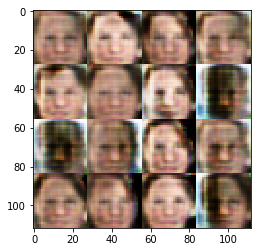

Timestamp 20170805-20-39-42.573 -  Epoch 1/1 -  Step 1710 -  D Loss: 0.6105 - G Loss: 2.9971
Timestamp 20170805-20-39-54.456 -  Epoch 1/1 -  Step 1720 -  D Loss: 0.6129 - G Loss: 2.0455
Timestamp 20170805-20-40-06.344 -  Epoch 1/1 -  Step 1730 -  D Loss: 1.3496 - G Loss: 0.3909
Timestamp 20170805-20-40-18.246 -  Epoch 1/1 -  Step 1740 -  D Loss: 0.7594 - G Loss: 1.8895
Timestamp 20170805-20-40-30.138 -  Epoch 1/1 -  Step 1750 -  D Loss: 0.6876 - G Loss: 1.2121
Timestamp 20170805-20-40-42.030 -  Epoch 1/1 -  Step 1760 -  D Loss: 0.8276 - G Loss: 1.3608
Timestamp 20170805-20-40-53.924 -  Epoch 1/1 -  Step 1770 -  D Loss: 0.7310 - G Loss: 4.2141
Timestamp 20170805-20-41-05.822 -  Epoch 1/1 -  Step 1780 -  D Loss: 0.7525 - G Loss: 2.1347
Timestamp 20170805-20-41-17.706 -  Epoch 1/1 -  Step 1790 -  D Loss: 0.9786 - G Loss: 0.9995
Timestamp 20170805-20-41-29.593 -  Epoch 1/1 -  Step 1800 -  D Loss: 1.0366 - G Loss: 1.2567


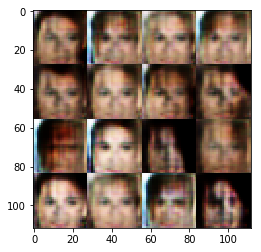

Timestamp 20170805-20-41-42.177 -  Epoch 1/1 -  Step 1810 -  D Loss: 1.1911 - G Loss: 1.0279
Timestamp 20170805-20-41-54.052 -  Epoch 1/1 -  Step 1820 -  D Loss: 0.7210 - G Loss: 1.1685
Timestamp 20170805-20-42-05.944 -  Epoch 1/1 -  Step 1830 -  D Loss: 1.5498 - G Loss: 0.8197
Timestamp 20170805-20-42-17.838 -  Epoch 1/1 -  Step 1840 -  D Loss: 0.6287 - G Loss: 2.0106
Timestamp 20170805-20-42-29.720 -  Epoch 1/1 -  Step 1850 -  D Loss: 0.9407 - G Loss: 1.4267
Timestamp 20170805-20-42-41.607 -  Epoch 1/1 -  Step 1860 -  D Loss: 1.7957 - G Loss: 0.4889
Timestamp 20170805-20-42-53.489 -  Epoch 1/1 -  Step 1870 -  D Loss: 1.2407 - G Loss: 0.8935
Timestamp 20170805-20-43-05.382 -  Epoch 1/1 -  Step 1880 -  D Loss: 1.3574 - G Loss: 0.4901
Timestamp 20170805-20-43-17.265 -  Epoch 1/1 -  Step 1890 -  D Loss: 1.2682 - G Loss: 2.0085
Timestamp 20170805-20-43-29.150 -  Epoch 1/1 -  Step 1900 -  D Loss: 0.7907 - G Loss: 1.4565


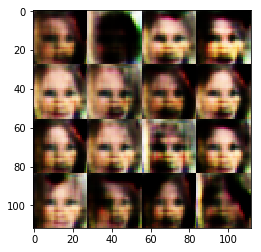

Timestamp 20170805-20-43-41.709 -  Epoch 1/1 -  Step 1910 -  D Loss: 0.8801 - G Loss: 2.3485
Timestamp 20170805-20-43-53.601 -  Epoch 1/1 -  Step 1920 -  D Loss: 1.1405 - G Loss: 0.7274
Timestamp 20170805-20-44-05.480 -  Epoch 1/1 -  Step 1930 -  D Loss: 0.9355 - G Loss: 1.3221
Timestamp 20170805-20-44-17.354 -  Epoch 1/1 -  Step 1940 -  D Loss: 1.1619 - G Loss: 0.9592
Timestamp 20170805-20-44-29.225 -  Epoch 1/1 -  Step 1950 -  D Loss: 1.4933 - G Loss: 0.7824
Timestamp 20170805-20-44-41.124 -  Epoch 1/1 -  Step 1960 -  D Loss: 1.5812 - G Loss: 0.4521
Timestamp 20170805-20-44-53.006 -  Epoch 1/1 -  Step 1970 -  D Loss: 1.5593 - G Loss: 0.6954
Timestamp 20170805-20-45-04.904 -  Epoch 1/1 -  Step 1980 -  D Loss: 1.4022 - G Loss: 1.6882
Timestamp 20170805-20-45-16.786 -  Epoch 1/1 -  Step 1990 -  D Loss: 0.8301 - G Loss: 1.2692
Timestamp 20170805-20-45-28.677 -  Epoch 1/1 -  Step 2000 -  D Loss: 1.0539 - G Loss: 1.1147


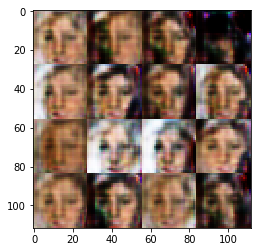

Timestamp 20170805-20-45-41.233 -  Epoch 1/1 -  Step 2010 -  D Loss: 0.8902 - G Loss: 1.2729
Timestamp 20170805-20-45-53.129 -  Epoch 1/1 -  Step 2020 -  D Loss: 0.5198 - G Loss: 2.6005
Timestamp 20170805-20-46-05.004 -  Epoch 1/1 -  Step 2030 -  D Loss: 0.8626 - G Loss: 1.5258
Timestamp 20170805-20-46-16.879 -  Epoch 1/1 -  Step 2040 -  D Loss: 0.9833 - G Loss: 1.2122
Timestamp 20170805-20-46-28.733 -  Epoch 1/1 -  Step 2050 -  D Loss: 1.3244 - G Loss: 1.0442
Timestamp 20170805-20-46-40.627 -  Epoch 1/1 -  Step 2060 -  D Loss: 0.8015 - G Loss: 1.9610
Timestamp 20170805-20-46-52.519 -  Epoch 1/1 -  Step 2070 -  D Loss: 0.9257 - G Loss: 1.2803
Timestamp 20170805-20-47-04.399 -  Epoch 1/1 -  Step 2080 -  D Loss: 1.2617 - G Loss: 0.6038
Timestamp 20170805-20-47-16.288 -  Epoch 1/1 -  Step 2090 -  D Loss: 1.2676 - G Loss: 0.7685
Timestamp 20170805-20-47-28.172 -  Epoch 1/1 -  Step 2100 -  D Loss: 0.9048 - G Loss: 2.3768


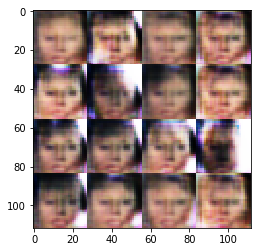

Timestamp 20170805-20-47-40.732 -  Epoch 1/1 -  Step 2110 -  D Loss: 0.7924 - G Loss: 1.3805
Timestamp 20170805-20-47-52.600 -  Epoch 1/1 -  Step 2120 -  D Loss: 1.0691 - G Loss: 0.5671
Timestamp 20170805-20-48-04.484 -  Epoch 1/1 -  Step 2130 -  D Loss: 0.7283 - G Loss: 2.0692
Timestamp 20170805-20-48-16.376 -  Epoch 1/1 -  Step 2140 -  D Loss: 1.2678 - G Loss: 0.6466
Timestamp 20170805-20-48-28.247 -  Epoch 1/1 -  Step 2150 -  D Loss: 0.8172 - G Loss: 1.4775
Timestamp 20170805-20-48-40.119 -  Epoch 1/1 -  Step 2160 -  D Loss: 0.7039 - G Loss: 1.5395
Timestamp 20170805-20-48-52.047 -  Epoch 1/1 -  Step 2170 -  D Loss: 0.9326 - G Loss: 0.6535
Timestamp 20170805-20-49-03.936 -  Epoch 1/1 -  Step 2180 -  D Loss: 1.4754 - G Loss: 0.7881
Timestamp 20170805-20-49-15.832 -  Epoch 1/1 -  Step 2190 -  D Loss: 1.0952 - G Loss: 1.5200
Timestamp 20170805-20-49-27.730 -  Epoch 1/1 -  Step 2200 -  D Loss: 0.9780 - G Loss: 1.4599


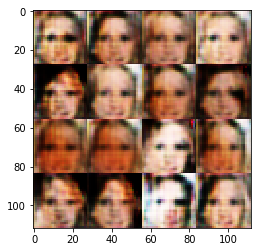

Timestamp 20170805-20-49-40.268 -  Epoch 1/1 -  Step 2210 -  D Loss: 1.3584 - G Loss: 0.5394
Timestamp 20170805-20-49-52.169 -  Epoch 1/1 -  Step 2220 -  D Loss: 1.3854 - G Loss: 1.1864
Timestamp 20170805-20-50-04.052 -  Epoch 1/1 -  Step 2230 -  D Loss: 0.7119 - G Loss: 1.2979
Timestamp 20170805-20-50-15.943 -  Epoch 1/1 -  Step 2240 -  D Loss: 0.6741 - G Loss: 1.5971
Timestamp 20170805-20-50-27.836 -  Epoch 1/1 -  Step 2250 -  D Loss: 1.2826 - G Loss: 1.5318
Timestamp 20170805-20-50-39.714 -  Epoch 1/1 -  Step 2260 -  D Loss: 1.1734 - G Loss: 1.4275
Timestamp 20170805-20-50-51.586 -  Epoch 1/1 -  Step 2270 -  D Loss: 0.7507 - G Loss: 1.4261
Timestamp 20170805-20-51-03.475 -  Epoch 1/1 -  Step 2280 -  D Loss: 0.6926 - G Loss: 1.3290
Timestamp 20170805-20-51-15.329 -  Epoch 1/1 -  Step 2290 -  D Loss: 1.0043 - G Loss: 1.0485
Timestamp 20170805-20-51-27.215 -  Epoch 1/1 -  Step 2300 -  D Loss: 1.1519 - G Loss: 2.4670


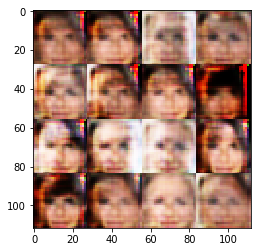

Timestamp 20170805-20-51-39.769 -  Epoch 1/1 -  Step 2310 -  D Loss: 1.0404 - G Loss: 1.3765
Timestamp 20170805-20-51-51.629 -  Epoch 1/1 -  Step 2320 -  D Loss: 0.7271 - G Loss: 1.1698
Timestamp 20170805-20-52-03.508 -  Epoch 1/1 -  Step 2330 -  D Loss: 0.7370 - G Loss: 1.7511
Timestamp 20170805-20-52-15.385 -  Epoch 1/1 -  Step 2340 -  D Loss: 1.4381 - G Loss: 0.4603
Timestamp 20170805-20-52-27.262 -  Epoch 1/1 -  Step 2350 -  D Loss: 1.1031 - G Loss: 0.7955
Timestamp 20170805-20-52-39.147 -  Epoch 1/1 -  Step 2360 -  D Loss: 1.1911 - G Loss: 0.7191
Timestamp 20170805-20-52-51.033 -  Epoch 1/1 -  Step 2370 -  D Loss: 1.0883 - G Loss: 1.0528
Timestamp 20170805-20-53-02.914 -  Epoch 1/1 -  Step 2380 -  D Loss: 1.5224 - G Loss: 0.6456
Timestamp 20170805-20-53-14.778 -  Epoch 1/1 -  Step 2390 -  D Loss: 0.7048 - G Loss: 1.3480
Timestamp 20170805-20-53-26.718 -  Epoch 1/1 -  Step 2400 -  D Loss: 0.9198 - G Loss: 1.5877


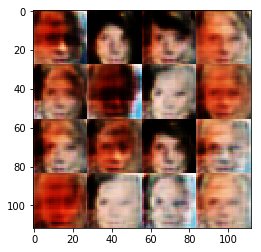

Timestamp 20170805-20-53-39.991 -  Epoch 1/1 -  Step 2410 -  D Loss: 1.3017 - G Loss: 0.8058
Timestamp 20170805-20-53-51.928 -  Epoch 1/1 -  Step 2420 -  D Loss: 1.3842 - G Loss: 0.5802
Timestamp 20170805-20-54-03.848 -  Epoch 1/1 -  Step 2430 -  D Loss: 1.2320 - G Loss: 1.3235
Timestamp 20170805-20-54-15.750 -  Epoch 1/1 -  Step 2440 -  D Loss: 2.0627 - G Loss: 0.4390
Timestamp 20170805-20-54-27.649 -  Epoch 1/1 -  Step 2450 -  D Loss: 1.8795 - G Loss: 0.3078
Timestamp 20170805-20-54-39.547 -  Epoch 1/1 -  Step 2460 -  D Loss: 0.8653 - G Loss: 1.3412
Timestamp 20170805-20-54-51.434 -  Epoch 1/1 -  Step 2470 -  D Loss: 1.2741 - G Loss: 1.4410
Timestamp 20170805-20-55-03.347 -  Epoch 1/1 -  Step 2480 -  D Loss: 1.1297 - G Loss: 0.7368
Timestamp 20170805-20-55-15.256 -  Epoch 1/1 -  Step 2490 -  D Loss: 0.9536 - G Loss: 1.7328
Timestamp 20170805-20-55-27.144 -  Epoch 1/1 -  Step 2500 -  D Loss: 1.3948 - G Loss: 0.7008


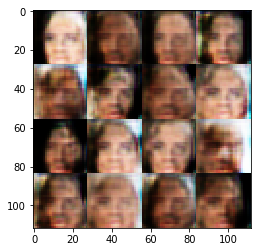

Timestamp 20170805-20-55-39.745 -  Epoch 1/1 -  Step 2510 -  D Loss: 0.9411 - G Loss: 1.0159
Timestamp 20170805-20-55-51.628 -  Epoch 1/1 -  Step 2520 -  D Loss: 0.9916 - G Loss: 2.0707
Timestamp 20170805-20-56-03.520 -  Epoch 1/1 -  Step 2530 -  D Loss: 0.8828 - G Loss: 1.5433
Timestamp 20170805-20-56-15.427 -  Epoch 1/1 -  Step 2540 -  D Loss: 0.6247 - G Loss: 1.8222
Timestamp 20170805-20-56-27.324 -  Epoch 1/1 -  Step 2550 -  D Loss: 0.8916 - G Loss: 1.3443
Timestamp 20170805-20-56-39.226 -  Epoch 1/1 -  Step 2560 -  D Loss: 0.7141 - G Loss: 1.9580
Timestamp 20170805-20-56-51.125 -  Epoch 1/1 -  Step 2570 -  D Loss: 0.8915 - G Loss: 2.0747
Timestamp 20170805-20-57-03.034 -  Epoch 1/1 -  Step 2580 -  D Loss: 1.4586 - G Loss: 0.6908
Timestamp 20170805-20-57-14.946 -  Epoch 1/1 -  Step 2590 -  D Loss: 1.1448 - G Loss: 1.5223
Timestamp 20170805-20-57-26.820 -  Epoch 1/1 -  Step 2600 -  D Loss: 1.0226 - G Loss: 1.8795


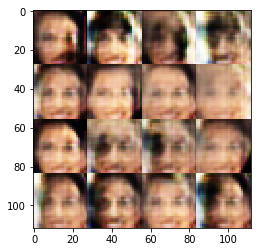

Timestamp 20170805-20-57-39.400 -  Epoch 1/1 -  Step 2610 -  D Loss: 0.7409 - G Loss: 1.6973
Timestamp 20170805-20-57-51.294 -  Epoch 1/1 -  Step 2620 -  D Loss: 0.7223 - G Loss: 1.5709
Timestamp 20170805-20-58-03.200 -  Epoch 1/1 -  Step 2630 -  D Loss: 2.8948 - G Loss: 0.1151
Timestamp 20170805-20-58-15.098 -  Epoch 1/1 -  Step 2640 -  D Loss: 0.8856 - G Loss: 1.5803
Timestamp 20170805-20-58-26.995 -  Epoch 1/1 -  Step 2650 -  D Loss: 1.4462 - G Loss: 0.6733
Timestamp 20170805-20-58-38.891 -  Epoch 1/1 -  Step 2660 -  D Loss: 1.0127 - G Loss: 0.7721
Timestamp 20170805-20-58-50.789 -  Epoch 1/1 -  Step 2670 -  D Loss: 1.3558 - G Loss: 0.7519
Timestamp 20170805-20-59-02.689 -  Epoch 1/1 -  Step 2680 -  D Loss: 1.1581 - G Loss: 0.7610
Timestamp 20170805-20-59-14.604 -  Epoch 1/1 -  Step 2690 -  D Loss: 0.9933 - G Loss: 0.8975
Timestamp 20170805-20-59-26.506 -  Epoch 1/1 -  Step 2700 -  D Loss: 0.8521 - G Loss: 1.5121


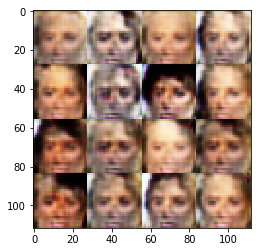

Timestamp 20170805-20-59-39.057 -  Epoch 1/1 -  Step 2710 -  D Loss: 1.1075 - G Loss: 0.8529
Timestamp 20170805-20-59-50.980 -  Epoch 1/1 -  Step 2720 -  D Loss: 0.7472 - G Loss: 3.1396
Timestamp 20170805-21-00-02.887 -  Epoch 1/1 -  Step 2730 -  D Loss: 0.6015 - G Loss: 1.4146
Timestamp 20170805-21-00-14.795 -  Epoch 1/1 -  Step 2740 -  D Loss: 0.6825 - G Loss: 2.6181
Timestamp 20170805-21-00-26.677 -  Epoch 1/1 -  Step 2750 -  D Loss: 0.3570 - G Loss: 3.5731
Timestamp 20170805-21-00-38.578 -  Epoch 1/1 -  Step 2760 -  D Loss: 1.3299 - G Loss: 1.7496
Timestamp 20170805-21-00-50.475 -  Epoch 1/1 -  Step 2770 -  D Loss: 1.8110 - G Loss: 0.6574
Timestamp 20170805-21-01-02.370 -  Epoch 1/1 -  Step 2780 -  D Loss: 1.1409 - G Loss: 1.0429
Timestamp 20170805-21-01-14.262 -  Epoch 1/1 -  Step 2790 -  D Loss: 1.0185 - G Loss: 1.2559
Timestamp 20170805-21-01-26.161 -  Epoch 1/1 -  Step 2800 -  D Loss: 1.1494 - G Loss: 1.0455


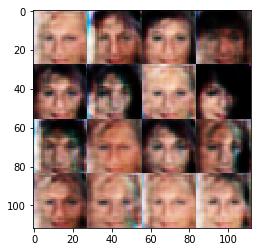

Timestamp 20170805-21-01-38.742 -  Epoch 1/1 -  Step 2810 -  D Loss: 0.7036 - G Loss: 3.0535
Timestamp 20170805-21-01-50.645 -  Epoch 1/1 -  Step 2820 -  D Loss: 1.0558 - G Loss: 1.1156
Timestamp 20170805-21-02-02.521 -  Epoch 1/1 -  Step 2830 -  D Loss: 1.4351 - G Loss: 1.1418
Timestamp 20170805-21-02-14.422 -  Epoch 1/1 -  Step 2840 -  D Loss: 0.6981 - G Loss: 2.5242
Timestamp 20170805-21-02-26.321 -  Epoch 1/1 -  Step 2850 -  D Loss: 1.4409 - G Loss: 1.3451
Timestamp 20170805-21-02-38.206 -  Epoch 1/1 -  Step 2860 -  D Loss: 1.1143 - G Loss: 1.3457
Timestamp 20170805-21-02-50.101 -  Epoch 1/1 -  Step 2870 -  D Loss: 1.4460 - G Loss: 1.6316
Timestamp 20170805-21-03-01.994 -  Epoch 1/1 -  Step 2880 -  D Loss: 1.3343 - G Loss: 1.2957
Timestamp 20170805-21-03-13.887 -  Epoch 1/1 -  Step 2890 -  D Loss: 1.4627 - G Loss: 0.4614
Timestamp 20170805-21-03-25.797 -  Epoch 1/1 -  Step 2900 -  D Loss: 0.7389 - G Loss: 1.7488


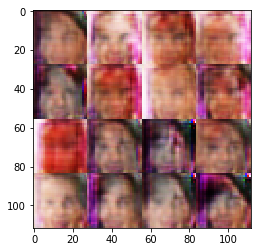

Timestamp 20170805-21-03-38.371 -  Epoch 1/1 -  Step 2910 -  D Loss: 1.6065 - G Loss: 0.7748
Timestamp 20170805-21-03-50.285 -  Epoch 1/1 -  Step 2920 -  D Loss: 1.2536 - G Loss: 0.5001
Timestamp 20170805-21-04-02.170 -  Epoch 1/1 -  Step 2930 -  D Loss: 0.8412 - G Loss: 2.8893
Timestamp 20170805-21-04-14.061 -  Epoch 1/1 -  Step 2940 -  D Loss: 1.8787 - G Loss: 0.6928
Timestamp 20170805-21-04-25.965 -  Epoch 1/1 -  Step 2950 -  D Loss: 1.0773 - G Loss: 1.3531
Timestamp 20170805-21-04-37.839 -  Epoch 1/1 -  Step 2960 -  D Loss: 1.2599 - G Loss: 0.6740
Timestamp 20170805-21-04-49.723 -  Epoch 1/1 -  Step 2970 -  D Loss: 0.9627 - G Loss: 1.2045
Timestamp 20170805-21-05-01.618 -  Epoch 1/1 -  Step 2980 -  D Loss: 1.2101 - G Loss: 1.5403
Timestamp 20170805-21-05-13.510 -  Epoch 1/1 -  Step 2990 -  D Loss: 1.3834 - G Loss: 0.4225
Timestamp 20170805-21-05-25.399 -  Epoch 1/1 -  Step 3000 -  D Loss: 0.8435 - G Loss: 1.0629


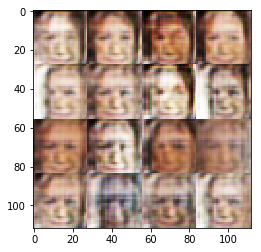

Timestamp 20170805-21-05-37.961 -  Epoch 1/1 -  Step 3010 -  D Loss: 1.3137 - G Loss: 0.7210
Timestamp 20170805-21-05-49.844 -  Epoch 1/1 -  Step 3020 -  D Loss: 1.1309 - G Loss: 1.0693
Timestamp 20170805-21-06-01.731 -  Epoch 1/1 -  Step 3030 -  D Loss: 1.6608 - G Loss: 1.1141
Timestamp 20170805-21-06-13.611 -  Epoch 1/1 -  Step 3040 -  D Loss: 1.1621 - G Loss: 1.0008
Timestamp 20170805-21-06-25.512 -  Epoch 1/1 -  Step 3050 -  D Loss: 1.2017 - G Loss: 0.9585
Timestamp 20170805-21-06-37.395 -  Epoch 1/1 -  Step 3060 -  D Loss: 0.8792 - G Loss: 1.9577
Timestamp 20170805-21-06-49.279 -  Epoch 1/1 -  Step 3070 -  D Loss: 1.0876 - G Loss: 0.9889
Timestamp 20170805-21-07-01.160 -  Epoch 1/1 -  Step 3080 -  D Loss: 1.0772 - G Loss: 1.0018
Timestamp 20170805-21-07-13.040 -  Epoch 1/1 -  Step 3090 -  D Loss: 1.0226 - G Loss: 1.0577
Timestamp 20170805-21-07-24.936 -  Epoch 1/1 -  Step 3100 -  D Loss: 1.3578 - G Loss: 1.7443


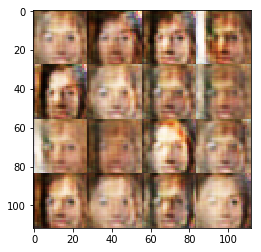

Timestamp 20170805-21-07-37.504 -  Epoch 1/1 -  Step 3110 -  D Loss: 1.0415 - G Loss: 1.2660
Timestamp 20170805-21-07-49.384 -  Epoch 1/1 -  Step 3120 -  D Loss: 1.1339 - G Loss: 1.0715
Timestamp 20170805-21-08-01.274 -  Epoch 1/1 -  Step 3130 -  D Loss: 0.8310 - G Loss: 1.0379
Timestamp 20170805-21-08-13.153 -  Epoch 1/1 -  Step 3140 -  D Loss: 1.5034 - G Loss: 0.6079
Timestamp 20170805-21-08-25.027 -  Epoch 1/1 -  Step 3150 -  D Loss: 1.0808 - G Loss: 1.0398
Timestamp 20170805-21-08-36.916 -  Epoch 1/1 -  Step 3160 -  D Loss: 1.4495 - G Loss: 0.6903
Timestamp 20170805-21-08-48.795 -  Epoch 1/1 -  Step 3170 -  D Loss: 1.0015 - G Loss: 1.0060
Timestamp 20170805-21-09-00.677 -  Epoch 1/1 -  Step 3180 -  D Loss: 0.7939 - G Loss: 1.4217
Timestamp 20170805-21-09-12.564 -  Epoch 1/1 -  Step 3190 -  D Loss: 1.2746 - G Loss: 1.6498
Timestamp 20170805-21-09-24.460 -  Epoch 1/1 -  Step 3200 -  D Loss: 0.9172 - G Loss: 1.2685


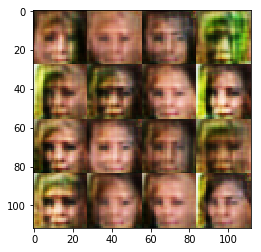

Timestamp 20170805-21-09-37.043 -  Epoch 1/1 -  Step 3210 -  D Loss: 1.5057 - G Loss: 0.5783
Timestamp 20170805-21-09-48.924 -  Epoch 1/1 -  Step 3220 -  D Loss: 0.9895 - G Loss: 1.1577
Timestamp 20170805-21-10-00.817 -  Epoch 1/1 -  Step 3230 -  D Loss: 1.4751 - G Loss: 1.2431
Timestamp 20170805-21-10-12.696 -  Epoch 1/1 -  Step 3240 -  D Loss: 0.9248 - G Loss: 1.2511
Timestamp 20170805-21-10-24.587 -  Epoch 1/1 -  Step 3250 -  D Loss: 1.1835 - G Loss: 0.8260
Timestamp 20170805-21-10-36.478 -  Epoch 1/1 -  Step 3260 -  D Loss: 0.7712 - G Loss: 1.3131
Timestamp 20170805-21-10-48.350 -  Epoch 1/1 -  Step 3270 -  D Loss: 1.2170 - G Loss: 1.1296
Timestamp 20170805-21-11-00.253 -  Epoch 1/1 -  Step 3280 -  D Loss: 0.9933 - G Loss: 1.1874
Timestamp 20170805-21-11-12.144 -  Epoch 1/1 -  Step 3290 -  D Loss: 1.0134 - G Loss: 1.3552
Timestamp 20170805-21-11-24.018 -  Epoch 1/1 -  Step 3300 -  D Loss: 1.2959 - G Loss: 0.9701


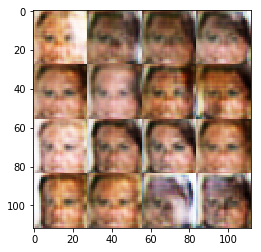

Timestamp 20170805-21-11-36.570 -  Epoch 1/1 -  Step 3310 -  D Loss: 1.2364 - G Loss: 1.2276
Timestamp 20170805-21-11-48.463 -  Epoch 1/1 -  Step 3320 -  D Loss: 1.0687 - G Loss: 1.0462
Timestamp 20170805-21-12-00.354 -  Epoch 1/1 -  Step 3330 -  D Loss: 1.2772 - G Loss: 0.9176
Timestamp 20170805-21-12-12.239 -  Epoch 1/1 -  Step 3340 -  D Loss: 1.0852 - G Loss: 0.9635
Timestamp 20170805-21-12-24.127 -  Epoch 1/1 -  Step 3350 -  D Loss: 1.0307 - G Loss: 1.2859
Timestamp 20170805-21-12-36.022 -  Epoch 1/1 -  Step 3360 -  D Loss: 1.1054 - G Loss: 1.5152
Timestamp 20170805-21-12-47.897 -  Epoch 1/1 -  Step 3370 -  D Loss: 0.8626 - G Loss: 1.3807
Timestamp 20170805-21-12-59.776 -  Epoch 1/1 -  Step 3380 -  D Loss: 0.8539 - G Loss: 0.9058
Timestamp 20170805-21-13-11.682 -  Epoch 1/1 -  Step 3390 -  D Loss: 1.4420 - G Loss: 0.7657
Timestamp 20170805-21-13-23.563 -  Epoch 1/1 -  Step 3400 -  D Loss: 1.7677 - G Loss: 0.4843


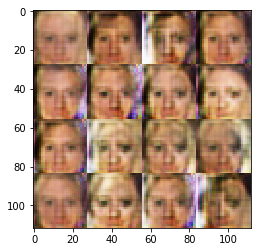

Timestamp 20170805-21-13-36.135 -  Epoch 1/1 -  Step 3410 -  D Loss: 1.1299 - G Loss: 0.9049
Timestamp 20170805-21-13-48.044 -  Epoch 1/1 -  Step 3420 -  D Loss: 1.2837 - G Loss: 1.1156
Timestamp 20170805-21-13-59.934 -  Epoch 1/1 -  Step 3430 -  D Loss: 1.1429 - G Loss: 0.7865
Timestamp 20170805-21-14-11.821 -  Epoch 1/1 -  Step 3440 -  D Loss: 1.0465 - G Loss: 0.8567
Timestamp 20170805-21-14-23.721 -  Epoch 1/1 -  Step 3450 -  D Loss: 1.4642 - G Loss: 1.1294
Timestamp 20170805-21-14-35.609 -  Epoch 1/1 -  Step 3460 -  D Loss: 1.2309 - G Loss: 0.5878
Timestamp 20170805-21-14-47.487 -  Epoch 1/1 -  Step 3470 -  D Loss: 0.9753 - G Loss: 1.3161
Timestamp 20170805-21-14-59.367 -  Epoch 1/1 -  Step 3480 -  D Loss: 1.7396 - G Loss: 0.7232
Timestamp 20170805-21-15-11.256 -  Epoch 1/1 -  Step 3490 -  D Loss: 1.2600 - G Loss: 0.6664
Timestamp 20170805-21-15-23.155 -  Epoch 1/1 -  Step 3500 -  D Loss: 0.9353 - G Loss: 1.5394


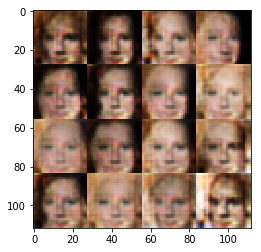

Timestamp 20170805-21-15-35.728 -  Epoch 1/1 -  Step 3510 -  D Loss: 1.2890 - G Loss: 0.8564
Timestamp 20170805-21-15-47.621 -  Epoch 1/1 -  Step 3520 -  D Loss: 1.0545 - G Loss: 1.2314
Timestamp 20170805-21-15-59.501 -  Epoch 1/1 -  Step 3530 -  D Loss: 1.0048 - G Loss: 1.1931
Timestamp 20170805-21-16-11.395 -  Epoch 1/1 -  Step 3540 -  D Loss: 1.3337 - G Loss: 0.6533
Timestamp 20170805-21-16-23.286 -  Epoch 1/1 -  Step 3550 -  D Loss: 1.0684 - G Loss: 1.8248
Timestamp 20170805-21-16-35.183 -  Epoch 1/1 -  Step 3560 -  D Loss: 1.2159 - G Loss: 0.9573
Timestamp 20170805-21-16-47.068 -  Epoch 1/1 -  Step 3570 -  D Loss: 1.0075 - G Loss: 1.3588
Timestamp 20170805-21-16-58.950 -  Epoch 1/1 -  Step 3580 -  D Loss: 1.1843 - G Loss: 1.0007
Timestamp 20170805-21-17-10.841 -  Epoch 1/1 -  Step 3590 -  D Loss: 1.1593 - G Loss: 0.7109
Timestamp 20170805-21-17-22.705 -  Epoch 1/1 -  Step 3600 -  D Loss: 0.8528 - G Loss: 1.4407


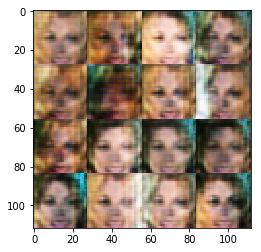

Timestamp 20170805-21-17-35.332 -  Epoch 1/1 -  Step 3610 -  D Loss: 1.0982 - G Loss: 1.0883
Timestamp 20170805-21-17-47.218 -  Epoch 1/1 -  Step 3620 -  D Loss: 1.6998 - G Loss: 1.0918
Timestamp 20170805-21-17-59.095 -  Epoch 1/1 -  Step 3630 -  D Loss: 1.2027 - G Loss: 1.2704
Timestamp 20170805-21-18-10.987 -  Epoch 1/1 -  Step 3640 -  D Loss: 1.0959 - G Loss: 0.9262
Timestamp 20170805-21-18-22.898 -  Epoch 1/1 -  Step 3650 -  D Loss: 1.0129 - G Loss: 0.8392
Timestamp 20170805-21-18-34.783 -  Epoch 1/1 -  Step 3660 -  D Loss: 1.0613 - G Loss: 1.0612
Timestamp 20170805-21-18-46.666 -  Epoch 1/1 -  Step 3670 -  D Loss: 0.7989 - G Loss: 1.3010
Timestamp 20170805-21-18-58.561 -  Epoch 1/1 -  Step 3680 -  D Loss: 1.1258 - G Loss: 1.0564
Timestamp 20170805-21-19-10.459 -  Epoch 1/1 -  Step 3690 -  D Loss: 0.9099 - G Loss: 1.1995
Timestamp 20170805-21-19-22.362 -  Epoch 1/1 -  Step 3700 -  D Loss: 0.9664 - G Loss: 1.1571


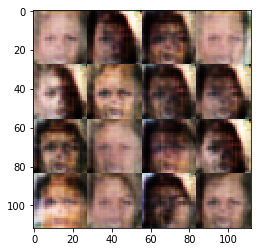

Timestamp 20170805-21-19-34.899 -  Epoch 1/1 -  Step 3710 -  D Loss: 0.8364 - G Loss: 1.3720
Timestamp 20170805-21-19-46.763 -  Epoch 1/1 -  Step 3720 -  D Loss: 0.7952 - G Loss: 1.4599
Timestamp 20170805-21-19-58.671 -  Epoch 1/1 -  Step 3730 -  D Loss: 0.9117 - G Loss: 1.0094
Timestamp 20170805-21-20-10.543 -  Epoch 1/1 -  Step 3740 -  D Loss: 1.3155 - G Loss: 0.4998
Timestamp 20170805-21-20-22.431 -  Epoch 1/1 -  Step 3750 -  D Loss: 0.8417 - G Loss: 2.1628
Timestamp 20170805-21-20-34.300 -  Epoch 1/1 -  Step 3760 -  D Loss: 1.2804 - G Loss: 1.2767
Timestamp 20170805-21-20-46.180 -  Epoch 1/1 -  Step 3770 -  D Loss: 1.2544 - G Loss: 1.2981
Timestamp 20170805-21-20-58.052 -  Epoch 1/1 -  Step 3780 -  D Loss: 0.7853 - G Loss: 2.1021
Timestamp 20170805-21-21-09.939 -  Epoch 1/1 -  Step 3790 -  D Loss: 1.1995 - G Loss: 0.6586
Timestamp 20170805-21-21-21.840 -  Epoch 1/1 -  Step 3800 -  D Loss: 1.2023 - G Loss: 0.8346


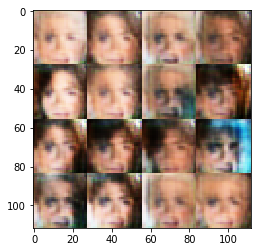

Timestamp 20170805-21-21-34.410 -  Epoch 1/1 -  Step 3810 -  D Loss: 1.4358 - G Loss: 1.3657
Timestamp 20170805-21-21-46.292 -  Epoch 1/1 -  Step 3820 -  D Loss: 0.9344 - G Loss: 1.3642
Timestamp 20170805-21-21-58.180 -  Epoch 1/1 -  Step 3830 -  D Loss: 1.0546 - G Loss: 0.9396
Timestamp 20170805-21-22-10.056 -  Epoch 1/1 -  Step 3840 -  D Loss: 1.3106 - G Loss: 1.0661
Timestamp 20170805-21-22-21.952 -  Epoch 1/1 -  Step 3850 -  D Loss: 0.9852 - G Loss: 1.5019
Timestamp 20170805-21-22-33.826 -  Epoch 1/1 -  Step 3860 -  D Loss: 1.2300 - G Loss: 1.1406
Timestamp 20170805-21-22-45.718 -  Epoch 1/1 -  Step 3870 -  D Loss: 0.8931 - G Loss: 1.6138
Timestamp 20170805-21-22-57.599 -  Epoch 1/1 -  Step 3880 -  D Loss: 0.9800 - G Loss: 0.6428
Timestamp 20170805-21-23-09.493 -  Epoch 1/1 -  Step 3890 -  D Loss: 1.5217 - G Loss: 1.0555
Timestamp 20170805-21-23-21.399 -  Epoch 1/1 -  Step 3900 -  D Loss: 0.5448 - G Loss: 2.3833


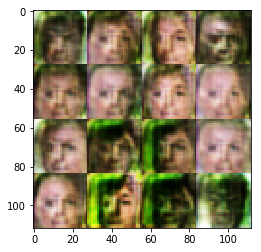

Timestamp 20170805-21-23-33.969 -  Epoch 1/1 -  Step 3910 -  D Loss: 0.9211 - G Loss: 1.6052
Timestamp 20170805-21-23-45.857 -  Epoch 1/1 -  Step 3920 -  D Loss: 0.9631 - G Loss: 1.2320
Timestamp 20170805-21-23-57.747 -  Epoch 1/1 -  Step 3930 -  D Loss: 1.3724 - G Loss: 0.8481
Timestamp 20170805-21-24-09.624 -  Epoch 1/1 -  Step 3940 -  D Loss: 0.9366 - G Loss: 1.1531
Timestamp 20170805-21-24-21.518 -  Epoch 1/1 -  Step 3950 -  D Loss: 0.7750 - G Loss: 1.3297
Timestamp 20170805-21-24-33.395 -  Epoch 1/1 -  Step 3960 -  D Loss: 1.4195 - G Loss: 0.6790
Timestamp 20170805-21-24-45.259 -  Epoch 1/1 -  Step 3970 -  D Loss: 1.0521 - G Loss: 1.3471
Timestamp 20170805-21-24-57.152 -  Epoch 1/1 -  Step 3980 -  D Loss: 1.0699 - G Loss: 0.8524
Timestamp 20170805-21-25-09.031 -  Epoch 1/1 -  Step 3990 -  D Loss: 1.3295 - G Loss: 0.8237
Timestamp 20170805-21-25-20.909 -  Epoch 1/1 -  Step 4000 -  D Loss: 1.2255 - G Loss: 1.1493


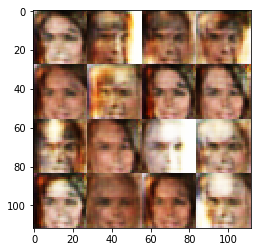

Timestamp 20170805-21-25-33.486 -  Epoch 1/1 -  Step 4010 -  D Loss: 1.2801 - G Loss: 1.1961
Timestamp 20170805-21-25-45.371 -  Epoch 1/1 -  Step 4020 -  D Loss: 0.9823 - G Loss: 1.1484
Timestamp 20170805-21-25-57.269 -  Epoch 1/1 -  Step 4030 -  D Loss: 1.0141 - G Loss: 1.4914
Timestamp 20170805-21-26-09.156 -  Epoch 1/1 -  Step 4040 -  D Loss: 1.4292 - G Loss: 0.7194
Timestamp 20170805-21-26-21.039 -  Epoch 1/1 -  Step 4050 -  D Loss: 0.7454 - G Loss: 1.6039
Timestamp 20170805-21-26-32.926 -  Epoch 1/1 -  Step 4060 -  D Loss: 1.0443 - G Loss: 1.2670
Timestamp 20170805-21-26-44.801 -  Epoch 1/1 -  Step 4070 -  D Loss: 0.9779 - G Loss: 1.4000
Timestamp 20170805-21-26-56.706 -  Epoch 1/1 -  Step 4080 -  D Loss: 0.8762 - G Loss: 1.6320
Timestamp 20170805-21-27-08.583 -  Epoch 1/1 -  Step 4090 -  D Loss: 1.2452 - G Loss: 0.8991
Timestamp 20170805-21-27-20.471 -  Epoch 1/1 -  Step 4100 -  D Loss: 0.8877 - G Loss: 1.3327


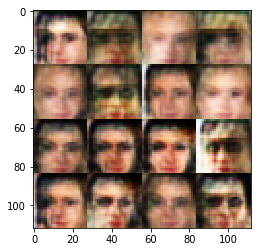

Timestamp 20170805-21-27-33.040 -  Epoch 1/1 -  Step 4110 -  D Loss: 1.0505 - G Loss: 0.8938
Timestamp 20170805-21-27-44.919 -  Epoch 1/1 -  Step 4120 -  D Loss: 0.8123 - G Loss: 1.7376
Timestamp 20170805-21-27-56.789 -  Epoch 1/1 -  Step 4130 -  D Loss: 0.8418 - G Loss: 1.9178
Timestamp 20170805-21-28-08.668 -  Epoch 1/1 -  Step 4140 -  D Loss: 0.9237 - G Loss: 1.7359
Timestamp 20170805-21-28-20.561 -  Epoch 1/1 -  Step 4150 -  D Loss: 0.9638 - G Loss: 1.1898
Timestamp 20170805-21-28-32.442 -  Epoch 1/1 -  Step 4160 -  D Loss: 1.3232 - G Loss: 0.7932
Timestamp 20170805-21-28-44.296 -  Epoch 1/1 -  Step 4170 -  D Loss: 1.3142 - G Loss: 0.6790
Timestamp 20170805-21-28-56.188 -  Epoch 1/1 -  Step 4180 -  D Loss: 1.2176 - G Loss: 1.0781
Timestamp 20170805-21-29-08.066 -  Epoch 1/1 -  Step 4190 -  D Loss: 0.9650 - G Loss: 1.4508
Timestamp 20170805-21-29-19.960 -  Epoch 1/1 -  Step 4200 -  D Loss: 1.0696 - G Loss: 1.2069


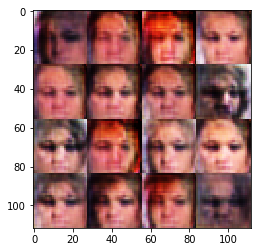

Timestamp 20170805-21-29-32.528 -  Epoch 1/1 -  Step 4210 -  D Loss: 0.8857 - G Loss: 1.0706
Timestamp 20170805-21-29-44.429 -  Epoch 1/1 -  Step 4220 -  D Loss: 0.8756 - G Loss: 1.5997
Timestamp 20170805-21-29-56.319 -  Epoch 1/1 -  Step 4230 -  D Loss: 0.9120 - G Loss: 1.3618
Timestamp 20170805-21-30-08.208 -  Epoch 1/1 -  Step 4240 -  D Loss: 0.9386 - G Loss: 0.9991
Timestamp 20170805-21-30-20.075 -  Epoch 1/1 -  Step 4250 -  D Loss: 0.7901 - G Loss: 1.2934
Timestamp 20170805-21-30-31.949 -  Epoch 1/1 -  Step 4260 -  D Loss: 1.1267 - G Loss: 0.9019
Timestamp 20170805-21-30-43.812 -  Epoch 1/1 -  Step 4270 -  D Loss: 1.5852 - G Loss: 0.7140
Timestamp 20170805-21-30-55.690 -  Epoch 1/1 -  Step 4280 -  D Loss: 1.7426 - G Loss: 0.4215
Timestamp 20170805-21-31-07.574 -  Epoch 1/1 -  Step 4290 -  D Loss: 0.9163 - G Loss: 1.4741
Timestamp 20170805-21-31-19.458 -  Epoch 1/1 -  Step 4300 -  D Loss: 1.2281 - G Loss: 0.8289


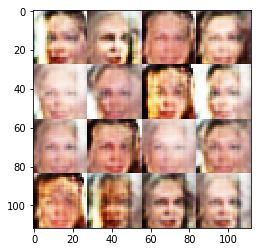

Timestamp 20170805-21-31-32.016 -  Epoch 1/1 -  Step 4310 -  D Loss: 1.2190 - G Loss: 0.6454
Timestamp 20170805-21-31-43.898 -  Epoch 1/1 -  Step 4320 -  D Loss: 1.0773 - G Loss: 0.8877
Timestamp 20170805-21-31-55.785 -  Epoch 1/1 -  Step 4330 -  D Loss: 0.7620 - G Loss: 1.8348
Timestamp 20170805-21-32-07.676 -  Epoch 1/1 -  Step 4340 -  D Loss: 1.3466 - G Loss: 1.3535
Timestamp 20170805-21-32-19.540 -  Epoch 1/1 -  Step 4350 -  D Loss: 1.0723 - G Loss: 0.6753
Timestamp 20170805-21-32-31.441 -  Epoch 1/1 -  Step 4360 -  D Loss: 1.4420 - G Loss: 1.0880
Timestamp 20170805-21-32-43.321 -  Epoch 1/1 -  Step 4370 -  D Loss: 1.1534 - G Loss: 1.1935
Timestamp 20170805-21-32-55.213 -  Epoch 1/1 -  Step 4380 -  D Loss: 1.1211 - G Loss: 1.2755
Timestamp 20170805-21-33-07.104 -  Epoch 1/1 -  Step 4390 -  D Loss: 0.5862 - G Loss: 2.0760
Timestamp 20170805-21-33-18.987 -  Epoch 1/1 -  Step 4400 -  D Loss: 0.8465 - G Loss: 0.9010


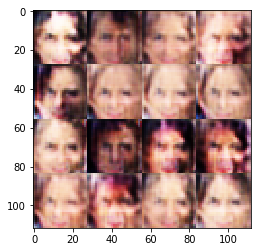

Timestamp 20170805-21-33-31.559 -  Epoch 1/1 -  Step 4410 -  D Loss: 0.8431 - G Loss: 1.6779
Timestamp 20170805-21-33-43.436 -  Epoch 1/1 -  Step 4420 -  D Loss: 1.4065 - G Loss: 0.7898
Timestamp 20170805-21-33-55.305 -  Epoch 1/1 -  Step 4430 -  D Loss: 1.3879 - G Loss: 0.8875
Timestamp 20170805-21-34-07.187 -  Epoch 1/1 -  Step 4440 -  D Loss: 1.1514 - G Loss: 0.9920
Timestamp 20170805-21-34-19.064 -  Epoch 1/1 -  Step 4450 -  D Loss: 1.2014 - G Loss: 0.8149
Timestamp 20170805-21-34-30.935 -  Epoch 1/1 -  Step 4460 -  D Loss: 1.3500 - G Loss: 0.7799
Timestamp 20170805-21-34-42.833 -  Epoch 1/1 -  Step 4470 -  D Loss: 1.5392 - G Loss: 0.8290
Timestamp 20170805-21-34-54.711 -  Epoch 1/1 -  Step 4480 -  D Loss: 1.1605 - G Loss: 1.0861
Timestamp 20170805-21-35-06.590 -  Epoch 1/1 -  Step 4490 -  D Loss: 1.4419 - G Loss: 0.7852
Timestamp 20170805-21-35-18.475 -  Epoch 1/1 -  Step 4500 -  D Loss: 0.8506 - G Loss: 1.1471


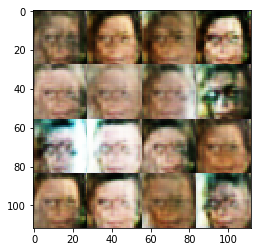

Timestamp 20170805-21-35-31.059 -  Epoch 1/1 -  Step 4510 -  D Loss: 1.1546 - G Loss: 1.6392
Timestamp 20170805-21-35-42.930 -  Epoch 1/1 -  Step 4520 -  D Loss: 1.5681 - G Loss: 0.7972
Timestamp 20170805-21-35-54.823 -  Epoch 1/1 -  Step 4530 -  D Loss: 1.1139 - G Loss: 1.3754
Timestamp 20170805-21-36-06.719 -  Epoch 1/1 -  Step 4540 -  D Loss: 1.4146 - G Loss: 0.5364
Timestamp 20170805-21-36-18.596 -  Epoch 1/1 -  Step 4550 -  D Loss: 1.3259 - G Loss: 0.9602
Timestamp 20170805-21-36-30.486 -  Epoch 1/1 -  Step 4560 -  D Loss: 1.2626 - G Loss: 1.1595
Timestamp 20170805-21-36-42.365 -  Epoch 1/1 -  Step 4570 -  D Loss: 0.8341 - G Loss: 0.9670
Timestamp 20170805-21-36-54.255 -  Epoch 1/1 -  Step 4580 -  D Loss: 1.0565 - G Loss: 1.4522
Timestamp 20170805-21-37-06.141 -  Epoch 1/1 -  Step 4590 -  D Loss: 1.3459 - G Loss: 1.0823
Timestamp 20170805-21-37-18.029 -  Epoch 1/1 -  Step 4600 -  D Loss: 1.4231 - G Loss: 0.7543


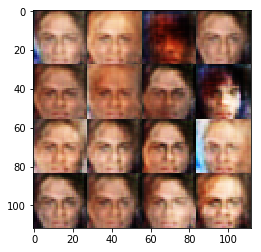

Timestamp 20170805-21-37-30.575 -  Epoch 1/1 -  Step 4610 -  D Loss: 0.9875 - G Loss: 1.2565
Timestamp 20170805-21-37-42.462 -  Epoch 1/1 -  Step 4620 -  D Loss: 1.1583 - G Loss: 1.2062
Timestamp 20170805-21-37-54.351 -  Epoch 1/1 -  Step 4630 -  D Loss: 0.9640 - G Loss: 1.1815
Timestamp 20170805-21-38-06.221 -  Epoch 1/1 -  Step 4640 -  D Loss: 1.2100 - G Loss: 1.5684
Timestamp 20170805-21-38-18.095 -  Epoch 1/1 -  Step 4650 -  D Loss: 1.7052 - G Loss: 1.0731
Timestamp 20170805-21-38-29.973 -  Epoch 1/1 -  Step 4660 -  D Loss: 1.1949 - G Loss: 0.6879
Timestamp 20170805-21-38-41.858 -  Epoch 1/1 -  Step 4670 -  D Loss: 0.9964 - G Loss: 0.9973
Timestamp 20170805-21-38-53.740 -  Epoch 1/1 -  Step 4680 -  D Loss: 1.0755 - G Loss: 0.6728
Timestamp 20170805-21-39-05.615 -  Epoch 1/1 -  Step 4690 -  D Loss: 1.5374 - G Loss: 0.6830
Timestamp 20170805-21-39-17.504 -  Epoch 1/1 -  Step 4700 -  D Loss: 1.3397 - G Loss: 0.9643


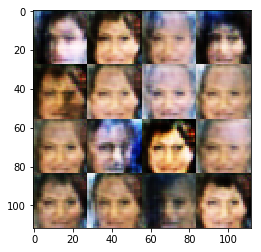

Timestamp 20170805-21-39-30.489 -  Epoch 1/1 -  Step 4710 -  D Loss: 1.1944 - G Loss: 0.9746
Timestamp 20170805-21-39-42.379 -  Epoch 1/1 -  Step 4720 -  D Loss: 1.3364 - G Loss: 1.1093
Timestamp 20170805-21-39-54.264 -  Epoch 1/1 -  Step 4730 -  D Loss: 0.9746 - G Loss: 1.0898
Timestamp 20170805-21-40-06.137 -  Epoch 1/1 -  Step 4740 -  D Loss: 1.0331 - G Loss: 1.0763
Timestamp 20170805-21-40-18.015 -  Epoch 1/1 -  Step 4750 -  D Loss: 1.1391 - G Loss: 0.8903
Timestamp 20170805-21-40-29.890 -  Epoch 1/1 -  Step 4760 -  D Loss: 1.1192 - G Loss: 1.1048
Timestamp 20170805-21-40-41.779 -  Epoch 1/1 -  Step 4770 -  D Loss: 1.2636 - G Loss: 0.7576
Timestamp 20170805-21-40-53.656 -  Epoch 1/1 -  Step 4780 -  D Loss: 0.9009 - G Loss: 1.3843
Timestamp 20170805-21-41-05.544 -  Epoch 1/1 -  Step 4790 -  D Loss: 1.0761 - G Loss: 1.7985
Timestamp 20170805-21-41-17.419 -  Epoch 1/1 -  Step 4800 -  D Loss: 1.0545 - G Loss: 0.9252


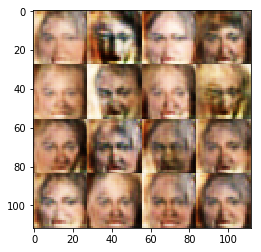

Timestamp 20170805-21-41-30.015 -  Epoch 1/1 -  Step 4810 -  D Loss: 1.4312 - G Loss: 0.7604
Timestamp 20170805-21-41-41.900 -  Epoch 1/1 -  Step 4820 -  D Loss: 1.5384 - G Loss: 1.4151
Timestamp 20170805-21-41-53.790 -  Epoch 1/1 -  Step 4830 -  D Loss: 1.0018 - G Loss: 1.1482
Timestamp 20170805-21-42-05.659 -  Epoch 1/1 -  Step 4840 -  D Loss: 0.7856 - G Loss: 1.3453
Timestamp 20170805-21-42-17.559 -  Epoch 1/1 -  Step 4850 -  D Loss: 0.8970 - G Loss: 1.5205
Timestamp 20170805-21-42-29.442 -  Epoch 1/1 -  Step 4860 -  D Loss: 1.1812 - G Loss: 0.8455
Timestamp 20170805-21-42-41.345 -  Epoch 1/1 -  Step 4870 -  D Loss: 0.7775 - G Loss: 1.7105
Timestamp 20170805-21-42-53.223 -  Epoch 1/1 -  Step 4880 -  D Loss: 0.9011 - G Loss: 0.8551
Timestamp 20170805-21-43-05.103 -  Epoch 1/1 -  Step 4890 -  D Loss: 0.9884 - G Loss: 0.9695
Timestamp 20170805-21-43-16.988 -  Epoch 1/1 -  Step 4900 -  D Loss: 1.4766 - G Loss: 0.7172


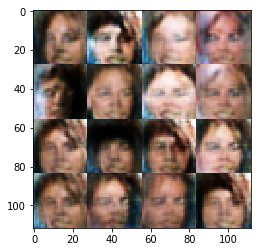

Timestamp 20170805-21-43-29.589 -  Epoch 1/1 -  Step 4910 -  D Loss: 1.2917 - G Loss: 0.9121
Timestamp 20170805-21-43-41.474 -  Epoch 1/1 -  Step 4920 -  D Loss: 1.2343 - G Loss: 1.1941
Timestamp 20170805-21-43-53.356 -  Epoch 1/1 -  Step 4930 -  D Loss: 0.8279 - G Loss: 1.4634
Timestamp 20170805-21-44-05.239 -  Epoch 1/1 -  Step 4940 -  D Loss: 0.8870 - G Loss: 2.1547
Timestamp 20170805-21-44-17.122 -  Epoch 1/1 -  Step 4950 -  D Loss: 1.1068 - G Loss: 1.2310
Timestamp 20170805-21-44-29.016 -  Epoch 1/1 -  Step 4960 -  D Loss: 1.2974 - G Loss: 1.0502
Timestamp 20170805-21-44-40.884 -  Epoch 1/1 -  Step 4970 -  D Loss: 1.2897 - G Loss: 1.1230
Timestamp 20170805-21-44-52.758 -  Epoch 1/1 -  Step 4980 -  D Loss: 1.0596 - G Loss: 1.1853
Timestamp 20170805-21-45-04.644 -  Epoch 1/1 -  Step 4990 -  D Loss: 0.9419 - G Loss: 1.7657
Timestamp 20170805-21-45-16.534 -  Epoch 1/1 -  Step 5000 -  D Loss: 1.6486 - G Loss: 1.3357


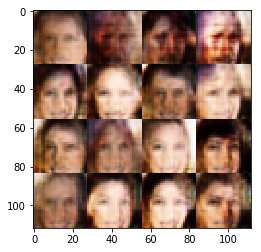

Timestamp 20170805-21-45-29.108 -  Epoch 1/1 -  Step 5010 -  D Loss: 0.9317 - G Loss: 1.2750
Timestamp 20170805-21-45-40.994 -  Epoch 1/1 -  Step 5020 -  D Loss: 1.2938 - G Loss: 0.9222
Timestamp 20170805-21-45-52.914 -  Epoch 1/1 -  Step 5030 -  D Loss: 1.2550 - G Loss: 0.7586
Timestamp 20170805-21-46-04.810 -  Epoch 1/1 -  Step 5040 -  D Loss: 1.1491 - G Loss: 0.6888
Timestamp 20170805-21-46-16.714 -  Epoch 1/1 -  Step 5050 -  D Loss: 1.2243 - G Loss: 0.7503
Timestamp 20170805-21-46-28.622 -  Epoch 1/1 -  Step 5060 -  D Loss: 0.9882 - G Loss: 1.0396
Timestamp 20170805-21-46-40.521 -  Epoch 1/1 -  Step 5070 -  D Loss: 0.9622 - G Loss: 1.1037
Timestamp 20170805-21-46-52.433 -  Epoch 1/1 -  Step 5080 -  D Loss: 0.8357 - G Loss: 1.0699
Timestamp 20170805-21-47-04.323 -  Epoch 1/1 -  Step 5090 -  D Loss: 1.0132 - G Loss: 1.0408
Timestamp 20170805-21-47-16.212 -  Epoch 1/1 -  Step 5100 -  D Loss: 1.5449 - G Loss: 1.1771


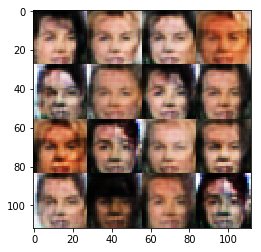

Timestamp 20170805-21-47-28.822 -  Epoch 1/1 -  Step 5110 -  D Loss: 1.2279 - G Loss: 0.6064
Timestamp 20170805-21-47-40.726 -  Epoch 1/1 -  Step 5120 -  D Loss: 0.8623 - G Loss: 1.0145
Timestamp 20170805-21-47-52.637 -  Epoch 1/1 -  Step 5130 -  D Loss: 0.8384 - G Loss: 1.8284
Timestamp 20170805-21-48-04.528 -  Epoch 1/1 -  Step 5140 -  D Loss: 1.0940 - G Loss: 1.0854
Timestamp 20170805-21-48-16.428 -  Epoch 1/1 -  Step 5150 -  D Loss: 1.1352 - G Loss: 1.4920
Timestamp 20170805-21-48-28.326 -  Epoch 1/1 -  Step 5160 -  D Loss: 1.2423 - G Loss: 0.8676
Timestamp 20170805-21-48-40.215 -  Epoch 1/1 -  Step 5170 -  D Loss: 0.9117 - G Loss: 0.7517
Timestamp 20170805-21-48-52.125 -  Epoch 1/1 -  Step 5180 -  D Loss: 0.6211 - G Loss: 1.7187
Timestamp 20170805-21-49-04.018 -  Epoch 1/1 -  Step 5190 -  D Loss: 1.0921 - G Loss: 1.5017
Timestamp 20170805-21-49-15.920 -  Epoch 1/1 -  Step 5200 -  D Loss: 1.0172 - G Loss: 0.8924


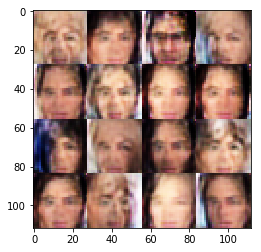

Timestamp 20170805-21-49-28.526 -  Epoch 1/1 -  Step 5210 -  D Loss: 1.2241 - G Loss: 0.8431
Timestamp 20170805-21-49-40.435 -  Epoch 1/1 -  Step 5220 -  D Loss: 1.5787 - G Loss: 0.6549
Timestamp 20170805-21-49-52.340 -  Epoch 1/1 -  Step 5230 -  D Loss: 1.3054 - G Loss: 0.8022
Timestamp 20170805-21-50-04.252 -  Epoch 1/1 -  Step 5240 -  D Loss: 1.0524 - G Loss: 1.3529
Timestamp 20170805-21-50-16.169 -  Epoch 1/1 -  Step 5250 -  D Loss: 1.0712 - G Loss: 1.1712
Timestamp 20170805-21-50-28.071 -  Epoch 1/1 -  Step 5260 -  D Loss: 1.5612 - G Loss: 0.5136
Timestamp 20170805-21-50-39.974 -  Epoch 1/1 -  Step 5270 -  D Loss: 0.7963 - G Loss: 1.3411
Timestamp 20170805-21-50-51.861 -  Epoch 1/1 -  Step 5280 -  D Loss: 1.3111 - G Loss: 0.7317
Timestamp 20170805-21-51-03.760 -  Epoch 1/1 -  Step 5290 -  D Loss: 0.8648 - G Loss: 2.0541
Timestamp 20170805-21-51-15.682 -  Epoch 1/1 -  Step 5300 -  D Loss: 1.1445 - G Loss: 1.0733


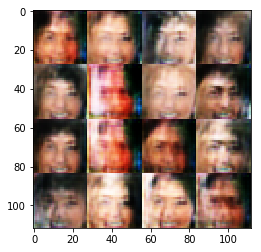

Timestamp 20170805-21-51-28.266 -  Epoch 1/1 -  Step 5310 -  D Loss: 1.0004 - G Loss: 1.2024
Timestamp 20170805-21-51-40.152 -  Epoch 1/1 -  Step 5320 -  D Loss: 1.0494 - G Loss: 1.1238
Timestamp 20170805-21-51-52.053 -  Epoch 1/1 -  Step 5330 -  D Loss: 1.0711 - G Loss: 1.0530
Timestamp 20170805-21-52-03.951 -  Epoch 1/1 -  Step 5340 -  D Loss: 1.7593 - G Loss: 0.6374
Timestamp 20170805-21-52-15.865 -  Epoch 1/1 -  Step 5350 -  D Loss: 0.7332 - G Loss: 1.6993
Timestamp 20170805-21-52-27.762 -  Epoch 1/1 -  Step 5360 -  D Loss: 1.5770 - G Loss: 0.7355
Timestamp 20170805-21-52-39.656 -  Epoch 1/1 -  Step 5370 -  D Loss: 1.2610 - G Loss: 1.1260
Timestamp 20170805-21-52-51.548 -  Epoch 1/1 -  Step 5380 -  D Loss: 1.5579 - G Loss: 0.6331
Timestamp 20170805-21-53-03.453 -  Epoch 1/1 -  Step 5390 -  D Loss: 1.1717 - G Loss: 1.1910
Timestamp 20170805-21-53-15.354 -  Epoch 1/1 -  Step 5400 -  D Loss: 1.1410 - G Loss: 0.7796


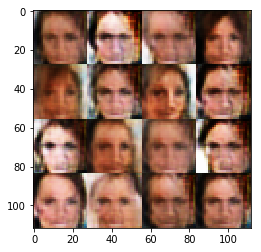

Timestamp 20170805-21-53-27.979 -  Epoch 1/1 -  Step 5410 -  D Loss: 0.9541 - G Loss: 0.9963
Timestamp 20170805-21-53-39.861 -  Epoch 1/1 -  Step 5420 -  D Loss: 1.2260 - G Loss: 0.8746
Timestamp 20170805-21-53-51.747 -  Epoch 1/1 -  Step 5430 -  D Loss: 1.1931 - G Loss: 1.4331
Timestamp 20170805-21-54-03.625 -  Epoch 1/1 -  Step 5440 -  D Loss: 0.9688 - G Loss: 1.2881
Timestamp 20170805-21-54-15.515 -  Epoch 1/1 -  Step 5450 -  D Loss: 1.0878 - G Loss: 1.1556
Timestamp 20170805-21-54-27.409 -  Epoch 1/1 -  Step 5460 -  D Loss: 1.4671 - G Loss: 1.0925
Timestamp 20170805-21-54-39.292 -  Epoch 1/1 -  Step 5470 -  D Loss: 1.5663 - G Loss: 0.7266
Timestamp 20170805-21-54-51.200 -  Epoch 1/1 -  Step 5480 -  D Loss: 1.2814 - G Loss: 1.3924
Timestamp 20170805-21-55-03.099 -  Epoch 1/1 -  Step 5490 -  D Loss: 1.3700 - G Loss: 0.8245
Timestamp 20170805-21-55-14.986 -  Epoch 1/1 -  Step 5500 -  D Loss: 1.6874 - G Loss: 0.4549


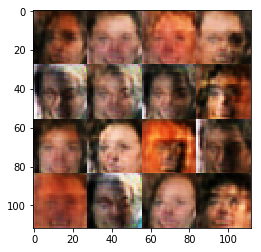

Timestamp 20170805-21-55-27.611 -  Epoch 1/1 -  Step 5510 -  D Loss: 1.0840 - G Loss: 1.7213
Timestamp 20170805-21-55-39.524 -  Epoch 1/1 -  Step 5520 -  D Loss: 1.1046 - G Loss: 1.2303
Timestamp 20170805-21-55-51.424 -  Epoch 1/1 -  Step 5530 -  D Loss: 1.1249 - G Loss: 1.1263
Timestamp 20170805-21-56-03.318 -  Epoch 1/1 -  Step 5540 -  D Loss: 1.4206 - G Loss: 1.0110
Timestamp 20170805-21-56-15.211 -  Epoch 1/1 -  Step 5550 -  D Loss: 1.0368 - G Loss: 1.3018
Timestamp 20170805-21-56-27.119 -  Epoch 1/1 -  Step 5560 -  D Loss: 1.0331 - G Loss: 1.0700
Timestamp 20170805-21-56-39.014 -  Epoch 1/1 -  Step 5570 -  D Loss: 0.9633 - G Loss: 1.2232
Timestamp 20170805-21-56-50.913 -  Epoch 1/1 -  Step 5580 -  D Loss: 0.9050 - G Loss: 1.2831
Timestamp 20170805-21-57-02.809 -  Epoch 1/1 -  Step 5590 -  D Loss: 1.0637 - G Loss: 1.4256
Timestamp 20170805-21-57-14.722 -  Epoch 1/1 -  Step 5600 -  D Loss: 1.2233 - G Loss: 0.7764


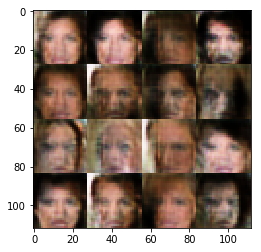

Timestamp 20170805-21-57-27.312 -  Epoch 1/1 -  Step 5610 -  D Loss: 0.9714 - G Loss: 0.9281
Timestamp 20170805-21-57-39.205 -  Epoch 1/1 -  Step 5620 -  D Loss: 1.0442 - G Loss: 1.2456
Timestamp 20170805-21-57-51.094 -  Epoch 1/1 -  Step 5630 -  D Loss: 0.7478 - G Loss: 1.1766
Timestamp 20170805-21-58-03.016 -  Epoch 1/1 -  Step 5640 -  D Loss: 1.2314 - G Loss: 0.8043
Timestamp 20170805-21-58-14.927 -  Epoch 1/1 -  Step 5650 -  D Loss: 1.3466 - G Loss: 0.7263
Timestamp 20170805-21-58-26.815 -  Epoch 1/1 -  Step 5660 -  D Loss: 1.1966 - G Loss: 1.2014
Timestamp 20170805-21-58-38.703 -  Epoch 1/1 -  Step 5670 -  D Loss: 1.5039 - G Loss: 0.5573
Timestamp 20170805-21-58-50.599 -  Epoch 1/1 -  Step 5680 -  D Loss: 1.0110 - G Loss: 1.2620
Timestamp 20170805-21-59-02.503 -  Epoch 1/1 -  Step 5690 -  D Loss: 0.8022 - G Loss: 0.9097
Timestamp 20170805-21-59-14.412 -  Epoch 1/1 -  Step 5700 -  D Loss: 1.5582 - G Loss: 0.7124


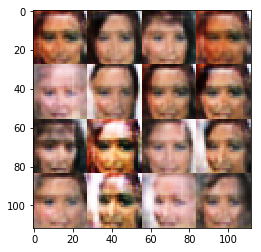

Timestamp 20170805-21-59-26.997 -  Epoch 1/1 -  Step 5710 -  D Loss: 1.3442 - G Loss: 1.0856
Timestamp 20170805-21-59-38.886 -  Epoch 1/1 -  Step 5720 -  D Loss: 0.9836 - G Loss: 1.4251
Timestamp 20170805-21-59-50.796 -  Epoch 1/1 -  Step 5730 -  D Loss: 1.1897 - G Loss: 1.2406
Timestamp 20170805-22-00-02.685 -  Epoch 1/1 -  Step 5740 -  D Loss: 1.0673 - G Loss: 1.4719
Timestamp 20170805-22-00-14.591 -  Epoch 1/1 -  Step 5750 -  D Loss: 1.0956 - G Loss: 1.4215
Timestamp 20170805-22-00-26.475 -  Epoch 1/1 -  Step 5760 -  D Loss: 1.0375 - G Loss: 1.2330
Timestamp 20170805-22-00-38.381 -  Epoch 1/1 -  Step 5770 -  D Loss: 1.1527 - G Loss: 1.0726
Timestamp 20170805-22-00-50.274 -  Epoch 1/1 -  Step 5780 -  D Loss: 0.9637 - G Loss: 1.4542
Timestamp 20170805-22-01-02.171 -  Epoch 1/1 -  Step 5790 -  D Loss: 1.5408 - G Loss: 0.9045
Timestamp 20170805-22-01-14.081 -  Epoch 1/1 -  Step 5800 -  D Loss: 1.1896 - G Loss: 0.8160


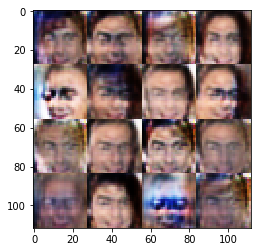

Timestamp 20170805-22-01-26.699 -  Epoch 1/1 -  Step 5810 -  D Loss: 1.2841 - G Loss: 0.6953
Timestamp 20170805-22-01-38.622 -  Epoch 1/1 -  Step 5820 -  D Loss: 1.2755 - G Loss: 0.9371
Timestamp 20170805-22-01-50.532 -  Epoch 1/1 -  Step 5830 -  D Loss: 1.3069 - G Loss: 1.2215
Timestamp 20170805-22-02-02.424 -  Epoch 1/1 -  Step 5840 -  D Loss: 1.4205 - G Loss: 0.7010
Timestamp 20170805-22-02-14.317 -  Epoch 1/1 -  Step 5850 -  D Loss: 0.9996 - G Loss: 1.4045
Timestamp 20170805-22-02-26.210 -  Epoch 1/1 -  Step 5860 -  D Loss: 1.2988 - G Loss: 0.6959
Timestamp 20170805-22-02-38.089 -  Epoch 1/1 -  Step 5870 -  D Loss: 0.9313 - G Loss: 1.4761
Timestamp 20170805-22-02-49.988 -  Epoch 1/1 -  Step 5880 -  D Loss: 1.2932 - G Loss: 1.0587
Timestamp 20170805-22-03-01.881 -  Epoch 1/1 -  Step 5890 -  D Loss: 1.1299 - G Loss: 0.8383
Timestamp 20170805-22-03-13.778 -  Epoch 1/1 -  Step 5900 -  D Loss: 0.9781 - G Loss: 1.2918


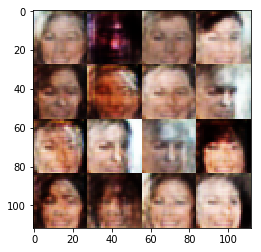

Timestamp 20170805-22-03-26.417 -  Epoch 1/1 -  Step 5910 -  D Loss: 1.0526 - G Loss: 1.1116
Timestamp 20170805-22-03-38.329 -  Epoch 1/1 -  Step 5920 -  D Loss: 1.1705 - G Loss: 1.0164
Timestamp 20170805-22-03-50.247 -  Epoch 1/1 -  Step 5930 -  D Loss: 1.2235 - G Loss: 0.7022
Timestamp 20170805-22-04-02.135 -  Epoch 1/1 -  Step 5940 -  D Loss: 0.8938 - G Loss: 1.2678
Timestamp 20170805-22-04-14.032 -  Epoch 1/1 -  Step 5950 -  D Loss: 0.9969 - G Loss: 1.0739
Timestamp 20170805-22-04-25.938 -  Epoch 1/1 -  Step 5960 -  D Loss: 1.0325 - G Loss: 0.9424
Timestamp 20170805-22-04-37.848 -  Epoch 1/1 -  Step 5970 -  D Loss: 1.3604 - G Loss: 0.6834
Timestamp 20170805-22-04-49.749 -  Epoch 1/1 -  Step 5980 -  D Loss: 0.9759 - G Loss: 0.8090
Timestamp 20170805-22-05-01.647 -  Epoch 1/1 -  Step 5990 -  D Loss: 1.5090 - G Loss: 0.7628
Timestamp 20170805-22-05-13.557 -  Epoch 1/1 -  Step 6000 -  D Loss: 1.3842 - G Loss: 0.6683


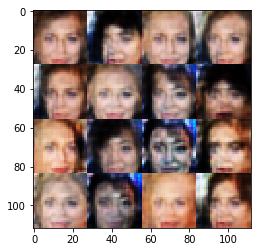

Timestamp 20170805-22-05-26.226 -  Epoch 1/1 -  Step 6010 -  D Loss: 0.8920 - G Loss: 1.0796
Timestamp 20170805-22-05-38.119 -  Epoch 1/1 -  Step 6020 -  D Loss: 1.1432 - G Loss: 1.5403
Timestamp 20170805-22-05-50.011 -  Epoch 1/1 -  Step 6030 -  D Loss: 1.3397 - G Loss: 0.5532
Timestamp 20170805-22-06-01.906 -  Epoch 1/1 -  Step 6040 -  D Loss: 0.9744 - G Loss: 1.5468
Timestamp 20170805-22-06-13.814 -  Epoch 1/1 -  Step 6050 -  D Loss: 1.2712 - G Loss: 1.4440
Timestamp 20170805-22-06-25.703 -  Epoch 1/1 -  Step 6060 -  D Loss: 0.9315 - G Loss: 1.0266
Timestamp 20170805-22-06-37.577 -  Epoch 1/1 -  Step 6070 -  D Loss: 1.6407 - G Loss: 0.8758
Timestamp 20170805-22-06-49.478 -  Epoch 1/1 -  Step 6080 -  D Loss: 0.9598 - G Loss: 1.0706
Timestamp 20170805-22-07-01.375 -  Epoch 1/1 -  Step 6090 -  D Loss: 1.2225 - G Loss: 1.1589
Timestamp 20170805-22-07-13.269 -  Epoch 1/1 -  Step 6100 -  D Loss: 1.0143 - G Loss: 1.3497


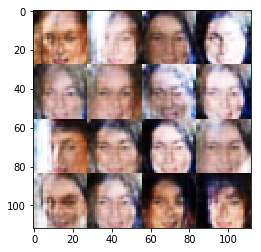

Timestamp 20170805-22-07-25.918 -  Epoch 1/1 -  Step 6110 -  D Loss: 1.1321 - G Loss: 1.1392
Timestamp 20170805-22-07-37.808 -  Epoch 1/1 -  Step 6120 -  D Loss: 1.2427 - G Loss: 0.8465
Timestamp 20170805-22-07-49.736 -  Epoch 1/1 -  Step 6130 -  D Loss: 1.3224 - G Loss: 0.7190
Timestamp 20170805-22-08-01.650 -  Epoch 1/1 -  Step 6140 -  D Loss: 1.1224 - G Loss: 1.1828
Timestamp 20170805-22-08-13.531 -  Epoch 1/1 -  Step 6150 -  D Loss: 1.3321 - G Loss: 0.6504
Timestamp 20170805-22-08-25.428 -  Epoch 1/1 -  Step 6160 -  D Loss: 1.2444 - G Loss: 0.5521
Timestamp 20170805-22-08-37.324 -  Epoch 1/1 -  Step 6170 -  D Loss: 1.1956 - G Loss: 0.9466
Timestamp 20170805-22-08-49.235 -  Epoch 1/1 -  Step 6180 -  D Loss: 1.3545 - G Loss: 1.0873
Timestamp 20170805-22-09-01.130 -  Epoch 1/1 -  Step 6190 -  D Loss: 1.2264 - G Loss: 1.3013
Timestamp 20170805-22-09-13.022 -  Epoch 1/1 -  Step 6200 -  D Loss: 1.2795 - G Loss: 1.0070


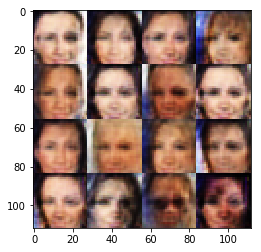

Timestamp 20170805-22-09-25.661 -  Epoch 1/1 -  Step 6210 -  D Loss: 1.0455 - G Loss: 1.3374
Timestamp 20170805-22-09-37.537 -  Epoch 1/1 -  Step 6220 -  D Loss: 0.9010 - G Loss: 1.1868
Timestamp 20170805-22-09-49.443 -  Epoch 1/1 -  Step 6230 -  D Loss: 0.8290 - G Loss: 0.8609
Timestamp 20170805-22-10-01.347 -  Epoch 1/1 -  Step 6240 -  D Loss: 0.8459 - G Loss: 2.0463
Timestamp 20170805-22-10-13.251 -  Epoch 1/1 -  Step 6250 -  D Loss: 0.8914 - G Loss: 1.5460
Timestamp 20170805-22-10-25.150 -  Epoch 1/1 -  Step 6260 -  D Loss: 1.2413 - G Loss: 1.0128
Timestamp 20170805-22-10-37.054 -  Epoch 1/1 -  Step 6270 -  D Loss: 1.3358 - G Loss: 1.0157
Timestamp 20170805-22-10-48.953 -  Epoch 1/1 -  Step 6280 -  D Loss: 1.0332 - G Loss: 1.3980
Timestamp 20170805-22-11-00.869 -  Epoch 1/1 -  Step 6290 -  D Loss: 1.0214 - G Loss: 1.3684
Timestamp 20170805-22-11-12.785 -  Epoch 1/1 -  Step 6300 -  D Loss: 1.2375 - G Loss: 0.7907


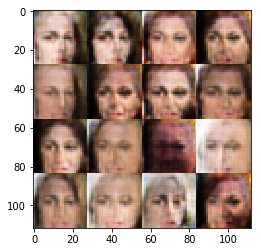

Timestamp 20170805-22-11-25.397 -  Epoch 1/1 -  Step 6310 -  D Loss: 1.1055 - G Loss: 1.3553
Timestamp 20170805-22-11-37.296 -  Epoch 1/1 -  Step 6320 -  D Loss: 1.2922 - G Loss: 1.4060
Timestamp 20170805-22-11-49.204 -  Epoch 1/1 -  Step 6330 -  D Loss: 1.0161 - G Loss: 1.3668
Timestamp 20170805-22-12-01.122 -  Epoch 1/1 -  Step 6340 -  D Loss: 1.0023 - G Loss: 1.2941
Timestamp 20170805-22-12-13.033 -  Epoch 1/1 -  Step 6350 -  D Loss: 1.3188 - G Loss: 0.8007
Timestamp 20170805-22-12-24.931 -  Epoch 1/1 -  Step 6360 -  D Loss: 1.1535 - G Loss: 1.2495
Timestamp 20170805-22-12-36.833 -  Epoch 1/1 -  Step 6370 -  D Loss: 0.9636 - G Loss: 1.0182
Timestamp 20170805-22-12-48.719 -  Epoch 1/1 -  Step 6380 -  D Loss: 1.6930 - G Loss: 0.6039
Timestamp 20170805-22-13-00.617 -  Epoch 1/1 -  Step 6390 -  D Loss: 1.1068 - G Loss: 0.7992
Timestamp 20170805-22-13-12.532 -  Epoch 1/1 -  Step 6400 -  D Loss: 1.1608 - G Loss: 1.2364


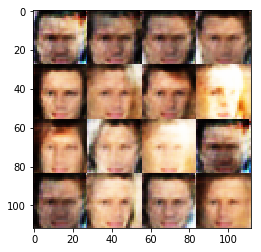

Timestamp 20170805-22-13-25.168 -  Epoch 1/1 -  Step 6410 -  D Loss: 1.1236 - G Loss: 1.4378
Timestamp 20170805-22-13-37.066 -  Epoch 1/1 -  Step 6420 -  D Loss: 1.2178 - G Loss: 0.7309
Timestamp 20170805-22-13-48.952 -  Epoch 1/1 -  Step 6430 -  D Loss: 1.1099 - G Loss: 1.1017
Timestamp 20170805-22-14-00.832 -  Epoch 1/1 -  Step 6440 -  D Loss: 1.1490 - G Loss: 1.5660
Timestamp 20170805-22-14-12.738 -  Epoch 1/1 -  Step 6450 -  D Loss: 0.8278 - G Loss: 1.3174
Timestamp 20170805-22-14-24.618 -  Epoch 1/1 -  Step 6460 -  D Loss: 1.1653 - G Loss: 1.2322
Timestamp 20170805-22-14-36.521 -  Epoch 1/1 -  Step 6470 -  D Loss: 0.7912 - G Loss: 1.1520
Timestamp 20170805-22-14-48.410 -  Epoch 1/1 -  Step 6480 -  D Loss: 1.2700 - G Loss: 0.6541
Timestamp 20170805-22-15-00.328 -  Epoch 1/1 -  Step 6490 -  D Loss: 1.0684 - G Loss: 0.8581
Timestamp 20170805-22-15-12.230 -  Epoch 1/1 -  Step 6500 -  D Loss: 0.9733 - G Loss: 1.0707


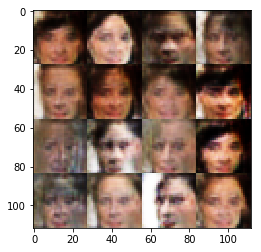

Timestamp 20170805-22-15-24.872 -  Epoch 1/1 -  Step 6510 -  D Loss: 0.8703 - G Loss: 1.2601
Timestamp 20170805-22-15-36.781 -  Epoch 1/1 -  Step 6520 -  D Loss: 0.9173 - G Loss: 0.8606
Timestamp 20170805-22-15-48.682 -  Epoch 1/1 -  Step 6530 -  D Loss: 1.2602 - G Loss: 1.1357
Timestamp 20170805-22-16-00.594 -  Epoch 1/1 -  Step 6540 -  D Loss: 1.3595 - G Loss: 1.0385
Timestamp 20170805-22-16-12.502 -  Epoch 1/1 -  Step 6550 -  D Loss: 1.2494 - G Loss: 1.1525
Timestamp 20170805-22-16-24.410 -  Epoch 1/1 -  Step 6560 -  D Loss: 1.6309 - G Loss: 0.9822
Timestamp 20170805-22-16-36.300 -  Epoch 1/1 -  Step 6570 -  D Loss: 1.2047 - G Loss: 0.8726
Timestamp 20170805-22-16-48.194 -  Epoch 1/1 -  Step 6580 -  D Loss: 1.0068 - G Loss: 1.1873
Timestamp 20170805-22-17-00.102 -  Epoch 1/1 -  Step 6590 -  D Loss: 1.1090 - G Loss: 0.7440
Timestamp 20170805-22-17-12.012 -  Epoch 1/1 -  Step 6600 -  D Loss: 0.9295 - G Loss: 1.2094


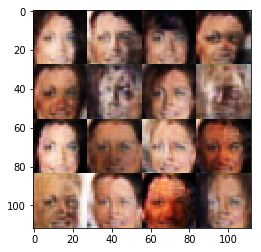

Timestamp 20170805-22-17-24.648 -  Epoch 1/1 -  Step 6610 -  D Loss: 1.1010 - G Loss: 1.0190
Timestamp 20170805-22-17-36.547 -  Epoch 1/1 -  Step 6620 -  D Loss: 1.1962 - G Loss: 1.0334
Timestamp 20170805-22-17-48.440 -  Epoch 1/1 -  Step 6630 -  D Loss: 1.2178 - G Loss: 1.1468
Timestamp 20170805-22-18-00.340 -  Epoch 1/1 -  Step 6640 -  D Loss: 1.4423 - G Loss: 1.0931
Timestamp 20170805-22-18-12.229 -  Epoch 1/1 -  Step 6650 -  D Loss: 0.9297 - G Loss: 1.6880
Timestamp 20170805-22-18-24.143 -  Epoch 1/1 -  Step 6660 -  D Loss: 1.4450 - G Loss: 0.6091
Timestamp 20170805-22-18-36.037 -  Epoch 1/1 -  Step 6670 -  D Loss: 0.9992 - G Loss: 1.0257
Timestamp 20170805-22-18-47.930 -  Epoch 1/1 -  Step 6680 -  D Loss: 1.0601 - G Loss: 0.9999
Timestamp 20170805-22-18-59.824 -  Epoch 1/1 -  Step 6690 -  D Loss: 0.8492 - G Loss: 1.2074
Timestamp 20170805-22-19-11.744 -  Epoch 1/1 -  Step 6700 -  D Loss: 1.0025 - G Loss: 1.1115


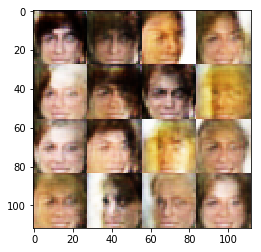

Timestamp 20170805-22-19-24.378 -  Epoch 1/1 -  Step 6710 -  D Loss: 1.2674 - G Loss: 0.9508
Timestamp 20170805-22-19-36.279 -  Epoch 1/1 -  Step 6720 -  D Loss: 1.3537 - G Loss: 1.3236
Timestamp 20170805-22-19-48.162 -  Epoch 1/1 -  Step 6730 -  D Loss: 1.0105 - G Loss: 1.0565
Timestamp 20170805-22-20-00.059 -  Epoch 1/1 -  Step 6740 -  D Loss: 1.0770 - G Loss: 1.0169
Timestamp 20170805-22-20-11.965 -  Epoch 1/1 -  Step 6750 -  D Loss: 1.1463 - G Loss: 1.0973
Timestamp 20170805-22-20-23.878 -  Epoch 1/1 -  Step 6760 -  D Loss: 1.0678 - G Loss: 1.2257
Timestamp 20170805-22-20-35.792 -  Epoch 1/1 -  Step 6770 -  D Loss: 1.5536 - G Loss: 0.6101
Timestamp 20170805-22-20-47.682 -  Epoch 1/1 -  Step 6780 -  D Loss: 0.9044 - G Loss: 1.1872
Timestamp 20170805-22-20-59.581 -  Epoch 1/1 -  Step 6790 -  D Loss: 0.7974 - G Loss: 1.1307
Timestamp 20170805-22-21-11.470 -  Epoch 1/1 -  Step 6800 -  D Loss: 1.0667 - G Loss: 1.2623


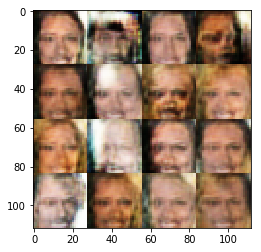

Timestamp 20170805-22-21-24.099 -  Epoch 1/1 -  Step 6810 -  D Loss: 1.0714 - G Loss: 0.9393
Timestamp 20170805-22-21-35.985 -  Epoch 1/1 -  Step 6820 -  D Loss: 1.1305 - G Loss: 1.0237
Timestamp 20170805-22-21-47.889 -  Epoch 1/1 -  Step 6830 -  D Loss: 1.0013 - G Loss: 1.2853
Timestamp 20170805-22-21-59.792 -  Epoch 1/1 -  Step 6840 -  D Loss: 0.9541 - G Loss: 1.2133
Timestamp 20170805-22-22-11.683 -  Epoch 1/1 -  Step 6850 -  D Loss: 1.1913 - G Loss: 1.3661
Timestamp 20170805-22-22-23.579 -  Epoch 1/1 -  Step 6860 -  D Loss: 0.8379 - G Loss: 1.3629
Timestamp 20170805-22-22-35.473 -  Epoch 1/1 -  Step 6870 -  D Loss: 1.0732 - G Loss: 1.1843
Timestamp 20170805-22-22-47.370 -  Epoch 1/1 -  Step 6880 -  D Loss: 1.2049 - G Loss: 1.0820
Timestamp 20170805-22-22-59.276 -  Epoch 1/1 -  Step 6890 -  D Loss: 1.1291 - G Loss: 1.3158
Timestamp 20170805-22-23-11.166 -  Epoch 1/1 -  Step 6900 -  D Loss: 1.0641 - G Loss: 1.0734


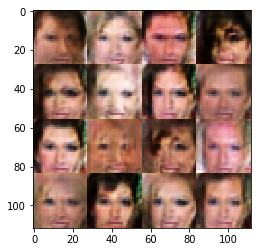

Timestamp 20170805-22-23-23.802 -  Epoch 1/1 -  Step 6910 -  D Loss: 1.1276 - G Loss: 0.9304
Timestamp 20170805-22-23-35.727 -  Epoch 1/1 -  Step 6920 -  D Loss: 1.0811 - G Loss: 1.0389
Timestamp 20170805-22-23-47.629 -  Epoch 1/1 -  Step 6930 -  D Loss: 1.2342 - G Loss: 1.3702
Timestamp 20170805-22-23-59.534 -  Epoch 1/1 -  Step 6940 -  D Loss: 0.7746 - G Loss: 1.2534
Timestamp 20170805-22-24-11.438 -  Epoch 1/1 -  Step 6950 -  D Loss: 1.1601 - G Loss: 1.0502
Timestamp 20170805-22-24-23.330 -  Epoch 1/1 -  Step 6960 -  D Loss: 1.2468 - G Loss: 0.6283
Timestamp 20170805-22-24-35.252 -  Epoch 1/1 -  Step 6970 -  D Loss: 1.2714 - G Loss: 0.9080
Timestamp 20170805-22-24-47.135 -  Epoch 1/1 -  Step 6980 -  D Loss: 1.3996 - G Loss: 0.5690
Timestamp 20170805-22-24-59.028 -  Epoch 1/1 -  Step 6990 -  D Loss: 0.9049 - G Loss: 0.8698
Timestamp 20170805-22-25-10.936 -  Epoch 1/1 -  Step 7000 -  D Loss: 1.1151 - G Loss: 1.1512


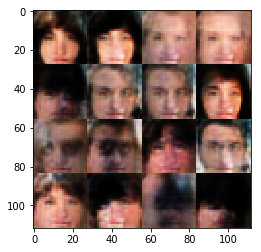

Timestamp 20170805-22-25-23.599 -  Epoch 1/1 -  Step 7010 -  D Loss: 1.4123 - G Loss: 0.6722
Timestamp 20170805-22-25-35.505 -  Epoch 1/1 -  Step 7020 -  D Loss: 0.8325 - G Loss: 1.1622
Timestamp 20170805-22-25-47.403 -  Epoch 1/1 -  Step 7030 -  D Loss: 0.7866 - G Loss: 1.1987
Timestamp 20170805-22-25-59.284 -  Epoch 1/1 -  Step 7040 -  D Loss: 1.0859 - G Loss: 0.9183
Timestamp 20170805-22-26-11.184 -  Epoch 1/1 -  Step 7050 -  D Loss: 0.9377 - G Loss: 1.4833
Timestamp 20170805-22-26-23.058 -  Epoch 1/1 -  Step 7060 -  D Loss: 1.1121 - G Loss: 1.1803
Timestamp 20170805-22-26-34.968 -  Epoch 1/1 -  Step 7070 -  D Loss: 1.3448 - G Loss: 0.9669
Timestamp 20170805-22-26-46.844 -  Epoch 1/1 -  Step 7080 -  D Loss: 1.7394 - G Loss: 0.7103
Timestamp 20170805-22-26-58.730 -  Epoch 1/1 -  Step 7090 -  D Loss: 0.9666 - G Loss: 1.0447
Timestamp 20170805-22-27-10.630 -  Epoch 1/1 -  Step 7100 -  D Loss: 1.2663 - G Loss: 1.4417


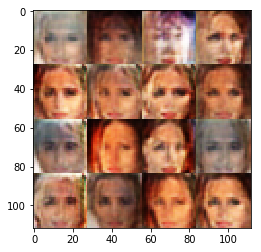

Timestamp 20170805-22-27-23.270 -  Epoch 1/1 -  Step 7110 -  D Loss: 1.2102 - G Loss: 1.1403
Timestamp 20170805-22-27-35.165 -  Epoch 1/1 -  Step 7120 -  D Loss: 1.3940 - G Loss: 1.3443
Timestamp 20170805-22-27-47.049 -  Epoch 1/1 -  Step 7130 -  D Loss: 1.3895 - G Loss: 0.9513
Timestamp 20170805-22-27-58.960 -  Epoch 1/1 -  Step 7140 -  D Loss: 0.9823 - G Loss: 0.7977
Timestamp 20170805-22-28-10.847 -  Epoch 1/1 -  Step 7150 -  D Loss: 0.7624 - G Loss: 1.4675
Timestamp 20170805-22-28-22.751 -  Epoch 1/1 -  Step 7160 -  D Loss: 0.9161 - G Loss: 1.9291
Timestamp 20170805-22-28-34.664 -  Epoch 1/1 -  Step 7170 -  D Loss: 1.1985 - G Loss: 1.1246
Timestamp 20170805-22-28-46.557 -  Epoch 1/1 -  Step 7180 -  D Loss: 1.0103 - G Loss: 0.7848
Timestamp 20170805-22-28-58.449 -  Epoch 1/1 -  Step 7190 -  D Loss: 1.2779 - G Loss: 1.1683
Timestamp 20170805-22-29-10.369 -  Epoch 1/1 -  Step 7200 -  D Loss: 1.3020 - G Loss: 1.7004


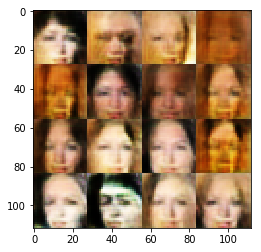

Timestamp 20170805-22-29-23.025 -  Epoch 1/1 -  Step 7210 -  D Loss: 0.8340 - G Loss: 1.5166
Timestamp 20170805-22-29-34.919 -  Epoch 1/1 -  Step 7220 -  D Loss: 1.0366 - G Loss: 1.2554
Timestamp 20170805-22-29-46.825 -  Epoch 1/1 -  Step 7230 -  D Loss: 1.1338 - G Loss: 1.2968
Timestamp 20170805-22-29-58.717 -  Epoch 1/1 -  Step 7240 -  D Loss: 0.7634 - G Loss: 1.3933
Timestamp 20170805-22-30-10.623 -  Epoch 1/1 -  Step 7250 -  D Loss: 0.8737 - G Loss: 0.8711
Timestamp 20170805-22-30-22.515 -  Epoch 1/1 -  Step 7260 -  D Loss: 0.9296 - G Loss: 1.0361
Timestamp 20170805-22-30-34.396 -  Epoch 1/1 -  Step 7270 -  D Loss: 0.9670 - G Loss: 1.1537
Timestamp 20170805-22-30-46.286 -  Epoch 1/1 -  Step 7280 -  D Loss: 0.7124 - G Loss: 1.2423
Timestamp 20170805-22-30-58.179 -  Epoch 1/1 -  Step 7290 -  D Loss: 0.8579 - G Loss: 1.6903
Timestamp 20170805-22-31-10.081 -  Epoch 1/1 -  Step 7300 -  D Loss: 1.0207 - G Loss: 0.9501


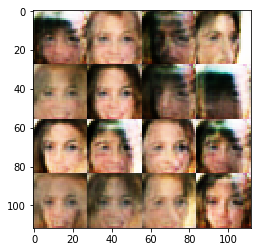

Timestamp 20170805-22-31-22.738 -  Epoch 1/1 -  Step 7310 -  D Loss: 1.3885 - G Loss: 1.0873
Timestamp 20170805-22-31-34.659 -  Epoch 1/1 -  Step 7320 -  D Loss: 1.1830 - G Loss: 0.9214
Timestamp 20170805-22-31-46.556 -  Epoch 1/1 -  Step 7330 -  D Loss: 1.1812 - G Loss: 0.9130
Timestamp 20170805-22-31-58.465 -  Epoch 1/1 -  Step 7340 -  D Loss: 1.0421 - G Loss: 0.9901
Timestamp 20170805-22-32-10.365 -  Epoch 1/1 -  Step 7350 -  D Loss: 1.0691 - G Loss: 1.1348
Timestamp 20170805-22-32-22.270 -  Epoch 1/1 -  Step 7360 -  D Loss: 1.2681 - G Loss: 1.3257
Timestamp 20170805-22-32-34.168 -  Epoch 1/1 -  Step 7370 -  D Loss: 0.9783 - G Loss: 1.1843
Timestamp 20170805-22-32-46.063 -  Epoch 1/1 -  Step 7380 -  D Loss: 1.4072 - G Loss: 0.8756
Timestamp 20170805-22-32-57.981 -  Epoch 1/1 -  Step 7390 -  D Loss: 1.3438 - G Loss: 0.9296
Timestamp 20170805-22-33-09.881 -  Epoch 1/1 -  Step 7400 -  D Loss: 1.1654 - G Loss: 0.8035


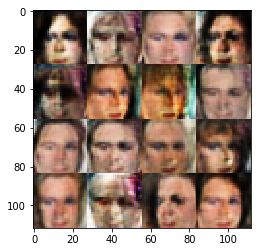

Timestamp 20170805-22-33-22.909 -  Epoch 1/1 -  Step 7410 -  D Loss: 1.0637 - G Loss: 1.1853
Timestamp 20170805-22-33-34.815 -  Epoch 1/1 -  Step 7420 -  D Loss: 1.1866 - G Loss: 0.9411
Timestamp 20170805-22-33-46.705 -  Epoch 1/1 -  Step 7430 -  D Loss: 1.0597 - G Loss: 1.3372
Timestamp 20170805-22-33-58.602 -  Epoch 1/1 -  Step 7440 -  D Loss: 1.1267 - G Loss: 1.3791
Timestamp 20170805-22-34-10.505 -  Epoch 1/1 -  Step 7450 -  D Loss: 1.2049 - G Loss: 0.9283
Timestamp 20170805-22-34-22.402 -  Epoch 1/1 -  Step 7460 -  D Loss: 1.0427 - G Loss: 1.1921
Timestamp 20170805-22-34-34.302 -  Epoch 1/1 -  Step 7470 -  D Loss: 1.2423 - G Loss: 0.9966
Timestamp 20170805-22-34-46.211 -  Epoch 1/1 -  Step 7480 -  D Loss: 1.2951 - G Loss: 1.2450
Timestamp 20170805-22-34-58.092 -  Epoch 1/1 -  Step 7490 -  D Loss: 1.4318 - G Loss: 1.4352
Timestamp 20170805-22-35-09.990 -  Epoch 1/1 -  Step 7500 -  D Loss: 1.0395 - G Loss: 1.5431


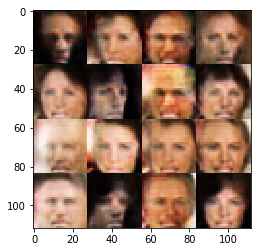

Timestamp 20170805-22-35-22.637 -  Epoch 1/1 -  Step 7510 -  D Loss: 1.2385 - G Loss: 0.6996
Timestamp 20170805-22-35-34.540 -  Epoch 1/1 -  Step 7520 -  D Loss: 1.3484 - G Loss: 0.4465
Timestamp 20170805-22-35-46.451 -  Epoch 1/1 -  Step 7530 -  D Loss: 1.3676 - G Loss: 0.7708
Timestamp 20170805-22-35-58.380 -  Epoch 1/1 -  Step 7540 -  D Loss: 1.1613 - G Loss: 1.2972
Timestamp 20170805-22-36-10.280 -  Epoch 1/1 -  Step 7550 -  D Loss: 1.0782 - G Loss: 0.9323
Timestamp 20170805-22-36-22.165 -  Epoch 1/1 -  Step 7560 -  D Loss: 1.1600 - G Loss: 0.6875
Timestamp 20170805-22-36-34.075 -  Epoch 1/1 -  Step 7570 -  D Loss: 1.0637 - G Loss: 1.0678
Timestamp 20170805-22-36-45.970 -  Epoch 1/1 -  Step 7580 -  D Loss: 1.1426 - G Loss: 1.3668
Timestamp 20170805-22-36-57.888 -  Epoch 1/1 -  Step 7590 -  D Loss: 1.4309 - G Loss: 0.7366
Timestamp 20170805-22-37-09.781 -  Epoch 1/1 -  Step 7600 -  D Loss: 0.7942 - G Loss: 1.0348


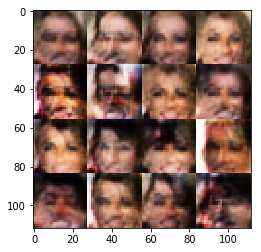

Timestamp 20170805-22-37-22.431 -  Epoch 1/1 -  Step 7610 -  D Loss: 1.3747 - G Loss: 0.7832
Timestamp 20170805-22-37-34.295 -  Epoch 1/1 -  Step 7620 -  D Loss: 1.2815 - G Loss: 1.1799
Timestamp 20170805-22-37-46.224 -  Epoch 1/1 -  Step 7630 -  D Loss: 1.1112 - G Loss: 1.2587
Timestamp 20170805-22-37-58.127 -  Epoch 1/1 -  Step 7640 -  D Loss: 1.0396 - G Loss: 0.8704
Timestamp 20170805-22-38-10.048 -  Epoch 1/1 -  Step 7650 -  D Loss: 1.2439 - G Loss: 0.9161
Timestamp 20170805-22-38-21.929 -  Epoch 1/1 -  Step 7660 -  D Loss: 1.1761 - G Loss: 0.9537
Timestamp 20170805-22-38-33.837 -  Epoch 1/1 -  Step 7670 -  D Loss: 1.4454 - G Loss: 0.9866
Timestamp 20170805-22-38-45.742 -  Epoch 1/1 -  Step 7680 -  D Loss: 1.2265 - G Loss: 0.7989
Timestamp 20170805-22-38-57.633 -  Epoch 1/1 -  Step 7690 -  D Loss: 1.2678 - G Loss: 1.2094
Timestamp 20170805-22-39-09.543 -  Epoch 1/1 -  Step 7700 -  D Loss: 1.2643 - G Loss: 0.5507


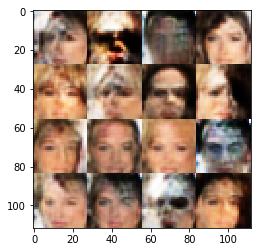

Timestamp 20170805-22-39-22.201 -  Epoch 1/1 -  Step 7710 -  D Loss: 0.9526 - G Loss: 1.1711
Timestamp 20170805-22-39-34.098 -  Epoch 1/1 -  Step 7720 -  D Loss: 1.4543 - G Loss: 0.6258
Timestamp 20170805-22-39-46.009 -  Epoch 1/1 -  Step 7730 -  D Loss: 0.8844 - G Loss: 1.4749
Timestamp 20170805-22-39-57.909 -  Epoch 1/1 -  Step 7740 -  D Loss: 1.2435 - G Loss: 0.9940
Timestamp 20170805-22-40-09.824 -  Epoch 1/1 -  Step 7750 -  D Loss: 1.2301 - G Loss: 0.7334
Timestamp 20170805-22-40-21.728 -  Epoch 1/1 -  Step 7760 -  D Loss: 1.3338 - G Loss: 1.2347
Timestamp 20170805-22-40-33.615 -  Epoch 1/1 -  Step 7770 -  D Loss: 1.0465 - G Loss: 1.2801
Timestamp 20170805-22-40-45.530 -  Epoch 1/1 -  Step 7780 -  D Loss: 1.0589 - G Loss: 1.0951
Timestamp 20170805-22-40-57.413 -  Epoch 1/1 -  Step 7790 -  D Loss: 1.0207 - G Loss: 0.7812
Timestamp 20170805-22-41-09.341 -  Epoch 1/1 -  Step 7800 -  D Loss: 0.9808 - G Loss: 1.2851


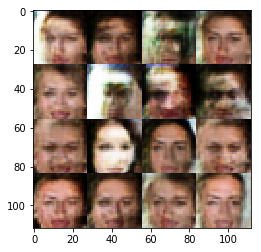

Timestamp 20170805-22-41-21.991 -  Epoch 1/1 -  Step 7810 -  D Loss: 1.1639 - G Loss: 0.9933
Timestamp 20170805-22-41-33.873 -  Epoch 1/1 -  Step 7820 -  D Loss: 1.0028 - G Loss: 1.0400
Timestamp 20170805-22-41-45.765 -  Epoch 1/1 -  Step 7830 -  D Loss: 0.8323 - G Loss: 1.2150
Timestamp 20170805-22-41-57.670 -  Epoch 1/1 -  Step 7840 -  D Loss: 1.1662 - G Loss: 0.8347
Timestamp 20170805-22-42-09.571 -  Epoch 1/1 -  Step 7850 -  D Loss: 1.0672 - G Loss: 0.8296
Timestamp 20170805-22-42-21.479 -  Epoch 1/1 -  Step 7860 -  D Loss: 0.8723 - G Loss: 1.3019
Timestamp 20170805-22-42-33.375 -  Epoch 1/1 -  Step 7870 -  D Loss: 1.3084 - G Loss: 1.0068
Timestamp 20170805-22-42-45.286 -  Epoch 1/1 -  Step 7880 -  D Loss: 1.1978 - G Loss: 0.8728
Timestamp 20170805-22-42-57.197 -  Epoch 1/1 -  Step 7890 -  D Loss: 1.1743 - G Loss: 1.0436
Timestamp 20170805-22-43-09.081 -  Epoch 1/1 -  Step 7900 -  D Loss: 1.9997 - G Loss: 0.8373


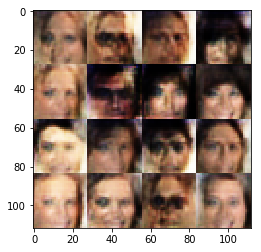

Timestamp 20170805-22-43-21.746 -  Epoch 1/1 -  Step 7910 -  D Loss: 1.0363 - G Loss: 1.0098
Timestamp 20170805-22-43-33.663 -  Epoch 1/1 -  Step 7920 -  D Loss: 1.0786 - G Loss: 0.8774
Timestamp 20170805-22-43-45.578 -  Epoch 1/1 -  Step 7930 -  D Loss: 1.2901 - G Loss: 1.0753
Timestamp 20170805-22-43-57.493 -  Epoch 1/1 -  Step 7940 -  D Loss: 1.0124 - G Loss: 1.2114
Timestamp 20170805-22-44-09.391 -  Epoch 1/1 -  Step 7950 -  D Loss: 1.3698 - G Loss: 1.2384
Timestamp 20170805-22-44-21.294 -  Epoch 1/1 -  Step 7960 -  D Loss: 1.2083 - G Loss: 0.6699
Timestamp 20170805-22-44-33.198 -  Epoch 1/1 -  Step 7970 -  D Loss: 1.1278 - G Loss: 1.1647
Timestamp 20170805-22-44-45.077 -  Epoch 1/1 -  Step 7980 -  D Loss: 0.9678 - G Loss: 0.9516
Timestamp 20170805-22-44-56.968 -  Epoch 1/1 -  Step 7990 -  D Loss: 0.9855 - G Loss: 1.1355
Timestamp 20170805-22-45-08.867 -  Epoch 1/1 -  Step 8000 -  D Loss: 1.0302 - G Loss: 0.9745


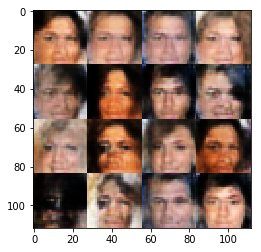

Timestamp 20170805-22-45-21.493 -  Epoch 1/1 -  Step 8010 -  D Loss: 1.2642 - G Loss: 1.0028
Timestamp 20170805-22-45-33.380 -  Epoch 1/1 -  Step 8020 -  D Loss: 1.3068 - G Loss: 0.8939
Timestamp 20170805-22-45-45.276 -  Epoch 1/1 -  Step 8030 -  D Loss: 1.3136 - G Loss: 1.2729
Timestamp 20170805-22-45-57.173 -  Epoch 1/1 -  Step 8040 -  D Loss: 1.1665 - G Loss: 1.2670
Timestamp 20170805-22-46-09.072 -  Epoch 1/1 -  Step 8050 -  D Loss: 1.1223 - G Loss: 1.0079
Timestamp 20170805-22-46-20.976 -  Epoch 1/1 -  Step 8060 -  D Loss: 1.2346 - G Loss: 1.1101
Timestamp 20170805-22-46-32.885 -  Epoch 1/1 -  Step 8070 -  D Loss: 0.7371 - G Loss: 1.6502
Timestamp 20170805-22-46-44.811 -  Epoch 1/1 -  Step 8080 -  D Loss: 1.5988 - G Loss: 0.9860
Timestamp 20170805-22-46-56.713 -  Epoch 1/1 -  Step 8090 -  D Loss: 1.0149 - G Loss: 1.1810
Timestamp 20170805-22-47-08.621 -  Epoch 1/1 -  Step 8100 -  D Loss: 1.1709 - G Loss: 1.0912


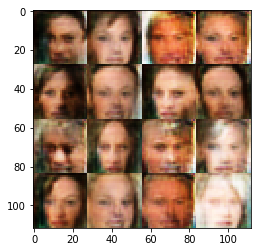

Timestamp 20170805-22-47-21.265 -  Epoch 1/1 -  Step 8110 -  D Loss: 1.0437 - G Loss: 0.9068
Timestamp 20170805-22-47-33.160 -  Epoch 1/1 -  Step 8120 -  D Loss: 1.8249 - G Loss: 0.8603
Timestamp 20170805-22-47-45.059 -  Epoch 1/1 -  Step 8130 -  D Loss: 1.1243 - G Loss: 1.1694
Timestamp 20170805-22-47-56.951 -  Epoch 1/1 -  Step 8140 -  D Loss: 1.4243 - G Loss: 0.8596
Timestamp 20170805-22-48-08.847 -  Epoch 1/1 -  Step 8150 -  D Loss: 1.1186 - G Loss: 1.0031
Timestamp 20170805-22-48-20.783 -  Epoch 1/1 -  Step 8160 -  D Loss: 1.0417 - G Loss: 1.1216
Timestamp 20170805-22-48-32.670 -  Epoch 1/1 -  Step 8170 -  D Loss: 1.4101 - G Loss: 0.9142
Timestamp 20170805-22-48-44.585 -  Epoch 1/1 -  Step 8180 -  D Loss: 1.0657 - G Loss: 0.8260
Timestamp 20170805-22-48-56.488 -  Epoch 1/1 -  Step 8190 -  D Loss: 0.9937 - G Loss: 1.3076
Timestamp 20170805-22-49-08.398 -  Epoch 1/1 -  Step 8200 -  D Loss: 0.9168 - G Loss: 1.0725


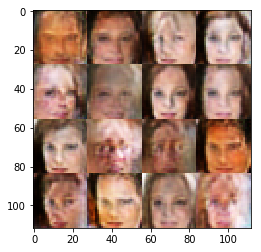

Timestamp 20170805-22-49-21.060 -  Epoch 1/1 -  Step 8210 -  D Loss: 1.5688 - G Loss: 0.7223
Timestamp 20170805-22-49-32.949 -  Epoch 1/1 -  Step 8220 -  D Loss: 1.3522 - G Loss: 0.6366
Timestamp 20170805-22-49-44.840 -  Epoch 1/1 -  Step 8230 -  D Loss: 1.4273 - G Loss: 0.7879
Timestamp 20170805-22-49-56.741 -  Epoch 1/1 -  Step 8240 -  D Loss: 1.4489 - G Loss: 0.8363
Timestamp 20170805-22-50-08.630 -  Epoch 1/1 -  Step 8250 -  D Loss: 1.1016 - G Loss: 1.5330
Timestamp 20170805-22-50-20.528 -  Epoch 1/1 -  Step 8260 -  D Loss: 1.2397 - G Loss: 1.1429
Timestamp 20170805-22-50-32.418 -  Epoch 1/1 -  Step 8270 -  D Loss: 1.2977 - G Loss: 0.7252
Timestamp 20170805-22-50-44.317 -  Epoch 1/1 -  Step 8280 -  D Loss: 1.3440 - G Loss: 0.7138
Timestamp 20170805-22-50-56.232 -  Epoch 1/1 -  Step 8290 -  D Loss: 1.6080 - G Loss: 1.5546
Timestamp 20170805-22-51-08.123 -  Epoch 1/1 -  Step 8300 -  D Loss: 0.8621 - G Loss: 1.1764


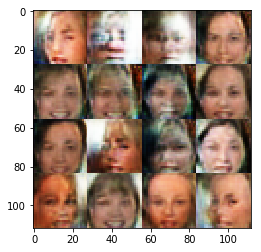

Timestamp 20170805-22-51-20.751 -  Epoch 1/1 -  Step 8310 -  D Loss: 1.1348 - G Loss: 1.2866
Timestamp 20170805-22-51-32.639 -  Epoch 1/1 -  Step 8320 -  D Loss: 1.0701 - G Loss: 0.7155
Timestamp 20170805-22-51-44.535 -  Epoch 1/1 -  Step 8330 -  D Loss: 0.9745 - G Loss: 1.3865
Timestamp 20170805-22-51-56.432 -  Epoch 1/1 -  Step 8340 -  D Loss: 1.1477 - G Loss: 0.8837
Timestamp 20170805-22-52-08.341 -  Epoch 1/1 -  Step 8350 -  D Loss: 1.3332 - G Loss: 0.8493
Timestamp 20170805-22-52-20.232 -  Epoch 1/1 -  Step 8360 -  D Loss: 1.2298 - G Loss: 0.9030
Timestamp 20170805-22-52-32.138 -  Epoch 1/1 -  Step 8370 -  D Loss: 1.4114 - G Loss: 1.2612
Timestamp 20170805-22-52-44.017 -  Epoch 1/1 -  Step 8380 -  D Loss: 1.1934 - G Loss: 1.2491
Timestamp 20170805-22-52-55.932 -  Epoch 1/1 -  Step 8390 -  D Loss: 1.0674 - G Loss: 1.1449
Timestamp 20170805-22-53-07.844 -  Epoch 1/1 -  Step 8400 -  D Loss: 0.9096 - G Loss: 1.0338


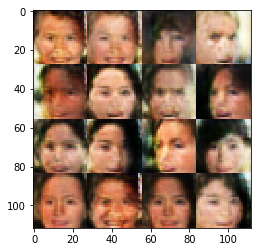

Timestamp 20170805-22-53-20.497 -  Epoch 1/1 -  Step 8410 -  D Loss: 1.4531 - G Loss: 1.0153
Timestamp 20170805-22-53-32.418 -  Epoch 1/1 -  Step 8420 -  D Loss: 0.8500 - G Loss: 1.2080
Timestamp 20170805-22-53-44.333 -  Epoch 1/1 -  Step 8430 -  D Loss: 1.0480 - G Loss: 1.3235
Timestamp 20170805-22-53-56.246 -  Epoch 1/1 -  Step 8440 -  D Loss: 0.9837 - G Loss: 1.7039
Timestamp 20170805-22-54-08.135 -  Epoch 1/1 -  Step 8450 -  D Loss: 0.8428 - G Loss: 1.7922
Timestamp 20170805-22-54-20.055 -  Epoch 1/1 -  Step 8460 -  D Loss: 1.0953 - G Loss: 0.7920
Timestamp 20170805-22-54-31.950 -  Epoch 1/1 -  Step 8470 -  D Loss: 0.9973 - G Loss: 1.5748
Timestamp 20170805-22-54-43.838 -  Epoch 1/1 -  Step 8480 -  D Loss: 0.9205 - G Loss: 1.4110
Timestamp 20170805-22-54-55.743 -  Epoch 1/1 -  Step 8490 -  D Loss: 0.9076 - G Loss: 1.2104
Timestamp 20170805-22-55-07.652 -  Epoch 1/1 -  Step 8500 -  D Loss: 1.1800 - G Loss: 1.0147


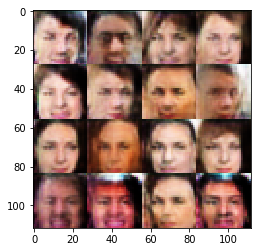

Timestamp 20170805-22-55-20.341 -  Epoch 1/1 -  Step 8510 -  D Loss: 1.1885 - G Loss: 0.8375
Timestamp 20170805-22-55-32.232 -  Epoch 1/1 -  Step 8520 -  D Loss: 0.9208 - G Loss: 1.1552
Timestamp 20170805-22-55-44.117 -  Epoch 1/1 -  Step 8530 -  D Loss: 1.1908 - G Loss: 0.7497
Timestamp 20170805-22-55-56.015 -  Epoch 1/1 -  Step 8540 -  D Loss: 0.7502 - G Loss: 1.2312
Timestamp 20170805-22-56-07.903 -  Epoch 1/1 -  Step 8550 -  D Loss: 1.1336 - G Loss: 0.9977
Timestamp 20170805-22-56-19.801 -  Epoch 1/1 -  Step 8560 -  D Loss: 1.0821 - G Loss: 1.3095
Timestamp 20170805-22-56-31.696 -  Epoch 1/1 -  Step 8570 -  D Loss: 1.4027 - G Loss: 0.7633
Timestamp 20170805-22-56-43.604 -  Epoch 1/1 -  Step 8580 -  D Loss: 1.2708 - G Loss: 0.9898
Timestamp 20170805-22-56-55.492 -  Epoch 1/1 -  Step 8590 -  D Loss: 1.0379 - G Loss: 0.8462
Timestamp 20170805-22-57-07.404 -  Epoch 1/1 -  Step 8600 -  D Loss: 1.6199 - G Loss: 0.6610


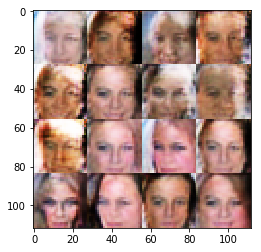

Timestamp 20170805-22-57-20.017 -  Epoch 1/1 -  Step 8610 -  D Loss: 1.2577 - G Loss: 0.8737
Timestamp 20170805-22-57-31.910 -  Epoch 1/1 -  Step 8620 -  D Loss: 1.1677 - G Loss: 1.0227
Timestamp 20170805-22-57-43.808 -  Epoch 1/1 -  Step 8630 -  D Loss: 1.0727 - G Loss: 0.8775
Timestamp 20170805-22-57-55.694 -  Epoch 1/1 -  Step 8640 -  D Loss: 0.9879 - G Loss: 1.2402
Timestamp 20170805-22-58-07.600 -  Epoch 1/1 -  Step 8650 -  D Loss: 1.4069 - G Loss: 1.0627
Timestamp 20170805-22-58-19.492 -  Epoch 1/1 -  Step 8660 -  D Loss: 0.9821 - G Loss: 1.3306
Timestamp 20170805-22-58-31.390 -  Epoch 1/1 -  Step 8670 -  D Loss: 1.2151 - G Loss: 1.0430
Timestamp 20170805-22-58-43.301 -  Epoch 1/1 -  Step 8680 -  D Loss: 1.1589 - G Loss: 0.8665
Timestamp 20170805-22-58-55.219 -  Epoch 1/1 -  Step 8690 -  D Loss: 0.9176 - G Loss: 1.2681
Timestamp 20170805-22-59-07.132 -  Epoch 1/1 -  Step 8700 -  D Loss: 1.1412 - G Loss: 0.9586


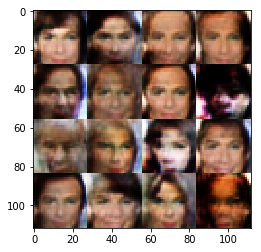

Timestamp 20170805-22-59-19.801 -  Epoch 1/1 -  Step 8710 -  D Loss: 0.8516 - G Loss: 1.1575
Timestamp 20170805-22-59-31.705 -  Epoch 1/1 -  Step 8720 -  D Loss: 1.1619 - G Loss: 1.0927
Timestamp 20170805-22-59-43.599 -  Epoch 1/1 -  Step 8730 -  D Loss: 1.0522 - G Loss: 1.3853
Timestamp 20170805-22-59-55.493 -  Epoch 1/1 -  Step 8740 -  D Loss: 0.9229 - G Loss: 1.1089
Timestamp 20170805-23-00-07.423 -  Epoch 1/1 -  Step 8750 -  D Loss: 1.1296 - G Loss: 1.0828
Timestamp 20170805-23-00-19.315 -  Epoch 1/1 -  Step 8760 -  D Loss: 0.9416 - G Loss: 1.0303
Timestamp 20170805-23-00-31.173 -  Epoch 1/1 -  Step 8770 -  D Loss: 1.2828 - G Loss: 1.0772
Timestamp 20170805-23-00-43.077 -  Epoch 1/1 -  Step 8780 -  D Loss: 1.2775 - G Loss: 0.7346
Timestamp 20170805-23-00-54.973 -  Epoch 1/1 -  Step 8790 -  D Loss: 0.9593 - G Loss: 1.1799
Timestamp 20170805-23-01-06.876 -  Epoch 1/1 -  Step 8800 -  D Loss: 1.4931 - G Loss: 0.8974


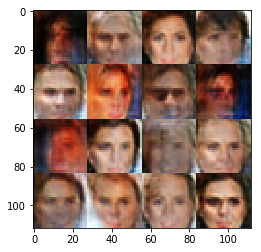

Timestamp 20170805-23-01-19.583 -  Epoch 1/1 -  Step 8810 -  D Loss: 1.0222 - G Loss: 1.2738
Timestamp 20170805-23-01-31.471 -  Epoch 1/1 -  Step 8820 -  D Loss: 1.3736 - G Loss: 1.1761
Timestamp 20170805-23-01-43.372 -  Epoch 1/1 -  Step 8830 -  D Loss: 1.3196 - G Loss: 1.2254
Timestamp 20170805-23-01-55.270 -  Epoch 1/1 -  Step 8840 -  D Loss: 1.1783 - G Loss: 1.1227
Timestamp 20170805-23-02-07.168 -  Epoch 1/1 -  Step 8850 -  D Loss: 1.5228 - G Loss: 0.5869
Timestamp 20170805-23-02-19.080 -  Epoch 1/1 -  Step 8860 -  D Loss: 1.1827 - G Loss: 0.9251
Timestamp 20170805-23-02-30.978 -  Epoch 1/1 -  Step 8870 -  D Loss: 0.8512 - G Loss: 1.2389
Timestamp 20170805-23-02-42.880 -  Epoch 1/1 -  Step 8880 -  D Loss: 1.0786 - G Loss: 1.0054
Timestamp 20170805-23-02-54.779 -  Epoch 1/1 -  Step 8890 -  D Loss: 1.2759 - G Loss: 0.8495
Timestamp 20170805-23-03-06.685 -  Epoch 1/1 -  Step 8900 -  D Loss: 0.8314 - G Loss: 1.1954


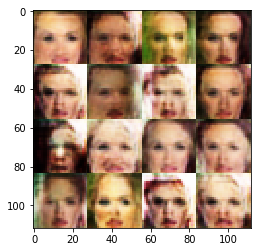

Timestamp 20170805-23-03-19.356 -  Epoch 1/1 -  Step 8910 -  D Loss: 0.8431 - G Loss: 1.4834
Timestamp 20170805-23-03-31.247 -  Epoch 1/1 -  Step 8920 -  D Loss: 0.9379 - G Loss: 1.5457
Timestamp 20170805-23-03-43.169 -  Epoch 1/1 -  Step 8930 -  D Loss: 1.5400 - G Loss: 0.9397
Timestamp 20170805-23-03-55.061 -  Epoch 1/1 -  Step 8940 -  D Loss: 0.9576 - G Loss: 1.0303
Timestamp 20170805-23-04-06.953 -  Epoch 1/1 -  Step 8950 -  D Loss: 1.2706 - G Loss: 0.8732
Timestamp 20170805-23-04-18.846 -  Epoch 1/1 -  Step 8960 -  D Loss: 1.1262 - G Loss: 0.9779
Timestamp 20170805-23-04-30.743 -  Epoch 1/1 -  Step 8970 -  D Loss: 1.2213 - G Loss: 1.0667
Timestamp 20170805-23-04-42.643 -  Epoch 1/1 -  Step 8980 -  D Loss: 0.9959 - G Loss: 0.8410
Timestamp 20170805-23-04-54.524 -  Epoch 1/1 -  Step 8990 -  D Loss: 1.2506 - G Loss: 0.8773
Timestamp 20170805-23-05-06.431 -  Epoch 1/1 -  Step 9000 -  D Loss: 1.2812 - G Loss: 1.0077


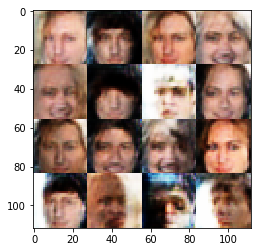

Timestamp 20170805-23-05-19.124 -  Epoch 1/1 -  Step 9010 -  D Loss: 1.1847 - G Loss: 0.5745
Timestamp 20170805-23-05-31.026 -  Epoch 1/1 -  Step 9020 -  D Loss: 1.2376 - G Loss: 0.8124
Timestamp 20170805-23-05-42.919 -  Epoch 1/1 -  Step 9030 -  D Loss: 1.0801 - G Loss: 1.0056
Timestamp 20170805-23-05-54.809 -  Epoch 1/1 -  Step 9040 -  D Loss: 1.1958 - G Loss: 0.9310
Timestamp 20170805-23-06-06.713 -  Epoch 1/1 -  Step 9050 -  D Loss: 1.3291 - G Loss: 0.8858
Timestamp 20170805-23-06-18.627 -  Epoch 1/1 -  Step 9060 -  D Loss: 0.8731 - G Loss: 1.5488
Timestamp 20170805-23-06-30.541 -  Epoch 1/1 -  Step 9070 -  D Loss: 0.8092 - G Loss: 1.1293
Timestamp 20170805-23-06-42.448 -  Epoch 1/1 -  Step 9080 -  D Loss: 1.0197 - G Loss: 1.1239
Timestamp 20170805-23-06-54.333 -  Epoch 1/1 -  Step 9090 -  D Loss: 1.2516 - G Loss: 1.5648
Timestamp 20170805-23-07-06.213 -  Epoch 1/1 -  Step 9100 -  D Loss: 1.2148 - G Loss: 1.3181


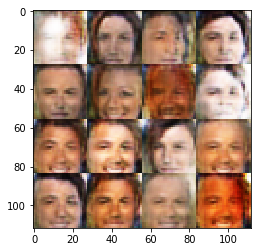

Timestamp 20170805-23-07-18.899 -  Epoch 1/1 -  Step 9110 -  D Loss: 1.1709 - G Loss: 0.8943
Timestamp 20170805-23-07-30.798 -  Epoch 1/1 -  Step 9120 -  D Loss: 1.0418 - G Loss: 1.1311
Timestamp 20170805-23-07-42.685 -  Epoch 1/1 -  Step 9130 -  D Loss: 0.9854 - G Loss: 0.6490
Timestamp 20170805-23-07-54.571 -  Epoch 1/1 -  Step 9140 -  D Loss: 1.5444 - G Loss: 0.8152
Timestamp 20170805-23-08-06.455 -  Epoch 1/1 -  Step 9150 -  D Loss: 1.2151 - G Loss: 0.8150
Timestamp 20170805-23-08-18.362 -  Epoch 1/1 -  Step 9160 -  D Loss: 1.3897 - G Loss: 0.7194
Timestamp 20170805-23-08-30.252 -  Epoch 1/1 -  Step 9170 -  D Loss: 1.0764 - G Loss: 1.4651
Timestamp 20170805-23-08-42.161 -  Epoch 1/1 -  Step 9180 -  D Loss: 1.0040 - G Loss: 1.3346
Timestamp 20170805-23-08-54.059 -  Epoch 1/1 -  Step 9190 -  D Loss: 1.0076 - G Loss: 1.0801
Timestamp 20170805-23-09-05.964 -  Epoch 1/1 -  Step 9200 -  D Loss: 1.1667 - G Loss: 0.8218


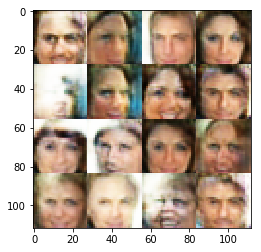

Timestamp 20170805-23-09-18.647 -  Epoch 1/1 -  Step 9210 -  D Loss: 1.2598 - G Loss: 0.9847
Timestamp 20170805-23-09-30.533 -  Epoch 1/1 -  Step 9220 -  D Loss: 1.2633 - G Loss: 0.7831
Timestamp 20170805-23-09-42.433 -  Epoch 1/1 -  Step 9230 -  D Loss: 0.7857 - G Loss: 1.5228
Timestamp 20170805-23-09-54.336 -  Epoch 1/1 -  Step 9240 -  D Loss: 1.0167 - G Loss: 1.3952
Timestamp 20170805-23-10-06.227 -  Epoch 1/1 -  Step 9250 -  D Loss: 1.1904 - G Loss: 0.7906
Timestamp 20170805-23-10-18.132 -  Epoch 1/1 -  Step 9260 -  D Loss: 1.1091 - G Loss: 1.5307
Timestamp 20170805-23-10-30.025 -  Epoch 1/1 -  Step 9270 -  D Loss: 1.0411 - G Loss: 0.8260
Timestamp 20170805-23-10-41.935 -  Epoch 1/1 -  Step 9280 -  D Loss: 1.0362 - G Loss: 1.1808
Timestamp 20170805-23-10-53.834 -  Epoch 1/1 -  Step 9290 -  D Loss: 0.9980 - G Loss: 1.2638
Timestamp 20170805-23-11-05.731 -  Epoch 1/1 -  Step 9300 -  D Loss: 0.9071 - G Loss: 1.0969


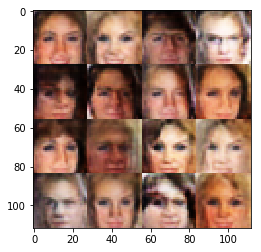

Timestamp 20170805-23-11-18.395 -  Epoch 1/1 -  Step 9310 -  D Loss: 1.1807 - G Loss: 1.2680
Timestamp 20170805-23-11-30.287 -  Epoch 1/1 -  Step 9320 -  D Loss: 1.4392 - G Loss: 0.8400
Timestamp 20170805-23-11-42.181 -  Epoch 1/1 -  Step 9330 -  D Loss: 1.3324 - G Loss: 1.4962
Timestamp 20170805-23-11-54.084 -  Epoch 1/1 -  Step 9340 -  D Loss: 1.2517 - G Loss: 1.0799
Timestamp 20170805-23-12-05.994 -  Epoch 1/1 -  Step 9350 -  D Loss: 1.0472 - G Loss: 0.8914
Timestamp 20170805-23-12-17.906 -  Epoch 1/1 -  Step 9360 -  D Loss: 1.0543 - G Loss: 0.7629
Timestamp 20170805-23-12-29.810 -  Epoch 1/1 -  Step 9370 -  D Loss: 0.9413 - G Loss: 0.9655
Timestamp 20170805-23-12-41.703 -  Epoch 1/1 -  Step 9380 -  D Loss: 1.1070 - G Loss: 1.4165
Timestamp 20170805-23-12-53.610 -  Epoch 1/1 -  Step 9390 -  D Loss: 1.2105 - G Loss: 0.8448
Timestamp 20170805-23-13-05.527 -  Epoch 1/1 -  Step 9400 -  D Loss: 0.9811 - G Loss: 1.1052


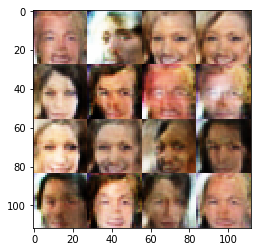

Timestamp 20170805-23-13-18.214 -  Epoch 1/1 -  Step 9410 -  D Loss: 1.1142 - G Loss: 1.2811
Timestamp 20170805-23-13-30.123 -  Epoch 1/1 -  Step 9420 -  D Loss: 1.0080 - G Loss: 1.2507
Timestamp 20170805-23-13-42.013 -  Epoch 1/1 -  Step 9430 -  D Loss: 1.2157 - G Loss: 1.3954
Timestamp 20170805-23-13-53.927 -  Epoch 1/1 -  Step 9440 -  D Loss: 1.0372 - G Loss: 1.3279
Timestamp 20170805-23-14-05.831 -  Epoch 1/1 -  Step 9450 -  D Loss: 1.0197 - G Loss: 1.0287
Timestamp 20170805-23-14-17.715 -  Epoch 1/1 -  Step 9460 -  D Loss: 1.0683 - G Loss: 1.2051
Timestamp 20170805-23-14-29.624 -  Epoch 1/1 -  Step 9470 -  D Loss: 1.0449 - G Loss: 0.9589
Timestamp 20170805-23-14-41.514 -  Epoch 1/1 -  Step 9480 -  D Loss: 1.7163 - G Loss: 0.7330
Timestamp 20170805-23-14-53.408 -  Epoch 1/1 -  Step 9490 -  D Loss: 1.0625 - G Loss: 1.3782
Timestamp 20170805-23-15-05.302 -  Epoch 1/1 -  Step 9500 -  D Loss: 1.1159 - G Loss: 1.1919


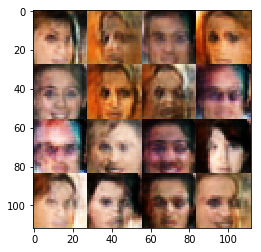

Timestamp 20170805-23-15-18.008 -  Epoch 1/1 -  Step 9510 -  D Loss: 1.1505 - G Loss: 1.0047
Timestamp 20170805-23-15-29.900 -  Epoch 1/1 -  Step 9520 -  D Loss: 1.2437 - G Loss: 0.7749
Timestamp 20170805-23-15-41.804 -  Epoch 1/1 -  Step 9530 -  D Loss: 1.1526 - G Loss: 0.9826
Timestamp 20170805-23-15-53.708 -  Epoch 1/1 -  Step 9540 -  D Loss: 1.3002 - G Loss: 0.8372
Timestamp 20170805-23-16-05.613 -  Epoch 1/1 -  Step 9550 -  D Loss: 0.9757 - G Loss: 0.9437
Timestamp 20170805-23-16-17.516 -  Epoch 1/1 -  Step 9560 -  D Loss: 1.0118 - G Loss: 0.9885
Timestamp 20170805-23-16-29.428 -  Epoch 1/1 -  Step 9570 -  D Loss: 1.0840 - G Loss: 1.1338
Timestamp 20170805-23-16-41.321 -  Epoch 1/1 -  Step 9580 -  D Loss: 1.0327 - G Loss: 0.9609
Timestamp 20170805-23-16-53.213 -  Epoch 1/1 -  Step 9590 -  D Loss: 1.2458 - G Loss: 1.2118
Timestamp 20170805-23-17-05.157 -  Epoch 1/1 -  Step 9600 -  D Loss: 0.8811 - G Loss: 1.1356


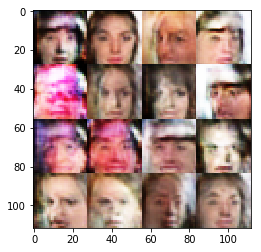

Timestamp 20170805-23-17-17.857 -  Epoch 1/1 -  Step 9610 -  D Loss: 0.9937 - G Loss: 1.2550
Timestamp 20170805-23-17-29.761 -  Epoch 1/1 -  Step 9620 -  D Loss: 1.6343 - G Loss: 0.6113
Timestamp 20170805-23-17-41.661 -  Epoch 1/1 -  Step 9630 -  D Loss: 1.0474 - G Loss: 0.9614
Timestamp 20170805-23-17-53.563 -  Epoch 1/1 -  Step 9640 -  D Loss: 1.1661 - G Loss: 1.3321
Timestamp 20170805-23-18-05.486 -  Epoch 1/1 -  Step 9650 -  D Loss: 0.9304 - G Loss: 0.7992
Timestamp 20170805-23-18-17.373 -  Epoch 1/1 -  Step 9660 -  D Loss: 0.7918 - G Loss: 1.1100
Timestamp 20170805-23-18-29.265 -  Epoch 1/1 -  Step 9670 -  D Loss: 1.2423 - G Loss: 0.9532
Timestamp 20170805-23-18-41.174 -  Epoch 1/1 -  Step 9680 -  D Loss: 1.3924 - G Loss: 0.7242
Timestamp 20170805-23-18-53.087 -  Epoch 1/1 -  Step 9690 -  D Loss: 1.4240 - G Loss: 1.0917
Timestamp 20170805-23-19-05.000 -  Epoch 1/1 -  Step 9700 -  D Loss: 1.6439 - G Loss: 0.7548


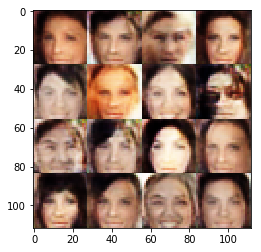

Timestamp 20170805-23-19-17.690 -  Epoch 1/1 -  Step 9710 -  D Loss: 1.0000 - G Loss: 0.8665
Timestamp 20170805-23-19-29.598 -  Epoch 1/1 -  Step 9720 -  D Loss: 1.2726 - G Loss: 1.0393
Timestamp 20170805-23-19-41.493 -  Epoch 1/1 -  Step 9730 -  D Loss: 0.8373 - G Loss: 1.3042
Timestamp 20170805-23-19-53.398 -  Epoch 1/1 -  Step 9740 -  D Loss: 1.0996 - G Loss: 0.6756
Timestamp 20170805-23-20-05.309 -  Epoch 1/1 -  Step 9750 -  D Loss: 1.1092 - G Loss: 1.1175
Timestamp 20170805-23-20-17.218 -  Epoch 1/1 -  Step 9760 -  D Loss: 1.2231 - G Loss: 0.8774
Timestamp 20170805-23-20-29.132 -  Epoch 1/1 -  Step 9770 -  D Loss: 1.2154 - G Loss: 0.7449
Timestamp 20170805-23-20-41.037 -  Epoch 1/1 -  Step 9780 -  D Loss: 1.2073 - G Loss: 1.0347
Timestamp 20170805-23-20-52.926 -  Epoch 1/1 -  Step 9790 -  D Loss: 1.2640 - G Loss: 0.8119
Timestamp 20170805-23-21-04.815 -  Epoch 1/1 -  Step 9800 -  D Loss: 0.9530 - G Loss: 0.8791


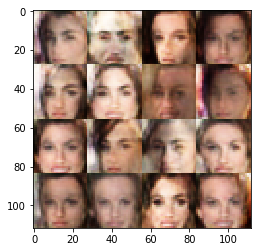

Timestamp 20170805-23-21-17.503 -  Epoch 1/1 -  Step 9810 -  D Loss: 1.0103 - G Loss: 1.2068
Timestamp 20170805-23-21-29.397 -  Epoch 1/1 -  Step 9820 -  D Loss: 1.2401 - G Loss: 1.0718
Timestamp 20170805-23-21-41.299 -  Epoch 1/1 -  Step 9830 -  D Loss: 1.1536 - G Loss: 0.9806
Timestamp 20170805-23-21-53.188 -  Epoch 1/1 -  Step 9840 -  D Loss: 1.2070 - G Loss: 0.9142
Timestamp 20170805-23-22-05.072 -  Epoch 1/1 -  Step 9850 -  D Loss: 1.0943 - G Loss: 1.0473
Timestamp 20170805-23-22-16.996 -  Epoch 1/1 -  Step 9860 -  D Loss: 1.4255 - G Loss: 0.7231
Timestamp 20170805-23-22-28.888 -  Epoch 1/1 -  Step 9870 -  D Loss: 1.4685 - G Loss: 0.7270
Timestamp 20170805-23-22-40.788 -  Epoch 1/1 -  Step 9880 -  D Loss: 1.0007 - G Loss: 1.5387
Timestamp 20170805-23-22-52.716 -  Epoch 1/1 -  Step 9890 -  D Loss: 1.3432 - G Loss: 1.0535
Timestamp 20170805-23-23-04.615 -  Epoch 1/1 -  Step 9900 -  D Loss: 1.1230 - G Loss: 1.1409


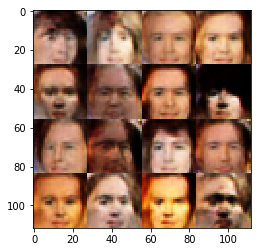

Timestamp 20170805-23-23-17.342 -  Epoch 1/1 -  Step 9910 -  D Loss: 1.0685 - G Loss: 1.3772
Timestamp 20170805-23-23-29.247 -  Epoch 1/1 -  Step 9920 -  D Loss: 0.9684 - G Loss: 1.0384
Timestamp 20170805-23-23-41.138 -  Epoch 1/1 -  Step 9930 -  D Loss: 1.1341 - G Loss: 1.1174
Timestamp 20170805-23-23-53.038 -  Epoch 1/1 -  Step 9940 -  D Loss: 0.9710 - G Loss: 1.4007
Timestamp 20170805-23-24-04.923 -  Epoch 1/1 -  Step 9950 -  D Loss: 1.3327 - G Loss: 0.6921
Timestamp 20170805-23-24-16.820 -  Epoch 1/1 -  Step 9960 -  D Loss: 1.5566 - G Loss: 0.4892
Timestamp 20170805-23-24-28.733 -  Epoch 1/1 -  Step 9970 -  D Loss: 1.0396 - G Loss: 0.8832
Timestamp 20170805-23-24-40.617 -  Epoch 1/1 -  Step 9980 -  D Loss: 1.2642 - G Loss: 0.9884
Timestamp 20170805-23-24-52.529 -  Epoch 1/1 -  Step 9990 -  D Loss: 1.2176 - G Loss: 0.9110
Timestamp 20170805-23-25-04.425 -  Epoch 1/1 -  Step 10000 -  D Loss: 1.3333 - G Loss: 0.7019


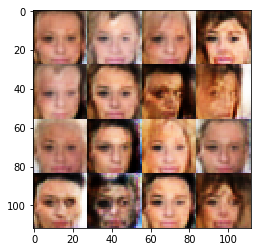

Timestamp 20170805-23-25-17.120 -  Epoch 1/1 -  Step 10010 -  D Loss: 1.2045 - G Loss: 1.0802
Timestamp 20170805-23-25-29.031 -  Epoch 1/1 -  Step 10020 -  D Loss: 0.9347 - G Loss: 0.9456
Timestamp 20170805-23-25-40.938 -  Epoch 1/1 -  Step 10030 -  D Loss: 1.3453 - G Loss: 0.7446
Timestamp 20170805-23-25-52.838 -  Epoch 1/1 -  Step 10040 -  D Loss: 0.8622 - G Loss: 1.1953
Timestamp 20170805-23-26-04.732 -  Epoch 1/1 -  Step 10050 -  D Loss: 1.5812 - G Loss: 1.0204
Timestamp 20170805-23-26-16.640 -  Epoch 1/1 -  Step 10060 -  D Loss: 0.9441 - G Loss: 0.6852
Timestamp 20170805-23-26-28.542 -  Epoch 1/1 -  Step 10070 -  D Loss: 0.9805 - G Loss: 1.4267
Timestamp 20170805-23-26-40.433 -  Epoch 1/1 -  Step 10080 -  D Loss: 1.3163 - G Loss: 0.9152
Timestamp 20170805-23-26-52.330 -  Epoch 1/1 -  Step 10090 -  D Loss: 1.0305 - G Loss: 1.4777
Timestamp 20170805-23-27-04.246 -  Epoch 1/1 -  Step 10100 -  D Loss: 1.2979 - G Loss: 0.5761


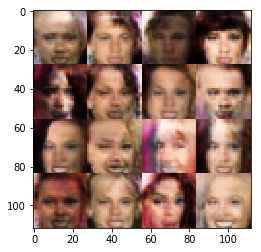

Timestamp 20170805-23-27-16.978 -  Epoch 1/1 -  Step 10110 -  D Loss: 1.0934 - G Loss: 1.0038
Timestamp 20170805-23-27-28.898 -  Epoch 1/1 -  Step 10120 -  D Loss: 0.9043 - G Loss: 1.5565
Timestamp 20170805-23-27-40.811 -  Epoch 1/1 -  Step 10130 -  D Loss: 1.3441 - G Loss: 0.9132
Timestamp 20170805-23-27-52.710 -  Epoch 1/1 -  Step 10140 -  D Loss: 1.1695 - G Loss: 1.0177
Timestamp 20170805-23-28-04.618 -  Epoch 1/1 -  Step 10150 -  D Loss: 0.8848 - G Loss: 1.4550
Timestamp 20170805-23-28-16.534 -  Epoch 1/1 -  Step 10160 -  D Loss: 1.1609 - G Loss: 1.0072
Timestamp 20170805-23-28-28.428 -  Epoch 1/1 -  Step 10170 -  D Loss: 1.1381 - G Loss: 1.0383
Timestamp 20170805-23-28-40.328 -  Epoch 1/1 -  Step 10180 -  D Loss: 1.4238 - G Loss: 0.5386
Timestamp 20170805-23-28-52.218 -  Epoch 1/1 -  Step 10190 -  D Loss: 1.4910 - G Loss: 1.0549
Timestamp 20170805-23-29-04.116 -  Epoch 1/1 -  Step 10200 -  D Loss: 1.1390 - G Loss: 0.9364


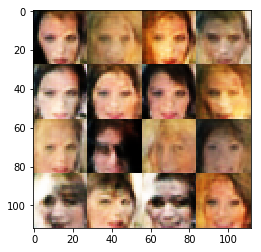

Timestamp 20170805-23-29-16.800 -  Epoch 1/1 -  Step 10210 -  D Loss: 1.0759 - G Loss: 1.1822
Timestamp 20170805-23-29-28.700 -  Epoch 1/1 -  Step 10220 -  D Loss: 1.3257 - G Loss: 0.7429
Timestamp 20170805-23-29-40.612 -  Epoch 1/1 -  Step 10230 -  D Loss: 1.3488 - G Loss: 0.7403
Timestamp 20170805-23-29-52.511 -  Epoch 1/1 -  Step 10240 -  D Loss: 1.1000 - G Loss: 1.2252
Timestamp 20170805-23-30-04.411 -  Epoch 1/1 -  Step 10250 -  D Loss: 1.0578 - G Loss: 0.8208
Timestamp 20170805-23-30-16.316 -  Epoch 1/1 -  Step 10260 -  D Loss: 0.9187 - G Loss: 1.1460
Timestamp 20170805-23-30-28.222 -  Epoch 1/1 -  Step 10270 -  D Loss: 1.0049 - G Loss: 1.1557
Timestamp 20170805-23-30-40.146 -  Epoch 1/1 -  Step 10280 -  D Loss: 1.1310 - G Loss: 0.7846
Timestamp 20170805-23-30-52.048 -  Epoch 1/1 -  Step 10290 -  D Loss: 1.1340 - G Loss: 1.0628
Timestamp 20170805-23-31-03.941 -  Epoch 1/1 -  Step 10300 -  D Loss: 1.0211 - G Loss: 0.8799


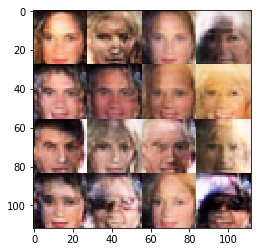

Timestamp 20170805-23-31-16.668 -  Epoch 1/1 -  Step 10310 -  D Loss: 1.4934 - G Loss: 0.9349
Timestamp 20170805-23-31-28.568 -  Epoch 1/1 -  Step 10320 -  D Loss: 1.1701 - G Loss: 1.3658
Timestamp 20170805-23-31-40.433 -  Epoch 1/1 -  Step 10330 -  D Loss: 0.8602 - G Loss: 1.6240
Timestamp 20170805-23-31-52.330 -  Epoch 1/1 -  Step 10340 -  D Loss: 1.2514 - G Loss: 1.1584
Timestamp 20170805-23-32-04.221 -  Epoch 1/1 -  Step 10350 -  D Loss: 1.3529 - G Loss: 0.9968
Timestamp 20170805-23-32-16.129 -  Epoch 1/1 -  Step 10360 -  D Loss: 0.9383 - G Loss: 1.0172
Timestamp 20170805-23-32-28.026 -  Epoch 1/1 -  Step 10370 -  D Loss: 1.1246 - G Loss: 1.2177
Timestamp 20170805-23-32-39.924 -  Epoch 1/1 -  Step 10380 -  D Loss: 1.0687 - G Loss: 1.2540
Timestamp 20170805-23-32-51.821 -  Epoch 1/1 -  Step 10390 -  D Loss: 0.9870 - G Loss: 0.4626
Timestamp 20170805-23-33-03.738 -  Epoch 1/1 -  Step 10400 -  D Loss: 1.0923 - G Loss: 1.1433


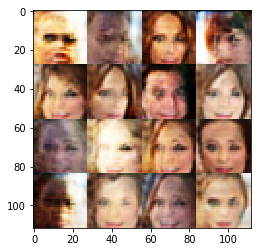

Timestamp 20170805-23-33-16.450 -  Epoch 1/1 -  Step 10410 -  D Loss: 1.3982 - G Loss: 0.7538
Timestamp 20170805-23-33-28.350 -  Epoch 1/1 -  Step 10420 -  D Loss: 0.9462 - G Loss: 1.1964
Timestamp 20170805-23-33-40.229 -  Epoch 1/1 -  Step 10430 -  D Loss: 1.1083 - G Loss: 1.2659
Timestamp 20170805-23-33-52.121 -  Epoch 1/1 -  Step 10440 -  D Loss: 1.1385 - G Loss: 0.8378
Timestamp 20170805-23-34-04.011 -  Epoch 1/1 -  Step 10450 -  D Loss: 1.2164 - G Loss: 1.2446
Timestamp 20170805-23-34-15.925 -  Epoch 1/1 -  Step 10460 -  D Loss: 1.1866 - G Loss: 0.9515
Timestamp 20170805-23-34-27.825 -  Epoch 1/1 -  Step 10470 -  D Loss: 1.2838 - G Loss: 1.1473
Timestamp 20170805-23-34-39.738 -  Epoch 1/1 -  Step 10480 -  D Loss: 1.1289 - G Loss: 1.4518
Timestamp 20170805-23-34-51.634 -  Epoch 1/1 -  Step 10490 -  D Loss: 1.1205 - G Loss: 1.1496
Timestamp 20170805-23-35-03.498 -  Epoch 1/1 -  Step 10500 -  D Loss: 1.0381 - G Loss: 1.4306


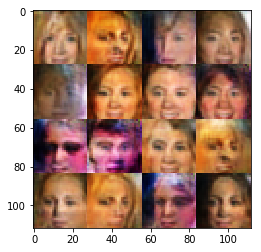

Timestamp 20170805-23-35-16.638 -  Epoch 1/1 -  Step 10510 -  D Loss: 1.2567 - G Loss: 1.1278
Timestamp 20170805-23-35-28.546 -  Epoch 1/1 -  Step 10520 -  D Loss: 1.3686 - G Loss: 0.8844
Timestamp 20170805-23-35-40.434 -  Epoch 1/1 -  Step 10530 -  D Loss: 1.3067 - G Loss: 1.3862
Timestamp 20170805-23-35-52.355 -  Epoch 1/1 -  Step 10540 -  D Loss: 1.1420 - G Loss: 0.7921
Timestamp 20170805-23-36-04.262 -  Epoch 1/1 -  Step 10550 -  D Loss: 1.0848 - G Loss: 1.3659
Timestamp 20170805-23-36-16.166 -  Epoch 1/1 -  Step 10560 -  D Loss: 0.7549 - G Loss: 1.1236
Timestamp 20170805-23-36-28.078 -  Epoch 1/1 -  Step 10570 -  D Loss: 1.1952 - G Loss: 1.0407
Timestamp 20170805-23-36-39.980 -  Epoch 1/1 -  Step 10580 -  D Loss: 0.9083 - G Loss: 1.2504
Timestamp 20170805-23-36-51.902 -  Epoch 1/1 -  Step 10590 -  D Loss: 0.8821 - G Loss: 1.4244
Timestamp 20170805-23-37-03.795 -  Epoch 1/1 -  Step 10600 -  D Loss: 1.0021 - G Loss: 1.4185


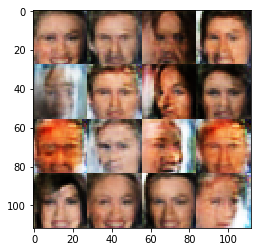

Timestamp 20170805-23-37-16.527 -  Epoch 1/1 -  Step 10610 -  D Loss: 1.3007 - G Loss: 1.4691
Timestamp 20170805-23-37-28.424 -  Epoch 1/1 -  Step 10620 -  D Loss: 1.3827 - G Loss: 0.8369
Timestamp 20170805-23-37-40.331 -  Epoch 1/1 -  Step 10630 -  D Loss: 1.6972 - G Loss: 0.8190
Timestamp 20170805-23-37-52.235 -  Epoch 1/1 -  Step 10640 -  D Loss: 1.0196 - G Loss: 1.0560
Timestamp 20170805-23-38-04.138 -  Epoch 1/1 -  Step 10650 -  D Loss: 1.1112 - G Loss: 1.1272
Timestamp 20170805-23-38-16.044 -  Epoch 1/1 -  Step 10660 -  D Loss: 1.0287 - G Loss: 0.9006
Timestamp 20170805-23-38-27.946 -  Epoch 1/1 -  Step 10670 -  D Loss: 1.1539 - G Loss: 0.7063
Timestamp 20170805-23-38-39.847 -  Epoch 1/1 -  Step 10680 -  D Loss: 1.2925 - G Loss: 1.1288
Timestamp 20170805-23-38-51.751 -  Epoch 1/1 -  Step 10690 -  D Loss: 1.3489 - G Loss: 1.4894
Timestamp 20170805-23-39-03.661 -  Epoch 1/1 -  Step 10700 -  D Loss: 1.2326 - G Loss: 1.0233


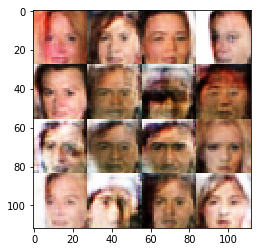

Timestamp 20170805-23-39-16.382 -  Epoch 1/1 -  Step 10710 -  D Loss: 1.0934 - G Loss: 1.1244
Timestamp 20170805-23-39-28.282 -  Epoch 1/1 -  Step 10720 -  D Loss: 1.2010 - G Loss: 0.8196
Timestamp 20170805-23-39-40.181 -  Epoch 1/1 -  Step 10730 -  D Loss: 1.2398 - G Loss: 0.5316
Timestamp 20170805-23-39-52.086 -  Epoch 1/1 -  Step 10740 -  D Loss: 0.8899 - G Loss: 1.1884
Timestamp 20170805-23-40-03.992 -  Epoch 1/1 -  Step 10750 -  D Loss: 1.1111 - G Loss: 1.2452
Timestamp 20170805-23-40-15.893 -  Epoch 1/1 -  Step 10760 -  D Loss: 1.1386 - G Loss: 0.8099
Timestamp 20170805-23-40-27.800 -  Epoch 1/1 -  Step 10770 -  D Loss: 1.2149 - G Loss: 0.8815
Timestamp 20170805-23-40-39.704 -  Epoch 1/1 -  Step 10780 -  D Loss: 1.6439 - G Loss: 1.0482
Timestamp 20170805-23-40-51.610 -  Epoch 1/1 -  Step 10790 -  D Loss: 1.6382 - G Loss: 0.9748
Timestamp 20170805-23-41-03.517 -  Epoch 1/1 -  Step 10800 -  D Loss: 1.0707 - G Loss: 0.5616


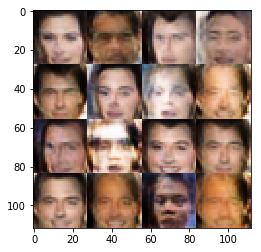

Timestamp 20170805-23-41-16.241 -  Epoch 1/1 -  Step 10810 -  D Loss: 1.5872 - G Loss: 0.8232
Timestamp 20170805-23-41-28.153 -  Epoch 1/1 -  Step 10820 -  D Loss: 1.4661 - G Loss: 0.7991
Timestamp 20170805-23-41-40.072 -  Epoch 1/1 -  Step 10830 -  D Loss: 1.1448 - G Loss: 0.8292
Timestamp 20170805-23-41-51.973 -  Epoch 1/1 -  Step 10840 -  D Loss: 1.1646 - G Loss: 1.2021
Timestamp 20170805-23-42-03.860 -  Epoch 1/1 -  Step 10850 -  D Loss: 1.1537 - G Loss: 0.9002
Timestamp 20170805-23-42-15.779 -  Epoch 1/1 -  Step 10860 -  D Loss: 1.3261 - G Loss: 0.8543
Timestamp 20170805-23-42-27.666 -  Epoch 1/1 -  Step 10870 -  D Loss: 1.1696 - G Loss: 1.1691
Timestamp 20170805-23-42-39.575 -  Epoch 1/1 -  Step 10880 -  D Loss: 1.0217 - G Loss: 0.7843
Timestamp 20170805-23-42-51.473 -  Epoch 1/1 -  Step 10890 -  D Loss: 1.2612 - G Loss: 1.0755
Timestamp 20170805-23-43-03.374 -  Epoch 1/1 -  Step 10900 -  D Loss: 1.1820 - G Loss: 1.0818


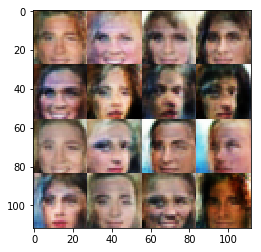

Timestamp 20170805-23-43-16.079 -  Epoch 1/1 -  Step 10910 -  D Loss: 0.7968 - G Loss: 1.1421
Timestamp 20170805-23-43-27.965 -  Epoch 1/1 -  Step 10920 -  D Loss: 1.2421 - G Loss: 0.9345
Timestamp 20170805-23-43-39.867 -  Epoch 1/1 -  Step 10930 -  D Loss: 1.0312 - G Loss: 1.0101
Timestamp 20170805-23-43-51.762 -  Epoch 1/1 -  Step 10940 -  D Loss: 1.3272 - G Loss: 0.9246
Timestamp 20170805-23-44-03.664 -  Epoch 1/1 -  Step 10950 -  D Loss: 1.0258 - G Loss: 0.8103
Timestamp 20170805-23-44-15.554 -  Epoch 1/1 -  Step 10960 -  D Loss: 1.1733 - G Loss: 0.8530
Timestamp 20170805-23-44-27.448 -  Epoch 1/1 -  Step 10970 -  D Loss: 0.9611 - G Loss: 0.8812
Timestamp 20170805-23-44-39.349 -  Epoch 1/1 -  Step 10980 -  D Loss: 1.1719 - G Loss: 0.8633
Timestamp 20170805-23-44-51.247 -  Epoch 1/1 -  Step 10990 -  D Loss: 1.0718 - G Loss: 1.0771
Timestamp 20170805-23-45-03.146 -  Epoch 1/1 -  Step 11000 -  D Loss: 1.1823 - G Loss: 1.2295


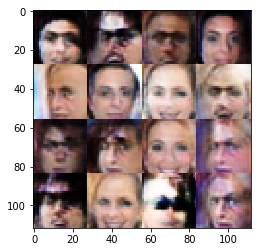

Timestamp 20170805-23-45-15.879 -  Epoch 1/1 -  Step 11010 -  D Loss: 1.5086 - G Loss: 1.0350
Timestamp 20170805-23-45-27.753 -  Epoch 1/1 -  Step 11020 -  D Loss: 1.0904 - G Loss: 0.7935
Timestamp 20170805-23-45-39.683 -  Epoch 1/1 -  Step 11030 -  D Loss: 1.2381 - G Loss: 0.8141
Timestamp 20170805-23-45-51.591 -  Epoch 1/1 -  Step 11040 -  D Loss: 1.0963 - G Loss: 0.9087
Timestamp 20170805-23-46-03.499 -  Epoch 1/1 -  Step 11050 -  D Loss: 1.3715 - G Loss: 0.7857
Timestamp 20170805-23-46-15.422 -  Epoch 1/1 -  Step 11060 -  D Loss: 1.2401 - G Loss: 1.0458
Timestamp 20170805-23-46-27.332 -  Epoch 1/1 -  Step 11070 -  D Loss: 1.3277 - G Loss: 0.8607
Timestamp 20170805-23-46-39.221 -  Epoch 1/1 -  Step 11080 -  D Loss: 1.2310 - G Loss: 0.8014
Timestamp 20170805-23-46-51.124 -  Epoch 1/1 -  Step 11090 -  D Loss: 1.0765 - G Loss: 1.0458
Timestamp 20170805-23-47-03.030 -  Epoch 1/1 -  Step 11100 -  D Loss: 1.1647 - G Loss: 1.0979


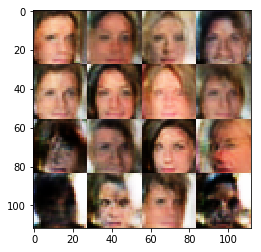

Timestamp 20170805-23-47-15.720 -  Epoch 1/1 -  Step 11110 -  D Loss: 1.2594 - G Loss: 1.3501
Timestamp 20170805-23-47-27.615 -  Epoch 1/1 -  Step 11120 -  D Loss: 1.1754 - G Loss: 1.1135
Timestamp 20170805-23-47-39.512 -  Epoch 1/1 -  Step 11130 -  D Loss: 1.1046 - G Loss: 1.4704
Timestamp 20170805-23-47-51.407 -  Epoch 1/1 -  Step 11140 -  D Loss: 1.2726 - G Loss: 0.6676
Timestamp 20170805-23-48-03.308 -  Epoch 1/1 -  Step 11150 -  D Loss: 1.2695 - G Loss: 0.9041
Timestamp 20170805-23-48-15.210 -  Epoch 1/1 -  Step 11160 -  D Loss: 1.3663 - G Loss: 0.7123
Timestamp 20170805-23-48-27.104 -  Epoch 1/1 -  Step 11170 -  D Loss: 1.0868 - G Loss: 0.9198
Timestamp 20170805-23-48-39.010 -  Epoch 1/1 -  Step 11180 -  D Loss: 1.0867 - G Loss: 0.8730
Timestamp 20170805-23-48-50.916 -  Epoch 1/1 -  Step 11190 -  D Loss: 1.1289 - G Loss: 0.9166
Timestamp 20170805-23-49-02.818 -  Epoch 1/1 -  Step 11200 -  D Loss: 1.3192 - G Loss: 1.0208


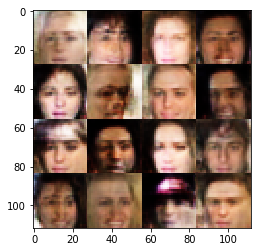

Timestamp 20170805-23-49-15.562 -  Epoch 1/1 -  Step 11210 -  D Loss: 1.2931 - G Loss: 0.8883
Timestamp 20170805-23-49-27.473 -  Epoch 1/1 -  Step 11220 -  D Loss: 1.5095 - G Loss: 0.7447
Timestamp 20170805-23-49-39.369 -  Epoch 1/1 -  Step 11230 -  D Loss: 1.1365 - G Loss: 1.1866
Timestamp 20170805-23-49-51.279 -  Epoch 1/1 -  Step 11240 -  D Loss: 1.2725 - G Loss: 0.9663
Timestamp 20170805-23-50-03.169 -  Epoch 1/1 -  Step 11250 -  D Loss: 1.0717 - G Loss: 0.8820
Timestamp 20170805-23-50-15.065 -  Epoch 1/1 -  Step 11260 -  D Loss: 1.3178 - G Loss: 0.9721
Timestamp 20170805-23-50-26.959 -  Epoch 1/1 -  Step 11270 -  D Loss: 1.2612 - G Loss: 0.7771
Timestamp 20170805-23-50-38.866 -  Epoch 1/1 -  Step 11280 -  D Loss: 1.3539 - G Loss: 0.9295
Timestamp 20170805-23-50-50.757 -  Epoch 1/1 -  Step 11290 -  D Loss: 0.8560 - G Loss: 1.0505
Timestamp 20170805-23-51-02.671 -  Epoch 1/1 -  Step 11300 -  D Loss: 1.1425 - G Loss: 0.7062


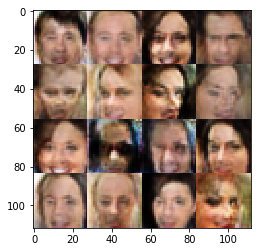

Timestamp 20170805-23-51-15.408 -  Epoch 1/1 -  Step 11310 -  D Loss: 0.9505 - G Loss: 0.8197
Timestamp 20170805-23-51-27.302 -  Epoch 1/1 -  Step 11320 -  D Loss: 0.9831 - G Loss: 1.1263
Timestamp 20170805-23-51-39.195 -  Epoch 1/1 -  Step 11330 -  D Loss: 1.2575 - G Loss: 1.0628
Timestamp 20170805-23-51-51.107 -  Epoch 1/1 -  Step 11340 -  D Loss: 1.2131 - G Loss: 1.1000
Timestamp 20170805-23-52-02.996 -  Epoch 1/1 -  Step 11350 -  D Loss: 1.3776 - G Loss: 0.8101
Timestamp 20170805-23-52-14.910 -  Epoch 1/1 -  Step 11360 -  D Loss: 1.2516 - G Loss: 0.6805
Timestamp 20170805-23-52-26.818 -  Epoch 1/1 -  Step 11370 -  D Loss: 1.2861 - G Loss: 1.1474
Timestamp 20170805-23-52-38.734 -  Epoch 1/1 -  Step 11380 -  D Loss: 1.5105 - G Loss: 0.3872
Timestamp 20170805-23-52-50.637 -  Epoch 1/1 -  Step 11390 -  D Loss: 1.0336 - G Loss: 0.9666
Timestamp 20170805-23-53-02.549 -  Epoch 1/1 -  Step 11400 -  D Loss: 0.8361 - G Loss: 1.2121


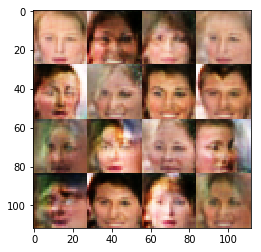

Timestamp 20170805-23-53-15.313 -  Epoch 1/1 -  Step 11410 -  D Loss: 1.1721 - G Loss: 1.3344
Timestamp 20170805-23-53-27.206 -  Epoch 1/1 -  Step 11420 -  D Loss: 1.0397 - G Loss: 1.2085
Timestamp 20170805-23-53-39.109 -  Epoch 1/1 -  Step 11430 -  D Loss: 1.1603 - G Loss: 0.8189
Timestamp 20170805-23-53-51.016 -  Epoch 1/1 -  Step 11440 -  D Loss: 1.1172 - G Loss: 1.1212
Timestamp 20170805-23-54-02.915 -  Epoch 1/1 -  Step 11450 -  D Loss: 0.9397 - G Loss: 1.1828
Timestamp 20170805-23-54-14.805 -  Epoch 1/1 -  Step 11460 -  D Loss: 1.1334 - G Loss: 1.0972
Timestamp 20170805-23-54-26.736 -  Epoch 1/1 -  Step 11470 -  D Loss: 0.9567 - G Loss: 0.7156
Timestamp 20170805-23-54-38.637 -  Epoch 1/1 -  Step 11480 -  D Loss: 1.2505 - G Loss: 1.2028
Timestamp 20170805-23-54-50.546 -  Epoch 1/1 -  Step 11490 -  D Loss: 1.2561 - G Loss: 0.8965
Timestamp 20170805-23-55-02.439 -  Epoch 1/1 -  Step 11500 -  D Loss: 1.3620 - G Loss: 0.8621


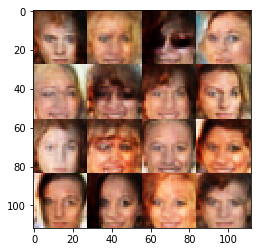

Timestamp 20170805-23-55-15.178 -  Epoch 1/1 -  Step 11510 -  D Loss: 1.0544 - G Loss: 1.1548
Timestamp 20170805-23-55-27.088 -  Epoch 1/1 -  Step 11520 -  D Loss: 0.9407 - G Loss: 0.9629
Timestamp 20170805-23-55-39.010 -  Epoch 1/1 -  Step 11530 -  D Loss: 1.2460 - G Loss: 1.0507
Timestamp 20170805-23-55-50.919 -  Epoch 1/1 -  Step 11540 -  D Loss: 1.3192 - G Loss: 0.8046
Timestamp 20170805-23-56-02.825 -  Epoch 1/1 -  Step 11550 -  D Loss: 1.0742 - G Loss: 1.1442
Timestamp 20170805-23-56-14.736 -  Epoch 1/1 -  Step 11560 -  D Loss: 0.9221 - G Loss: 1.1345
Timestamp 20170805-23-56-26.637 -  Epoch 1/1 -  Step 11570 -  D Loss: 1.1119 - G Loss: 1.0146
Timestamp 20170805-23-56-38.544 -  Epoch 1/1 -  Step 11580 -  D Loss: 1.1409 - G Loss: 1.0680
Timestamp 20170805-23-56-50.439 -  Epoch 1/1 -  Step 11590 -  D Loss: 1.1619 - G Loss: 0.7579
Timestamp 20170805-23-57-02.344 -  Epoch 1/1 -  Step 11600 -  D Loss: 1.0712 - G Loss: 1.0096


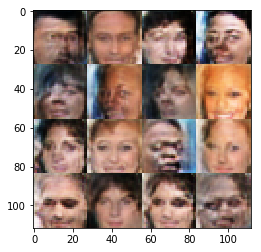

Timestamp 20170805-23-57-15.077 -  Epoch 1/1 -  Step 11610 -  D Loss: 0.9920 - G Loss: 1.2587
Timestamp 20170805-23-57-26.981 -  Epoch 1/1 -  Step 11620 -  D Loss: 1.4038 - G Loss: 0.5556
Timestamp 20170805-23-57-38.864 -  Epoch 1/1 -  Step 11630 -  D Loss: 1.4460 - G Loss: 1.0665
Timestamp 20170805-23-57-50.773 -  Epoch 1/1 -  Step 11640 -  D Loss: 0.9965 - G Loss: 1.3353
Timestamp 20170805-23-58-02.679 -  Epoch 1/1 -  Step 11650 -  D Loss: 1.0201 - G Loss: 1.1989
Timestamp 20170805-23-58-14.606 -  Epoch 1/1 -  Step 11660 -  D Loss: 0.9766 - G Loss: 1.2384
Timestamp 20170805-23-58-26.495 -  Epoch 1/1 -  Step 11670 -  D Loss: 1.1807 - G Loss: 0.8699
Timestamp 20170805-23-58-38.385 -  Epoch 1/1 -  Step 11680 -  D Loss: 1.0163 - G Loss: 0.8853
Timestamp 20170805-23-58-50.296 -  Epoch 1/1 -  Step 11690 -  D Loss: 1.1426 - G Loss: 0.8276
Timestamp 20170805-23-59-02.205 -  Epoch 1/1 -  Step 11700 -  D Loss: 1.3756 - G Loss: 1.1141


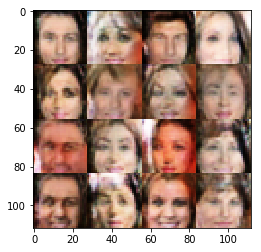

Timestamp 20170805-23-59-14.941 -  Epoch 1/1 -  Step 11710 -  D Loss: 1.1383 - G Loss: 0.9442
Timestamp 20170805-23-59-26.843 -  Epoch 1/1 -  Step 11720 -  D Loss: 1.5284 - G Loss: 0.8550
Timestamp 20170805-23-59-38.740 -  Epoch 1/1 -  Step 11730 -  D Loss: 1.4142 - G Loss: 1.0047
Timestamp 20170805-23-59-50.636 -  Epoch 1/1 -  Step 11740 -  D Loss: 1.1221 - G Loss: 1.2099
Timestamp 20170806-00-00-02.538 -  Epoch 1/1 -  Step 11750 -  D Loss: 1.0500 - G Loss: 0.8237
Timestamp 20170806-00-00-14.423 -  Epoch 1/1 -  Step 11760 -  D Loss: 1.6630 - G Loss: 0.6102
Timestamp 20170806-00-00-26.330 -  Epoch 1/1 -  Step 11770 -  D Loss: 0.9837 - G Loss: 1.3381
Timestamp 20170806-00-00-38.241 -  Epoch 1/1 -  Step 11780 -  D Loss: 1.1905 - G Loss: 1.0130
Timestamp 20170806-00-00-50.139 -  Epoch 1/1 -  Step 11790 -  D Loss: 1.5035 - G Loss: 0.4041
Timestamp 20170806-00-01-02.028 -  Epoch 1/1 -  Step 11800 -  D Loss: 1.4235 - G Loss: 0.5859


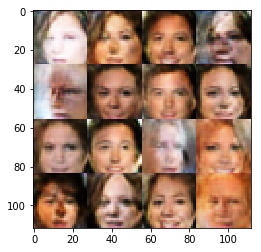

Timestamp 20170806-00-01-14.778 -  Epoch 1/1 -  Step 11810 -  D Loss: 1.1307 - G Loss: 0.6407
Timestamp 20170806-00-01-26.671 -  Epoch 1/1 -  Step 11820 -  D Loss: 1.1592 - G Loss: 0.9530
Timestamp 20170806-00-01-38.582 -  Epoch 1/1 -  Step 11830 -  D Loss: 0.9618 - G Loss: 1.3345
Timestamp 20170806-00-01-50.485 -  Epoch 1/1 -  Step 11840 -  D Loss: 1.2514 - G Loss: 1.1081
Timestamp 20170806-00-02-02.394 -  Epoch 1/1 -  Step 11850 -  D Loss: 1.3919 - G Loss: 0.9676
Timestamp 20170806-00-02-14.301 -  Epoch 1/1 -  Step 11860 -  D Loss: 1.2807 - G Loss: 1.2150
Timestamp 20170806-00-02-26.191 -  Epoch 1/1 -  Step 11870 -  D Loss: 1.0752 - G Loss: 1.5769
Timestamp 20170806-00-02-38.086 -  Epoch 1/1 -  Step 11880 -  D Loss: 0.9235 - G Loss: 1.3582
Timestamp 20170806-00-02-49.986 -  Epoch 1/1 -  Step 11890 -  D Loss: 1.2130 - G Loss: 0.8427
Timestamp 20170806-00-03-01.873 -  Epoch 1/1 -  Step 11900 -  D Loss: 1.0821 - G Loss: 1.0857


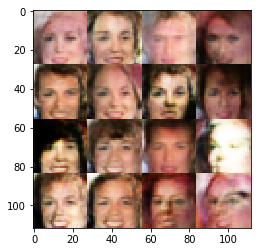

Timestamp 20170806-00-03-14.597 -  Epoch 1/1 -  Step 11910 -  D Loss: 1.1320 - G Loss: 1.0952
Timestamp 20170806-00-03-26.505 -  Epoch 1/1 -  Step 11920 -  D Loss: 1.1328 - G Loss: 1.3078
Timestamp 20170806-00-03-38.411 -  Epoch 1/1 -  Step 11930 -  D Loss: 1.3811 - G Loss: 0.8542
Timestamp 20170806-00-03-50.317 -  Epoch 1/1 -  Step 11940 -  D Loss: 1.2216 - G Loss: 0.5644
Timestamp 20170806-00-04-02.200 -  Epoch 1/1 -  Step 11950 -  D Loss: 1.4222 - G Loss: 1.0464
Timestamp 20170806-00-04-14.084 -  Epoch 1/1 -  Step 11960 -  D Loss: 1.2476 - G Loss: 0.8000
Timestamp 20170806-00-04-25.985 -  Epoch 1/1 -  Step 11970 -  D Loss: 0.9776 - G Loss: 1.2195
Timestamp 20170806-00-04-37.886 -  Epoch 1/1 -  Step 11980 -  D Loss: 1.4949 - G Loss: 1.3372
Timestamp 20170806-00-04-49.784 -  Epoch 1/1 -  Step 11990 -  D Loss: 1.2943 - G Loss: 1.7945
Timestamp 20170806-00-05-01.693 -  Epoch 1/1 -  Step 12000 -  D Loss: 1.1747 - G Loss: 1.0307


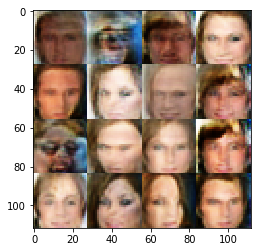

Timestamp 20170806-00-05-14.450 -  Epoch 1/1 -  Step 12010 -  D Loss: 1.0544 - G Loss: 0.8477
Timestamp 20170806-00-05-26.339 -  Epoch 1/1 -  Step 12020 -  D Loss: 1.1830 - G Loss: 1.4812
Timestamp 20170806-00-05-38.238 -  Epoch 1/1 -  Step 12030 -  D Loss: 1.3289 - G Loss: 1.0226
Timestamp 20170806-00-05-50.124 -  Epoch 1/1 -  Step 12040 -  D Loss: 0.9330 - G Loss: 1.3448
Timestamp 20170806-00-06-02.010 -  Epoch 1/1 -  Step 12050 -  D Loss: 1.1170 - G Loss: 1.1920
Timestamp 20170806-00-06-13.913 -  Epoch 1/1 -  Step 12060 -  D Loss: 1.5463 - G Loss: 0.7455
Timestamp 20170806-00-06-25.817 -  Epoch 1/1 -  Step 12070 -  D Loss: 1.0970 - G Loss: 1.0610
Timestamp 20170806-00-06-37.729 -  Epoch 1/1 -  Step 12080 -  D Loss: 1.4689 - G Loss: 1.2242
Timestamp 20170806-00-06-49.635 -  Epoch 1/1 -  Step 12090 -  D Loss: 1.1564 - G Loss: 1.1128
Timestamp 20170806-00-07-01.522 -  Epoch 1/1 -  Step 12100 -  D Loss: 0.9191 - G Loss: 1.5925


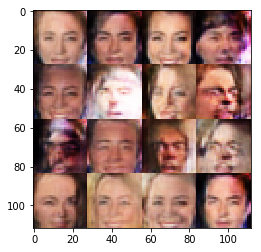

Timestamp 20170806-00-07-14.227 -  Epoch 1/1 -  Step 12110 -  D Loss: 1.1958 - G Loss: 0.7773
Timestamp 20170806-00-07-26.118 -  Epoch 1/1 -  Step 12120 -  D Loss: 0.9094 - G Loss: 1.3062
Timestamp 20170806-00-07-38.000 -  Epoch 1/1 -  Step 12130 -  D Loss: 1.3349 - G Loss: 0.8351
Timestamp 20170806-00-07-49.885 -  Epoch 1/1 -  Step 12140 -  D Loss: 0.9835 - G Loss: 0.9053
Timestamp 20170806-00-08-01.809 -  Epoch 1/1 -  Step 12150 -  D Loss: 1.0680 - G Loss: 1.0778
Timestamp 20170806-00-08-13.701 -  Epoch 1/1 -  Step 12160 -  D Loss: 1.5062 - G Loss: 0.6503
Timestamp 20170806-00-08-25.620 -  Epoch 1/1 -  Step 12170 -  D Loss: 1.2643 - G Loss: 1.2274
Timestamp 20170806-00-08-37.543 -  Epoch 1/1 -  Step 12180 -  D Loss: 1.6124 - G Loss: 0.8073
Timestamp 20170806-00-08-49.436 -  Epoch 1/1 -  Step 12190 -  D Loss: 1.3192 - G Loss: 0.9658
Timestamp 20170806-00-09-01.329 -  Epoch 1/1 -  Step 12200 -  D Loss: 1.1097 - G Loss: 0.9600


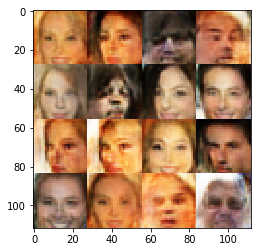

Timestamp 20170806-00-09-14.034 -  Epoch 1/1 -  Step 12210 -  D Loss: 1.3618 - G Loss: 0.8258
Timestamp 20170806-00-09-25.926 -  Epoch 1/1 -  Step 12220 -  D Loss: 1.1338 - G Loss: 1.2709
Timestamp 20170806-00-09-37.831 -  Epoch 1/1 -  Step 12230 -  D Loss: 1.4332 - G Loss: 1.2512
Timestamp 20170806-00-09-49.735 -  Epoch 1/1 -  Step 12240 -  D Loss: 1.1231 - G Loss: 0.8140
Timestamp 20170806-00-10-01.644 -  Epoch 1/1 -  Step 12250 -  D Loss: 1.0478 - G Loss: 0.7701
Timestamp 20170806-00-10-13.540 -  Epoch 1/1 -  Step 12260 -  D Loss: 1.1933 - G Loss: 1.1010
Timestamp 20170806-00-10-25.442 -  Epoch 1/1 -  Step 12270 -  D Loss: 1.3792 - G Loss: 0.8798
Timestamp 20170806-00-10-37.344 -  Epoch 1/1 -  Step 12280 -  D Loss: 1.5086 - G Loss: 0.7641
Timestamp 20170806-00-10-49.244 -  Epoch 1/1 -  Step 12290 -  D Loss: 1.3457 - G Loss: 1.1396
Timestamp 20170806-00-11-01.150 -  Epoch 1/1 -  Step 12300 -  D Loss: 1.1325 - G Loss: 1.1025


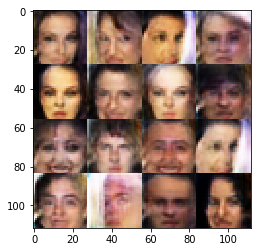

Timestamp 20170806-00-11-13.868 -  Epoch 1/1 -  Step 12310 -  D Loss: 1.3170 - G Loss: 1.1008
Timestamp 20170806-00-11-25.766 -  Epoch 1/1 -  Step 12320 -  D Loss: 1.4761 - G Loss: 1.1836
Timestamp 20170806-00-11-37.676 -  Epoch 1/1 -  Step 12330 -  D Loss: 1.2300 - G Loss: 1.1572
Timestamp 20170806-00-11-49.555 -  Epoch 1/1 -  Step 12340 -  D Loss: 1.3910 - G Loss: 1.1706
Timestamp 20170806-00-12-01.455 -  Epoch 1/1 -  Step 12350 -  D Loss: 1.1310 - G Loss: 1.1178
Timestamp 20170806-00-12-13.359 -  Epoch 1/1 -  Step 12360 -  D Loss: 1.4345 - G Loss: 0.5964
Timestamp 20170806-00-12-25.266 -  Epoch 1/1 -  Step 12370 -  D Loss: 1.1748 - G Loss: 0.7000
Timestamp 20170806-00-12-37.169 -  Epoch 1/1 -  Step 12380 -  D Loss: 1.2438 - G Loss: 1.1544
Timestamp 20170806-00-12-49.078 -  Epoch 1/1 -  Step 12390 -  D Loss: 1.3013 - G Loss: 1.0361
Timestamp 20170806-00-13-00.984 -  Epoch 1/1 -  Step 12400 -  D Loss: 1.0707 - G Loss: 1.1376


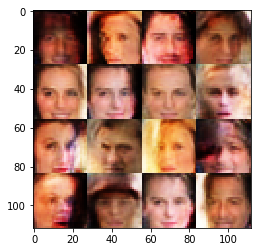

Timestamp 20170806-00-13-13.719 -  Epoch 1/1 -  Step 12410 -  D Loss: 1.4793 - G Loss: 0.9440
Timestamp 20170806-00-13-25.636 -  Epoch 1/1 -  Step 12420 -  D Loss: 0.8794 - G Loss: 1.1481
Timestamp 20170806-00-13-37.547 -  Epoch 1/1 -  Step 12430 -  D Loss: 1.1951 - G Loss: 0.8249
Timestamp 20170806-00-13-49.458 -  Epoch 1/1 -  Step 12440 -  D Loss: 1.2013 - G Loss: 1.2176
Timestamp 20170806-00-14-01.363 -  Epoch 1/1 -  Step 12450 -  D Loss: 1.3276 - G Loss: 0.9976
Timestamp 20170806-00-14-13.259 -  Epoch 1/1 -  Step 12460 -  D Loss: 1.2760 - G Loss: 0.9955
Timestamp 20170806-00-14-25.160 -  Epoch 1/1 -  Step 12470 -  D Loss: 1.1718 - G Loss: 1.2115
Timestamp 20170806-00-14-37.077 -  Epoch 1/1 -  Step 12480 -  D Loss: 1.1966 - G Loss: 0.8429
Timestamp 20170806-00-14-48.967 -  Epoch 1/1 -  Step 12490 -  D Loss: 0.9305 - G Loss: 0.9476
Timestamp 20170806-00-15-00.875 -  Epoch 1/1 -  Step 12500 -  D Loss: 1.2034 - G Loss: 1.0622


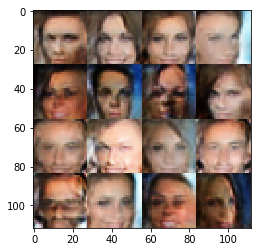

Timestamp 20170806-00-15-13.658 -  Epoch 1/1 -  Step 12510 -  D Loss: 1.4575 - G Loss: 0.8177
Timestamp 20170806-00-15-25.575 -  Epoch 1/1 -  Step 12520 -  D Loss: 1.0344 - G Loss: 1.4654
Timestamp 20170806-00-15-37.502 -  Epoch 1/1 -  Step 12530 -  D Loss: 1.3172 - G Loss: 0.8985
Timestamp 20170806-00-15-49.411 -  Epoch 1/1 -  Step 12540 -  D Loss: 1.2266 - G Loss: 0.8661
Timestamp 20170806-00-16-01.307 -  Epoch 1/1 -  Step 12550 -  D Loss: 1.3623 - G Loss: 0.8882
Timestamp 20170806-00-16-13.199 -  Epoch 1/1 -  Step 12560 -  D Loss: 1.2626 - G Loss: 1.2924
Timestamp 20170806-00-16-25.111 -  Epoch 1/1 -  Step 12570 -  D Loss: 0.9794 - G Loss: 0.8139
Timestamp 20170806-00-16-37.008 -  Epoch 1/1 -  Step 12580 -  D Loss: 1.3530 - G Loss: 1.1241
Timestamp 20170806-00-16-48.924 -  Epoch 1/1 -  Step 12590 -  D Loss: 1.4024 - G Loss: 0.6917
Timestamp 20170806-00-17-00.823 -  Epoch 1/1 -  Step 12600 -  D Loss: 1.4936 - G Loss: 0.8190


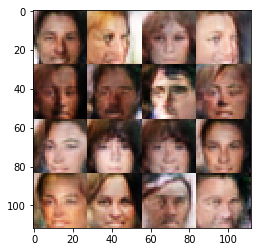

Timestamp 20170806-00-17-13.571 -  Epoch 1/1 -  Step 12610 -  D Loss: 1.2990 - G Loss: 1.0948
Timestamp 20170806-00-17-25.463 -  Epoch 1/1 -  Step 12620 -  D Loss: 1.2626 - G Loss: 0.9053
Timestamp 20170806-00-17-37.382 -  Epoch 1/1 -  Step 12630 -  D Loss: 0.9547 - G Loss: 1.4979
Timestamp 20170806-00-17-49.286 -  Epoch 1/1 -  Step 12640 -  D Loss: 1.4752 - G Loss: 0.6486
Timestamp 20170806-00-18-01.211 -  Epoch 1/1 -  Step 12650 -  D Loss: 1.2580 - G Loss: 0.6535
Timestamp 20170806-00-18-13.101 -  Epoch 1/1 -  Step 12660 -  D Loss: 1.0027 - G Loss: 0.8755
Timestamp 20170806-00-18-24.992 -  Epoch 1/1 -  Step 12670 -  D Loss: 0.9739 - G Loss: 1.2166
Timestamp 20170806-00-18-36.882 -  Epoch 1/1 -  Step 12680 -  D Loss: 1.3464 - G Loss: 1.2250
Timestamp 20170806-00-18-48.773 -  Epoch 1/1 -  Step 12690 -  D Loss: 1.3864 - G Loss: 0.8664
Timestamp 20170806-00-19-00.656 -  Epoch 1/1 -  Step 12700 -  D Loss: 0.9344 - G Loss: 1.6100


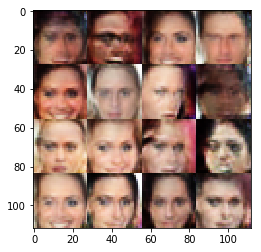

Timestamp 20170806-00-19-13.387 -  Epoch 1/1 -  Step 12710 -  D Loss: 1.1480 - G Loss: 0.8561
Timestamp 20170806-00-19-25.298 -  Epoch 1/1 -  Step 12720 -  D Loss: 1.5095 - G Loss: 0.9663
Timestamp 20170806-00-19-37.184 -  Epoch 1/1 -  Step 12730 -  D Loss: 1.3272 - G Loss: 0.7681
Timestamp 20170806-00-19-49.069 -  Epoch 1/1 -  Step 12740 -  D Loss: 1.3857 - G Loss: 0.7194
Timestamp 20170806-00-20-00.963 -  Epoch 1/1 -  Step 12750 -  D Loss: 1.0880 - G Loss: 0.7932
Timestamp 20170806-00-20-12.846 -  Epoch 1/1 -  Step 12760 -  D Loss: 1.2649 - G Loss: 1.1052
Timestamp 20170806-00-20-24.741 -  Epoch 1/1 -  Step 12770 -  D Loss: 1.2190 - G Loss: 1.1567
Timestamp 20170806-00-20-36.631 -  Epoch 1/1 -  Step 12780 -  D Loss: 1.3407 - G Loss: 0.8913
Timestamp 20170806-00-20-48.527 -  Epoch 1/1 -  Step 12790 -  D Loss: 1.3746 - G Loss: 1.0258
Timestamp 20170806-00-21-00.417 -  Epoch 1/1 -  Step 12800 -  D Loss: 1.4285 - G Loss: 0.8130


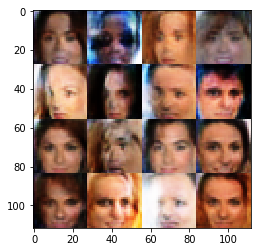

Timestamp 20170806-00-21-13.147 -  Epoch 1/1 -  Step 12810 -  D Loss: 1.0591 - G Loss: 0.8206
Timestamp 20170806-00-21-25.048 -  Epoch 1/1 -  Step 12820 -  D Loss: 1.2743 - G Loss: 1.2885
Timestamp 20170806-00-21-36.947 -  Epoch 1/1 -  Step 12830 -  D Loss: 1.1997 - G Loss: 0.8747
Timestamp 20170806-00-21-48.857 -  Epoch 1/1 -  Step 12840 -  D Loss: 1.1014 - G Loss: 0.8247
Timestamp 20170806-00-22-00.772 -  Epoch 1/1 -  Step 12850 -  D Loss: 1.2234 - G Loss: 0.8065
Timestamp 20170806-00-22-12.670 -  Epoch 1/1 -  Step 12860 -  D Loss: 1.4708 - G Loss: 1.2359
Timestamp 20170806-00-22-24.555 -  Epoch 1/1 -  Step 12870 -  D Loss: 1.1747 - G Loss: 1.2541
Timestamp 20170806-00-22-36.454 -  Epoch 1/1 -  Step 12880 -  D Loss: 1.3790 - G Loss: 0.6285
Timestamp 20170806-00-22-48.358 -  Epoch 1/1 -  Step 12890 -  D Loss: 1.2290 - G Loss: 0.7619
Timestamp 20170806-00-23-00.256 -  Epoch 1/1 -  Step 12900 -  D Loss: 0.9953 - G Loss: 0.9589


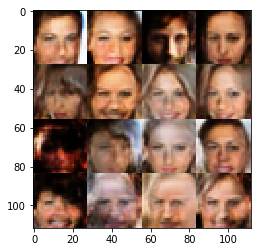

Timestamp 20170806-00-23-13.000 -  Epoch 1/1 -  Step 12910 -  D Loss: 1.2635 - G Loss: 1.0395
Timestamp 20170806-00-23-24.912 -  Epoch 1/1 -  Step 12920 -  D Loss: 1.0105 - G Loss: 1.0074
Timestamp 20170806-00-23-36.815 -  Epoch 1/1 -  Step 12930 -  D Loss: 1.1409 - G Loss: 0.9760
Timestamp 20170806-00-23-48.727 -  Epoch 1/1 -  Step 12940 -  D Loss: 1.3438 - G Loss: 1.4270
Timestamp 20170806-00-24-00.627 -  Epoch 1/1 -  Step 12950 -  D Loss: 1.3164 - G Loss: 1.5407
Timestamp 20170806-00-24-12.533 -  Epoch 1/1 -  Step 12960 -  D Loss: 1.1628 - G Loss: 0.8525
Timestamp 20170806-00-24-24.432 -  Epoch 1/1 -  Step 12970 -  D Loss: 0.9488 - G Loss: 1.0468
Timestamp 20170806-00-24-36.334 -  Epoch 1/1 -  Step 12980 -  D Loss: 1.2516 - G Loss: 0.8709
Timestamp 20170806-00-24-48.221 -  Epoch 1/1 -  Step 12990 -  D Loss: 1.1368 - G Loss: 0.9034
Timestamp 20170806-00-25-00.136 -  Epoch 1/1 -  Step 13000 -  D Loss: 1.4104 - G Loss: 0.6608


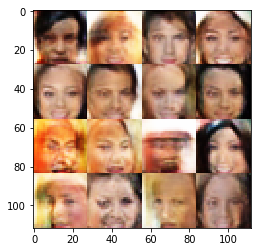

Timestamp 20170806-00-25-12.887 -  Epoch 1/1 -  Step 13010 -  D Loss: 1.2060 - G Loss: 0.6310
Timestamp 20170806-00-25-24.789 -  Epoch 1/1 -  Step 13020 -  D Loss: 1.3029 - G Loss: 0.8428
Timestamp 20170806-00-25-36.692 -  Epoch 1/1 -  Step 13030 -  D Loss: 1.5698 - G Loss: 0.8148
Timestamp 20170806-00-25-48.578 -  Epoch 1/1 -  Step 13040 -  D Loss: 1.2921 - G Loss: 0.8901
Timestamp 20170806-00-26-00.485 -  Epoch 1/1 -  Step 13050 -  D Loss: 1.1627 - G Loss: 0.9879
Timestamp 20170806-00-26-12.405 -  Epoch 1/1 -  Step 13060 -  D Loss: 0.9393 - G Loss: 0.6704
Timestamp 20170806-00-26-24.297 -  Epoch 1/1 -  Step 13070 -  D Loss: 1.4424 - G Loss: 0.9042
Timestamp 20170806-00-26-36.194 -  Epoch 1/1 -  Step 13080 -  D Loss: 1.3857 - G Loss: 1.0488
Timestamp 20170806-00-26-48.078 -  Epoch 1/1 -  Step 13090 -  D Loss: 1.1858 - G Loss: 1.0651
Timestamp 20170806-00-26-59.960 -  Epoch 1/1 -  Step 13100 -  D Loss: 1.2404 - G Loss: 0.8892


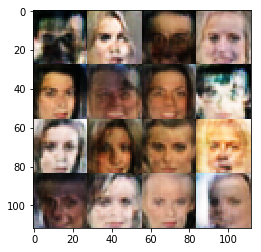

Timestamp 20170806-00-27-12.713 -  Epoch 1/1 -  Step 13110 -  D Loss: 0.9293 - G Loss: 1.3020
Timestamp 20170806-00-27-24.605 -  Epoch 1/1 -  Step 13120 -  D Loss: 1.1373 - G Loss: 0.8790
Timestamp 20170806-00-27-36.507 -  Epoch 1/1 -  Step 13130 -  D Loss: 0.9425 - G Loss: 1.4187
Timestamp 20170806-00-27-48.398 -  Epoch 1/1 -  Step 13140 -  D Loss: 1.1859 - G Loss: 0.9474
Timestamp 20170806-00-28-00.287 -  Epoch 1/1 -  Step 13150 -  D Loss: 1.1532 - G Loss: 0.8387
Timestamp 20170806-00-28-12.181 -  Epoch 1/1 -  Step 13160 -  D Loss: 1.1639 - G Loss: 1.0274
Timestamp 20170806-00-28-24.077 -  Epoch 1/1 -  Step 13170 -  D Loss: 1.1467 - G Loss: 1.1278
Timestamp 20170806-00-28-35.973 -  Epoch 1/1 -  Step 13180 -  D Loss: 1.1044 - G Loss: 1.0523
Timestamp 20170806-00-28-47.893 -  Epoch 1/1 -  Step 13190 -  D Loss: 1.3399 - G Loss: 1.0358
Timestamp 20170806-00-28-59.801 -  Epoch 1/1 -  Step 13200 -  D Loss: 1.0080 - G Loss: 0.8470


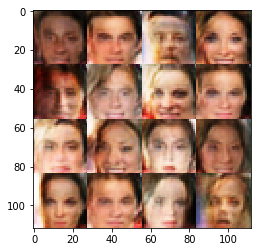

Timestamp 20170806-00-29-12.577 -  Epoch 1/1 -  Step 13210 -  D Loss: 1.7917 - G Loss: 0.6145
Timestamp 20170806-00-29-24.478 -  Epoch 1/1 -  Step 13220 -  D Loss: 1.0808 - G Loss: 1.2617
Timestamp 20170806-00-29-36.376 -  Epoch 1/1 -  Step 13230 -  D Loss: 1.4294 - G Loss: 0.9427
Timestamp 20170806-00-29-48.272 -  Epoch 1/1 -  Step 13240 -  D Loss: 1.2288 - G Loss: 0.9521
Timestamp 20170806-00-30-00.176 -  Epoch 1/1 -  Step 13250 -  D Loss: 1.3017 - G Loss: 0.9068
Timestamp 20170806-00-30-12.075 -  Epoch 1/1 -  Step 13260 -  D Loss: 1.3528 - G Loss: 0.9780
Timestamp 20170806-00-30-23.970 -  Epoch 1/1 -  Step 13270 -  D Loss: 1.1710 - G Loss: 0.8097
Timestamp 20170806-00-30-35.854 -  Epoch 1/1 -  Step 13280 -  D Loss: 1.2024 - G Loss: 1.3886
Timestamp 20170806-00-30-47.757 -  Epoch 1/1 -  Step 13290 -  D Loss: 1.1094 - G Loss: 0.7006
Timestamp 20170806-00-30-59.657 -  Epoch 1/1 -  Step 13300 -  D Loss: 1.3083 - G Loss: 0.7671


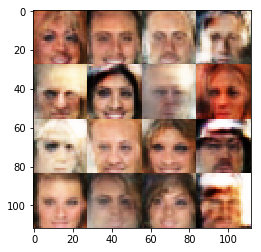

Timestamp 20170806-00-31-12.414 -  Epoch 1/1 -  Step 13310 -  D Loss: 1.2472 - G Loss: 0.8145
Timestamp 20170806-00-31-24.318 -  Epoch 1/1 -  Step 13320 -  D Loss: 1.4489 - G Loss: 0.5136
Timestamp 20170806-00-31-36.216 -  Epoch 1/1 -  Step 13330 -  D Loss: 1.1647 - G Loss: 0.9597
Timestamp 20170806-00-31-48.113 -  Epoch 1/1 -  Step 13340 -  D Loss: 0.9353 - G Loss: 1.2740
Timestamp 20170806-00-32-00.023 -  Epoch 1/1 -  Step 13350 -  D Loss: 1.2536 - G Loss: 1.0467
Timestamp 20170806-00-32-11.910 -  Epoch 1/1 -  Step 13360 -  D Loss: 1.4300 - G Loss: 0.6469
Timestamp 20170806-00-32-23.796 -  Epoch 1/1 -  Step 13370 -  D Loss: 1.4545 - G Loss: 0.6057
Timestamp 20170806-00-32-35.694 -  Epoch 1/1 -  Step 13380 -  D Loss: 1.1817 - G Loss: 1.2409
Timestamp 20170806-00-32-47.579 -  Epoch 1/1 -  Step 13390 -  D Loss: 1.1694 - G Loss: 0.8907
Timestamp 20170806-00-32-59.494 -  Epoch 1/1 -  Step 13400 -  D Loss: 1.0596 - G Loss: 0.9294


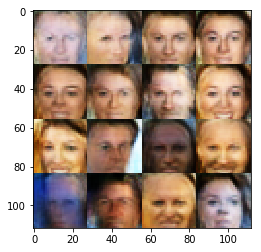

Timestamp 20170806-00-33-12.252 -  Epoch 1/1 -  Step 13410 -  D Loss: 1.5565 - G Loss: 0.7117
Timestamp 20170806-00-33-24.146 -  Epoch 1/1 -  Step 13420 -  D Loss: 1.3732 - G Loss: 0.8896
Timestamp 20170806-00-33-36.047 -  Epoch 1/1 -  Step 13430 -  D Loss: 1.3405 - G Loss: 0.9062
Timestamp 20170806-00-33-47.938 -  Epoch 1/1 -  Step 13440 -  D Loss: 1.0278 - G Loss: 0.7813
Timestamp 20170806-00-33-59.844 -  Epoch 1/1 -  Step 13450 -  D Loss: 1.4285 - G Loss: 0.7686
Timestamp 20170806-00-34-11.741 -  Epoch 1/1 -  Step 13460 -  D Loss: 1.3090 - G Loss: 1.0369
Timestamp 20170806-00-34-23.626 -  Epoch 1/1 -  Step 13470 -  D Loss: 1.3283 - G Loss: 0.9615
Timestamp 20170806-00-34-35.516 -  Epoch 1/1 -  Step 13480 -  D Loss: 1.0210 - G Loss: 1.0617
Timestamp 20170806-00-34-47.407 -  Epoch 1/1 -  Step 13490 -  D Loss: 1.3881 - G Loss: 0.7261
Timestamp 20170806-00-34-59.302 -  Epoch 1/1 -  Step 13500 -  D Loss: 1.2313 - G Loss: 0.8654


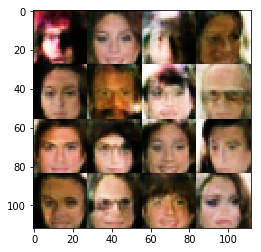

Timestamp 20170806-00-35-12.081 -  Epoch 1/1 -  Step 13510 -  D Loss: 1.2609 - G Loss: 0.8221
Timestamp 20170806-00-35-23.989 -  Epoch 1/1 -  Step 13520 -  D Loss: 1.1094 - G Loss: 0.8960
Timestamp 20170806-00-35-35.855 -  Epoch 1/1 -  Step 13530 -  D Loss: 1.0654 - G Loss: 1.1056
Timestamp 20170806-00-35-47.775 -  Epoch 1/1 -  Step 13540 -  D Loss: 1.0855 - G Loss: 0.9691
Timestamp 20170806-00-35-59.684 -  Epoch 1/1 -  Step 13550 -  D Loss: 1.3282 - G Loss: 0.7615
Timestamp 20170806-00-36-11.582 -  Epoch 1/1 -  Step 13560 -  D Loss: 1.1951 - G Loss: 0.9276
Timestamp 20170806-00-36-23.496 -  Epoch 1/1 -  Step 13570 -  D Loss: 1.3214 - G Loss: 0.7003
Timestamp 20170806-00-36-35.397 -  Epoch 1/1 -  Step 13580 -  D Loss: 1.3035 - G Loss: 0.6758
Timestamp 20170806-00-36-47.286 -  Epoch 1/1 -  Step 13590 -  D Loss: 1.0548 - G Loss: 0.7653
Timestamp 20170806-00-36-59.182 -  Epoch 1/1 -  Step 13600 -  D Loss: 1.1024 - G Loss: 0.9993


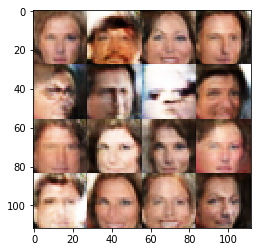

Timestamp 20170806-00-37-11.928 -  Epoch 1/1 -  Step 13610 -  D Loss: 1.1656 - G Loss: 0.9557
Timestamp 20170806-00-37-23.816 -  Epoch 1/1 -  Step 13620 -  D Loss: 1.2804 - G Loss: 0.6818
Timestamp 20170806-00-37-35.738 -  Epoch 1/1 -  Step 13630 -  D Loss: 1.2751 - G Loss: 0.7315
Timestamp 20170806-00-37-47.649 -  Epoch 1/1 -  Step 13640 -  D Loss: 1.2339 - G Loss: 0.8753
Timestamp 20170806-00-37-59.552 -  Epoch 1/1 -  Step 13650 -  D Loss: 1.1812 - G Loss: 0.9939
Timestamp 20170806-00-38-11.445 -  Epoch 1/1 -  Step 13660 -  D Loss: 1.3087 - G Loss: 0.9016
Timestamp 20170806-00-38-23.332 -  Epoch 1/1 -  Step 13670 -  D Loss: 1.3151 - G Loss: 0.7186
Timestamp 20170806-00-38-35.233 -  Epoch 1/1 -  Step 13680 -  D Loss: 1.0550 - G Loss: 1.3809
Timestamp 20170806-00-38-47.135 -  Epoch 1/1 -  Step 13690 -  D Loss: 1.1680 - G Loss: 0.8569
Timestamp 20170806-00-38-59.035 -  Epoch 1/1 -  Step 13700 -  D Loss: 1.0703 - G Loss: 0.6890


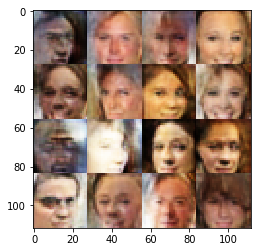

Timestamp 20170806-00-39-11.816 -  Epoch 1/1 -  Step 13710 -  D Loss: 0.9566 - G Loss: 1.3139
Timestamp 20170806-00-39-23.723 -  Epoch 1/1 -  Step 13720 -  D Loss: 1.1396 - G Loss: 0.8154
Timestamp 20170806-00-39-35.612 -  Epoch 1/1 -  Step 13730 -  D Loss: 1.2375 - G Loss: 0.9097
Timestamp 20170806-00-39-47.515 -  Epoch 1/1 -  Step 13740 -  D Loss: 0.9576 - G Loss: 1.2224
Timestamp 20170806-00-39-59.404 -  Epoch 1/1 -  Step 13750 -  D Loss: 1.0881 - G Loss: 0.9271
Timestamp 20170806-00-40-11.321 -  Epoch 1/1 -  Step 13760 -  D Loss: 1.2050 - G Loss: 1.0146
Timestamp 20170806-00-40-23.225 -  Epoch 1/1 -  Step 13770 -  D Loss: 1.1938 - G Loss: 0.9146
Timestamp 20170806-00-40-35.122 -  Epoch 1/1 -  Step 13780 -  D Loss: 1.0643 - G Loss: 1.1291
Timestamp 20170806-00-40-47.002 -  Epoch 1/1 -  Step 13790 -  D Loss: 1.2524 - G Loss: 1.1278
Timestamp 20170806-00-40-58.914 -  Epoch 1/1 -  Step 13800 -  D Loss: 1.0144 - G Loss: 0.7926


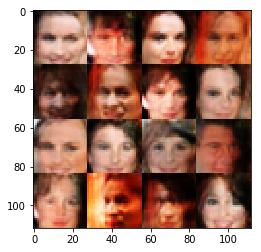

Timestamp 20170806-00-41-11.681 -  Epoch 1/1 -  Step 13810 -  D Loss: 1.1247 - G Loss: 1.0771
Timestamp 20170806-00-41-23.566 -  Epoch 1/1 -  Step 13820 -  D Loss: 1.2856 - G Loss: 1.0700
Timestamp 20170806-00-41-35.451 -  Epoch 1/1 -  Step 13830 -  D Loss: 1.3401 - G Loss: 0.9584
Timestamp 20170806-00-41-47.349 -  Epoch 1/1 -  Step 13840 -  D Loss: 0.9099 - G Loss: 1.4736
Timestamp 20170806-00-41-59.245 -  Epoch 1/1 -  Step 13850 -  D Loss: 1.1108 - G Loss: 0.8957
Timestamp 20170806-00-42-11.140 -  Epoch 1/1 -  Step 13860 -  D Loss: 1.2837 - G Loss: 1.0857
Timestamp 20170806-00-42-23.030 -  Epoch 1/1 -  Step 13870 -  D Loss: 1.1578 - G Loss: 0.9582
Timestamp 20170806-00-42-34.935 -  Epoch 1/1 -  Step 13880 -  D Loss: 1.2710 - G Loss: 0.7701
Timestamp 20170806-00-42-46.836 -  Epoch 1/1 -  Step 13890 -  D Loss: 1.5190 - G Loss: 0.6949
Timestamp 20170806-00-42-58.725 -  Epoch 1/1 -  Step 13900 -  D Loss: 1.3256 - G Loss: 0.5861


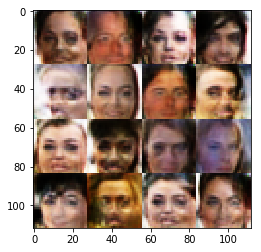

Timestamp 20170806-00-43-11.975 -  Epoch 1/1 -  Step 13910 -  D Loss: 1.0623 - G Loss: 1.2848
Timestamp 20170806-00-43-23.863 -  Epoch 1/1 -  Step 13920 -  D Loss: 1.0850 - G Loss: 0.8968
Timestamp 20170806-00-43-35.766 -  Epoch 1/1 -  Step 13930 -  D Loss: 0.9433 - G Loss: 1.3211
Timestamp 20170806-00-43-47.654 -  Epoch 1/1 -  Step 13940 -  D Loss: 1.4417 - G Loss: 0.9581
Timestamp 20170806-00-43-59.564 -  Epoch 1/1 -  Step 13950 -  D Loss: 1.2057 - G Loss: 1.0399
Timestamp 20170806-00-44-11.468 -  Epoch 1/1 -  Step 13960 -  D Loss: 1.0960 - G Loss: 0.9237
Timestamp 20170806-00-44-23.369 -  Epoch 1/1 -  Step 13970 -  D Loss: 1.2769 - G Loss: 0.8158
Timestamp 20170806-00-44-35.259 -  Epoch 1/1 -  Step 13980 -  D Loss: 1.2489 - G Loss: 1.4106
Timestamp 20170806-00-44-47.173 -  Epoch 1/1 -  Step 13990 -  D Loss: 1.0729 - G Loss: 1.1997
Timestamp 20170806-00-44-59.070 -  Epoch 1/1 -  Step 14000 -  D Loss: 1.2404 - G Loss: 0.7921


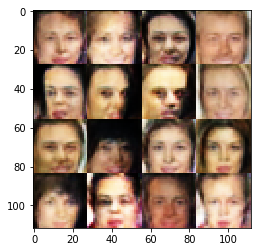

Timestamp 20170806-00-45-11.840 -  Epoch 1/1 -  Step 14010 -  D Loss: 1.1443 - G Loss: 0.8655
Timestamp 20170806-00-45-23.755 -  Epoch 1/1 -  Step 14020 -  D Loss: 1.0539 - G Loss: 1.1269
Timestamp 20170806-00-45-35.649 -  Epoch 1/1 -  Step 14030 -  D Loss: 1.2070 - G Loss: 1.0932
Timestamp 20170806-00-45-47.567 -  Epoch 1/1 -  Step 14040 -  D Loss: 1.4154 - G Loss: 0.7098
Timestamp 20170806-00-45-59.459 -  Epoch 1/1 -  Step 14050 -  D Loss: 1.0110 - G Loss: 0.9678
Timestamp 20170806-00-46-11.372 -  Epoch 1/1 -  Step 14060 -  D Loss: 1.2305 - G Loss: 0.6928
Timestamp 20170806-00-46-23.255 -  Epoch 1/1 -  Step 14070 -  D Loss: 0.9405 - G Loss: 1.4223
Timestamp 20170806-00-46-35.159 -  Epoch 1/1 -  Step 14080 -  D Loss: 1.1630 - G Loss: 1.1949
Timestamp 20170806-00-46-47.065 -  Epoch 1/1 -  Step 14090 -  D Loss: 1.5294 - G Loss: 0.7960
Timestamp 20170806-00-46-58.962 -  Epoch 1/1 -  Step 14100 -  D Loss: 1.3659 - G Loss: 0.7077


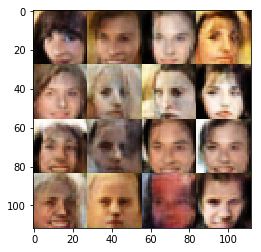

Timestamp 20170806-00-47-11.763 -  Epoch 1/1 -  Step 14110 -  D Loss: 1.1326 - G Loss: 0.6467
Timestamp 20170806-00-47-23.667 -  Epoch 1/1 -  Step 14120 -  D Loss: 1.0431 - G Loss: 1.0420
Timestamp 20170806-00-47-35.586 -  Epoch 1/1 -  Step 14130 -  D Loss: 1.4618 - G Loss: 0.7397
Timestamp 20170806-00-47-47.471 -  Epoch 1/1 -  Step 14140 -  D Loss: 1.1618 - G Loss: 1.2182
Timestamp 20170806-00-47-59.355 -  Epoch 1/1 -  Step 14150 -  D Loss: 1.4427 - G Loss: 0.9113
Timestamp 20170806-00-48-11.237 -  Epoch 1/1 -  Step 14160 -  D Loss: 1.2172 - G Loss: 0.8706
Timestamp 20170806-00-48-23.144 -  Epoch 1/1 -  Step 14170 -  D Loss: 1.4020 - G Loss: 0.6245
Timestamp 20170806-00-48-35.063 -  Epoch 1/1 -  Step 14180 -  D Loss: 1.1282 - G Loss: 1.2053
Timestamp 20170806-00-48-46.961 -  Epoch 1/1 -  Step 14190 -  D Loss: 1.5570 - G Loss: 0.8094
Timestamp 20170806-00-48-58.863 -  Epoch 1/1 -  Step 14200 -  D Loss: 1.2178 - G Loss: 0.8334


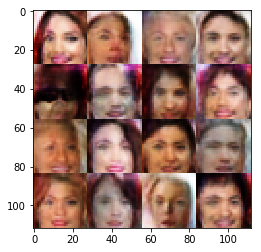

Timestamp 20170806-00-49-11.629 -  Epoch 1/1 -  Step 14210 -  D Loss: 1.4976 - G Loss: 0.7264
Timestamp 20170806-00-49-23.516 -  Epoch 1/1 -  Step 14220 -  D Loss: 1.5201 - G Loss: 0.7152
Timestamp 20170806-00-49-35.427 -  Epoch 1/1 -  Step 14230 -  D Loss: 1.0459 - G Loss: 1.0121
Timestamp 20170806-00-49-47.310 -  Epoch 1/1 -  Step 14240 -  D Loss: 1.1540 - G Loss: 1.1155
Timestamp 20170806-00-49-59.219 -  Epoch 1/1 -  Step 14250 -  D Loss: 1.0240 - G Loss: 1.0706
Timestamp 20170806-00-50-11.112 -  Epoch 1/1 -  Step 14260 -  D Loss: 1.2347 - G Loss: 1.0197
Timestamp 20170806-00-50-23.037 -  Epoch 1/1 -  Step 14270 -  D Loss: 1.0853 - G Loss: 0.8314
Timestamp 20170806-00-50-34.937 -  Epoch 1/1 -  Step 14280 -  D Loss: 1.1095 - G Loss: 0.9647
Timestamp 20170806-00-50-46.835 -  Epoch 1/1 -  Step 14290 -  D Loss: 1.2183 - G Loss: 1.0824
Timestamp 20170806-00-50-58.727 -  Epoch 1/1 -  Step 14300 -  D Loss: 1.1665 - G Loss: 0.9751


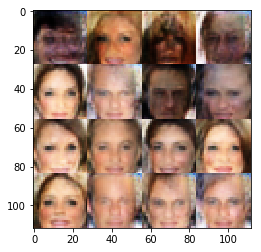

Timestamp 20170806-00-51-11.522 -  Epoch 1/1 -  Step 14310 -  D Loss: 1.3331 - G Loss: 1.0048
Timestamp 20170806-00-51-23.423 -  Epoch 1/1 -  Step 14320 -  D Loss: 1.1172 - G Loss: 1.2564
Timestamp 20170806-00-51-35.354 -  Epoch 1/1 -  Step 14330 -  D Loss: 1.3376 - G Loss: 0.9360
Timestamp 20170806-00-51-47.245 -  Epoch 1/1 -  Step 14340 -  D Loss: 1.2854 - G Loss: 1.1363
Timestamp 20170806-00-51-59.149 -  Epoch 1/1 -  Step 14350 -  D Loss: 1.2698 - G Loss: 1.2661
Timestamp 20170806-00-52-11.071 -  Epoch 1/1 -  Step 14360 -  D Loss: 0.9532 - G Loss: 1.0465
Timestamp 20170806-00-52-22.978 -  Epoch 1/1 -  Step 14370 -  D Loss: 1.2287 - G Loss: 0.9483
Timestamp 20170806-00-52-34.892 -  Epoch 1/1 -  Step 14380 -  D Loss: 0.9389 - G Loss: 1.0359
Timestamp 20170806-00-52-46.787 -  Epoch 1/1 -  Step 14390 -  D Loss: 1.0858 - G Loss: 0.8865
Timestamp 20170806-00-52-58.688 -  Epoch 1/1 -  Step 14400 -  D Loss: 0.9248 - G Loss: 1.0594


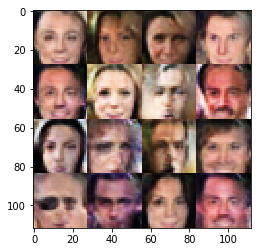

Timestamp 20170806-00-53-11.645 -  Epoch 1/1 -  Step 14410 -  D Loss: 1.4118 - G Loss: 0.7079
Timestamp 20170806-00-53-23.548 -  Epoch 1/1 -  Step 14420 -  D Loss: 1.2957 - G Loss: 0.6928
Timestamp 20170806-00-53-35.433 -  Epoch 1/1 -  Step 14430 -  D Loss: 1.0667 - G Loss: 0.8998
Timestamp 20170806-00-53-47.336 -  Epoch 1/1 -  Step 14440 -  D Loss: 1.4413 - G Loss: 0.8829
Timestamp 20170806-00-53-59.213 -  Epoch 1/1 -  Step 14450 -  D Loss: 1.3538 - G Loss: 0.7393
Timestamp 20170806-00-54-11.127 -  Epoch 1/1 -  Step 14460 -  D Loss: 1.0433 - G Loss: 1.0963
Timestamp 20170806-00-54-23.042 -  Epoch 1/1 -  Step 14470 -  D Loss: 1.2075 - G Loss: 0.9442
Timestamp 20170806-00-54-34.930 -  Epoch 1/1 -  Step 14480 -  D Loss: 1.0909 - G Loss: 0.9258
Timestamp 20170806-00-54-46.824 -  Epoch 1/1 -  Step 14490 -  D Loss: 1.2609 - G Loss: 0.8201
Timestamp 20170806-00-54-58.731 -  Epoch 1/1 -  Step 14500 -  D Loss: 1.0392 - G Loss: 1.2098


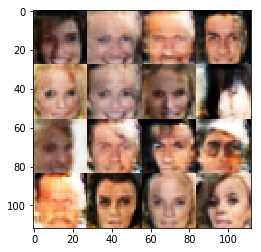

Timestamp 20170806-00-55-11.509 -  Epoch 1/1 -  Step 14510 -  D Loss: 0.9963 - G Loss: 1.3334
Timestamp 20170806-00-55-23.393 -  Epoch 1/1 -  Step 14520 -  D Loss: 1.2909 - G Loss: 1.0088
Timestamp 20170806-00-55-35.288 -  Epoch 1/1 -  Step 14530 -  D Loss: 1.2131 - G Loss: 0.8316
Timestamp 20170806-00-55-47.195 -  Epoch 1/1 -  Step 14540 -  D Loss: 1.2821 - G Loss: 1.0382
Timestamp 20170806-00-55-59.094 -  Epoch 1/1 -  Step 14550 -  D Loss: 1.2318 - G Loss: 0.7973
Timestamp 20170806-00-56-10.989 -  Epoch 1/1 -  Step 14560 -  D Loss: 1.0608 - G Loss: 1.0160
Timestamp 20170806-00-56-22.890 -  Epoch 1/1 -  Step 14570 -  D Loss: 1.4651 - G Loss: 0.8934
Timestamp 20170806-00-56-34.787 -  Epoch 1/1 -  Step 14580 -  D Loss: 1.2930 - G Loss: 1.2018
Timestamp 20170806-00-56-46.678 -  Epoch 1/1 -  Step 14590 -  D Loss: 1.2407 - G Loss: 1.2454
Timestamp 20170806-00-56-58.589 -  Epoch 1/1 -  Step 14600 -  D Loss: 1.0573 - G Loss: 0.9441


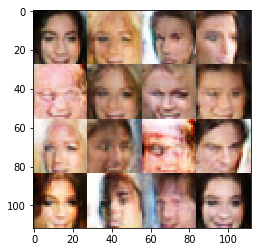

Timestamp 20170806-00-57-11.370 -  Epoch 1/1 -  Step 14610 -  D Loss: 0.9868 - G Loss: 1.2847
Timestamp 20170806-00-57-23.286 -  Epoch 1/1 -  Step 14620 -  D Loss: 1.3113 - G Loss: 0.6909
Timestamp 20170806-00-57-35.192 -  Epoch 1/1 -  Step 14630 -  D Loss: 1.1782 - G Loss: 0.7871
Timestamp 20170806-00-57-47.085 -  Epoch 1/1 -  Step 14640 -  D Loss: 1.0691 - G Loss: 1.2435
Timestamp 20170806-00-57-58.991 -  Epoch 1/1 -  Step 14650 -  D Loss: 1.2774 - G Loss: 0.8195
Timestamp 20170806-00-58-10.892 -  Epoch 1/1 -  Step 14660 -  D Loss: 1.5264 - G Loss: 1.0531
Timestamp 20170806-00-58-22.779 -  Epoch 1/1 -  Step 14670 -  D Loss: 1.1169 - G Loss: 0.7824
Timestamp 20170806-00-58-34.692 -  Epoch 1/1 -  Step 14680 -  D Loss: 1.2028 - G Loss: 0.6117
Timestamp 20170806-00-58-46.597 -  Epoch 1/1 -  Step 14690 -  D Loss: 1.4078 - G Loss: 1.0127
Timestamp 20170806-00-58-58.491 -  Epoch 1/1 -  Step 14700 -  D Loss: 1.0794 - G Loss: 0.7248


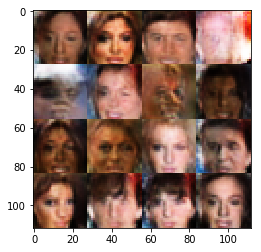

Timestamp 20170806-00-59-11.266 -  Epoch 1/1 -  Step 14710 -  D Loss: 1.0864 - G Loss: 1.0650
Timestamp 20170806-00-59-23.175 -  Epoch 1/1 -  Step 14720 -  D Loss: 1.4128 - G Loss: 0.9434
Timestamp 20170806-00-59-35.084 -  Epoch 1/1 -  Step 14730 -  D Loss: 1.4736 - G Loss: 0.7445
Timestamp 20170806-00-59-46.985 -  Epoch 1/1 -  Step 14740 -  D Loss: 1.5684 - G Loss: 0.9912
Timestamp 20170806-00-59-58.878 -  Epoch 1/1 -  Step 14750 -  D Loss: 1.0252 - G Loss: 1.0852
Timestamp 20170806-01-00-10.772 -  Epoch 1/1 -  Step 14760 -  D Loss: 1.2146 - G Loss: 1.2141
Timestamp 20170806-01-00-22.671 -  Epoch 1/1 -  Step 14770 -  D Loss: 1.5187 - G Loss: 1.0296
Timestamp 20170806-01-00-34.583 -  Epoch 1/1 -  Step 14780 -  D Loss: 1.0442 - G Loss: 0.7715
Timestamp 20170806-01-00-46.481 -  Epoch 1/1 -  Step 14790 -  D Loss: 1.0629 - G Loss: 0.9924
Timestamp 20170806-01-00-58.390 -  Epoch 1/1 -  Step 14800 -  D Loss: 1.1363 - G Loss: 0.8852


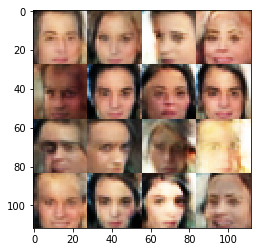

Timestamp 20170806-01-01-11.182 -  Epoch 1/1 -  Step 14810 -  D Loss: 1.0300 - G Loss: 1.1245
Timestamp 20170806-01-01-23.095 -  Epoch 1/1 -  Step 14820 -  D Loss: 1.3070 - G Loss: 0.9210
Timestamp 20170806-01-01-35.007 -  Epoch 1/1 -  Step 14830 -  D Loss: 1.0940 - G Loss: 0.6900
Timestamp 20170806-01-01-46.895 -  Epoch 1/1 -  Step 14840 -  D Loss: 1.3691 - G Loss: 0.6325
Timestamp 20170806-01-01-58.800 -  Epoch 1/1 -  Step 14850 -  D Loss: 1.2046 - G Loss: 0.7325
Timestamp 20170806-01-02-10.718 -  Epoch 1/1 -  Step 14860 -  D Loss: 1.4327 - G Loss: 0.8292
Timestamp 20170806-01-02-22.609 -  Epoch 1/1 -  Step 14870 -  D Loss: 1.7865 - G Loss: 0.7315
Timestamp 20170806-01-02-34.496 -  Epoch 1/1 -  Step 14880 -  D Loss: 1.5897 - G Loss: 0.6542
Timestamp 20170806-01-02-46.410 -  Epoch 1/1 -  Step 14890 -  D Loss: 0.9249 - G Loss: 1.0357
Timestamp 20170806-01-02-58.294 -  Epoch 1/1 -  Step 14900 -  D Loss: 1.1860 - G Loss: 1.2116


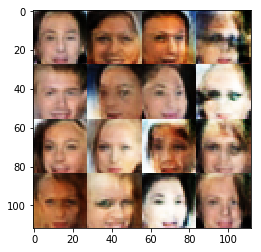

Timestamp 20170806-01-03-11.080 -  Epoch 1/1 -  Step 14910 -  D Loss: 1.3374 - G Loss: 0.5485
Timestamp 20170806-01-03-22.990 -  Epoch 1/1 -  Step 14920 -  D Loss: 1.0754 - G Loss: 0.9252
Timestamp 20170806-01-03-34.898 -  Epoch 1/1 -  Step 14930 -  D Loss: 1.1208 - G Loss: 1.2712
Timestamp 20170806-01-03-46.805 -  Epoch 1/1 -  Step 14940 -  D Loss: 1.0679 - G Loss: 1.1137
Timestamp 20170806-01-03-58.704 -  Epoch 1/1 -  Step 14950 -  D Loss: 1.1051 - G Loss: 0.7147
Timestamp 20170806-01-04-10.592 -  Epoch 1/1 -  Step 14960 -  D Loss: 1.1519 - G Loss: 0.7294
Timestamp 20170806-01-04-22.475 -  Epoch 1/1 -  Step 14970 -  D Loss: 1.0980 - G Loss: 1.1393
Timestamp 20170806-01-04-34.366 -  Epoch 1/1 -  Step 14980 -  D Loss: 1.1273 - G Loss: 1.0729
Timestamp 20170806-01-04-46.262 -  Epoch 1/1 -  Step 14990 -  D Loss: 1.0516 - G Loss: 1.0663
Timestamp 20170806-01-04-58.161 -  Epoch 1/1 -  Step 15000 -  D Loss: 1.4302 - G Loss: 0.7314


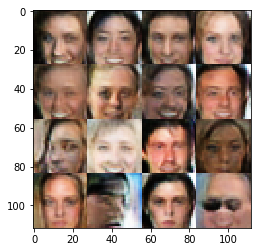

Timestamp 20170806-01-05-10.940 -  Epoch 1/1 -  Step 15010 -  D Loss: 1.1195 - G Loss: 0.8055
Timestamp 20170806-01-05-22.835 -  Epoch 1/1 -  Step 15020 -  D Loss: 1.4624 - G Loss: 0.7157
Timestamp 20170806-01-05-34.736 -  Epoch 1/1 -  Step 15030 -  D Loss: 1.6564 - G Loss: 1.0994
Timestamp 20170806-01-05-46.626 -  Epoch 1/1 -  Step 15040 -  D Loss: 1.2547 - G Loss: 0.9434
Timestamp 20170806-01-05-58.524 -  Epoch 1/1 -  Step 15050 -  D Loss: 1.0717 - G Loss: 1.1873
Timestamp 20170806-01-06-10.434 -  Epoch 1/1 -  Step 15060 -  D Loss: 1.1867 - G Loss: 0.9680
Timestamp 20170806-01-06-22.342 -  Epoch 1/1 -  Step 15070 -  D Loss: 1.2217 - G Loss: 0.9090
Timestamp 20170806-01-06-34.255 -  Epoch 1/1 -  Step 15080 -  D Loss: 1.0263 - G Loss: 1.2328
Timestamp 20170806-01-06-46.177 -  Epoch 1/1 -  Step 15090 -  D Loss: 1.4928 - G Loss: 1.0651
Timestamp 20170806-01-06-58.094 -  Epoch 1/1 -  Step 15100 -  D Loss: 1.1807 - G Loss: 0.8653


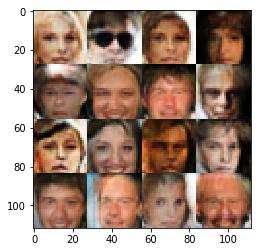

Timestamp 20170806-01-07-10.868 -  Epoch 1/1 -  Step 15110 -  D Loss: 1.1610 - G Loss: 0.8876
Timestamp 20170806-01-07-22.758 -  Epoch 1/1 -  Step 15120 -  D Loss: 1.1898 - G Loss: 1.0940
Timestamp 20170806-01-07-34.663 -  Epoch 1/1 -  Step 15130 -  D Loss: 1.0594 - G Loss: 1.1879
Timestamp 20170806-01-07-46.552 -  Epoch 1/1 -  Step 15140 -  D Loss: 1.4549 - G Loss: 0.9501
Timestamp 20170806-01-07-58.424 -  Epoch 1/1 -  Step 15150 -  D Loss: 1.3480 - G Loss: 0.8371
Timestamp 20170806-01-08-10.319 -  Epoch 1/1 -  Step 15160 -  D Loss: 1.2232 - G Loss: 1.3566
Timestamp 20170806-01-08-22.211 -  Epoch 1/1 -  Step 15170 -  D Loss: 1.1467 - G Loss: 0.9074
Timestamp 20170806-01-08-34.121 -  Epoch 1/1 -  Step 15180 -  D Loss: 1.4261 - G Loss: 0.9355
Timestamp 20170806-01-08-46.008 -  Epoch 1/1 -  Step 15190 -  D Loss: 1.2025 - G Loss: 0.9087
Timestamp 20170806-01-08-57.895 -  Epoch 1/1 -  Step 15200 -  D Loss: 1.1992 - G Loss: 0.7997


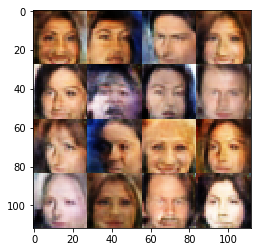

Timestamp 20170806-01-09-10.681 -  Epoch 1/1 -  Step 15210 -  D Loss: 0.9980 - G Loss: 1.1977
Timestamp 20170806-01-09-22.582 -  Epoch 1/1 -  Step 15220 -  D Loss: 1.1203 - G Loss: 1.1732
Timestamp 20170806-01-09-34.458 -  Epoch 1/1 -  Step 15230 -  D Loss: 1.0422 - G Loss: 1.2744
Timestamp 20170806-01-09-46.361 -  Epoch 1/1 -  Step 15240 -  D Loss: 1.3514 - G Loss: 1.4255
Timestamp 20170806-01-09-58.255 -  Epoch 1/1 -  Step 15250 -  D Loss: 1.0738 - G Loss: 1.0906
Timestamp 20170806-01-10-10.177 -  Epoch 1/1 -  Step 15260 -  D Loss: 1.0690 - G Loss: 1.1824
Timestamp 20170806-01-10-22.088 -  Epoch 1/1 -  Step 15270 -  D Loss: 1.1245 - G Loss: 1.0970
Timestamp 20170806-01-10-33.977 -  Epoch 1/1 -  Step 15280 -  D Loss: 1.1027 - G Loss: 0.8537
Timestamp 20170806-01-10-45.881 -  Epoch 1/1 -  Step 15290 -  D Loss: 1.1702 - G Loss: 0.9129
Timestamp 20170806-01-10-57.774 -  Epoch 1/1 -  Step 15300 -  D Loss: 1.0333 - G Loss: 1.0658


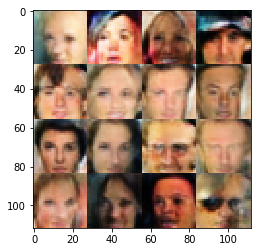

Timestamp 20170806-01-11-10.571 -  Epoch 1/1 -  Step 15310 -  D Loss: 1.1271 - G Loss: 0.9415
Timestamp 20170806-01-11-22.475 -  Epoch 1/1 -  Step 15320 -  D Loss: 0.8817 - G Loss: 1.1775
Timestamp 20170806-01-11-34.367 -  Epoch 1/1 -  Step 15330 -  D Loss: 1.2342 - G Loss: 1.0227
Timestamp 20170806-01-11-46.283 -  Epoch 1/1 -  Step 15340 -  D Loss: 1.4214 - G Loss: 1.1814
Timestamp 20170806-01-11-58.191 -  Epoch 1/1 -  Step 15350 -  D Loss: 1.1465 - G Loss: 1.1556
Timestamp 20170806-01-12-10.093 -  Epoch 1/1 -  Step 15360 -  D Loss: 0.9977 - G Loss: 0.9208
Timestamp 20170806-01-12-21.991 -  Epoch 1/1 -  Step 15370 -  D Loss: 1.2674 - G Loss: 0.8886
Timestamp 20170806-01-12-33.862 -  Epoch 1/1 -  Step 15380 -  D Loss: 1.4610 - G Loss: 0.8008
Timestamp 20170806-01-12-45.755 -  Epoch 1/1 -  Step 15390 -  D Loss: 1.0321 - G Loss: 1.1783
Timestamp 20170806-01-12-57.660 -  Epoch 1/1 -  Step 15400 -  D Loss: 1.3445 - G Loss: 0.9240


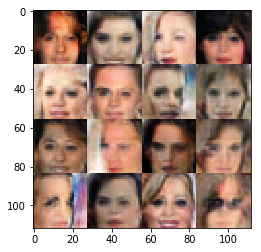

Timestamp 20170806-01-13-10.462 -  Epoch 1/1 -  Step 15410 -  D Loss: 1.3409 - G Loss: 1.0393
Timestamp 20170806-01-13-22.344 -  Epoch 1/1 -  Step 15420 -  D Loss: 1.5479 - G Loss: 0.6115
Timestamp 20170806-01-13-34.250 -  Epoch 1/1 -  Step 15430 -  D Loss: 1.2929 - G Loss: 1.2028
Timestamp 20170806-01-13-46.152 -  Epoch 1/1 -  Step 15440 -  D Loss: 1.0738 - G Loss: 0.9804
Timestamp 20170806-01-13-58.051 -  Epoch 1/1 -  Step 15450 -  D Loss: 1.3199 - G Loss: 1.1573
Timestamp 20170806-01-14-09.960 -  Epoch 1/1 -  Step 15460 -  D Loss: 1.1752 - G Loss: 0.6663
Timestamp 20170806-01-14-21.852 -  Epoch 1/1 -  Step 15470 -  D Loss: 1.5356 - G Loss: 0.7802
Timestamp 20170806-01-14-33.765 -  Epoch 1/1 -  Step 15480 -  D Loss: 1.4116 - G Loss: 0.7777
Timestamp 20170806-01-14-45.657 -  Epoch 1/1 -  Step 15490 -  D Loss: 1.3170 - G Loss: 0.9535
Timestamp 20170806-01-14-57.561 -  Epoch 1/1 -  Step 15500 -  D Loss: 1.3929 - G Loss: 0.5479


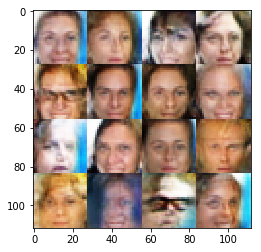

Timestamp 20170806-01-15-10.322 -  Epoch 1/1 -  Step 15510 -  D Loss: 1.2685 - G Loss: 1.0572
Timestamp 20170806-01-15-22.237 -  Epoch 1/1 -  Step 15520 -  D Loss: 1.1796 - G Loss: 1.1234
Timestamp 20170806-01-15-34.148 -  Epoch 1/1 -  Step 15530 -  D Loss: 1.4432 - G Loss: 0.9757
Timestamp 20170806-01-15-46.032 -  Epoch 1/1 -  Step 15540 -  D Loss: 1.0513 - G Loss: 1.1689
Timestamp 20170806-01-15-57.920 -  Epoch 1/1 -  Step 15550 -  D Loss: 1.2176 - G Loss: 0.9931
Timestamp 20170806-01-16-09.825 -  Epoch 1/1 -  Step 15560 -  D Loss: 1.2797 - G Loss: 0.7658
Timestamp 20170806-01-16-21.719 -  Epoch 1/1 -  Step 15570 -  D Loss: 1.1458 - G Loss: 1.2480
Timestamp 20170806-01-16-33.613 -  Epoch 1/1 -  Step 15580 -  D Loss: 1.1462 - G Loss: 0.9773
Timestamp 20170806-01-16-45.497 -  Epoch 1/1 -  Step 15590 -  D Loss: 0.9842 - G Loss: 0.9200
Timestamp 20170806-01-16-57.405 -  Epoch 1/1 -  Step 15600 -  D Loss: 1.4770 - G Loss: 0.5965


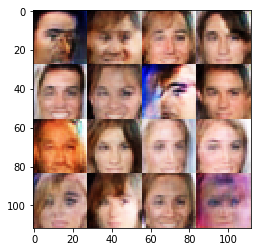

Timestamp 20170806-01-17-10.210 -  Epoch 1/1 -  Step 15610 -  D Loss: 1.0638 - G Loss: 0.9632
Timestamp 20170806-01-17-22.107 -  Epoch 1/1 -  Step 15620 -  D Loss: 0.8006 - G Loss: 1.5304
Timestamp 20170806-01-17-34.017 -  Epoch 1/1 -  Step 15630 -  D Loss: 1.0785 - G Loss: 1.1719
Timestamp 20170806-01-17-45.903 -  Epoch 1/1 -  Step 15640 -  D Loss: 1.3966 - G Loss: 0.7754
Timestamp 20170806-01-17-57.811 -  Epoch 1/1 -  Step 15650 -  D Loss: 1.0534 - G Loss: 1.2052
Timestamp 20170806-01-18-09.721 -  Epoch 1/1 -  Step 15660 -  D Loss: 1.2349 - G Loss: 1.0317
Timestamp 20170806-01-18-21.623 -  Epoch 1/1 -  Step 15670 -  D Loss: 1.1425 - G Loss: 1.3603
Timestamp 20170806-01-18-33.532 -  Epoch 1/1 -  Step 15680 -  D Loss: 1.1859 - G Loss: 0.8031
Timestamp 20170806-01-18-45.434 -  Epoch 1/1 -  Step 15690 -  D Loss: 1.2919 - G Loss: 0.8294
Timestamp 20170806-01-18-57.325 -  Epoch 1/1 -  Step 15700 -  D Loss: 1.5233 - G Loss: 0.8688


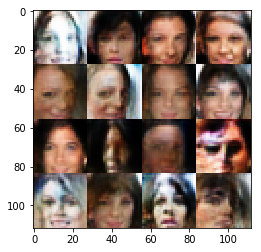

Timestamp 20170806-01-19-10.114 -  Epoch 1/1 -  Step 15710 -  D Loss: 1.3298 - G Loss: 0.9260
Timestamp 20170806-01-19-22.009 -  Epoch 1/1 -  Step 15720 -  D Loss: 0.9102 - G Loss: 1.2660
Timestamp 20170806-01-19-33.916 -  Epoch 1/1 -  Step 15730 -  D Loss: 1.0502 - G Loss: 1.1107
Timestamp 20170806-01-19-45.807 -  Epoch 1/1 -  Step 15740 -  D Loss: 1.0400 - G Loss: 1.0294
Timestamp 20170806-01-19-57.698 -  Epoch 1/1 -  Step 15750 -  D Loss: 1.2234 - G Loss: 1.4676
Timestamp 20170806-01-20-09.604 -  Epoch 1/1 -  Step 15760 -  D Loss: 1.1751 - G Loss: 0.9546
Timestamp 20170806-01-20-21.508 -  Epoch 1/1 -  Step 15770 -  D Loss: 1.5395 - G Loss: 0.8914
Timestamp 20170806-01-20-33.388 -  Epoch 1/1 -  Step 15780 -  D Loss: 1.3869 - G Loss: 1.3707
Timestamp 20170806-01-20-45.269 -  Epoch 1/1 -  Step 15790 -  D Loss: 1.3957 - G Loss: 0.8744
Timestamp 20170806-01-20-57.168 -  Epoch 1/1 -  Step 15800 -  D Loss: 1.1801 - G Loss: 0.8898


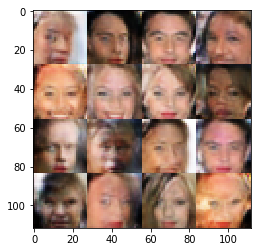

Timestamp 20170806-01-21-09.975 -  Epoch 1/1 -  Step 15810 -  D Loss: 1.0030 - G Loss: 1.3149
Timestamp 20170806-01-21-21.863 -  Epoch 1/1 -  Step 15820 -  D Loss: 1.3299 - G Loss: 0.8171
Timestamp 20170806-01-21-33.776 -  Epoch 1/1 -  Step 15830 -  D Loss: 1.2733 - G Loss: 0.9727
Timestamp 20170806-01-21-45.671 -  Epoch 1/1 -  Step 15840 -  D Loss: 1.1895 - G Loss: 1.1033
Timestamp 20170806-01-21-57.571 -  Epoch 1/1 -  Step 15850 -  D Loss: 0.9372 - G Loss: 0.9085
Timestamp 20170806-01-22-09.499 -  Epoch 1/1 -  Step 15860 -  D Loss: 1.7273 - G Loss: 0.9383
Timestamp 20170806-01-22-21.406 -  Epoch 1/1 -  Step 15870 -  D Loss: 1.2482 - G Loss: 0.7215
Timestamp 20170806-01-22-33.290 -  Epoch 1/1 -  Step 15880 -  D Loss: 1.3663 - G Loss: 0.6781
Timestamp 20170806-01-22-45.200 -  Epoch 1/1 -  Step 15890 -  D Loss: 1.0522 - G Loss: 0.9314
Timestamp 20170806-01-22-57.095 -  Epoch 1/1 -  Step 15900 -  D Loss: 1.3083 - G Loss: 1.0633


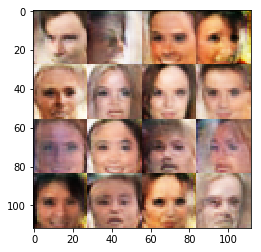

Timestamp 20170806-01-23-09.888 -  Epoch 1/1 -  Step 15910 -  D Loss: 0.8741 - G Loss: 1.3649
Timestamp 20170806-01-23-21.755 -  Epoch 1/1 -  Step 15920 -  D Loss: 1.0551 - G Loss: 0.9252
Timestamp 20170806-01-23-33.659 -  Epoch 1/1 -  Step 15930 -  D Loss: 1.0680 - G Loss: 1.0926
Timestamp 20170806-01-23-45.573 -  Epoch 1/1 -  Step 15940 -  D Loss: 1.3793 - G Loss: 0.6687
Timestamp 20170806-01-23-57.483 -  Epoch 1/1 -  Step 15950 -  D Loss: 0.9886 - G Loss: 1.1628
Timestamp 20170806-01-24-09.392 -  Epoch 1/1 -  Step 15960 -  D Loss: 1.5546 - G Loss: 1.1447
Timestamp 20170806-01-24-21.295 -  Epoch 1/1 -  Step 15970 -  D Loss: 1.2719 - G Loss: 1.4288
Timestamp 20170806-01-24-33.187 -  Epoch 1/1 -  Step 15980 -  D Loss: 1.4550 - G Loss: 0.7176
Timestamp 20170806-01-24-45.090 -  Epoch 1/1 -  Step 15990 -  D Loss: 1.0838 - G Loss: 0.7706
Timestamp 20170806-01-24-56.994 -  Epoch 1/1 -  Step 16000 -  D Loss: 1.2304 - G Loss: 1.2970


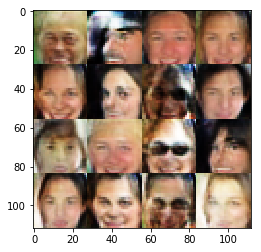

Timestamp 20170806-01-25-09.839 -  Epoch 1/1 -  Step 16010 -  D Loss: 0.9699 - G Loss: 1.1745
Timestamp 20170806-01-25-21.743 -  Epoch 1/1 -  Step 16020 -  D Loss: 1.4139 - G Loss: 0.9865
Timestamp 20170806-01-25-33.633 -  Epoch 1/1 -  Step 16030 -  D Loss: 1.4454 - G Loss: 0.8520
Timestamp 20170806-01-25-45.533 -  Epoch 1/1 -  Step 16040 -  D Loss: 1.4396 - G Loss: 0.9719
Timestamp 20170806-01-25-57.441 -  Epoch 1/1 -  Step 16050 -  D Loss: 0.9139 - G Loss: 1.4923
Timestamp 20170806-01-26-09.357 -  Epoch 1/1 -  Step 16060 -  D Loss: 1.1701 - G Loss: 1.3219
Timestamp 20170806-01-26-21.336 -  Epoch 1/1 -  Step 16070 -  D Loss: 1.1028 - G Loss: 0.7863
Timestamp 20170806-01-26-33.288 -  Epoch 1/1 -  Step 16080 -  D Loss: 1.5022 - G Loss: 0.9095
Timestamp 20170806-01-26-45.198 -  Epoch 1/1 -  Step 16090 -  D Loss: 1.2775 - G Loss: 1.1609
Timestamp 20170806-01-26-57.111 -  Epoch 1/1 -  Step 16100 -  D Loss: 0.9997 - G Loss: 1.3740


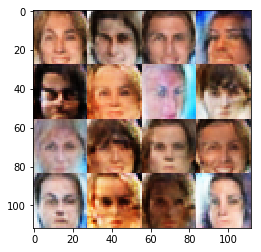

Timestamp 20170806-01-27-09.925 -  Epoch 1/1 -  Step 16110 -  D Loss: 1.3097 - G Loss: 0.8996
Timestamp 20170806-01-27-21.817 -  Epoch 1/1 -  Step 16120 -  D Loss: 1.4750 - G Loss: 1.1364
Timestamp 20170806-01-27-33.724 -  Epoch 1/1 -  Step 16130 -  D Loss: 1.1278 - G Loss: 1.0895
Timestamp 20170806-01-27-45.615 -  Epoch 1/1 -  Step 16140 -  D Loss: 1.2022 - G Loss: 1.2805
Timestamp 20170806-01-27-57.519 -  Epoch 1/1 -  Step 16150 -  D Loss: 1.6476 - G Loss: 0.6595
Timestamp 20170806-01-28-09.414 -  Epoch 1/1 -  Step 16160 -  D Loss: 1.1126 - G Loss: 0.9197
Timestamp 20170806-01-28-21.333 -  Epoch 1/1 -  Step 16170 -  D Loss: 1.2898 - G Loss: 1.0122
Timestamp 20170806-01-28-33.253 -  Epoch 1/1 -  Step 16180 -  D Loss: 1.1827 - G Loss: 1.1640
Timestamp 20170806-01-28-45.154 -  Epoch 1/1 -  Step 16190 -  D Loss: 1.3194 - G Loss: 0.9912
Timestamp 20170806-01-28-57.057 -  Epoch 1/1 -  Step 16200 -  D Loss: 1.0886 - G Loss: 1.0448


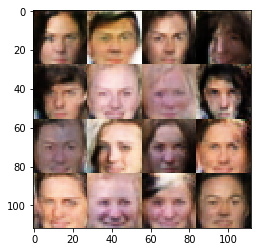

Timestamp 20170806-01-29-09.894 -  Epoch 1/1 -  Step 16210 -  D Loss: 1.1882 - G Loss: 1.2642
Timestamp 20170806-01-29-21.793 -  Epoch 1/1 -  Step 16220 -  D Loss: 0.9853 - G Loss: 1.0801
Timestamp 20170806-01-29-33.697 -  Epoch 1/1 -  Step 16230 -  D Loss: 1.1513 - G Loss: 0.7174
Timestamp 20170806-01-29-45.599 -  Epoch 1/1 -  Step 16240 -  D Loss: 1.5040 - G Loss: 1.0532
Timestamp 20170806-01-29-57.486 -  Epoch 1/1 -  Step 16250 -  D Loss: 1.1011 - G Loss: 0.8790
Timestamp 20170806-01-30-09.400 -  Epoch 1/1 -  Step 16260 -  D Loss: 1.3922 - G Loss: 0.8277
Timestamp 20170806-01-30-21.281 -  Epoch 1/1 -  Step 16270 -  D Loss: 1.0523 - G Loss: 1.0374
Timestamp 20170806-01-30-33.185 -  Epoch 1/1 -  Step 16280 -  D Loss: 1.0000 - G Loss: 1.0580
Timestamp 20170806-01-30-45.077 -  Epoch 1/1 -  Step 16290 -  D Loss: 1.0883 - G Loss: 0.9654
Timestamp 20170806-01-30-56.962 -  Epoch 1/1 -  Step 16300 -  D Loss: 0.8979 - G Loss: 1.1264


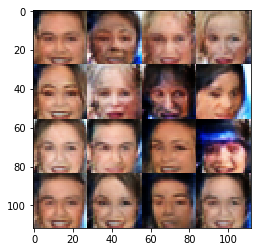

Timestamp 20170806-01-31-09.814 -  Epoch 1/1 -  Step 16310 -  D Loss: 1.0511 - G Loss: 0.8057
Timestamp 20170806-01-31-21.734 -  Epoch 1/1 -  Step 16320 -  D Loss: 1.0344 - G Loss: 0.9254
Timestamp 20170806-01-31-33.645 -  Epoch 1/1 -  Step 16330 -  D Loss: 1.1951 - G Loss: 1.1556
Timestamp 20170806-01-31-45.556 -  Epoch 1/1 -  Step 16340 -  D Loss: 1.5424 - G Loss: 0.5807
Timestamp 20170806-01-31-57.458 -  Epoch 1/1 -  Step 16350 -  D Loss: 1.1664 - G Loss: 1.1127
Timestamp 20170806-01-32-09.363 -  Epoch 1/1 -  Step 16360 -  D Loss: 0.9878 - G Loss: 1.0411
Timestamp 20170806-01-32-21.265 -  Epoch 1/1 -  Step 16370 -  D Loss: 1.4743 - G Loss: 0.5726
Timestamp 20170806-01-32-33.158 -  Epoch 1/1 -  Step 16380 -  D Loss: 1.5092 - G Loss: 0.8142
Timestamp 20170806-01-32-45.057 -  Epoch 1/1 -  Step 16390 -  D Loss: 1.0061 - G Loss: 0.8288
Timestamp 20170806-01-32-56.952 -  Epoch 1/1 -  Step 16400 -  D Loss: 1.3327 - G Loss: 0.7510


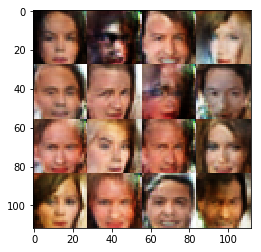

Timestamp 20170806-01-33-09.772 -  Epoch 1/1 -  Step 16410 -  D Loss: 1.2889 - G Loss: 0.8239
Timestamp 20170806-01-33-21.688 -  Epoch 1/1 -  Step 16420 -  D Loss: 1.1787 - G Loss: 0.9598
Timestamp 20170806-01-33-33.584 -  Epoch 1/1 -  Step 16430 -  D Loss: 1.7007 - G Loss: 0.5164
Timestamp 20170806-01-33-45.479 -  Epoch 1/1 -  Step 16440 -  D Loss: 1.2981 - G Loss: 0.7748
Timestamp 20170806-01-33-57.380 -  Epoch 1/1 -  Step 16450 -  D Loss: 1.0802 - G Loss: 0.7889
Timestamp 20170806-01-34-09.277 -  Epoch 1/1 -  Step 16460 -  D Loss: 1.0211 - G Loss: 1.3288
Timestamp 20170806-01-34-21.182 -  Epoch 1/1 -  Step 16470 -  D Loss: 1.1770 - G Loss: 1.2876
Timestamp 20170806-01-34-33.079 -  Epoch 1/1 -  Step 16480 -  D Loss: 0.9488 - G Loss: 0.7702
Timestamp 20170806-01-34-44.979 -  Epoch 1/1 -  Step 16490 -  D Loss: 1.5416 - G Loss: 0.5454
Timestamp 20170806-01-34-56.874 -  Epoch 1/1 -  Step 16500 -  D Loss: 1.1003 - G Loss: 0.9895


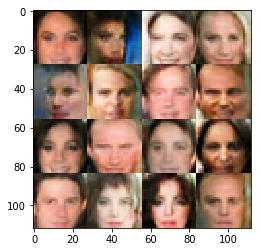

Timestamp 20170806-01-35-09.717 -  Epoch 1/1 -  Step 16510 -  D Loss: 1.2460 - G Loss: 0.9519
Timestamp 20170806-01-35-21.629 -  Epoch 1/1 -  Step 16520 -  D Loss: 1.2585 - G Loss: 0.9074
Timestamp 20170806-01-35-33.534 -  Epoch 1/1 -  Step 16530 -  D Loss: 1.1353 - G Loss: 1.0044
Timestamp 20170806-01-35-45.461 -  Epoch 1/1 -  Step 16540 -  D Loss: 1.0481 - G Loss: 0.8460
Timestamp 20170806-01-35-57.351 -  Epoch 1/1 -  Step 16550 -  D Loss: 0.8557 - G Loss: 1.0743
Timestamp 20170806-01-36-09.260 -  Epoch 1/1 -  Step 16560 -  D Loss: 1.2732 - G Loss: 0.8236
Timestamp 20170806-01-36-21.159 -  Epoch 1/1 -  Step 16570 -  D Loss: 0.9213 - G Loss: 1.1210
Timestamp 20170806-01-36-33.066 -  Epoch 1/1 -  Step 16580 -  D Loss: 1.2502 - G Loss: 0.8447
Timestamp 20170806-01-36-44.975 -  Epoch 1/1 -  Step 16590 -  D Loss: 1.4209 - G Loss: 0.6679
Timestamp 20170806-01-36-56.883 -  Epoch 1/1 -  Step 16600 -  D Loss: 1.0389 - G Loss: 1.0300


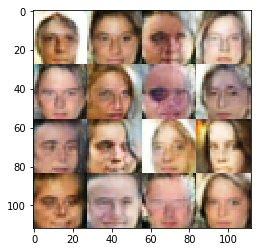

Timestamp 20170806-01-37-09.695 -  Epoch 1/1 -  Step 16610 -  D Loss: 1.1362 - G Loss: 1.2774
Timestamp 20170806-01-37-21.585 -  Epoch 1/1 -  Step 16620 -  D Loss: 1.3911 - G Loss: 0.8835
Timestamp 20170806-01-37-33.471 -  Epoch 1/1 -  Step 16630 -  D Loss: 1.3972 - G Loss: 0.9132
Timestamp 20170806-01-37-45.376 -  Epoch 1/1 -  Step 16640 -  D Loss: 1.0336 - G Loss: 0.8536
Timestamp 20170806-01-37-57.254 -  Epoch 1/1 -  Step 16650 -  D Loss: 1.3277 - G Loss: 1.2816
Timestamp 20170806-01-38-09.137 -  Epoch 1/1 -  Step 16660 -  D Loss: 1.0751 - G Loss: 1.0511
Timestamp 20170806-01-38-21.044 -  Epoch 1/1 -  Step 16670 -  D Loss: 1.0581 - G Loss: 1.1729
Timestamp 20170806-01-38-32.939 -  Epoch 1/1 -  Step 16680 -  D Loss: 1.3729 - G Loss: 0.7217
Timestamp 20170806-01-38-44.831 -  Epoch 1/1 -  Step 16690 -  D Loss: 1.3524 - G Loss: 0.9398
Timestamp 20170806-01-38-56.718 -  Epoch 1/1 -  Step 16700 -  D Loss: 1.2451 - G Loss: 1.1077


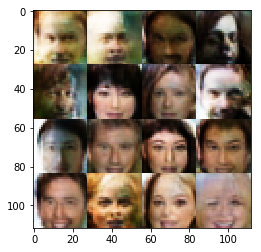

Timestamp 20170806-01-39-09.560 -  Epoch 1/1 -  Step 16710 -  D Loss: 1.4606 - G Loss: 0.6677
Timestamp 20170806-01-39-21.448 -  Epoch 1/1 -  Step 16720 -  D Loss: 1.1587 - G Loss: 0.8379
Timestamp 20170806-01-39-33.348 -  Epoch 1/1 -  Step 16730 -  D Loss: 1.1958 - G Loss: 0.9319
Timestamp 20170806-01-39-45.240 -  Epoch 1/1 -  Step 16740 -  D Loss: 1.1611 - G Loss: 0.9854
Timestamp 20170806-01-39-57.132 -  Epoch 1/1 -  Step 16750 -  D Loss: 1.1574 - G Loss: 1.1125
Timestamp 20170806-01-40-09.027 -  Epoch 1/1 -  Step 16760 -  D Loss: 1.2545 - G Loss: 0.9820
Timestamp 20170806-01-40-20.921 -  Epoch 1/1 -  Step 16770 -  D Loss: 1.0690 - G Loss: 1.1205
Timestamp 20170806-01-40-32.810 -  Epoch 1/1 -  Step 16780 -  D Loss: 1.1353 - G Loss: 0.8779
Timestamp 20170806-01-40-44.714 -  Epoch 1/1 -  Step 16790 -  D Loss: 1.2194 - G Loss: 1.2312
Timestamp 20170806-01-40-56.594 -  Epoch 1/1 -  Step 16800 -  D Loss: 0.9622 - G Loss: 1.1680


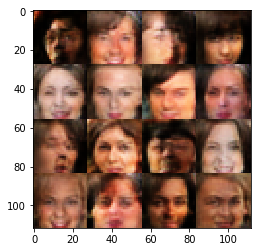

Timestamp 20170806-01-41-09.406 -  Epoch 1/1 -  Step 16810 -  D Loss: 1.2727 - G Loss: 0.8634
Timestamp 20170806-01-41-21.300 -  Epoch 1/1 -  Step 16820 -  D Loss: 1.3136 - G Loss: 1.0846
Timestamp 20170806-01-41-33.203 -  Epoch 1/1 -  Step 16830 -  D Loss: 1.2880 - G Loss: 1.3902
Timestamp 20170806-01-41-45.094 -  Epoch 1/1 -  Step 16840 -  D Loss: 1.1707 - G Loss: 1.0753
Timestamp 20170806-01-41-56.975 -  Epoch 1/1 -  Step 16850 -  D Loss: 1.1516 - G Loss: 1.0265
Timestamp 20170806-01-42-08.875 -  Epoch 1/1 -  Step 16860 -  D Loss: 1.2523 - G Loss: 0.8154
Timestamp 20170806-01-42-20.770 -  Epoch 1/1 -  Step 16870 -  D Loss: 1.0474 - G Loss: 0.9850
Timestamp 20170806-01-42-32.662 -  Epoch 1/1 -  Step 16880 -  D Loss: 1.3607 - G Loss: 0.6523
Timestamp 20170806-01-42-44.558 -  Epoch 1/1 -  Step 16890 -  D Loss: 1.5276 - G Loss: 0.9649
Timestamp 20170806-01-42-56.443 -  Epoch 1/1 -  Step 16900 -  D Loss: 1.3202 - G Loss: 0.7199


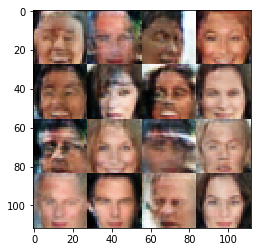

Timestamp 20170806-01-43-09.320 -  Epoch 1/1 -  Step 16910 -  D Loss: 1.1829 - G Loss: 0.9746
Timestamp 20170806-01-43-21.207 -  Epoch 1/1 -  Step 16920 -  D Loss: 0.9877 - G Loss: 1.1142
Timestamp 20170806-01-43-33.111 -  Epoch 1/1 -  Step 16930 -  D Loss: 1.2881 - G Loss: 0.8242
Timestamp 20170806-01-43-44.995 -  Epoch 1/1 -  Step 16940 -  D Loss: 1.0399 - G Loss: 1.0700
Timestamp 20170806-01-43-56.881 -  Epoch 1/1 -  Step 16950 -  D Loss: 1.2037 - G Loss: 0.7964
Timestamp 20170806-01-44-08.776 -  Epoch 1/1 -  Step 16960 -  D Loss: 1.1654 - G Loss: 0.8254
Timestamp 20170806-01-44-20.680 -  Epoch 1/1 -  Step 16970 -  D Loss: 1.2028 - G Loss: 0.8772
Timestamp 20170806-01-44-32.574 -  Epoch 1/1 -  Step 16980 -  D Loss: 0.8598 - G Loss: 0.7517
Timestamp 20170806-01-44-44.484 -  Epoch 1/1 -  Step 16990 -  D Loss: 1.0336 - G Loss: 1.0108
Timestamp 20170806-01-44-56.401 -  Epoch 1/1 -  Step 17000 -  D Loss: 1.2462 - G Loss: 1.0650


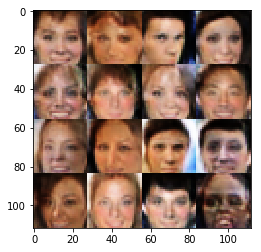

Timestamp 20170806-01-45-09.223 -  Epoch 1/1 -  Step 17010 -  D Loss: 1.4580 - G Loss: 0.8228
Timestamp 20170806-01-45-21.110 -  Epoch 1/1 -  Step 17020 -  D Loss: 1.1736 - G Loss: 0.9127
Timestamp 20170806-01-45-33.012 -  Epoch 1/1 -  Step 17030 -  D Loss: 1.1324 - G Loss: 0.8210
Timestamp 20170806-01-45-44.908 -  Epoch 1/1 -  Step 17040 -  D Loss: 1.3128 - G Loss: 0.8275
Timestamp 20170806-01-45-56.810 -  Epoch 1/1 -  Step 17050 -  D Loss: 1.5138 - G Loss: 0.7334
Timestamp 20170806-01-46-08.698 -  Epoch 1/1 -  Step 17060 -  D Loss: 1.0049 - G Loss: 1.0869
Timestamp 20170806-01-46-20.573 -  Epoch 1/1 -  Step 17070 -  D Loss: 1.0526 - G Loss: 0.9384
Timestamp 20170806-01-46-32.481 -  Epoch 1/1 -  Step 17080 -  D Loss: 1.1478 - G Loss: 0.7740
Timestamp 20170806-01-46-44.371 -  Epoch 1/1 -  Step 17090 -  D Loss: 1.1756 - G Loss: 1.0512
Timestamp 20170806-01-46-56.274 -  Epoch 1/1 -  Step 17100 -  D Loss: 1.2282 - G Loss: 1.0506


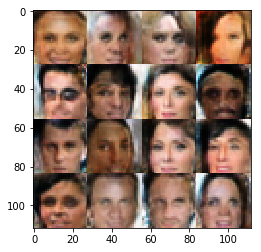

Timestamp 20170806-01-47-09.113 -  Epoch 1/1 -  Step 17110 -  D Loss: 0.9721 - G Loss: 1.2644
Timestamp 20170806-01-47-21.039 -  Epoch 1/1 -  Step 17120 -  D Loss: 1.3584 - G Loss: 0.6601
Timestamp 20170806-01-47-32.933 -  Epoch 1/1 -  Step 17130 -  D Loss: 1.1515 - G Loss: 0.8707
Timestamp 20170806-01-47-44.817 -  Epoch 1/1 -  Step 17140 -  D Loss: 0.8874 - G Loss: 1.1789
Timestamp 20170806-01-47-56.715 -  Epoch 1/1 -  Step 17150 -  D Loss: 0.8813 - G Loss: 1.1695
Timestamp 20170806-01-48-08.613 -  Epoch 1/1 -  Step 17160 -  D Loss: 1.1360 - G Loss: 1.2286
Timestamp 20170806-01-48-20.501 -  Epoch 1/1 -  Step 17170 -  D Loss: 0.9633 - G Loss: 1.1096
Timestamp 20170806-01-48-32.386 -  Epoch 1/1 -  Step 17180 -  D Loss: 1.2380 - G Loss: 0.7765
Timestamp 20170806-01-48-44.277 -  Epoch 1/1 -  Step 17190 -  D Loss: 1.1329 - G Loss: 1.1558
Timestamp 20170806-01-48-56.166 -  Epoch 1/1 -  Step 17200 -  D Loss: 1.1161 - G Loss: 0.7636


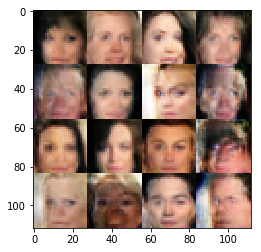

Timestamp 20170806-01-49-08.961 -  Epoch 1/1 -  Step 17210 -  D Loss: 1.0797 - G Loss: 0.9525
Timestamp 20170806-01-49-20.850 -  Epoch 1/1 -  Step 17220 -  D Loss: 1.0795 - G Loss: 1.1567
Timestamp 20170806-01-49-32.742 -  Epoch 1/1 -  Step 17230 -  D Loss: 1.2568 - G Loss: 1.2846
Timestamp 20170806-01-49-44.646 -  Epoch 1/1 -  Step 17240 -  D Loss: 1.0503 - G Loss: 0.7437
Timestamp 20170806-01-49-56.545 -  Epoch 1/1 -  Step 17250 -  D Loss: 1.0135 - G Loss: 1.3172
Timestamp 20170806-01-50-08.450 -  Epoch 1/1 -  Step 17260 -  D Loss: 1.0819 - G Loss: 1.1096
Timestamp 20170806-01-50-20.340 -  Epoch 1/1 -  Step 17270 -  D Loss: 1.1089 - G Loss: 0.8938
Timestamp 20170806-01-50-32.232 -  Epoch 1/1 -  Step 17280 -  D Loss: 0.9563 - G Loss: 1.2043
Timestamp 20170806-01-50-44.124 -  Epoch 1/1 -  Step 17290 -  D Loss: 1.2177 - G Loss: 0.9061
Timestamp 20170806-01-50-56.038 -  Epoch 1/1 -  Step 17300 -  D Loss: 0.9254 - G Loss: 0.9492


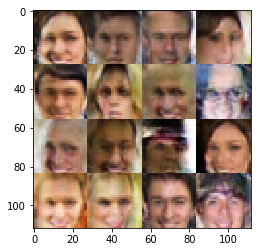

Timestamp 20170806-01-51-08.845 -  Epoch 1/1 -  Step 17310 -  D Loss: 1.1762 - G Loss: 1.3088
Timestamp 20170806-01-51-20.737 -  Epoch 1/1 -  Step 17320 -  D Loss: 1.1021 - G Loss: 0.8722
Timestamp 20170806-01-51-32.640 -  Epoch 1/1 -  Step 17330 -  D Loss: 1.1836 - G Loss: 0.9687
Timestamp 20170806-01-51-44.540 -  Epoch 1/1 -  Step 17340 -  D Loss: 1.3496 - G Loss: 0.7674
Timestamp 20170806-01-51-56.457 -  Epoch 1/1 -  Step 17350 -  D Loss: 1.2403 - G Loss: 1.3234
Timestamp 20170806-01-52-08.348 -  Epoch 1/1 -  Step 17360 -  D Loss: 1.3734 - G Loss: 1.2016
Timestamp 20170806-01-52-20.241 -  Epoch 1/1 -  Step 17370 -  D Loss: 1.2413 - G Loss: 1.1561
Timestamp 20170806-01-52-32.150 -  Epoch 1/1 -  Step 17380 -  D Loss: 0.9066 - G Loss: 1.2499
Timestamp 20170806-01-52-44.042 -  Epoch 1/1 -  Step 17390 -  D Loss: 1.1439 - G Loss: 0.8637
Timestamp 20170806-01-52-55.924 -  Epoch 1/1 -  Step 17400 -  D Loss: 1.3230 - G Loss: 1.4387


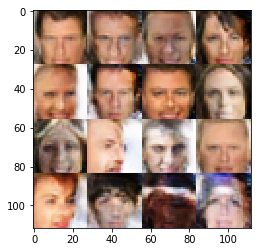

Timestamp 20170806-01-53-08.703 -  Epoch 1/1 -  Step 17410 -  D Loss: 1.1013 - G Loss: 1.0598
Timestamp 20170806-01-53-20.590 -  Epoch 1/1 -  Step 17420 -  D Loss: 1.9520 - G Loss: 0.7153
Timestamp 20170806-01-53-32.471 -  Epoch 1/1 -  Step 17430 -  D Loss: 1.1295 - G Loss: 1.1676
Timestamp 20170806-01-53-44.353 -  Epoch 1/1 -  Step 17440 -  D Loss: 1.7903 - G Loss: 0.7462
Timestamp 20170806-01-53-56.244 -  Epoch 1/1 -  Step 17450 -  D Loss: 1.1116 - G Loss: 0.5730
Timestamp 20170806-01-54-08.125 -  Epoch 1/1 -  Step 17460 -  D Loss: 1.2936 - G Loss: 0.9845
Timestamp 20170806-01-54-20.022 -  Epoch 1/1 -  Step 17470 -  D Loss: 1.2617 - G Loss: 0.8181
Timestamp 20170806-01-54-31.909 -  Epoch 1/1 -  Step 17480 -  D Loss: 1.4049 - G Loss: 1.1006
Timestamp 20170806-01-54-43.810 -  Epoch 1/1 -  Step 17490 -  D Loss: 1.2179 - G Loss: 0.7512
Timestamp 20170806-01-54-55.707 -  Epoch 1/1 -  Step 17500 -  D Loss: 1.1014 - G Loss: 0.7397


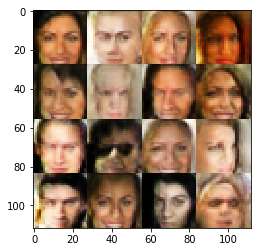

Timestamp 20170806-01-55-08.537 -  Epoch 1/1 -  Step 17510 -  D Loss: 1.0143 - G Loss: 1.4035
Timestamp 20170806-01-55-20.416 -  Epoch 1/1 -  Step 17520 -  D Loss: 1.0539 - G Loss: 1.0125
Timestamp 20170806-01-55-32.329 -  Epoch 1/1 -  Step 17530 -  D Loss: 1.1635 - G Loss: 0.8305
Timestamp 20170806-01-55-44.214 -  Epoch 1/1 -  Step 17540 -  D Loss: 1.4245 - G Loss: 0.9850
Timestamp 20170806-01-55-56.110 -  Epoch 1/1 -  Step 17550 -  D Loss: 1.3486 - G Loss: 0.8284
Timestamp 20170806-01-56-07.994 -  Epoch 1/1 -  Step 17560 -  D Loss: 1.0404 - G Loss: 1.0703
Timestamp 20170806-01-56-19.882 -  Epoch 1/1 -  Step 17570 -  D Loss: 1.3641 - G Loss: 0.9992
Timestamp 20170806-01-56-31.791 -  Epoch 1/1 -  Step 17580 -  D Loss: 1.3920 - G Loss: 0.9184
Timestamp 20170806-01-56-43.673 -  Epoch 1/1 -  Step 17590 -  D Loss: 1.1687 - G Loss: 0.9178
Timestamp 20170806-01-56-55.561 -  Epoch 1/1 -  Step 17600 -  D Loss: 1.1209 - G Loss: 0.9413


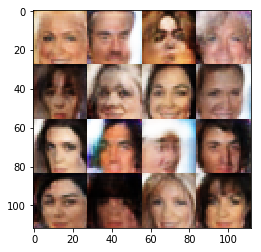

Timestamp 20170806-01-57-08.492 -  Epoch 1/1 -  Step 17610 -  D Loss: 1.1402 - G Loss: 0.9756
Timestamp 20170806-01-57-20.387 -  Epoch 1/1 -  Step 17620 -  D Loss: 1.3074 - G Loss: 0.6505
Timestamp 20170806-01-57-32.290 -  Epoch 1/1 -  Step 17630 -  D Loss: 0.9940 - G Loss: 1.1184
Timestamp 20170806-01-57-44.179 -  Epoch 1/1 -  Step 17640 -  D Loss: 1.6044 - G Loss: 0.8488
Timestamp 20170806-01-57-56.065 -  Epoch 1/1 -  Step 17650 -  D Loss: 1.3469 - G Loss: 0.9937
Timestamp 20170806-01-58-07.973 -  Epoch 1/1 -  Step 17660 -  D Loss: 1.0020 - G Loss: 0.9703
Timestamp 20170806-01-58-19.871 -  Epoch 1/1 -  Step 17670 -  D Loss: 1.2902 - G Loss: 0.9531
Timestamp 20170806-01-58-31.780 -  Epoch 1/1 -  Step 17680 -  D Loss: 0.8668 - G Loss: 1.0502
Timestamp 20170806-01-58-43.667 -  Epoch 1/1 -  Step 17690 -  D Loss: 1.4012 - G Loss: 0.7058
Timestamp 20170806-01-58-55.547 -  Epoch 1/1 -  Step 17700 -  D Loss: 0.9783 - G Loss: 1.0833


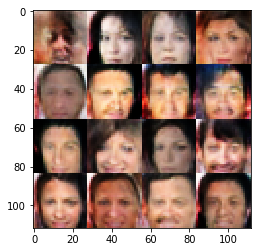

Timestamp 20170806-01-59-08.377 -  Epoch 1/1 -  Step 17710 -  D Loss: 1.5458 - G Loss: 0.7011
Timestamp 20170806-01-59-20.271 -  Epoch 1/1 -  Step 17720 -  D Loss: 1.7344 - G Loss: 0.8803
Timestamp 20170806-01-59-32.158 -  Epoch 1/1 -  Step 17730 -  D Loss: 1.1497 - G Loss: 0.6470
Timestamp 20170806-01-59-44.043 -  Epoch 1/1 -  Step 17740 -  D Loss: 1.1741 - G Loss: 0.7175
Timestamp 20170806-01-59-55.954 -  Epoch 1/1 -  Step 17750 -  D Loss: 1.2403 - G Loss: 0.7294
Timestamp 20170806-02-00-07.844 -  Epoch 1/1 -  Step 17760 -  D Loss: 1.2768 - G Loss: 0.6342
Timestamp 20170806-02-00-19.733 -  Epoch 1/1 -  Step 17770 -  D Loss: 1.0587 - G Loss: 1.0257
Timestamp 20170806-02-00-31.636 -  Epoch 1/1 -  Step 17780 -  D Loss: 1.2460 - G Loss: 0.9468
Timestamp 20170806-02-00-43.526 -  Epoch 1/1 -  Step 17790 -  D Loss: 1.4734 - G Loss: 0.6226
Timestamp 20170806-02-00-55.405 -  Epoch 1/1 -  Step 17800 -  D Loss: 1.0240 - G Loss: 1.0145


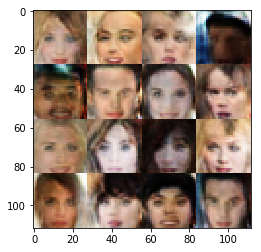

Timestamp 20170806-02-01-08.197 -  Epoch 1/1 -  Step 17810 -  D Loss: 1.0315 - G Loss: 0.9816
Timestamp 20170806-02-01-20.077 -  Epoch 1/1 -  Step 17820 -  D Loss: 1.3237 - G Loss: 0.6232
Timestamp 20170806-02-01-31.958 -  Epoch 1/1 -  Step 17830 -  D Loss: 1.1133 - G Loss: 0.9167
Timestamp 20170806-02-01-43.854 -  Epoch 1/1 -  Step 17840 -  D Loss: 1.3618 - G Loss: 0.6735
Timestamp 20170806-02-01-55.752 -  Epoch 1/1 -  Step 17850 -  D Loss: 1.1850 - G Loss: 1.0106
Timestamp 20170806-02-02-07.637 -  Epoch 1/1 -  Step 17860 -  D Loss: 1.6094 - G Loss: 1.0602
Timestamp 20170806-02-02-19.529 -  Epoch 1/1 -  Step 17870 -  D Loss: 1.3407 - G Loss: 0.7654
Timestamp 20170806-02-02-31.421 -  Epoch 1/1 -  Step 17880 -  D Loss: 1.1085 - G Loss: 0.7729
Timestamp 20170806-02-02-43.308 -  Epoch 1/1 -  Step 17890 -  D Loss: 1.4917 - G Loss: 1.0105
Timestamp 20170806-02-02-55.186 -  Epoch 1/1 -  Step 17900 -  D Loss: 1.3445 - G Loss: 0.8136


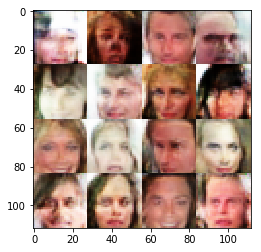

Timestamp 20170806-02-03-08.578 -  Epoch 1/1 -  Step 17910 -  D Loss: 1.1180 - G Loss: 1.0775
Timestamp 20170806-02-03-20.462 -  Epoch 1/1 -  Step 17920 -  D Loss: 1.2774 - G Loss: 0.7374
Timestamp 20170806-02-03-32.352 -  Epoch 1/1 -  Step 17930 -  D Loss: 1.1922 - G Loss: 1.0781
Timestamp 20170806-02-03-44.240 -  Epoch 1/1 -  Step 17940 -  D Loss: 1.5159 - G Loss: 0.9965
Timestamp 20170806-02-03-56.125 -  Epoch 1/1 -  Step 17950 -  D Loss: 1.2391 - G Loss: 0.9809
Timestamp 20170806-02-04-08.018 -  Epoch 1/1 -  Step 17960 -  D Loss: 0.9230 - G Loss: 1.2667
Timestamp 20170806-02-04-19.898 -  Epoch 1/1 -  Step 17970 -  D Loss: 1.0127 - G Loss: 1.3738
Timestamp 20170806-02-04-31.807 -  Epoch 1/1 -  Step 17980 -  D Loss: 1.1838 - G Loss: 0.8562
Timestamp 20170806-02-04-43.695 -  Epoch 1/1 -  Step 17990 -  D Loss: 1.5692 - G Loss: 1.0677
Timestamp 20170806-02-04-55.580 -  Epoch 1/1 -  Step 18000 -  D Loss: 1.1957 - G Loss: 1.1250


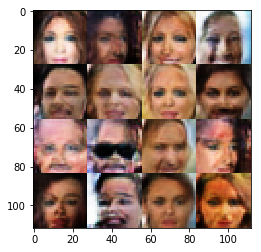

Timestamp 20170806-02-05-08.392 -  Epoch 1/1 -  Step 18010 -  D Loss: 1.0791 - G Loss: 0.9272
Timestamp 20170806-02-05-20.285 -  Epoch 1/1 -  Step 18020 -  D Loss: 1.3219 - G Loss: 0.7828
Timestamp 20170806-02-05-32.164 -  Epoch 1/1 -  Step 18030 -  D Loss: 1.2821 - G Loss: 0.8134
Timestamp 20170806-02-05-44.058 -  Epoch 1/1 -  Step 18040 -  D Loss: 1.4552 - G Loss: 0.7668
Timestamp 20170806-02-05-55.976 -  Epoch 1/1 -  Step 18050 -  D Loss: 1.4106 - G Loss: 1.5228
Timestamp 20170806-02-06-07.882 -  Epoch 1/1 -  Step 18060 -  D Loss: 1.2669 - G Loss: 1.0448
Timestamp 20170806-02-06-19.783 -  Epoch 1/1 -  Step 18070 -  D Loss: 1.0350 - G Loss: 0.8969
Timestamp 20170806-02-06-31.683 -  Epoch 1/1 -  Step 18080 -  D Loss: 1.1442 - G Loss: 0.7785
Timestamp 20170806-02-06-43.567 -  Epoch 1/1 -  Step 18090 -  D Loss: 1.3223 - G Loss: 1.2109
Timestamp 20170806-02-06-55.456 -  Epoch 1/1 -  Step 18100 -  D Loss: 1.3005 - G Loss: 0.7054


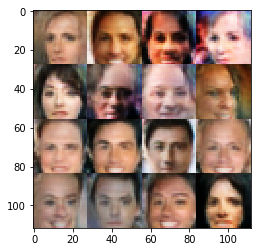

Timestamp 20170806-02-07-08.318 -  Epoch 1/1 -  Step 18110 -  D Loss: 1.4387 - G Loss: 0.9287
Timestamp 20170806-02-07-20.198 -  Epoch 1/1 -  Step 18120 -  D Loss: 1.0868 - G Loss: 0.9968
Timestamp 20170806-02-07-32.101 -  Epoch 1/1 -  Step 18130 -  D Loss: 1.7463 - G Loss: 0.7226
Timestamp 20170806-02-07-44.013 -  Epoch 1/1 -  Step 18140 -  D Loss: 0.9527 - G Loss: 0.8432
Timestamp 20170806-02-07-55.903 -  Epoch 1/1 -  Step 18150 -  D Loss: 1.1933 - G Loss: 1.1185
Timestamp 20170806-02-08-07.798 -  Epoch 1/1 -  Step 18160 -  D Loss: 1.3546 - G Loss: 0.9538
Timestamp 20170806-02-08-19.680 -  Epoch 1/1 -  Step 18170 -  D Loss: 1.2438 - G Loss: 0.7169
Timestamp 20170806-02-08-31.573 -  Epoch 1/1 -  Step 18180 -  D Loss: 1.2050 - G Loss: 0.9961
Timestamp 20170806-02-08-43.461 -  Epoch 1/1 -  Step 18190 -  D Loss: 1.2196 - G Loss: 0.8555
Timestamp 20170806-02-08-55.342 -  Epoch 1/1 -  Step 18200 -  D Loss: 1.3641 - G Loss: 1.2083


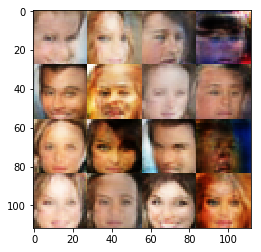

Timestamp 20170806-02-09-08.169 -  Epoch 1/1 -  Step 18210 -  D Loss: 1.3830 - G Loss: 1.1451
Timestamp 20170806-02-09-20.063 -  Epoch 1/1 -  Step 18220 -  D Loss: 1.3310 - G Loss: 0.9338
Timestamp 20170806-02-09-31.951 -  Epoch 1/1 -  Step 18230 -  D Loss: 1.1476 - G Loss: 1.0672
Timestamp 20170806-02-09-43.849 -  Epoch 1/1 -  Step 18240 -  D Loss: 1.5405 - G Loss: 1.1169
Timestamp 20170806-02-09-55.755 -  Epoch 1/1 -  Step 18250 -  D Loss: 1.3716 - G Loss: 0.7923
Timestamp 20170806-02-10-07.624 -  Epoch 1/1 -  Step 18260 -  D Loss: 1.1314 - G Loss: 1.0448
Timestamp 20170806-02-10-19.509 -  Epoch 1/1 -  Step 18270 -  D Loss: 1.1569 - G Loss: 1.0450
Timestamp 20170806-02-10-31.400 -  Epoch 1/1 -  Step 18280 -  D Loss: 1.4163 - G Loss: 0.9807
Timestamp 20170806-02-10-43.290 -  Epoch 1/1 -  Step 18290 -  D Loss: 1.4741 - G Loss: 1.3453
Timestamp 20170806-02-10-55.195 -  Epoch 1/1 -  Step 18300 -  D Loss: 1.3952 - G Loss: 1.0662


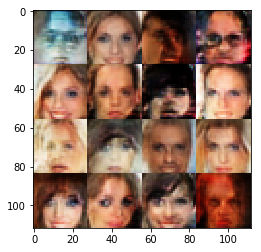

Timestamp 20170806-02-11-08.047 -  Epoch 1/1 -  Step 18310 -  D Loss: 1.1712 - G Loss: 0.7332
Timestamp 20170806-02-11-19.932 -  Epoch 1/1 -  Step 18320 -  D Loss: 1.4066 - G Loss: 0.7643
Timestamp 20170806-02-11-31.838 -  Epoch 1/1 -  Step 18330 -  D Loss: 1.2721 - G Loss: 0.7576
Timestamp 20170806-02-11-43.709 -  Epoch 1/1 -  Step 18340 -  D Loss: 1.4060 - G Loss: 0.8322
Timestamp 20170806-02-11-55.599 -  Epoch 1/1 -  Step 18350 -  D Loss: 0.9496 - G Loss: 1.0720
Timestamp 20170806-02-12-07.499 -  Epoch 1/1 -  Step 18360 -  D Loss: 1.1059 - G Loss: 1.3434
Timestamp 20170806-02-12-19.390 -  Epoch 1/1 -  Step 18370 -  D Loss: 1.3450 - G Loss: 1.3328
Timestamp 20170806-02-12-31.283 -  Epoch 1/1 -  Step 18380 -  D Loss: 1.1589 - G Loss: 0.8161
Timestamp 20170806-02-12-43.183 -  Epoch 1/1 -  Step 18390 -  D Loss: 1.0806 - G Loss: 0.8622
Timestamp 20170806-02-12-55.058 -  Epoch 1/1 -  Step 18400 -  D Loss: 1.5156 - G Loss: 0.5707


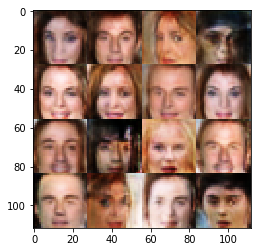

Timestamp 20170806-02-13-07.912 -  Epoch 1/1 -  Step 18410 -  D Loss: 1.5567 - G Loss: 0.9447
Timestamp 20170806-02-13-19.796 -  Epoch 1/1 -  Step 18420 -  D Loss: 1.4381 - G Loss: 0.8254
Timestamp 20170806-02-13-31.671 -  Epoch 1/1 -  Step 18430 -  D Loss: 1.1030 - G Loss: 1.0532
Timestamp 20170806-02-13-43.581 -  Epoch 1/1 -  Step 18440 -  D Loss: 1.1089 - G Loss: 1.1914
Timestamp 20170806-02-13-55.477 -  Epoch 1/1 -  Step 18450 -  D Loss: 1.0289 - G Loss: 1.0777
Timestamp 20170806-02-14-07.370 -  Epoch 1/1 -  Step 18460 -  D Loss: 1.4153 - G Loss: 0.6363
Timestamp 20170806-02-14-19.281 -  Epoch 1/1 -  Step 18470 -  D Loss: 1.0201 - G Loss: 0.7191
Timestamp 20170806-02-14-31.196 -  Epoch 1/1 -  Step 18480 -  D Loss: 1.1402 - G Loss: 1.1052
Timestamp 20170806-02-14-43.075 -  Epoch 1/1 -  Step 18490 -  D Loss: 1.1348 - G Loss: 0.9862
Timestamp 20170806-02-14-54.962 -  Epoch 1/1 -  Step 18500 -  D Loss: 1.2037 - G Loss: 0.9786


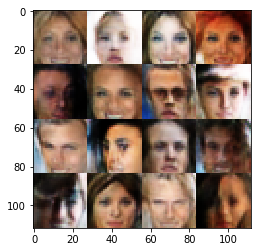

Timestamp 20170806-02-15-07.800 -  Epoch 1/1 -  Step 18510 -  D Loss: 1.1035 - G Loss: 1.0775
Timestamp 20170806-02-15-19.702 -  Epoch 1/1 -  Step 18520 -  D Loss: 1.2401 - G Loss: 1.0817
Timestamp 20170806-02-15-31.605 -  Epoch 1/1 -  Step 18530 -  D Loss: 1.4628 - G Loss: 0.9206
Timestamp 20170806-02-15-43.492 -  Epoch 1/1 -  Step 18540 -  D Loss: 1.0032 - G Loss: 1.1574
Timestamp 20170806-02-15-55.385 -  Epoch 1/1 -  Step 18550 -  D Loss: 1.2433 - G Loss: 0.8100
Timestamp 20170806-02-16-07.295 -  Epoch 1/1 -  Step 18560 -  D Loss: 1.2517 - G Loss: 1.1320
Timestamp 20170806-02-16-19.187 -  Epoch 1/1 -  Step 18570 -  D Loss: 1.2807 - G Loss: 0.8394
Timestamp 20170806-02-16-31.081 -  Epoch 1/1 -  Step 18580 -  D Loss: 1.0988 - G Loss: 1.0026
Timestamp 20170806-02-16-42.961 -  Epoch 1/1 -  Step 18590 -  D Loss: 1.2914 - G Loss: 0.6577
Timestamp 20170806-02-16-54.850 -  Epoch 1/1 -  Step 18600 -  D Loss: 1.2389 - G Loss: 0.8227


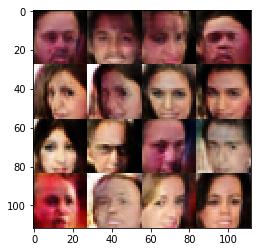

Timestamp 20170806-02-17-07.684 -  Epoch 1/1 -  Step 18610 -  D Loss: 1.0598 - G Loss: 0.8295
Timestamp 20170806-02-17-19.583 -  Epoch 1/1 -  Step 18620 -  D Loss: 1.0069 - G Loss: 0.7071
Timestamp 20170806-02-17-31.487 -  Epoch 1/1 -  Step 18630 -  D Loss: 1.0149 - G Loss: 0.7882
Timestamp 20170806-02-17-43.367 -  Epoch 1/1 -  Step 18640 -  D Loss: 1.3813 - G Loss: 1.0051
Timestamp 20170806-02-17-55.263 -  Epoch 1/1 -  Step 18650 -  D Loss: 1.3648 - G Loss: 0.8522
Timestamp 20170806-02-18-07.160 -  Epoch 1/1 -  Step 18660 -  D Loss: 1.2312 - G Loss: 0.9210
Timestamp 20170806-02-18-19.046 -  Epoch 1/1 -  Step 18670 -  D Loss: 1.1842 - G Loss: 0.7204
Timestamp 20170806-02-18-30.937 -  Epoch 1/1 -  Step 18680 -  D Loss: 1.2974 - G Loss: 0.6412
Timestamp 20170806-02-18-42.829 -  Epoch 1/1 -  Step 18690 -  D Loss: 1.2133 - G Loss: 0.9078
Timestamp 20170806-02-18-54.723 -  Epoch 1/1 -  Step 18700 -  D Loss: 1.3410 - G Loss: 0.7463


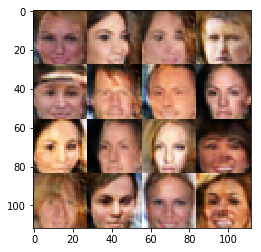

Timestamp 20170806-02-19-07.573 -  Epoch 1/1 -  Step 18710 -  D Loss: 1.0225 - G Loss: 1.2777
Timestamp 20170806-02-19-19.489 -  Epoch 1/1 -  Step 18720 -  D Loss: 1.2304 - G Loss: 0.7238
Timestamp 20170806-02-19-31.389 -  Epoch 1/1 -  Step 18730 -  D Loss: 1.2976 - G Loss: 0.7414
Timestamp 20170806-02-19-43.273 -  Epoch 1/1 -  Step 18740 -  D Loss: 1.2801 - G Loss: 0.8870
Timestamp 20170806-02-19-55.168 -  Epoch 1/1 -  Step 18750 -  D Loss: 1.1911 - G Loss: 0.9363
Timestamp 20170806-02-20-07.059 -  Epoch 1/1 -  Step 18760 -  D Loss: 1.0760 - G Loss: 1.0180
Timestamp 20170806-02-20-18.953 -  Epoch 1/1 -  Step 18770 -  D Loss: 1.3114 - G Loss: 0.9401
Timestamp 20170806-02-20-30.847 -  Epoch 1/1 -  Step 18780 -  D Loss: 1.2226 - G Loss: 0.9792
Timestamp 20170806-02-20-42.742 -  Epoch 1/1 -  Step 18790 -  D Loss: 1.2246 - G Loss: 0.6692
Timestamp 20170806-02-20-54.635 -  Epoch 1/1 -  Step 18800 -  D Loss: 1.2501 - G Loss: 0.8047


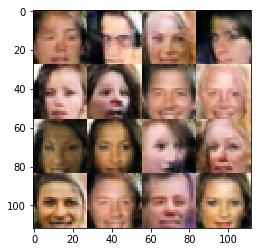

Timestamp 20170806-02-21-07.485 -  Epoch 1/1 -  Step 18810 -  D Loss: 1.0834 - G Loss: 1.2213
Timestamp 20170806-02-21-19.389 -  Epoch 1/1 -  Step 18820 -  D Loss: 1.0681 - G Loss: 1.0610
Timestamp 20170806-02-21-31.305 -  Epoch 1/1 -  Step 18830 -  D Loss: 1.2073 - G Loss: 0.8593
Timestamp 20170806-02-21-43.193 -  Epoch 1/1 -  Step 18840 -  D Loss: 1.1196 - G Loss: 0.8936
Timestamp 20170806-02-21-55.097 -  Epoch 1/1 -  Step 18850 -  D Loss: 0.9678 - G Loss: 0.8677
Timestamp 20170806-02-22-07.005 -  Epoch 1/1 -  Step 18860 -  D Loss: 1.0719 - G Loss: 1.2144
Timestamp 20170806-02-22-18.899 -  Epoch 1/1 -  Step 18870 -  D Loss: 1.0849 - G Loss: 0.8028
Timestamp 20170806-02-22-30.809 -  Epoch 1/1 -  Step 18880 -  D Loss: 1.2464 - G Loss: 0.8254
Timestamp 20170806-02-22-42.703 -  Epoch 1/1 -  Step 18890 -  D Loss: 1.0257 - G Loss: 1.3641
Timestamp 20170806-02-22-54.591 -  Epoch 1/1 -  Step 18900 -  D Loss: 1.0224 - G Loss: 0.7236


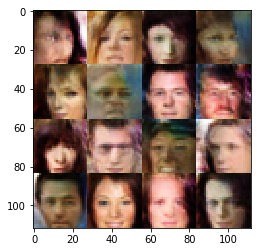

Timestamp 20170806-02-23-07.440 -  Epoch 1/1 -  Step 18910 -  D Loss: 1.1455 - G Loss: 1.3163
Timestamp 20170806-02-23-19.322 -  Epoch 1/1 -  Step 18920 -  D Loss: 1.2888 - G Loss: 1.1188
Timestamp 20170806-02-23-31.217 -  Epoch 1/1 -  Step 18930 -  D Loss: 1.2485 - G Loss: 0.8420
Timestamp 20170806-02-23-43.123 -  Epoch 1/1 -  Step 18940 -  D Loss: 1.4276 - G Loss: 0.6701
Timestamp 20170806-02-23-55.025 -  Epoch 1/1 -  Step 18950 -  D Loss: 1.7926 - G Loss: 0.8621
Timestamp 20170806-02-24-06.914 -  Epoch 1/1 -  Step 18960 -  D Loss: 1.1321 - G Loss: 0.8101
Timestamp 20170806-02-24-18.804 -  Epoch 1/1 -  Step 18970 -  D Loss: 1.2095 - G Loss: 0.8342
Timestamp 20170806-02-24-30.704 -  Epoch 1/1 -  Step 18980 -  D Loss: 1.1743 - G Loss: 0.7616
Timestamp 20170806-02-24-42.599 -  Epoch 1/1 -  Step 18990 -  D Loss: 1.1793 - G Loss: 0.8735
Timestamp 20170806-02-24-54.489 -  Epoch 1/1 -  Step 19000 -  D Loss: 1.1028 - G Loss: 0.9823


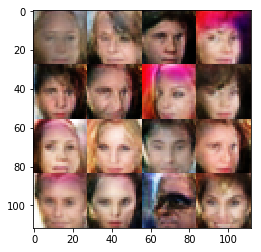

Timestamp 20170806-02-25-07.347 -  Epoch 1/1 -  Step 19010 -  D Loss: 1.5235 - G Loss: 0.6900
Timestamp 20170806-02-25-19.288 -  Epoch 1/1 -  Step 19020 -  D Loss: 1.1222 - G Loss: 0.8430
Timestamp 20170806-02-25-31.203 -  Epoch 1/1 -  Step 19030 -  D Loss: 1.1010 - G Loss: 1.2137
Timestamp 20170806-02-25-43.079 -  Epoch 1/1 -  Step 19040 -  D Loss: 0.9806 - G Loss: 0.8646
Timestamp 20170806-02-25-54.967 -  Epoch 1/1 -  Step 19050 -  D Loss: 1.2054 - G Loss: 1.0954
Timestamp 20170806-02-26-06.857 -  Epoch 1/1 -  Step 19060 -  D Loss: 1.3078 - G Loss: 0.7946
Timestamp 20170806-02-26-18.741 -  Epoch 1/1 -  Step 19070 -  D Loss: 1.1190 - G Loss: 0.9675
Timestamp 20170806-02-26-30.630 -  Epoch 1/1 -  Step 19080 -  D Loss: 1.4115 - G Loss: 0.9797
Timestamp 20170806-02-26-42.535 -  Epoch 1/1 -  Step 19090 -  D Loss: 1.1206 - G Loss: 1.0281
Timestamp 20170806-02-26-54.431 -  Epoch 1/1 -  Step 19100 -  D Loss: 1.2940 - G Loss: 0.9428


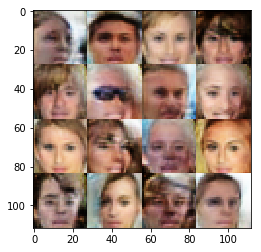

Timestamp 20170806-02-27-07.285 -  Epoch 1/1 -  Step 19110 -  D Loss: 1.3174 - G Loss: 0.9789
Timestamp 20170806-02-27-19.207 -  Epoch 1/1 -  Step 19120 -  D Loss: 1.2798 - G Loss: 1.2262
Timestamp 20170806-02-27-31.113 -  Epoch 1/1 -  Step 19130 -  D Loss: 1.1295 - G Loss: 0.7446
Timestamp 20170806-02-27-42.991 -  Epoch 1/1 -  Step 19140 -  D Loss: 1.2684 - G Loss: 0.7154
Timestamp 20170806-02-27-54.869 -  Epoch 1/1 -  Step 19150 -  D Loss: 1.3761 - G Loss: 0.7459
Timestamp 20170806-02-28-06.764 -  Epoch 1/1 -  Step 19160 -  D Loss: 1.2615 - G Loss: 1.1769
Timestamp 20170806-02-28-18.665 -  Epoch 1/1 -  Step 19170 -  D Loss: 1.1412 - G Loss: 1.0753
Timestamp 20170806-02-28-30.555 -  Epoch 1/1 -  Step 19180 -  D Loss: 1.0380 - G Loss: 1.1346
Timestamp 20170806-02-28-42.440 -  Epoch 1/1 -  Step 19190 -  D Loss: 1.1089 - G Loss: 0.8848
Timestamp 20170806-02-28-54.325 -  Epoch 1/1 -  Step 19200 -  D Loss: 1.1372 - G Loss: 0.9075


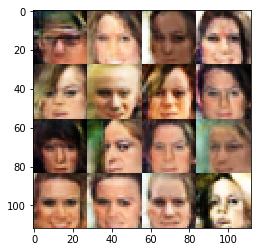

Timestamp 20170806-02-29-07.197 -  Epoch 1/1 -  Step 19210 -  D Loss: 0.9864 - G Loss: 1.3580
Timestamp 20170806-02-29-19.077 -  Epoch 1/1 -  Step 19220 -  D Loss: 1.2053 - G Loss: 0.7775
Timestamp 20170806-02-29-30.956 -  Epoch 1/1 -  Step 19230 -  D Loss: 1.0629 - G Loss: 0.8814
Timestamp 20170806-02-29-42.847 -  Epoch 1/1 -  Step 19240 -  D Loss: 1.3356 - G Loss: 0.9097
Timestamp 20170806-02-29-54.742 -  Epoch 1/1 -  Step 19250 -  D Loss: 1.2512 - G Loss: 0.8411
Timestamp 20170806-02-30-06.623 -  Epoch 1/1 -  Step 19260 -  D Loss: 1.2445 - G Loss: 0.8210
Timestamp 20170806-02-30-18.512 -  Epoch 1/1 -  Step 19270 -  D Loss: 1.1867 - G Loss: 0.8765
Timestamp 20170806-02-30-30.410 -  Epoch 1/1 -  Step 19280 -  D Loss: 1.1549 - G Loss: 0.9325
Timestamp 20170806-02-30-42.313 -  Epoch 1/1 -  Step 19290 -  D Loss: 1.3911 - G Loss: 0.9376
Timestamp 20170806-02-30-54.205 -  Epoch 1/1 -  Step 19300 -  D Loss: 1.1392 - G Loss: 0.8796


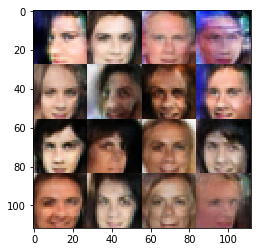

Timestamp 20170806-02-31-07.061 -  Epoch 1/1 -  Step 19310 -  D Loss: 1.1875 - G Loss: 0.8216
Timestamp 20170806-02-31-18.943 -  Epoch 1/1 -  Step 19320 -  D Loss: 0.9658 - G Loss: 0.8799
Timestamp 20170806-02-31-30.829 -  Epoch 1/1 -  Step 19330 -  D Loss: 1.0473 - G Loss: 1.2260
Timestamp 20170806-02-31-42.729 -  Epoch 1/1 -  Step 19340 -  D Loss: 1.1300 - G Loss: 1.0138
Timestamp 20170806-02-31-54.619 -  Epoch 1/1 -  Step 19350 -  D Loss: 1.1979 - G Loss: 0.7710
Timestamp 20170806-02-32-06.534 -  Epoch 1/1 -  Step 19360 -  D Loss: 0.9462 - G Loss: 0.9495
Timestamp 20170806-02-32-18.430 -  Epoch 1/1 -  Step 19370 -  D Loss: 1.1212 - G Loss: 0.7262
Timestamp 20170806-02-32-30.320 -  Epoch 1/1 -  Step 19380 -  D Loss: 1.2714 - G Loss: 0.8248
Timestamp 20170806-02-32-42.211 -  Epoch 1/1 -  Step 19390 -  D Loss: 1.1426 - G Loss: 0.9127
Timestamp 20170806-02-32-54.105 -  Epoch 1/1 -  Step 19400 -  D Loss: 1.2748 - G Loss: 0.6805


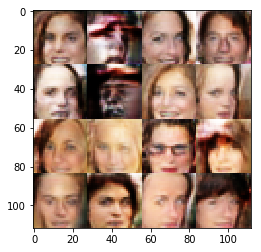

Timestamp 20170806-02-33-06.977 -  Epoch 1/1 -  Step 19410 -  D Loss: 1.1951 - G Loss: 0.9535
Timestamp 20170806-02-33-18.866 -  Epoch 1/1 -  Step 19420 -  D Loss: 1.1979 - G Loss: 1.3598
Timestamp 20170806-02-33-30.748 -  Epoch 1/1 -  Step 19430 -  D Loss: 1.1099 - G Loss: 0.9335
Timestamp 20170806-02-33-42.633 -  Epoch 1/1 -  Step 19440 -  D Loss: 1.0964 - G Loss: 0.8674
Timestamp 20170806-02-33-54.514 -  Epoch 1/1 -  Step 19450 -  D Loss: 1.2079 - G Loss: 1.3689
Timestamp 20170806-02-34-06.408 -  Epoch 1/1 -  Step 19460 -  D Loss: 1.3661 - G Loss: 0.7895
Timestamp 20170806-02-34-18.321 -  Epoch 1/1 -  Step 19470 -  D Loss: 0.9804 - G Loss: 0.9087
Timestamp 20170806-02-34-30.209 -  Epoch 1/1 -  Step 19480 -  D Loss: 1.2948 - G Loss: 0.6199
Timestamp 20170806-02-34-42.100 -  Epoch 1/1 -  Step 19490 -  D Loss: 1.2326 - G Loss: 0.8153
Timestamp 20170806-02-34-53.985 -  Epoch 1/1 -  Step 19500 -  D Loss: 1.0344 - G Loss: 0.9434


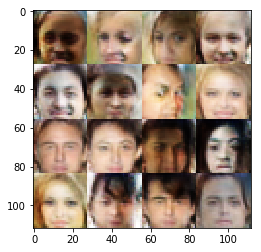

Timestamp 20170806-02-35-06.888 -  Epoch 1/1 -  Step 19510 -  D Loss: 1.1347 - G Loss: 1.0800
Timestamp 20170806-02-35-18.786 -  Epoch 1/1 -  Step 19520 -  D Loss: 1.3585 - G Loss: 1.1600
Timestamp 20170806-02-35-30.702 -  Epoch 1/1 -  Step 19530 -  D Loss: 1.4204 - G Loss: 0.8588
Timestamp 20170806-02-35-42.599 -  Epoch 1/1 -  Step 19540 -  D Loss: 1.1431 - G Loss: 0.6126
Timestamp 20170806-02-35-54.485 -  Epoch 1/1 -  Step 19550 -  D Loss: 1.2498 - G Loss: 0.8318
Timestamp 20170806-02-36-06.395 -  Epoch 1/1 -  Step 19560 -  D Loss: 0.9549 - G Loss: 1.0977
Timestamp 20170806-02-36-18.283 -  Epoch 1/1 -  Step 19570 -  D Loss: 1.3982 - G Loss: 0.9532
Timestamp 20170806-02-36-30.161 -  Epoch 1/1 -  Step 19580 -  D Loss: 1.1956 - G Loss: 1.3132
Timestamp 20170806-02-36-42.054 -  Epoch 1/1 -  Step 19590 -  D Loss: 1.2644 - G Loss: 1.3017
Timestamp 20170806-02-36-53.950 -  Epoch 1/1 -  Step 19600 -  D Loss: 1.2430 - G Loss: 0.8939


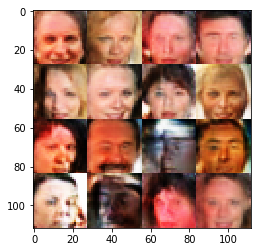

Timestamp 20170806-02-37-06.863 -  Epoch 1/1 -  Step 19610 -  D Loss: 1.4884 - G Loss: 1.0319
Timestamp 20170806-02-37-18.760 -  Epoch 1/1 -  Step 19620 -  D Loss: 0.8596 - G Loss: 0.8533
Timestamp 20170806-02-37-30.669 -  Epoch 1/1 -  Step 19630 -  D Loss: 1.2393 - G Loss: 1.0869
Timestamp 20170806-02-37-42.549 -  Epoch 1/1 -  Step 19640 -  D Loss: 1.3566 - G Loss: 0.7014
Timestamp 20170806-02-37-54.434 -  Epoch 1/1 -  Step 19650 -  D Loss: 1.2928 - G Loss: 1.1066
Timestamp 20170806-02-38-06.348 -  Epoch 1/1 -  Step 19660 -  D Loss: 1.2080 - G Loss: 0.7523
Timestamp 20170806-02-38-18.257 -  Epoch 1/1 -  Step 19670 -  D Loss: 1.0084 - G Loss: 1.3351
Timestamp 20170806-02-38-30.154 -  Epoch 1/1 -  Step 19680 -  D Loss: 1.2737 - G Loss: 0.8750
Timestamp 20170806-02-38-42.053 -  Epoch 1/1 -  Step 19690 -  D Loss: 1.3583 - G Loss: 0.9987
Timestamp 20170806-02-38-53.931 -  Epoch 1/1 -  Step 19700 -  D Loss: 1.3895 - G Loss: 1.3905


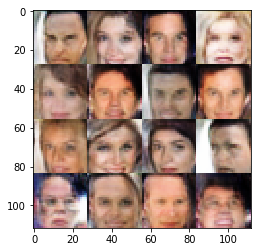

Timestamp 20170806-02-39-06.804 -  Epoch 1/1 -  Step 19710 -  D Loss: 1.2129 - G Loss: 0.8930
Timestamp 20170806-02-39-18.697 -  Epoch 1/1 -  Step 19720 -  D Loss: 1.1782 - G Loss: 1.3270
Timestamp 20170806-02-39-30.609 -  Epoch 1/1 -  Step 19730 -  D Loss: 0.9171 - G Loss: 1.0674
Timestamp 20170806-02-39-42.493 -  Epoch 1/1 -  Step 19740 -  D Loss: 1.1669 - G Loss: 1.0485
Timestamp 20170806-02-39-54.389 -  Epoch 1/1 -  Step 19750 -  D Loss: 1.2831 - G Loss: 0.9746
Timestamp 20170806-02-40-06.287 -  Epoch 1/1 -  Step 19760 -  D Loss: 1.3998 - G Loss: 0.6446
Timestamp 20170806-02-40-18.175 -  Epoch 1/1 -  Step 19770 -  D Loss: 1.4232 - G Loss: 0.9775
Timestamp 20170806-02-40-30.082 -  Epoch 1/1 -  Step 19780 -  D Loss: 1.2367 - G Loss: 1.0254
Timestamp 20170806-02-40-41.974 -  Epoch 1/1 -  Step 19790 -  D Loss: 1.2331 - G Loss: 1.0129
Timestamp 20170806-02-40-53.861 -  Epoch 1/1 -  Step 19800 -  D Loss: 1.1193 - G Loss: 1.1492


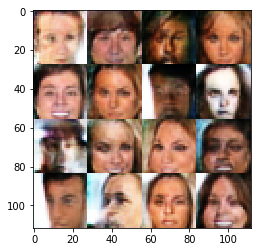

Timestamp 20170806-02-41-06.749 -  Epoch 1/1 -  Step 19810 -  D Loss: 1.3523 - G Loss: 1.1077
Timestamp 20170806-02-41-18.635 -  Epoch 1/1 -  Step 19820 -  D Loss: 1.3337 - G Loss: 0.8169
Timestamp 20170806-02-41-30.526 -  Epoch 1/1 -  Step 19830 -  D Loss: 1.3118 - G Loss: 0.8770
Timestamp 20170806-02-41-42.412 -  Epoch 1/1 -  Step 19840 -  D Loss: 1.2205 - G Loss: 1.2661
Timestamp 20170806-02-41-54.301 -  Epoch 1/1 -  Step 19850 -  D Loss: 1.1581 - G Loss: 1.0984
Timestamp 20170806-02-42-06.188 -  Epoch 1/1 -  Step 19860 -  D Loss: 1.4203 - G Loss: 0.6766
Timestamp 20170806-02-42-18.073 -  Epoch 1/1 -  Step 19870 -  D Loss: 1.0435 - G Loss: 1.2978
Timestamp 20170806-02-42-29.962 -  Epoch 1/1 -  Step 19880 -  D Loss: 1.1027 - G Loss: 1.3364
Timestamp 20170806-02-42-41.862 -  Epoch 1/1 -  Step 19890 -  D Loss: 0.9868 - G Loss: 1.1242
Timestamp 20170806-02-42-53.770 -  Epoch 1/1 -  Step 19900 -  D Loss: 1.1185 - G Loss: 1.3422


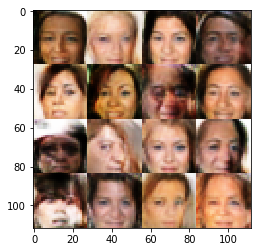

Timestamp 20170806-02-43-06.641 -  Epoch 1/1 -  Step 19910 -  D Loss: 1.0600 - G Loss: 1.3027
Timestamp 20170806-02-43-18.537 -  Epoch 1/1 -  Step 19920 -  D Loss: 1.4422 - G Loss: 0.8081
Timestamp 20170806-02-43-30.431 -  Epoch 1/1 -  Step 19930 -  D Loss: 0.9890 - G Loss: 1.0145
Timestamp 20170806-02-43-42.338 -  Epoch 1/1 -  Step 19940 -  D Loss: 1.3442 - G Loss: 0.7727
Timestamp 20170806-02-43-54.228 -  Epoch 1/1 -  Step 19950 -  D Loss: 1.3850 - G Loss: 0.9176
Timestamp 20170806-02-44-06.119 -  Epoch 1/1 -  Step 19960 -  D Loss: 1.3669 - G Loss: 0.9244
Timestamp 20170806-02-44-18.006 -  Epoch 1/1 -  Step 19970 -  D Loss: 1.3189 - G Loss: 1.3366
Timestamp 20170806-02-44-29.906 -  Epoch 1/1 -  Step 19980 -  D Loss: 1.2675 - G Loss: 0.9113
Timestamp 20170806-02-44-41.798 -  Epoch 1/1 -  Step 19990 -  D Loss: 1.2845 - G Loss: 1.0194
Timestamp 20170806-02-44-53.685 -  Epoch 1/1 -  Step 20000 -  D Loss: 1.2766 - G Loss: 1.0204


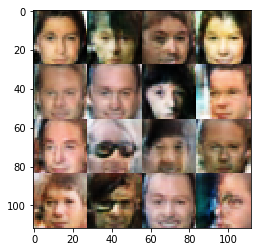

Timestamp 20170806-02-45-06.566 -  Epoch 1/1 -  Step 20010 -  D Loss: 1.2175 - G Loss: 1.3375
Timestamp 20170806-02-45-18.456 -  Epoch 1/1 -  Step 20020 -  D Loss: 0.9722 - G Loss: 1.0654
Timestamp 20170806-02-45-30.352 -  Epoch 1/1 -  Step 20030 -  D Loss: 1.1176 - G Loss: 1.0362
Timestamp 20170806-02-45-42.245 -  Epoch 1/1 -  Step 20040 -  D Loss: 1.1683 - G Loss: 0.7596
Timestamp 20170806-02-45-54.150 -  Epoch 1/1 -  Step 20050 -  D Loss: 1.4218 - G Loss: 0.7521
Timestamp 20170806-02-46-06.052 -  Epoch 1/1 -  Step 20060 -  D Loss: 1.3371 - G Loss: 1.0938
Timestamp 20170806-02-46-17.928 -  Epoch 1/1 -  Step 20070 -  D Loss: 1.2147 - G Loss: 1.0872
Timestamp 20170806-02-46-29.828 -  Epoch 1/1 -  Step 20080 -  D Loss: 1.2127 - G Loss: 0.7654
Timestamp 20170806-02-46-41.713 -  Epoch 1/1 -  Step 20090 -  D Loss: 1.1074 - G Loss: 0.7966
Timestamp 20170806-02-46-53.599 -  Epoch 1/1 -  Step 20100 -  D Loss: 1.4296 - G Loss: 0.8316


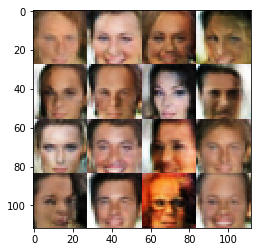

Timestamp 20170806-02-47-06.441 -  Epoch 1/1 -  Step 20110 -  D Loss: 1.3246 - G Loss: 0.7079
Timestamp 20170806-02-47-18.320 -  Epoch 1/1 -  Step 20120 -  D Loss: 1.1117 - G Loss: 1.2358
Timestamp 20170806-02-47-30.214 -  Epoch 1/1 -  Step 20130 -  D Loss: 1.6114 - G Loss: 0.5939
Timestamp 20170806-02-47-42.102 -  Epoch 1/1 -  Step 20140 -  D Loss: 1.1981 - G Loss: 1.0909
Timestamp 20170806-02-47-53.986 -  Epoch 1/1 -  Step 20150 -  D Loss: 1.1762 - G Loss: 0.9678
Timestamp 20170806-02-48-05.888 -  Epoch 1/1 -  Step 20160 -  D Loss: 1.3571 - G Loss: 0.9735
Timestamp 20170806-02-48-17.805 -  Epoch 1/1 -  Step 20170 -  D Loss: 0.8663 - G Loss: 0.9134
Timestamp 20170806-02-48-29.709 -  Epoch 1/1 -  Step 20180 -  D Loss: 1.0190 - G Loss: 1.2319
Timestamp 20170806-02-48-41.600 -  Epoch 1/1 -  Step 20190 -  D Loss: 1.4406 - G Loss: 1.1995
Timestamp 20170806-02-48-53.487 -  Epoch 1/1 -  Step 20200 -  D Loss: 1.4132 - G Loss: 0.7818


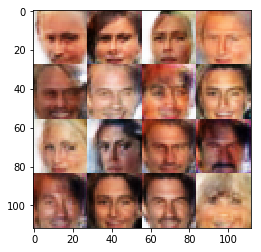

Timestamp 20170806-02-49-06.368 -  Epoch 1/1 -  Step 20210 -  D Loss: 1.5743 - G Loss: 0.9656
Timestamp 20170806-02-49-18.253 -  Epoch 1/1 -  Step 20220 -  D Loss: 0.8444 - G Loss: 1.2350
Timestamp 20170806-02-49-30.138 -  Epoch 1/1 -  Step 20230 -  D Loss: 1.2023 - G Loss: 0.7822
Timestamp 20170806-02-49-42.039 -  Epoch 1/1 -  Step 20240 -  D Loss: 1.0139 - G Loss: 1.1928
Timestamp 20170806-02-49-53.920 -  Epoch 1/1 -  Step 20250 -  D Loss: 1.2073 - G Loss: 0.8201
Timestamp 20170806-02-50-05.799 -  Epoch 1/1 -  Step 20260 -  D Loss: 1.1413 - G Loss: 1.1120
Timestamp 20170806-02-50-17.679 -  Epoch 1/1 -  Step 20270 -  D Loss: 1.3169 - G Loss: 1.1178
Timestamp 20170806-02-50-29.572 -  Epoch 1/1 -  Step 20280 -  D Loss: 1.1363 - G Loss: 0.7855
Timestamp 20170806-02-50-41.456 -  Epoch 1/1 -  Step 20290 -  D Loss: 1.1288 - G Loss: 1.1163
Timestamp 20170806-02-50-53.362 -  Epoch 1/1 -  Step 20300 -  D Loss: 1.0708 - G Loss: 0.8813


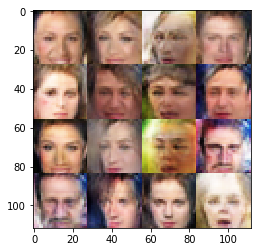

Timestamp 20170806-02-51-06.213 -  Epoch 1/1 -  Step 20310 -  D Loss: 1.3867 - G Loss: 1.0452
Timestamp 20170806-02-51-18.082 -  Epoch 1/1 -  Step 20320 -  D Loss: 1.2421 - G Loss: 0.9975
Timestamp 20170806-02-51-29.991 -  Epoch 1/1 -  Step 20330 -  D Loss: 1.3796 - G Loss: 1.1085
Timestamp 20170806-02-51-41.876 -  Epoch 1/1 -  Step 20340 -  D Loss: 1.3579 - G Loss: 0.8472
Timestamp 20170806-02-51-53.755 -  Epoch 1/1 -  Step 20350 -  D Loss: 1.2099 - G Loss: 0.9425
Timestamp 20170806-02-52-05.666 -  Epoch 1/1 -  Step 20360 -  D Loss: 1.4378 - G Loss: 0.7875
Timestamp 20170806-02-52-17.571 -  Epoch 1/1 -  Step 20370 -  D Loss: 1.0135 - G Loss: 0.9509
Timestamp 20170806-02-52-29.475 -  Epoch 1/1 -  Step 20380 -  D Loss: 1.0725 - G Loss: 0.9322
Timestamp 20170806-02-52-41.354 -  Epoch 1/1 -  Step 20390 -  D Loss: 1.5294 - G Loss: 0.8258
Timestamp 20170806-02-52-53.249 -  Epoch 1/1 -  Step 20400 -  D Loss: 1.0557 - G Loss: 0.9731


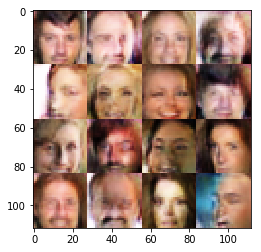

Timestamp 20170806-02-53-06.149 -  Epoch 1/1 -  Step 20410 -  D Loss: 1.2192 - G Loss: 0.7919
Timestamp 20170806-02-53-18.045 -  Epoch 1/1 -  Step 20420 -  D Loss: 1.4693 - G Loss: 0.6687
Timestamp 20170806-02-53-29.939 -  Epoch 1/1 -  Step 20430 -  D Loss: 1.3338 - G Loss: 0.9546
Timestamp 20170806-02-53-41.841 -  Epoch 1/1 -  Step 20440 -  D Loss: 1.3335 - G Loss: 0.9461
Timestamp 20170806-02-53-53.730 -  Epoch 1/1 -  Step 20450 -  D Loss: 1.8744 - G Loss: 0.9911
Timestamp 20170806-02-54-05.619 -  Epoch 1/1 -  Step 20460 -  D Loss: 1.4016 - G Loss: 0.5458
Timestamp 20170806-02-54-17.532 -  Epoch 1/1 -  Step 20470 -  D Loss: 1.5829 - G Loss: 0.7157
Timestamp 20170806-02-54-29.418 -  Epoch 1/1 -  Step 20480 -  D Loss: 1.2221 - G Loss: 0.8682
Timestamp 20170806-02-54-41.313 -  Epoch 1/1 -  Step 20490 -  D Loss: 1.1322 - G Loss: 0.9196
Timestamp 20170806-02-54-53.210 -  Epoch 1/1 -  Step 20500 -  D Loss: 1.3943 - G Loss: 0.7108


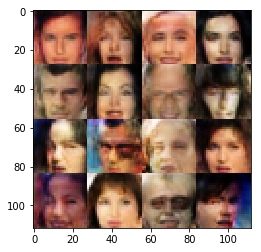

Timestamp 20170806-02-55-06.074 -  Epoch 1/1 -  Step 20510 -  D Loss: 1.1257 - G Loss: 0.9373
Timestamp 20170806-02-55-17.973 -  Epoch 1/1 -  Step 20520 -  D Loss: 1.1684 - G Loss: 1.0031
Timestamp 20170806-02-55-29.884 -  Epoch 1/1 -  Step 20530 -  D Loss: 1.3463 - G Loss: 0.5823
Timestamp 20170806-02-55-41.758 -  Epoch 1/1 -  Step 20540 -  D Loss: 1.2931 - G Loss: 0.7958
Timestamp 20170806-02-55-53.657 -  Epoch 1/1 -  Step 20550 -  D Loss: 1.3111 - G Loss: 0.9889
Timestamp 20170806-02-56-05.553 -  Epoch 1/1 -  Step 20560 -  D Loss: 1.2759 - G Loss: 0.8130
Timestamp 20170806-02-56-17.447 -  Epoch 1/1 -  Step 20570 -  D Loss: 1.4814 - G Loss: 0.6634
Timestamp 20170806-02-56-29.334 -  Epoch 1/1 -  Step 20580 -  D Loss: 1.3033 - G Loss: 1.1198
Timestamp 20170806-02-56-41.237 -  Epoch 1/1 -  Step 20590 -  D Loss: 1.2462 - G Loss: 1.1243
Timestamp 20170806-02-56-53.112 -  Epoch 1/1 -  Step 20600 -  D Loss: 1.1832 - G Loss: 0.8813


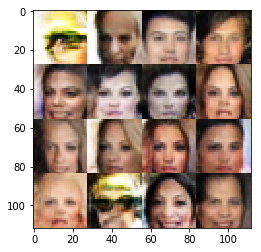

Timestamp 20170806-02-57-06.004 -  Epoch 1/1 -  Step 20610 -  D Loss: 1.2673 - G Loss: 0.7705
Timestamp 20170806-02-57-17.896 -  Epoch 1/1 -  Step 20620 -  D Loss: 1.1411 - G Loss: 1.2614
Timestamp 20170806-02-57-29.797 -  Epoch 1/1 -  Step 20630 -  D Loss: 1.4697 - G Loss: 1.1940
Timestamp 20170806-02-57-41.684 -  Epoch 1/1 -  Step 20640 -  D Loss: 1.2429 - G Loss: 0.8434
Timestamp 20170806-02-57-53.591 -  Epoch 1/1 -  Step 20650 -  D Loss: 1.2133 - G Loss: 1.2682
Timestamp 20170806-02-58-05.486 -  Epoch 1/1 -  Step 20660 -  D Loss: 1.0193 - G Loss: 0.8749
Timestamp 20170806-02-58-17.378 -  Epoch 1/1 -  Step 20670 -  D Loss: 1.1375 - G Loss: 1.0762
Timestamp 20170806-02-58-29.269 -  Epoch 1/1 -  Step 20680 -  D Loss: 1.1384 - G Loss: 0.9590
Timestamp 20170806-02-58-41.186 -  Epoch 1/1 -  Step 20690 -  D Loss: 1.0866 - G Loss: 1.0483
Timestamp 20170806-02-58-53.060 -  Epoch 1/1 -  Step 20700 -  D Loss: 0.9398 - G Loss: 1.2793


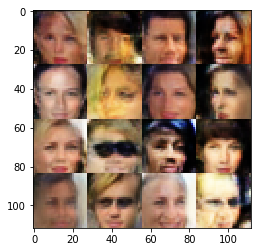

Timestamp 20170806-02-59-05.950 -  Epoch 1/1 -  Step 20710 -  D Loss: 1.2501 - G Loss: 0.9477
Timestamp 20170806-02-59-17.814 -  Epoch 1/1 -  Step 20720 -  D Loss: 1.1788 - G Loss: 0.8076
Timestamp 20170806-02-59-29.708 -  Epoch 1/1 -  Step 20730 -  D Loss: 1.2370 - G Loss: 1.1305
Timestamp 20170806-02-59-41.581 -  Epoch 1/1 -  Step 20740 -  D Loss: 0.9415 - G Loss: 1.0707
Timestamp 20170806-02-59-53.480 -  Epoch 1/1 -  Step 20750 -  D Loss: 1.1690 - G Loss: 1.0158
Timestamp 20170806-03-00-05.387 -  Epoch 1/1 -  Step 20760 -  D Loss: 1.1348 - G Loss: 1.1948
Timestamp 20170806-03-00-17.274 -  Epoch 1/1 -  Step 20770 -  D Loss: 1.3955 - G Loss: 0.9504
Timestamp 20170806-03-00-29.160 -  Epoch 1/1 -  Step 20780 -  D Loss: 1.0970 - G Loss: 1.2631
Timestamp 20170806-03-00-41.055 -  Epoch 1/1 -  Step 20790 -  D Loss: 1.3363 - G Loss: 0.6126
Timestamp 20170806-03-00-52.928 -  Epoch 1/1 -  Step 20800 -  D Loss: 1.1558 - G Loss: 1.1095


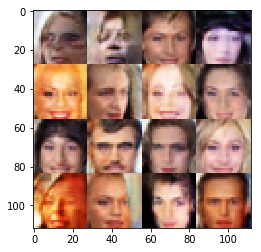

Timestamp 20170806-03-01-05.804 -  Epoch 1/1 -  Step 20810 -  D Loss: 1.2919 - G Loss: 0.9475
Timestamp 20170806-03-01-17.697 -  Epoch 1/1 -  Step 20820 -  D Loss: 1.0150 - G Loss: 1.0217
Timestamp 20170806-03-01-29.595 -  Epoch 1/1 -  Step 20830 -  D Loss: 1.1422 - G Loss: 1.4017
Timestamp 20170806-03-01-41.481 -  Epoch 1/1 -  Step 20840 -  D Loss: 0.9233 - G Loss: 1.0930
Timestamp 20170806-03-01-53.384 -  Epoch 1/1 -  Step 20850 -  D Loss: 1.1509 - G Loss: 1.0253
Timestamp 20170806-03-02-05.276 -  Epoch 1/1 -  Step 20860 -  D Loss: 1.2977 - G Loss: 0.9907
Timestamp 20170806-03-02-17.163 -  Epoch 1/1 -  Step 20870 -  D Loss: 1.3633 - G Loss: 1.1679
Timestamp 20170806-03-02-29.053 -  Epoch 1/1 -  Step 20880 -  D Loss: 1.0532 - G Loss: 1.1136
Timestamp 20170806-03-02-40.954 -  Epoch 1/1 -  Step 20890 -  D Loss: 1.2665 - G Loss: 1.1281
Timestamp 20170806-03-02-52.826 -  Epoch 1/1 -  Step 20900 -  D Loss: 1.4943 - G Loss: 0.8453


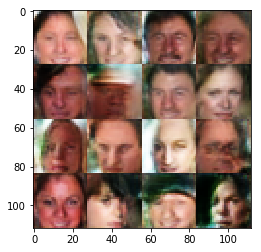

Timestamp 20170806-03-03-05.730 -  Epoch 1/1 -  Step 20910 -  D Loss: 1.2160 - G Loss: 1.0886
Timestamp 20170806-03-03-17.611 -  Epoch 1/1 -  Step 20920 -  D Loss: 1.4966 - G Loss: 1.4837
Timestamp 20170806-03-03-29.495 -  Epoch 1/1 -  Step 20930 -  D Loss: 1.2121 - G Loss: 1.0164
Timestamp 20170806-03-03-41.391 -  Epoch 1/1 -  Step 20940 -  D Loss: 1.0058 - G Loss: 1.1293
Timestamp 20170806-03-03-53.281 -  Epoch 1/1 -  Step 20950 -  D Loss: 1.5793 - G Loss: 0.8944
Timestamp 20170806-03-04-05.159 -  Epoch 1/1 -  Step 20960 -  D Loss: 1.2421 - G Loss: 0.9400
Timestamp 20170806-03-04-17.042 -  Epoch 1/1 -  Step 20970 -  D Loss: 1.3207 - G Loss: 1.1478
Timestamp 20170806-03-04-28.915 -  Epoch 1/1 -  Step 20980 -  D Loss: 1.7223 - G Loss: 1.0597
Timestamp 20170806-03-04-40.786 -  Epoch 1/1 -  Step 20990 -  D Loss: 1.0908 - G Loss: 0.7724
Timestamp 20170806-03-04-52.681 -  Epoch 1/1 -  Step 21000 -  D Loss: 1.3264 - G Loss: 0.7190


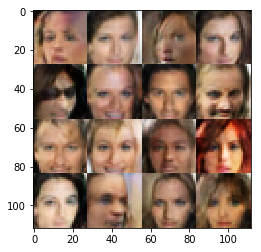

Timestamp 20170806-03-05-05.561 -  Epoch 1/1 -  Step 21010 -  D Loss: 1.2895 - G Loss: 0.8284
Timestamp 20170806-03-05-17.456 -  Epoch 1/1 -  Step 21020 -  D Loss: 1.1804 - G Loss: 0.9195
Timestamp 20170806-03-05-29.346 -  Epoch 1/1 -  Step 21030 -  D Loss: 1.6291 - G Loss: 1.0545
Timestamp 20170806-03-05-41.224 -  Epoch 1/1 -  Step 21040 -  D Loss: 1.2674 - G Loss: 0.9738
Timestamp 20170806-03-05-53.106 -  Epoch 1/1 -  Step 21050 -  D Loss: 1.3221 - G Loss: 0.8390
Timestamp 20170806-03-06-04.984 -  Epoch 1/1 -  Step 21060 -  D Loss: 1.3193 - G Loss: 0.9713
Timestamp 20170806-03-06-16.883 -  Epoch 1/1 -  Step 21070 -  D Loss: 1.6372 - G Loss: 0.9591
Timestamp 20170806-03-06-28.787 -  Epoch 1/1 -  Step 21080 -  D Loss: 1.6518 - G Loss: 0.6750
Timestamp 20170806-03-06-40.673 -  Epoch 1/1 -  Step 21090 -  D Loss: 0.9766 - G Loss: 1.3767
Timestamp 20170806-03-06-52.560 -  Epoch 1/1 -  Step 21100 -  D Loss: 1.0711 - G Loss: 0.6587


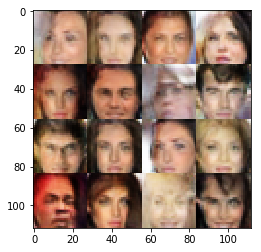

Timestamp 20170806-03-07-05.454 -  Epoch 1/1 -  Step 21110 -  D Loss: 1.2394 - G Loss: 1.0566
Timestamp 20170806-03-07-17.362 -  Epoch 1/1 -  Step 21120 -  D Loss: 1.6024 - G Loss: 1.0690
Timestamp 20170806-03-07-29.255 -  Epoch 1/1 -  Step 21130 -  D Loss: 1.1891 - G Loss: 0.7486
Timestamp 20170806-03-07-41.110 -  Epoch 1/1 -  Step 21140 -  D Loss: 1.3853 - G Loss: 0.8577
Timestamp 20170806-03-07-52.996 -  Epoch 1/1 -  Step 21150 -  D Loss: 1.3329 - G Loss: 0.9415
Timestamp 20170806-03-08-04.888 -  Epoch 1/1 -  Step 21160 -  D Loss: 0.9894 - G Loss: 1.0919
Timestamp 20170806-03-08-16.762 -  Epoch 1/1 -  Step 21170 -  D Loss: 1.2130 - G Loss: 0.9219
Timestamp 20170806-03-08-28.646 -  Epoch 1/1 -  Step 21180 -  D Loss: 1.2837 - G Loss: 0.7913
Timestamp 20170806-03-08-40.538 -  Epoch 1/1 -  Step 21190 -  D Loss: 1.0721 - G Loss: 1.0333
Timestamp 20170806-03-08-52.431 -  Epoch 1/1 -  Step 21200 -  D Loss: 1.1528 - G Loss: 1.3588


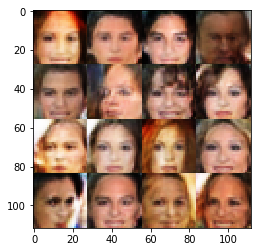

Timestamp 20170806-03-09-05.327 -  Epoch 1/1 -  Step 21210 -  D Loss: 1.2447 - G Loss: 1.1031
Timestamp 20170806-03-09-17.209 -  Epoch 1/1 -  Step 21220 -  D Loss: 1.1370 - G Loss: 1.2070
Timestamp 20170806-03-09-29.097 -  Epoch 1/1 -  Step 21230 -  D Loss: 1.0377 - G Loss: 1.2017
Timestamp 20170806-03-09-40.983 -  Epoch 1/1 -  Step 21240 -  D Loss: 1.5980 - G Loss: 0.7439
Timestamp 20170806-03-09-52.858 -  Epoch 1/1 -  Step 21250 -  D Loss: 1.2265 - G Loss: 0.8695
Timestamp 20170806-03-10-04.756 -  Epoch 1/1 -  Step 21260 -  D Loss: 1.2375 - G Loss: 0.8817
Timestamp 20170806-03-10-16.632 -  Epoch 1/1 -  Step 21270 -  D Loss: 1.0706 - G Loss: 1.3067
Timestamp 20170806-03-10-28.521 -  Epoch 1/1 -  Step 21280 -  D Loss: 1.3786 - G Loss: 0.8354
Timestamp 20170806-03-10-40.409 -  Epoch 1/1 -  Step 21290 -  D Loss: 1.0595 - G Loss: 1.0624
Timestamp 20170806-03-10-52.290 -  Epoch 1/1 -  Step 21300 -  D Loss: 1.0991 - G Loss: 1.0703


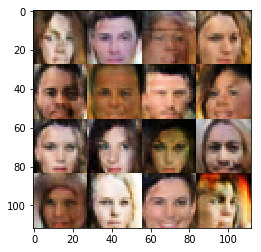

Timestamp 20170806-03-11-05.178 -  Epoch 1/1 -  Step 21310 -  D Loss: 1.4143 - G Loss: 0.8742
Timestamp 20170806-03-11-17.063 -  Epoch 1/1 -  Step 21320 -  D Loss: 1.0450 - G Loss: 0.7995
Timestamp 20170806-03-11-28.941 -  Epoch 1/1 -  Step 21330 -  D Loss: 1.0622 - G Loss: 1.1206
Timestamp 20170806-03-11-40.829 -  Epoch 1/1 -  Step 21340 -  D Loss: 1.2315 - G Loss: 0.8500
Timestamp 20170806-03-11-52.705 -  Epoch 1/1 -  Step 21350 -  D Loss: 1.3225 - G Loss: 0.7946
Timestamp 20170806-03-12-04.597 -  Epoch 1/1 -  Step 21360 -  D Loss: 1.2110 - G Loss: 1.0884
Timestamp 20170806-03-12-16.495 -  Epoch 1/1 -  Step 21370 -  D Loss: 1.2296 - G Loss: 0.7421
Timestamp 20170806-03-12-28.397 -  Epoch 1/1 -  Step 21380 -  D Loss: 1.4057 - G Loss: 0.4928
Timestamp 20170806-03-12-40.281 -  Epoch 1/1 -  Step 21390 -  D Loss: 0.9573 - G Loss: 1.0528
Timestamp 20170806-03-12-52.163 -  Epoch 1/1 -  Step 21400 -  D Loss: 1.5315 - G Loss: 0.7785


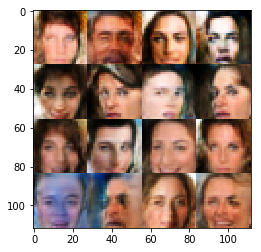

Timestamp 20170806-03-13-05.038 -  Epoch 1/1 -  Step 21410 -  D Loss: 1.2172 - G Loss: 0.9039
Timestamp 20170806-03-13-16.944 -  Epoch 1/1 -  Step 21420 -  D Loss: 1.1082 - G Loss: 0.7453
Timestamp 20170806-03-13-28.831 -  Epoch 1/1 -  Step 21430 -  D Loss: 1.5304 - G Loss: 0.7123
Timestamp 20170806-03-13-40.735 -  Epoch 1/1 -  Step 21440 -  D Loss: 1.4625 - G Loss: 0.8463
Timestamp 20170806-03-13-52.645 -  Epoch 1/1 -  Step 21450 -  D Loss: 1.1369 - G Loss: 1.1360
Timestamp 20170806-03-14-04.529 -  Epoch 1/1 -  Step 21460 -  D Loss: 1.5560 - G Loss: 0.9562
Timestamp 20170806-03-14-16.425 -  Epoch 1/1 -  Step 21470 -  D Loss: 1.3041 - G Loss: 0.8289
Timestamp 20170806-03-14-28.318 -  Epoch 1/1 -  Step 21480 -  D Loss: 1.2780 - G Loss: 0.9514
Timestamp 20170806-03-14-40.213 -  Epoch 1/1 -  Step 21490 -  D Loss: 1.1949 - G Loss: 1.0353
Timestamp 20170806-03-14-52.100 -  Epoch 1/1 -  Step 21500 -  D Loss: 1.4009 - G Loss: 0.8225


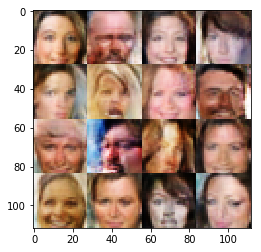

Timestamp 20170806-03-15-04.980 -  Epoch 1/1 -  Step 21510 -  D Loss: 1.1848 - G Loss: 1.2526
Timestamp 20170806-03-15-16.893 -  Epoch 1/1 -  Step 21520 -  D Loss: 0.9673 - G Loss: 1.1647
Timestamp 20170806-03-15-28.789 -  Epoch 1/1 -  Step 21530 -  D Loss: 1.3867 - G Loss: 0.5280
Timestamp 20170806-03-15-40.664 -  Epoch 1/1 -  Step 21540 -  D Loss: 1.2041 - G Loss: 0.9282
Timestamp 20170806-03-15-52.549 -  Epoch 1/1 -  Step 21550 -  D Loss: 1.3349 - G Loss: 0.8533
Timestamp 20170806-03-16-04.431 -  Epoch 1/1 -  Step 21560 -  D Loss: 1.0805 - G Loss: 0.7362
Timestamp 20170806-03-16-16.310 -  Epoch 1/1 -  Step 21570 -  D Loss: 1.0770 - G Loss: 1.2425
Timestamp 20170806-03-16-28.206 -  Epoch 1/1 -  Step 21580 -  D Loss: 1.3265 - G Loss: 0.9857
Timestamp 20170806-03-16-40.095 -  Epoch 1/1 -  Step 21590 -  D Loss: 1.1151 - G Loss: 1.1718
Timestamp 20170806-03-16-51.991 -  Epoch 1/1 -  Step 21600 -  D Loss: 1.2813 - G Loss: 0.8543


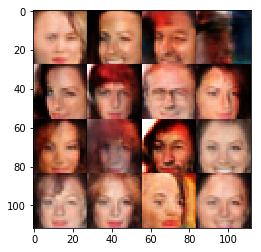

Timestamp 20170806-03-17-04.899 -  Epoch 1/1 -  Step 21610 -  D Loss: 1.4131 - G Loss: 0.9379
Timestamp 20170806-03-17-16.802 -  Epoch 1/1 -  Step 21620 -  D Loss: 1.4270 - G Loss: 0.8591
Timestamp 20170806-03-17-28.666 -  Epoch 1/1 -  Step 21630 -  D Loss: 1.3908 - G Loss: 0.8148
Timestamp 20170806-03-17-40.535 -  Epoch 1/1 -  Step 21640 -  D Loss: 1.1567 - G Loss: 1.2224
Timestamp 20170806-03-17-52.426 -  Epoch 1/1 -  Step 21650 -  D Loss: 1.1267 - G Loss: 1.2683
Timestamp 20170806-03-18-04.303 -  Epoch 1/1 -  Step 21660 -  D Loss: 1.2752 - G Loss: 0.8238
Timestamp 20170806-03-18-16.183 -  Epoch 1/1 -  Step 21670 -  D Loss: 1.4616 - G Loss: 1.1017
Timestamp 20170806-03-18-28.071 -  Epoch 1/1 -  Step 21680 -  D Loss: 0.9961 - G Loss: 0.9480
Timestamp 20170806-03-18-39.965 -  Epoch 1/1 -  Step 21690 -  D Loss: 1.1734 - G Loss: 0.7388
Timestamp 20170806-03-18-51.851 -  Epoch 1/1 -  Step 21700 -  D Loss: 1.4640 - G Loss: 0.8982


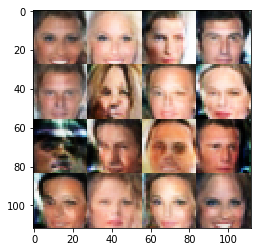

Timestamp 20170806-03-19-04.759 -  Epoch 1/1 -  Step 21710 -  D Loss: 1.4431 - G Loss: 0.7915
Timestamp 20170806-03-19-16.659 -  Epoch 1/1 -  Step 21720 -  D Loss: 1.2693 - G Loss: 1.1534
Timestamp 20170806-03-19-28.559 -  Epoch 1/1 -  Step 21730 -  D Loss: 1.2316 - G Loss: 0.9455
Timestamp 20170806-03-19-40.430 -  Epoch 1/1 -  Step 21740 -  D Loss: 1.2814 - G Loss: 1.1465
Timestamp 20170806-03-19-52.313 -  Epoch 1/1 -  Step 21750 -  D Loss: 1.2130 - G Loss: 0.9363
Timestamp 20170806-03-20-04.195 -  Epoch 1/1 -  Step 21760 -  D Loss: 1.1580 - G Loss: 1.0717
Timestamp 20170806-03-20-16.082 -  Epoch 1/1 -  Step 21770 -  D Loss: 0.9302 - G Loss: 0.8897
Timestamp 20170806-03-20-27.972 -  Epoch 1/1 -  Step 21780 -  D Loss: 1.2192 - G Loss: 0.7435
Timestamp 20170806-03-20-39.860 -  Epoch 1/1 -  Step 21790 -  D Loss: 1.1229 - G Loss: 1.0094
Timestamp 20170806-03-20-51.750 -  Epoch 1/1 -  Step 21800 -  D Loss: 1.0938 - G Loss: 1.2262


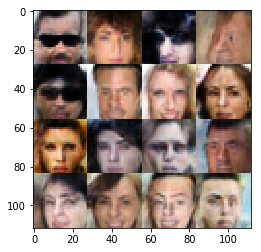

Timestamp 20170806-03-21-04.639 -  Epoch 1/1 -  Step 21810 -  D Loss: 1.2629 - G Loss: 1.3081
Timestamp 20170806-03-21-16.519 -  Epoch 1/1 -  Step 21820 -  D Loss: 1.2552 - G Loss: 0.8206
Timestamp 20170806-03-21-28.423 -  Epoch 1/1 -  Step 21830 -  D Loss: 1.1774 - G Loss: 0.8567
Timestamp 20170806-03-21-40.311 -  Epoch 1/1 -  Step 21840 -  D Loss: 1.2479 - G Loss: 0.7820
Timestamp 20170806-03-21-52.197 -  Epoch 1/1 -  Step 21850 -  D Loss: 1.2203 - G Loss: 1.0735
Timestamp 20170806-03-22-04.095 -  Epoch 1/1 -  Step 21860 -  D Loss: 1.2671 - G Loss: 0.8581
Timestamp 20170806-03-22-15.980 -  Epoch 1/1 -  Step 21870 -  D Loss: 1.1566 - G Loss: 0.9279
Timestamp 20170806-03-22-27.879 -  Epoch 1/1 -  Step 21880 -  D Loss: 1.1600 - G Loss: 1.0769
Timestamp 20170806-03-22-39.777 -  Epoch 1/1 -  Step 21890 -  D Loss: 1.1181 - G Loss: 1.0356
Timestamp 20170806-03-22-51.664 -  Epoch 1/1 -  Step 21900 -  D Loss: 1.0410 - G Loss: 1.1382


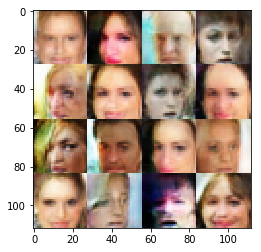

Timestamp 20170806-03-23-04.572 -  Epoch 1/1 -  Step 21910 -  D Loss: 1.0517 - G Loss: 1.1139
Timestamp 20170806-03-23-16.455 -  Epoch 1/1 -  Step 21920 -  D Loss: 1.1574 - G Loss: 0.6698
Timestamp 20170806-03-23-28.361 -  Epoch 1/1 -  Step 21930 -  D Loss: 1.2981 - G Loss: 1.1344
Timestamp 20170806-03-23-40.250 -  Epoch 1/1 -  Step 21940 -  D Loss: 0.9832 - G Loss: 1.2831
Timestamp 20170806-03-23-52.141 -  Epoch 1/1 -  Step 21950 -  D Loss: 1.2461 - G Loss: 1.0102
Timestamp 20170806-03-24-04.038 -  Epoch 1/1 -  Step 21960 -  D Loss: 1.2185 - G Loss: 1.0549
Timestamp 20170806-03-24-15.921 -  Epoch 1/1 -  Step 21970 -  D Loss: 1.1006 - G Loss: 0.8429
Timestamp 20170806-03-24-27.820 -  Epoch 1/1 -  Step 21980 -  D Loss: 1.3341 - G Loss: 0.8291
Timestamp 20170806-03-24-39.706 -  Epoch 1/1 -  Step 21990 -  D Loss: 1.2506 - G Loss: 1.0175
Timestamp 20170806-03-24-51.591 -  Epoch 1/1 -  Step 22000 -  D Loss: 1.2700 - G Loss: 1.1563


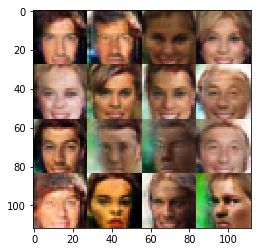

Timestamp 20170806-03-25-04.514 -  Epoch 1/1 -  Step 22010 -  D Loss: 1.6106 - G Loss: 0.9517
Timestamp 20170806-03-25-16.415 -  Epoch 1/1 -  Step 22020 -  D Loss: 1.0637 - G Loss: 1.1415
Timestamp 20170806-03-25-28.309 -  Epoch 1/1 -  Step 22030 -  D Loss: 1.1450 - G Loss: 0.8856
Timestamp 20170806-03-25-40.185 -  Epoch 1/1 -  Step 22040 -  D Loss: 1.2229 - G Loss: 0.8986
Timestamp 20170806-03-25-52.081 -  Epoch 1/1 -  Step 22050 -  D Loss: 1.1374 - G Loss: 0.8005
Timestamp 20170806-03-26-03.963 -  Epoch 1/1 -  Step 22060 -  D Loss: 1.2658 - G Loss: 1.1041
Timestamp 20170806-03-26-15.875 -  Epoch 1/1 -  Step 22070 -  D Loss: 1.2705 - G Loss: 1.1068
Timestamp 20170806-03-26-27.758 -  Epoch 1/1 -  Step 22080 -  D Loss: 1.3135 - G Loss: 0.9064
Timestamp 20170806-03-26-39.662 -  Epoch 1/1 -  Step 22090 -  D Loss: 1.4497 - G Loss: 1.0416
Timestamp 20170806-03-26-51.560 -  Epoch 1/1 -  Step 22100 -  D Loss: 0.8934 - G Loss: 1.0851


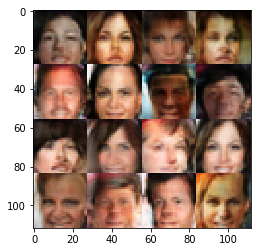

Timestamp 20170806-03-27-04.476 -  Epoch 1/1 -  Step 22110 -  D Loss: 1.3195 - G Loss: 1.1841
Timestamp 20170806-03-27-16.368 -  Epoch 1/1 -  Step 22120 -  D Loss: 1.2781 - G Loss: 1.0437
Timestamp 20170806-03-27-28.258 -  Epoch 1/1 -  Step 22130 -  D Loss: 1.3583 - G Loss: 0.6079
Timestamp 20170806-03-27-40.143 -  Epoch 1/1 -  Step 22140 -  D Loss: 1.1719 - G Loss: 1.0523
Timestamp 20170806-03-27-52.028 -  Epoch 1/1 -  Step 22150 -  D Loss: 1.6150 - G Loss: 1.0403
Timestamp 20170806-03-28-03.895 -  Epoch 1/1 -  Step 22160 -  D Loss: 1.0202 - G Loss: 0.7118
Timestamp 20170806-03-28-15.800 -  Epoch 1/1 -  Step 22170 -  D Loss: 1.1054 - G Loss: 1.2726
Timestamp 20170806-03-28-27.687 -  Epoch 1/1 -  Step 22180 -  D Loss: 1.0925 - G Loss: 1.3778
Timestamp 20170806-03-28-39.574 -  Epoch 1/1 -  Step 22190 -  D Loss: 1.2063 - G Loss: 0.8821
Timestamp 20170806-03-28-51.486 -  Epoch 1/1 -  Step 22200 -  D Loss: 1.2598 - G Loss: 0.9211


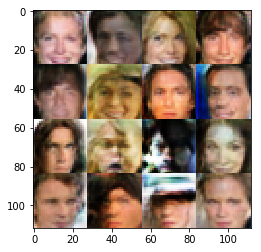

Timestamp 20170806-03-29-04.384 -  Epoch 1/1 -  Step 22210 -  D Loss: 1.1108 - G Loss: 1.2291
Timestamp 20170806-03-29-16.269 -  Epoch 1/1 -  Step 22220 -  D Loss: 1.0367 - G Loss: 0.8767
Timestamp 20170806-03-29-28.150 -  Epoch 1/1 -  Step 22230 -  D Loss: 1.1941 - G Loss: 1.1199
Timestamp 20170806-03-29-40.035 -  Epoch 1/1 -  Step 22240 -  D Loss: 1.1497 - G Loss: 1.1641
Timestamp 20170806-03-29-51.928 -  Epoch 1/1 -  Step 22250 -  D Loss: 1.1908 - G Loss: 0.8289
Timestamp 20170806-03-30-03.825 -  Epoch 1/1 -  Step 22260 -  D Loss: 1.3107 - G Loss: 0.7508
Timestamp 20170806-03-30-15.732 -  Epoch 1/1 -  Step 22270 -  D Loss: 1.1924 - G Loss: 1.1047
Timestamp 20170806-03-30-27.629 -  Epoch 1/1 -  Step 22280 -  D Loss: 1.2279 - G Loss: 1.1156
Timestamp 20170806-03-30-39.533 -  Epoch 1/1 -  Step 22290 -  D Loss: 1.0374 - G Loss: 0.9724
Timestamp 20170806-03-30-51.441 -  Epoch 1/1 -  Step 22300 -  D Loss: 0.9744 - G Loss: 0.6957


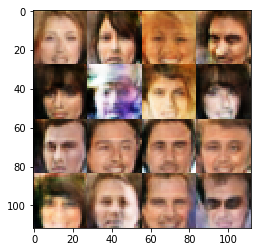

Timestamp 20170806-03-31-04.410 -  Epoch 1/1 -  Step 22310 -  D Loss: 1.0515 - G Loss: 1.4091
Timestamp 20170806-03-31-16.307 -  Epoch 1/1 -  Step 22320 -  D Loss: 1.1929 - G Loss: 0.8828
Timestamp 20170806-03-31-28.184 -  Epoch 1/1 -  Step 22330 -  D Loss: 1.4125 - G Loss: 0.9549
Timestamp 20170806-03-31-40.069 -  Epoch 1/1 -  Step 22340 -  D Loss: 1.3223 - G Loss: 0.6169
Timestamp 20170806-03-31-51.953 -  Epoch 1/1 -  Step 22350 -  D Loss: 1.5001 - G Loss: 1.1051
Timestamp 20170806-03-32-03.915 -  Epoch 1/1 -  Step 22360 -  D Loss: 1.1510 - G Loss: 0.9050
Timestamp 20170806-03-32-15.830 -  Epoch 1/1 -  Step 22370 -  D Loss: 1.4312 - G Loss: 0.7965
Timestamp 20170806-03-32-27.752 -  Epoch 1/1 -  Step 22380 -  D Loss: 1.2441 - G Loss: 0.8006
Timestamp 20170806-03-32-39.705 -  Epoch 1/1 -  Step 22390 -  D Loss: 1.4519 - G Loss: 0.7395
Timestamp 20170806-03-32-51.653 -  Epoch 1/1 -  Step 22400 -  D Loss: 1.4701 - G Loss: 0.9884


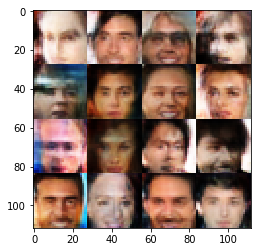

Timestamp 20170806-03-33-04.817 -  Epoch 1/1 -  Step 22410 -  D Loss: 1.2736 - G Loss: 0.9910
Timestamp 20170806-03-33-16.734 -  Epoch 1/1 -  Step 22420 -  D Loss: 0.9455 - G Loss: 1.2060
Timestamp 20170806-03-33-28.658 -  Epoch 1/1 -  Step 22430 -  D Loss: 1.1454 - G Loss: 0.6457
Timestamp 20170806-03-33-40.546 -  Epoch 1/1 -  Step 22440 -  D Loss: 1.0903 - G Loss: 1.2107
Timestamp 20170806-03-33-52.436 -  Epoch 1/1 -  Step 22450 -  D Loss: 1.2237 - G Loss: 1.1194
Timestamp 20170806-03-34-04.321 -  Epoch 1/1 -  Step 22460 -  D Loss: 1.2023 - G Loss: 1.1886
Timestamp 20170806-03-34-16.217 -  Epoch 1/1 -  Step 22470 -  D Loss: 1.1138 - G Loss: 0.9680
Timestamp 20170806-03-34-28.113 -  Epoch 1/1 -  Step 22480 -  D Loss: 1.1936 - G Loss: 1.4181
Timestamp 20170806-03-34-40.002 -  Epoch 1/1 -  Step 22490 -  D Loss: 1.1173 - G Loss: 0.8659
Timestamp 20170806-03-34-51.902 -  Epoch 1/1 -  Step 22500 -  D Loss: 1.2622 - G Loss: 0.6910


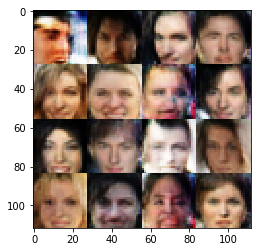

Timestamp 20170806-03-35-05.547 -  Epoch 1/1 -  Step 22510 -  D Loss: 1.1843 - G Loss: 0.8344
Timestamp 20170806-03-35-17.454 -  Epoch 1/1 -  Step 22520 -  D Loss: 1.3592 - G Loss: 0.7847
Timestamp 20170806-03-35-29.370 -  Epoch 1/1 -  Step 22530 -  D Loss: 1.1795 - G Loss: 1.0619
Timestamp 20170806-03-35-41.259 -  Epoch 1/1 -  Step 22540 -  D Loss: 1.5170 - G Loss: 0.6536
Timestamp 20170806-03-35-53.190 -  Epoch 1/1 -  Step 22550 -  D Loss: 1.1561 - G Loss: 1.1934
Timestamp 20170806-03-36-05.096 -  Epoch 1/1 -  Step 22560 -  D Loss: 1.0957 - G Loss: 1.1846
Timestamp 20170806-03-36-17.012 -  Epoch 1/1 -  Step 22570 -  D Loss: 1.0979 - G Loss: 1.3535
Timestamp 20170806-03-36-28.921 -  Epoch 1/1 -  Step 22580 -  D Loss: 1.0105 - G Loss: 0.9158
Timestamp 20170806-03-36-40.801 -  Epoch 1/1 -  Step 22590 -  D Loss: 1.3401 - G Loss: 0.8076
Timestamp 20170806-03-36-52.709 -  Epoch 1/1 -  Step 22600 -  D Loss: 1.1956 - G Loss: 0.8499


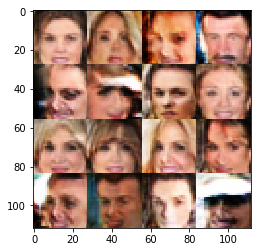

Timestamp 20170806-03-37-05.671 -  Epoch 1/1 -  Step 22610 -  D Loss: 1.4999 - G Loss: 0.6940
Timestamp 20170806-03-37-17.565 -  Epoch 1/1 -  Step 22620 -  D Loss: 0.9932 - G Loss: 1.1075
Timestamp 20170806-03-37-29.487 -  Epoch 1/1 -  Step 22630 -  D Loss: 1.2215 - G Loss: 1.0369
Timestamp 20170806-03-37-41.375 -  Epoch 1/1 -  Step 22640 -  D Loss: 1.1739 - G Loss: 1.0700
Timestamp 20170806-03-37-53.273 -  Epoch 1/1 -  Step 22650 -  D Loss: 0.9634 - G Loss: 0.8915
Timestamp 20170806-03-38-05.159 -  Epoch 1/1 -  Step 22660 -  D Loss: 1.3697 - G Loss: 0.5391
Timestamp 20170806-03-38-17.063 -  Epoch 1/1 -  Step 22670 -  D Loss: 1.0420 - G Loss: 0.9745
Timestamp 20170806-03-38-28.966 -  Epoch 1/1 -  Step 22680 -  D Loss: 1.0001 - G Loss: 1.2354
Timestamp 20170806-03-38-40.882 -  Epoch 1/1 -  Step 22690 -  D Loss: 1.1035 - G Loss: 0.7911
Timestamp 20170806-03-38-52.777 -  Epoch 1/1 -  Step 22700 -  D Loss: 1.1448 - G Loss: 1.2816


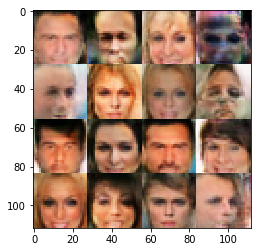

Timestamp 20170806-03-39-05.762 -  Epoch 1/1 -  Step 22710 -  D Loss: 1.2041 - G Loss: 1.0937
Timestamp 20170806-03-39-17.669 -  Epoch 1/1 -  Step 22720 -  D Loss: 1.2374 - G Loss: 0.7732
Timestamp 20170806-03-39-29.598 -  Epoch 1/1 -  Step 22730 -  D Loss: 0.9569 - G Loss: 1.1013
Timestamp 20170806-03-39-41.501 -  Epoch 1/1 -  Step 22740 -  D Loss: 1.0302 - G Loss: 1.1339
Timestamp 20170806-03-39-53.399 -  Epoch 1/1 -  Step 22750 -  D Loss: 1.2714 - G Loss: 0.8920
Timestamp 20170806-03-40-05.290 -  Epoch 1/1 -  Step 22760 -  D Loss: 1.2336 - G Loss: 0.7541
Timestamp 20170806-03-40-17.200 -  Epoch 1/1 -  Step 22770 -  D Loss: 1.0851 - G Loss: 0.7796
Timestamp 20170806-03-40-29.113 -  Epoch 1/1 -  Step 22780 -  D Loss: 1.0051 - G Loss: 1.0210
Timestamp 20170806-03-40-41.014 -  Epoch 1/1 -  Step 22790 -  D Loss: 1.3188 - G Loss: 0.8109
Timestamp 20170806-03-40-52.925 -  Epoch 1/1 -  Step 22800 -  D Loss: 1.1206 - G Loss: 1.2084


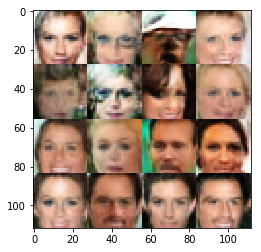

Timestamp 20170806-03-41-05.921 -  Epoch 1/1 -  Step 22810 -  D Loss: 0.9675 - G Loss: 1.2911
Timestamp 20170806-03-41-17.835 -  Epoch 1/1 -  Step 22820 -  D Loss: 1.3054 - G Loss: 0.7693
Timestamp 20170806-03-41-29.749 -  Epoch 1/1 -  Step 22830 -  D Loss: 1.2285 - G Loss: 0.7867
Timestamp 20170806-03-41-41.645 -  Epoch 1/1 -  Step 22840 -  D Loss: 1.3177 - G Loss: 0.9617
Timestamp 20170806-03-41-53.539 -  Epoch 1/1 -  Step 22850 -  D Loss: 1.0929 - G Loss: 0.9362
Timestamp 20170806-03-42-05.453 -  Epoch 1/1 -  Step 22860 -  D Loss: 1.2324 - G Loss: 1.0723
Timestamp 20170806-03-42-17.354 -  Epoch 1/1 -  Step 22870 -  D Loss: 1.2763 - G Loss: 0.8038
Timestamp 20170806-03-42-29.250 -  Epoch 1/1 -  Step 22880 -  D Loss: 1.3025 - G Loss: 0.9224
Timestamp 20170806-03-42-41.173 -  Epoch 1/1 -  Step 22890 -  D Loss: 1.4366 - G Loss: 1.1846
Timestamp 20170806-03-42-53.081 -  Epoch 1/1 -  Step 22900 -  D Loss: 1.5695 - G Loss: 0.9060


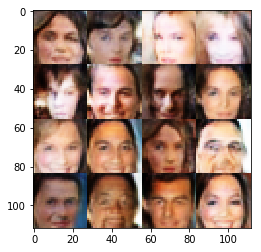

Timestamp 20170806-03-43-06.084 -  Epoch 1/1 -  Step 22910 -  D Loss: 1.1071 - G Loss: 0.9588
Timestamp 20170806-03-43-17.984 -  Epoch 1/1 -  Step 22920 -  D Loss: 1.1751 - G Loss: 0.8497
Timestamp 20170806-03-43-29.895 -  Epoch 1/1 -  Step 22930 -  D Loss: 1.6659 - G Loss: 0.6822
Timestamp 20170806-03-43-41.807 -  Epoch 1/1 -  Step 22940 -  D Loss: 1.4365 - G Loss: 0.7580
Timestamp 20170806-03-43-53.705 -  Epoch 1/1 -  Step 22950 -  D Loss: 1.6872 - G Loss: 0.9897
Timestamp 20170806-03-44-05.603 -  Epoch 1/1 -  Step 22960 -  D Loss: 1.1334 - G Loss: 0.6951
Timestamp 20170806-03-44-17.492 -  Epoch 1/1 -  Step 22970 -  D Loss: 1.2654 - G Loss: 0.8027
Timestamp 20170806-03-44-29.388 -  Epoch 1/1 -  Step 22980 -  D Loss: 1.3330 - G Loss: 0.8117
Timestamp 20170806-03-44-41.261 -  Epoch 1/1 -  Step 22990 -  D Loss: 1.3926 - G Loss: 0.6917
Timestamp 20170806-03-44-53.171 -  Epoch 1/1 -  Step 23000 -  D Loss: 1.3205 - G Loss: 0.5834


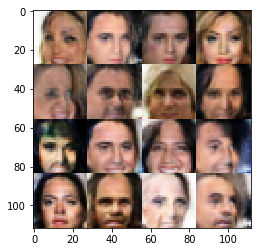

Timestamp 20170806-03-45-06.155 -  Epoch 1/1 -  Step 23010 -  D Loss: 1.5143 - G Loss: 0.7410
Timestamp 20170806-03-45-18.042 -  Epoch 1/1 -  Step 23020 -  D Loss: 1.3117 - G Loss: 1.1562
Timestamp 20170806-03-45-29.938 -  Epoch 1/1 -  Step 23030 -  D Loss: 1.1760 - G Loss: 0.9308
Timestamp 20170806-03-45-41.830 -  Epoch 1/1 -  Step 23040 -  D Loss: 1.1892 - G Loss: 1.1590
Timestamp 20170806-03-45-53.723 -  Epoch 1/1 -  Step 23050 -  D Loss: 1.1333 - G Loss: 1.2873
Timestamp 20170806-03-46-05.621 -  Epoch 1/1 -  Step 23060 -  D Loss: 1.6401 - G Loss: 1.1174
Timestamp 20170806-03-46-17.513 -  Epoch 1/1 -  Step 23070 -  D Loss: 1.0792 - G Loss: 1.0707
Timestamp 20170806-03-46-29.401 -  Epoch 1/1 -  Step 23080 -  D Loss: 1.1398 - G Loss: 0.8482
Timestamp 20170806-03-46-41.303 -  Epoch 1/1 -  Step 23090 -  D Loss: 1.1096 - G Loss: 1.1693
Timestamp 20170806-03-46-53.206 -  Epoch 1/1 -  Step 23100 -  D Loss: 1.2006 - G Loss: 0.9562


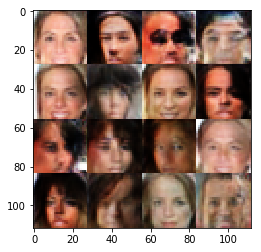

Timestamp 20170806-03-47-06.199 -  Epoch 1/1 -  Step 23110 -  D Loss: 1.1392 - G Loss: 1.1397
Timestamp 20170806-03-47-18.098 -  Epoch 1/1 -  Step 23120 -  D Loss: 1.4113 - G Loss: 0.7076
Timestamp 20170806-03-47-30.000 -  Epoch 1/1 -  Step 23130 -  D Loss: 1.4582 - G Loss: 0.7176
Timestamp 20170806-03-47-41.897 -  Epoch 1/1 -  Step 23140 -  D Loss: 1.2387 - G Loss: 1.0583
Timestamp 20170806-03-47-53.801 -  Epoch 1/1 -  Step 23150 -  D Loss: 0.9192 - G Loss: 1.1186
Timestamp 20170806-03-48-05.700 -  Epoch 1/1 -  Step 23160 -  D Loss: 1.2452 - G Loss: 0.6882
Timestamp 20170806-03-48-17.600 -  Epoch 1/1 -  Step 23170 -  D Loss: 1.1444 - G Loss: 1.3124
Timestamp 20170806-03-48-29.503 -  Epoch 1/1 -  Step 23180 -  D Loss: 1.3536 - G Loss: 1.0001
Timestamp 20170806-03-48-41.411 -  Epoch 1/1 -  Step 23190 -  D Loss: 1.2406 - G Loss: 0.8788
Timestamp 20170806-03-48-53.309 -  Epoch 1/1 -  Step 23200 -  D Loss: 1.1933 - G Loss: 0.7748


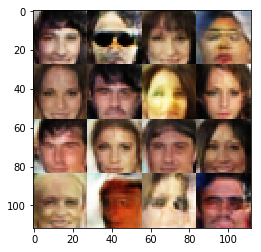

Timestamp 20170806-03-49-06.288 -  Epoch 1/1 -  Step 23210 -  D Loss: 1.1407 - G Loss: 0.9915
Timestamp 20170806-03-49-18.194 -  Epoch 1/1 -  Step 23220 -  D Loss: 1.4242 - G Loss: 0.7787
Timestamp 20170806-03-49-30.075 -  Epoch 1/1 -  Step 23230 -  D Loss: 1.0720 - G Loss: 0.6981
Timestamp 20170806-03-49-41.951 -  Epoch 1/1 -  Step 23240 -  D Loss: 1.5280 - G Loss: 0.7884
Timestamp 20170806-03-49-53.843 -  Epoch 1/1 -  Step 23250 -  D Loss: 1.3225 - G Loss: 0.8292
Timestamp 20170806-03-50-05.752 -  Epoch 1/1 -  Step 23260 -  D Loss: 1.3943 - G Loss: 1.0670
Timestamp 20170806-03-50-17.651 -  Epoch 1/1 -  Step 23270 -  D Loss: 1.4158 - G Loss: 0.7344
Timestamp 20170806-03-50-29.556 -  Epoch 1/1 -  Step 23280 -  D Loss: 1.6555 - G Loss: 0.8790
Timestamp 20170806-03-50-41.458 -  Epoch 1/1 -  Step 23290 -  D Loss: 1.2504 - G Loss: 0.9823
Timestamp 20170806-03-50-53.362 -  Epoch 1/1 -  Step 23300 -  D Loss: 1.0074 - G Loss: 1.2950


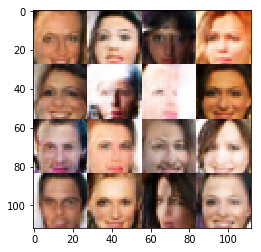

Timestamp 20170806-03-51-06.295 -  Epoch 1/1 -  Step 23310 -  D Loss: 1.2175 - G Loss: 0.7397
Timestamp 20170806-03-51-18.190 -  Epoch 1/1 -  Step 23320 -  D Loss: 1.1344 - G Loss: 0.7261
Timestamp 20170806-03-51-30.097 -  Epoch 1/1 -  Step 23330 -  D Loss: 1.1616 - G Loss: 0.9744
Timestamp 20170806-03-51-41.995 -  Epoch 1/1 -  Step 23340 -  D Loss: 1.3619 - G Loss: 0.6830
Timestamp 20170806-03-51-53.882 -  Epoch 1/1 -  Step 23350 -  D Loss: 1.3994 - G Loss: 0.8043
Timestamp 20170806-03-52-05.790 -  Epoch 1/1 -  Step 23360 -  D Loss: 1.3204 - G Loss: 1.1205
Timestamp 20170806-03-52-17.702 -  Epoch 1/1 -  Step 23370 -  D Loss: 1.3750 - G Loss: 0.9425
Timestamp 20170806-03-52-29.606 -  Epoch 1/1 -  Step 23380 -  D Loss: 1.3024 - G Loss: 0.8479
Timestamp 20170806-03-52-41.511 -  Epoch 1/1 -  Step 23390 -  D Loss: 1.1244 - G Loss: 1.1811
Timestamp 20170806-03-52-53.420 -  Epoch 1/1 -  Step 23400 -  D Loss: 0.8984 - G Loss: 1.0427


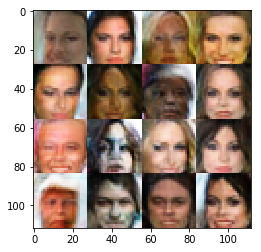

Timestamp 20170806-03-53-06.416 -  Epoch 1/1 -  Step 23410 -  D Loss: 1.3082 - G Loss: 0.9743
Timestamp 20170806-03-53-18.337 -  Epoch 1/1 -  Step 23420 -  D Loss: 1.2462 - G Loss: 1.0725
Timestamp 20170806-03-53-30.263 -  Epoch 1/1 -  Step 23430 -  D Loss: 1.2951 - G Loss: 0.8722
Timestamp 20170806-03-53-42.156 -  Epoch 1/1 -  Step 23440 -  D Loss: 0.9778 - G Loss: 0.7514
Timestamp 20170806-03-53-54.062 -  Epoch 1/1 -  Step 23450 -  D Loss: 1.1669 - G Loss: 0.8191
Timestamp 20170806-03-54-05.953 -  Epoch 1/1 -  Step 23460 -  D Loss: 1.3269 - G Loss: 0.9787
Timestamp 20170806-03-54-17.850 -  Epoch 1/1 -  Step 23470 -  D Loss: 1.2103 - G Loss: 1.0379
Timestamp 20170806-03-54-29.769 -  Epoch 1/1 -  Step 23480 -  D Loss: 1.4084 - G Loss: 0.8127
Timestamp 20170806-03-54-41.702 -  Epoch 1/1 -  Step 23490 -  D Loss: 1.5055 - G Loss: 0.8505
Timestamp 20170806-03-54-53.615 -  Epoch 1/1 -  Step 23500 -  D Loss: 1.0484 - G Loss: 0.9112


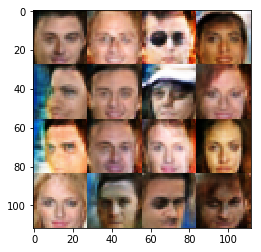

Timestamp 20170806-03-55-06.654 -  Epoch 1/1 -  Step 23510 -  D Loss: 1.1790 - G Loss: 0.7678
Timestamp 20170806-03-55-18.577 -  Epoch 1/1 -  Step 23520 -  D Loss: 1.8112 - G Loss: 0.9033
Timestamp 20170806-03-55-30.514 -  Epoch 1/1 -  Step 23530 -  D Loss: 1.1004 - G Loss: 1.0770
Timestamp 20170806-03-55-42.441 -  Epoch 1/1 -  Step 23540 -  D Loss: 1.2536 - G Loss: 1.0438
Timestamp 20170806-03-55-54.356 -  Epoch 1/1 -  Step 23550 -  D Loss: 1.1395 - G Loss: 1.1187
Timestamp 20170806-03-56-06.265 -  Epoch 1/1 -  Step 23560 -  D Loss: 1.1025 - G Loss: 1.0484
Timestamp 20170806-03-56-18.185 -  Epoch 1/1 -  Step 23570 -  D Loss: 1.1457 - G Loss: 1.0935
Timestamp 20170806-03-56-30.090 -  Epoch 1/1 -  Step 23580 -  D Loss: 1.6602 - G Loss: 1.0809
Timestamp 20170806-03-56-41.998 -  Epoch 1/1 -  Step 23590 -  D Loss: 1.0268 - G Loss: 1.3953
Timestamp 20170806-03-56-53.901 -  Epoch 1/1 -  Step 23600 -  D Loss: 1.4822 - G Loss: 0.8429


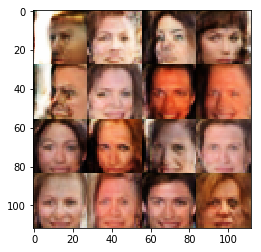

Timestamp 20170806-03-57-06.848 -  Epoch 1/1 -  Step 23610 -  D Loss: 0.9734 - G Loss: 1.0954
Timestamp 20170806-03-57-18.777 -  Epoch 1/1 -  Step 23620 -  D Loss: 1.0061 - G Loss: 0.8906
Timestamp 20170806-03-57-30.698 -  Epoch 1/1 -  Step 23630 -  D Loss: 1.0287 - G Loss: 0.9917
Timestamp 20170806-03-57-42.590 -  Epoch 1/1 -  Step 23640 -  D Loss: 1.2362 - G Loss: 1.1229
Timestamp 20170806-03-57-54.499 -  Epoch 1/1 -  Step 23650 -  D Loss: 1.0078 - G Loss: 1.0753
Timestamp 20170806-03-58-06.406 -  Epoch 1/1 -  Step 23660 -  D Loss: 1.0481 - G Loss: 1.2707
Timestamp 20170806-03-58-18.319 -  Epoch 1/1 -  Step 23670 -  D Loss: 1.1743 - G Loss: 1.0206
Timestamp 20170806-03-58-30.212 -  Epoch 1/1 -  Step 23680 -  D Loss: 1.2342 - G Loss: 0.6814
Timestamp 20170806-03-58-42.129 -  Epoch 1/1 -  Step 23690 -  D Loss: 1.3107 - G Loss: 0.8161
Timestamp 20170806-03-58-54.047 -  Epoch 1/1 -  Step 23700 -  D Loss: 1.1683 - G Loss: 1.0019


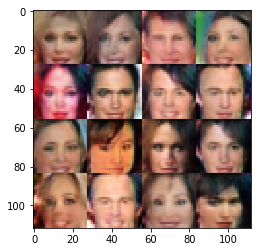

Timestamp 20170806-03-59-06.975 -  Epoch 1/1 -  Step 23710 -  D Loss: 1.4298 - G Loss: 0.6670
Timestamp 20170806-03-59-18.890 -  Epoch 1/1 -  Step 23720 -  D Loss: 1.1342 - G Loss: 1.2405
Timestamp 20170806-03-59-30.806 -  Epoch 1/1 -  Step 23730 -  D Loss: 1.2537 - G Loss: 0.6572
Timestamp 20170806-03-59-42.723 -  Epoch 1/1 -  Step 23740 -  D Loss: 1.3082 - G Loss: 1.1150
Timestamp 20170806-03-59-54.637 -  Epoch 1/1 -  Step 23750 -  D Loss: 1.3445 - G Loss: 0.7977
Timestamp 20170806-04-00-06.544 -  Epoch 1/1 -  Step 23760 -  D Loss: 1.2609 - G Loss: 1.2471
Timestamp 20170806-04-00-18.449 -  Epoch 1/1 -  Step 23770 -  D Loss: 1.1921 - G Loss: 0.7802
Timestamp 20170806-04-00-30.348 -  Epoch 1/1 -  Step 23780 -  D Loss: 1.5556 - G Loss: 0.8506
Timestamp 20170806-04-00-42.250 -  Epoch 1/1 -  Step 23790 -  D Loss: 1.2727 - G Loss: 1.1169
Timestamp 20170806-04-00-54.160 -  Epoch 1/1 -  Step 23800 -  D Loss: 1.3452 - G Loss: 0.7167


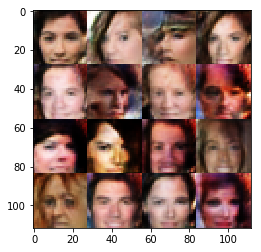

Timestamp 20170806-04-01-07.106 -  Epoch 1/1 -  Step 23810 -  D Loss: 1.2440 - G Loss: 0.8259
Timestamp 20170806-04-01-19.015 -  Epoch 1/1 -  Step 23820 -  D Loss: 1.6850 - G Loss: 0.7988
Timestamp 20170806-04-01-30.931 -  Epoch 1/1 -  Step 23830 -  D Loss: 1.2376 - G Loss: 1.3736
Timestamp 20170806-04-01-42.840 -  Epoch 1/1 -  Step 23840 -  D Loss: 1.3692 - G Loss: 0.9286
Timestamp 20170806-04-01-54.741 -  Epoch 1/1 -  Step 23850 -  D Loss: 1.2954 - G Loss: 0.9967
Timestamp 20170806-04-02-06.655 -  Epoch 1/1 -  Step 23860 -  D Loss: 1.3097 - G Loss: 0.8334
Timestamp 20170806-04-02-18.568 -  Epoch 1/1 -  Step 23870 -  D Loss: 1.0305 - G Loss: 0.9454
Timestamp 20170806-04-02-30.489 -  Epoch 1/1 -  Step 23880 -  D Loss: 0.9273 - G Loss: 0.9968
Timestamp 20170806-04-02-42.398 -  Epoch 1/1 -  Step 23890 -  D Loss: 1.1567 - G Loss: 0.8355
Timestamp 20170806-04-02-54.298 -  Epoch 1/1 -  Step 23900 -  D Loss: 1.0520 - G Loss: 1.0428


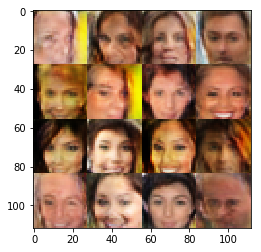

Timestamp 20170806-04-03-07.250 -  Epoch 1/1 -  Step 23910 -  D Loss: 1.4075 - G Loss: 0.7116
Timestamp 20170806-04-03-19.163 -  Epoch 1/1 -  Step 23920 -  D Loss: 1.2264 - G Loss: 0.9440
Timestamp 20170806-04-03-31.070 -  Epoch 1/1 -  Step 23930 -  D Loss: 1.2661 - G Loss: 0.6386
Timestamp 20170806-04-03-42.973 -  Epoch 1/1 -  Step 23940 -  D Loss: 1.3197 - G Loss: 0.9011
Timestamp 20170806-04-03-54.879 -  Epoch 1/1 -  Step 23950 -  D Loss: 1.1139 - G Loss: 1.1045
Timestamp 20170806-04-04-06.779 -  Epoch 1/1 -  Step 23960 -  D Loss: 1.4681 - G Loss: 0.7374
Timestamp 20170806-04-04-18.680 -  Epoch 1/1 -  Step 23970 -  D Loss: 1.2529 - G Loss: 0.9435
Timestamp 20170806-04-04-30.571 -  Epoch 1/1 -  Step 23980 -  D Loss: 0.9625 - G Loss: 1.1162
Timestamp 20170806-04-04-42.485 -  Epoch 1/1 -  Step 23990 -  D Loss: 1.0783 - G Loss: 1.3437
Timestamp 20170806-04-04-54.387 -  Epoch 1/1 -  Step 24000 -  D Loss: 1.4378 - G Loss: 1.1819


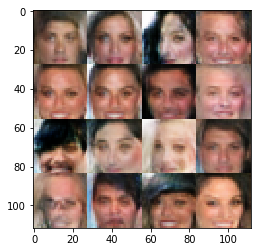

Timestamp 20170806-04-05-07.374 -  Epoch 1/1 -  Step 24010 -  D Loss: 1.2317 - G Loss: 0.8343
Timestamp 20170806-04-05-19.305 -  Epoch 1/1 -  Step 24020 -  D Loss: 1.1612 - G Loss: 0.9552
Timestamp 20170806-04-05-31.204 -  Epoch 1/1 -  Step 24030 -  D Loss: 1.4562 - G Loss: 0.8598
Timestamp 20170806-04-05-43.122 -  Epoch 1/1 -  Step 24040 -  D Loss: 1.1600 - G Loss: 0.9414
Timestamp 20170806-04-05-55.040 -  Epoch 1/1 -  Step 24050 -  D Loss: 1.1167 - G Loss: 0.7895
Timestamp 20170806-04-06-06.931 -  Epoch 1/1 -  Step 24060 -  D Loss: 1.1579 - G Loss: 0.9315
Timestamp 20170806-04-06-18.831 -  Epoch 1/1 -  Step 24070 -  D Loss: 1.5592 - G Loss: 0.7309
Timestamp 20170806-04-06-30.739 -  Epoch 1/1 -  Step 24080 -  D Loss: 1.3980 - G Loss: 0.6470
Timestamp 20170806-04-06-42.655 -  Epoch 1/1 -  Step 24090 -  D Loss: 1.5189 - G Loss: 0.5835
Timestamp 20170806-04-06-54.571 -  Epoch 1/1 -  Step 24100 -  D Loss: 1.0462 - G Loss: 1.0674


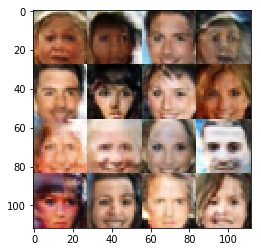

Timestamp 20170806-04-07-07.539 -  Epoch 1/1 -  Step 24110 -  D Loss: 1.2448 - G Loss: 0.9289
Timestamp 20170806-04-07-19.460 -  Epoch 1/1 -  Step 24120 -  D Loss: 1.5083 - G Loss: 0.6869
Timestamp 20170806-04-07-31.377 -  Epoch 1/1 -  Step 24130 -  D Loss: 1.3895 - G Loss: 1.0109
Timestamp 20170806-04-07-43.273 -  Epoch 1/1 -  Step 24140 -  D Loss: 1.3698 - G Loss: 0.9354
Timestamp 20170806-04-07-55.190 -  Epoch 1/1 -  Step 24150 -  D Loss: 1.2720 - G Loss: 0.9288
Timestamp 20170806-04-08-07.091 -  Epoch 1/1 -  Step 24160 -  D Loss: 1.0961 - G Loss: 0.8117
Timestamp 20170806-04-08-19.010 -  Epoch 1/1 -  Step 24170 -  D Loss: 1.3042 - G Loss: 0.9183
Timestamp 20170806-04-08-30.914 -  Epoch 1/1 -  Step 24180 -  D Loss: 1.0294 - G Loss: 0.9718
Timestamp 20170806-04-08-42.815 -  Epoch 1/1 -  Step 24190 -  D Loss: 1.3643 - G Loss: 0.7545
Timestamp 20170806-04-08-54.724 -  Epoch 1/1 -  Step 24200 -  D Loss: 1.2687 - G Loss: 1.2307


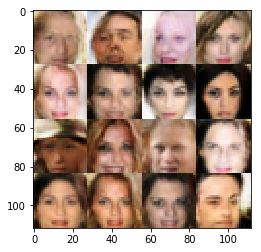

Timestamp 20170806-04-09-07.712 -  Epoch 1/1 -  Step 24210 -  D Loss: 1.1731 - G Loss: 0.7721
Timestamp 20170806-04-09-19.604 -  Epoch 1/1 -  Step 24220 -  D Loss: 1.3670 - G Loss: 0.6751
Timestamp 20170806-04-09-31.514 -  Epoch 1/1 -  Step 24230 -  D Loss: 1.5265 - G Loss: 0.5108
Timestamp 20170806-04-09-43.415 -  Epoch 1/1 -  Step 24240 -  D Loss: 1.5497 - G Loss: 0.6987
Timestamp 20170806-04-09-55.336 -  Epoch 1/1 -  Step 24250 -  D Loss: 1.1070 - G Loss: 1.3769
Timestamp 20170806-04-10-07.237 -  Epoch 1/1 -  Step 24260 -  D Loss: 1.5138 - G Loss: 0.8534
Timestamp 20170806-04-10-19.128 -  Epoch 1/1 -  Step 24270 -  D Loss: 1.2700 - G Loss: 0.7083
Timestamp 20170806-04-10-31.059 -  Epoch 1/1 -  Step 24280 -  D Loss: 1.1694 - G Loss: 1.0449
Timestamp 20170806-04-10-42.969 -  Epoch 1/1 -  Step 24290 -  D Loss: 1.3283 - G Loss: 0.6549
Timestamp 20170806-04-10-54.868 -  Epoch 1/1 -  Step 24300 -  D Loss: 1.3337 - G Loss: 1.3000


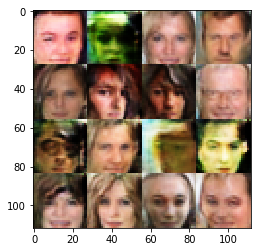

Timestamp 20170806-04-11-08.181 -  Epoch 1/1 -  Step 24310 -  D Loss: 1.1410 - G Loss: 0.6745
Timestamp 20170806-04-11-20.093 -  Epoch 1/1 -  Step 24320 -  D Loss: 1.3293 - G Loss: 1.3822
Timestamp 20170806-04-11-32.012 -  Epoch 1/1 -  Step 24330 -  D Loss: 1.3715 - G Loss: 0.9360
Timestamp 20170806-04-11-43.933 -  Epoch 1/1 -  Step 24340 -  D Loss: 1.1743 - G Loss: 0.7692
Timestamp 20170806-04-11-55.844 -  Epoch 1/1 -  Step 24350 -  D Loss: 1.2363 - G Loss: 0.9926
Timestamp 20170806-04-12-07.745 -  Epoch 1/1 -  Step 24360 -  D Loss: 0.9749 - G Loss: 0.9047
Timestamp 20170806-04-12-19.661 -  Epoch 1/1 -  Step 24370 -  D Loss: 1.2871 - G Loss: 0.8411
Timestamp 20170806-04-12-31.572 -  Epoch 1/1 -  Step 24380 -  D Loss: 1.1255 - G Loss: 1.0325
Timestamp 20170806-04-12-43.492 -  Epoch 1/1 -  Step 24390 -  D Loss: 1.1467 - G Loss: 0.8577
Timestamp 20170806-04-12-55.390 -  Epoch 1/1 -  Step 24400 -  D Loss: 1.1238 - G Loss: 0.8770


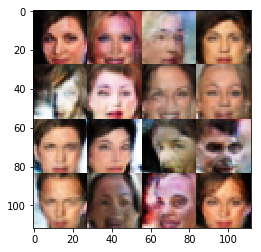

Timestamp 20170806-04-13-08.333 -  Epoch 1/1 -  Step 24410 -  D Loss: 1.4726 - G Loss: 0.6312
Timestamp 20170806-04-13-20.246 -  Epoch 1/1 -  Step 24420 -  D Loss: 1.2068 - G Loss: 0.5281
Timestamp 20170806-04-13-32.159 -  Epoch 1/1 -  Step 24430 -  D Loss: 1.4141 - G Loss: 0.7654
Timestamp 20170806-04-13-44.068 -  Epoch 1/1 -  Step 24440 -  D Loss: 1.2782 - G Loss: 0.8502
Timestamp 20170806-04-13-55.969 -  Epoch 1/1 -  Step 24450 -  D Loss: 1.1388 - G Loss: 0.7944
Timestamp 20170806-04-14-07.878 -  Epoch 1/1 -  Step 24460 -  D Loss: 1.0794 - G Loss: 0.8369
Timestamp 20170806-04-14-19.803 -  Epoch 1/1 -  Step 24470 -  D Loss: 1.2659 - G Loss: 1.2194
Timestamp 20170806-04-14-31.710 -  Epoch 1/1 -  Step 24480 -  D Loss: 1.6220 - G Loss: 0.7886
Timestamp 20170806-04-14-43.629 -  Epoch 1/1 -  Step 24490 -  D Loss: 1.2114 - G Loss: 0.8633
Timestamp 20170806-04-14-55.540 -  Epoch 1/1 -  Step 24500 -  D Loss: 1.2915 - G Loss: 0.9734


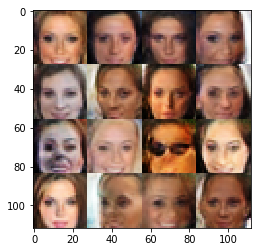

Timestamp 20170806-04-15-08.526 -  Epoch 1/1 -  Step 24510 -  D Loss: 1.2929 - G Loss: 0.7253
Timestamp 20170806-04-15-20.418 -  Epoch 1/1 -  Step 24520 -  D Loss: 1.1665 - G Loss: 0.8178
Timestamp 20170806-04-15-32.376 -  Epoch 1/1 -  Step 24530 -  D Loss: 1.1425 - G Loss: 0.7912
Timestamp 20170806-04-15-44.290 -  Epoch 1/1 -  Step 24540 -  D Loss: 1.0994 - G Loss: 0.8822
Timestamp 20170806-04-15-56.189 -  Epoch 1/1 -  Step 24550 -  D Loss: 1.4043 - G Loss: 0.7518
Timestamp 20170806-04-16-08.099 -  Epoch 1/1 -  Step 24560 -  D Loss: 1.1900 - G Loss: 1.1725
Timestamp 20170806-04-16-19.990 -  Epoch 1/1 -  Step 24570 -  D Loss: 1.1077 - G Loss: 0.8386
Timestamp 20170806-04-16-31.907 -  Epoch 1/1 -  Step 24580 -  D Loss: 1.1992 - G Loss: 0.9700
Timestamp 20170806-04-16-43.810 -  Epoch 1/1 -  Step 24590 -  D Loss: 1.2282 - G Loss: 0.8091
Timestamp 20170806-04-16-55.718 -  Epoch 1/1 -  Step 24600 -  D Loss: 1.0969 - G Loss: 0.8302


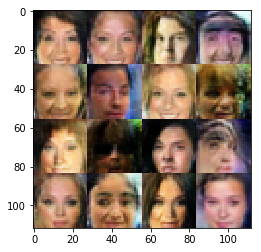

Timestamp 20170806-04-17-08.632 -  Epoch 1/1 -  Step 24610 -  D Loss: 1.0128 - G Loss: 1.2029
Timestamp 20170806-04-17-20.541 -  Epoch 1/1 -  Step 24620 -  D Loss: 0.9132 - G Loss: 0.9167
Timestamp 20170806-04-17-32.442 -  Epoch 1/1 -  Step 24630 -  D Loss: 1.0633 - G Loss: 1.3451
Timestamp 20170806-04-17-44.370 -  Epoch 1/1 -  Step 24640 -  D Loss: 1.4843 - G Loss: 0.8333
Timestamp 20170806-04-17-56.300 -  Epoch 1/1 -  Step 24650 -  D Loss: 1.0936 - G Loss: 0.7901
Timestamp 20170806-04-18-08.210 -  Epoch 1/1 -  Step 24660 -  D Loss: 1.3505 - G Loss: 0.9576
Timestamp 20170806-04-18-20.119 -  Epoch 1/1 -  Step 24670 -  D Loss: 1.1848 - G Loss: 1.3898
Timestamp 20170806-04-18-32.025 -  Epoch 1/1 -  Step 24680 -  D Loss: 1.1632 - G Loss: 0.6957
Timestamp 20170806-04-18-43.931 -  Epoch 1/1 -  Step 24690 -  D Loss: 1.0472 - G Loss: 0.9276
Timestamp 20170806-04-18-55.843 -  Epoch 1/1 -  Step 24700 -  D Loss: 1.3542 - G Loss: 1.2713


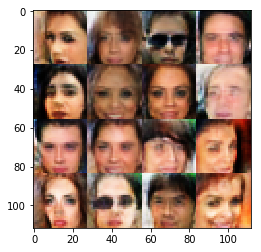

Timestamp 20170806-04-19-08.839 -  Epoch 1/1 -  Step 24710 -  D Loss: 1.4465 - G Loss: 0.9552
Timestamp 20170806-04-19-20.738 -  Epoch 1/1 -  Step 24720 -  D Loss: 0.8727 - G Loss: 1.2313
Timestamp 20170806-04-19-32.649 -  Epoch 1/1 -  Step 24730 -  D Loss: 1.3297 - G Loss: 0.5683
Timestamp 20170806-04-19-44.561 -  Epoch 1/1 -  Step 24740 -  D Loss: 1.3051 - G Loss: 0.9163
Timestamp 20170806-04-19-56.480 -  Epoch 1/1 -  Step 24750 -  D Loss: 1.3407 - G Loss: 0.8205
Timestamp 20170806-04-20-08.399 -  Epoch 1/1 -  Step 24760 -  D Loss: 1.3921 - G Loss: 1.0425
Timestamp 20170806-04-20-20.323 -  Epoch 1/1 -  Step 24770 -  D Loss: 1.1070 - G Loss: 0.9834
Timestamp 20170806-04-20-32.225 -  Epoch 1/1 -  Step 24780 -  D Loss: 0.9967 - G Loss: 0.8586
Timestamp 20170806-04-20-44.146 -  Epoch 1/1 -  Step 24790 -  D Loss: 1.1567 - G Loss: 1.2979
Timestamp 20170806-04-20-56.049 -  Epoch 1/1 -  Step 24800 -  D Loss: 1.1216 - G Loss: 0.7940


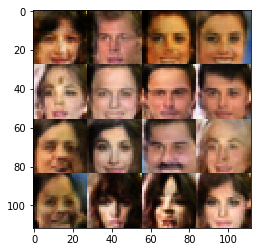

Timestamp 20170806-04-21-09.055 -  Epoch 1/1 -  Step 24810 -  D Loss: 1.3185 - G Loss: 1.0291
Timestamp 20170806-04-21-20.971 -  Epoch 1/1 -  Step 24820 -  D Loss: 1.2327 - G Loss: 1.1012
Timestamp 20170806-04-21-32.892 -  Epoch 1/1 -  Step 24830 -  D Loss: 0.9073 - G Loss: 1.0123
Timestamp 20170806-04-21-44.816 -  Epoch 1/1 -  Step 24840 -  D Loss: 1.3272 - G Loss: 0.6585
Timestamp 20170806-04-21-56.719 -  Epoch 1/1 -  Step 24850 -  D Loss: 1.3861 - G Loss: 0.8604
Timestamp 20170806-04-22-08.626 -  Epoch 1/1 -  Step 24860 -  D Loss: 1.0506 - G Loss: 1.2561
Timestamp 20170806-04-22-20.536 -  Epoch 1/1 -  Step 24870 -  D Loss: 1.5001 - G Loss: 0.8783
Timestamp 20170806-04-22-32.452 -  Epoch 1/1 -  Step 24880 -  D Loss: 1.3343 - G Loss: 0.9051
Timestamp 20170806-04-22-44.360 -  Epoch 1/1 -  Step 24890 -  D Loss: 1.0835 - G Loss: 1.1434
Timestamp 20170806-04-22-56.270 -  Epoch 1/1 -  Step 24900 -  D Loss: 1.3376 - G Loss: 0.8322


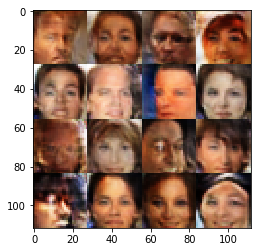

Timestamp 20170806-04-23-09.218 -  Epoch 1/1 -  Step 24910 -  D Loss: 1.1499 - G Loss: 1.0403
Timestamp 20170806-04-23-21.125 -  Epoch 1/1 -  Step 24920 -  D Loss: 1.3231 - G Loss: 1.0624
Timestamp 20170806-04-23-33.033 -  Epoch 1/1 -  Step 24930 -  D Loss: 1.2275 - G Loss: 1.2313
Timestamp 20170806-04-23-44.927 -  Epoch 1/1 -  Step 24940 -  D Loss: 1.3055 - G Loss: 0.6336
Timestamp 20170806-04-23-56.841 -  Epoch 1/1 -  Step 24950 -  D Loss: 0.9092 - G Loss: 1.2455
Timestamp 20170806-04-24-08.747 -  Epoch 1/1 -  Step 24960 -  D Loss: 1.1568 - G Loss: 1.0038
Timestamp 20170806-04-24-20.660 -  Epoch 1/1 -  Step 24970 -  D Loss: 1.2427 - G Loss: 1.0272
Timestamp 20170806-04-24-32.565 -  Epoch 1/1 -  Step 24980 -  D Loss: 1.0414 - G Loss: 0.8181
Timestamp 20170806-04-24-44.466 -  Epoch 1/1 -  Step 24990 -  D Loss: 1.1313 - G Loss: 1.1210
Timestamp 20170806-04-24-56.368 -  Epoch 1/1 -  Step 25000 -  D Loss: 1.0611 - G Loss: 0.9702


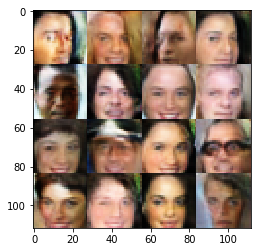

Timestamp 20170806-04-25-09.369 -  Epoch 1/1 -  Step 25010 -  D Loss: 1.2544 - G Loss: 0.6554
Timestamp 20170806-04-25-21.282 -  Epoch 1/1 -  Step 25020 -  D Loss: 1.3052 - G Loss: 1.2581
Timestamp 20170806-04-25-33.186 -  Epoch 1/1 -  Step 25030 -  D Loss: 1.2401 - G Loss: 0.7352
Timestamp 20170806-04-25-45.102 -  Epoch 1/1 -  Step 25040 -  D Loss: 1.3921 - G Loss: 1.2322
Timestamp 20170806-04-25-57.001 -  Epoch 1/1 -  Step 25050 -  D Loss: 1.3247 - G Loss: 0.8337
Timestamp 20170806-04-26-08.905 -  Epoch 1/1 -  Step 25060 -  D Loss: 1.1989 - G Loss: 0.9217
Timestamp 20170806-04-26-20.820 -  Epoch 1/1 -  Step 25070 -  D Loss: 1.1994 - G Loss: 0.8786
Timestamp 20170806-04-26-32.742 -  Epoch 1/1 -  Step 25080 -  D Loss: 1.3737 - G Loss: 1.0500
Timestamp 20170806-04-26-44.644 -  Epoch 1/1 -  Step 25090 -  D Loss: 1.4146 - G Loss: 1.1179
Timestamp 20170806-04-26-56.558 -  Epoch 1/1 -  Step 25100 -  D Loss: 1.0456 - G Loss: 0.8050


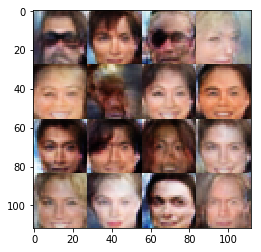

Timestamp 20170806-04-27-09.528 -  Epoch 1/1 -  Step 25110 -  D Loss: 1.5094 - G Loss: 1.0656
Timestamp 20170806-04-27-21.438 -  Epoch 1/1 -  Step 25120 -  D Loss: 1.3904 - G Loss: 0.8991
Timestamp 20170806-04-27-33.352 -  Epoch 1/1 -  Step 25130 -  D Loss: 1.2161 - G Loss: 0.8591
Timestamp 20170806-04-27-45.263 -  Epoch 1/1 -  Step 25140 -  D Loss: 1.1749 - G Loss: 1.1561
Timestamp 20170806-04-27-57.164 -  Epoch 1/1 -  Step 25150 -  D Loss: 1.1410 - G Loss: 0.7954
Timestamp 20170806-04-28-09.059 -  Epoch 1/1 -  Step 25160 -  D Loss: 1.1832 - G Loss: 0.8573
Timestamp 20170806-04-28-20.971 -  Epoch 1/1 -  Step 25170 -  D Loss: 0.9260 - G Loss: 1.3437
Timestamp 20170806-04-28-32.886 -  Epoch 1/1 -  Step 25180 -  D Loss: 1.0657 - G Loss: 0.8748
Timestamp 20170806-04-28-44.798 -  Epoch 1/1 -  Step 25190 -  D Loss: 0.9798 - G Loss: 0.8695
Timestamp 20170806-04-28-56.711 -  Epoch 1/1 -  Step 25200 -  D Loss: 1.2245 - G Loss: 1.2367


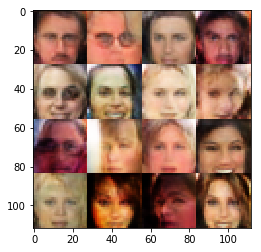

Timestamp 20170806-04-29-09.661 -  Epoch 1/1 -  Step 25210 -  D Loss: 1.4025 - G Loss: 0.8620
Timestamp 20170806-04-29-21.572 -  Epoch 1/1 -  Step 25220 -  D Loss: 0.9089 - G Loss: 1.2927
Timestamp 20170806-04-29-33.465 -  Epoch 1/1 -  Step 25230 -  D Loss: 1.0022 - G Loss: 1.2508
Timestamp 20170806-04-29-45.385 -  Epoch 1/1 -  Step 25240 -  D Loss: 1.3841 - G Loss: 0.5232
Timestamp 20170806-04-29-57.300 -  Epoch 1/1 -  Step 25250 -  D Loss: 1.2566 - G Loss: 0.9378
Timestamp 20170806-04-30-09.220 -  Epoch 1/1 -  Step 25260 -  D Loss: 1.1141 - G Loss: 0.4787
Timestamp 20170806-04-30-21.127 -  Epoch 1/1 -  Step 25270 -  D Loss: 1.2312 - G Loss: 0.8768
Timestamp 20170806-04-30-33.028 -  Epoch 1/1 -  Step 25280 -  D Loss: 1.1830 - G Loss: 1.0168
Timestamp 20170806-04-30-44.935 -  Epoch 1/1 -  Step 25290 -  D Loss: 1.5189 - G Loss: 0.8575
Timestamp 20170806-04-30-56.834 -  Epoch 1/1 -  Step 25300 -  D Loss: 1.3874 - G Loss: 0.6073


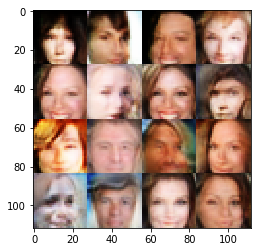

Timestamp 20170806-04-31-09.805 -  Epoch 1/1 -  Step 25310 -  D Loss: 0.9539 - G Loss: 1.2238
Timestamp 20170806-04-31-21.703 -  Epoch 1/1 -  Step 25320 -  D Loss: 1.1348 - G Loss: 1.0665
Timestamp 20170806-04-31-26.700 -  Epoch 1/1 -  Step 25324 -  D Loss: 1.1889 - G Loss: 1.3278


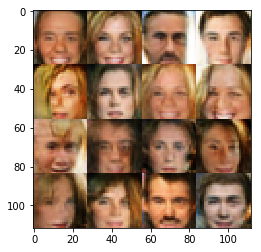

In [15]:
batch_size = 8
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Timestamp 20170806-04-31-57.166 -  Epoch 1/1 -  Step 10 -  D Loss: 1.3363 - G Loss: 0.8602
Timestamp 20170806-04-32-13.808 -  Epoch 1/1 -  Step 20 -  D Loss: 0.8091 - G Loss: 3.2806
Timestamp 20170806-04-32-30.464 -  Epoch 1/1 -  Step 30 -  D Loss: 0.6637 - G Loss: 2.2792
Timestamp 20170806-04-32-47.128 -  Epoch 1/1 -  Step 40 -  D Loss: 0.5932 - G Loss: 3.1021
Timestamp 20170806-04-33-03.768 -  Epoch 1/1 -  Step 50 -  D Loss: 0.5628 - G Loss: 3.7488
Timestamp 20170806-04-33-20.416 -  Epoch 1/1 -  Step 60 -  D Loss: 0.9936 - G Loss: 1.8259
Timestamp 20170806-04-33-37.054 -  Epoch 1/1 -  Step 70 -  D Loss: 0.8542 - G Loss: 2.6979
Timestamp 20170806-04-33-53.697 -  Epoch 1/1 -  Step 80 -  D Loss: 0.9811 - G Loss: 3.2895
Timestamp 20170806-04-34-10.341 -  Epoch 1/1 -  Step 90 -  D Loss: 0.5536 - G Loss: 4.3284
Timestamp 20170806-04-34-26.986 -  Epoch 1/1 -  Step 100 -  D Loss: 0.6431 - G Loss: 2.6831


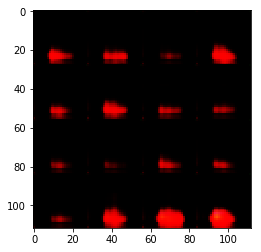

Timestamp 20170806-04-34-44.262 -  Epoch 1/1 -  Step 110 -  D Loss: 1.6780 - G Loss: 0.7400
Timestamp 20170806-04-35-00.894 -  Epoch 1/1 -  Step 120 -  D Loss: 0.6300 - G Loss: 3.6255
Timestamp 20170806-04-35-17.534 -  Epoch 1/1 -  Step 130 -  D Loss: 0.8542 - G Loss: 7.3327
Timestamp 20170806-04-35-34.207 -  Epoch 1/1 -  Step 140 -  D Loss: 0.4718 - G Loss: 4.5313
Timestamp 20170806-04-35-50.832 -  Epoch 1/1 -  Step 150 -  D Loss: 0.8467 - G Loss: 1.2472
Timestamp 20170806-04-36-07.457 -  Epoch 1/1 -  Step 160 -  D Loss: 1.9606 - G Loss: 0.6993
Timestamp 20170806-04-36-24.128 -  Epoch 1/1 -  Step 170 -  D Loss: 0.9050 - G Loss: 2.2913
Timestamp 20170806-04-36-40.765 -  Epoch 1/1 -  Step 180 -  D Loss: 0.7000 - G Loss: 2.1616
Timestamp 20170806-04-36-57.400 -  Epoch 1/1 -  Step 190 -  D Loss: 0.9409 - G Loss: 2.2140
Timestamp 20170806-04-37-14.016 -  Epoch 1/1 -  Step 200 -  D Loss: 0.8440 - G Loss: 2.0788


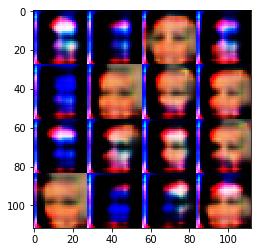

Timestamp 20170806-04-37-31.233 -  Epoch 1/1 -  Step 210 -  D Loss: 1.4659 - G Loss: 0.7342
Timestamp 20170806-04-37-47.847 -  Epoch 1/1 -  Step 220 -  D Loss: 0.9462 - G Loss: 2.5353
Timestamp 20170806-04-38-04.473 -  Epoch 1/1 -  Step 230 -  D Loss: 1.2387 - G Loss: 0.8576
Timestamp 20170806-04-38-21.089 -  Epoch 1/1 -  Step 240 -  D Loss: 1.6184 - G Loss: 0.9149
Timestamp 20170806-04-38-37.715 -  Epoch 1/1 -  Step 250 -  D Loss: 1.4301 - G Loss: 0.9769
Timestamp 20170806-04-38-54.344 -  Epoch 1/1 -  Step 260 -  D Loss: 1.1445 - G Loss: 1.2024
Timestamp 20170806-04-39-10.982 -  Epoch 1/1 -  Step 270 -  D Loss: 1.0722 - G Loss: 0.8610
Timestamp 20170806-04-39-27.589 -  Epoch 1/1 -  Step 280 -  D Loss: 0.9682 - G Loss: 1.5049
Timestamp 20170806-04-39-44.205 -  Epoch 1/1 -  Step 290 -  D Loss: 0.8318 - G Loss: 1.6806
Timestamp 20170806-04-40-00.818 -  Epoch 1/1 -  Step 300 -  D Loss: 0.9636 - G Loss: 1.7556


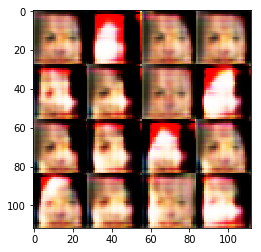

Timestamp 20170806-04-40-18.085 -  Epoch 1/1 -  Step 310 -  D Loss: 1.0702 - G Loss: 2.7176
Timestamp 20170806-04-40-34.705 -  Epoch 1/1 -  Step 320 -  D Loss: 1.3026 - G Loss: 1.3751
Timestamp 20170806-04-40-51.323 -  Epoch 1/1 -  Step 330 -  D Loss: 1.2347 - G Loss: 1.1099
Timestamp 20170806-04-41-07.954 -  Epoch 1/1 -  Step 340 -  D Loss: 1.1684 - G Loss: 0.9695
Timestamp 20170806-04-41-24.565 -  Epoch 1/1 -  Step 350 -  D Loss: 0.6319 - G Loss: 2.6704
Timestamp 20170806-04-41-41.189 -  Epoch 1/1 -  Step 360 -  D Loss: 1.0916 - G Loss: 2.7627
Timestamp 20170806-04-41-57.823 -  Epoch 1/1 -  Step 370 -  D Loss: 1.1327 - G Loss: 1.0298
Timestamp 20170806-04-42-14.437 -  Epoch 1/1 -  Step 380 -  D Loss: 1.1813 - G Loss: 0.9193
Timestamp 20170806-04-42-31.065 -  Epoch 1/1 -  Step 390 -  D Loss: 0.8111 - G Loss: 1.7377
Timestamp 20170806-04-42-47.691 -  Epoch 1/1 -  Step 400 -  D Loss: 0.8829 - G Loss: 1.2802


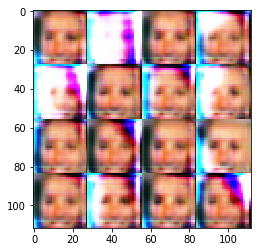

Timestamp 20170806-04-43-05.044 -  Epoch 1/1 -  Step 410 -  D Loss: 1.6494 - G Loss: 1.0181
Timestamp 20170806-04-43-21.701 -  Epoch 1/1 -  Step 420 -  D Loss: 0.9315 - G Loss: 1.0411
Timestamp 20170806-04-43-38.334 -  Epoch 1/1 -  Step 430 -  D Loss: 0.8723 - G Loss: 1.5805
Timestamp 20170806-04-43-54.964 -  Epoch 1/1 -  Step 440 -  D Loss: 1.0941 - G Loss: 1.3640
Timestamp 20170806-04-44-11.587 -  Epoch 1/1 -  Step 450 -  D Loss: 0.7728 - G Loss: 0.8816
Timestamp 20170806-04-44-28.212 -  Epoch 1/1 -  Step 460 -  D Loss: 0.6597 - G Loss: 1.9190
Timestamp 20170806-04-44-44.840 -  Epoch 1/1 -  Step 470 -  D Loss: 0.8259 - G Loss: 1.5367
Timestamp 20170806-04-45-01.466 -  Epoch 1/1 -  Step 480 -  D Loss: 0.5752 - G Loss: 2.4773
Timestamp 20170806-04-45-18.098 -  Epoch 1/1 -  Step 490 -  D Loss: 0.9869 - G Loss: 1.7823
Timestamp 20170806-04-45-34.735 -  Epoch 1/1 -  Step 500 -  D Loss: 0.7321 - G Loss: 1.4268


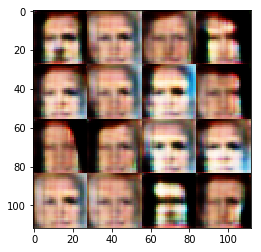

Timestamp 20170806-04-45-51.963 -  Epoch 1/1 -  Step 510 -  D Loss: 0.8912 - G Loss: 1.9894
Timestamp 20170806-04-46-08.603 -  Epoch 1/1 -  Step 520 -  D Loss: 1.4225 - G Loss: 0.5351
Timestamp 20170806-04-46-25.224 -  Epoch 1/1 -  Step 530 -  D Loss: 0.7015 - G Loss: 1.8034
Timestamp 20170806-04-46-41.863 -  Epoch 1/1 -  Step 540 -  D Loss: 0.5588 - G Loss: 1.9742
Timestamp 20170806-04-46-58.483 -  Epoch 1/1 -  Step 550 -  D Loss: 0.6100 - G Loss: 2.0397
Timestamp 20170806-04-47-15.094 -  Epoch 1/1 -  Step 560 -  D Loss: 0.9487 - G Loss: 2.4883
Timestamp 20170806-04-47-31.750 -  Epoch 1/1 -  Step 570 -  D Loss: 0.7618 - G Loss: 1.7543
Timestamp 20170806-04-47-48.364 -  Epoch 1/1 -  Step 580 -  D Loss: 1.4475 - G Loss: 2.8004
Timestamp 20170806-04-48-04.985 -  Epoch 1/1 -  Step 590 -  D Loss: 0.9168 - G Loss: 1.7664
Timestamp 20170806-04-48-21.622 -  Epoch 1/1 -  Step 600 -  D Loss: 0.9365 - G Loss: 1.2774


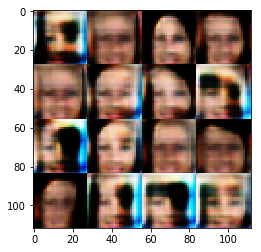

Timestamp 20170806-04-48-38.880 -  Epoch 1/1 -  Step 610 -  D Loss: 0.8372 - G Loss: 1.5094
Timestamp 20170806-04-48-55.513 -  Epoch 1/1 -  Step 620 -  D Loss: 1.3124 - G Loss: 0.5207
Timestamp 20170806-04-49-12.142 -  Epoch 1/1 -  Step 630 -  D Loss: 0.5129 - G Loss: 2.4255
Timestamp 20170806-04-49-28.769 -  Epoch 1/1 -  Step 640 -  D Loss: 1.1859 - G Loss: 2.5036
Timestamp 20170806-04-49-45.366 -  Epoch 1/1 -  Step 650 -  D Loss: 0.9392 - G Loss: 1.1803
Timestamp 20170806-04-50-01.988 -  Epoch 1/1 -  Step 660 -  D Loss: 0.7920 - G Loss: 1.7831
Timestamp 20170806-04-50-18.612 -  Epoch 1/1 -  Step 670 -  D Loss: 0.9904 - G Loss: 1.7999
Timestamp 20170806-04-50-35.234 -  Epoch 1/1 -  Step 680 -  D Loss: 2.0462 - G Loss: 0.4048
Timestamp 20170806-04-50-51.861 -  Epoch 1/1 -  Step 690 -  D Loss: 0.9307 - G Loss: 1.5385
Timestamp 20170806-04-51-08.491 -  Epoch 1/1 -  Step 700 -  D Loss: 1.0891 - G Loss: 1.7496


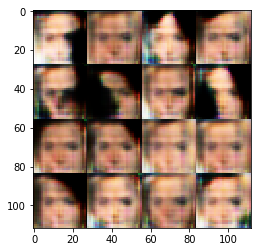

Timestamp 20170806-04-51-25.756 -  Epoch 1/1 -  Step 710 -  D Loss: 2.1666 - G Loss: 0.3856
Timestamp 20170806-04-51-42.409 -  Epoch 1/1 -  Step 720 -  D Loss: 0.3818 - G Loss: 4.5385
Timestamp 20170806-04-51-59.024 -  Epoch 1/1 -  Step 730 -  D Loss: 0.8134 - G Loss: 1.5436
Timestamp 20170806-04-52-15.658 -  Epoch 1/1 -  Step 740 -  D Loss: 0.5719 - G Loss: 1.9198
Timestamp 20170806-04-52-32.301 -  Epoch 1/1 -  Step 750 -  D Loss: 0.8087 - G Loss: 1.1429
Timestamp 20170806-04-52-48.916 -  Epoch 1/1 -  Step 760 -  D Loss: 1.1230 - G Loss: 1.9050
Timestamp 20170806-04-53-05.614 -  Epoch 1/1 -  Step 770 -  D Loss: 1.1254 - G Loss: 0.7880
Timestamp 20170806-04-53-22.340 -  Epoch 1/1 -  Step 780 -  D Loss: 1.2792 - G Loss: 1.7705
Timestamp 20170806-04-53-39.050 -  Epoch 1/1 -  Step 790 -  D Loss: 1.0407 - G Loss: 1.7626
Timestamp 20170806-04-53-55.742 -  Epoch 1/1 -  Step 800 -  D Loss: 0.8393 - G Loss: 1.4073


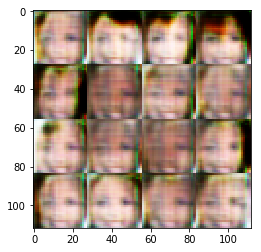

Timestamp 20170806-04-54-13.116 -  Epoch 1/1 -  Step 810 -  D Loss: 1.4924 - G Loss: 4.5066
Timestamp 20170806-04-54-29.837 -  Epoch 1/1 -  Step 820 -  D Loss: 0.7908 - G Loss: 1.6559
Timestamp 20170806-04-54-46.525 -  Epoch 1/1 -  Step 830 -  D Loss: 1.3191 - G Loss: 1.3561
Timestamp 20170806-04-55-03.208 -  Epoch 1/1 -  Step 840 -  D Loss: 0.7321 - G Loss: 2.2946
Timestamp 20170806-04-55-19.881 -  Epoch 1/1 -  Step 850 -  D Loss: 1.1127 - G Loss: 0.8722
Timestamp 20170806-04-55-36.529 -  Epoch 1/1 -  Step 860 -  D Loss: 0.6097 - G Loss: 2.3362
Timestamp 20170806-04-55-53.168 -  Epoch 1/1 -  Step 870 -  D Loss: 0.9553 - G Loss: 1.5836
Timestamp 20170806-04-56-09.808 -  Epoch 1/1 -  Step 880 -  D Loss: 1.0167 - G Loss: 1.1549
Timestamp 20170806-04-56-26.459 -  Epoch 1/1 -  Step 890 -  D Loss: 1.0836 - G Loss: 1.1680
Timestamp 20170806-04-56-43.077 -  Epoch 1/1 -  Step 900 -  D Loss: 1.1860 - G Loss: 0.7290


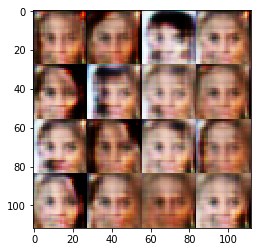

Timestamp 20170806-04-57-00.353 -  Epoch 1/1 -  Step 910 -  D Loss: 0.9428 - G Loss: 1.2215
Timestamp 20170806-04-57-16.986 -  Epoch 1/1 -  Step 920 -  D Loss: 0.7135 - G Loss: 1.7415
Timestamp 20170806-04-57-33.644 -  Epoch 1/1 -  Step 930 -  D Loss: 0.6923 - G Loss: 4.4217
Timestamp 20170806-04-57-50.290 -  Epoch 1/1 -  Step 940 -  D Loss: 1.1999 - G Loss: 1.7232
Timestamp 20170806-04-58-06.951 -  Epoch 1/1 -  Step 950 -  D Loss: 0.9554 - G Loss: 2.6222
Timestamp 20170806-04-58-23.605 -  Epoch 1/1 -  Step 960 -  D Loss: 1.0688 - G Loss: 1.1556
Timestamp 20170806-04-58-40.256 -  Epoch 1/1 -  Step 970 -  D Loss: 0.5570 - G Loss: 1.9077
Timestamp 20170806-04-58-56.886 -  Epoch 1/1 -  Step 980 -  D Loss: 0.9809 - G Loss: 1.3348
Timestamp 20170806-04-59-13.527 -  Epoch 1/1 -  Step 990 -  D Loss: 1.5010 - G Loss: 0.4302
Timestamp 20170806-04-59-30.172 -  Epoch 1/1 -  Step 1000 -  D Loss: 0.9442 - G Loss: 0.9294


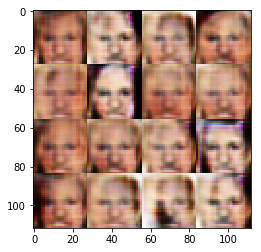

Timestamp 20170806-04-59-47.473 -  Epoch 1/1 -  Step 1010 -  D Loss: 0.9747 - G Loss: 0.9805
Timestamp 20170806-05-00-04.099 -  Epoch 1/1 -  Step 1020 -  D Loss: 0.9429 - G Loss: 1.7422
Timestamp 20170806-05-00-20.727 -  Epoch 1/1 -  Step 1030 -  D Loss: 0.9485 - G Loss: 1.3567
Timestamp 20170806-05-00-37.363 -  Epoch 1/1 -  Step 1040 -  D Loss: 1.1501 - G Loss: 0.9786
Timestamp 20170806-05-00-53.984 -  Epoch 1/1 -  Step 1050 -  D Loss: 0.7761 - G Loss: 1.3213
Timestamp 20170806-05-01-10.625 -  Epoch 1/1 -  Step 1060 -  D Loss: 0.9786 - G Loss: 1.4662
Timestamp 20170806-05-01-27.262 -  Epoch 1/1 -  Step 1070 -  D Loss: 0.8527 - G Loss: 1.1725
Timestamp 20170806-05-01-43.916 -  Epoch 1/1 -  Step 1080 -  D Loss: 1.9732 - G Loss: 0.5492
Timestamp 20170806-05-02-00.591 -  Epoch 1/1 -  Step 1090 -  D Loss: 1.0470 - G Loss: 1.0193
Timestamp 20170806-05-02-17.287 -  Epoch 1/1 -  Step 1100 -  D Loss: 1.4415 - G Loss: 0.7202


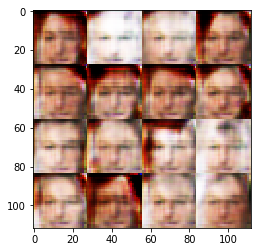

Timestamp 20170806-05-02-34.655 -  Epoch 1/1 -  Step 1110 -  D Loss: 1.1175 - G Loss: 1.6294
Timestamp 20170806-05-02-51.401 -  Epoch 1/1 -  Step 1120 -  D Loss: 0.7748 - G Loss: 1.3283
Timestamp 20170806-05-03-08.037 -  Epoch 1/1 -  Step 1130 -  D Loss: 1.3381 - G Loss: 1.2626
Timestamp 20170806-05-03-24.662 -  Epoch 1/1 -  Step 1140 -  D Loss: 0.6883 - G Loss: 2.0777
Timestamp 20170806-05-03-41.309 -  Epoch 1/1 -  Step 1150 -  D Loss: 0.9971 - G Loss: 1.8971
Timestamp 20170806-05-03-57.950 -  Epoch 1/1 -  Step 1160 -  D Loss: 0.9733 - G Loss: 1.5231
Timestamp 20170806-05-04-14.594 -  Epoch 1/1 -  Step 1170 -  D Loss: 0.9787 - G Loss: 1.0089
Timestamp 20170806-05-04-31.294 -  Epoch 1/1 -  Step 1180 -  D Loss: 1.2757 - G Loss: 1.5311
Timestamp 20170806-05-04-47.974 -  Epoch 1/1 -  Step 1190 -  D Loss: 1.1266 - G Loss: 0.7962
Timestamp 20170806-05-05-04.592 -  Epoch 1/1 -  Step 1200 -  D Loss: 0.7020 - G Loss: 1.9829


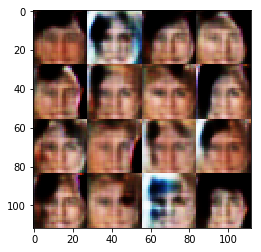

Timestamp 20170806-05-05-21.977 -  Epoch 1/1 -  Step 1210 -  D Loss: 1.2012 - G Loss: 0.8494
Timestamp 20170806-05-05-38.669 -  Epoch 1/1 -  Step 1220 -  D Loss: 1.4471 - G Loss: 1.1143
Timestamp 20170806-05-05-55.338 -  Epoch 1/1 -  Step 1230 -  D Loss: 0.8057 - G Loss: 2.1361
Timestamp 20170806-05-06-11.977 -  Epoch 1/1 -  Step 1240 -  D Loss: 0.8389 - G Loss: 2.8660
Timestamp 20170806-05-06-28.611 -  Epoch 1/1 -  Step 1250 -  D Loss: 0.8920 - G Loss: 1.4297
Timestamp 20170806-05-06-45.263 -  Epoch 1/1 -  Step 1260 -  D Loss: 0.8276 - G Loss: 2.0419
Timestamp 20170806-05-07-01.938 -  Epoch 1/1 -  Step 1270 -  D Loss: 0.9882 - G Loss: 1.3085
Timestamp 20170806-05-07-18.598 -  Epoch 1/1 -  Step 1280 -  D Loss: 0.8586 - G Loss: 1.2800
Timestamp 20170806-05-07-35.253 -  Epoch 1/1 -  Step 1290 -  D Loss: 1.2884 - G Loss: 1.1245
Timestamp 20170806-05-07-51.914 -  Epoch 1/1 -  Step 1300 -  D Loss: 0.9866 - G Loss: 0.8738


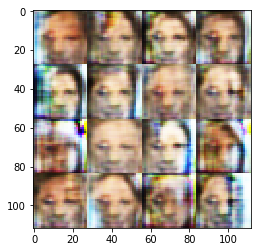

Timestamp 20170806-05-08-09.190 -  Epoch 1/1 -  Step 1310 -  D Loss: 0.6080 - G Loss: 2.3539
Timestamp 20170806-05-08-25.814 -  Epoch 1/1 -  Step 1320 -  D Loss: 0.9329 - G Loss: 1.0155
Timestamp 20170806-05-08-42.467 -  Epoch 1/1 -  Step 1330 -  D Loss: 0.6530 - G Loss: 2.4426
Timestamp 20170806-05-08-59.096 -  Epoch 1/1 -  Step 1340 -  D Loss: 0.4631 - G Loss: 3.3553
Timestamp 20170806-05-09-15.767 -  Epoch 1/1 -  Step 1350 -  D Loss: 0.5403 - G Loss: 2.6564
Timestamp 20170806-05-09-32.383 -  Epoch 1/1 -  Step 1360 -  D Loss: 0.6577 - G Loss: 2.1489
Timestamp 20170806-05-09-49.015 -  Epoch 1/1 -  Step 1370 -  D Loss: 0.7868 - G Loss: 2.7969
Timestamp 20170806-05-10-05.635 -  Epoch 1/1 -  Step 1380 -  D Loss: 0.5976 - G Loss: 2.0623
Timestamp 20170806-05-10-22.236 -  Epoch 1/1 -  Step 1390 -  D Loss: 0.5711 - G Loss: 3.0128
Timestamp 20170806-05-10-38.856 -  Epoch 1/1 -  Step 1400 -  D Loss: 1.3303 - G Loss: 0.5537


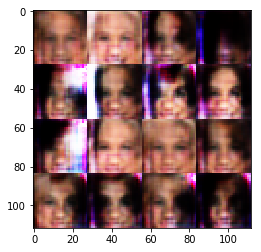

Timestamp 20170806-05-10-56.136 -  Epoch 1/1 -  Step 1410 -  D Loss: 0.7968 - G Loss: 2.0087
Timestamp 20170806-05-11-12.804 -  Epoch 1/1 -  Step 1420 -  D Loss: 1.0131 - G Loss: 1.9258
Timestamp 20170806-05-11-29.417 -  Epoch 1/1 -  Step 1430 -  D Loss: 0.6383 - G Loss: 2.0187
Timestamp 20170806-05-11-46.024 -  Epoch 1/1 -  Step 1440 -  D Loss: 0.5726 - G Loss: 3.8408
Timestamp 20170806-05-12-02.644 -  Epoch 1/1 -  Step 1450 -  D Loss: 0.4816 - G Loss: 3.9748
Timestamp 20170806-05-12-19.272 -  Epoch 1/1 -  Step 1460 -  D Loss: 0.8310 - G Loss: 1.3796
Timestamp 20170806-05-12-35.905 -  Epoch 1/1 -  Step 1470 -  D Loss: 0.8288 - G Loss: 0.9905
Timestamp 20170806-05-12-52.548 -  Epoch 1/1 -  Step 1480 -  D Loss: 1.0842 - G Loss: 2.7670
Timestamp 20170806-05-13-09.182 -  Epoch 1/1 -  Step 1490 -  D Loss: 1.7616 - G Loss: 0.5572
Timestamp 20170806-05-13-25.807 -  Epoch 1/1 -  Step 1500 -  D Loss: 1.1832 - G Loss: 0.8126


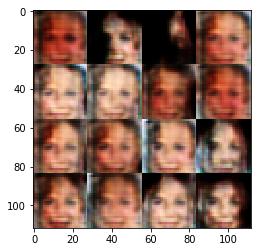

Timestamp 20170806-05-13-43.056 -  Epoch 1/1 -  Step 1510 -  D Loss: 1.0357 - G Loss: 1.0820
Timestamp 20170806-05-13-59.679 -  Epoch 1/1 -  Step 1520 -  D Loss: 1.0699 - G Loss: 1.0738
Timestamp 20170806-05-14-16.299 -  Epoch 1/1 -  Step 1530 -  D Loss: 0.6658 - G Loss: 1.5207
Timestamp 20170806-05-14-32.907 -  Epoch 1/1 -  Step 1540 -  D Loss: 0.7229 - G Loss: 1.9858
Timestamp 20170806-05-14-49.549 -  Epoch 1/1 -  Step 1550 -  D Loss: 1.0400 - G Loss: 0.8876
Timestamp 20170806-05-15-06.158 -  Epoch 1/1 -  Step 1560 -  D Loss: 1.0061 - G Loss: 1.7857
Timestamp 20170806-05-15-22.777 -  Epoch 1/1 -  Step 1570 -  D Loss: 0.7541 - G Loss: 1.8849
Timestamp 20170806-05-15-39.412 -  Epoch 1/1 -  Step 1580 -  D Loss: 0.9828 - G Loss: 0.8394
Timestamp 20170806-05-15-56.023 -  Epoch 1/1 -  Step 1590 -  D Loss: 0.8741 - G Loss: 1.7410
Timestamp 20170806-05-16-12.657 -  Epoch 1/1 -  Step 1600 -  D Loss: 1.0096 - G Loss: 1.3401


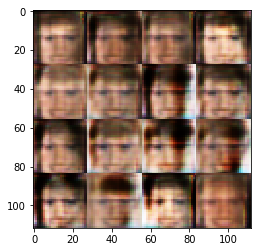

Timestamp 20170806-05-16-29.931 -  Epoch 1/1 -  Step 1610 -  D Loss: 0.7161 - G Loss: 2.1058
Timestamp 20170806-05-16-46.568 -  Epoch 1/1 -  Step 1620 -  D Loss: 1.6100 - G Loss: 0.5432
Timestamp 20170806-05-17-03.212 -  Epoch 1/1 -  Step 1630 -  D Loss: 0.8948 - G Loss: 1.2803
Timestamp 20170806-05-17-19.830 -  Epoch 1/1 -  Step 1640 -  D Loss: 0.9864 - G Loss: 1.4751
Timestamp 20170806-05-17-36.462 -  Epoch 1/1 -  Step 1650 -  D Loss: 0.7515 - G Loss: 1.9767
Timestamp 20170806-05-17-53.076 -  Epoch 1/1 -  Step 1660 -  D Loss: 1.3987 - G Loss: 0.6080
Timestamp 20170806-05-18-09.704 -  Epoch 1/1 -  Step 1670 -  D Loss: 0.8686 - G Loss: 1.7545
Timestamp 20170806-05-18-26.312 -  Epoch 1/1 -  Step 1680 -  D Loss: 1.0177 - G Loss: 1.7204
Timestamp 20170806-05-18-42.924 -  Epoch 1/1 -  Step 1690 -  D Loss: 0.9002 - G Loss: 1.1285
Timestamp 20170806-05-18-59.555 -  Epoch 1/1 -  Step 1700 -  D Loss: 1.1767 - G Loss: 0.9185


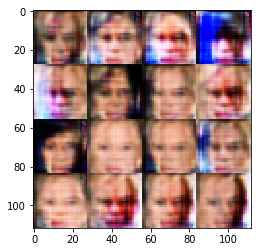

Timestamp 20170806-05-19-16.986 -  Epoch 1/1 -  Step 1710 -  D Loss: 0.9210 - G Loss: 0.7373
Timestamp 20170806-05-19-33.602 -  Epoch 1/1 -  Step 1720 -  D Loss: 1.0703 - G Loss: 1.2052
Timestamp 20170806-05-19-50.217 -  Epoch 1/1 -  Step 1730 -  D Loss: 1.2182 - G Loss: 0.7256
Timestamp 20170806-05-20-06.841 -  Epoch 1/1 -  Step 1740 -  D Loss: 1.7929 - G Loss: 0.6543
Timestamp 20170806-05-20-23.462 -  Epoch 1/1 -  Step 1750 -  D Loss: 1.2843 - G Loss: 1.9401
Timestamp 20170806-05-20-40.066 -  Epoch 1/1 -  Step 1760 -  D Loss: 0.7084 - G Loss: 2.3896
Timestamp 20170806-05-20-56.650 -  Epoch 1/1 -  Step 1770 -  D Loss: 1.0868 - G Loss: 1.5021
Timestamp 20170806-05-21-13.274 -  Epoch 1/1 -  Step 1780 -  D Loss: 1.0727 - G Loss: 1.3274
Timestamp 20170806-05-21-29.886 -  Epoch 1/1 -  Step 1790 -  D Loss: 1.2242 - G Loss: 0.9110
Timestamp 20170806-05-21-46.506 -  Epoch 1/1 -  Step 1800 -  D Loss: 0.9774 - G Loss: 2.8174


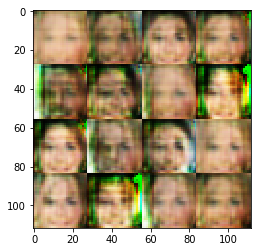

Timestamp 20170806-05-22-03.768 -  Epoch 1/1 -  Step 1810 -  D Loss: 1.1006 - G Loss: 0.8717
Timestamp 20170806-05-22-20.370 -  Epoch 1/1 -  Step 1820 -  D Loss: 0.8517 - G Loss: 1.9240
Timestamp 20170806-05-22-36.950 -  Epoch 1/1 -  Step 1830 -  D Loss: 1.1171 - G Loss: 0.9325
Timestamp 20170806-05-22-53.551 -  Epoch 1/1 -  Step 1840 -  D Loss: 1.5098 - G Loss: 0.9517
Timestamp 20170806-05-23-10.172 -  Epoch 1/1 -  Step 1850 -  D Loss: 0.6875 - G Loss: 1.6396
Timestamp 20170806-05-23-26.770 -  Epoch 1/1 -  Step 1860 -  D Loss: 0.9206 - G Loss: 2.0283
Timestamp 20170806-05-23-43.397 -  Epoch 1/1 -  Step 1870 -  D Loss: 1.1295 - G Loss: 1.0586
Timestamp 20170806-05-23-59.997 -  Epoch 1/1 -  Step 1880 -  D Loss: 0.9164 - G Loss: 2.3245
Timestamp 20170806-05-24-16.642 -  Epoch 1/1 -  Step 1890 -  D Loss: 1.1452 - G Loss: 0.9756
Timestamp 20170806-05-24-33.279 -  Epoch 1/1 -  Step 1900 -  D Loss: 0.8562 - G Loss: 1.5284


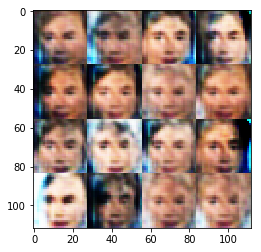

Timestamp 20170806-05-24-50.510 -  Epoch 1/1 -  Step 1910 -  D Loss: 1.5629 - G Loss: 1.0419
Timestamp 20170806-05-25-07.130 -  Epoch 1/1 -  Step 1920 -  D Loss: 1.1498 - G Loss: 0.8897
Timestamp 20170806-05-25-23.743 -  Epoch 1/1 -  Step 1930 -  D Loss: 0.7324 - G Loss: 1.3762
Timestamp 20170806-05-25-40.384 -  Epoch 1/1 -  Step 1940 -  D Loss: 0.9220 - G Loss: 1.2872
Timestamp 20170806-05-25-56.986 -  Epoch 1/1 -  Step 1950 -  D Loss: 0.8015 - G Loss: 1.9332
Timestamp 20170806-05-26-13.596 -  Epoch 1/1 -  Step 1960 -  D Loss: 0.8297 - G Loss: 1.7046
Timestamp 20170806-05-26-30.185 -  Epoch 1/1 -  Step 1970 -  D Loss: 1.0909 - G Loss: 0.8941
Timestamp 20170806-05-26-46.787 -  Epoch 1/1 -  Step 1980 -  D Loss: 1.0392 - G Loss: 1.9805
Timestamp 20170806-05-27-03.393 -  Epoch 1/1 -  Step 1990 -  D Loss: 1.2122 - G Loss: 0.9837
Timestamp 20170806-05-27-20.005 -  Epoch 1/1 -  Step 2000 -  D Loss: 0.8583 - G Loss: 1.0670


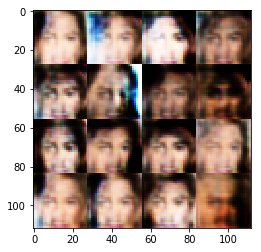

Timestamp 20170806-05-27-37.272 -  Epoch 1/1 -  Step 2010 -  D Loss: 1.2850 - G Loss: 2.0409
Timestamp 20170806-05-27-53.888 -  Epoch 1/1 -  Step 2020 -  D Loss: 0.9373 - G Loss: 1.1267
Timestamp 20170806-05-28-10.485 -  Epoch 1/1 -  Step 2030 -  D Loss: 1.3704 - G Loss: 0.6491
Timestamp 20170806-05-28-27.079 -  Epoch 1/1 -  Step 2040 -  D Loss: 0.6954 - G Loss: 2.4078
Timestamp 20170806-05-28-43.687 -  Epoch 1/1 -  Step 2050 -  D Loss: 1.1709 - G Loss: 0.9284
Timestamp 20170806-05-29-00.276 -  Epoch 1/1 -  Step 2060 -  D Loss: 1.3635 - G Loss: 1.2204
Timestamp 20170806-05-29-16.860 -  Epoch 1/1 -  Step 2070 -  D Loss: 1.2696 - G Loss: 1.2944
Timestamp 20170806-05-29-33.475 -  Epoch 1/1 -  Step 2080 -  D Loss: 0.7987 - G Loss: 1.2062
Timestamp 20170806-05-29-50.071 -  Epoch 1/1 -  Step 2090 -  D Loss: 1.4218 - G Loss: 0.3954
Timestamp 20170806-05-30-06.678 -  Epoch 1/1 -  Step 2100 -  D Loss: 0.7606 - G Loss: 1.9259


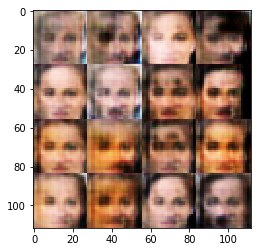

Timestamp 20170806-05-30-23.912 -  Epoch 1/1 -  Step 2110 -  D Loss: 1.0509 - G Loss: 1.8248
Timestamp 20170806-05-30-40.504 -  Epoch 1/1 -  Step 2120 -  D Loss: 0.9140 - G Loss: 0.9124
Timestamp 20170806-05-30-57.088 -  Epoch 1/1 -  Step 2130 -  D Loss: 1.1816 - G Loss: 0.5301
Timestamp 20170806-05-31-13.706 -  Epoch 1/1 -  Step 2140 -  D Loss: 0.7525 - G Loss: 1.0692
Timestamp 20170806-05-31-30.323 -  Epoch 1/1 -  Step 2150 -  D Loss: 1.3769 - G Loss: 1.5862
Timestamp 20170806-05-31-46.921 -  Epoch 1/1 -  Step 2160 -  D Loss: 1.6445 - G Loss: 0.3531
Timestamp 20170806-05-32-03.532 -  Epoch 1/1 -  Step 2170 -  D Loss: 1.1158 - G Loss: 1.3547
Timestamp 20170806-05-32-20.143 -  Epoch 1/1 -  Step 2180 -  D Loss: 0.9068 - G Loss: 1.3546
Timestamp 20170806-05-32-36.750 -  Epoch 1/1 -  Step 2190 -  D Loss: 1.1406 - G Loss: 1.3668
Timestamp 20170806-05-32-53.339 -  Epoch 1/1 -  Step 2200 -  D Loss: 1.4210 - G Loss: 0.6061


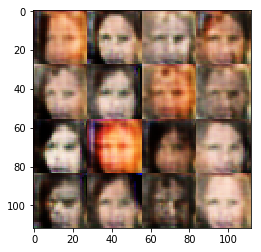

Timestamp 20170806-05-33-10.621 -  Epoch 1/1 -  Step 2210 -  D Loss: 0.5550 - G Loss: 1.9864
Timestamp 20170806-05-33-27.206 -  Epoch 1/1 -  Step 2220 -  D Loss: 0.4731 - G Loss: 3.6224
Timestamp 20170806-05-33-43.822 -  Epoch 1/1 -  Step 2230 -  D Loss: 0.7696 - G Loss: 2.4371
Timestamp 20170806-05-34-00.421 -  Epoch 1/1 -  Step 2240 -  D Loss: 1.4928 - G Loss: 0.5211
Timestamp 20170806-05-34-17.022 -  Epoch 1/1 -  Step 2250 -  D Loss: 1.0083 - G Loss: 1.8442
Timestamp 20170806-05-34-33.633 -  Epoch 1/1 -  Step 2260 -  D Loss: 1.1062 - G Loss: 1.0412
Timestamp 20170806-05-34-50.232 -  Epoch 1/1 -  Step 2270 -  D Loss: 0.7591 - G Loss: 1.9494
Timestamp 20170806-05-35-06.849 -  Epoch 1/1 -  Step 2280 -  D Loss: 1.3642 - G Loss: 0.6188
Timestamp 20170806-05-35-23.440 -  Epoch 1/1 -  Step 2290 -  D Loss: 0.5796 - G Loss: 1.9595
Timestamp 20170806-05-35-40.060 -  Epoch 1/1 -  Step 2300 -  D Loss: 0.7162 - G Loss: 2.1760


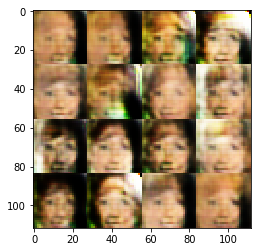

Timestamp 20170806-05-35-57.323 -  Epoch 1/1 -  Step 2310 -  D Loss: 1.2527 - G Loss: 2.0904
Timestamp 20170806-05-36-13.934 -  Epoch 1/1 -  Step 2320 -  D Loss: 1.2569 - G Loss: 0.6891
Timestamp 20170806-05-36-30.554 -  Epoch 1/1 -  Step 2330 -  D Loss: 0.8775 - G Loss: 0.9629
Timestamp 20170806-05-36-47.167 -  Epoch 1/1 -  Step 2340 -  D Loss: 0.9699 - G Loss: 1.3368
Timestamp 20170806-05-37-03.785 -  Epoch 1/1 -  Step 2350 -  D Loss: 1.0966 - G Loss: 0.9691
Timestamp 20170806-05-37-20.396 -  Epoch 1/1 -  Step 2360 -  D Loss: 1.5494 - G Loss: 0.5811
Timestamp 20170806-05-37-36.996 -  Epoch 1/1 -  Step 2370 -  D Loss: 1.3560 - G Loss: 0.7850
Timestamp 20170806-05-37-53.603 -  Epoch 1/1 -  Step 2380 -  D Loss: 0.9118 - G Loss: 1.4526
Timestamp 20170806-05-38-10.200 -  Epoch 1/1 -  Step 2390 -  D Loss: 1.2443 - G Loss: 1.0863
Timestamp 20170806-05-38-26.808 -  Epoch 1/1 -  Step 2400 -  D Loss: 0.7426 - G Loss: 1.7974


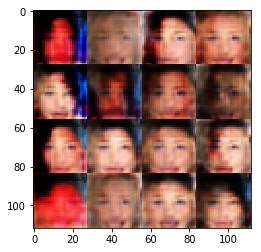

Timestamp 20170806-05-38-44.159 -  Epoch 1/1 -  Step 2410 -  D Loss: 1.0088 - G Loss: 1.2425
Timestamp 20170806-05-39-00.751 -  Epoch 1/1 -  Step 2420 -  D Loss: 1.0163 - G Loss: 0.9613
Timestamp 20170806-05-39-17.355 -  Epoch 1/1 -  Step 2430 -  D Loss: 1.6819 - G Loss: 0.6430
Timestamp 20170806-05-39-33.975 -  Epoch 1/1 -  Step 2440 -  D Loss: 0.9904 - G Loss: 1.3405
Timestamp 20170806-05-39-50.564 -  Epoch 1/1 -  Step 2450 -  D Loss: 1.2135 - G Loss: 2.0581
Timestamp 20170806-05-40-07.156 -  Epoch 1/1 -  Step 2460 -  D Loss: 0.9906 - G Loss: 1.1923
Timestamp 20170806-05-40-23.747 -  Epoch 1/1 -  Step 2470 -  D Loss: 1.2915 - G Loss: 0.5920
Timestamp 20170806-05-40-40.366 -  Epoch 1/1 -  Step 2480 -  D Loss: 1.3572 - G Loss: 0.6514
Timestamp 20170806-05-40-56.985 -  Epoch 1/1 -  Step 2490 -  D Loss: 1.2719 - G Loss: 1.4305
Timestamp 20170806-05-41-13.577 -  Epoch 1/1 -  Step 2500 -  D Loss: 0.9930 - G Loss: 1.0376


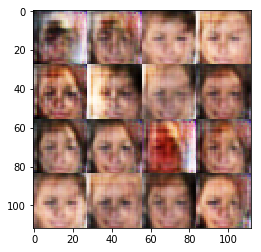

Timestamp 20170806-05-41-30.842 -  Epoch 1/1 -  Step 2510 -  D Loss: 1.5402 - G Loss: 0.5105
Timestamp 20170806-05-41-47.445 -  Epoch 1/1 -  Step 2520 -  D Loss: 0.9491 - G Loss: 1.0659
Timestamp 20170806-05-42-04.069 -  Epoch 1/1 -  Step 2530 -  D Loss: 0.8857 - G Loss: 1.0583
Timestamp 20170806-05-42-20.679 -  Epoch 1/1 -  Step 2540 -  D Loss: 0.8750 - G Loss: 1.4653
Timestamp 20170806-05-42-37.294 -  Epoch 1/1 -  Step 2550 -  D Loss: 1.3211 - G Loss: 0.8703
Timestamp 20170806-05-42-53.910 -  Epoch 1/1 -  Step 2560 -  D Loss: 1.4692 - G Loss: 1.5259
Timestamp 20170806-05-43-10.514 -  Epoch 1/1 -  Step 2570 -  D Loss: 1.4765 - G Loss: 0.9989
Timestamp 20170806-05-43-27.108 -  Epoch 1/1 -  Step 2580 -  D Loss: 1.2349 - G Loss: 0.7482
Timestamp 20170806-05-43-43.718 -  Epoch 1/1 -  Step 2590 -  D Loss: 0.8441 - G Loss: 1.1656
Timestamp 20170806-05-44-00.317 -  Epoch 1/1 -  Step 2600 -  D Loss: 1.4062 - G Loss: 0.9597


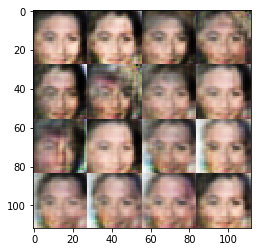

Timestamp 20170806-05-44-17.581 -  Epoch 1/1 -  Step 2610 -  D Loss: 1.6319 - G Loss: 0.8183
Timestamp 20170806-05-44-34.180 -  Epoch 1/1 -  Step 2620 -  D Loss: 0.9856 - G Loss: 1.5254
Timestamp 20170806-05-44-50.791 -  Epoch 1/1 -  Step 2630 -  D Loss: 0.9942 - G Loss: 1.4160
Timestamp 20170806-05-45-07.414 -  Epoch 1/1 -  Step 2640 -  D Loss: 1.3061 - G Loss: 0.6113
Timestamp 20170806-05-45-23.997 -  Epoch 1/1 -  Step 2650 -  D Loss: 1.0804 - G Loss: 1.3467
Timestamp 20170806-05-45-40.603 -  Epoch 1/1 -  Step 2660 -  D Loss: 0.8554 - G Loss: 1.4000
Timestamp 20170806-05-45-57.176 -  Epoch 1/1 -  Step 2670 -  D Loss: 0.9151 - G Loss: 1.6678
Timestamp 20170806-05-46-13.786 -  Epoch 1/1 -  Step 2680 -  D Loss: 1.0792 - G Loss: 1.2437
Timestamp 20170806-05-46-30.394 -  Epoch 1/1 -  Step 2690 -  D Loss: 0.9315 - G Loss: 1.5261
Timestamp 20170806-05-46-46.992 -  Epoch 1/1 -  Step 2700 -  D Loss: 1.2385 - G Loss: 1.2177


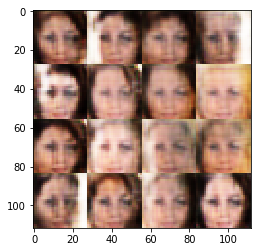

Timestamp 20170806-05-47-04.265 -  Epoch 1/1 -  Step 2710 -  D Loss: 1.4522 - G Loss: 0.8826
Timestamp 20170806-05-47-20.881 -  Epoch 1/1 -  Step 2720 -  D Loss: 1.2132 - G Loss: 1.1791
Timestamp 20170806-05-47-37.484 -  Epoch 1/1 -  Step 2730 -  D Loss: 1.1193 - G Loss: 1.1359
Timestamp 20170806-05-47-54.104 -  Epoch 1/1 -  Step 2740 -  D Loss: 1.0488 - G Loss: 1.9067
Timestamp 20170806-05-48-10.711 -  Epoch 1/1 -  Step 2750 -  D Loss: 1.1786 - G Loss: 0.9952
Timestamp 20170806-05-48-27.307 -  Epoch 1/1 -  Step 2760 -  D Loss: 1.0580 - G Loss: 1.1790
Timestamp 20170806-05-48-43.893 -  Epoch 1/1 -  Step 2770 -  D Loss: 0.9372 - G Loss: 1.6167
Timestamp 20170806-05-49-00.507 -  Epoch 1/1 -  Step 2780 -  D Loss: 1.3636 - G Loss: 0.8985
Timestamp 20170806-05-49-17.110 -  Epoch 1/1 -  Step 2790 -  D Loss: 1.0405 - G Loss: 0.9103
Timestamp 20170806-05-49-33.725 -  Epoch 1/1 -  Step 2800 -  D Loss: 1.2402 - G Loss: 1.1265


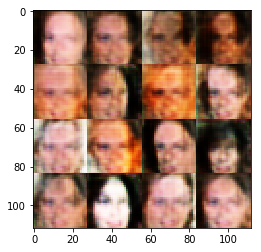

Timestamp 20170806-05-49-51.026 -  Epoch 1/1 -  Step 2810 -  D Loss: 1.1046 - G Loss: 1.6407
Timestamp 20170806-05-50-07.621 -  Epoch 1/1 -  Step 2820 -  D Loss: 0.8789 - G Loss: 1.5101
Timestamp 20170806-05-50-24.200 -  Epoch 1/1 -  Step 2830 -  D Loss: 0.8971 - G Loss: 1.3521
Timestamp 20170806-05-50-40.789 -  Epoch 1/1 -  Step 2840 -  D Loss: 1.0591 - G Loss: 1.9891
Timestamp 20170806-05-50-57.376 -  Epoch 1/1 -  Step 2850 -  D Loss: 0.9698 - G Loss: 1.2662
Timestamp 20170806-05-51-13.958 -  Epoch 1/1 -  Step 2860 -  D Loss: 0.7398 - G Loss: 2.3245
Timestamp 20170806-05-51-30.539 -  Epoch 1/1 -  Step 2870 -  D Loss: 0.9061 - G Loss: 1.7832
Timestamp 20170806-05-51-47.129 -  Epoch 1/1 -  Step 2880 -  D Loss: 1.0207 - G Loss: 1.0854
Timestamp 20170806-05-52-03.736 -  Epoch 1/1 -  Step 2890 -  D Loss: 1.0194 - G Loss: 1.1996
Timestamp 20170806-05-52-20.354 -  Epoch 1/1 -  Step 2900 -  D Loss: 1.0456 - G Loss: 1.3156


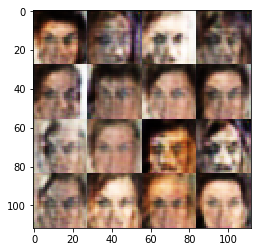

Timestamp 20170806-05-52-37.647 -  Epoch 1/1 -  Step 2910 -  D Loss: 1.0912 - G Loss: 0.9162
Timestamp 20170806-05-52-54.255 -  Epoch 1/1 -  Step 2920 -  D Loss: 1.2640 - G Loss: 0.5818
Timestamp 20170806-05-53-10.862 -  Epoch 1/1 -  Step 2930 -  D Loss: 1.3420 - G Loss: 0.8213
Timestamp 20170806-05-53-27.478 -  Epoch 1/1 -  Step 2940 -  D Loss: 1.0588 - G Loss: 0.8512
Timestamp 20170806-05-53-44.119 -  Epoch 1/1 -  Step 2950 -  D Loss: 0.9182 - G Loss: 1.6593
Timestamp 20170806-05-54-00.721 -  Epoch 1/1 -  Step 2960 -  D Loss: 1.1527 - G Loss: 1.1374
Timestamp 20170806-05-54-17.306 -  Epoch 1/1 -  Step 2970 -  D Loss: 0.9828 - G Loss: 1.9295
Timestamp 20170806-05-54-33.912 -  Epoch 1/1 -  Step 2980 -  D Loss: 1.3549 - G Loss: 1.0671
Timestamp 20170806-05-54-50.502 -  Epoch 1/1 -  Step 2990 -  D Loss: 0.9882 - G Loss: 1.1171
Timestamp 20170806-05-55-07.106 -  Epoch 1/1 -  Step 3000 -  D Loss: 1.8499 - G Loss: 1.0581


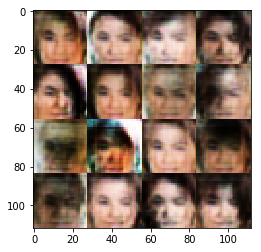

Timestamp 20170806-05-55-24.369 -  Epoch 1/1 -  Step 3010 -  D Loss: 0.9694 - G Loss: 0.9818
Timestamp 20170806-05-55-40.977 -  Epoch 1/1 -  Step 3020 -  D Loss: 1.0114 - G Loss: 1.4695
Timestamp 20170806-05-55-57.559 -  Epoch 1/1 -  Step 3030 -  D Loss: 1.2061 - G Loss: 1.3375
Timestamp 20170806-05-56-14.147 -  Epoch 1/1 -  Step 3040 -  D Loss: 0.9066 - G Loss: 1.1318
Timestamp 20170806-05-56-30.749 -  Epoch 1/1 -  Step 3050 -  D Loss: 0.9602 - G Loss: 1.3385
Timestamp 20170806-05-56-47.361 -  Epoch 1/1 -  Step 3060 -  D Loss: 1.2966 - G Loss: 0.7237
Timestamp 20170806-05-57-03.966 -  Epoch 1/1 -  Step 3070 -  D Loss: 1.0690 - G Loss: 1.6571
Timestamp 20170806-05-57-20.561 -  Epoch 1/1 -  Step 3080 -  D Loss: 1.0499 - G Loss: 1.4904
Timestamp 20170806-05-57-37.199 -  Epoch 1/1 -  Step 3090 -  D Loss: 1.0676 - G Loss: 0.9678
Timestamp 20170806-05-57-53.805 -  Epoch 1/1 -  Step 3100 -  D Loss: 1.1615 - G Loss: 1.2032


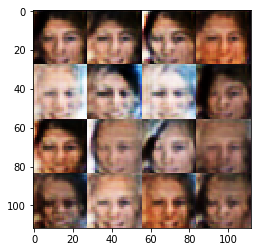

Timestamp 20170806-05-58-11.083 -  Epoch 1/1 -  Step 3110 -  D Loss: 1.4370 - G Loss: 1.0818
Timestamp 20170806-05-58-27.702 -  Epoch 1/1 -  Step 3120 -  D Loss: 1.3297 - G Loss: 0.9973
Timestamp 20170806-05-58-44.328 -  Epoch 1/1 -  Step 3130 -  D Loss: 1.4405 - G Loss: 0.8705
Timestamp 20170806-05-59-00.954 -  Epoch 1/1 -  Step 3140 -  D Loss: 1.0953 - G Loss: 0.8198
Timestamp 20170806-05-59-17.551 -  Epoch 1/1 -  Step 3150 -  D Loss: 1.3337 - G Loss: 1.8379
Timestamp 20170806-05-59-34.155 -  Epoch 1/1 -  Step 3160 -  D Loss: 1.1218 - G Loss: 1.5617
Timestamp 20170806-05-59-50.734 -  Epoch 1/1 -  Step 3170 -  D Loss: 0.8975 - G Loss: 1.5910
Timestamp 20170806-06-00-07.354 -  Epoch 1/1 -  Step 3180 -  D Loss: 1.1695 - G Loss: 1.2684
Timestamp 20170806-06-00-23.938 -  Epoch 1/1 -  Step 3190 -  D Loss: 0.9780 - G Loss: 1.2724
Timestamp 20170806-06-00-40.547 -  Epoch 1/1 -  Step 3200 -  D Loss: 0.7635 - G Loss: 1.3990


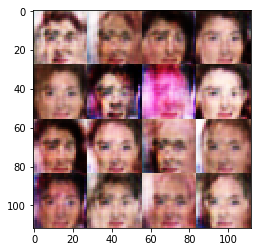

Timestamp 20170806-06-00-57.812 -  Epoch 1/1 -  Step 3210 -  D Loss: 1.1023 - G Loss: 1.1057
Timestamp 20170806-06-01-14.414 -  Epoch 1/1 -  Step 3220 -  D Loss: 1.1064 - G Loss: 1.0936
Timestamp 20170806-06-01-30.998 -  Epoch 1/1 -  Step 3230 -  D Loss: 1.0212 - G Loss: 1.2322
Timestamp 20170806-06-01-47.598 -  Epoch 1/1 -  Step 3240 -  D Loss: 1.2924 - G Loss: 0.6979
Timestamp 20170806-06-02-04.200 -  Epoch 1/1 -  Step 3250 -  D Loss: 1.0730 - G Loss: 1.2020
Timestamp 20170806-06-02-20.798 -  Epoch 1/1 -  Step 3260 -  D Loss: 1.5468 - G Loss: 0.7702
Timestamp 20170806-06-02-37.411 -  Epoch 1/1 -  Step 3270 -  D Loss: 0.9863 - G Loss: 1.4792
Timestamp 20170806-06-02-54.013 -  Epoch 1/1 -  Step 3280 -  D Loss: 1.4747 - G Loss: 0.3740
Timestamp 20170806-06-03-10.595 -  Epoch 1/1 -  Step 3290 -  D Loss: 0.9657 - G Loss: 1.3360
Timestamp 20170806-06-03-27.199 -  Epoch 1/1 -  Step 3300 -  D Loss: 1.6288 - G Loss: 0.9771


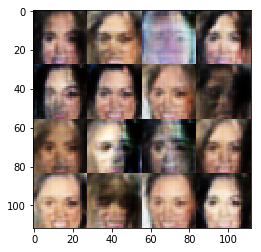

Timestamp 20170806-06-03-44.483 -  Epoch 1/1 -  Step 3310 -  D Loss: 1.6177 - G Loss: 0.6022
Timestamp 20170806-06-04-01.077 -  Epoch 1/1 -  Step 3320 -  D Loss: 1.1697 - G Loss: 0.8755
Timestamp 20170806-06-04-17.666 -  Epoch 1/1 -  Step 3330 -  D Loss: 1.0402 - G Loss: 1.2515
Timestamp 20170806-06-04-34.267 -  Epoch 1/1 -  Step 3340 -  D Loss: 1.8300 - G Loss: 0.6362
Timestamp 20170806-06-04-50.872 -  Epoch 1/1 -  Step 3350 -  D Loss: 0.9252 - G Loss: 1.3147
Timestamp 20170806-06-05-07.459 -  Epoch 1/1 -  Step 3360 -  D Loss: 1.3421 - G Loss: 1.1548
Timestamp 20170806-06-05-24.065 -  Epoch 1/1 -  Step 3370 -  D Loss: 0.8433 - G Loss: 1.0846
Timestamp 20170806-06-05-40.661 -  Epoch 1/1 -  Step 3380 -  D Loss: 0.9802 - G Loss: 1.1298
Timestamp 20170806-06-05-57.249 -  Epoch 1/1 -  Step 3390 -  D Loss: 1.1423 - G Loss: 1.2315
Timestamp 20170806-06-06-13.831 -  Epoch 1/1 -  Step 3400 -  D Loss: 1.3281 - G Loss: 0.9493


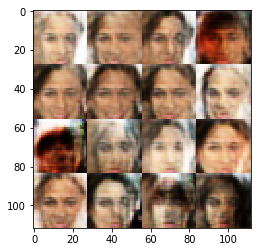

Timestamp 20170806-06-06-31.064 -  Epoch 1/1 -  Step 3410 -  D Loss: 0.7755 - G Loss: 1.5761
Timestamp 20170806-06-06-47.654 -  Epoch 1/1 -  Step 3420 -  D Loss: 0.9803 - G Loss: 0.8379
Timestamp 20170806-06-07-04.251 -  Epoch 1/1 -  Step 3430 -  D Loss: 1.0941 - G Loss: 0.7286
Timestamp 20170806-06-07-20.865 -  Epoch 1/1 -  Step 3440 -  D Loss: 1.3936 - G Loss: 1.1312
Timestamp 20170806-06-07-37.474 -  Epoch 1/1 -  Step 3450 -  D Loss: 1.0166 - G Loss: 0.9526
Timestamp 20170806-06-07-54.078 -  Epoch 1/1 -  Step 3460 -  D Loss: 1.0298 - G Loss: 0.8572
Timestamp 20170806-06-08-10.661 -  Epoch 1/1 -  Step 3470 -  D Loss: 0.9663 - G Loss: 0.8712
Timestamp 20170806-06-08-27.273 -  Epoch 1/1 -  Step 3480 -  D Loss: 1.2343 - G Loss: 1.3609
Timestamp 20170806-06-08-43.880 -  Epoch 1/1 -  Step 3490 -  D Loss: 1.4576 - G Loss: 0.5418
Timestamp 20170806-06-09-00.481 -  Epoch 1/1 -  Step 3500 -  D Loss: 1.2740 - G Loss: 1.0349


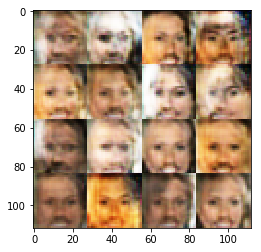

Timestamp 20170806-06-09-17.764 -  Epoch 1/1 -  Step 3510 -  D Loss: 0.9469 - G Loss: 1.1646
Timestamp 20170806-06-09-34.372 -  Epoch 1/1 -  Step 3520 -  D Loss: 1.1234 - G Loss: 1.8377
Timestamp 20170806-06-09-50.992 -  Epoch 1/1 -  Step 3530 -  D Loss: 0.9722 - G Loss: 1.5421
Timestamp 20170806-06-10-07.598 -  Epoch 1/1 -  Step 3540 -  D Loss: 1.3442 - G Loss: 0.7710
Timestamp 20170806-06-10-24.187 -  Epoch 1/1 -  Step 3550 -  D Loss: 1.0905 - G Loss: 1.3352
Timestamp 20170806-06-10-40.807 -  Epoch 1/1 -  Step 3560 -  D Loss: 0.8947 - G Loss: 2.0081
Timestamp 20170806-06-10-57.413 -  Epoch 1/1 -  Step 3570 -  D Loss: 1.1653 - G Loss: 0.8190
Timestamp 20170806-06-11-14.020 -  Epoch 1/1 -  Step 3580 -  D Loss: 1.4171 - G Loss: 0.8706
Timestamp 20170806-06-11-30.621 -  Epoch 1/1 -  Step 3590 -  D Loss: 1.2144 - G Loss: 1.0868
Timestamp 20170806-06-11-47.218 -  Epoch 1/1 -  Step 3600 -  D Loss: 1.1081 - G Loss: 0.8240


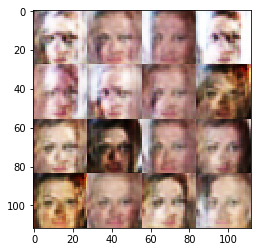

Timestamp 20170806-06-12-04.548 -  Epoch 1/1 -  Step 3610 -  D Loss: 0.9886 - G Loss: 0.9587
Timestamp 20170806-06-12-21.145 -  Epoch 1/1 -  Step 3620 -  D Loss: 0.9549 - G Loss: 1.1037
Timestamp 20170806-06-12-37.734 -  Epoch 1/1 -  Step 3630 -  D Loss: 1.1769 - G Loss: 1.2107
Timestamp 20170806-06-12-54.324 -  Epoch 1/1 -  Step 3640 -  D Loss: 0.8200 - G Loss: 1.1908
Timestamp 20170806-06-13-10.932 -  Epoch 1/1 -  Step 3650 -  D Loss: 1.2110 - G Loss: 0.7822
Timestamp 20170806-06-13-27.523 -  Epoch 1/1 -  Step 3660 -  D Loss: 0.8900 - G Loss: 1.3250
Timestamp 20170806-06-13-44.126 -  Epoch 1/1 -  Step 3670 -  D Loss: 0.8555 - G Loss: 1.5146
Timestamp 20170806-06-14-00.709 -  Epoch 1/1 -  Step 3680 -  D Loss: 1.0209 - G Loss: 1.2564
Timestamp 20170806-06-14-17.321 -  Epoch 1/1 -  Step 3690 -  D Loss: 1.0859 - G Loss: 1.0580
Timestamp 20170806-06-14-33.918 -  Epoch 1/1 -  Step 3700 -  D Loss: 1.0141 - G Loss: 1.3165


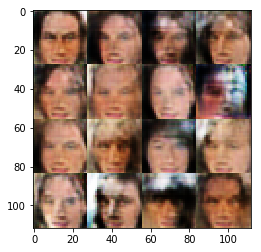

Timestamp 20170806-06-14-51.203 -  Epoch 1/1 -  Step 3710 -  D Loss: 0.9793 - G Loss: 0.8002
Timestamp 20170806-06-15-07.822 -  Epoch 1/1 -  Step 3720 -  D Loss: 1.1200 - G Loss: 0.9009
Timestamp 20170806-06-15-24.430 -  Epoch 1/1 -  Step 3730 -  D Loss: 0.8818 - G Loss: 1.4339
Timestamp 20170806-06-15-41.020 -  Epoch 1/1 -  Step 3740 -  D Loss: 0.9619 - G Loss: 1.2858
Timestamp 20170806-06-15-57.626 -  Epoch 1/1 -  Step 3750 -  D Loss: 1.2840 - G Loss: 0.9756
Timestamp 20170806-06-16-14.225 -  Epoch 1/1 -  Step 3760 -  D Loss: 0.8848 - G Loss: 1.2828
Timestamp 20170806-06-16-30.816 -  Epoch 1/1 -  Step 3770 -  D Loss: 0.9902 - G Loss: 1.3054
Timestamp 20170806-06-16-47.392 -  Epoch 1/1 -  Step 3780 -  D Loss: 0.6672 - G Loss: 1.4312
Timestamp 20170806-06-17-04.005 -  Epoch 1/1 -  Step 3790 -  D Loss: 1.1545 - G Loss: 0.9014
Timestamp 20170806-06-17-20.605 -  Epoch 1/1 -  Step 3800 -  D Loss: 1.1621 - G Loss: 1.0426


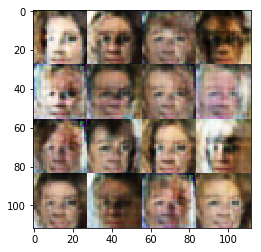

Timestamp 20170806-06-17-37.912 -  Epoch 1/1 -  Step 3810 -  D Loss: 1.0887 - G Loss: 1.3217
Timestamp 20170806-06-17-54.521 -  Epoch 1/1 -  Step 3820 -  D Loss: 1.2997 - G Loss: 0.7883
Timestamp 20170806-06-18-11.114 -  Epoch 1/1 -  Step 3830 -  D Loss: 0.8335 - G Loss: 1.5024
Timestamp 20170806-06-18-27.723 -  Epoch 1/1 -  Step 3840 -  D Loss: 1.0567 - G Loss: 1.0988
Timestamp 20170806-06-18-44.319 -  Epoch 1/1 -  Step 3850 -  D Loss: 1.0400 - G Loss: 0.9528
Timestamp 20170806-06-19-00.901 -  Epoch 1/1 -  Step 3860 -  D Loss: 1.0242 - G Loss: 1.2924
Timestamp 20170806-06-19-17.494 -  Epoch 1/1 -  Step 3870 -  D Loss: 0.9451 - G Loss: 2.1277
Timestamp 20170806-06-19-34.111 -  Epoch 1/1 -  Step 3880 -  D Loss: 1.4471 - G Loss: 0.4379
Timestamp 20170806-06-19-50.690 -  Epoch 1/1 -  Step 3890 -  D Loss: 0.9732 - G Loss: 1.6730
Timestamp 20170806-06-20-07.272 -  Epoch 1/1 -  Step 3900 -  D Loss: 0.9899 - G Loss: 0.9633


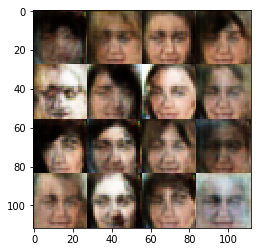

Timestamp 20170806-06-20-24.567 -  Epoch 1/1 -  Step 3910 -  D Loss: 1.1389 - G Loss: 0.7333
Timestamp 20170806-06-20-41.140 -  Epoch 1/1 -  Step 3920 -  D Loss: 1.4262 - G Loss: 0.3499
Timestamp 20170806-06-20-57.763 -  Epoch 1/1 -  Step 3930 -  D Loss: 0.9654 - G Loss: 1.5723
Timestamp 20170806-06-21-14.348 -  Epoch 1/1 -  Step 3940 -  D Loss: 0.9806 - G Loss: 1.5333
Timestamp 20170806-06-21-30.943 -  Epoch 1/1 -  Step 3950 -  D Loss: 1.0153 - G Loss: 1.0420
Timestamp 20170806-06-21-47.547 -  Epoch 1/1 -  Step 3960 -  D Loss: 1.0359 - G Loss: 1.7291
Timestamp 20170806-06-22-04.145 -  Epoch 1/1 -  Step 3970 -  D Loss: 1.2269 - G Loss: 0.8405
Timestamp 20170806-06-22-20.738 -  Epoch 1/1 -  Step 3980 -  D Loss: 0.9530 - G Loss: 1.4522
Timestamp 20170806-06-22-37.355 -  Epoch 1/1 -  Step 3990 -  D Loss: 1.0285 - G Loss: 1.0404
Timestamp 20170806-06-22-53.975 -  Epoch 1/1 -  Step 4000 -  D Loss: 1.0242 - G Loss: 1.2144


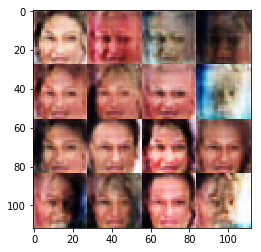

Timestamp 20170806-06-23-11.286 -  Epoch 1/1 -  Step 4010 -  D Loss: 0.7600 - G Loss: 1.1607
Timestamp 20170806-06-23-27.886 -  Epoch 1/1 -  Step 4020 -  D Loss: 1.2968 - G Loss: 1.1639
Timestamp 20170806-06-23-44.502 -  Epoch 1/1 -  Step 4030 -  D Loss: 0.7389 - G Loss: 2.1113
Timestamp 20170806-06-24-01.086 -  Epoch 1/1 -  Step 4040 -  D Loss: 1.4308 - G Loss: 0.7855
Timestamp 20170806-06-24-17.692 -  Epoch 1/1 -  Step 4050 -  D Loss: 1.3501 - G Loss: 1.4702
Timestamp 20170806-06-24-34.283 -  Epoch 1/1 -  Step 4060 -  D Loss: 0.9448 - G Loss: 1.4424
Timestamp 20170806-06-24-50.890 -  Epoch 1/1 -  Step 4070 -  D Loss: 1.2526 - G Loss: 1.4314
Timestamp 20170806-06-25-07.465 -  Epoch 1/1 -  Step 4080 -  D Loss: 1.3030 - G Loss: 0.7677
Timestamp 20170806-06-25-24.070 -  Epoch 1/1 -  Step 4090 -  D Loss: 1.1217 - G Loss: 0.9593
Timestamp 20170806-06-25-40.656 -  Epoch 1/1 -  Step 4100 -  D Loss: 1.5749 - G Loss: 0.8391


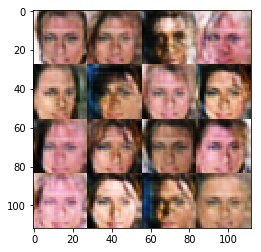

Timestamp 20170806-06-25-57.983 -  Epoch 1/1 -  Step 4110 -  D Loss: 1.4930 - G Loss: 0.8092
Timestamp 20170806-06-26-14.581 -  Epoch 1/1 -  Step 4120 -  D Loss: 1.1223 - G Loss: 1.0942
Timestamp 20170806-06-26-31.171 -  Epoch 1/1 -  Step 4130 -  D Loss: 1.1909 - G Loss: 0.8040
Timestamp 20170806-06-26-47.780 -  Epoch 1/1 -  Step 4140 -  D Loss: 1.4270 - G Loss: 1.0421
Timestamp 20170806-06-27-04.378 -  Epoch 1/1 -  Step 4150 -  D Loss: 1.0141 - G Loss: 1.1143
Timestamp 20170806-06-27-20.991 -  Epoch 1/1 -  Step 4160 -  D Loss: 1.4667 - G Loss: 1.2268
Timestamp 20170806-06-27-37.592 -  Epoch 1/1 -  Step 4170 -  D Loss: 1.3295 - G Loss: 1.0269
Timestamp 20170806-06-27-54.191 -  Epoch 1/1 -  Step 4180 -  D Loss: 1.3048 - G Loss: 1.2030
Timestamp 20170806-06-28-10.787 -  Epoch 1/1 -  Step 4190 -  D Loss: 0.9266 - G Loss: 2.1794
Timestamp 20170806-06-28-27.395 -  Epoch 1/1 -  Step 4200 -  D Loss: 1.0485 - G Loss: 1.3305


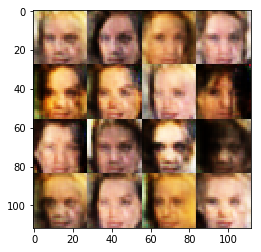

Timestamp 20170806-06-28-44.645 -  Epoch 1/1 -  Step 4210 -  D Loss: 1.2473 - G Loss: 0.8509
Timestamp 20170806-06-29-01.235 -  Epoch 1/1 -  Step 4220 -  D Loss: 1.1548 - G Loss: 1.6054
Timestamp 20170806-06-29-17.823 -  Epoch 1/1 -  Step 4230 -  D Loss: 1.4043 - G Loss: 1.0483
Timestamp 20170806-06-29-34.432 -  Epoch 1/1 -  Step 4240 -  D Loss: 1.4783 - G Loss: 0.6803
Timestamp 20170806-06-29-51.047 -  Epoch 1/1 -  Step 4250 -  D Loss: 1.2324 - G Loss: 0.7307
Timestamp 20170806-06-30-07.665 -  Epoch 1/1 -  Step 4260 -  D Loss: 1.2628 - G Loss: 0.7669
Timestamp 20170806-06-30-24.258 -  Epoch 1/1 -  Step 4270 -  D Loss: 1.0755 - G Loss: 1.4324
Timestamp 20170806-06-30-40.886 -  Epoch 1/1 -  Step 4280 -  D Loss: 1.4201 - G Loss: 0.6589
Timestamp 20170806-06-30-57.480 -  Epoch 1/1 -  Step 4290 -  D Loss: 0.8348 - G Loss: 1.2030
Timestamp 20170806-06-31-14.072 -  Epoch 1/1 -  Step 4300 -  D Loss: 1.0435 - G Loss: 1.9580


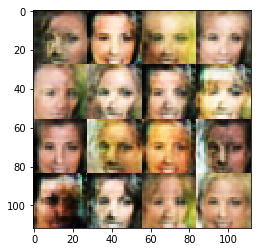

Timestamp 20170806-06-31-31.363 -  Epoch 1/1 -  Step 4310 -  D Loss: 1.2743 - G Loss: 0.9213
Timestamp 20170806-06-31-47.971 -  Epoch 1/1 -  Step 4320 -  D Loss: 0.8242 - G Loss: 1.3747
Timestamp 20170806-06-32-04.545 -  Epoch 1/1 -  Step 4330 -  D Loss: 1.5040 - G Loss: 0.9340
Timestamp 20170806-06-32-21.160 -  Epoch 1/1 -  Step 4340 -  D Loss: 1.3651 - G Loss: 0.7795
Timestamp 20170806-06-32-37.754 -  Epoch 1/1 -  Step 4350 -  D Loss: 0.7278 - G Loss: 2.0361
Timestamp 20170806-06-32-54.338 -  Epoch 1/1 -  Step 4360 -  D Loss: 1.4337 - G Loss: 1.0434
Timestamp 20170806-06-33-10.939 -  Epoch 1/1 -  Step 4370 -  D Loss: 0.9698 - G Loss: 1.1147
Timestamp 20170806-06-33-27.555 -  Epoch 1/1 -  Step 4380 -  D Loss: 1.2100 - G Loss: 1.1461
Timestamp 20170806-06-33-44.166 -  Epoch 1/1 -  Step 4390 -  D Loss: 0.7489 - G Loss: 2.1704
Timestamp 20170806-06-34-00.781 -  Epoch 1/1 -  Step 4400 -  D Loss: 1.2629 - G Loss: 0.6807


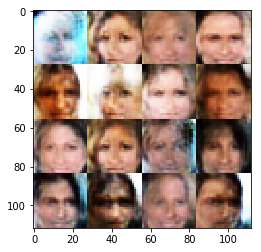

Timestamp 20170806-06-34-18.058 -  Epoch 1/1 -  Step 4410 -  D Loss: 1.1406 - G Loss: 1.0852
Timestamp 20170806-06-34-34.667 -  Epoch 1/1 -  Step 4420 -  D Loss: 1.0865 - G Loss: 1.3344
Timestamp 20170806-06-34-51.267 -  Epoch 1/1 -  Step 4430 -  D Loss: 1.2569 - G Loss: 0.6938
Timestamp 20170806-06-35-07.870 -  Epoch 1/1 -  Step 4440 -  D Loss: 0.9715 - G Loss: 1.2314
Timestamp 20170806-06-35-24.454 -  Epoch 1/1 -  Step 4450 -  D Loss: 1.1042 - G Loss: 0.6844
Timestamp 20170806-06-35-41.050 -  Epoch 1/1 -  Step 4460 -  D Loss: 1.1811 - G Loss: 1.0778
Timestamp 20170806-06-35-57.649 -  Epoch 1/1 -  Step 4470 -  D Loss: 1.0596 - G Loss: 1.2933
Timestamp 20170806-06-36-14.229 -  Epoch 1/1 -  Step 4480 -  D Loss: 1.3105 - G Loss: 1.0026
Timestamp 20170806-06-36-30.826 -  Epoch 1/1 -  Step 4490 -  D Loss: 1.1845 - G Loss: 1.0147
Timestamp 20170806-06-36-47.434 -  Epoch 1/1 -  Step 4500 -  D Loss: 1.1137 - G Loss: 0.8154


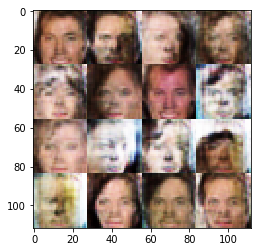

Timestamp 20170806-06-37-04.737 -  Epoch 1/1 -  Step 4510 -  D Loss: 0.8250 - G Loss: 1.0500
Timestamp 20170806-06-37-21.354 -  Epoch 1/1 -  Step 4520 -  D Loss: 1.3043 - G Loss: 0.6039
Timestamp 20170806-06-37-37.991 -  Epoch 1/1 -  Step 4530 -  D Loss: 1.2834 - G Loss: 0.7510
Timestamp 20170806-06-37-54.573 -  Epoch 1/1 -  Step 4540 -  D Loss: 1.0778 - G Loss: 1.5720
Timestamp 20170806-06-38-11.188 -  Epoch 1/1 -  Step 4550 -  D Loss: 1.0723 - G Loss: 1.3048
Timestamp 20170806-06-38-27.784 -  Epoch 1/1 -  Step 4560 -  D Loss: 1.0268 - G Loss: 0.8929
Timestamp 20170806-06-38-44.377 -  Epoch 1/1 -  Step 4570 -  D Loss: 1.0866 - G Loss: 1.1114
Timestamp 20170806-06-39-00.978 -  Epoch 1/1 -  Step 4580 -  D Loss: 1.0335 - G Loss: 1.3798
Timestamp 20170806-06-39-17.582 -  Epoch 1/1 -  Step 4590 -  D Loss: 0.7406 - G Loss: 1.6709
Timestamp 20170806-06-39-34.202 -  Epoch 1/1 -  Step 4600 -  D Loss: 1.0914 - G Loss: 0.9524


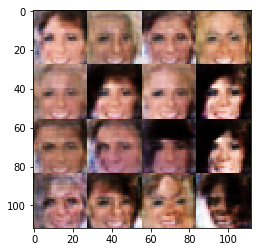

Timestamp 20170806-06-39-51.524 -  Epoch 1/1 -  Step 4610 -  D Loss: 1.1133 - G Loss: 1.0470
Timestamp 20170806-06-40-08.114 -  Epoch 1/1 -  Step 4620 -  D Loss: 0.8848 - G Loss: 1.4651
Timestamp 20170806-06-40-24.713 -  Epoch 1/1 -  Step 4630 -  D Loss: 0.9180 - G Loss: 1.1841
Timestamp 20170806-06-40-41.335 -  Epoch 1/1 -  Step 4640 -  D Loss: 0.9321 - G Loss: 1.2182
Timestamp 20170806-06-40-57.911 -  Epoch 1/1 -  Step 4650 -  D Loss: 1.0269 - G Loss: 1.1316
Timestamp 20170806-06-41-14.513 -  Epoch 1/1 -  Step 4660 -  D Loss: 1.4080 - G Loss: 0.7747
Timestamp 20170806-06-41-31.103 -  Epoch 1/1 -  Step 4670 -  D Loss: 0.8398 - G Loss: 1.2796
Timestamp 20170806-06-41-47.718 -  Epoch 1/1 -  Step 4680 -  D Loss: 1.2092 - G Loss: 0.9801
Timestamp 20170806-06-42-04.278 -  Epoch 1/1 -  Step 4690 -  D Loss: 1.2610 - G Loss: 1.4206
Timestamp 20170806-06-42-20.853 -  Epoch 1/1 -  Step 4700 -  D Loss: 1.1773 - G Loss: 0.7909


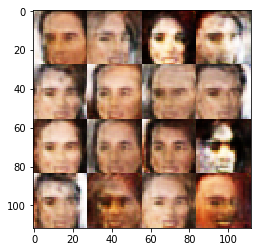

Timestamp 20170806-06-42-38.093 -  Epoch 1/1 -  Step 4710 -  D Loss: 0.9943 - G Loss: 1.0146
Timestamp 20170806-06-42-54.641 -  Epoch 1/1 -  Step 4720 -  D Loss: 0.9598 - G Loss: 1.3121
Timestamp 20170806-06-43-11.206 -  Epoch 1/1 -  Step 4730 -  D Loss: 1.2908 - G Loss: 1.2577
Timestamp 20170806-06-43-27.774 -  Epoch 1/1 -  Step 4740 -  D Loss: 1.3554 - G Loss: 1.1860
Timestamp 20170806-06-43-44.331 -  Epoch 1/1 -  Step 4750 -  D Loss: 1.1832 - G Loss: 1.2333
Timestamp 20170806-06-44-00.897 -  Epoch 1/1 -  Step 4760 -  D Loss: 0.9942 - G Loss: 1.1759
Timestamp 20170806-06-44-17.455 -  Epoch 1/1 -  Step 4770 -  D Loss: 0.9333 - G Loss: 1.6150
Timestamp 20170806-06-44-34.007 -  Epoch 1/1 -  Step 4780 -  D Loss: 1.0238 - G Loss: 1.2056
Timestamp 20170806-06-44-50.568 -  Epoch 1/1 -  Step 4790 -  D Loss: 1.2995 - G Loss: 0.8787
Timestamp 20170806-06-45-07.110 -  Epoch 1/1 -  Step 4800 -  D Loss: 1.0470 - G Loss: 1.5390


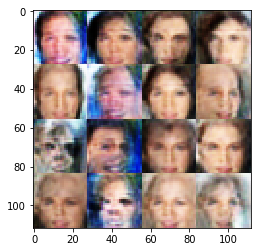

Timestamp 20170806-06-45-24.362 -  Epoch 1/1 -  Step 4810 -  D Loss: 1.5120 - G Loss: 1.1101
Timestamp 20170806-06-45-40.923 -  Epoch 1/1 -  Step 4820 -  D Loss: 1.6333 - G Loss: 0.7320
Timestamp 20170806-06-45-57.505 -  Epoch 1/1 -  Step 4830 -  D Loss: 1.1388 - G Loss: 1.4936
Timestamp 20170806-06-46-14.056 -  Epoch 1/1 -  Step 4840 -  D Loss: 1.0657 - G Loss: 0.7397
Timestamp 20170806-06-46-30.613 -  Epoch 1/1 -  Step 4850 -  D Loss: 1.1250 - G Loss: 0.8416
Timestamp 20170806-06-46-47.174 -  Epoch 1/1 -  Step 4860 -  D Loss: 1.4194 - G Loss: 0.9641
Timestamp 20170806-06-47-03.774 -  Epoch 1/1 -  Step 4870 -  D Loss: 1.1852 - G Loss: 1.0815
Timestamp 20170806-06-47-20.342 -  Epoch 1/1 -  Step 4880 -  D Loss: 0.9561 - G Loss: 1.2137
Timestamp 20170806-06-47-36.907 -  Epoch 1/1 -  Step 4890 -  D Loss: 0.9107 - G Loss: 1.9125
Timestamp 20170806-06-47-53.451 -  Epoch 1/1 -  Step 4900 -  D Loss: 1.1692 - G Loss: 1.7511


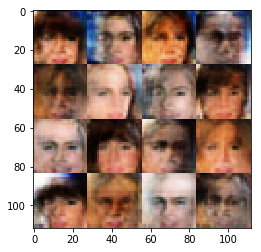

Timestamp 20170806-06-48-11.693 -  Epoch 1/1 -  Step 4910 -  D Loss: 1.2647 - G Loss: 0.8828
Timestamp 20170806-06-48-28.246 -  Epoch 1/1 -  Step 4920 -  D Loss: 1.1849 - G Loss: 0.9843
Timestamp 20170806-06-48-44.809 -  Epoch 1/1 -  Step 4930 -  D Loss: 0.9442 - G Loss: 1.3351
Timestamp 20170806-06-49-01.396 -  Epoch 1/1 -  Step 4940 -  D Loss: 0.8042 - G Loss: 1.5016
Timestamp 20170806-06-49-17.969 -  Epoch 1/1 -  Step 4950 -  D Loss: 1.2085 - G Loss: 0.8719
Timestamp 20170806-06-49-34.543 -  Epoch 1/1 -  Step 4960 -  D Loss: 1.2851 - G Loss: 0.5977
Timestamp 20170806-06-49-51.099 -  Epoch 1/1 -  Step 4970 -  D Loss: 1.1426 - G Loss: 1.4663
Timestamp 20170806-06-50-07.680 -  Epoch 1/1 -  Step 4980 -  D Loss: 1.6263 - G Loss: 0.4960
Timestamp 20170806-06-50-24.250 -  Epoch 1/1 -  Step 4990 -  D Loss: 1.0044 - G Loss: 0.9314
Timestamp 20170806-06-50-40.815 -  Epoch 1/1 -  Step 5000 -  D Loss: 0.9078 - G Loss: 0.9556


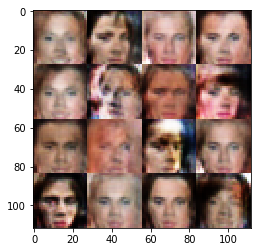

Timestamp 20170806-06-50-58.092 -  Epoch 1/1 -  Step 5010 -  D Loss: 1.1957 - G Loss: 1.4736
Timestamp 20170806-06-51-14.654 -  Epoch 1/1 -  Step 5020 -  D Loss: 1.0655 - G Loss: 1.2187
Timestamp 20170806-06-51-31.208 -  Epoch 1/1 -  Step 5030 -  D Loss: 1.5848 - G Loss: 1.1249
Timestamp 20170806-06-51-47.764 -  Epoch 1/1 -  Step 5040 -  D Loss: 1.3622 - G Loss: 1.3709
Timestamp 20170806-06-52-04.334 -  Epoch 1/1 -  Step 5050 -  D Loss: 1.5076 - G Loss: 0.8749
Timestamp 20170806-06-52-20.935 -  Epoch 1/1 -  Step 5060 -  D Loss: 1.2948 - G Loss: 0.9475
Timestamp 20170806-06-52-37.527 -  Epoch 1/1 -  Step 5070 -  D Loss: 0.7704 - G Loss: 1.3447
Timestamp 20170806-06-52-54.088 -  Epoch 1/1 -  Step 5080 -  D Loss: 1.0409 - G Loss: 1.2151
Timestamp 20170806-06-53-10.661 -  Epoch 1/1 -  Step 5090 -  D Loss: 1.0273 - G Loss: 1.0108
Timestamp 20170806-06-53-27.221 -  Epoch 1/1 -  Step 5100 -  D Loss: 0.9915 - G Loss: 0.9907


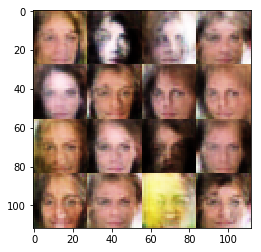

Timestamp 20170806-06-53-44.506 -  Epoch 1/1 -  Step 5110 -  D Loss: 1.4765 - G Loss: 0.5032
Timestamp 20170806-06-54-01.064 -  Epoch 1/1 -  Step 5120 -  D Loss: 1.1161 - G Loss: 0.7648
Timestamp 20170806-06-54-17.614 -  Epoch 1/1 -  Step 5130 -  D Loss: 1.0403 - G Loss: 1.2004
Timestamp 20170806-06-54-34.165 -  Epoch 1/1 -  Step 5140 -  D Loss: 0.9477 - G Loss: 1.1537
Timestamp 20170806-06-54-50.734 -  Epoch 1/1 -  Step 5150 -  D Loss: 0.8249 - G Loss: 1.2357
Timestamp 20170806-06-55-07.294 -  Epoch 1/1 -  Step 5160 -  D Loss: 1.1036 - G Loss: 1.6820
Timestamp 20170806-06-55-23.856 -  Epoch 1/1 -  Step 5170 -  D Loss: 1.2450 - G Loss: 1.4082
Timestamp 20170806-06-55-40.422 -  Epoch 1/1 -  Step 5180 -  D Loss: 0.7612 - G Loss: 1.6439
Timestamp 20170806-06-55-56.981 -  Epoch 1/1 -  Step 5190 -  D Loss: 1.1398 - G Loss: 1.5841
Timestamp 20170806-06-56-13.533 -  Epoch 1/1 -  Step 5200 -  D Loss: 1.3069 - G Loss: 0.9705


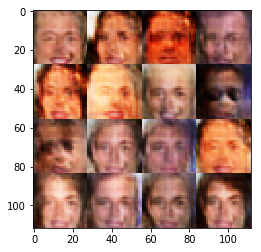

Timestamp 20170806-06-56-30.825 -  Epoch 1/1 -  Step 5210 -  D Loss: 1.2039 - G Loss: 1.1827
Timestamp 20170806-06-56-47.377 -  Epoch 1/1 -  Step 5220 -  D Loss: 1.1017 - G Loss: 0.9301
Timestamp 20170806-06-57-03.925 -  Epoch 1/1 -  Step 5230 -  D Loss: 0.9322 - G Loss: 1.0282
Timestamp 20170806-06-57-20.485 -  Epoch 1/1 -  Step 5240 -  D Loss: 1.0047 - G Loss: 0.9499
Timestamp 20170806-06-57-37.076 -  Epoch 1/1 -  Step 5250 -  D Loss: 1.0668 - G Loss: 1.1202
Timestamp 20170806-06-57-53.624 -  Epoch 1/1 -  Step 5260 -  D Loss: 1.3566 - G Loss: 0.7999
Timestamp 20170806-06-58-10.182 -  Epoch 1/1 -  Step 5270 -  D Loss: 1.1808 - G Loss: 0.7130
Timestamp 20170806-06-58-26.735 -  Epoch 1/1 -  Step 5280 -  D Loss: 1.1388 - G Loss: 1.2415
Timestamp 20170806-06-58-43.322 -  Epoch 1/1 -  Step 5290 -  D Loss: 0.9799 - G Loss: 1.5906
Timestamp 20170806-06-58-59.897 -  Epoch 1/1 -  Step 5300 -  D Loss: 1.3725 - G Loss: 0.8048


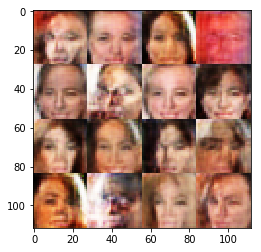

Timestamp 20170806-06-59-17.209 -  Epoch 1/1 -  Step 5310 -  D Loss: 1.0458 - G Loss: 1.5978
Timestamp 20170806-06-59-33.780 -  Epoch 1/1 -  Step 5320 -  D Loss: 1.1211 - G Loss: 0.9910
Timestamp 20170806-06-59-50.322 -  Epoch 1/1 -  Step 5330 -  D Loss: 1.2914 - G Loss: 0.6352
Timestamp 20170806-07-00-06.897 -  Epoch 1/1 -  Step 5340 -  D Loss: 1.2089 - G Loss: 1.0431
Timestamp 20170806-07-00-23.452 -  Epoch 1/1 -  Step 5350 -  D Loss: 1.3730 - G Loss: 0.7857
Timestamp 20170806-07-00-40.024 -  Epoch 1/1 -  Step 5360 -  D Loss: 1.1254 - G Loss: 1.4194
Timestamp 20170806-07-00-56.612 -  Epoch 1/1 -  Step 5370 -  D Loss: 0.9604 - G Loss: 2.0698
Timestamp 20170806-07-01-13.158 -  Epoch 1/1 -  Step 5380 -  D Loss: 1.3236 - G Loss: 0.6137
Timestamp 20170806-07-01-29.746 -  Epoch 1/1 -  Step 5390 -  D Loss: 1.0418 - G Loss: 1.1197
Timestamp 20170806-07-01-46.303 -  Epoch 1/1 -  Step 5400 -  D Loss: 1.3005 - G Loss: 0.7016


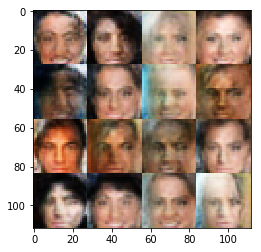

Timestamp 20170806-07-02-03.590 -  Epoch 1/1 -  Step 5410 -  D Loss: 0.9449 - G Loss: 1.1681
Timestamp 20170806-07-02-20.142 -  Epoch 1/1 -  Step 5420 -  D Loss: 1.2138 - G Loss: 0.9431
Timestamp 20170806-07-02-36.694 -  Epoch 1/1 -  Step 5430 -  D Loss: 1.0392 - G Loss: 1.2983
Timestamp 20170806-07-02-53.257 -  Epoch 1/1 -  Step 5440 -  D Loss: 1.1919 - G Loss: 1.3986
Timestamp 20170806-07-03-09.817 -  Epoch 1/1 -  Step 5450 -  D Loss: 1.1467 - G Loss: 0.9608
Timestamp 20170806-07-03-26.382 -  Epoch 1/1 -  Step 5460 -  D Loss: 1.3029 - G Loss: 1.1781
Timestamp 20170806-07-03-42.937 -  Epoch 1/1 -  Step 5470 -  D Loss: 1.0462 - G Loss: 0.7957
Timestamp 20170806-07-03-59.504 -  Epoch 1/1 -  Step 5480 -  D Loss: 1.2844 - G Loss: 1.0211
Timestamp 20170806-07-04-16.081 -  Epoch 1/1 -  Step 5490 -  D Loss: 0.9205 - G Loss: 1.1285
Timestamp 20170806-07-04-32.668 -  Epoch 1/1 -  Step 5500 -  D Loss: 1.1640 - G Loss: 0.7068


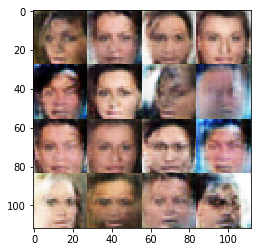

Timestamp 20170806-07-04-49.949 -  Epoch 1/1 -  Step 5510 -  D Loss: 1.3670 - G Loss: 1.1655
Timestamp 20170806-07-05-06.497 -  Epoch 1/1 -  Step 5520 -  D Loss: 1.1131 - G Loss: 0.5388
Timestamp 20170806-07-05-23.100 -  Epoch 1/1 -  Step 5530 -  D Loss: 0.9722 - G Loss: 1.3011
Timestamp 20170806-07-05-39.664 -  Epoch 1/1 -  Step 5540 -  D Loss: 1.1680 - G Loss: 0.6430
Timestamp 20170806-07-05-56.218 -  Epoch 1/1 -  Step 5550 -  D Loss: 1.2654 - G Loss: 0.8266
Timestamp 20170806-07-06-12.780 -  Epoch 1/1 -  Step 5560 -  D Loss: 1.3882 - G Loss: 1.2857
Timestamp 20170806-07-06-29.323 -  Epoch 1/1 -  Step 5570 -  D Loss: 1.0518 - G Loss: 1.4803
Timestamp 20170806-07-06-45.886 -  Epoch 1/1 -  Step 5580 -  D Loss: 1.0201 - G Loss: 1.1814
Timestamp 20170806-07-07-02.466 -  Epoch 1/1 -  Step 5590 -  D Loss: 1.0874 - G Loss: 1.2371
Timestamp 20170806-07-07-19.056 -  Epoch 1/1 -  Step 5600 -  D Loss: 1.1698 - G Loss: 0.9451


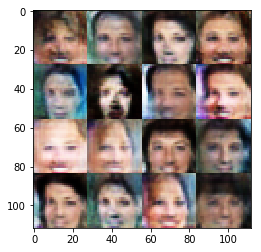

Timestamp 20170806-07-07-36.346 -  Epoch 1/1 -  Step 5610 -  D Loss: 1.2869 - G Loss: 0.6967
Timestamp 20170806-07-07-52.936 -  Epoch 1/1 -  Step 5620 -  D Loss: 1.0721 - G Loss: 0.9498
Timestamp 20170806-07-08-09.503 -  Epoch 1/1 -  Step 5630 -  D Loss: 1.2448 - G Loss: 1.5000
Timestamp 20170806-07-08-26.055 -  Epoch 1/1 -  Step 5640 -  D Loss: 1.0055 - G Loss: 1.2916
Timestamp 20170806-07-08-42.613 -  Epoch 1/1 -  Step 5650 -  D Loss: 1.3864 - G Loss: 0.7965
Timestamp 20170806-07-08-59.187 -  Epoch 1/1 -  Step 5660 -  D Loss: 0.9962 - G Loss: 1.2584
Timestamp 20170806-07-09-15.760 -  Epoch 1/1 -  Step 5670 -  D Loss: 1.3146 - G Loss: 1.0659
Timestamp 20170806-07-09-32.323 -  Epoch 1/1 -  Step 5680 -  D Loss: 1.2757 - G Loss: 1.0430
Timestamp 20170806-07-09-48.904 -  Epoch 1/1 -  Step 5690 -  D Loss: 0.9299 - G Loss: 1.4892
Timestamp 20170806-07-10-05.450 -  Epoch 1/1 -  Step 5700 -  D Loss: 0.8961 - G Loss: 1.0296


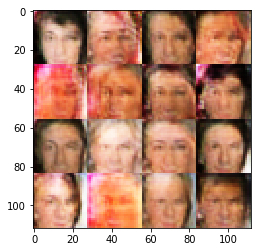

Timestamp 20170806-07-10-22.747 -  Epoch 1/1 -  Step 5710 -  D Loss: 1.0128 - G Loss: 1.5124
Timestamp 20170806-07-10-39.297 -  Epoch 1/1 -  Step 5720 -  D Loss: 1.3501 - G Loss: 0.8830
Timestamp 20170806-07-10-55.854 -  Epoch 1/1 -  Step 5730 -  D Loss: 1.1519 - G Loss: 0.8824
Timestamp 20170806-07-11-12.435 -  Epoch 1/1 -  Step 5740 -  D Loss: 1.3009 - G Loss: 0.8027
Timestamp 20170806-07-11-29.012 -  Epoch 1/1 -  Step 5750 -  D Loss: 1.4207 - G Loss: 0.6294
Timestamp 20170806-07-11-45.605 -  Epoch 1/1 -  Step 5760 -  D Loss: 1.0559 - G Loss: 1.1301
Timestamp 20170806-07-12-02.190 -  Epoch 1/1 -  Step 5770 -  D Loss: 0.9675 - G Loss: 1.3308
Timestamp 20170806-07-12-18.734 -  Epoch 1/1 -  Step 5780 -  D Loss: 0.8509 - G Loss: 1.4056
Timestamp 20170806-07-12-35.304 -  Epoch 1/1 -  Step 5790 -  D Loss: 1.0543 - G Loss: 1.1283
Timestamp 20170806-07-12-51.864 -  Epoch 1/1 -  Step 5800 -  D Loss: 0.9417 - G Loss: 1.2556


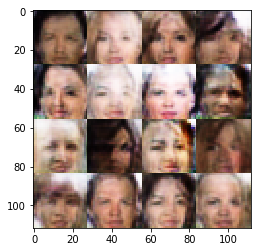

Timestamp 20170806-07-13-09.121 -  Epoch 1/1 -  Step 5810 -  D Loss: 1.2606 - G Loss: 0.8599
Timestamp 20170806-07-13-25.666 -  Epoch 1/1 -  Step 5820 -  D Loss: 1.1535 - G Loss: 1.1041
Timestamp 20170806-07-13-42.233 -  Epoch 1/1 -  Step 5830 -  D Loss: 1.2008 - G Loss: 0.9467
Timestamp 20170806-07-13-58.778 -  Epoch 1/1 -  Step 5840 -  D Loss: 1.3648 - G Loss: 1.3136
Timestamp 20170806-07-14-15.336 -  Epoch 1/1 -  Step 5850 -  D Loss: 1.2275 - G Loss: 1.2507
Timestamp 20170806-07-14-31.878 -  Epoch 1/1 -  Step 5860 -  D Loss: 1.0793 - G Loss: 1.0587
Timestamp 20170806-07-14-48.454 -  Epoch 1/1 -  Step 5870 -  D Loss: 1.0289 - G Loss: 1.1094
Timestamp 20170806-07-15-05.038 -  Epoch 1/1 -  Step 5880 -  D Loss: 1.0758 - G Loss: 1.2121
Timestamp 20170806-07-15-21.588 -  Epoch 1/1 -  Step 5890 -  D Loss: 1.1773 - G Loss: 1.5697
Timestamp 20170806-07-15-38.165 -  Epoch 1/1 -  Step 5900 -  D Loss: 0.9303 - G Loss: 1.1286


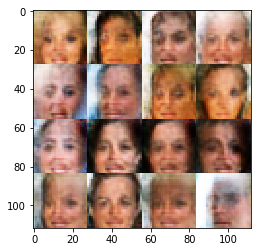

Timestamp 20170806-07-15-55.478 -  Epoch 1/1 -  Step 5910 -  D Loss: 1.0775 - G Loss: 0.8359
Timestamp 20170806-07-16-12.054 -  Epoch 1/1 -  Step 5920 -  D Loss: 1.2267 - G Loss: 1.1118
Timestamp 20170806-07-16-28.628 -  Epoch 1/1 -  Step 5930 -  D Loss: 1.1803 - G Loss: 0.8938
Timestamp 20170806-07-16-45.188 -  Epoch 1/1 -  Step 5940 -  D Loss: 0.8877 - G Loss: 1.5835
Timestamp 20170806-07-17-01.730 -  Epoch 1/1 -  Step 5950 -  D Loss: 1.4383 - G Loss: 0.5830
Timestamp 20170806-07-17-18.294 -  Epoch 1/1 -  Step 5960 -  D Loss: 1.0740 - G Loss: 0.7153
Timestamp 20170806-07-17-34.862 -  Epoch 1/1 -  Step 5970 -  D Loss: 1.1918 - G Loss: 1.0291
Timestamp 20170806-07-17-51.414 -  Epoch 1/1 -  Step 5980 -  D Loss: 1.0582 - G Loss: 0.9977
Timestamp 20170806-07-18-07.991 -  Epoch 1/1 -  Step 5990 -  D Loss: 0.8533 - G Loss: 1.3633
Timestamp 20170806-07-18-24.547 -  Epoch 1/1 -  Step 6000 -  D Loss: 0.9920 - G Loss: 1.2897


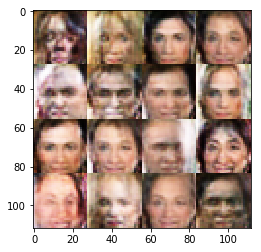

Timestamp 20170806-07-18-42.002 -  Epoch 1/1 -  Step 6010 -  D Loss: 1.0957 - G Loss: 1.1477
Timestamp 20170806-07-18-58.562 -  Epoch 1/1 -  Step 6020 -  D Loss: 1.0494 - G Loss: 1.4419
Timestamp 20170806-07-19-15.103 -  Epoch 1/1 -  Step 6030 -  D Loss: 1.5522 - G Loss: 0.9003
Timestamp 20170806-07-19-31.672 -  Epoch 1/1 -  Step 6040 -  D Loss: 1.2952 - G Loss: 0.8616
Timestamp 20170806-07-19-48.253 -  Epoch 1/1 -  Step 6050 -  D Loss: 0.9219 - G Loss: 1.1937
Timestamp 20170806-07-20-04.813 -  Epoch 1/1 -  Step 6060 -  D Loss: 0.9976 - G Loss: 1.2838
Timestamp 20170806-07-20-21.364 -  Epoch 1/1 -  Step 6070 -  D Loss: 0.9198 - G Loss: 1.6361
Timestamp 20170806-07-20-37.925 -  Epoch 1/1 -  Step 6080 -  D Loss: 1.1223 - G Loss: 1.2442
Timestamp 20170806-07-20-54.483 -  Epoch 1/1 -  Step 6090 -  D Loss: 1.2295 - G Loss: 0.7706
Timestamp 20170806-07-21-11.071 -  Epoch 1/1 -  Step 6100 -  D Loss: 1.0106 - G Loss: 1.1465


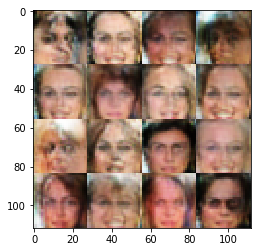

Timestamp 20170806-07-21-28.384 -  Epoch 1/1 -  Step 6110 -  D Loss: 1.0561 - G Loss: 1.1461
Timestamp 20170806-07-21-44.928 -  Epoch 1/1 -  Step 6120 -  D Loss: 1.1517 - G Loss: 1.7868
Timestamp 20170806-07-22-01.484 -  Epoch 1/1 -  Step 6130 -  D Loss: 1.1187 - G Loss: 1.1457
Timestamp 20170806-07-22-18.039 -  Epoch 1/1 -  Step 6140 -  D Loss: 0.9063 - G Loss: 1.4789
Timestamp 20170806-07-22-34.572 -  Epoch 1/1 -  Step 6150 -  D Loss: 1.2307 - G Loss: 0.9998
Timestamp 20170806-07-22-51.119 -  Epoch 1/1 -  Step 6160 -  D Loss: 0.9369 - G Loss: 1.3105
Timestamp 20170806-07-23-07.706 -  Epoch 1/1 -  Step 6170 -  D Loss: 1.2742 - G Loss: 1.4213
Timestamp 20170806-07-23-24.249 -  Epoch 1/1 -  Step 6180 -  D Loss: 0.8314 - G Loss: 1.2298
Timestamp 20170806-07-23-40.821 -  Epoch 1/1 -  Step 6190 -  D Loss: 1.1944 - G Loss: 0.8747
Timestamp 20170806-07-23-57.371 -  Epoch 1/1 -  Step 6200 -  D Loss: 1.1300 - G Loss: 1.0018


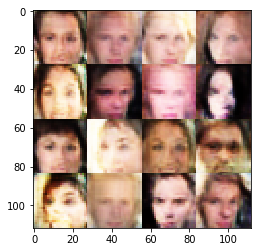

Timestamp 20170806-07-24-14.647 -  Epoch 1/1 -  Step 6210 -  D Loss: 1.1408 - G Loss: 0.8474
Timestamp 20170806-07-24-31.216 -  Epoch 1/1 -  Step 6220 -  D Loss: 1.2270 - G Loss: 0.8326
Timestamp 20170806-07-24-47.767 -  Epoch 1/1 -  Step 6230 -  D Loss: 1.2254 - G Loss: 1.0895
Timestamp 20170806-07-25-04.323 -  Epoch 1/1 -  Step 6240 -  D Loss: 1.1708 - G Loss: 0.8997
Timestamp 20170806-07-25-20.895 -  Epoch 1/1 -  Step 6250 -  D Loss: 1.0425 - G Loss: 1.3103
Timestamp 20170806-07-25-37.447 -  Epoch 1/1 -  Step 6260 -  D Loss: 0.9298 - G Loss: 1.1601
Timestamp 20170806-07-25-54.014 -  Epoch 1/1 -  Step 6270 -  D Loss: 0.9860 - G Loss: 1.0699
Timestamp 20170806-07-26-10.571 -  Epoch 1/1 -  Step 6280 -  D Loss: 0.8377 - G Loss: 1.2879
Timestamp 20170806-07-26-27.116 -  Epoch 1/1 -  Step 6290 -  D Loss: 1.1064 - G Loss: 0.7023
Timestamp 20170806-07-26-43.678 -  Epoch 1/1 -  Step 6300 -  D Loss: 1.1268 - G Loss: 1.0126


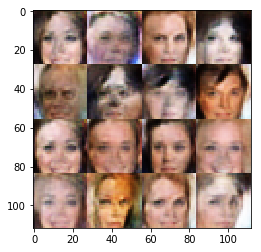

Timestamp 20170806-07-27-00.983 -  Epoch 1/1 -  Step 6310 -  D Loss: 1.2464 - G Loss: 1.0511
Timestamp 20170806-07-27-17.538 -  Epoch 1/1 -  Step 6320 -  D Loss: 1.4551 - G Loss: 0.7541
Timestamp 20170806-07-27-34.099 -  Epoch 1/1 -  Step 6330 -  D Loss: 0.9327 - G Loss: 1.4040
Timestamp 20170806-07-27-50.668 -  Epoch 1/1 -  Step 6340 -  D Loss: 1.0542 - G Loss: 1.0134
Timestamp 20170806-07-28-07.233 -  Epoch 1/1 -  Step 6350 -  D Loss: 1.1435 - G Loss: 1.6356
Timestamp 20170806-07-28-23.777 -  Epoch 1/1 -  Step 6360 -  D Loss: 0.9899 - G Loss: 1.0855
Timestamp 20170806-07-28-40.336 -  Epoch 1/1 -  Step 6370 -  D Loss: 1.0681 - G Loss: 1.2726
Timestamp 20170806-07-28-56.888 -  Epoch 1/1 -  Step 6380 -  D Loss: 1.0855 - G Loss: 0.7618
Timestamp 20170806-07-29-13.460 -  Epoch 1/1 -  Step 6390 -  D Loss: 1.1237 - G Loss: 0.9415
Timestamp 20170806-07-29-30.017 -  Epoch 1/1 -  Step 6400 -  D Loss: 1.3633 - G Loss: 0.9095


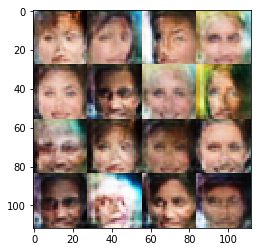

Timestamp 20170806-07-29-47.287 -  Epoch 1/1 -  Step 6410 -  D Loss: 0.7646 - G Loss: 1.3710
Timestamp 20170806-07-30-03.849 -  Epoch 1/1 -  Step 6420 -  D Loss: 1.2996 - G Loss: 0.9393
Timestamp 20170806-07-30-20.411 -  Epoch 1/1 -  Step 6430 -  D Loss: 1.3187 - G Loss: 0.9674
Timestamp 20170806-07-30-36.971 -  Epoch 1/1 -  Step 6440 -  D Loss: 1.2278 - G Loss: 1.0425
Timestamp 20170806-07-30-53.543 -  Epoch 1/1 -  Step 6450 -  D Loss: 1.0989 - G Loss: 1.0100
Timestamp 20170806-07-31-10.096 -  Epoch 1/1 -  Step 6460 -  D Loss: 0.9725 - G Loss: 1.3693
Timestamp 20170806-07-31-26.639 -  Epoch 1/1 -  Step 6470 -  D Loss: 1.0786 - G Loss: 1.2496
Timestamp 20170806-07-31-43.212 -  Epoch 1/1 -  Step 6480 -  D Loss: 1.0556 - G Loss: 0.8495
Timestamp 20170806-07-31-59.770 -  Epoch 1/1 -  Step 6490 -  D Loss: 1.1425 - G Loss: 0.9858
Timestamp 20170806-07-32-16.335 -  Epoch 1/1 -  Step 6500 -  D Loss: 1.0940 - G Loss: 1.0539


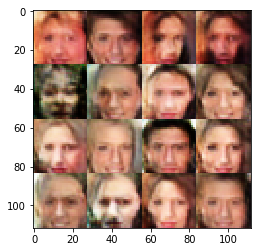

Timestamp 20170806-07-32-33.614 -  Epoch 1/1 -  Step 6510 -  D Loss: 1.1734 - G Loss: 0.8367
Timestamp 20170806-07-32-50.176 -  Epoch 1/1 -  Step 6520 -  D Loss: 0.9758 - G Loss: 0.9225
Timestamp 20170806-07-33-06.746 -  Epoch 1/1 -  Step 6530 -  D Loss: 0.8337 - G Loss: 1.4560
Timestamp 20170806-07-33-23.314 -  Epoch 1/1 -  Step 6540 -  D Loss: 1.0467 - G Loss: 1.4280
Timestamp 20170806-07-33-39.884 -  Epoch 1/1 -  Step 6550 -  D Loss: 1.4267 - G Loss: 1.0949
Timestamp 20170806-07-33-56.460 -  Epoch 1/1 -  Step 6560 -  D Loss: 1.1865 - G Loss: 0.9724
Timestamp 20170806-07-34-13.036 -  Epoch 1/1 -  Step 6570 -  D Loss: 1.2975 - G Loss: 0.9372
Timestamp 20170806-07-34-29.613 -  Epoch 1/1 -  Step 6580 -  D Loss: 1.2367 - G Loss: 1.0368
Timestamp 20170806-07-34-46.174 -  Epoch 1/1 -  Step 6590 -  D Loss: 0.9588 - G Loss: 1.1742
Timestamp 20170806-07-35-02.724 -  Epoch 1/1 -  Step 6600 -  D Loss: 1.2367 - G Loss: 0.9442


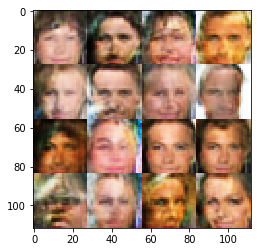

Timestamp 20170806-07-35-20.008 -  Epoch 1/1 -  Step 6610 -  D Loss: 1.4248 - G Loss: 1.2034
Timestamp 20170806-07-35-36.600 -  Epoch 1/1 -  Step 6620 -  D Loss: 1.0829 - G Loss: 1.0132
Timestamp 20170806-07-35-53.164 -  Epoch 1/1 -  Step 6630 -  D Loss: 0.9397 - G Loss: 1.2376
Timestamp 20170806-07-36-09.690 -  Epoch 1/1 -  Step 6640 -  D Loss: 1.1588 - G Loss: 0.9105
Timestamp 20170806-07-36-26.270 -  Epoch 1/1 -  Step 6650 -  D Loss: 1.2373 - G Loss: 0.9840
Timestamp 20170806-07-36-42.831 -  Epoch 1/1 -  Step 6660 -  D Loss: 1.2213 - G Loss: 0.6719
Timestamp 20170806-07-36-59.380 -  Epoch 1/1 -  Step 6670 -  D Loss: 0.9344 - G Loss: 1.2508
Timestamp 20170806-07-37-15.948 -  Epoch 1/1 -  Step 6680 -  D Loss: 1.0934 - G Loss: 0.7290
Timestamp 20170806-07-37-32.498 -  Epoch 1/1 -  Step 6690 -  D Loss: 0.9030 - G Loss: 1.6367
Timestamp 20170806-07-37-49.041 -  Epoch 1/1 -  Step 6700 -  D Loss: 0.9978 - G Loss: 1.0870


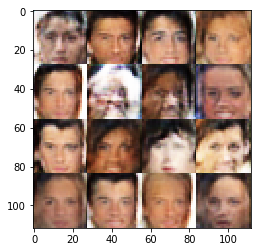

Timestamp 20170806-07-38-06.354 -  Epoch 1/1 -  Step 6710 -  D Loss: 1.0238 - G Loss: 1.5316
Timestamp 20170806-07-38-22.896 -  Epoch 1/1 -  Step 6720 -  D Loss: 1.4961 - G Loss: 0.6210
Timestamp 20170806-07-38-39.448 -  Epoch 1/1 -  Step 6730 -  D Loss: 1.2388 - G Loss: 1.0263
Timestamp 20170806-07-38-55.991 -  Epoch 1/1 -  Step 6740 -  D Loss: 1.0751 - G Loss: 0.6660
Timestamp 20170806-07-39-12.548 -  Epoch 1/1 -  Step 6750 -  D Loss: 1.1879 - G Loss: 0.7306
Timestamp 20170806-07-39-29.097 -  Epoch 1/1 -  Step 6760 -  D Loss: 1.3231 - G Loss: 1.3176
Timestamp 20170806-07-39-45.662 -  Epoch 1/1 -  Step 6770 -  D Loss: 1.2373 - G Loss: 1.1488
Timestamp 20170806-07-40-02.215 -  Epoch 1/1 -  Step 6780 -  D Loss: 1.0479 - G Loss: 0.8886
Timestamp 20170806-07-40-18.741 -  Epoch 1/1 -  Step 6790 -  D Loss: 1.1916 - G Loss: 1.4451
Timestamp 20170806-07-40-35.277 -  Epoch 1/1 -  Step 6800 -  D Loss: 0.9525 - G Loss: 1.3616


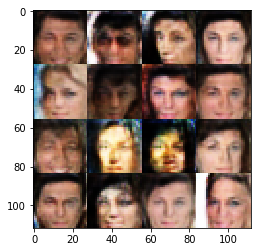

Timestamp 20170806-07-40-52.566 -  Epoch 1/1 -  Step 6810 -  D Loss: 1.1377 - G Loss: 1.3625
Timestamp 20170806-07-41-09.122 -  Epoch 1/1 -  Step 6820 -  D Loss: 1.0060 - G Loss: 1.1630
Timestamp 20170806-07-41-25.653 -  Epoch 1/1 -  Step 6830 -  D Loss: 1.0425 - G Loss: 1.4682
Timestamp 20170806-07-41-42.219 -  Epoch 1/1 -  Step 6840 -  D Loss: 1.0596 - G Loss: 1.4015
Timestamp 20170806-07-41-58.767 -  Epoch 1/1 -  Step 6850 -  D Loss: 1.0901 - G Loss: 1.3045
Timestamp 20170806-07-42-15.327 -  Epoch 1/1 -  Step 6860 -  D Loss: 0.9531 - G Loss: 1.2708
Timestamp 20170806-07-42-31.869 -  Epoch 1/1 -  Step 6870 -  D Loss: 1.2250 - G Loss: 1.3035
Timestamp 20170806-07-42-48.415 -  Epoch 1/1 -  Step 6880 -  D Loss: 1.0702 - G Loss: 0.8504
Timestamp 20170806-07-43-04.949 -  Epoch 1/1 -  Step 6890 -  D Loss: 1.0582 - G Loss: 0.9382
Timestamp 20170806-07-43-21.524 -  Epoch 1/1 -  Step 6900 -  D Loss: 1.0102 - G Loss: 0.7960


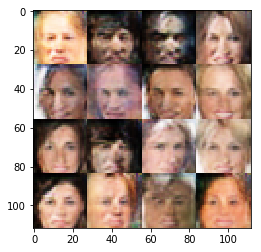

Timestamp 20170806-07-43-38.843 -  Epoch 1/1 -  Step 6910 -  D Loss: 1.0439 - G Loss: 1.4636
Timestamp 20170806-07-43-55.399 -  Epoch 1/1 -  Step 6920 -  D Loss: 1.0701 - G Loss: 0.7923
Timestamp 20170806-07-44-11.954 -  Epoch 1/1 -  Step 6930 -  D Loss: 1.0488 - G Loss: 1.0425
Timestamp 20170806-07-44-28.519 -  Epoch 1/1 -  Step 6940 -  D Loss: 1.3053 - G Loss: 0.9984
Timestamp 20170806-07-44-45.055 -  Epoch 1/1 -  Step 6950 -  D Loss: 1.2548 - G Loss: 1.0580
Timestamp 20170806-07-45-01.576 -  Epoch 1/1 -  Step 6960 -  D Loss: 0.9681 - G Loss: 1.8009
Timestamp 20170806-07-45-18.119 -  Epoch 1/1 -  Step 6970 -  D Loss: 0.9855 - G Loss: 1.2270
Timestamp 20170806-07-45-34.657 -  Epoch 1/1 -  Step 6980 -  D Loss: 1.1349 - G Loss: 1.0253
Timestamp 20170806-07-45-51.206 -  Epoch 1/1 -  Step 6990 -  D Loss: 1.0594 - G Loss: 1.2781
Timestamp 20170806-07-46-07.749 -  Epoch 1/1 -  Step 7000 -  D Loss: 1.3577 - G Loss: 1.8217


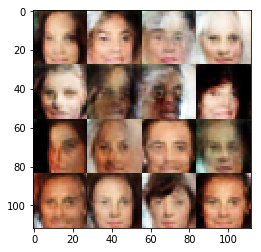

Timestamp 20170806-07-46-25.045 -  Epoch 1/1 -  Step 7010 -  D Loss: 1.4377 - G Loss: 1.2127
Timestamp 20170806-07-46-41.591 -  Epoch 1/1 -  Step 7020 -  D Loss: 1.1227 - G Loss: 1.2097
Timestamp 20170806-07-46-58.145 -  Epoch 1/1 -  Step 7030 -  D Loss: 0.9902 - G Loss: 0.8473
Timestamp 20170806-07-47-14.692 -  Epoch 1/1 -  Step 7040 -  D Loss: 1.0010 - G Loss: 0.8705
Timestamp 20170806-07-47-31.240 -  Epoch 1/1 -  Step 7050 -  D Loss: 1.0646 - G Loss: 1.4070
Timestamp 20170806-07-47-47.814 -  Epoch 1/1 -  Step 7060 -  D Loss: 1.3084 - G Loss: 0.7554
Timestamp 20170806-07-48-04.358 -  Epoch 1/1 -  Step 7070 -  D Loss: 0.8985 - G Loss: 1.2222
Timestamp 20170806-07-48-20.894 -  Epoch 1/1 -  Step 7080 -  D Loss: 1.3231 - G Loss: 1.0532
Timestamp 20170806-07-48-37.444 -  Epoch 1/1 -  Step 7090 -  D Loss: 1.1337 - G Loss: 1.3013
Timestamp 20170806-07-48-53.973 -  Epoch 1/1 -  Step 7100 -  D Loss: 1.1561 - G Loss: 1.2460


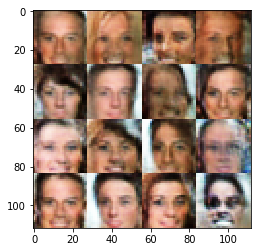

Timestamp 20170806-07-49-11.276 -  Epoch 1/1 -  Step 7110 -  D Loss: 1.0353 - G Loss: 0.9023
Timestamp 20170806-07-49-27.802 -  Epoch 1/1 -  Step 7120 -  D Loss: 1.3846 - G Loss: 0.9241
Timestamp 20170806-07-49-44.345 -  Epoch 1/1 -  Step 7130 -  D Loss: 1.4295 - G Loss: 0.8145
Timestamp 20170806-07-50-00.892 -  Epoch 1/1 -  Step 7140 -  D Loss: 1.1795 - G Loss: 0.8273
Timestamp 20170806-07-50-17.426 -  Epoch 1/1 -  Step 7150 -  D Loss: 1.0597 - G Loss: 1.5806
Timestamp 20170806-07-50-33.971 -  Epoch 1/1 -  Step 7160 -  D Loss: 1.4873 - G Loss: 0.5467
Timestamp 20170806-07-50-50.533 -  Epoch 1/1 -  Step 7170 -  D Loss: 0.9861 - G Loss: 1.5003
Timestamp 20170806-07-51-07.086 -  Epoch 1/1 -  Step 7180 -  D Loss: 0.9337 - G Loss: 0.8303
Timestamp 20170806-07-51-23.628 -  Epoch 1/1 -  Step 7190 -  D Loss: 1.4558 - G Loss: 0.9906
Timestamp 20170806-07-51-40.174 -  Epoch 1/1 -  Step 7200 -  D Loss: 1.1805 - G Loss: 1.4707


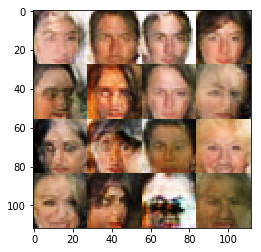

Timestamp 20170806-07-51-57.462 -  Epoch 1/1 -  Step 7210 -  D Loss: 1.0996 - G Loss: 0.8099
Timestamp 20170806-07-52-13.987 -  Epoch 1/1 -  Step 7220 -  D Loss: 1.0131 - G Loss: 1.2891
Timestamp 20170806-07-52-30.530 -  Epoch 1/1 -  Step 7230 -  D Loss: 1.0607 - G Loss: 1.1067
Timestamp 20170806-07-52-47.071 -  Epoch 1/1 -  Step 7240 -  D Loss: 0.9070 - G Loss: 0.9465
Timestamp 20170806-07-53-03.614 -  Epoch 1/1 -  Step 7250 -  D Loss: 1.0714 - G Loss: 1.0212
Timestamp 20170806-07-53-20.149 -  Epoch 1/1 -  Step 7260 -  D Loss: 1.0691 - G Loss: 1.1657
Timestamp 20170806-07-53-36.696 -  Epoch 1/1 -  Step 7270 -  D Loss: 1.0498 - G Loss: 1.7613
Timestamp 20170806-07-53-53.257 -  Epoch 1/1 -  Step 7280 -  D Loss: 1.0840 - G Loss: 1.1317
Timestamp 20170806-07-54-09.812 -  Epoch 1/1 -  Step 7290 -  D Loss: 1.2907 - G Loss: 0.6197
Timestamp 20170806-07-54-26.367 -  Epoch 1/1 -  Step 7300 -  D Loss: 0.9280 - G Loss: 1.3517


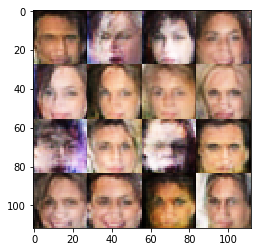

Timestamp 20170806-07-54-43.663 -  Epoch 1/1 -  Step 7310 -  D Loss: 1.1578 - G Loss: 1.0661
Timestamp 20170806-07-55-00.217 -  Epoch 1/1 -  Step 7320 -  D Loss: 1.2000 - G Loss: 1.1633
Timestamp 20170806-07-55-16.769 -  Epoch 1/1 -  Step 7330 -  D Loss: 1.2643 - G Loss: 0.9466
Timestamp 20170806-07-55-33.349 -  Epoch 1/1 -  Step 7340 -  D Loss: 1.3106 - G Loss: 0.9761
Timestamp 20170806-07-55-49.893 -  Epoch 1/1 -  Step 7350 -  D Loss: 1.3039 - G Loss: 0.8719
Timestamp 20170806-07-56-06.456 -  Epoch 1/1 -  Step 7360 -  D Loss: 1.0045 - G Loss: 1.1773
Timestamp 20170806-07-56-23.008 -  Epoch 1/1 -  Step 7370 -  D Loss: 1.1809 - G Loss: 1.0704
Timestamp 20170806-07-56-39.566 -  Epoch 1/1 -  Step 7380 -  D Loss: 1.0128 - G Loss: 1.2316
Timestamp 20170806-07-56-56.122 -  Epoch 1/1 -  Step 7390 -  D Loss: 0.9246 - G Loss: 1.3858
Timestamp 20170806-07-57-12.661 -  Epoch 1/1 -  Step 7400 -  D Loss: 1.1483 - G Loss: 1.1255


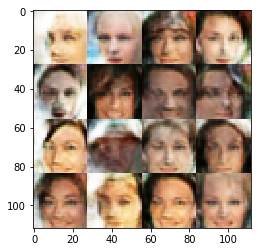

Timestamp 20170806-07-57-29.929 -  Epoch 1/1 -  Step 7410 -  D Loss: 1.0783 - G Loss: 1.3331
Timestamp 20170806-07-57-46.496 -  Epoch 1/1 -  Step 7420 -  D Loss: 1.2572 - G Loss: 0.7974
Timestamp 20170806-07-58-03.045 -  Epoch 1/1 -  Step 7430 -  D Loss: 1.0338 - G Loss: 1.1318
Timestamp 20170806-07-58-19.608 -  Epoch 1/1 -  Step 7440 -  D Loss: 0.9880 - G Loss: 0.9694
Timestamp 20170806-07-58-36.156 -  Epoch 1/1 -  Step 7450 -  D Loss: 0.9777 - G Loss: 0.9108
Timestamp 20170806-07-58-52.695 -  Epoch 1/1 -  Step 7460 -  D Loss: 1.2503 - G Loss: 0.7290
Timestamp 20170806-07-59-09.244 -  Epoch 1/1 -  Step 7470 -  D Loss: 1.2140 - G Loss: 1.2347
Timestamp 20170806-07-59-25.799 -  Epoch 1/1 -  Step 7480 -  D Loss: 1.3763 - G Loss: 0.7053
Timestamp 20170806-07-59-42.368 -  Epoch 1/1 -  Step 7490 -  D Loss: 0.9139 - G Loss: 1.6484
Timestamp 20170806-07-59-58.927 -  Epoch 1/1 -  Step 7500 -  D Loss: 0.9769 - G Loss: 1.1755


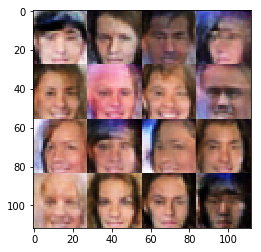

Timestamp 20170806-08-00-16.204 -  Epoch 1/1 -  Step 7510 -  D Loss: 1.1223 - G Loss: 0.7202
Timestamp 20170806-08-00-32.738 -  Epoch 1/1 -  Step 7520 -  D Loss: 1.3021 - G Loss: 1.4735
Timestamp 20170806-08-00-49.283 -  Epoch 1/1 -  Step 7530 -  D Loss: 1.2720 - G Loss: 1.0529
Timestamp 20170806-08-01-05.848 -  Epoch 1/1 -  Step 7540 -  D Loss: 1.0569 - G Loss: 1.2572
Timestamp 20170806-08-01-22.388 -  Epoch 1/1 -  Step 7550 -  D Loss: 1.2831 - G Loss: 1.1563
Timestamp 20170806-08-01-38.938 -  Epoch 1/1 -  Step 7560 -  D Loss: 1.3028 - G Loss: 1.1143
Timestamp 20170806-08-01-55.518 -  Epoch 1/1 -  Step 7570 -  D Loss: 1.0150 - G Loss: 1.1782
Timestamp 20170806-08-02-12.055 -  Epoch 1/1 -  Step 7580 -  D Loss: 1.0060 - G Loss: 0.9735
Timestamp 20170806-08-02-28.600 -  Epoch 1/1 -  Step 7590 -  D Loss: 1.1510 - G Loss: 1.3672
Timestamp 20170806-08-02-45.137 -  Epoch 1/1 -  Step 7600 -  D Loss: 1.0286 - G Loss: 1.6654


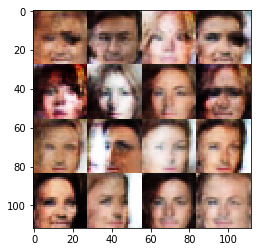

Timestamp 20170806-08-03-02.448 -  Epoch 1/1 -  Step 7610 -  D Loss: 1.2582 - G Loss: 1.2115
Timestamp 20170806-08-03-19.011 -  Epoch 1/1 -  Step 7620 -  D Loss: 0.9437 - G Loss: 1.3230
Timestamp 20170806-08-03-35.560 -  Epoch 1/1 -  Step 7630 -  D Loss: 0.9585 - G Loss: 1.1253
Timestamp 20170806-08-03-52.113 -  Epoch 1/1 -  Step 7640 -  D Loss: 1.0704 - G Loss: 1.1588
Timestamp 20170806-08-04-08.643 -  Epoch 1/1 -  Step 7650 -  D Loss: 0.9135 - G Loss: 1.0235
Timestamp 20170806-08-04-25.214 -  Epoch 1/1 -  Step 7660 -  D Loss: 1.0437 - G Loss: 0.7323
Timestamp 20170806-08-04-41.761 -  Epoch 1/1 -  Step 7670 -  D Loss: 1.0906 - G Loss: 1.0011
Timestamp 20170806-08-04-58.311 -  Epoch 1/1 -  Step 7680 -  D Loss: 1.0376 - G Loss: 1.1834
Timestamp 20170806-08-05-14.850 -  Epoch 1/1 -  Step 7690 -  D Loss: 1.1672 - G Loss: 1.0687
Timestamp 20170806-08-05-31.388 -  Epoch 1/1 -  Step 7700 -  D Loss: 1.0990 - G Loss: 1.2595


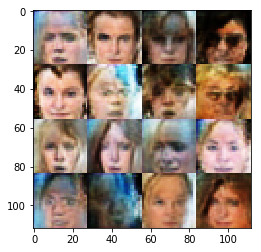

Timestamp 20170806-08-05-48.805 -  Epoch 1/1 -  Step 7710 -  D Loss: 1.4511 - G Loss: 1.0044
Timestamp 20170806-08-06-05.379 -  Epoch 1/1 -  Step 7720 -  D Loss: 1.0672 - G Loss: 1.1398
Timestamp 20170806-08-06-21.935 -  Epoch 1/1 -  Step 7730 -  D Loss: 0.7922 - G Loss: 1.4669
Timestamp 20170806-08-06-38.475 -  Epoch 1/1 -  Step 7740 -  D Loss: 1.0859 - G Loss: 1.1596
Timestamp 20170806-08-06-55.005 -  Epoch 1/1 -  Step 7750 -  D Loss: 1.0388 - G Loss: 0.9271
Timestamp 20170806-08-07-11.558 -  Epoch 1/1 -  Step 7760 -  D Loss: 1.1507 - G Loss: 1.4114
Timestamp 20170806-08-07-28.097 -  Epoch 1/1 -  Step 7770 -  D Loss: 1.3198 - G Loss: 0.9502
Timestamp 20170806-08-07-44.651 -  Epoch 1/1 -  Step 7780 -  D Loss: 1.6411 - G Loss: 0.9401
Timestamp 20170806-08-08-01.190 -  Epoch 1/1 -  Step 7790 -  D Loss: 1.2027 - G Loss: 0.8634
Timestamp 20170806-08-08-17.762 -  Epoch 1/1 -  Step 7800 -  D Loss: 1.2405 - G Loss: 0.9693


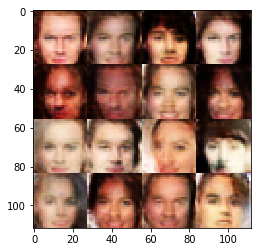

Timestamp 20170806-08-08-35.057 -  Epoch 1/1 -  Step 7810 -  D Loss: 1.1205 - G Loss: 1.2845
Timestamp 20170806-08-08-51.603 -  Epoch 1/1 -  Step 7820 -  D Loss: 1.2061 - G Loss: 0.9101
Timestamp 20170806-08-09-08.129 -  Epoch 1/1 -  Step 7830 -  D Loss: 1.1470 - G Loss: 0.9927
Timestamp 20170806-08-09-24.686 -  Epoch 1/1 -  Step 7840 -  D Loss: 1.2037 - G Loss: 1.0502
Timestamp 20170806-08-09-41.286 -  Epoch 1/1 -  Step 7850 -  D Loss: 1.2538 - G Loss: 0.7369
Timestamp 20170806-08-09-57.857 -  Epoch 1/1 -  Step 7860 -  D Loss: 1.0672 - G Loss: 0.8041
Timestamp 20170806-08-10-14.413 -  Epoch 1/1 -  Step 7870 -  D Loss: 1.5330 - G Loss: 0.6995
Timestamp 20170806-08-10-30.971 -  Epoch 1/1 -  Step 7880 -  D Loss: 1.0630 - G Loss: 1.2014
Timestamp 20170806-08-10-47.511 -  Epoch 1/1 -  Step 7890 -  D Loss: 0.8709 - G Loss: 1.5774
Timestamp 20170806-08-11-04.055 -  Epoch 1/1 -  Step 7900 -  D Loss: 0.9442 - G Loss: 1.1961


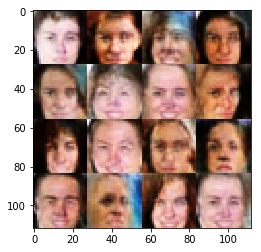

Timestamp 20170806-08-11-21.356 -  Epoch 1/1 -  Step 7910 -  D Loss: 1.0599 - G Loss: 1.2886
Timestamp 20170806-08-11-37.904 -  Epoch 1/1 -  Step 7920 -  D Loss: 1.2422 - G Loss: 0.9836
Timestamp 20170806-08-11-54.464 -  Epoch 1/1 -  Step 7930 -  D Loss: 1.1428 - G Loss: 1.1534
Timestamp 20170806-08-12-11.006 -  Epoch 1/1 -  Step 7940 -  D Loss: 1.0194 - G Loss: 1.0905
Timestamp 20170806-08-12-27.538 -  Epoch 1/1 -  Step 7950 -  D Loss: 1.1237 - G Loss: 1.3000
Timestamp 20170806-08-12-44.091 -  Epoch 1/1 -  Step 7960 -  D Loss: 1.3059 - G Loss: 0.6527
Timestamp 20170806-08-13-00.646 -  Epoch 1/1 -  Step 7970 -  D Loss: 0.9950 - G Loss: 1.0129
Timestamp 20170806-08-13-17.197 -  Epoch 1/1 -  Step 7980 -  D Loss: 1.0864 - G Loss: 0.9516
Timestamp 20170806-08-13-33.725 -  Epoch 1/1 -  Step 7990 -  D Loss: 1.3887 - G Loss: 0.9082
Timestamp 20170806-08-13-50.294 -  Epoch 1/1 -  Step 8000 -  D Loss: 1.0362 - G Loss: 0.7872


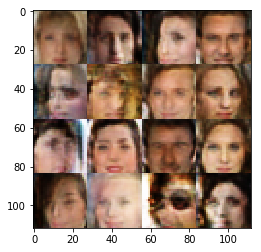

Timestamp 20170806-08-14-07.587 -  Epoch 1/1 -  Step 8010 -  D Loss: 1.1160 - G Loss: 0.7554
Timestamp 20170806-08-14-24.142 -  Epoch 1/1 -  Step 8020 -  D Loss: 1.2001 - G Loss: 1.5365
Timestamp 20170806-08-14-40.676 -  Epoch 1/1 -  Step 8030 -  D Loss: 1.0268 - G Loss: 0.7719
Timestamp 20170806-08-14-57.214 -  Epoch 1/1 -  Step 8040 -  D Loss: 1.2949 - G Loss: 0.8492
Timestamp 20170806-08-15-13.775 -  Epoch 1/1 -  Step 8050 -  D Loss: 1.5161 - G Loss: 0.5534
Timestamp 20170806-08-15-30.322 -  Epoch 1/1 -  Step 8060 -  D Loss: 1.0806 - G Loss: 1.2012
Timestamp 20170806-08-15-46.876 -  Epoch 1/1 -  Step 8070 -  D Loss: 1.1940 - G Loss: 0.8465
Timestamp 20170806-08-16-03.420 -  Epoch 1/1 -  Step 8080 -  D Loss: 1.2733 - G Loss: 0.8252
Timestamp 20170806-08-16-19.970 -  Epoch 1/1 -  Step 8090 -  D Loss: 1.2838 - G Loss: 1.1667
Timestamp 20170806-08-16-36.494 -  Epoch 1/1 -  Step 8100 -  D Loss: 1.1515 - G Loss: 0.8356


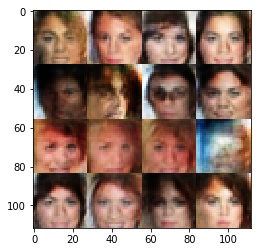

Timestamp 20170806-08-16-53.804 -  Epoch 1/1 -  Step 8110 -  D Loss: 1.2601 - G Loss: 0.8393
Timestamp 20170806-08-17-10.348 -  Epoch 1/1 -  Step 8120 -  D Loss: 1.1367 - G Loss: 0.9973
Timestamp 20170806-08-17-26.888 -  Epoch 1/1 -  Step 8130 -  D Loss: 1.0805 - G Loss: 1.0493
Timestamp 20170806-08-17-43.459 -  Epoch 1/1 -  Step 8140 -  D Loss: 1.2014 - G Loss: 1.1492
Timestamp 20170806-08-18-00.016 -  Epoch 1/1 -  Step 8150 -  D Loss: 1.2156 - G Loss: 0.7687
Timestamp 20170806-08-18-16.553 -  Epoch 1/1 -  Step 8160 -  D Loss: 1.2041 - G Loss: 1.0770
Timestamp 20170806-08-18-33.102 -  Epoch 1/1 -  Step 8170 -  D Loss: 1.3840 - G Loss: 1.3199
Timestamp 20170806-08-18-49.648 -  Epoch 1/1 -  Step 8180 -  D Loss: 1.0366 - G Loss: 1.3206
Timestamp 20170806-08-19-06.220 -  Epoch 1/1 -  Step 8190 -  D Loss: 1.0173 - G Loss: 1.2773
Timestamp 20170806-08-19-22.765 -  Epoch 1/1 -  Step 8200 -  D Loss: 1.5591 - G Loss: 0.7356


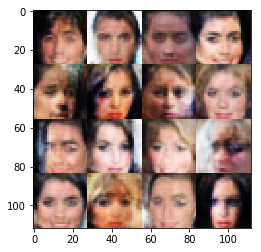

Timestamp 20170806-08-19-40.168 -  Epoch 1/1 -  Step 8210 -  D Loss: 1.0863 - G Loss: 1.1712
Timestamp 20170806-08-19-56.724 -  Epoch 1/1 -  Step 8220 -  D Loss: 1.2703 - G Loss: 0.8742
Timestamp 20170806-08-20-13.255 -  Epoch 1/1 -  Step 8230 -  D Loss: 1.0560 - G Loss: 1.1773
Timestamp 20170806-08-20-29.776 -  Epoch 1/1 -  Step 8240 -  D Loss: 1.1855 - G Loss: 0.9863
Timestamp 20170806-08-20-46.331 -  Epoch 1/1 -  Step 8250 -  D Loss: 1.0036 - G Loss: 1.0196
Timestamp 20170806-08-21-02.887 -  Epoch 1/1 -  Step 8260 -  D Loss: 1.0506 - G Loss: 0.7973
Timestamp 20170806-08-21-19.442 -  Epoch 1/1 -  Step 8270 -  D Loss: 1.2011 - G Loss: 0.9294
Timestamp 20170806-08-21-35.995 -  Epoch 1/1 -  Step 8280 -  D Loss: 1.0913 - G Loss: 0.9918
Timestamp 20170806-08-21-52.535 -  Epoch 1/1 -  Step 8290 -  D Loss: 1.0777 - G Loss: 1.3519
Timestamp 20170806-08-22-09.078 -  Epoch 1/1 -  Step 8300 -  D Loss: 0.9067 - G Loss: 1.1185


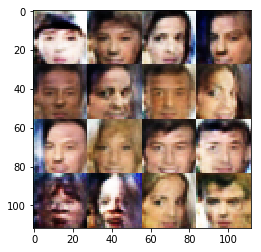

Timestamp 20170806-08-22-26.369 -  Epoch 1/1 -  Step 8310 -  D Loss: 1.2224 - G Loss: 0.8817
Timestamp 20170806-08-22-42.908 -  Epoch 1/1 -  Step 8320 -  D Loss: 0.9598 - G Loss: 1.2174
Timestamp 20170806-08-22-59.444 -  Epoch 1/1 -  Step 8330 -  D Loss: 1.1153 - G Loss: 0.8601
Timestamp 20170806-08-23-16.004 -  Epoch 1/1 -  Step 8340 -  D Loss: 1.7136 - G Loss: 0.5362
Timestamp 20170806-08-23-32.571 -  Epoch 1/1 -  Step 8350 -  D Loss: 1.5662 - G Loss: 0.9509
Timestamp 20170806-08-23-49.134 -  Epoch 1/1 -  Step 8360 -  D Loss: 1.2442 - G Loss: 0.8358
Timestamp 20170806-08-24-05.689 -  Epoch 1/1 -  Step 8370 -  D Loss: 1.1665 - G Loss: 0.7592
Timestamp 20170806-08-24-22.253 -  Epoch 1/1 -  Step 8380 -  D Loss: 0.9494 - G Loss: 1.2810
Timestamp 20170806-08-24-38.811 -  Epoch 1/1 -  Step 8390 -  D Loss: 1.1271 - G Loss: 1.1024
Timestamp 20170806-08-24-55.364 -  Epoch 1/1 -  Step 8400 -  D Loss: 0.9675 - G Loss: 0.9328


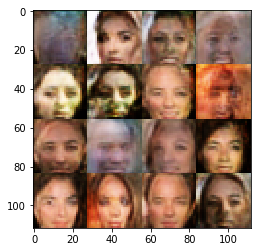

Timestamp 20170806-08-25-12.685 -  Epoch 1/1 -  Step 8410 -  D Loss: 1.2505 - G Loss: 0.7466
Timestamp 20170806-08-25-29.246 -  Epoch 1/1 -  Step 8420 -  D Loss: 1.1111 - G Loss: 0.8199
Timestamp 20170806-08-25-45.802 -  Epoch 1/1 -  Step 8430 -  D Loss: 1.2815 - G Loss: 0.8834
Timestamp 20170806-08-26-02.368 -  Epoch 1/1 -  Step 8440 -  D Loss: 1.5147 - G Loss: 1.0978
Timestamp 20170806-08-26-18.920 -  Epoch 1/1 -  Step 8450 -  D Loss: 1.2341 - G Loss: 0.7365
Timestamp 20170806-08-26-35.484 -  Epoch 1/1 -  Step 8460 -  D Loss: 1.1070 - G Loss: 1.4994
Timestamp 20170806-08-26-52.050 -  Epoch 1/1 -  Step 8470 -  D Loss: 1.3394 - G Loss: 1.0451
Timestamp 20170806-08-27-08.595 -  Epoch 1/1 -  Step 8480 -  D Loss: 1.1281 - G Loss: 0.9694
Timestamp 20170806-08-27-25.147 -  Epoch 1/1 -  Step 8490 -  D Loss: 1.0202 - G Loss: 1.4647
Timestamp 20170806-08-27-41.714 -  Epoch 1/1 -  Step 8500 -  D Loss: 1.0613 - G Loss: 0.9771


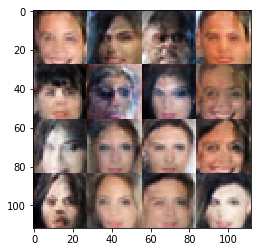

Timestamp 20170806-08-27-59.047 -  Epoch 1/1 -  Step 8510 -  D Loss: 1.4077 - G Loss: 1.1306
Timestamp 20170806-08-28-15.604 -  Epoch 1/1 -  Step 8520 -  D Loss: 1.1195 - G Loss: 0.9927
Timestamp 20170806-08-28-32.135 -  Epoch 1/1 -  Step 8530 -  D Loss: 1.0500 - G Loss: 1.2405
Timestamp 20170806-08-28-48.674 -  Epoch 1/1 -  Step 8540 -  D Loss: 1.1567 - G Loss: 1.3818
Timestamp 20170806-08-29-05.219 -  Epoch 1/1 -  Step 8550 -  D Loss: 1.0406 - G Loss: 0.7381
Timestamp 20170806-08-29-21.780 -  Epoch 1/1 -  Step 8560 -  D Loss: 1.2175 - G Loss: 1.1903
Timestamp 20170806-08-29-38.336 -  Epoch 1/1 -  Step 8570 -  D Loss: 1.1346 - G Loss: 1.0702
Timestamp 20170806-08-29-54.881 -  Epoch 1/1 -  Step 8580 -  D Loss: 1.0477 - G Loss: 0.8763
Timestamp 20170806-08-30-11.403 -  Epoch 1/1 -  Step 8590 -  D Loss: 1.4266 - G Loss: 0.5915
Timestamp 20170806-08-30-27.981 -  Epoch 1/1 -  Step 8600 -  D Loss: 1.3656 - G Loss: 0.7949


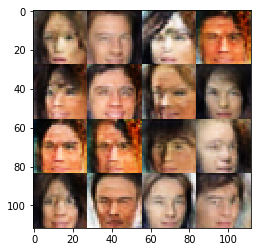

Timestamp 20170806-08-30-45.294 -  Epoch 1/1 -  Step 8610 -  D Loss: 1.1684 - G Loss: 1.2061
Timestamp 20170806-08-31-01.869 -  Epoch 1/1 -  Step 8620 -  D Loss: 1.2418 - G Loss: 0.7716
Timestamp 20170806-08-31-18.416 -  Epoch 1/1 -  Step 8630 -  D Loss: 1.0494 - G Loss: 1.0843
Timestamp 20170806-08-31-34.964 -  Epoch 1/1 -  Step 8640 -  D Loss: 1.2274 - G Loss: 0.9756
Timestamp 20170806-08-31-51.526 -  Epoch 1/1 -  Step 8650 -  D Loss: 1.1869 - G Loss: 0.9999
Timestamp 20170806-08-32-08.072 -  Epoch 1/1 -  Step 8660 -  D Loss: 0.9599 - G Loss: 1.0795
Timestamp 20170806-08-32-24.617 -  Epoch 1/1 -  Step 8670 -  D Loss: 1.1843 - G Loss: 1.1577
Timestamp 20170806-08-32-41.165 -  Epoch 1/1 -  Step 8680 -  D Loss: 1.1926 - G Loss: 0.8324
Timestamp 20170806-08-32-57.732 -  Epoch 1/1 -  Step 8690 -  D Loss: 1.0014 - G Loss: 0.7263
Timestamp 20170806-08-33-14.285 -  Epoch 1/1 -  Step 8700 -  D Loss: 1.4495 - G Loss: 0.7097


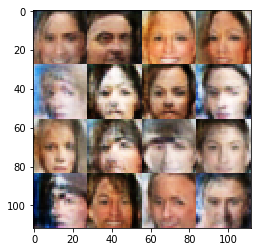

Timestamp 20170806-08-33-31.590 -  Epoch 1/1 -  Step 8710 -  D Loss: 1.1044 - G Loss: 0.9460
Timestamp 20170806-08-33-48.148 -  Epoch 1/1 -  Step 8720 -  D Loss: 1.2446 - G Loss: 0.7672
Timestamp 20170806-08-34-04.672 -  Epoch 1/1 -  Step 8730 -  D Loss: 1.2023 - G Loss: 0.9114
Timestamp 20170806-08-34-21.224 -  Epoch 1/1 -  Step 8740 -  D Loss: 1.1792 - G Loss: 0.9766
Timestamp 20170806-08-34-37.777 -  Epoch 1/1 -  Step 8750 -  D Loss: 1.2245 - G Loss: 0.9141
Timestamp 20170806-08-34-54.310 -  Epoch 1/1 -  Step 8760 -  D Loss: 1.1701 - G Loss: 0.9305
Timestamp 20170806-08-35-10.848 -  Epoch 1/1 -  Step 8770 -  D Loss: 1.0364 - G Loss: 1.3146
Timestamp 20170806-08-35-27.364 -  Epoch 1/1 -  Step 8780 -  D Loss: 1.2079 - G Loss: 1.0128
Timestamp 20170806-08-35-43.908 -  Epoch 1/1 -  Step 8790 -  D Loss: 1.1066 - G Loss: 0.9557
Timestamp 20170806-08-36-00.439 -  Epoch 1/1 -  Step 8800 -  D Loss: 1.0974 - G Loss: 1.0709


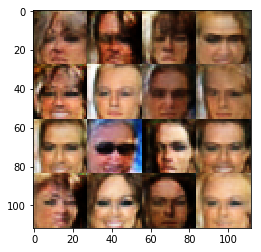

Timestamp 20170806-08-36-17.771 -  Epoch 1/1 -  Step 8810 -  D Loss: 1.2833 - G Loss: 1.0527
Timestamp 20170806-08-36-34.321 -  Epoch 1/1 -  Step 8820 -  D Loss: 1.1960 - G Loss: 0.9407
Timestamp 20170806-08-36-50.870 -  Epoch 1/1 -  Step 8830 -  D Loss: 0.9757 - G Loss: 0.9658
Timestamp 20170806-08-37-07.417 -  Epoch 1/1 -  Step 8840 -  D Loss: 1.1135 - G Loss: 1.2853
Timestamp 20170806-08-37-23.974 -  Epoch 1/1 -  Step 8850 -  D Loss: 1.3791 - G Loss: 1.0290
Timestamp 20170806-08-37-40.539 -  Epoch 1/1 -  Step 8860 -  D Loss: 1.3197 - G Loss: 1.1615
Timestamp 20170806-08-37-57.096 -  Epoch 1/1 -  Step 8870 -  D Loss: 1.0175 - G Loss: 1.1632
Timestamp 20170806-08-38-13.657 -  Epoch 1/1 -  Step 8880 -  D Loss: 1.3351 - G Loss: 1.0423
Timestamp 20170806-08-38-30.177 -  Epoch 1/1 -  Step 8890 -  D Loss: 1.0586 - G Loss: 0.8425
Timestamp 20170806-08-38-46.733 -  Epoch 1/1 -  Step 8900 -  D Loss: 1.2925 - G Loss: 0.9869


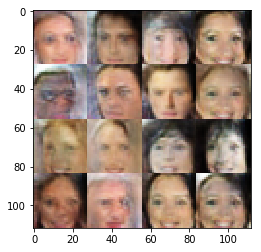

Timestamp 20170806-08-39-04.032 -  Epoch 1/1 -  Step 8910 -  D Loss: 1.1079 - G Loss: 1.1540
Timestamp 20170806-08-39-20.573 -  Epoch 1/1 -  Step 8920 -  D Loss: 0.9193 - G Loss: 1.1019
Timestamp 20170806-08-39-37.137 -  Epoch 1/1 -  Step 8930 -  D Loss: 1.2861 - G Loss: 0.9058
Timestamp 20170806-08-39-53.682 -  Epoch 1/1 -  Step 8940 -  D Loss: 1.0060 - G Loss: 1.0783
Timestamp 20170806-08-40-10.227 -  Epoch 1/1 -  Step 8950 -  D Loss: 1.0749 - G Loss: 1.1517
Timestamp 20170806-08-40-26.766 -  Epoch 1/1 -  Step 8960 -  D Loss: 1.3272 - G Loss: 1.0348
Timestamp 20170806-08-40-43.287 -  Epoch 1/1 -  Step 8970 -  D Loss: 1.0668 - G Loss: 1.0005
Timestamp 20170806-08-40-59.830 -  Epoch 1/1 -  Step 8980 -  D Loss: 1.2236 - G Loss: 0.9064
Timestamp 20170806-08-41-16.369 -  Epoch 1/1 -  Step 8990 -  D Loss: 1.1581 - G Loss: 0.7364
Timestamp 20170806-08-41-32.928 -  Epoch 1/1 -  Step 9000 -  D Loss: 1.2279 - G Loss: 1.1273


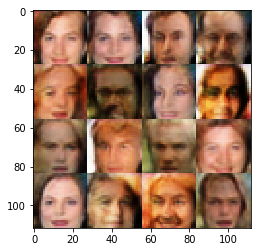

Timestamp 20170806-08-41-50.293 -  Epoch 1/1 -  Step 9010 -  D Loss: 1.1320 - G Loss: 1.1822
Timestamp 20170806-08-42-06.854 -  Epoch 1/1 -  Step 9020 -  D Loss: 1.3078 - G Loss: 0.9184
Timestamp 20170806-08-42-23.392 -  Epoch 1/1 -  Step 9030 -  D Loss: 1.1533 - G Loss: 0.8881
Timestamp 20170806-08-42-39.925 -  Epoch 1/1 -  Step 9040 -  D Loss: 1.3553 - G Loss: 0.8638
Timestamp 20170806-08-42-56.468 -  Epoch 1/1 -  Step 9050 -  D Loss: 0.9948 - G Loss: 0.8674
Timestamp 20170806-08-43-13.000 -  Epoch 1/1 -  Step 9060 -  D Loss: 1.1548 - G Loss: 0.9055
Timestamp 20170806-08-43-29.527 -  Epoch 1/1 -  Step 9070 -  D Loss: 1.4384 - G Loss: 0.7659
Timestamp 20170806-08-43-46.067 -  Epoch 1/1 -  Step 9080 -  D Loss: 0.9670 - G Loss: 1.1376
Timestamp 20170806-08-44-02.614 -  Epoch 1/1 -  Step 9090 -  D Loss: 0.9613 - G Loss: 1.0544
Timestamp 20170806-08-44-19.180 -  Epoch 1/1 -  Step 9100 -  D Loss: 1.2307 - G Loss: 1.1911


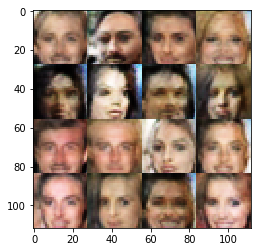

Timestamp 20170806-08-44-36.481 -  Epoch 1/1 -  Step 9110 -  D Loss: 1.0594 - G Loss: 1.1975
Timestamp 20170806-08-44-53.008 -  Epoch 1/1 -  Step 9120 -  D Loss: 1.4356 - G Loss: 0.8181
Timestamp 20170806-08-45-09.537 -  Epoch 1/1 -  Step 9130 -  D Loss: 1.0111 - G Loss: 0.8339
Timestamp 20170806-08-45-26.079 -  Epoch 1/1 -  Step 9140 -  D Loss: 0.9585 - G Loss: 1.5018
Timestamp 20170806-08-45-42.620 -  Epoch 1/1 -  Step 9150 -  D Loss: 1.2094 - G Loss: 1.1465
Timestamp 20170806-08-45-59.176 -  Epoch 1/1 -  Step 9160 -  D Loss: 1.0714 - G Loss: 1.1749
Timestamp 20170806-08-46-15.760 -  Epoch 1/1 -  Step 9170 -  D Loss: 1.2154 - G Loss: 1.0084
Timestamp 20170806-08-46-32.300 -  Epoch 1/1 -  Step 9180 -  D Loss: 0.8747 - G Loss: 1.1281
Timestamp 20170806-08-46-48.850 -  Epoch 1/1 -  Step 9190 -  D Loss: 1.3181 - G Loss: 0.9240
Timestamp 20170806-08-47-05.401 -  Epoch 1/1 -  Step 9200 -  D Loss: 1.2730 - G Loss: 1.1905


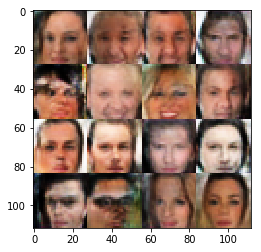

Timestamp 20170806-08-47-22.735 -  Epoch 1/1 -  Step 9210 -  D Loss: 1.1096 - G Loss: 1.1294
Timestamp 20170806-08-47-39.291 -  Epoch 1/1 -  Step 9220 -  D Loss: 1.0959 - G Loss: 1.2608
Timestamp 20170806-08-47-55.821 -  Epoch 1/1 -  Step 9230 -  D Loss: 1.0662 - G Loss: 0.9447
Timestamp 20170806-08-48-12.359 -  Epoch 1/1 -  Step 9240 -  D Loss: 1.1062 - G Loss: 1.2133
Timestamp 20170806-08-48-28.902 -  Epoch 1/1 -  Step 9250 -  D Loss: 0.9637 - G Loss: 1.3888
Timestamp 20170806-08-48-45.443 -  Epoch 1/1 -  Step 9260 -  D Loss: 1.1810 - G Loss: 1.4164
Timestamp 20170806-08-49-01.979 -  Epoch 1/1 -  Step 9270 -  D Loss: 1.3680 - G Loss: 0.7609
Timestamp 20170806-08-49-18.519 -  Epoch 1/1 -  Step 9280 -  D Loss: 1.1580 - G Loss: 1.2490
Timestamp 20170806-08-49-35.092 -  Epoch 1/1 -  Step 9290 -  D Loss: 1.3913 - G Loss: 0.8410
Timestamp 20170806-08-49-51.623 -  Epoch 1/1 -  Step 9300 -  D Loss: 1.1258 - G Loss: 0.8034


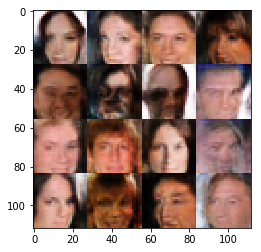

Timestamp 20170806-08-50-08.929 -  Epoch 1/1 -  Step 9310 -  D Loss: 1.3541 - G Loss: 0.8320
Timestamp 20170806-08-50-25.457 -  Epoch 1/1 -  Step 9320 -  D Loss: 1.0988 - G Loss: 0.6717
Timestamp 20170806-08-50-42.018 -  Epoch 1/1 -  Step 9330 -  D Loss: 1.4660 - G Loss: 0.7615
Timestamp 20170806-08-50-58.560 -  Epoch 1/1 -  Step 9340 -  D Loss: 1.1684 - G Loss: 1.0181
Timestamp 20170806-08-51-15.106 -  Epoch 1/1 -  Step 9350 -  D Loss: 1.3110 - G Loss: 1.2287
Timestamp 20170806-08-51-31.665 -  Epoch 1/1 -  Step 9360 -  D Loss: 1.0692 - G Loss: 1.0703
Timestamp 20170806-08-51-48.213 -  Epoch 1/1 -  Step 9370 -  D Loss: 1.5083 - G Loss: 0.7580
Timestamp 20170806-08-52-04.754 -  Epoch 1/1 -  Step 9380 -  D Loss: 1.1074 - G Loss: 1.4277
Timestamp 20170806-08-52-21.297 -  Epoch 1/1 -  Step 9390 -  D Loss: 1.3764 - G Loss: 0.9690
Timestamp 20170806-08-52-37.852 -  Epoch 1/1 -  Step 9400 -  D Loss: 1.2090 - G Loss: 1.2525


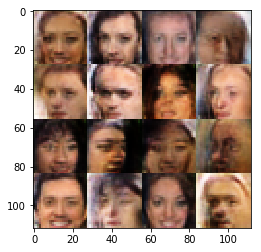

Timestamp 20170806-08-52-55.174 -  Epoch 1/1 -  Step 9410 -  D Loss: 1.2268 - G Loss: 0.9727
Timestamp 20170806-08-53-11.715 -  Epoch 1/1 -  Step 9420 -  D Loss: 0.9580 - G Loss: 1.3236
Timestamp 20170806-08-53-28.251 -  Epoch 1/1 -  Step 9430 -  D Loss: 1.2736 - G Loss: 0.9296
Timestamp 20170806-08-53-44.825 -  Epoch 1/1 -  Step 9440 -  D Loss: 1.2057 - G Loss: 1.1496
Timestamp 20170806-08-54-01.367 -  Epoch 1/1 -  Step 9450 -  D Loss: 1.0742 - G Loss: 1.5280
Timestamp 20170806-08-54-17.904 -  Epoch 1/1 -  Step 9460 -  D Loss: 1.1443 - G Loss: 1.2287
Timestamp 20170806-08-54-34.449 -  Epoch 1/1 -  Step 9470 -  D Loss: 1.2652 - G Loss: 1.2222
Timestamp 20170806-08-54-51.015 -  Epoch 1/1 -  Step 9480 -  D Loss: 1.2134 - G Loss: 0.7658
Timestamp 20170806-08-55-07.564 -  Epoch 1/1 -  Step 9490 -  D Loss: 1.6798 - G Loss: 0.6493
Timestamp 20170806-08-55-24.091 -  Epoch 1/1 -  Step 9500 -  D Loss: 1.2107 - G Loss: 1.1528


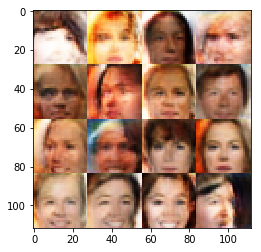

Timestamp 20170806-08-55-41.467 -  Epoch 1/1 -  Step 9510 -  D Loss: 1.2659 - G Loss: 0.9222
Timestamp 20170806-08-55-58.007 -  Epoch 1/1 -  Step 9520 -  D Loss: 1.3396 - G Loss: 1.7223
Timestamp 20170806-08-56-14.566 -  Epoch 1/1 -  Step 9530 -  D Loss: 1.1603 - G Loss: 1.0691
Timestamp 20170806-08-56-31.112 -  Epoch 1/1 -  Step 9540 -  D Loss: 1.4611 - G Loss: 0.8012
Timestamp 20170806-08-56-47.642 -  Epoch 1/1 -  Step 9550 -  D Loss: 1.1360 - G Loss: 1.0950
Timestamp 20170806-08-57-04.207 -  Epoch 1/1 -  Step 9560 -  D Loss: 1.0840 - G Loss: 1.1279
Timestamp 20170806-08-57-20.774 -  Epoch 1/1 -  Step 9570 -  D Loss: 1.1326 - G Loss: 1.1574
Timestamp 20170806-08-57-37.325 -  Epoch 1/1 -  Step 9580 -  D Loss: 1.2365 - G Loss: 1.0617
Timestamp 20170806-08-57-53.887 -  Epoch 1/1 -  Step 9590 -  D Loss: 0.9439 - G Loss: 1.2926
Timestamp 20170806-08-58-10.439 -  Epoch 1/1 -  Step 9600 -  D Loss: 1.1775 - G Loss: 1.0868


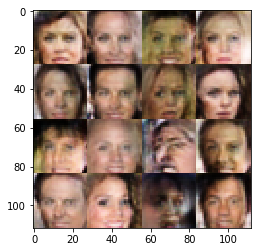

Timestamp 20170806-08-58-27.758 -  Epoch 1/1 -  Step 9610 -  D Loss: 1.0454 - G Loss: 1.0779
Timestamp 20170806-08-58-44.300 -  Epoch 1/1 -  Step 9620 -  D Loss: 1.1490 - G Loss: 0.8752
Timestamp 20170806-08-59-00.843 -  Epoch 1/1 -  Step 9630 -  D Loss: 1.3405 - G Loss: 0.9159
Timestamp 20170806-08-59-17.393 -  Epoch 1/1 -  Step 9640 -  D Loss: 1.2912 - G Loss: 0.8525
Timestamp 20170806-08-59-33.944 -  Epoch 1/1 -  Step 9650 -  D Loss: 1.3000 - G Loss: 1.0797
Timestamp 20170806-08-59-50.488 -  Epoch 1/1 -  Step 9660 -  D Loss: 1.2001 - G Loss: 1.1332
Timestamp 20170806-09-00-07.017 -  Epoch 1/1 -  Step 9670 -  D Loss: 0.9300 - G Loss: 0.9130
Timestamp 20170806-09-00-23.576 -  Epoch 1/1 -  Step 9680 -  D Loss: 1.3776 - G Loss: 0.8055
Timestamp 20170806-09-00-40.109 -  Epoch 1/1 -  Step 9690 -  D Loss: 1.3772 - G Loss: 1.0449
Timestamp 20170806-09-00-56.646 -  Epoch 1/1 -  Step 9700 -  D Loss: 1.2852 - G Loss: 1.0507


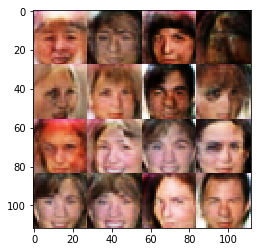

Timestamp 20170806-09-01-13.968 -  Epoch 1/1 -  Step 9710 -  D Loss: 0.9823 - G Loss: 1.3823
Timestamp 20170806-09-01-30.526 -  Epoch 1/1 -  Step 9720 -  D Loss: 1.5968 - G Loss: 0.4761
Timestamp 20170806-09-01-47.044 -  Epoch 1/1 -  Step 9730 -  D Loss: 1.1619 - G Loss: 1.4479
Timestamp 20170806-09-02-03.606 -  Epoch 1/1 -  Step 9740 -  D Loss: 1.4814 - G Loss: 1.1379
Timestamp 20170806-09-02-20.166 -  Epoch 1/1 -  Step 9750 -  D Loss: 1.0102 - G Loss: 1.3929
Timestamp 20170806-09-02-36.707 -  Epoch 1/1 -  Step 9760 -  D Loss: 0.8505 - G Loss: 0.9731
Timestamp 20170806-09-02-53.243 -  Epoch 1/1 -  Step 9770 -  D Loss: 1.1407 - G Loss: 0.9768
Timestamp 20170806-09-03-09.803 -  Epoch 1/1 -  Step 9780 -  D Loss: 1.3108 - G Loss: 0.9401
Timestamp 20170806-09-03-26.367 -  Epoch 1/1 -  Step 9790 -  D Loss: 1.2373 - G Loss: 0.8787
Timestamp 20170806-09-03-42.898 -  Epoch 1/1 -  Step 9800 -  D Loss: 1.2284 - G Loss: 0.9325


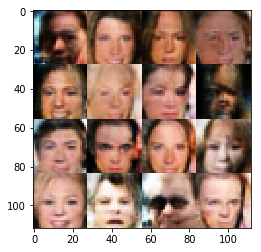

Timestamp 20170806-09-04-00.214 -  Epoch 1/1 -  Step 9810 -  D Loss: 1.2097 - G Loss: 0.9969
Timestamp 20170806-09-04-16.771 -  Epoch 1/1 -  Step 9820 -  D Loss: 1.2804 - G Loss: 0.6347
Timestamp 20170806-09-04-33.320 -  Epoch 1/1 -  Step 9830 -  D Loss: 0.9901 - G Loss: 0.7784
Timestamp 20170806-09-04-49.850 -  Epoch 1/1 -  Step 9840 -  D Loss: 1.3597 - G Loss: 0.7038
Timestamp 20170806-09-05-06.405 -  Epoch 1/1 -  Step 9850 -  D Loss: 1.0463 - G Loss: 1.0392
Timestamp 20170806-09-05-22.962 -  Epoch 1/1 -  Step 9860 -  D Loss: 1.2445 - G Loss: 0.6059
Timestamp 20170806-09-05-39.490 -  Epoch 1/1 -  Step 9870 -  D Loss: 1.4356 - G Loss: 0.9098
Timestamp 20170806-09-05-56.044 -  Epoch 1/1 -  Step 9880 -  D Loss: 0.9906 - G Loss: 1.3915
Timestamp 20170806-09-06-12.581 -  Epoch 1/1 -  Step 9890 -  D Loss: 1.0549 - G Loss: 0.9545
Timestamp 20170806-09-06-29.128 -  Epoch 1/1 -  Step 9900 -  D Loss: 1.2112 - G Loss: 1.0614


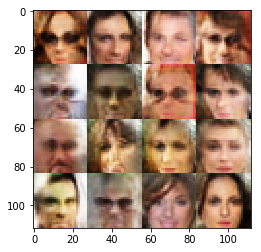

Timestamp 20170806-09-06-46.460 -  Epoch 1/1 -  Step 9910 -  D Loss: 0.9756 - G Loss: 0.9961
Timestamp 20170806-09-07-03.013 -  Epoch 1/1 -  Step 9920 -  D Loss: 0.9444 - G Loss: 1.3641
Timestamp 20170806-09-07-19.564 -  Epoch 1/1 -  Step 9930 -  D Loss: 1.1784 - G Loss: 1.1454
Timestamp 20170806-09-07-36.133 -  Epoch 1/1 -  Step 9940 -  D Loss: 1.1290 - G Loss: 1.1253
Timestamp 20170806-09-07-52.685 -  Epoch 1/1 -  Step 9950 -  D Loss: 1.1623 - G Loss: 0.6519
Timestamp 20170806-09-08-09.235 -  Epoch 1/1 -  Step 9960 -  D Loss: 1.1758 - G Loss: 0.9982
Timestamp 20170806-09-08-25.792 -  Epoch 1/1 -  Step 9970 -  D Loss: 1.0270 - G Loss: 0.9815
Timestamp 20170806-09-08-42.325 -  Epoch 1/1 -  Step 9980 -  D Loss: 1.2876 - G Loss: 1.0935
Timestamp 20170806-09-08-58.858 -  Epoch 1/1 -  Step 9990 -  D Loss: 1.2525 - G Loss: 1.0755
Timestamp 20170806-09-09-15.410 -  Epoch 1/1 -  Step 10000 -  D Loss: 0.9127 - G Loss: 1.1718


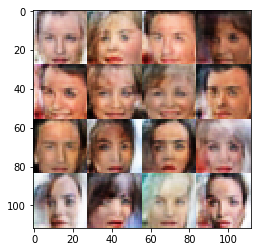

Timestamp 20170806-09-09-32.754 -  Epoch 1/1 -  Step 10010 -  D Loss: 1.3986 - G Loss: 0.6097
Timestamp 20170806-09-09-49.289 -  Epoch 1/1 -  Step 10020 -  D Loss: 1.4098 - G Loss: 1.1496
Timestamp 20170806-09-10-05.838 -  Epoch 1/1 -  Step 10030 -  D Loss: 1.1940 - G Loss: 1.0663
Timestamp 20170806-09-10-22.366 -  Epoch 1/1 -  Step 10040 -  D Loss: 1.5892 - G Loss: 0.4257
Timestamp 20170806-09-10-38.916 -  Epoch 1/1 -  Step 10050 -  D Loss: 1.3228 - G Loss: 1.0345
Timestamp 20170806-09-10-55.467 -  Epoch 1/1 -  Step 10060 -  D Loss: 1.2846 - G Loss: 1.1487
Timestamp 20170806-09-11-12.016 -  Epoch 1/1 -  Step 10070 -  D Loss: 1.2146 - G Loss: 0.9888
Timestamp 20170806-09-11-28.574 -  Epoch 1/1 -  Step 10080 -  D Loss: 1.0073 - G Loss: 1.4010
Timestamp 20170806-09-11-45.169 -  Epoch 1/1 -  Step 10090 -  D Loss: 0.9593 - G Loss: 1.1334
Timestamp 20170806-09-12-01.710 -  Epoch 1/1 -  Step 10100 -  D Loss: 1.1139 - G Loss: 1.0923


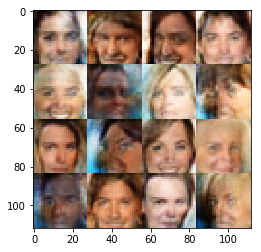

Timestamp 20170806-09-12-19.044 -  Epoch 1/1 -  Step 10110 -  D Loss: 1.1382 - G Loss: 0.8647
Timestamp 20170806-09-12-35.598 -  Epoch 1/1 -  Step 10120 -  D Loss: 0.9736 - G Loss: 0.9916
Timestamp 20170806-09-12-52.133 -  Epoch 1/1 -  Step 10130 -  D Loss: 1.0588 - G Loss: 0.9806
Timestamp 20170806-09-13-08.688 -  Epoch 1/1 -  Step 10140 -  D Loss: 1.0587 - G Loss: 1.1181
Timestamp 20170806-09-13-25.215 -  Epoch 1/1 -  Step 10150 -  D Loss: 1.2043 - G Loss: 1.0131
Timestamp 20170806-09-13-41.774 -  Epoch 1/1 -  Step 10160 -  D Loss: 1.1441 - G Loss: 1.2776
Timestamp 20170806-09-13-58.333 -  Epoch 1/1 -  Step 10170 -  D Loss: 0.9257 - G Loss: 1.2717
Timestamp 20170806-09-14-14.896 -  Epoch 1/1 -  Step 10180 -  D Loss: 1.3337 - G Loss: 1.2322
Timestamp 20170806-09-14-31.443 -  Epoch 1/1 -  Step 10190 -  D Loss: 0.8888 - G Loss: 1.0450
Timestamp 20170806-09-14-48.001 -  Epoch 1/1 -  Step 10200 -  D Loss: 1.1880 - G Loss: 0.7940


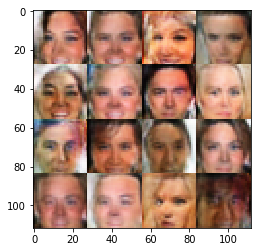

Timestamp 20170806-09-15-05.342 -  Epoch 1/1 -  Step 10210 -  D Loss: 1.3767 - G Loss: 1.0374
Timestamp 20170806-09-15-21.884 -  Epoch 1/1 -  Step 10220 -  D Loss: 1.4838 - G Loss: 0.6933
Timestamp 20170806-09-15-38.466 -  Epoch 1/1 -  Step 10230 -  D Loss: 1.2487 - G Loss: 0.8543
Timestamp 20170806-09-15-55.028 -  Epoch 1/1 -  Step 10240 -  D Loss: 1.1525 - G Loss: 1.0633
Timestamp 20170806-09-16-11.568 -  Epoch 1/1 -  Step 10250 -  D Loss: 1.1688 - G Loss: 1.0894
Timestamp 20170806-09-16-28.088 -  Epoch 1/1 -  Step 10260 -  D Loss: 1.2700 - G Loss: 1.2026
Timestamp 20170806-09-16-44.633 -  Epoch 1/1 -  Step 10270 -  D Loss: 1.3327 - G Loss: 0.7010
Timestamp 20170806-09-17-01.174 -  Epoch 1/1 -  Step 10280 -  D Loss: 1.1969 - G Loss: 0.6392
Timestamp 20170806-09-17-17.707 -  Epoch 1/1 -  Step 10290 -  D Loss: 1.0664 - G Loss: 1.1852
Timestamp 20170806-09-17-34.242 -  Epoch 1/1 -  Step 10300 -  D Loss: 1.3082 - G Loss: 0.7108


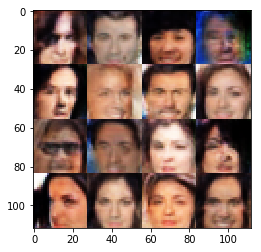

Timestamp 20170806-09-17-51.671 -  Epoch 1/1 -  Step 10310 -  D Loss: 1.2895 - G Loss: 0.7606
Timestamp 20170806-09-18-08.211 -  Epoch 1/1 -  Step 10320 -  D Loss: 1.3497 - G Loss: 1.1004
Timestamp 20170806-09-18-24.751 -  Epoch 1/1 -  Step 10330 -  D Loss: 1.1013 - G Loss: 1.1228
Timestamp 20170806-09-18-41.289 -  Epoch 1/1 -  Step 10340 -  D Loss: 1.1432 - G Loss: 0.6930
Timestamp 20170806-09-18-57.858 -  Epoch 1/1 -  Step 10350 -  D Loss: 1.0709 - G Loss: 1.3317
Timestamp 20170806-09-19-14.421 -  Epoch 1/1 -  Step 10360 -  D Loss: 1.1350 - G Loss: 1.0974
Timestamp 20170806-09-19-30.960 -  Epoch 1/1 -  Step 10370 -  D Loss: 1.1105 - G Loss: 1.3225
Timestamp 20170806-09-19-47.500 -  Epoch 1/1 -  Step 10380 -  D Loss: 1.2015 - G Loss: 0.7125
Timestamp 20170806-09-20-04.051 -  Epoch 1/1 -  Step 10390 -  D Loss: 1.1601 - G Loss: 1.1440
Timestamp 20170806-09-20-20.605 -  Epoch 1/1 -  Step 10400 -  D Loss: 1.2559 - G Loss: 0.9772


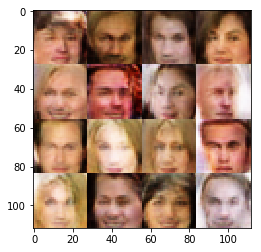

Timestamp 20170806-09-20-37.921 -  Epoch 1/1 -  Step 10410 -  D Loss: 1.2093 - G Loss: 1.0391
Timestamp 20170806-09-20-54.462 -  Epoch 1/1 -  Step 10420 -  D Loss: 1.0612 - G Loss: 0.8991
Timestamp 20170806-09-21-10.992 -  Epoch 1/1 -  Step 10430 -  D Loss: 1.3529 - G Loss: 0.7126
Timestamp 20170806-09-21-27.533 -  Epoch 1/1 -  Step 10440 -  D Loss: 1.0196 - G Loss: 0.8563
Timestamp 20170806-09-21-44.100 -  Epoch 1/1 -  Step 10450 -  D Loss: 1.1059 - G Loss: 1.1697
Timestamp 20170806-09-22-00.660 -  Epoch 1/1 -  Step 10460 -  D Loss: 1.3217 - G Loss: 1.0981
Timestamp 20170806-09-22-17.208 -  Epoch 1/1 -  Step 10470 -  D Loss: 1.0683 - G Loss: 1.2138
Timestamp 20170806-09-22-33.755 -  Epoch 1/1 -  Step 10480 -  D Loss: 1.1072 - G Loss: 1.1090
Timestamp 20170806-09-22-50.306 -  Epoch 1/1 -  Step 10490 -  D Loss: 1.1649 - G Loss: 0.7652
Timestamp 20170806-09-23-06.856 -  Epoch 1/1 -  Step 10500 -  D Loss: 1.2741 - G Loss: 1.0676


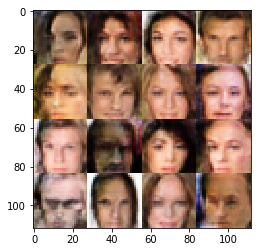

Timestamp 20170806-09-23-24.185 -  Epoch 1/1 -  Step 10510 -  D Loss: 1.0576 - G Loss: 1.0195
Timestamp 20170806-09-23-40.734 -  Epoch 1/1 -  Step 10520 -  D Loss: 1.4468 - G Loss: 0.8863
Timestamp 20170806-09-23-57.283 -  Epoch 1/1 -  Step 10530 -  D Loss: 1.0047 - G Loss: 1.1955
Timestamp 20170806-09-24-13.840 -  Epoch 1/1 -  Step 10540 -  D Loss: 1.4599 - G Loss: 1.0084
Timestamp 20170806-09-24-30.399 -  Epoch 1/1 -  Step 10550 -  D Loss: 1.1249 - G Loss: 1.2684
Timestamp 20170806-09-24-46.969 -  Epoch 1/1 -  Step 10560 -  D Loss: 1.1820 - G Loss: 1.0184
Timestamp 20170806-09-25-03.516 -  Epoch 1/1 -  Step 10570 -  D Loss: 1.1845 - G Loss: 1.2158
Timestamp 20170806-09-25-20.058 -  Epoch 1/1 -  Step 10580 -  D Loss: 0.9748 - G Loss: 1.0092
Timestamp 20170806-09-25-36.622 -  Epoch 1/1 -  Step 10590 -  D Loss: 1.2209 - G Loss: 1.1274
Timestamp 20170806-09-25-53.165 -  Epoch 1/1 -  Step 10600 -  D Loss: 1.1974 - G Loss: 0.9614


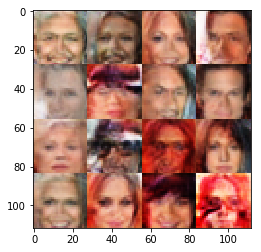

Timestamp 20170806-09-26-10.537 -  Epoch 1/1 -  Step 10610 -  D Loss: 1.0625 - G Loss: 0.9495
Timestamp 20170806-09-26-27.079 -  Epoch 1/1 -  Step 10620 -  D Loss: 1.1756 - G Loss: 0.7229
Timestamp 20170806-09-26-43.608 -  Epoch 1/1 -  Step 10630 -  D Loss: 1.1656 - G Loss: 1.1123
Timestamp 20170806-09-27-00.152 -  Epoch 1/1 -  Step 10640 -  D Loss: 1.3263 - G Loss: 0.9228
Timestamp 20170806-09-27-16.699 -  Epoch 1/1 -  Step 10650 -  D Loss: 1.2981 - G Loss: 1.4565
Timestamp 20170806-09-27-33.255 -  Epoch 1/1 -  Step 10660 -  D Loss: 1.0817 - G Loss: 1.0816
Timestamp 20170806-09-27-49.803 -  Epoch 1/1 -  Step 10670 -  D Loss: 1.3353 - G Loss: 0.5889
Timestamp 20170806-09-28-06.336 -  Epoch 1/1 -  Step 10680 -  D Loss: 1.3517 - G Loss: 1.1384
Timestamp 20170806-09-28-22.865 -  Epoch 1/1 -  Step 10690 -  D Loss: 1.2106 - G Loss: 0.9513
Timestamp 20170806-09-28-39.416 -  Epoch 1/1 -  Step 10700 -  D Loss: 0.9088 - G Loss: 1.0402


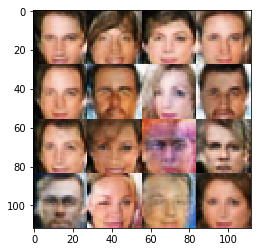

Timestamp 20170806-09-28-56.753 -  Epoch 1/1 -  Step 10710 -  D Loss: 1.0595 - G Loss: 1.0860
Timestamp 20170806-09-29-13.298 -  Epoch 1/1 -  Step 10720 -  D Loss: 1.1652 - G Loss: 0.7922
Timestamp 20170806-09-29-29.851 -  Epoch 1/1 -  Step 10730 -  D Loss: 1.1937 - G Loss: 1.0929
Timestamp 20170806-09-29-46.404 -  Epoch 1/1 -  Step 10740 -  D Loss: 1.0832 - G Loss: 0.9366
Timestamp 20170806-09-30-02.950 -  Epoch 1/1 -  Step 10750 -  D Loss: 1.0748 - G Loss: 1.3522
Timestamp 20170806-09-30-19.483 -  Epoch 1/1 -  Step 10760 -  D Loss: 1.0964 - G Loss: 1.2254
Timestamp 20170806-09-30-36.038 -  Epoch 1/1 -  Step 10770 -  D Loss: 1.0330 - G Loss: 1.2484
Timestamp 20170806-09-30-52.580 -  Epoch 1/1 -  Step 10780 -  D Loss: 1.0706 - G Loss: 1.0836
Timestamp 20170806-09-31-09.126 -  Epoch 1/1 -  Step 10790 -  D Loss: 1.0656 - G Loss: 1.1608
Timestamp 20170806-09-31-25.664 -  Epoch 1/1 -  Step 10800 -  D Loss: 1.1702 - G Loss: 0.8902


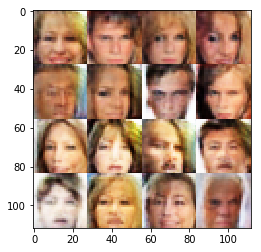

Timestamp 20170806-09-31-42.996 -  Epoch 1/1 -  Step 10810 -  D Loss: 1.1181 - G Loss: 1.0100
Timestamp 20170806-09-31-59.531 -  Epoch 1/1 -  Step 10820 -  D Loss: 1.2472 - G Loss: 1.1989
Timestamp 20170806-09-32-16.089 -  Epoch 1/1 -  Step 10830 -  D Loss: 1.1400 - G Loss: 0.9798
Timestamp 20170806-09-32-32.645 -  Epoch 1/1 -  Step 10840 -  D Loss: 1.1339 - G Loss: 0.8161
Timestamp 20170806-09-32-49.182 -  Epoch 1/1 -  Step 10850 -  D Loss: 1.4886 - G Loss: 0.5482
Timestamp 20170806-09-33-05.723 -  Epoch 1/1 -  Step 10860 -  D Loss: 1.6780 - G Loss: 0.5244
Timestamp 20170806-09-33-22.265 -  Epoch 1/1 -  Step 10870 -  D Loss: 1.0262 - G Loss: 1.2013
Timestamp 20170806-09-33-38.814 -  Epoch 1/1 -  Step 10880 -  D Loss: 1.2280 - G Loss: 0.8805
Timestamp 20170806-09-33-55.365 -  Epoch 1/1 -  Step 10890 -  D Loss: 1.2783 - G Loss: 0.9651
Timestamp 20170806-09-34-11.934 -  Epoch 1/1 -  Step 10900 -  D Loss: 1.2383 - G Loss: 1.1002


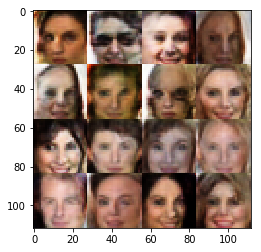

Timestamp 20170806-09-34-29.296 -  Epoch 1/1 -  Step 10910 -  D Loss: 1.3401 - G Loss: 0.9401
Timestamp 20170806-09-34-45.831 -  Epoch 1/1 -  Step 10920 -  D Loss: 1.0358 - G Loss: 1.2804
Timestamp 20170806-09-35-02.374 -  Epoch 1/1 -  Step 10930 -  D Loss: 1.2417 - G Loss: 0.6067
Timestamp 20170806-09-35-18.927 -  Epoch 1/1 -  Step 10940 -  D Loss: 1.3496 - G Loss: 1.0597
Timestamp 20170806-09-35-35.516 -  Epoch 1/1 -  Step 10950 -  D Loss: 1.2417 - G Loss: 0.9788
Timestamp 20170806-09-35-52.054 -  Epoch 1/1 -  Step 10960 -  D Loss: 1.1660 - G Loss: 0.7245
Timestamp 20170806-09-36-08.607 -  Epoch 1/1 -  Step 10970 -  D Loss: 1.1855 - G Loss: 1.3555
Timestamp 20170806-09-36-25.143 -  Epoch 1/1 -  Step 10980 -  D Loss: 1.0525 - G Loss: 1.0029
Timestamp 20170806-09-36-41.676 -  Epoch 1/1 -  Step 10990 -  D Loss: 1.2448 - G Loss: 1.2332
Timestamp 20170806-09-36-58.227 -  Epoch 1/1 -  Step 11000 -  D Loss: 1.3354 - G Loss: 0.6202


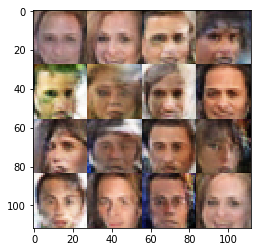

Timestamp 20170806-09-37-15.572 -  Epoch 1/1 -  Step 11010 -  D Loss: 1.4239 - G Loss: 1.0525
Timestamp 20170806-09-37-32.133 -  Epoch 1/1 -  Step 11020 -  D Loss: 1.2028 - G Loss: 0.8878
Timestamp 20170806-09-37-48.668 -  Epoch 1/1 -  Step 11030 -  D Loss: 0.8575 - G Loss: 1.5982
Timestamp 20170806-09-38-05.215 -  Epoch 1/1 -  Step 11040 -  D Loss: 1.0654 - G Loss: 1.8600
Timestamp 20170806-09-38-21.755 -  Epoch 1/1 -  Step 11050 -  D Loss: 1.2819 - G Loss: 1.0825
Timestamp 20170806-09-38-38.294 -  Epoch 1/1 -  Step 11060 -  D Loss: 1.1574 - G Loss: 0.9959
Timestamp 20170806-09-38-54.851 -  Epoch 1/1 -  Step 11070 -  D Loss: 1.4404 - G Loss: 1.0001
Timestamp 20170806-09-39-11.415 -  Epoch 1/1 -  Step 11080 -  D Loss: 1.1203 - G Loss: 0.9326
Timestamp 20170806-09-39-27.963 -  Epoch 1/1 -  Step 11090 -  D Loss: 1.3886 - G Loss: 0.8827
Timestamp 20170806-09-39-44.531 -  Epoch 1/1 -  Step 11100 -  D Loss: 1.3534 - G Loss: 0.6968


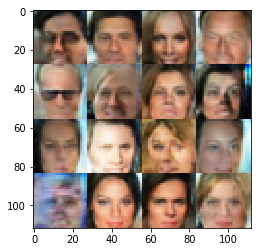

Timestamp 20170806-09-40-01.880 -  Epoch 1/1 -  Step 11110 -  D Loss: 1.1162 - G Loss: 0.9633
Timestamp 20170806-09-40-18.427 -  Epoch 1/1 -  Step 11120 -  D Loss: 1.3226 - G Loss: 0.7393
Timestamp 20170806-09-40-34.958 -  Epoch 1/1 -  Step 11130 -  D Loss: 1.0582 - G Loss: 1.0964
Timestamp 20170806-09-40-51.493 -  Epoch 1/1 -  Step 11140 -  D Loss: 1.1690 - G Loss: 1.1845
Timestamp 20170806-09-41-08.043 -  Epoch 1/1 -  Step 11150 -  D Loss: 1.1961 - G Loss: 1.3018
Timestamp 20170806-09-41-24.585 -  Epoch 1/1 -  Step 11160 -  D Loss: 1.0381 - G Loss: 1.1782
Timestamp 20170806-09-41-41.145 -  Epoch 1/1 -  Step 11170 -  D Loss: 1.2673 - G Loss: 1.0869
Timestamp 20170806-09-41-57.675 -  Epoch 1/1 -  Step 11180 -  D Loss: 1.0361 - G Loss: 1.0251
Timestamp 20170806-09-42-14.222 -  Epoch 1/1 -  Step 11190 -  D Loss: 1.0893 - G Loss: 1.0640
Timestamp 20170806-09-42-30.765 -  Epoch 1/1 -  Step 11200 -  D Loss: 1.3953 - G Loss: 1.2637


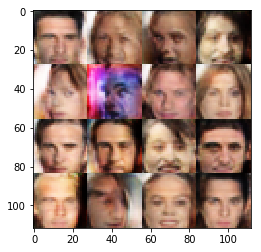

Timestamp 20170806-09-42-48.163 -  Epoch 1/1 -  Step 11210 -  D Loss: 1.2916 - G Loss: 0.9997
Timestamp 20170806-09-43-04.710 -  Epoch 1/1 -  Step 11220 -  D Loss: 1.1590 - G Loss: 1.1420
Timestamp 20170806-09-43-21.251 -  Epoch 1/1 -  Step 11230 -  D Loss: 1.1029 - G Loss: 1.2492
Timestamp 20170806-09-43-37.799 -  Epoch 1/1 -  Step 11240 -  D Loss: 1.3327 - G Loss: 0.7447
Timestamp 20170806-09-43-54.369 -  Epoch 1/1 -  Step 11250 -  D Loss: 1.2364 - G Loss: 0.8847
Timestamp 20170806-09-44-10.931 -  Epoch 1/1 -  Step 11260 -  D Loss: 1.2254 - G Loss: 0.9270
Timestamp 20170806-09-44-27.487 -  Epoch 1/1 -  Step 11270 -  D Loss: 1.2130 - G Loss: 0.9005
Timestamp 20170806-09-44-44.035 -  Epoch 1/1 -  Step 11280 -  D Loss: 1.1747 - G Loss: 0.9427
Timestamp 20170806-09-45-00.588 -  Epoch 1/1 -  Step 11290 -  D Loss: 1.2005 - G Loss: 0.9376
Timestamp 20170806-09-45-17.127 -  Epoch 1/1 -  Step 11300 -  D Loss: 1.1423 - G Loss: 0.8220


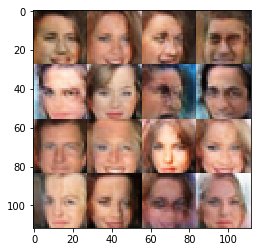

Timestamp 20170806-09-45-34.483 -  Epoch 1/1 -  Step 11310 -  D Loss: 1.1795 - G Loss: 0.8956
Timestamp 20170806-09-45-50.993 -  Epoch 1/1 -  Step 11320 -  D Loss: 1.0370 - G Loss: 0.8498
Timestamp 20170806-09-46-07.539 -  Epoch 1/1 -  Step 11330 -  D Loss: 1.5862 - G Loss: 0.4552
Timestamp 20170806-09-46-24.118 -  Epoch 1/1 -  Step 11340 -  D Loss: 1.1157 - G Loss: 0.8799
Timestamp 20170806-09-46-40.638 -  Epoch 1/1 -  Step 11350 -  D Loss: 1.4119 - G Loss: 0.8322
Timestamp 20170806-09-46-57.164 -  Epoch 1/1 -  Step 11360 -  D Loss: 1.2057 - G Loss: 1.0895
Timestamp 20170806-09-47-13.697 -  Epoch 1/1 -  Step 11370 -  D Loss: 1.4441 - G Loss: 0.7662
Timestamp 20170806-09-47-30.252 -  Epoch 1/1 -  Step 11380 -  D Loss: 1.1801 - G Loss: 0.8825
Timestamp 20170806-09-47-46.837 -  Epoch 1/1 -  Step 11390 -  D Loss: 1.2300 - G Loss: 0.9221
Timestamp 20170806-09-48-03.405 -  Epoch 1/1 -  Step 11400 -  D Loss: 1.1683 - G Loss: 1.2287


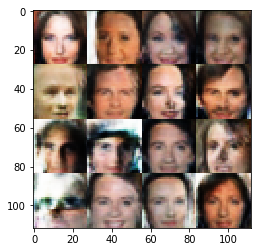

Timestamp 20170806-09-48-20.770 -  Epoch 1/1 -  Step 11410 -  D Loss: 1.3321 - G Loss: 0.6214
Timestamp 20170806-09-48-37.322 -  Epoch 1/1 -  Step 11420 -  D Loss: 1.1493 - G Loss: 0.8114
Timestamp 20170806-09-48-53.850 -  Epoch 1/1 -  Step 11430 -  D Loss: 1.1993 - G Loss: 0.7445
Timestamp 20170806-09-49-10.407 -  Epoch 1/1 -  Step 11440 -  D Loss: 1.0392 - G Loss: 1.1082
Timestamp 20170806-09-49-26.974 -  Epoch 1/1 -  Step 11450 -  D Loss: 1.3151 - G Loss: 1.3969
Timestamp 20170806-09-49-43.529 -  Epoch 1/1 -  Step 11460 -  D Loss: 1.3199 - G Loss: 0.8327
Timestamp 20170806-09-50-00.061 -  Epoch 1/1 -  Step 11470 -  D Loss: 1.4221 - G Loss: 0.8533
Timestamp 20170806-09-50-16.616 -  Epoch 1/1 -  Step 11480 -  D Loss: 1.4418 - G Loss: 0.9724
Timestamp 20170806-09-50-33.161 -  Epoch 1/1 -  Step 11490 -  D Loss: 1.3284 - G Loss: 0.6308
Timestamp 20170806-09-50-49.690 -  Epoch 1/1 -  Step 11500 -  D Loss: 1.4508 - G Loss: 0.9269


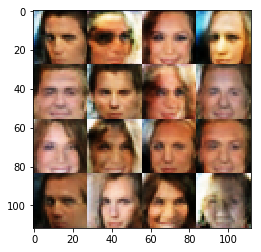

Timestamp 20170806-09-51-07.049 -  Epoch 1/1 -  Step 11510 -  D Loss: 1.1452 - G Loss: 1.0147
Timestamp 20170806-09-51-23.584 -  Epoch 1/1 -  Step 11520 -  D Loss: 1.0284 - G Loss: 1.1384
Timestamp 20170806-09-51-40.126 -  Epoch 1/1 -  Step 11530 -  D Loss: 1.3893 - G Loss: 1.0817
Timestamp 20170806-09-51-56.655 -  Epoch 1/1 -  Step 11540 -  D Loss: 1.2504 - G Loss: 1.0418
Timestamp 20170806-09-52-13.212 -  Epoch 1/1 -  Step 11550 -  D Loss: 1.2264 - G Loss: 0.9093
Timestamp 20170806-09-52-29.768 -  Epoch 1/1 -  Step 11560 -  D Loss: 1.2807 - G Loss: 0.9280
Timestamp 20170806-09-52-46.343 -  Epoch 1/1 -  Step 11570 -  D Loss: 1.4566 - G Loss: 0.9564
Timestamp 20170806-09-53-02.876 -  Epoch 1/1 -  Step 11580 -  D Loss: 1.4525 - G Loss: 0.7144
Timestamp 20170806-09-53-19.429 -  Epoch 1/1 -  Step 11590 -  D Loss: 1.0794 - G Loss: 1.3308
Timestamp 20170806-09-53-35.985 -  Epoch 1/1 -  Step 11600 -  D Loss: 1.1037 - G Loss: 0.7867


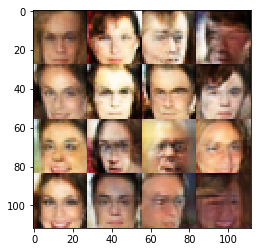

Timestamp 20170806-09-53-53.297 -  Epoch 1/1 -  Step 11610 -  D Loss: 1.2113 - G Loss: 1.0154
Timestamp 20170806-09-54-09.863 -  Epoch 1/1 -  Step 11620 -  D Loss: 1.1536 - G Loss: 1.3672
Timestamp 20170806-09-54-26.407 -  Epoch 1/1 -  Step 11630 -  D Loss: 1.1574 - G Loss: 1.1148
Timestamp 20170806-09-54-42.965 -  Epoch 1/1 -  Step 11640 -  D Loss: 1.1083 - G Loss: 1.1224
Timestamp 20170806-09-54-59.498 -  Epoch 1/1 -  Step 11650 -  D Loss: 1.4619 - G Loss: 1.1345
Timestamp 20170806-09-55-16.056 -  Epoch 1/1 -  Step 11660 -  D Loss: 1.2560 - G Loss: 0.9680
Timestamp 20170806-09-55-32.638 -  Epoch 1/1 -  Step 11670 -  D Loss: 1.2349 - G Loss: 0.9134
Timestamp 20170806-09-55-49.173 -  Epoch 1/1 -  Step 11680 -  D Loss: 1.1261 - G Loss: 0.9851
Timestamp 20170806-09-56-05.724 -  Epoch 1/1 -  Step 11690 -  D Loss: 1.2725 - G Loss: 1.4290
Timestamp 20170806-09-56-22.279 -  Epoch 1/1 -  Step 11700 -  D Loss: 1.4485 - G Loss: 1.1704


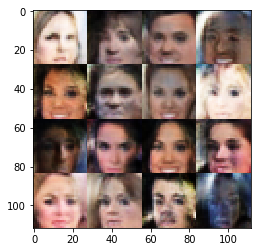

Timestamp 20170806-09-56-39.597 -  Epoch 1/1 -  Step 11710 -  D Loss: 1.2904 - G Loss: 0.9261
Timestamp 20170806-09-56-56.151 -  Epoch 1/1 -  Step 11720 -  D Loss: 1.0827 - G Loss: 1.0351
Timestamp 20170806-09-57-12.683 -  Epoch 1/1 -  Step 11730 -  D Loss: 1.3601 - G Loss: 0.6767
Timestamp 20170806-09-57-29.257 -  Epoch 1/1 -  Step 11740 -  D Loss: 1.1528 - G Loss: 1.2360
Timestamp 20170806-09-57-45.791 -  Epoch 1/1 -  Step 11750 -  D Loss: 1.1077 - G Loss: 1.0718
Timestamp 20170806-09-58-02.328 -  Epoch 1/1 -  Step 11760 -  D Loss: 1.1475 - G Loss: 1.0437
Timestamp 20170806-09-58-18.878 -  Epoch 1/1 -  Step 11770 -  D Loss: 1.3976 - G Loss: 0.7412
Timestamp 20170806-09-58-35.444 -  Epoch 1/1 -  Step 11780 -  D Loss: 1.3300 - G Loss: 1.2662
Timestamp 20170806-09-58-51.971 -  Epoch 1/1 -  Step 11790 -  D Loss: 0.9080 - G Loss: 0.9708
Timestamp 20170806-09-59-08.488 -  Epoch 1/1 -  Step 11800 -  D Loss: 1.1667 - G Loss: 1.1310


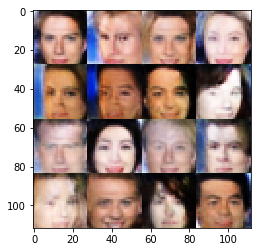

Timestamp 20170806-09-59-26.866 -  Epoch 1/1 -  Step 11810 -  D Loss: 1.1423 - G Loss: 1.5217
Timestamp 20170806-09-59-43.419 -  Epoch 1/1 -  Step 11820 -  D Loss: 1.1150 - G Loss: 1.0820
Timestamp 20170806-09-59-59.964 -  Epoch 1/1 -  Step 11830 -  D Loss: 1.0615 - G Loss: 0.9226
Timestamp 20170806-10-00-16.546 -  Epoch 1/1 -  Step 11840 -  D Loss: 1.0333 - G Loss: 1.0483
Timestamp 20170806-10-00-33.105 -  Epoch 1/1 -  Step 11850 -  D Loss: 1.2481 - G Loss: 0.9855
Timestamp 20170806-10-00-49.644 -  Epoch 1/1 -  Step 11860 -  D Loss: 0.9946 - G Loss: 1.1112
Timestamp 20170806-10-01-06.182 -  Epoch 1/1 -  Step 11870 -  D Loss: 1.0463 - G Loss: 0.9020
Timestamp 20170806-10-01-22.737 -  Epoch 1/1 -  Step 11880 -  D Loss: 1.2881 - G Loss: 1.1756
Timestamp 20170806-10-01-39.289 -  Epoch 1/1 -  Step 11890 -  D Loss: 1.0513 - G Loss: 1.2762
Timestamp 20170806-10-01-55.848 -  Epoch 1/1 -  Step 11900 -  D Loss: 1.2757 - G Loss: 0.8300


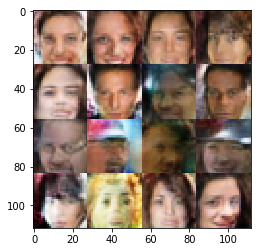

Timestamp 20170806-10-02-13.242 -  Epoch 1/1 -  Step 11910 -  D Loss: 1.2566 - G Loss: 0.8956
Timestamp 20170806-10-02-29.775 -  Epoch 1/1 -  Step 11920 -  D Loss: 1.3906 - G Loss: 0.9559
Timestamp 20170806-10-02-46.331 -  Epoch 1/1 -  Step 11930 -  D Loss: 1.2713 - G Loss: 0.9972
Timestamp 20170806-10-03-02.893 -  Epoch 1/1 -  Step 11940 -  D Loss: 1.1721 - G Loss: 0.9062
Timestamp 20170806-10-03-19.450 -  Epoch 1/1 -  Step 11950 -  D Loss: 1.1785 - G Loss: 0.8773
Timestamp 20170806-10-03-36.018 -  Epoch 1/1 -  Step 11960 -  D Loss: 1.2797 - G Loss: 0.8415
Timestamp 20170806-10-03-52.576 -  Epoch 1/1 -  Step 11970 -  D Loss: 1.2569 - G Loss: 1.2445
Timestamp 20170806-10-04-09.121 -  Epoch 1/1 -  Step 11980 -  D Loss: 1.3466 - G Loss: 0.9098
Timestamp 20170806-10-04-25.688 -  Epoch 1/1 -  Step 11990 -  D Loss: 1.0571 - G Loss: 0.8084
Timestamp 20170806-10-04-42.245 -  Epoch 1/1 -  Step 12000 -  D Loss: 1.3739 - G Loss: 0.8614


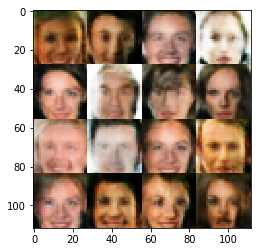

Timestamp 20170806-10-04-59.617 -  Epoch 1/1 -  Step 12010 -  D Loss: 1.3838 - G Loss: 1.0753
Timestamp 20170806-10-05-16.166 -  Epoch 1/1 -  Step 12020 -  D Loss: 1.2558 - G Loss: 0.6835
Timestamp 20170806-10-05-32.725 -  Epoch 1/1 -  Step 12030 -  D Loss: 1.1534 - G Loss: 0.6803
Timestamp 20170806-10-05-49.258 -  Epoch 1/1 -  Step 12040 -  D Loss: 1.1372 - G Loss: 1.2478
Timestamp 20170806-10-06-05.810 -  Epoch 1/1 -  Step 12050 -  D Loss: 1.2055 - G Loss: 0.7947
Timestamp 20170806-10-06-22.366 -  Epoch 1/1 -  Step 12060 -  D Loss: 1.3242 - G Loss: 1.2744
Timestamp 20170806-10-06-38.934 -  Epoch 1/1 -  Step 12070 -  D Loss: 1.2740 - G Loss: 1.1345
Timestamp 20170806-10-06-55.492 -  Epoch 1/1 -  Step 12080 -  D Loss: 1.2115 - G Loss: 0.9811
Timestamp 20170806-10-07-12.055 -  Epoch 1/1 -  Step 12090 -  D Loss: 1.2805 - G Loss: 1.1725
Timestamp 20170806-10-07-28.631 -  Epoch 1/1 -  Step 12100 -  D Loss: 1.2287 - G Loss: 0.7433


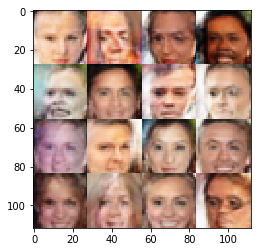

Timestamp 20170806-10-07-46.044 -  Epoch 1/1 -  Step 12110 -  D Loss: 0.9997 - G Loss: 1.3240
Timestamp 20170806-10-08-02.664 -  Epoch 1/1 -  Step 12120 -  D Loss: 1.4110 - G Loss: 0.8622
Timestamp 20170806-10-08-19.271 -  Epoch 1/1 -  Step 12130 -  D Loss: 1.3892 - G Loss: 1.1389
Timestamp 20170806-10-08-35.893 -  Epoch 1/1 -  Step 12140 -  D Loss: 1.1111 - G Loss: 0.8459
Timestamp 20170806-10-08-52.528 -  Epoch 1/1 -  Step 12150 -  D Loss: 1.1805 - G Loss: 0.8824
Timestamp 20170806-10-09-09.139 -  Epoch 1/1 -  Step 12160 -  D Loss: 1.1789 - G Loss: 1.0119
Timestamp 20170806-10-09-25.700 -  Epoch 1/1 -  Step 12170 -  D Loss: 1.2194 - G Loss: 0.7842
Timestamp 20170806-10-09-42.349 -  Epoch 1/1 -  Step 12180 -  D Loss: 1.1657 - G Loss: 1.1311
Timestamp 20170806-10-09-58.927 -  Epoch 1/1 -  Step 12190 -  D Loss: 1.2173 - G Loss: 0.7599
Timestamp 20170806-10-10-15.491 -  Epoch 1/1 -  Step 12200 -  D Loss: 1.0561 - G Loss: 1.2415


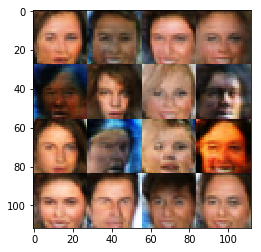

Timestamp 20170806-10-10-32.895 -  Epoch 1/1 -  Step 12210 -  D Loss: 1.1734 - G Loss: 0.9261
Timestamp 20170806-10-10-49.497 -  Epoch 1/1 -  Step 12220 -  D Loss: 1.3730 - G Loss: 0.5540
Timestamp 20170806-10-11-06.069 -  Epoch 1/1 -  Step 12230 -  D Loss: 1.2489 - G Loss: 1.0078
Timestamp 20170806-10-11-22.652 -  Epoch 1/1 -  Step 12240 -  D Loss: 1.0140 - G Loss: 1.0935
Timestamp 20170806-10-11-39.219 -  Epoch 1/1 -  Step 12250 -  D Loss: 1.0199 - G Loss: 0.9464
Timestamp 20170806-10-11-55.815 -  Epoch 1/1 -  Step 12260 -  D Loss: 1.1825 - G Loss: 1.0828
Timestamp 20170806-10-12-12.373 -  Epoch 1/1 -  Step 12270 -  D Loss: 1.0407 - G Loss: 1.2889
Timestamp 20170806-10-12-28.935 -  Epoch 1/1 -  Step 12280 -  D Loss: 1.1402 - G Loss: 0.8637
Timestamp 20170806-10-12-45.487 -  Epoch 1/1 -  Step 12290 -  D Loss: 1.3834 - G Loss: 0.7622
Timestamp 20170806-10-13-02.053 -  Epoch 1/1 -  Step 12300 -  D Loss: 1.0971 - G Loss: 0.8581


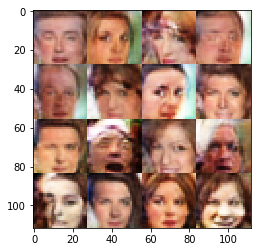

Timestamp 20170806-10-13-19.480 -  Epoch 1/1 -  Step 12310 -  D Loss: 1.2794 - G Loss: 0.9996
Timestamp 20170806-10-13-36.053 -  Epoch 1/1 -  Step 12320 -  D Loss: 0.9334 - G Loss: 1.5682
Timestamp 20170806-10-13-52.649 -  Epoch 1/1 -  Step 12330 -  D Loss: 1.1719 - G Loss: 0.7905
Timestamp 20170806-10-14-09.216 -  Epoch 1/1 -  Step 12340 -  D Loss: 1.6188 - G Loss: 0.8128
Timestamp 20170806-10-14-25.780 -  Epoch 1/1 -  Step 12350 -  D Loss: 1.2593 - G Loss: 0.7169
Timestamp 20170806-10-14-42.349 -  Epoch 1/1 -  Step 12360 -  D Loss: 1.0680 - G Loss: 1.1407
Timestamp 20170806-10-14-58.935 -  Epoch 1/1 -  Step 12370 -  D Loss: 1.2492 - G Loss: 0.7749
Timestamp 20170806-10-15-15.481 -  Epoch 1/1 -  Step 12380 -  D Loss: 1.1490 - G Loss: 1.1046
Timestamp 20170806-10-15-32.054 -  Epoch 1/1 -  Step 12390 -  D Loss: 1.2245 - G Loss: 1.0721
Timestamp 20170806-10-15-48.612 -  Epoch 1/1 -  Step 12400 -  D Loss: 1.3176 - G Loss: 0.9076


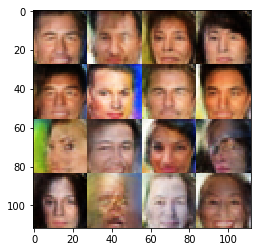

Timestamp 20170806-10-16-06.046 -  Epoch 1/1 -  Step 12410 -  D Loss: 1.3259 - G Loss: 1.3913
Timestamp 20170806-10-16-22.614 -  Epoch 1/1 -  Step 12420 -  D Loss: 1.2410 - G Loss: 0.9343
Timestamp 20170806-10-16-39.181 -  Epoch 1/1 -  Step 12430 -  D Loss: 1.0857 - G Loss: 1.1651
Timestamp 20170806-10-16-55.741 -  Epoch 1/1 -  Step 12440 -  D Loss: 1.1957 - G Loss: 1.0604
Timestamp 20170806-10-17-12.442 -  Epoch 1/1 -  Step 12450 -  D Loss: 1.1826 - G Loss: 1.2348
Timestamp 20170806-10-17-29.151 -  Epoch 1/1 -  Step 12460 -  D Loss: 1.4513 - G Loss: 1.5881
Timestamp 20170806-10-17-45.831 -  Epoch 1/1 -  Step 12470 -  D Loss: 1.1140 - G Loss: 1.0610
Timestamp 20170806-10-18-02.503 -  Epoch 1/1 -  Step 12480 -  D Loss: 1.1677 - G Loss: 1.2338
Timestamp 20170806-10-18-19.241 -  Epoch 1/1 -  Step 12490 -  D Loss: 1.3484 - G Loss: 1.3901
Timestamp 20170806-10-18-35.865 -  Epoch 1/1 -  Step 12500 -  D Loss: 1.4794 - G Loss: 0.9686


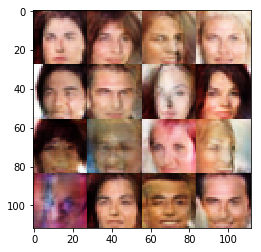

Timestamp 20170806-10-18-53.381 -  Epoch 1/1 -  Step 12510 -  D Loss: 1.5222 - G Loss: 0.7495
Timestamp 20170806-10-19-09.987 -  Epoch 1/1 -  Step 12520 -  D Loss: 1.1942 - G Loss: 1.3006
Timestamp 20170806-10-19-26.589 -  Epoch 1/1 -  Step 12530 -  D Loss: 1.2159 - G Loss: 1.1248
Timestamp 20170806-10-19-43.207 -  Epoch 1/1 -  Step 12540 -  D Loss: 1.2681 - G Loss: 0.9075
Timestamp 20170806-10-19-59.841 -  Epoch 1/1 -  Step 12550 -  D Loss: 1.2224 - G Loss: 0.7476
Timestamp 20170806-10-20-16.435 -  Epoch 1/1 -  Step 12560 -  D Loss: 1.2380 - G Loss: 0.9268
Timestamp 20170806-10-20-33.021 -  Epoch 1/1 -  Step 12570 -  D Loss: 1.1855 - G Loss: 0.8746
Timestamp 20170806-10-20-49.630 -  Epoch 1/1 -  Step 12580 -  D Loss: 1.1247 - G Loss: 0.7439
Timestamp 20170806-10-21-06.231 -  Epoch 1/1 -  Step 12590 -  D Loss: 1.2189 - G Loss: 1.1215
Timestamp 20170806-10-21-22.824 -  Epoch 1/1 -  Step 12600 -  D Loss: 1.0736 - G Loss: 0.9875


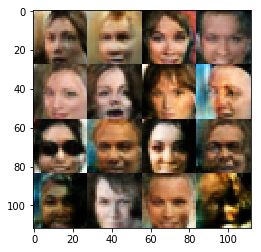

Timestamp 20170806-10-21-40.300 -  Epoch 1/1 -  Step 12610 -  D Loss: 1.1249 - G Loss: 1.1211
Timestamp 20170806-10-21-56.899 -  Epoch 1/1 -  Step 12620 -  D Loss: 1.2986 - G Loss: 1.1654
Timestamp 20170806-10-22-13.538 -  Epoch 1/1 -  Step 12630 -  D Loss: 1.3512 - G Loss: 0.6544
Timestamp 20170806-10-22-30.134 -  Epoch 1/1 -  Step 12640 -  D Loss: 1.1306 - G Loss: 0.9670
Timestamp 20170806-10-22-46.737 -  Epoch 1/1 -  Step 12650 -  D Loss: 1.4755 - G Loss: 0.7260
Timestamp 20170806-10-23-03.343 -  Epoch 1/1 -  Step 12660 -  D Loss: 1.5356 - G Loss: 0.8918
Timestamp 20170806-10-23-07.127 -  Epoch 1/1 -  Step 12662 -  D Loss: 1.1336 - G Loss: 1.2991


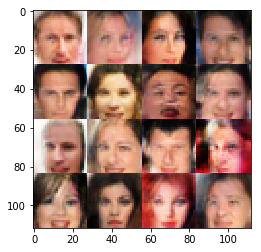

In [16]:
batch_size = 16
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

tf.reset_default_graph()

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)


### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.